#### Some of the most relevant GAN pros and cons for the are:
- They currently generate the sharpest images
- They are easy to train (since no statistical inference is required), and only back-propogation is needed to obtain gradients
- GANs are difficult to optimize due to unstable training dynamics.
- No statistical inference can be done with them

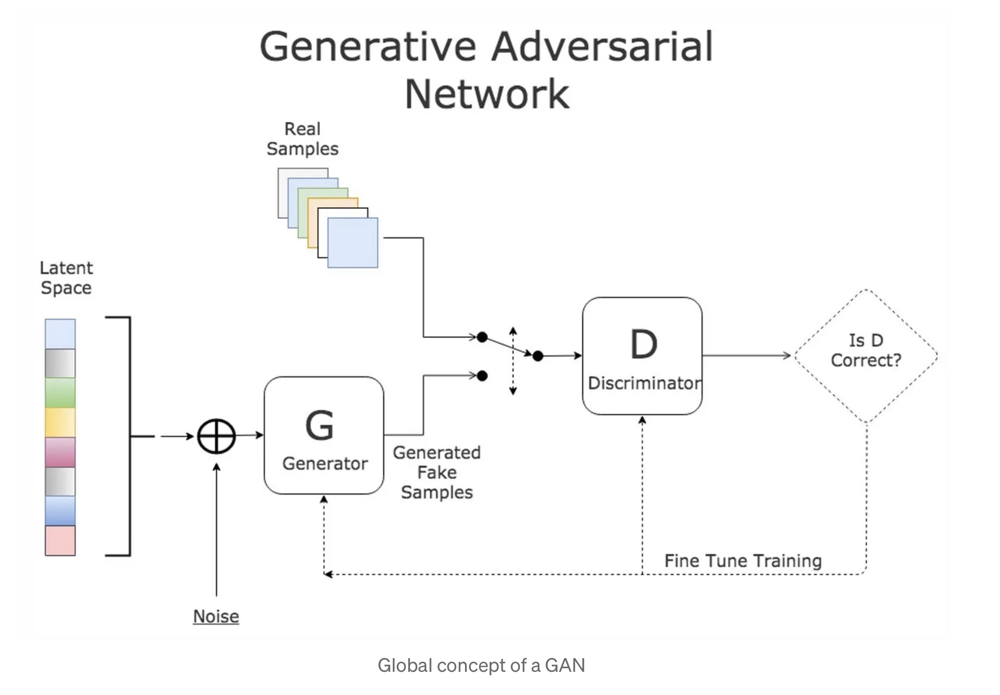

## 0. Importing Libraries

In [1]:
!pip install torchvision tensorboardx jupyter matplotlib numpy

In [2]:
%load_ext autoreload
%matplotlib inline

In [3]:
%autoreload 2
from utils import Logger
from IPython import display

In [4]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [5]:
FOLDER = './torch_data/VGAN/MNIST'

## 1. Data Preparation

In [6]:
def mnist_data():
    compose_transform= transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize([0.5], [0.5])
        ])
    out_dir = f'{FOLDER}/dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose_transform, download=True)

# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

## 2. Building our Networks

In [7]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden_layer_0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden_layer_1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden_layer_2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden_layer_0(x)
        x = self.hidden_layer_1(x)
        x = self.hidden_layer_2(x)
        x = self.out(x)
        return x
    

discriminator = DiscriminatorNet()

In [9]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden_layer_0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden_layer_1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden_layer_2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden_layer_0(x)
        x = self.hidden_layer_1(x)
        x = self.hidden_layer_2(x)
        x = self.out(x)
        return x
    

generator = GeneratorNet()

## 3. Helper Functions

In [ ]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [10]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [ ]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [ ]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [ ]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

## 4. Training our GAN and exploring results

In [11]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [12]:
loss = nn.BCELoss()

In [16]:
%%time
num_test_samples = 16
test_noise = noise(num_test_samples)

CPU times: user 168 µs, sys: 51 µs, total: 219 µs
Wall time: 170 µs


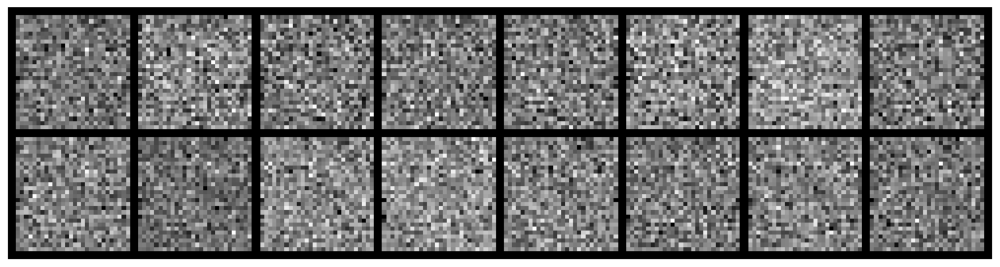

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3760, Generator Loss: 0.7039
D(x): 0.5000, D(G(z)): 0.4947


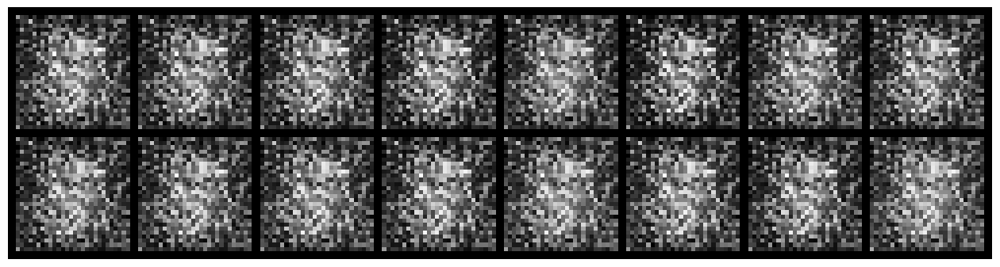

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.4262, Generator Loss: 3.6173
D(x): 0.8870, D(G(z)): 0.2260


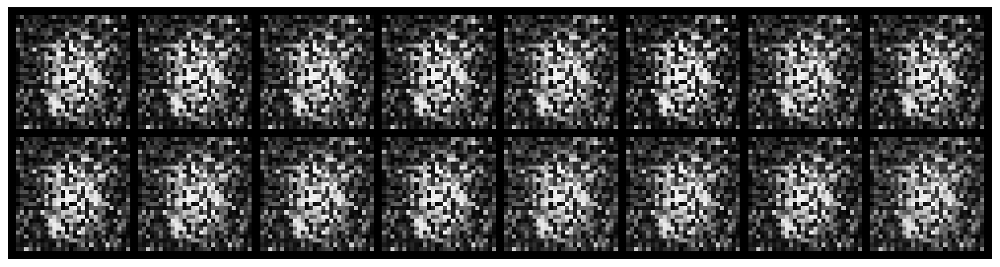

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.9002, Generator Loss: 2.4839
D(x): 0.8478, D(G(z)): 0.4524


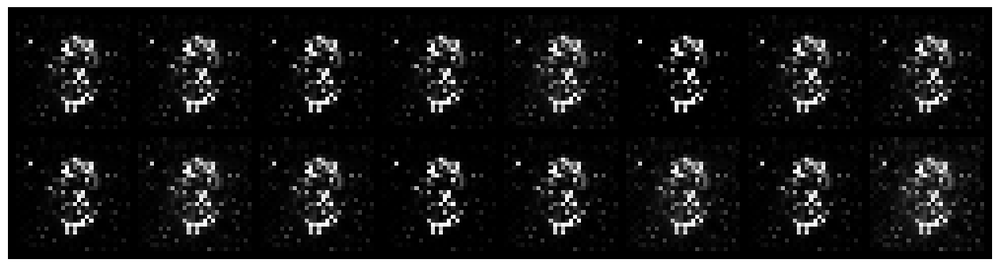

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.1982, Generator Loss: 4.2018
D(x): 0.9171, D(G(z)): 0.0913


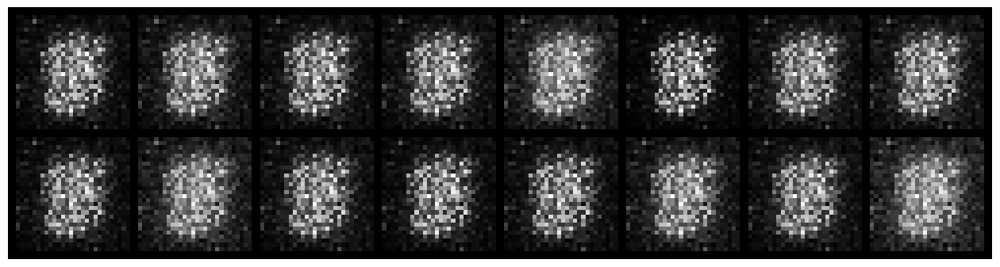

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.3782, Generator Loss: 4.4477
D(x): 0.7716, D(G(z)): 0.0700


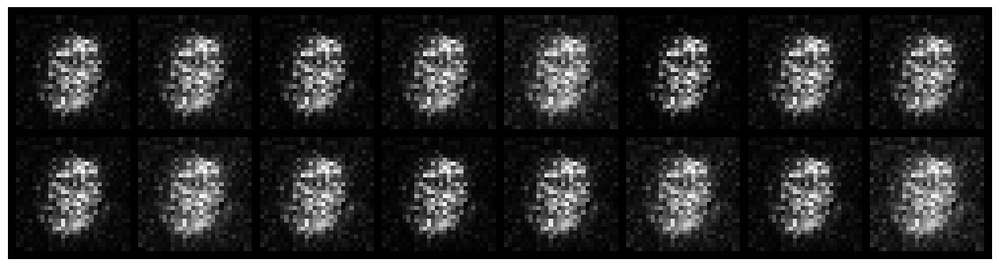

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.6942, Generator Loss: 1.9955
D(x): 0.7663, D(G(z)): 0.2889


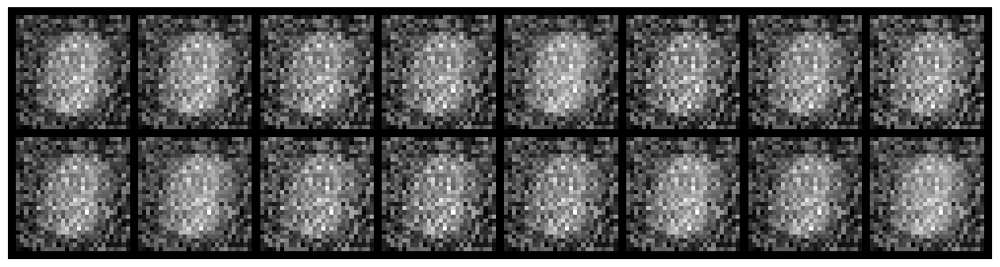

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.9099, Generator Loss: 0.8401
D(x): 0.8847, D(G(z)): 0.5329


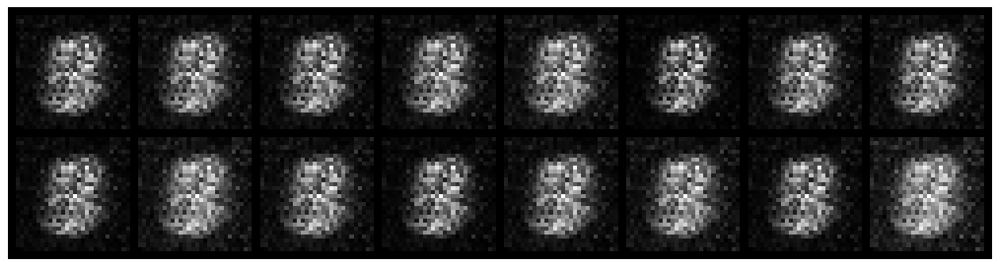

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 2.3552, Generator Loss: 0.4092
D(x): 0.4687, D(G(z)): 0.7151


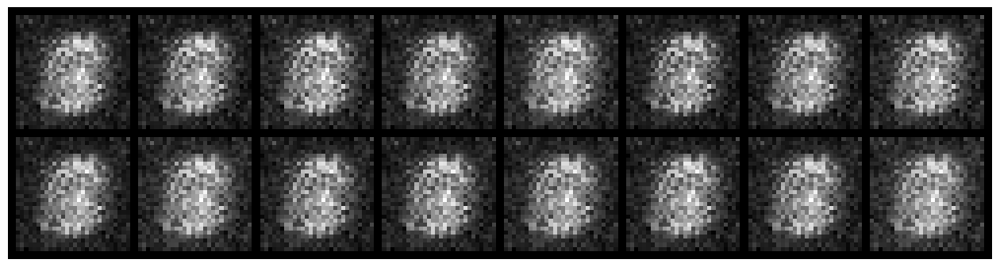

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.4060, Generator Loss: 0.5570
D(x): 0.6013, D(G(z)): 0.5759


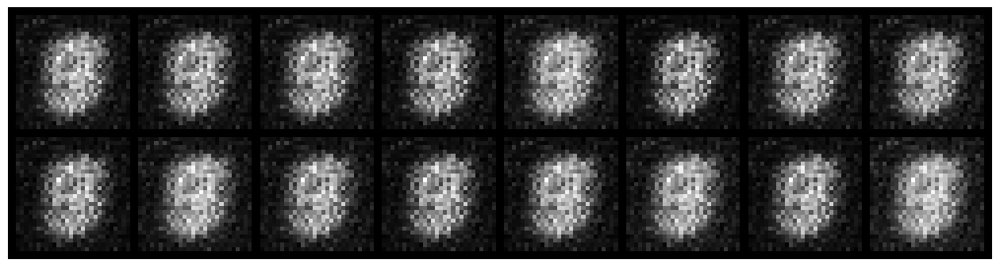

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.0150, Generator Loss: 0.9476
D(x): 0.6732, D(G(z)): 0.4273


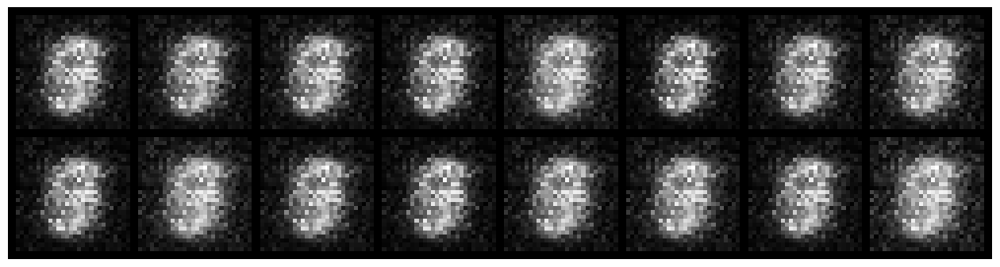

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.7216, Generator Loss: 0.6474
D(x): 0.5218, D(G(z)): 0.5780


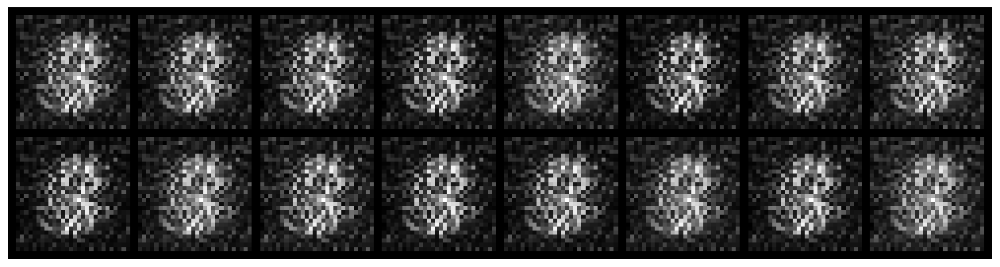

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.4225, Generator Loss: 3.5263
D(x): 0.8443, D(G(z)): 0.1820


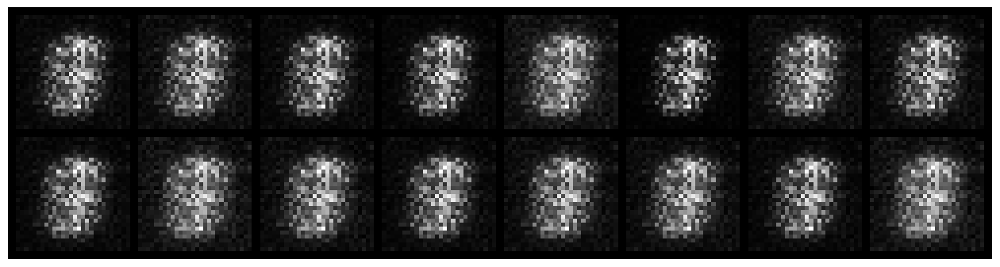

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 2.7066, Generator Loss: 0.5393
D(x): 0.3741, D(G(z)): 0.6961


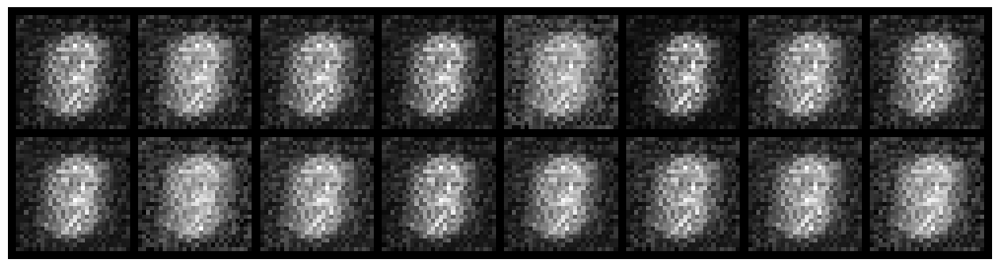

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 2.2449, Generator Loss: 0.5937
D(x): 0.5134, D(G(z)): 0.6908


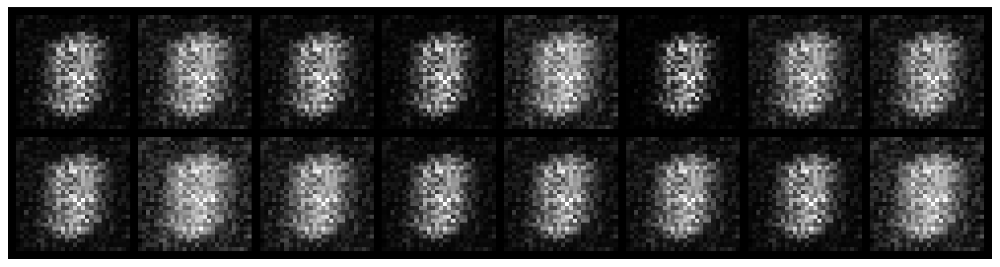

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.1812, Generator Loss: 0.9062
D(x): 0.6006, D(G(z)): 0.4255


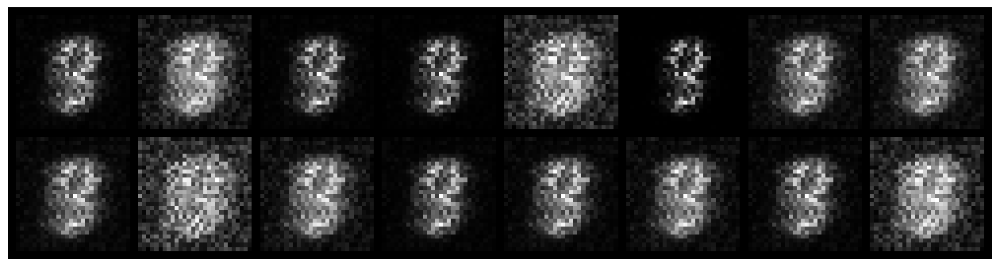

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.8890, Generator Loss: 2.9239
D(x): 0.7359, D(G(z)): 0.2140


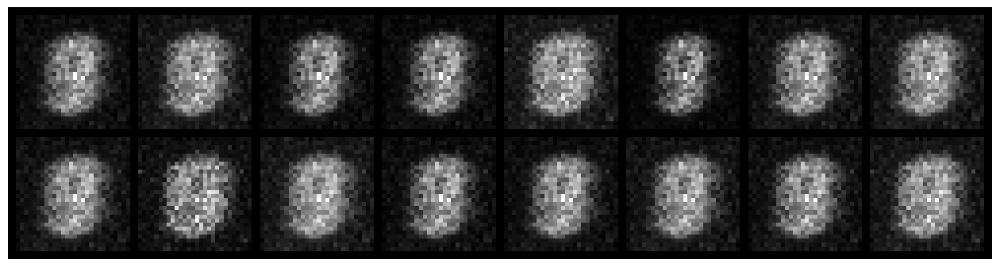

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.5651, Generator Loss: 2.4240
D(x): 0.7838, D(G(z)): 0.1908


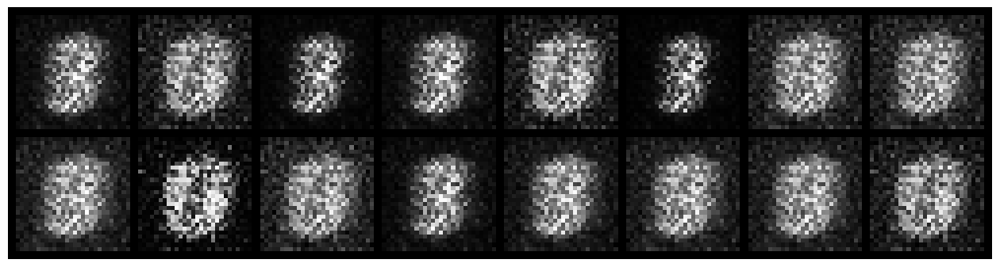

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.9926, Generator Loss: 1.7664
D(x): 0.6717, D(G(z)): 0.2893


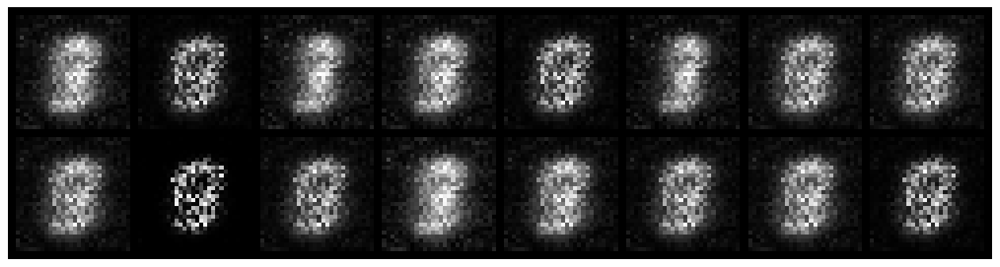

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 1.1537, Generator Loss: 1.0785
D(x): 0.7129, D(G(z)): 0.4479


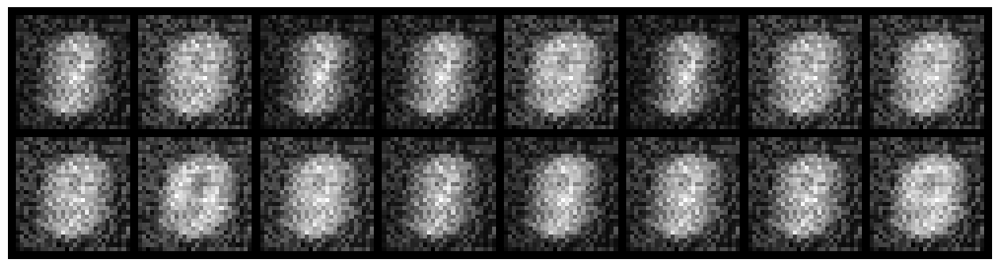

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.9017, Generator Loss: 1.1471
D(x): 0.8196, D(G(z)): 0.4272


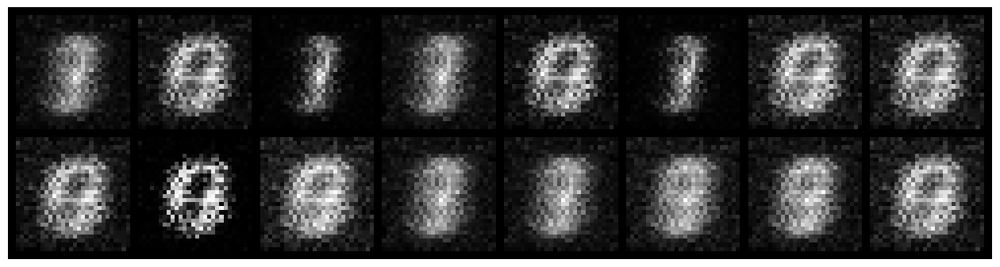

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.6847, Generator Loss: 1.9602
D(x): 0.7271, D(G(z)): 0.2332


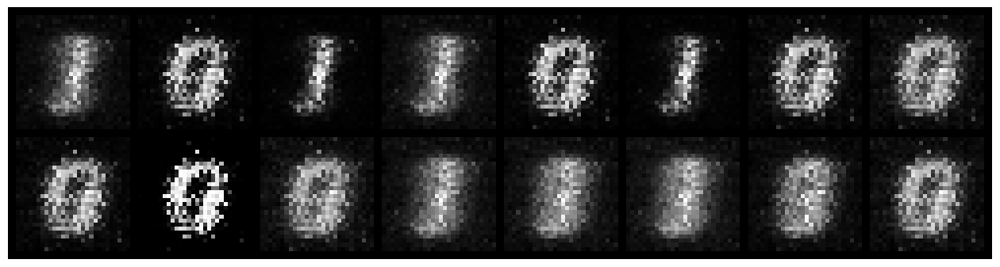

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 1.0016, Generator Loss: 3.3107
D(x): 0.6954, D(G(z)): 0.2749


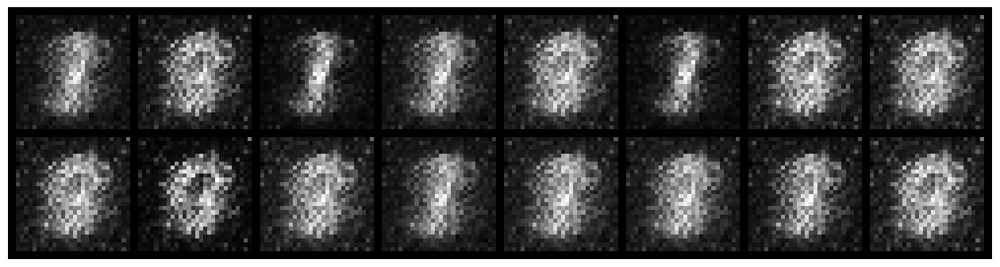

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.4420, Generator Loss: 2.3288
D(x): 0.8758, D(G(z)): 0.2128


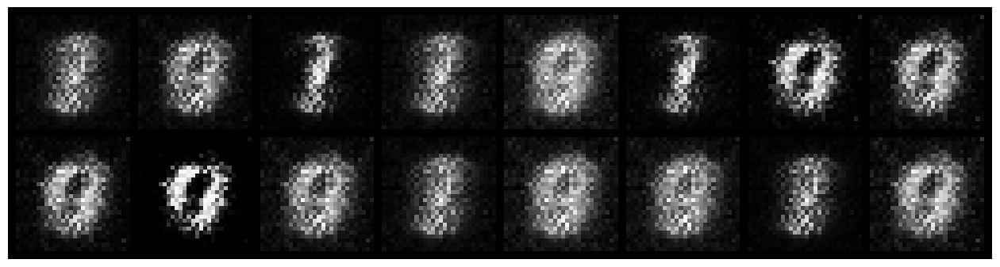

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.7272, Generator Loss: 2.3045
D(x): 0.8021, D(G(z)): 0.2826


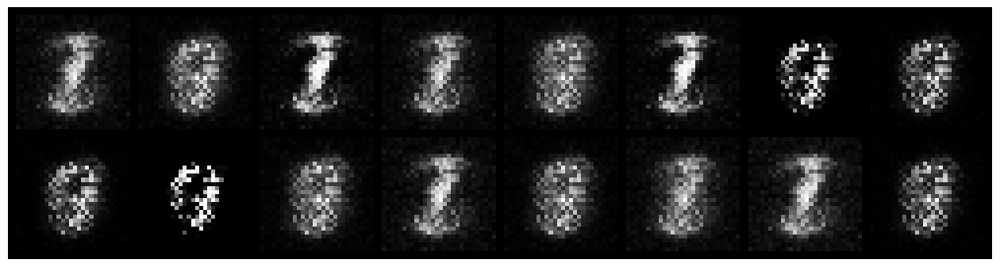

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.5958, Generator Loss: 2.7786
D(x): 0.7854, D(G(z)): 0.1645


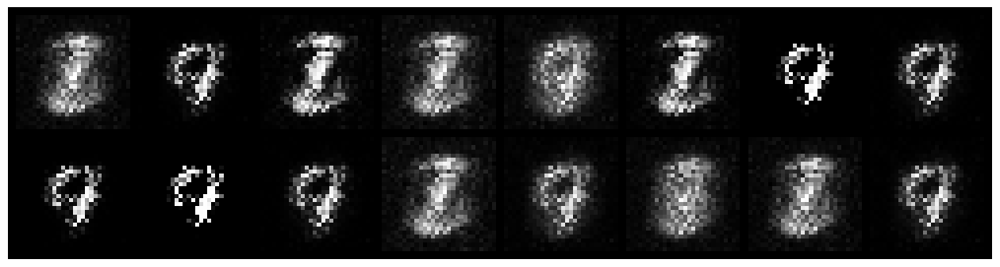

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.9191, Generator Loss: 1.7565
D(x): 0.7328, D(G(z)): 0.3133


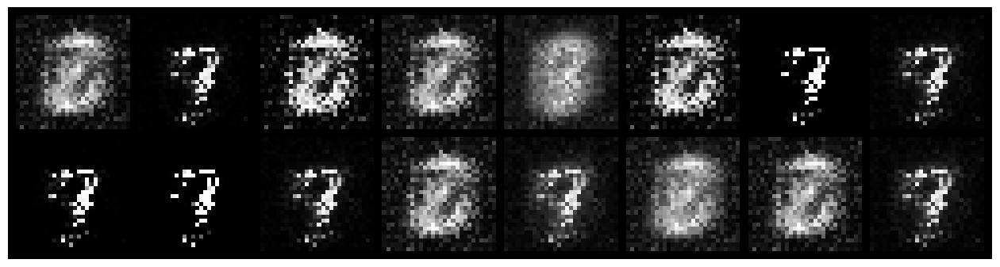

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.5812, Generator Loss: 2.5143
D(x): 0.8240, D(G(z)): 0.1459


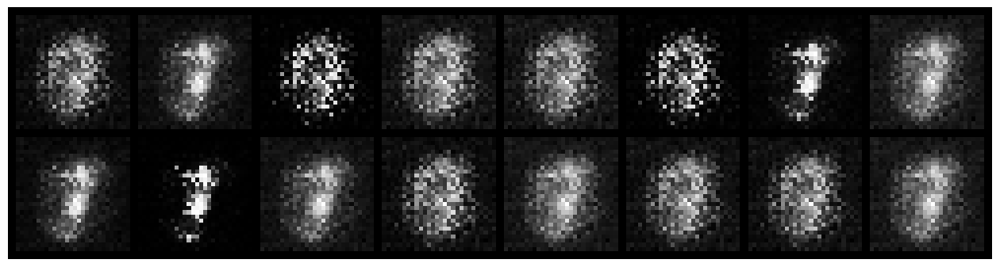

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.5116, Generator Loss: 1.8650
D(x): 0.8390, D(G(z)): 0.2004


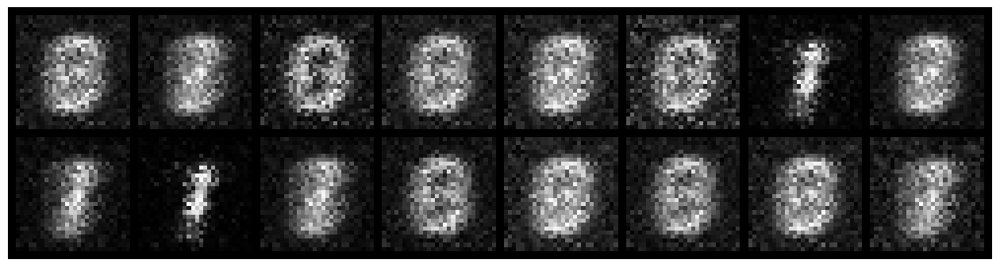

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.9375, Generator Loss: 2.1300
D(x): 0.8034, D(G(z)): 0.2486


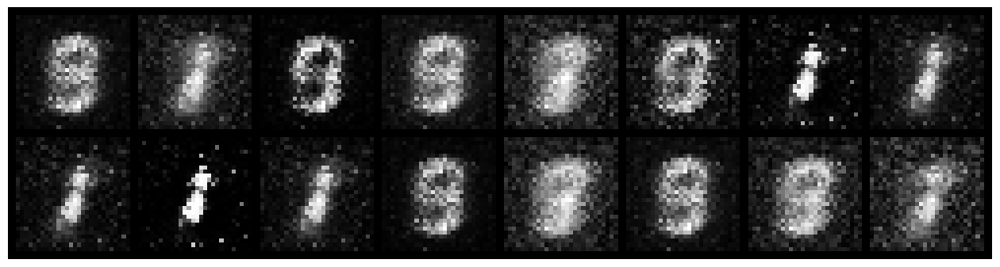

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.5321, Generator Loss: 2.1304
D(x): 0.8348, D(G(z)): 0.2015


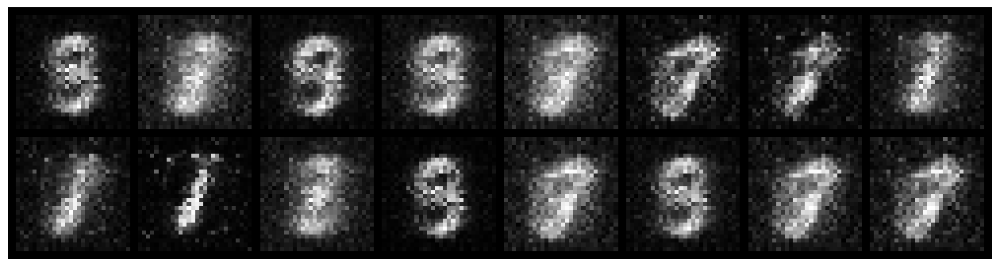

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.8092, Generator Loss: 2.1497
D(x): 0.7456, D(G(z)): 0.2091


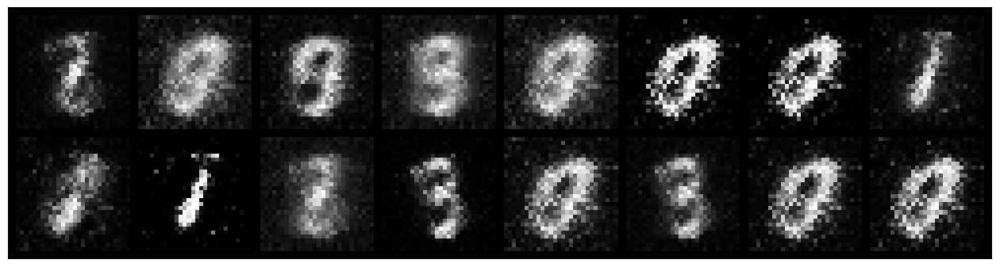

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.8753, Generator Loss: 1.8527
D(x): 0.7016, D(G(z)): 0.2501


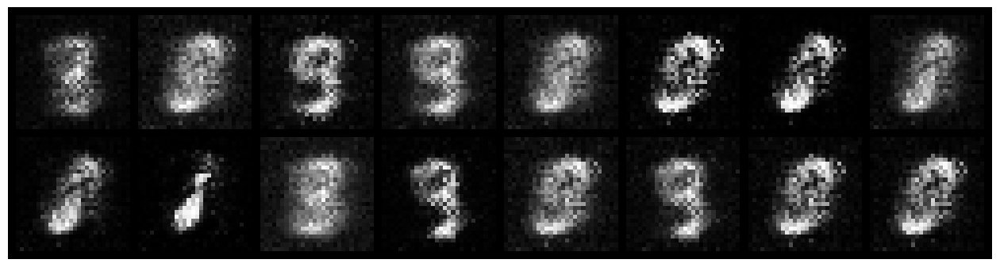

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.5021, Generator Loss: 2.4020
D(x): 0.8608, D(G(z)): 0.1611


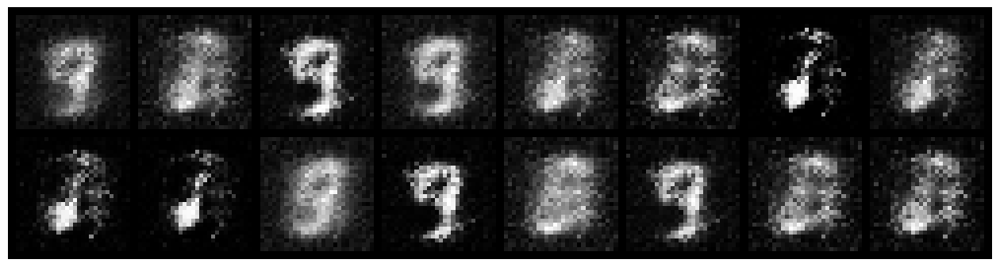

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.5592, Generator Loss: 2.2941
D(x): 0.8236, D(G(z)): 0.1353


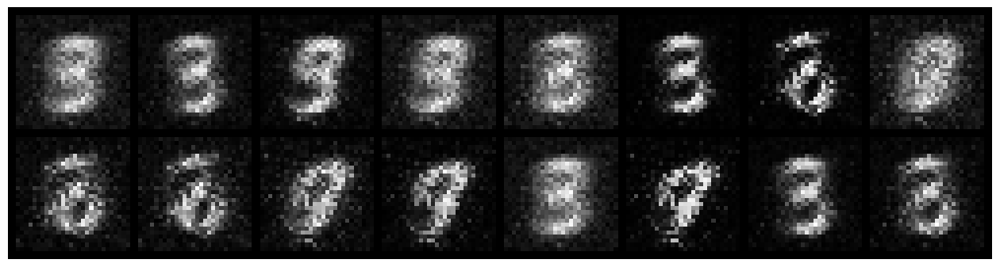

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.5669, Generator Loss: 2.0592
D(x): 0.8619, D(G(z)): 0.2479


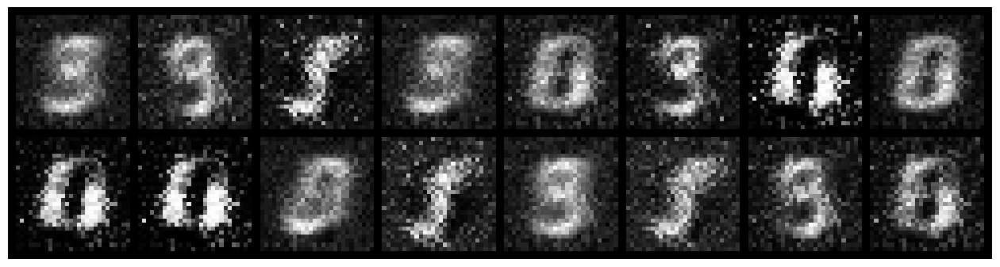

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.9695, Generator Loss: 1.6204
D(x): 0.7732, D(G(z)): 0.3568


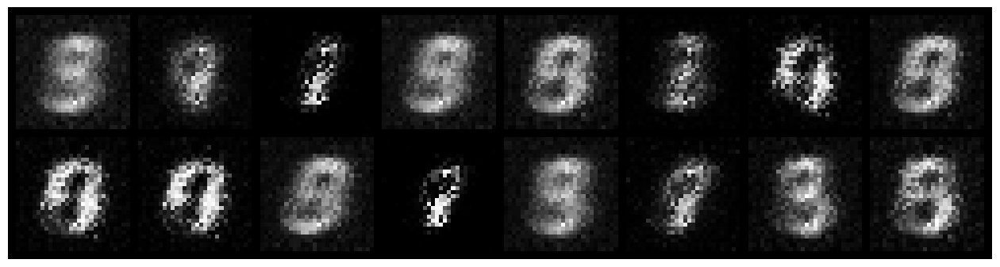

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.8766, Generator Loss: 1.3389
D(x): 0.7646, D(G(z)): 0.3410


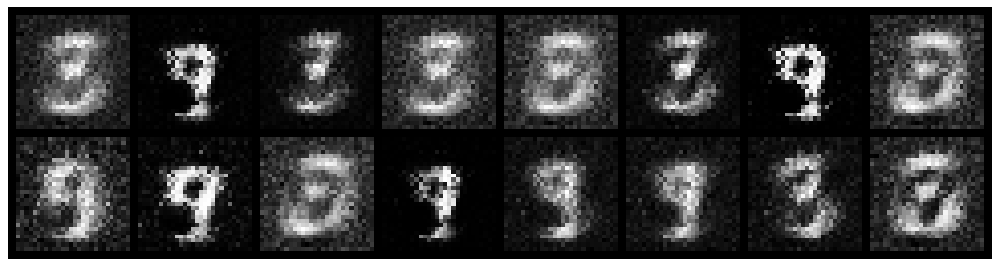

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.7395, Generator Loss: 1.4694
D(x): 0.7802, D(G(z)): 0.2698


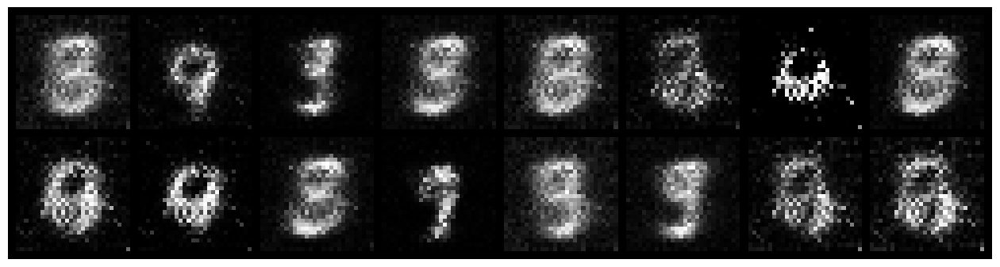

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.5819, Generator Loss: 1.9611
D(x): 0.7940, D(G(z)): 0.1851


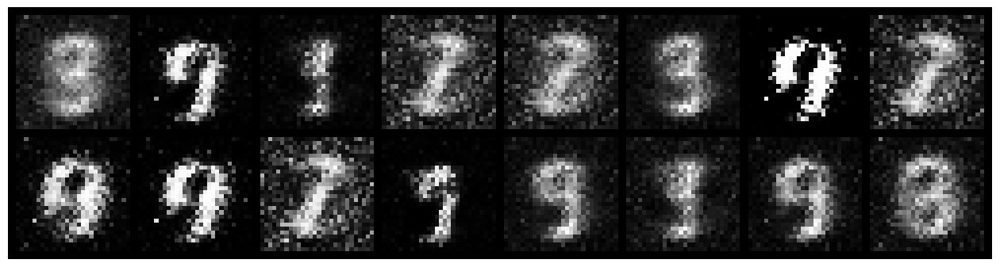

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.7223, Generator Loss: 1.9214
D(x): 0.7415, D(G(z)): 0.2430


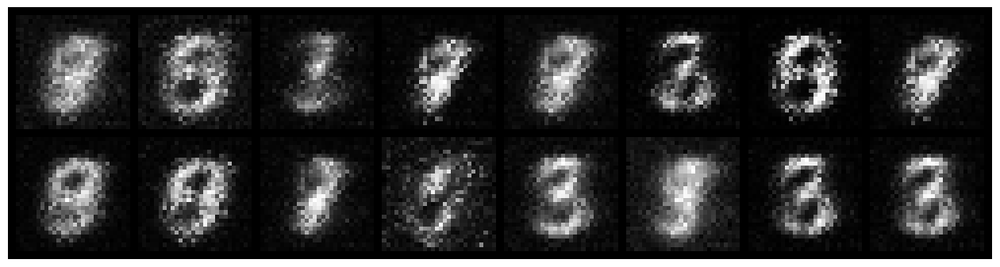

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.6802, Generator Loss: 2.1787
D(x): 0.8464, D(G(z)): 0.2554


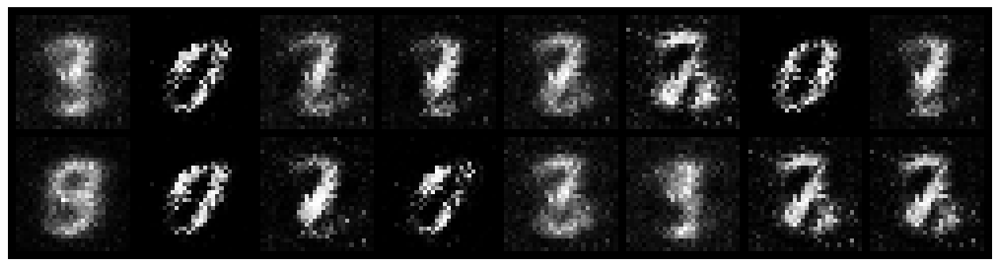

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.7182, Generator Loss: 1.5669
D(x): 0.7724, D(G(z)): 0.2719


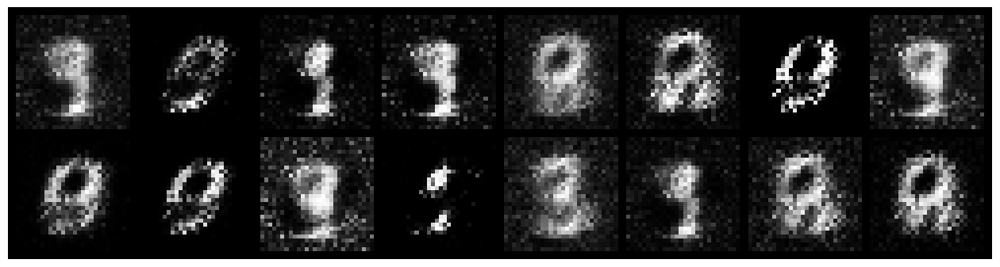

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.7370, Generator Loss: 2.0845
D(x): 0.7361, D(G(z)): 0.1326


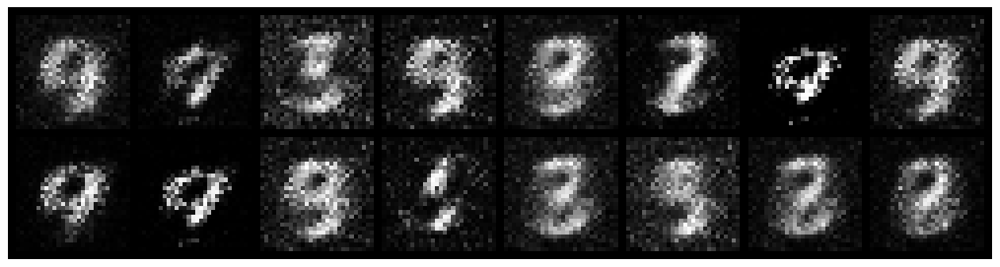

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.3094, Generator Loss: 3.2893
D(x): 0.8969, D(G(z)): 0.0976


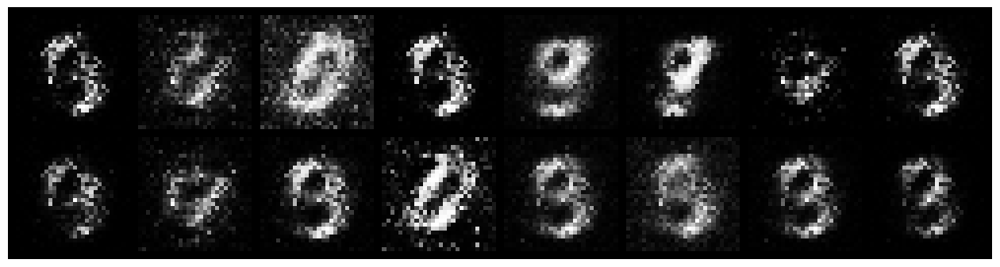

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.4898, Generator Loss: 2.9928
D(x): 0.8132, D(G(z)): 0.1279


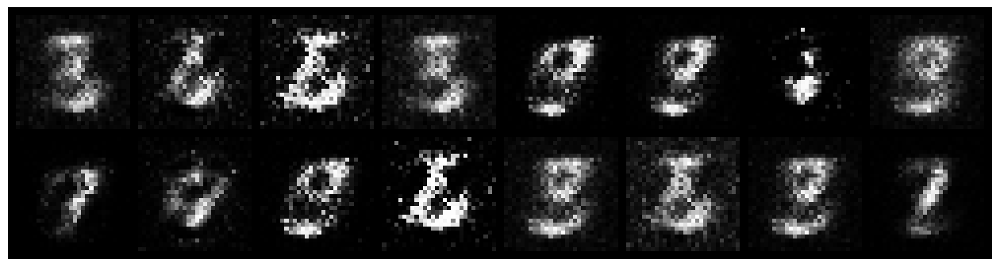

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 1.0712, Generator Loss: 1.4634
D(x): 0.7301, D(G(z)): 0.3474


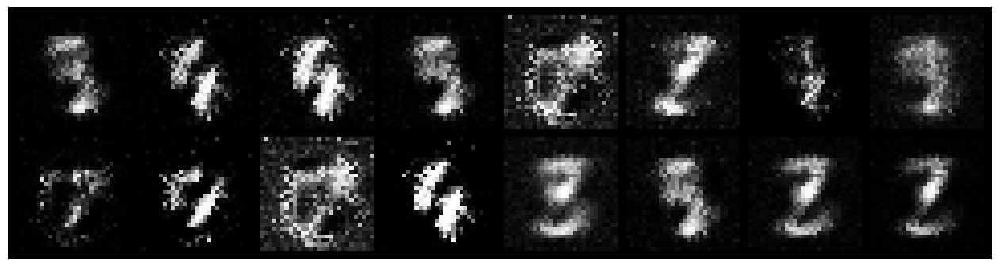

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.7248, Generator Loss: 2.5370
D(x): 0.7489, D(G(z)): 0.1607


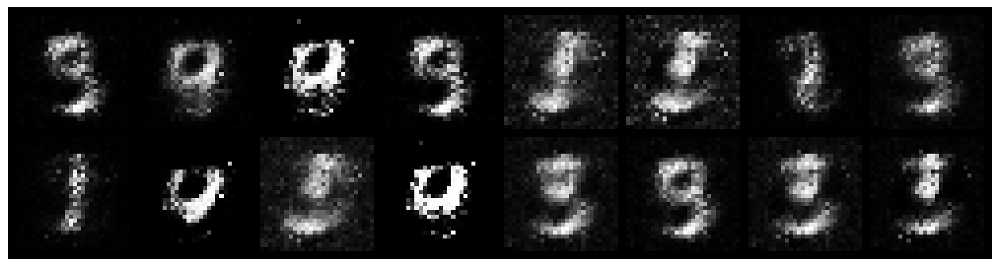

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.6152, Generator Loss: 2.0523
D(x): 0.8213, D(G(z)): 0.2132


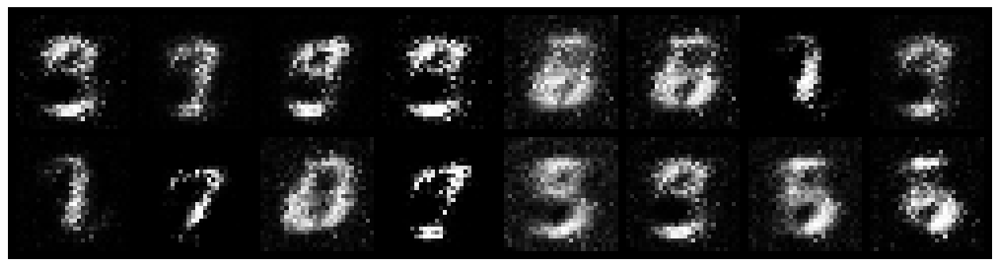

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.7596, Generator Loss: 1.9701
D(x): 0.7545, D(G(z)): 0.2357


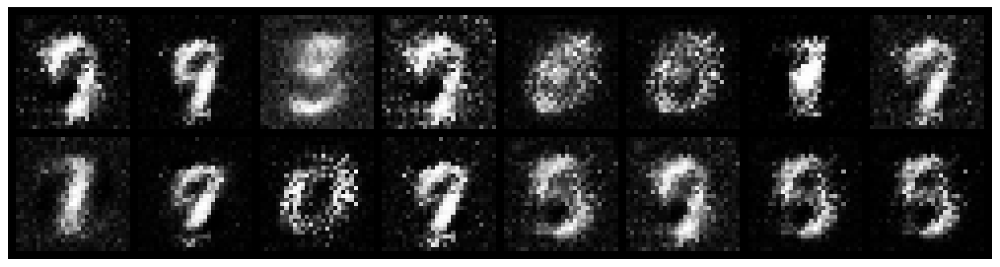

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.6260, Generator Loss: 2.6731
D(x): 0.7364, D(G(z)): 0.1500


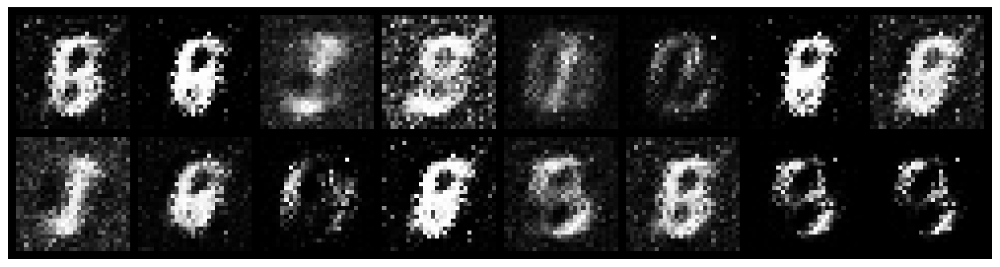

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.5986, Generator Loss: 1.8662
D(x): 0.8649, D(G(z)): 0.2700


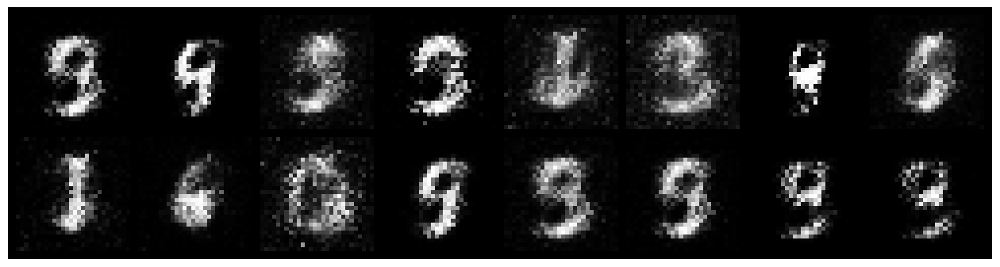

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.8608, Generator Loss: 1.8390
D(x): 0.7792, D(G(z)): 0.3120


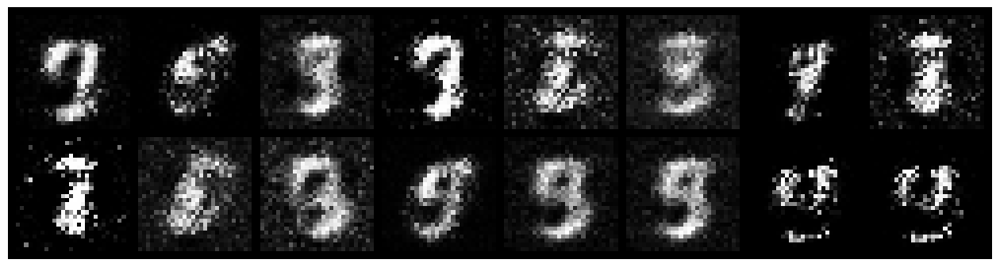

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.7892, Generator Loss: 3.3343
D(x): 0.7610, D(G(z)): 0.2325


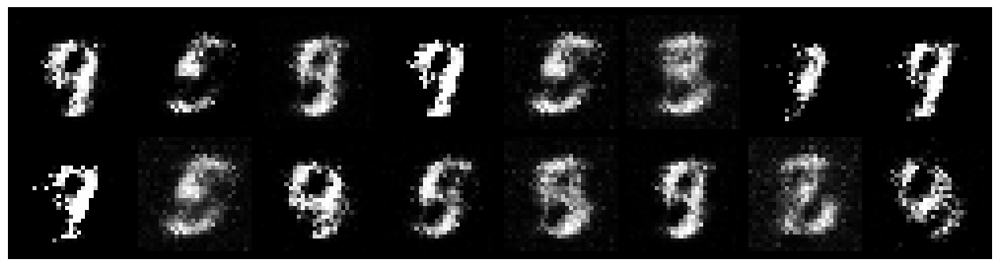

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5763, Generator Loss: 2.3498
D(x): 0.7786, D(G(z)): 0.1788


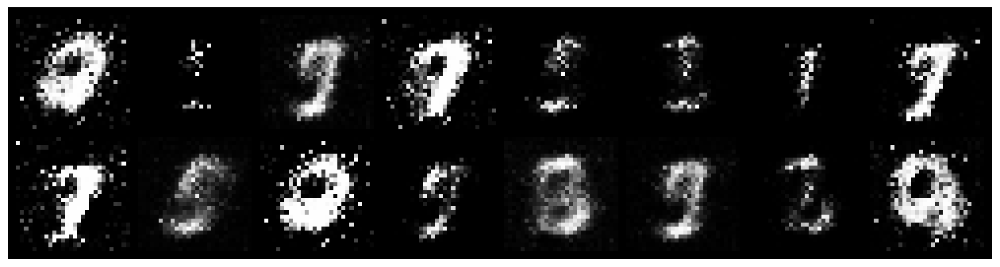

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.4667, Generator Loss: 2.4978
D(x): 0.8756, D(G(z)): 0.2016


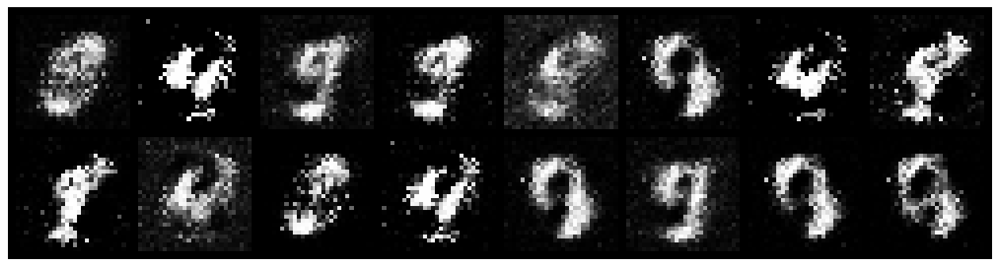

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.5139, Generator Loss: 2.3954
D(x): 0.8594, D(G(z)): 0.1583


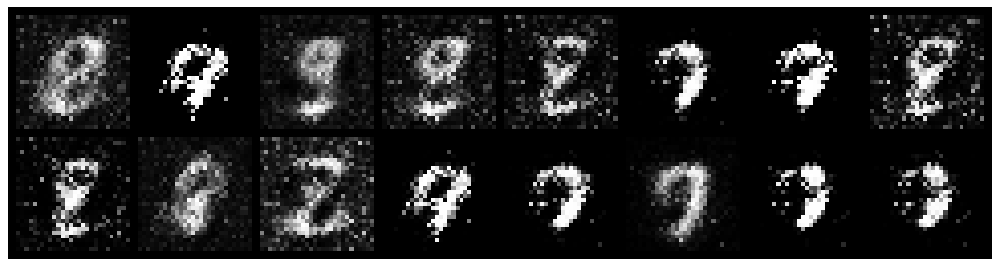

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.2808, Generator Loss: 3.2629
D(x): 0.9174, D(G(z)): 0.1237


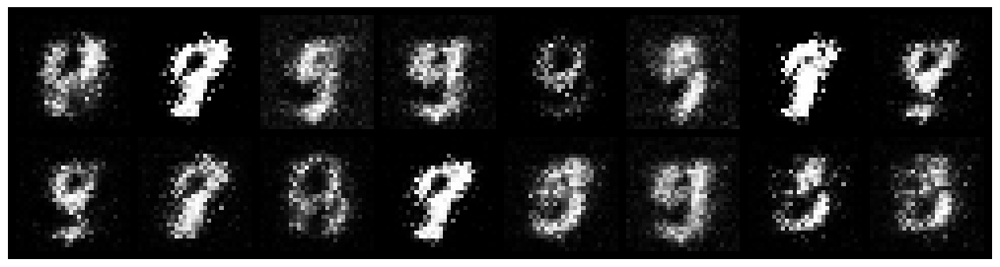

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.5454, Generator Loss: 2.4428
D(x): 0.8558, D(G(z)): 0.2002


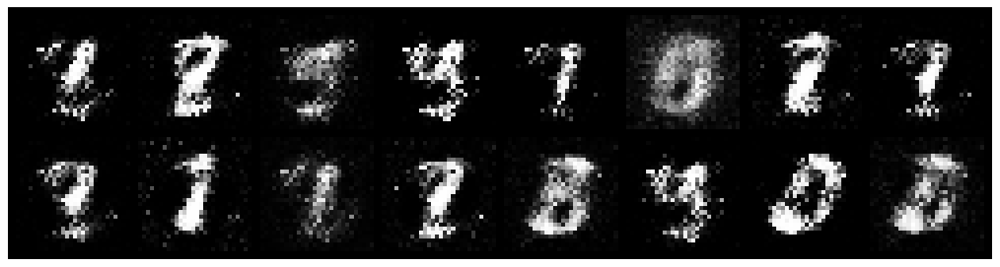

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.9972, Generator Loss: 2.2091
D(x): 0.6957, D(G(z)): 0.2462


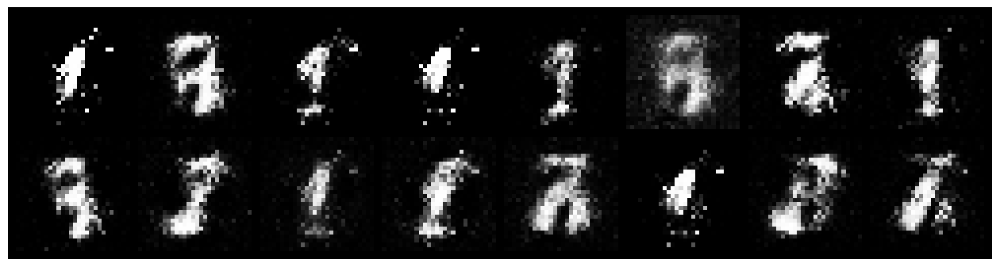

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.9335, Generator Loss: 1.5577
D(x): 0.6956, D(G(z)): 0.2713


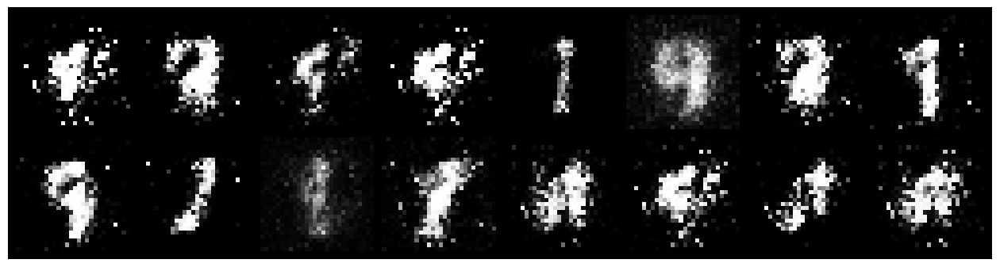

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.4815, Generator Loss: 2.3910
D(x): 0.8450, D(G(z)): 0.1554


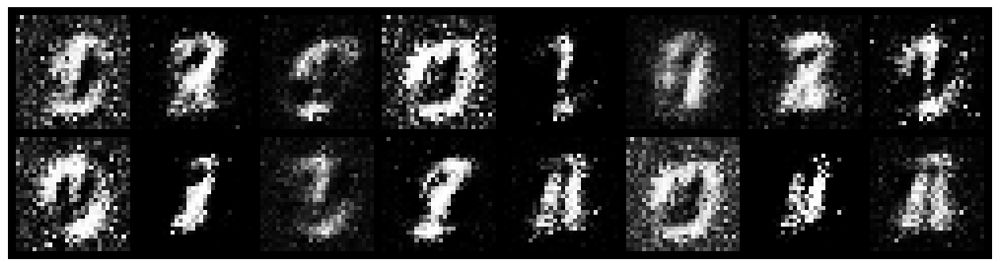

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.7108, Generator Loss: 2.0611
D(x): 0.7392, D(G(z)): 0.1711


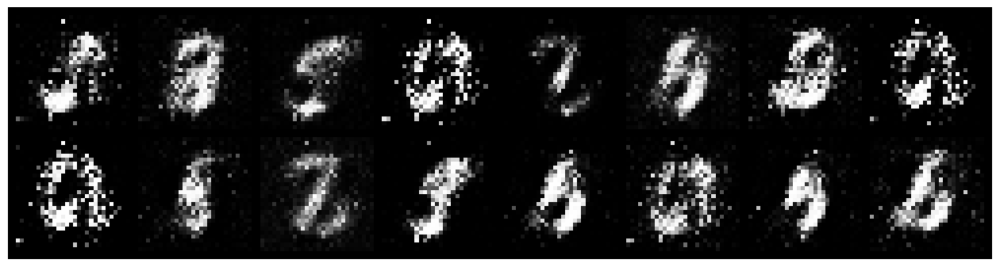

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.6559, Generator Loss: 2.0865
D(x): 0.8112, D(G(z)): 0.1980


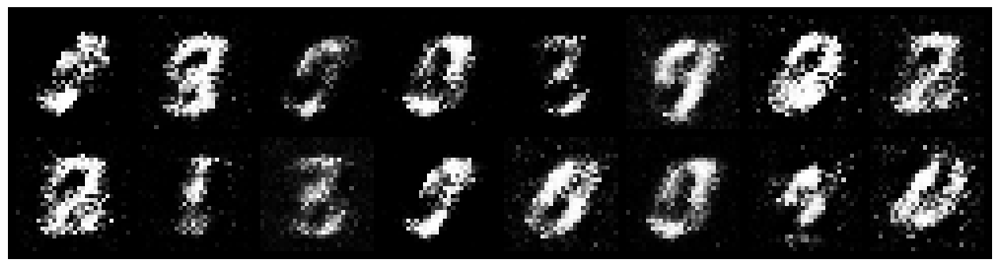

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5736, Generator Loss: 2.6056
D(x): 0.8058, D(G(z)): 0.2021


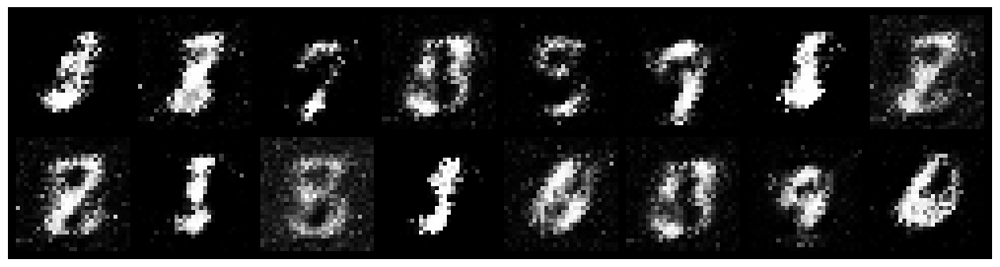

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.4569, Generator Loss: 2.6558
D(x): 0.8603, D(G(z)): 0.1713


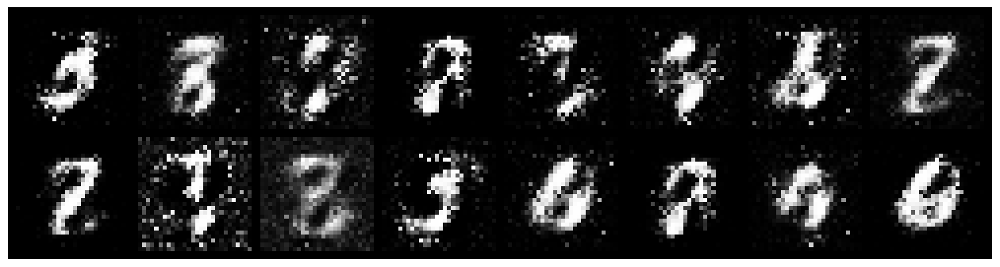

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.6285, Generator Loss: 3.1020
D(x): 0.7784, D(G(z)): 0.1611


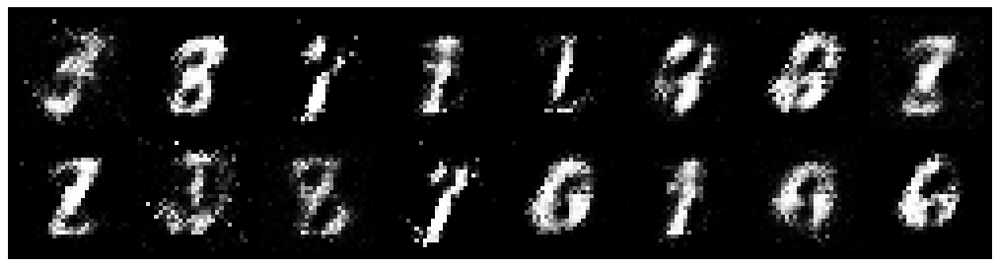

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.5611, Generator Loss: 2.0184
D(x): 0.8379, D(G(z)): 0.2194


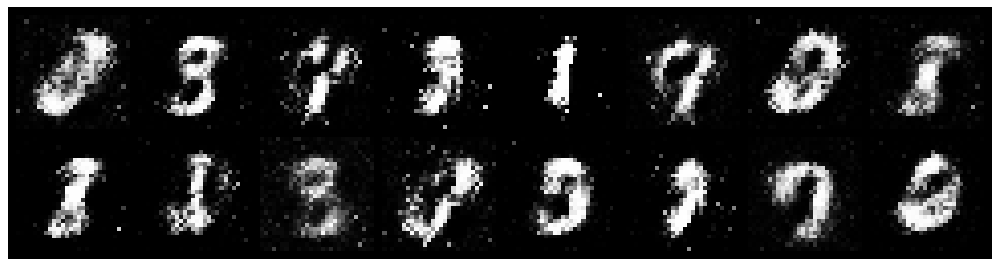

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.7436, Generator Loss: 2.7240
D(x): 0.8448, D(G(z)): 0.2938


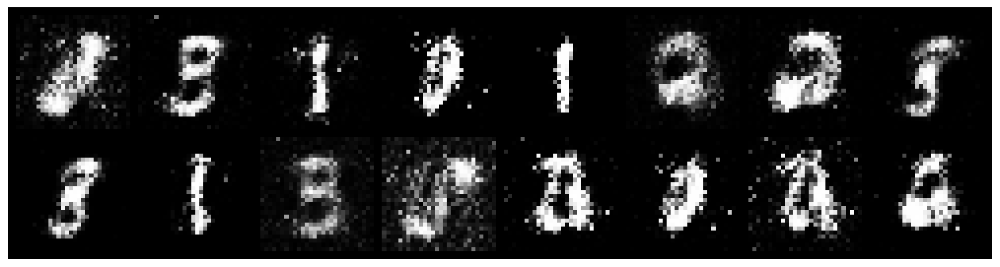

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.5943, Generator Loss: 2.9958
D(x): 0.7760, D(G(z)): 0.1418


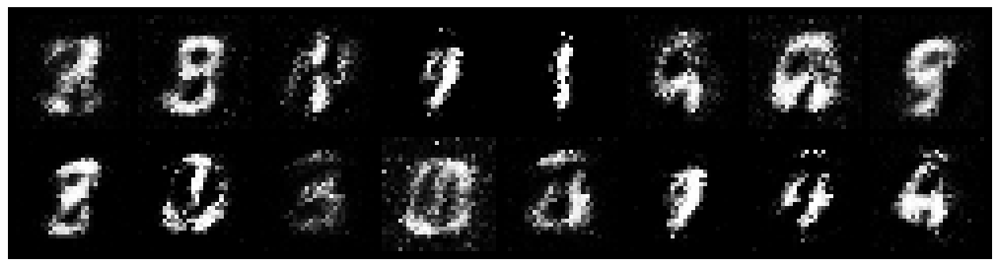

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.6251, Generator Loss: 2.2082
D(x): 0.8286, D(G(z)): 0.1940


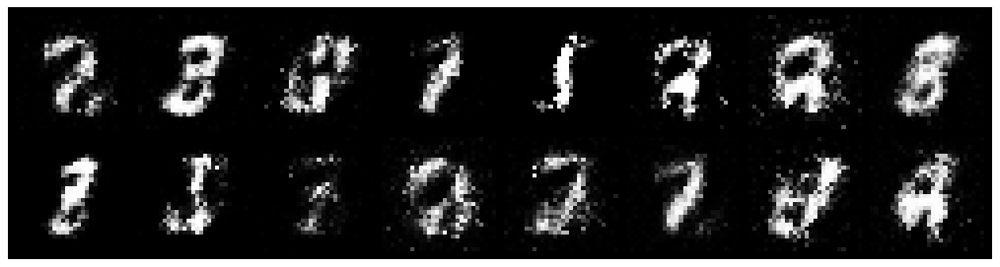

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.8067, Generator Loss: 1.8642
D(x): 0.7728, D(G(z)): 0.2738


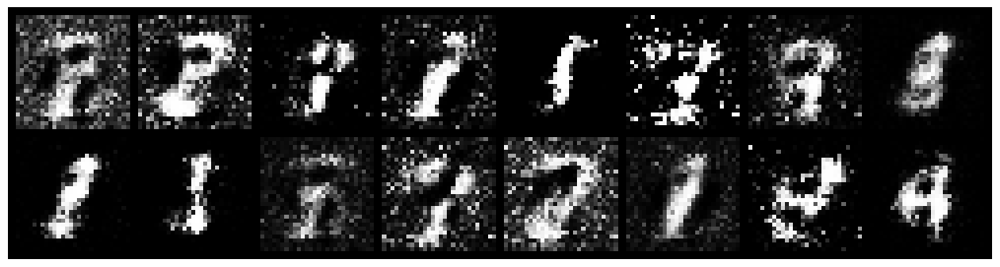

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.8887, Generator Loss: 2.0432
D(x): 0.7858, D(G(z)): 0.2578


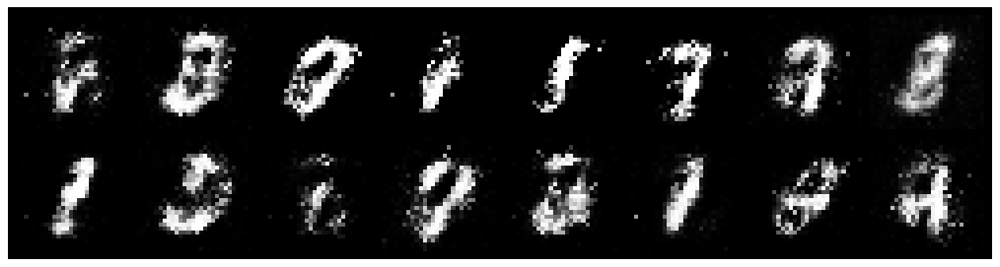

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6833, Generator Loss: 2.4846
D(x): 0.7185, D(G(z)): 0.1519


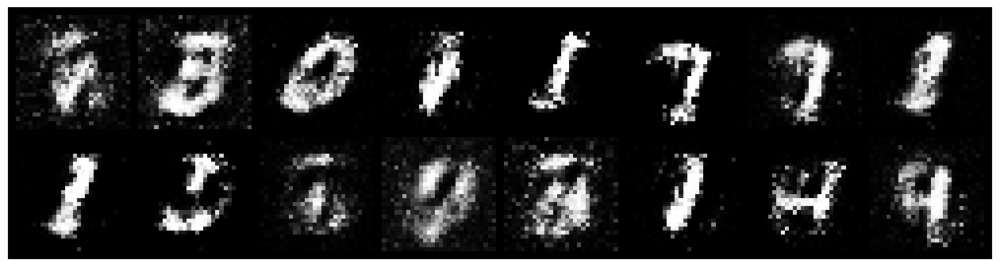

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.5517, Generator Loss: 2.4200
D(x): 0.8624, D(G(z)): 0.2099


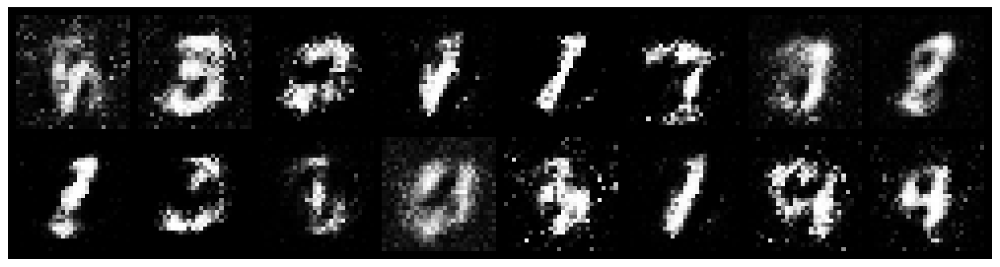

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.9052, Generator Loss: 1.6591
D(x): 0.7236, D(G(z)): 0.2719


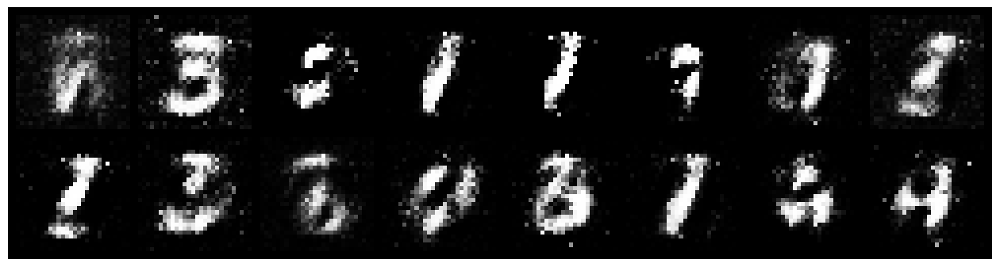

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.8649, Generator Loss: 2.5677
D(x): 0.7501, D(G(z)): 0.2520


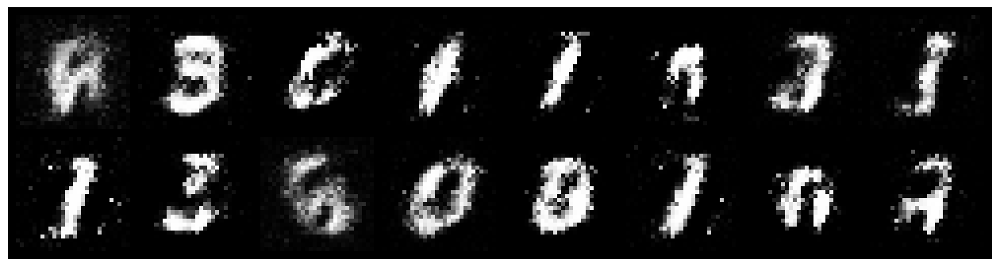

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 1.0982, Generator Loss: 2.0927
D(x): 0.6318, D(G(z)): 0.2330


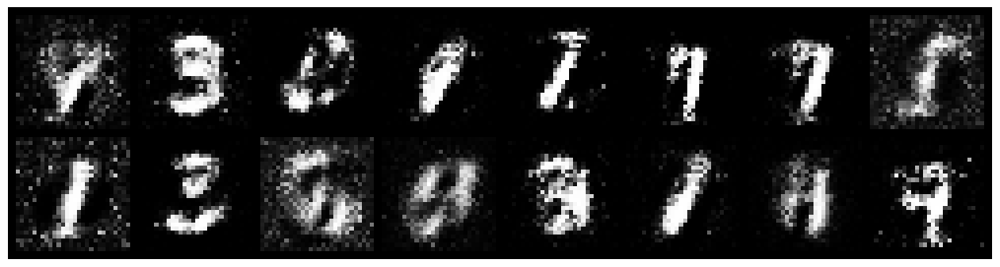

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.7111, Generator Loss: 1.7464
D(x): 0.7762, D(G(z)): 0.2459


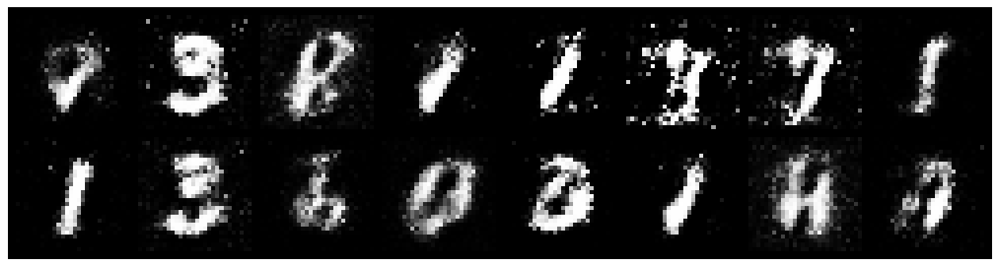

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.7723, Generator Loss: 1.4894
D(x): 0.7942, D(G(z)): 0.3367


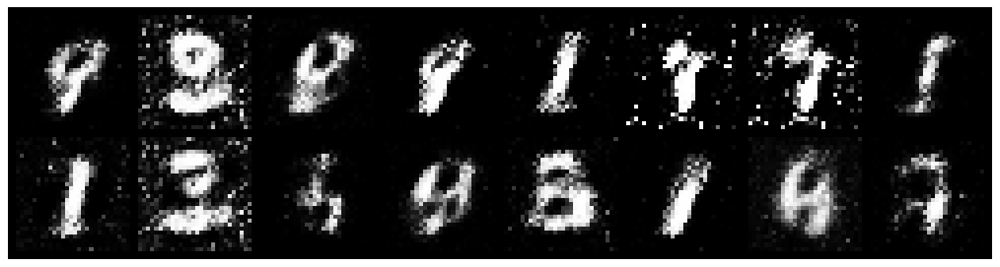

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.6860, Generator Loss: 1.9519
D(x): 0.8457, D(G(z)): 0.3072


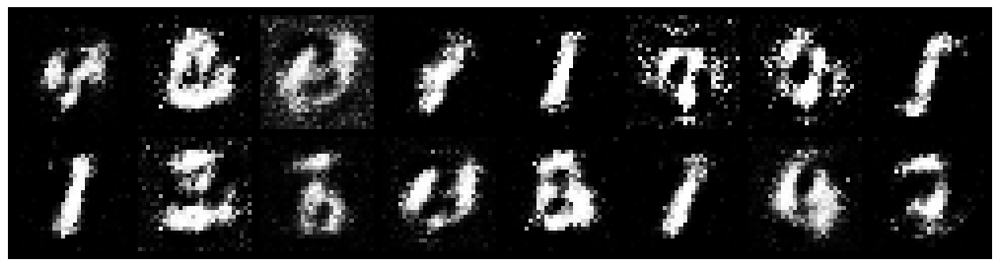

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.7730, Generator Loss: 2.2579
D(x): 0.7508, D(G(z)): 0.2363


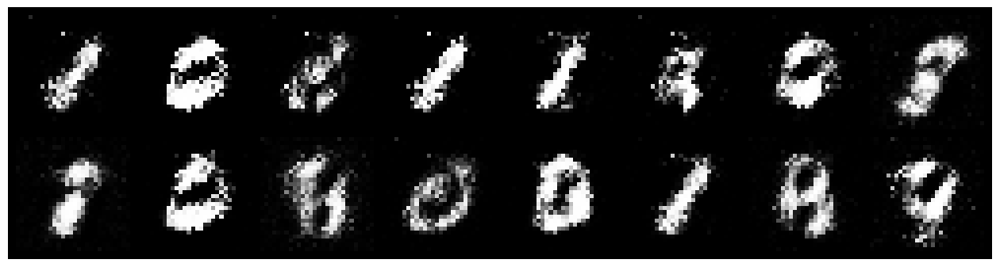

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.7924, Generator Loss: 2.1459
D(x): 0.7010, D(G(z)): 0.2265


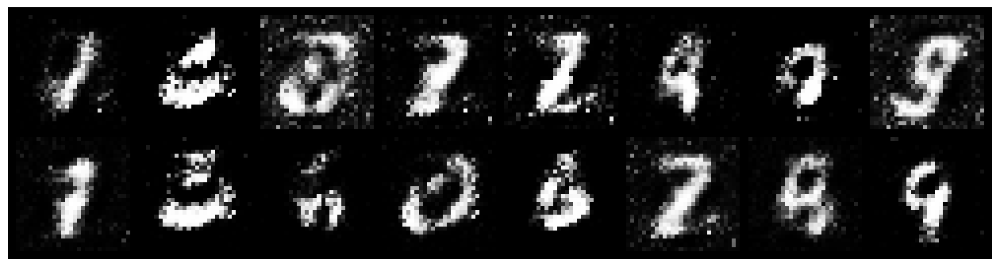

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.7865, Generator Loss: 2.2851
D(x): 0.7258, D(G(z)): 0.2224


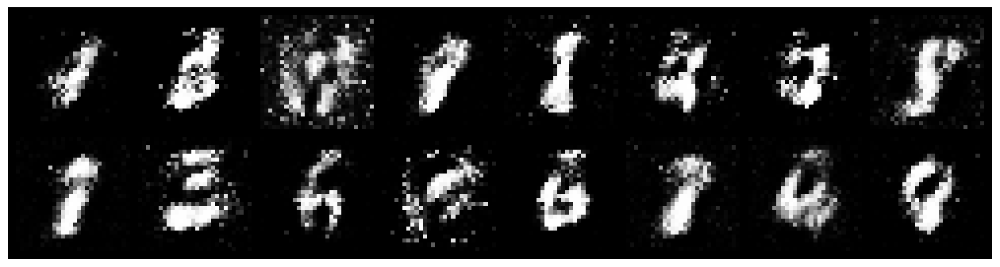

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 1.0621, Generator Loss: 1.9199
D(x): 0.7566, D(G(z)): 0.4036


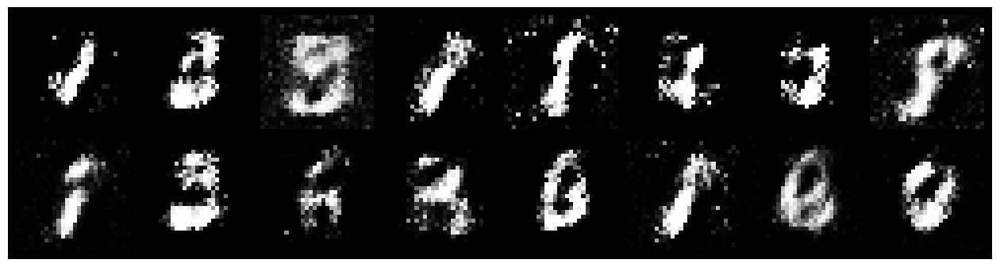

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 1.0407, Generator Loss: 1.4864
D(x): 0.6065, D(G(z)): 0.2680


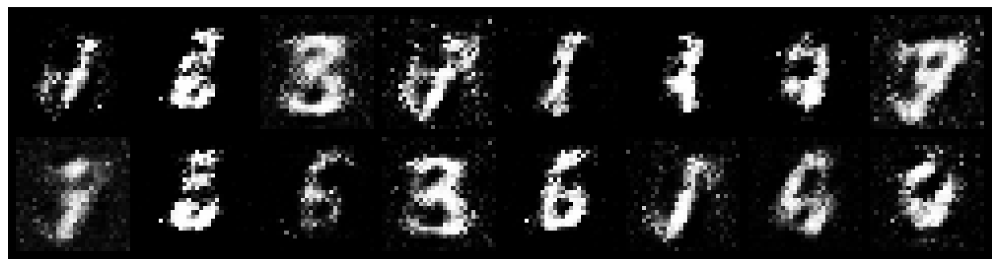

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.7271, Generator Loss: 1.8750
D(x): 0.8121, D(G(z)): 0.2681


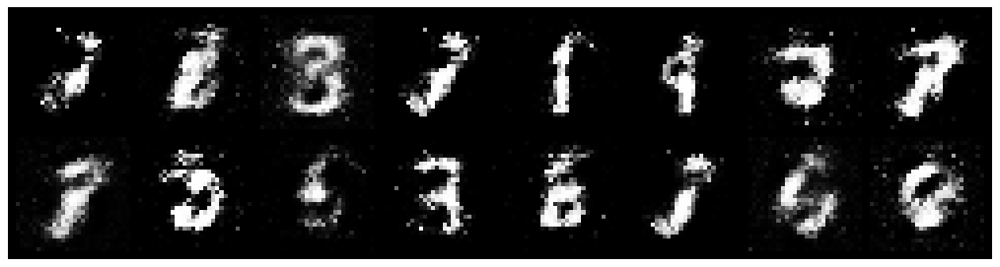

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.9241, Generator Loss: 1.6518
D(x): 0.7530, D(G(z)): 0.3175


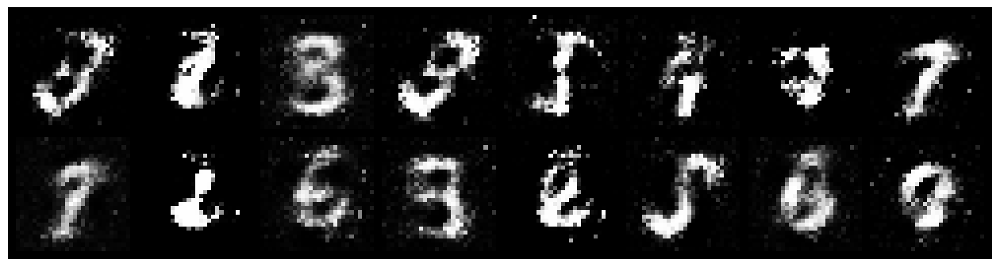

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.8239, Generator Loss: 1.7549
D(x): 0.7103, D(G(z)): 0.2588


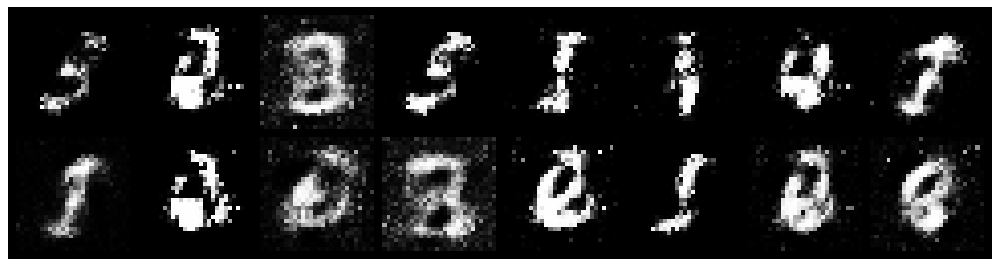

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.9547, Generator Loss: 1.7599
D(x): 0.6962, D(G(z)): 0.2953


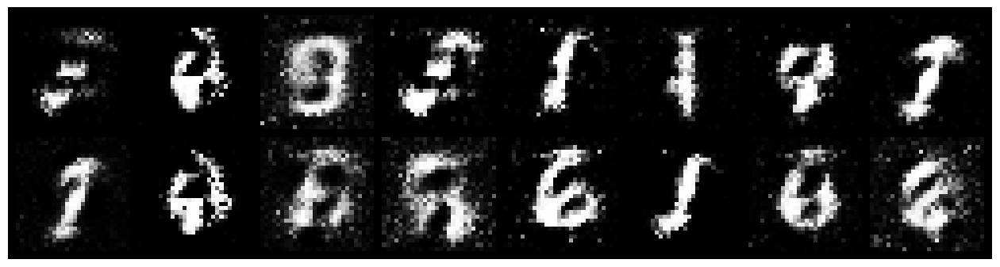

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.6220, Generator Loss: 1.7516
D(x): 0.8161, D(G(z)): 0.2628


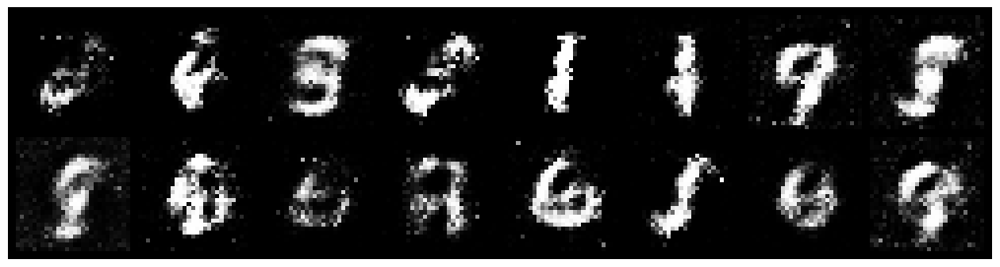

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.8314, Generator Loss: 1.9083
D(x): 0.6901, D(G(z)): 0.2284


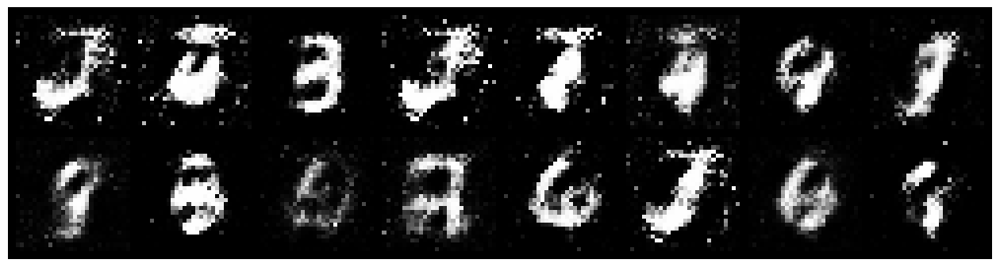

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.6638, Generator Loss: 2.3113
D(x): 0.8210, D(G(z)): 0.2704


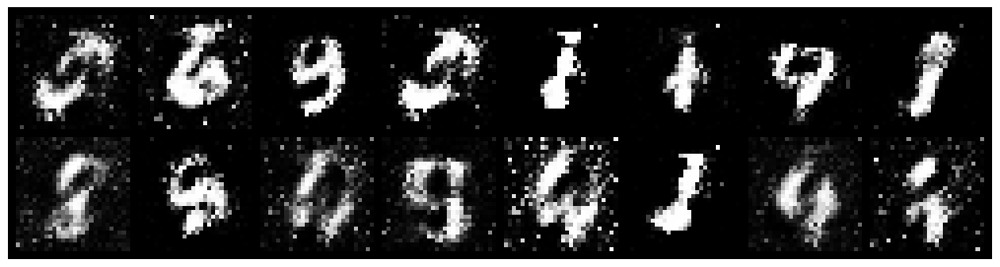

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.5688, Generator Loss: 2.4120
D(x): 0.8346, D(G(z)): 0.2090


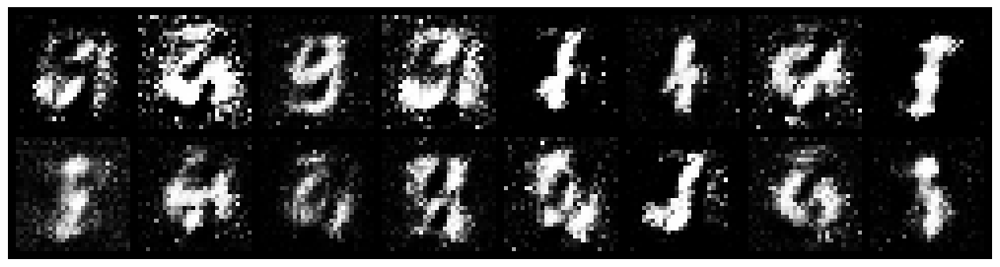

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7360, Generator Loss: 1.9420
D(x): 0.7126, D(G(z)): 0.2170


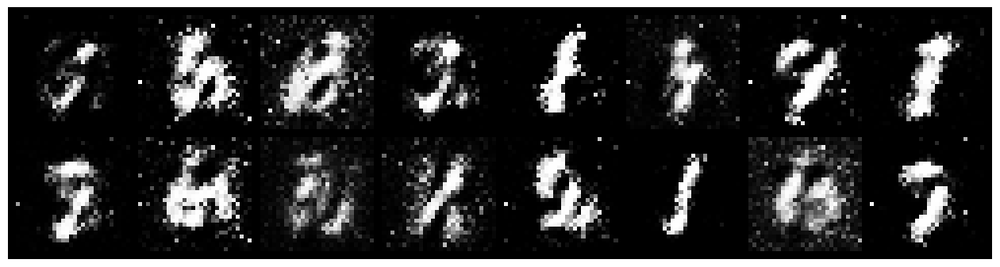

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.9293, Generator Loss: 1.2913
D(x): 0.7781, D(G(z)): 0.3902


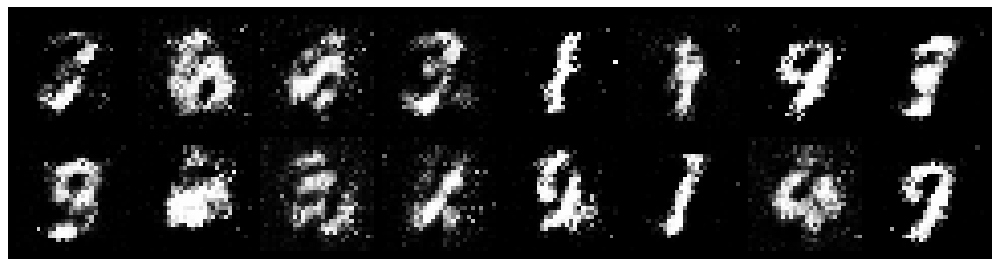

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.8518, Generator Loss: 1.3932
D(x): 0.7358, D(G(z)): 0.3070


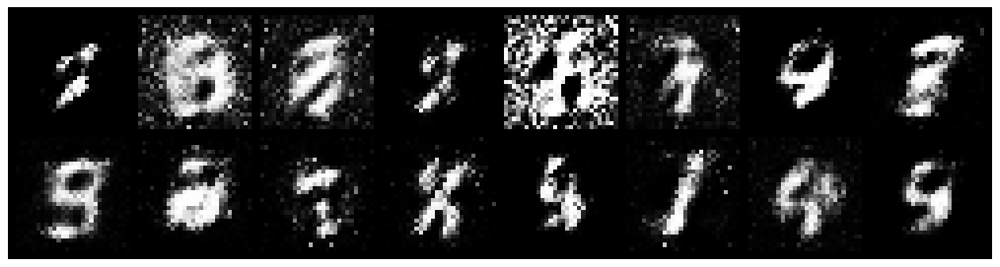

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 1.0086, Generator Loss: 1.2663
D(x): 0.7699, D(G(z)): 0.3953


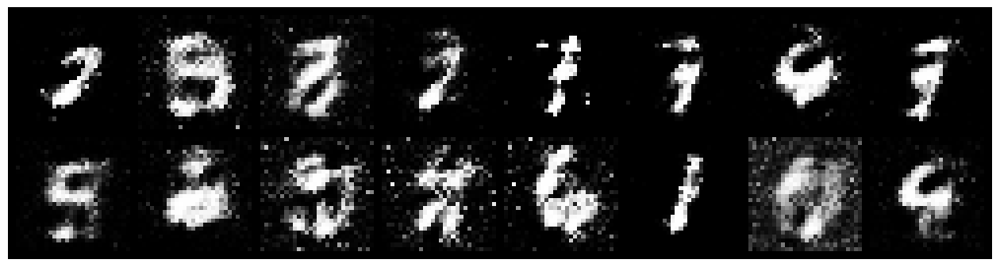

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7264, Generator Loss: 2.0594
D(x): 0.8140, D(G(z)): 0.3080


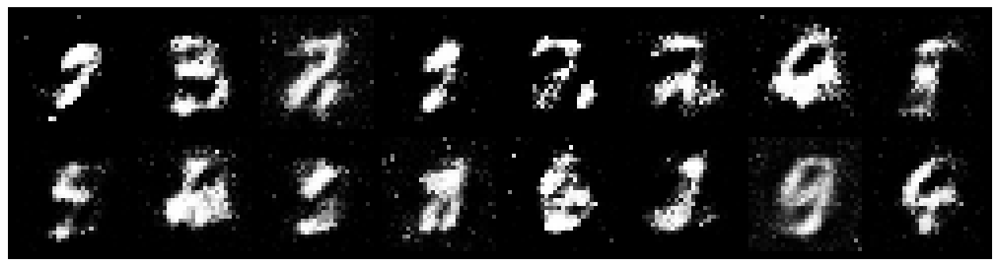

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.9937, Generator Loss: 1.2716
D(x): 0.6866, D(G(z)): 0.2951


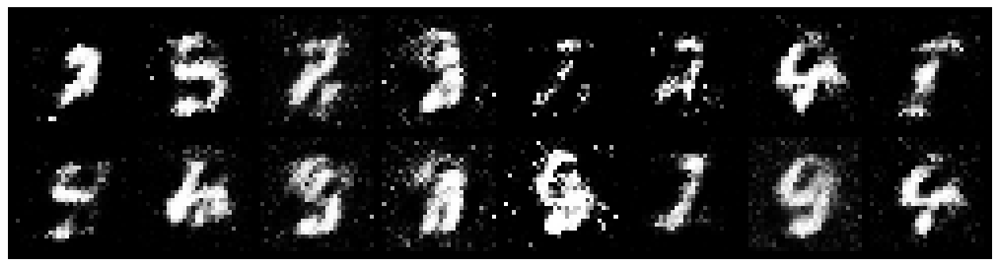

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.6341, Generator Loss: 1.8423
D(x): 0.7770, D(G(z)): 0.2159


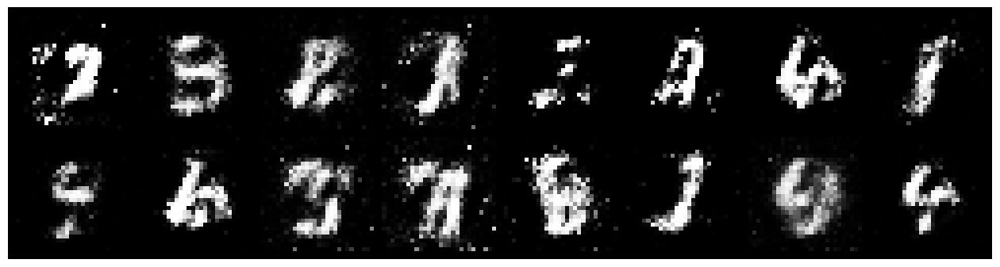

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.6652, Generator Loss: 1.8762
D(x): 0.7753, D(G(z)): 0.2021


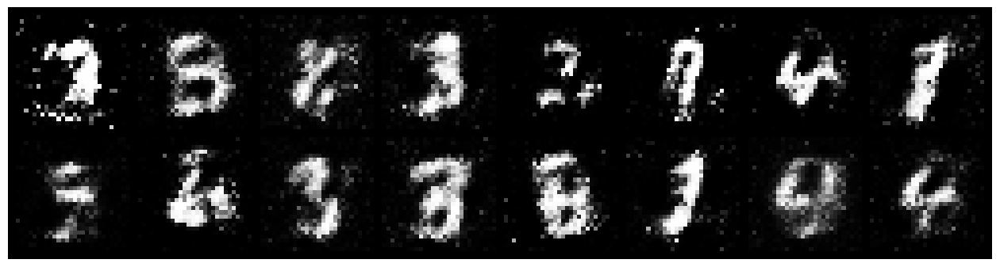

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.5997, Generator Loss: 2.5176
D(x): 0.7802, D(G(z)): 0.1846


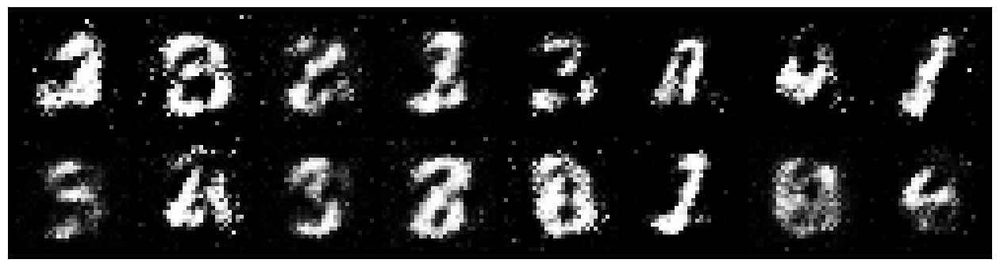

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.8731, Generator Loss: 1.5725
D(x): 0.7108, D(G(z)): 0.3145


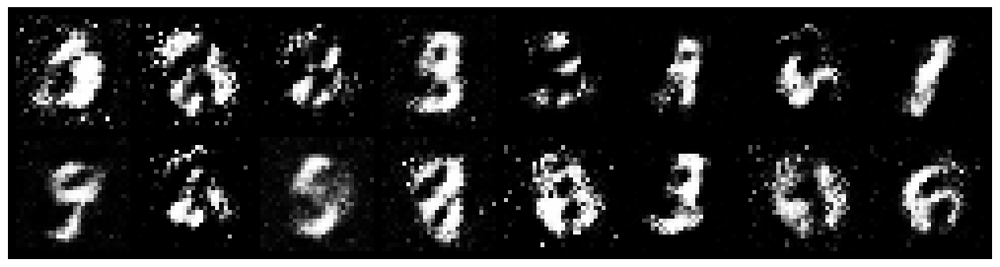

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.7473, Generator Loss: 1.5110
D(x): 0.7486, D(G(z)): 0.2678


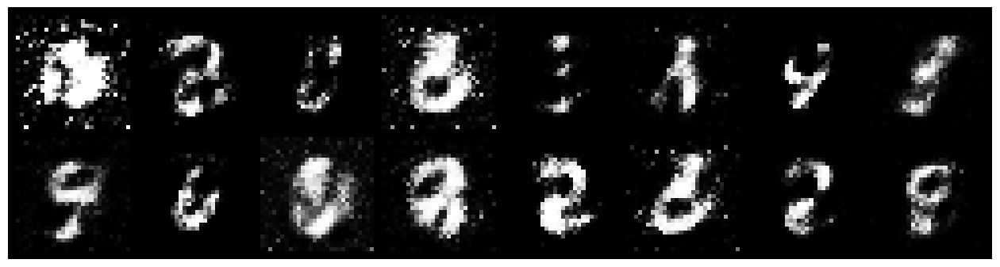

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7424, Generator Loss: 2.0472
D(x): 0.7457, D(G(z)): 0.2000


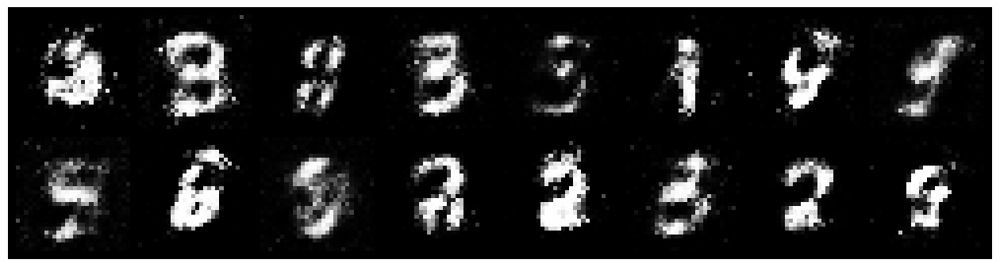

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.7792, Generator Loss: 2.1091
D(x): 0.8197, D(G(z)): 0.2775


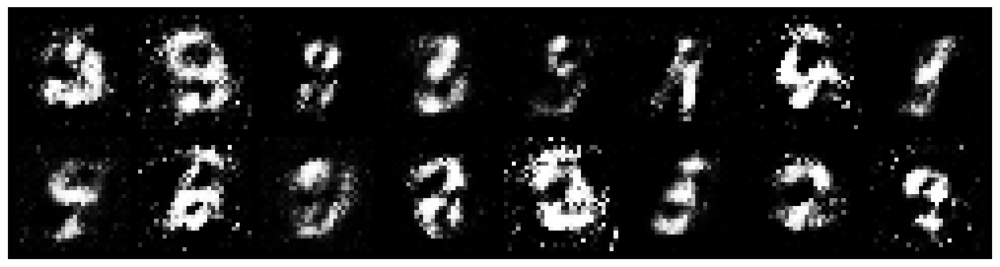

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.8923, Generator Loss: 1.6600
D(x): 0.7279, D(G(z)): 0.2695


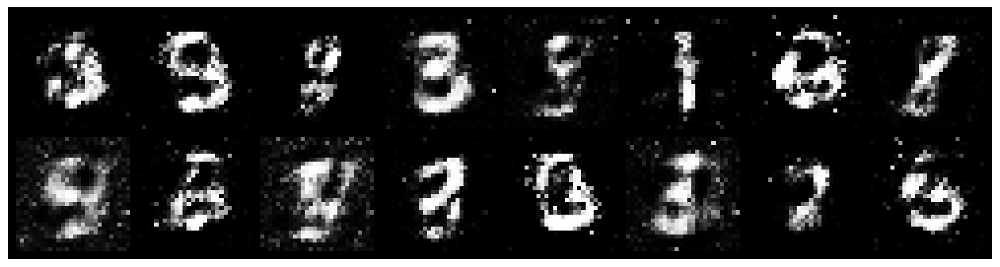

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.7814, Generator Loss: 1.7932
D(x): 0.7992, D(G(z)): 0.2906


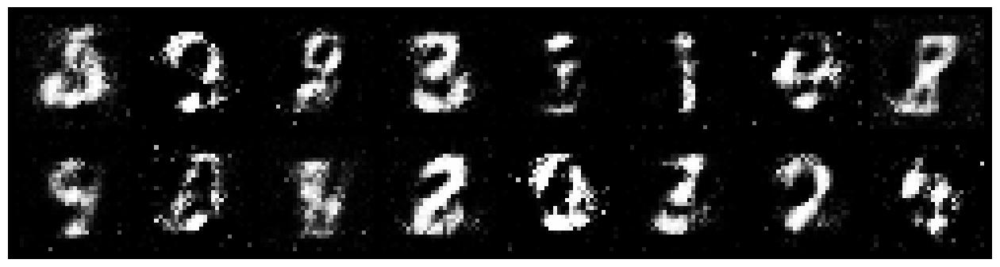

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.7820, Generator Loss: 1.5115
D(x): 0.8082, D(G(z)): 0.3291


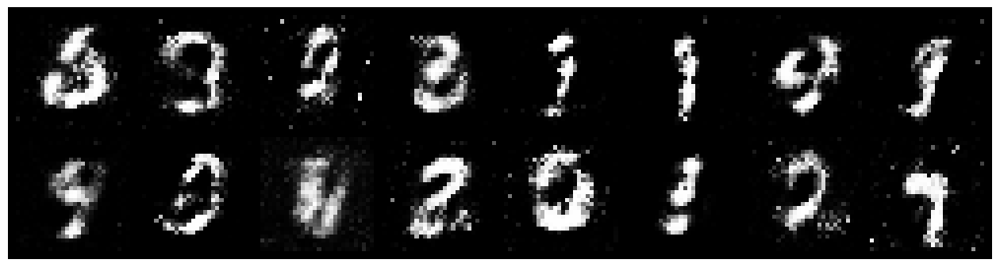

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.7942, Generator Loss: 1.6946
D(x): 0.6782, D(G(z)): 0.1711


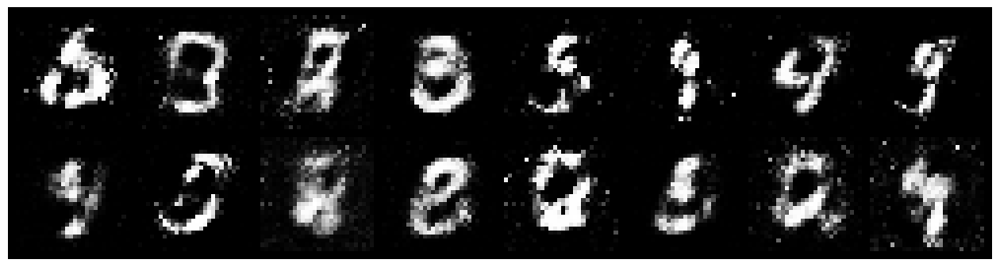

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 1.1581, Generator Loss: 1.7166
D(x): 0.6731, D(G(z)): 0.3144


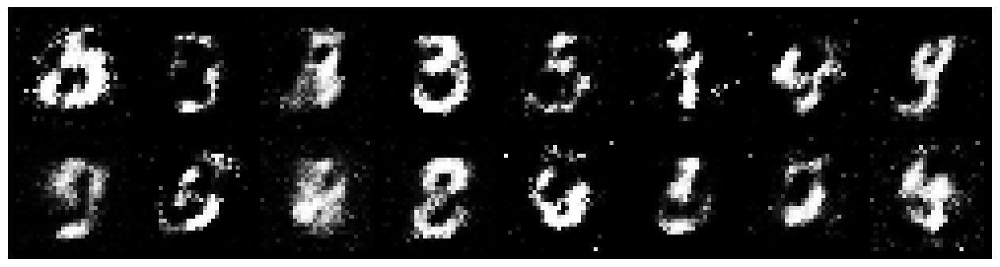

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 1.0253, Generator Loss: 1.5269
D(x): 0.7034, D(G(z)): 0.3362


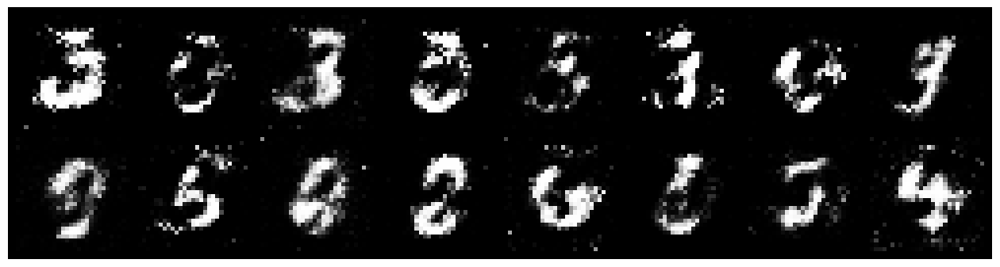

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.5826, Generator Loss: 2.4097
D(x): 0.7604, D(G(z)): 0.1657


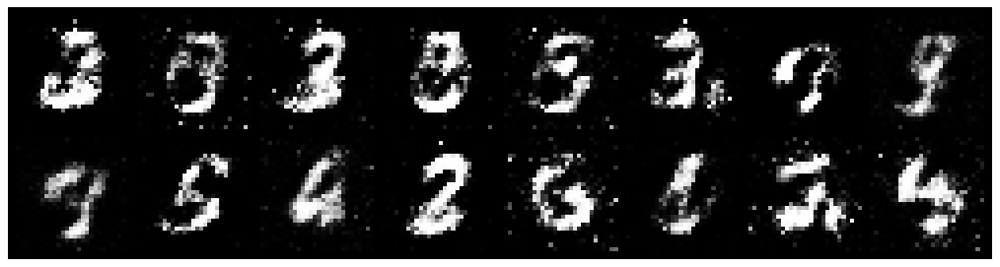

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8265, Generator Loss: 1.6881
D(x): 0.7500, D(G(z)): 0.2636


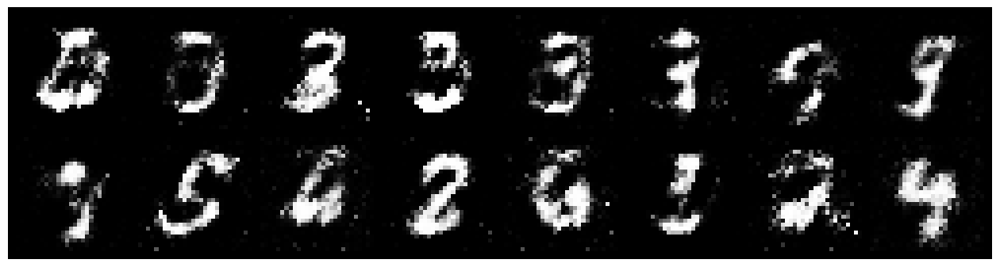

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7781, Generator Loss: 2.0235
D(x): 0.7765, D(G(z)): 0.2480


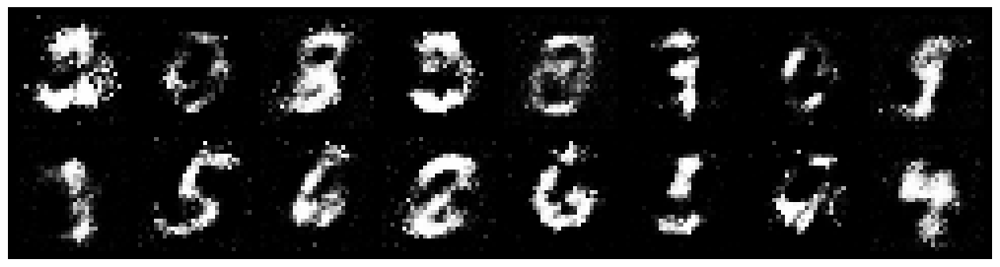

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.8975, Generator Loss: 2.1101
D(x): 0.6959, D(G(z)): 0.2425


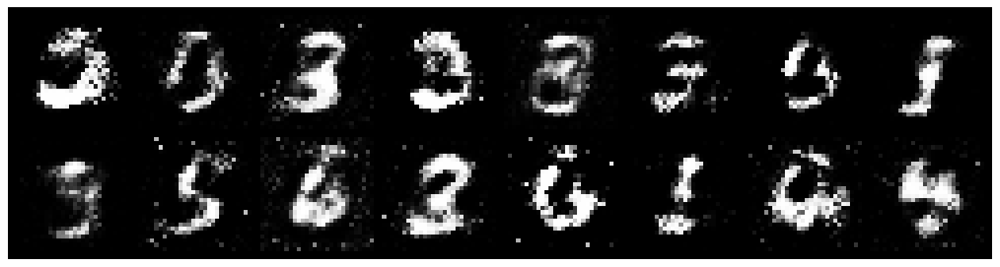

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7089, Generator Loss: 1.8700
D(x): 0.7653, D(G(z)): 0.2620


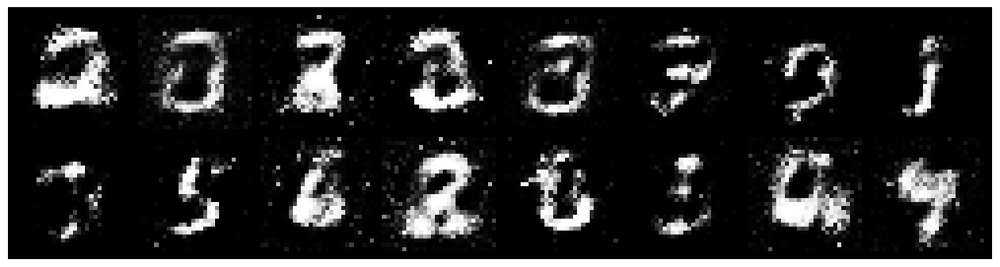

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.8896, Generator Loss: 1.6241
D(x): 0.7111, D(G(z)): 0.3009


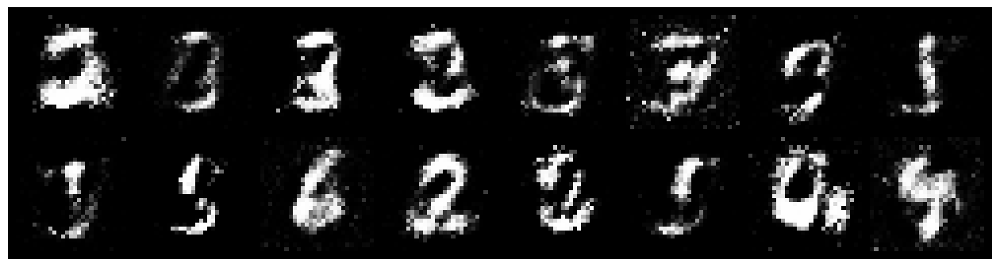

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8293, Generator Loss: 1.3408
D(x): 0.7295, D(G(z)): 0.3303


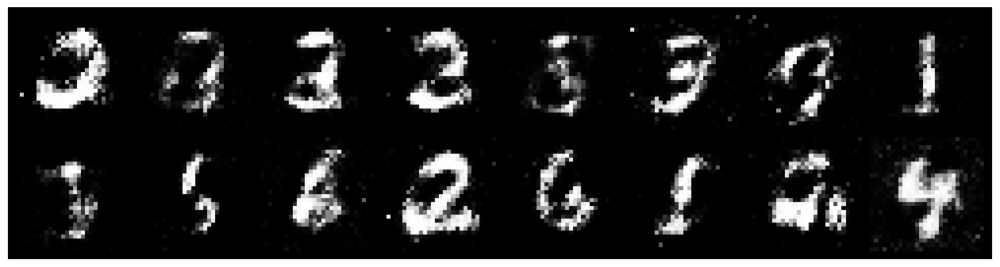

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.9021, Generator Loss: 1.2721
D(x): 0.7518, D(G(z)): 0.3769


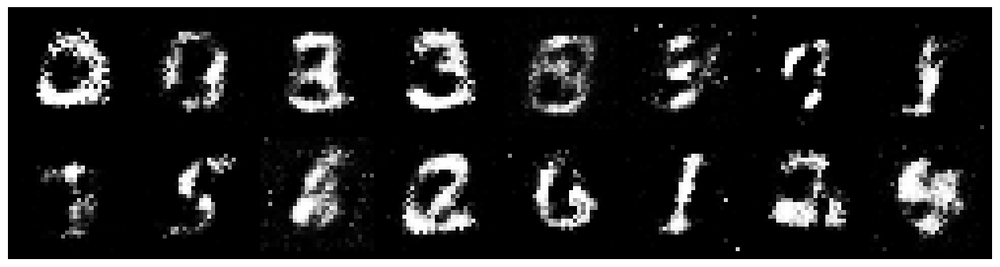

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.7838, Generator Loss: 1.5521
D(x): 0.7408, D(G(z)): 0.2684


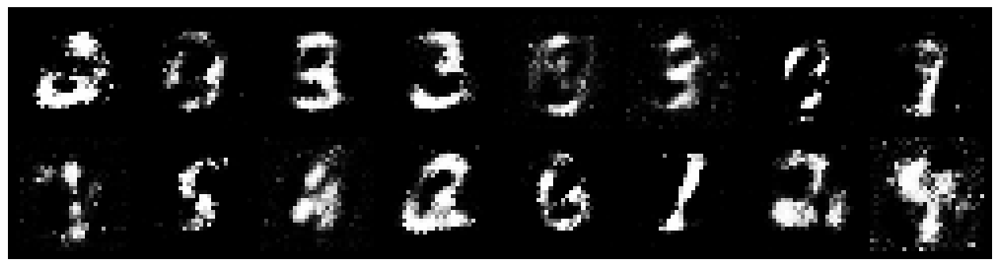

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.7966, Generator Loss: 1.7757
D(x): 0.7158, D(G(z)): 0.2569


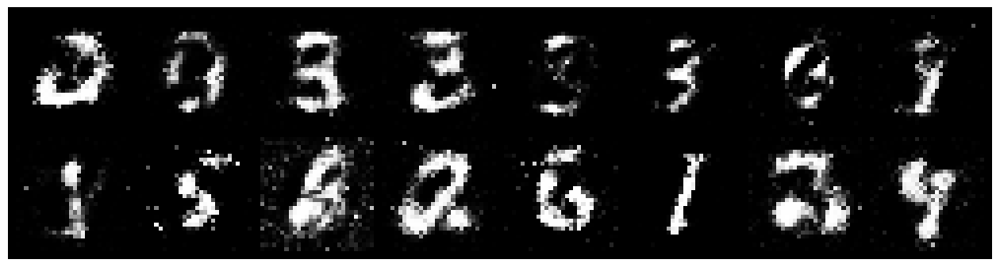

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 1.0898, Generator Loss: 1.4079
D(x): 0.6674, D(G(z)): 0.3678


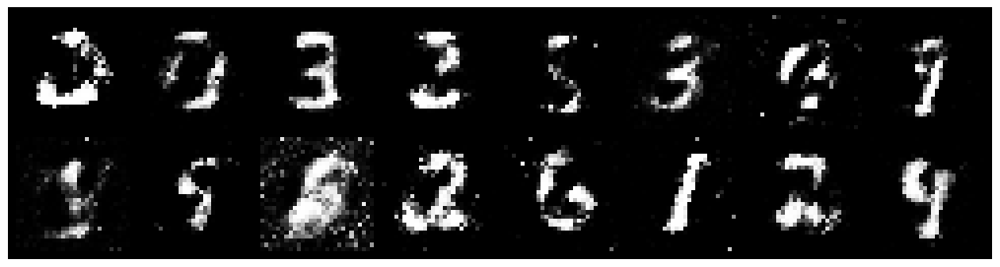

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.1469, Generator Loss: 1.1787
D(x): 0.7213, D(G(z)): 0.4306


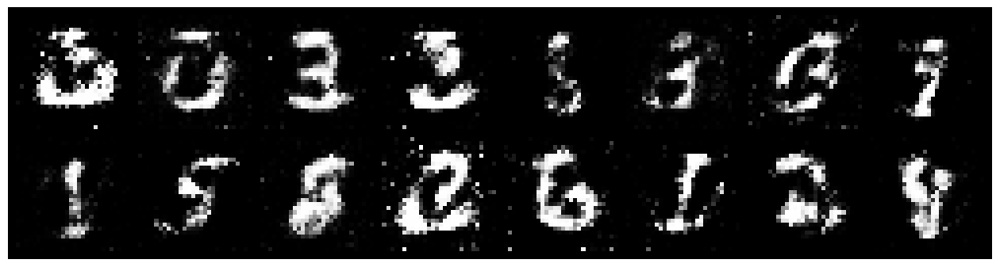

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9404, Generator Loss: 1.9640
D(x): 0.6792, D(G(z)): 0.2522


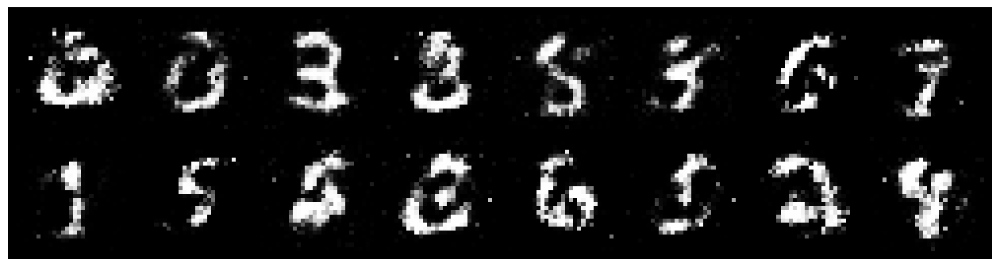

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9961, Generator Loss: 1.4497
D(x): 0.7585, D(G(z)): 0.4196


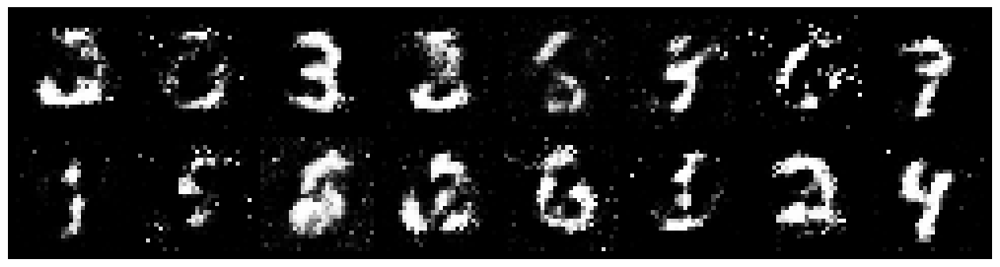

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 1.0925, Generator Loss: 1.8160
D(x): 0.6765, D(G(z)): 0.3418


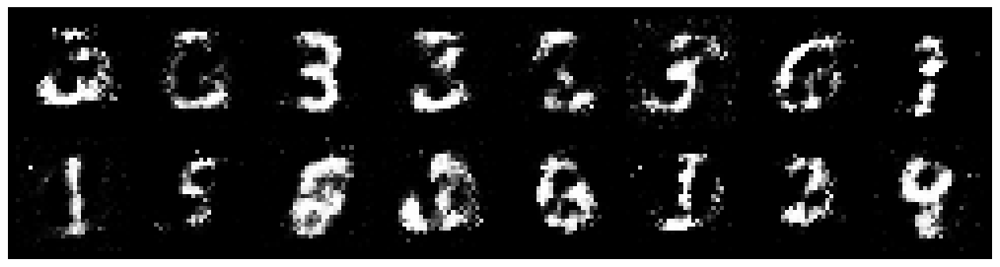

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.8572, Generator Loss: 2.3152
D(x): 0.6671, D(G(z)): 0.1840


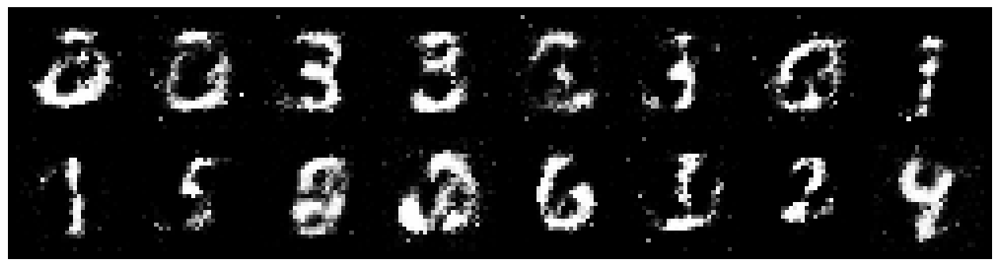

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9411, Generator Loss: 1.5345
D(x): 0.7278, D(G(z)): 0.3140


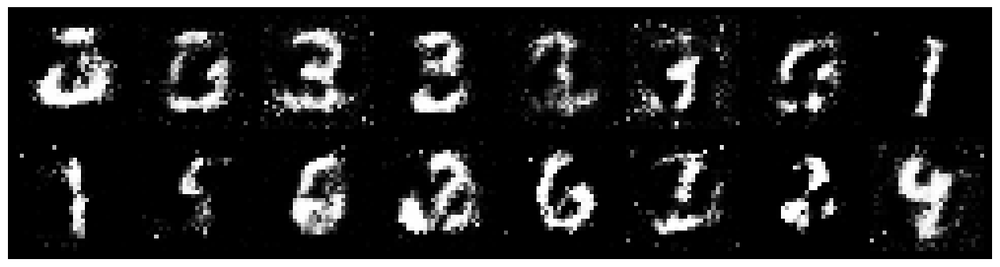

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 1.0609, Generator Loss: 1.5279
D(x): 0.6677, D(G(z)): 0.2879


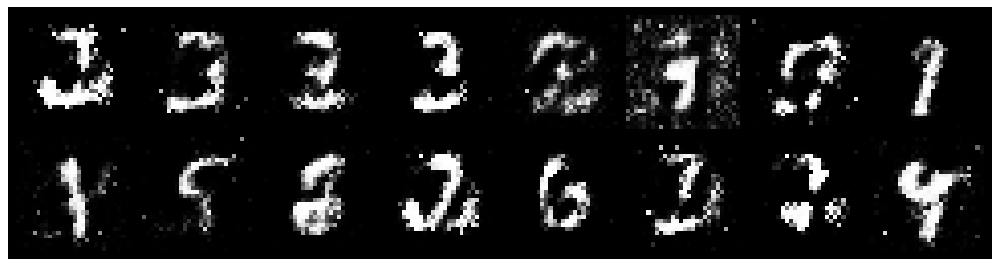

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.1418, Generator Loss: 1.3183
D(x): 0.7198, D(G(z)): 0.4112


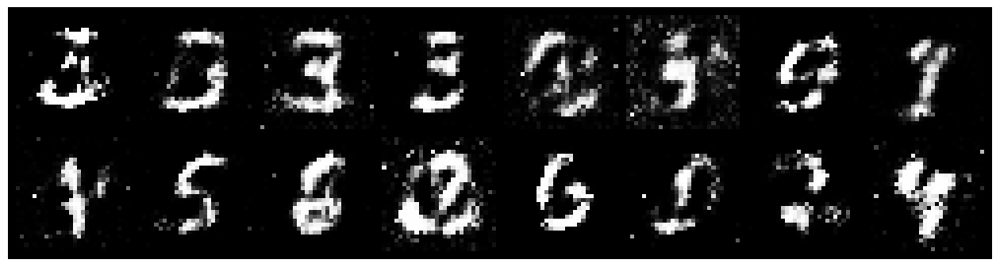

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8743, Generator Loss: 1.2482
D(x): 0.7504, D(G(z)): 0.3472


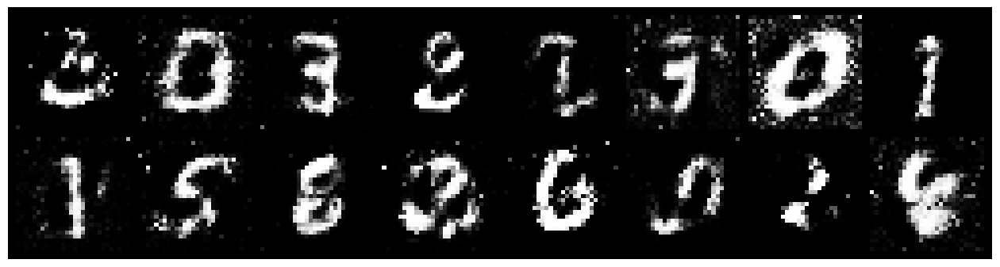

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.7201, Generator Loss: 1.6330
D(x): 0.7953, D(G(z)): 0.2982


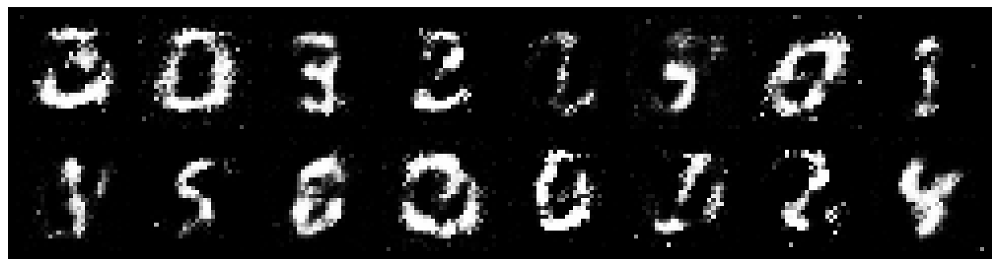

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.9782, Generator Loss: 1.5210
D(x): 0.7066, D(G(z)): 0.3393


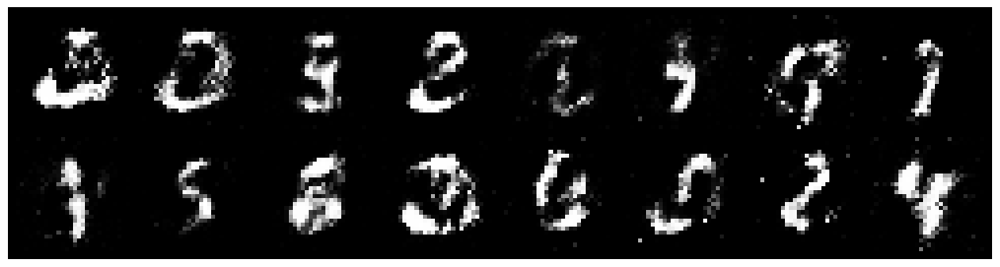

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.8249, Generator Loss: 1.7998
D(x): 0.7081, D(G(z)): 0.2566


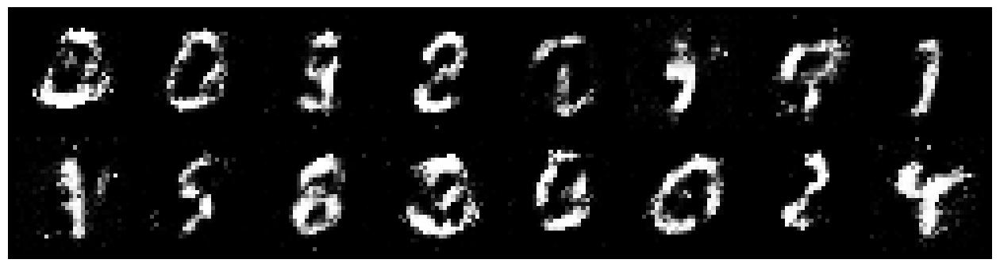

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9768, Generator Loss: 2.4387
D(x): 0.7453, D(G(z)): 0.3459


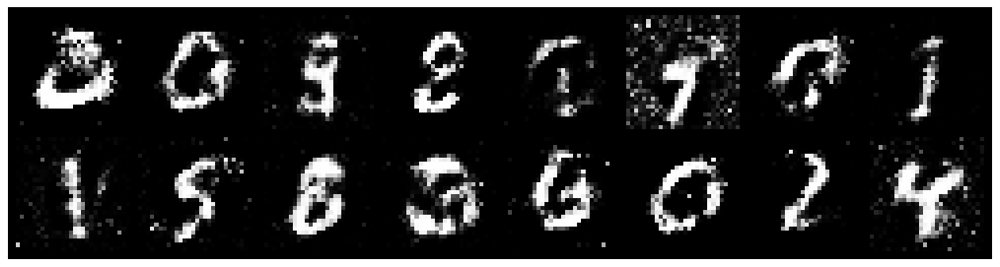

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9522, Generator Loss: 1.5217
D(x): 0.6905, D(G(z)): 0.3008


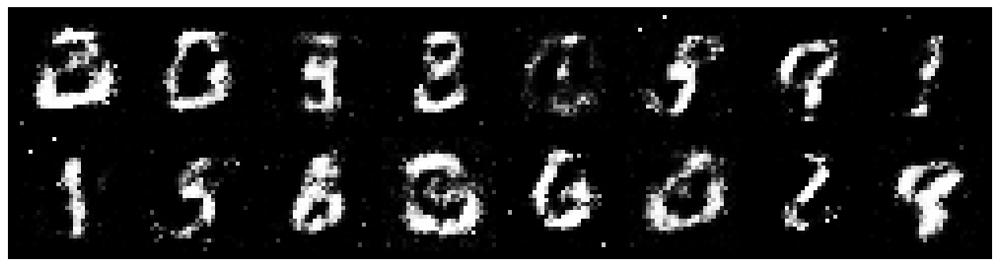

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.7509, Generator Loss: 1.6685
D(x): 0.7675, D(G(z)): 0.2545


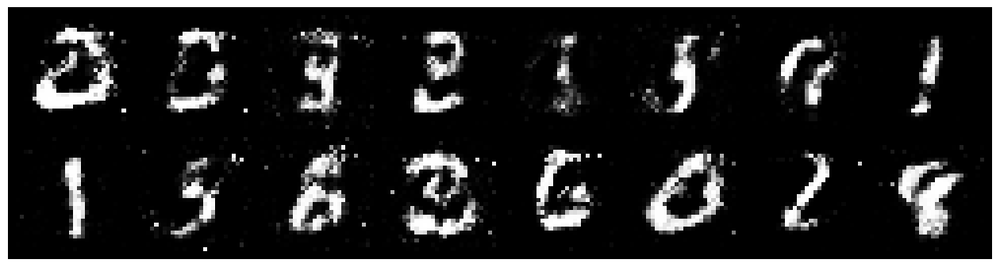

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8491, Generator Loss: 1.6629
D(x): 0.7009, D(G(z)): 0.2671


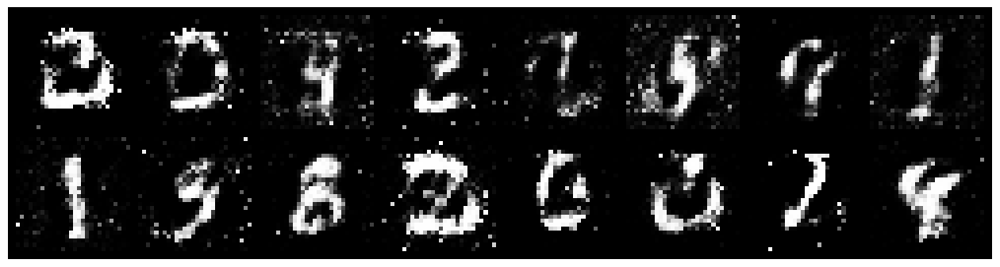

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9850, Generator Loss: 1.6235
D(x): 0.6829, D(G(z)): 0.3316


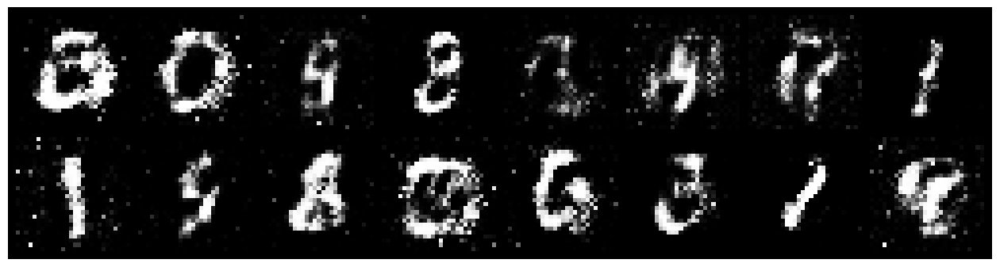

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.8721, Generator Loss: 1.5943
D(x): 0.6911, D(G(z)): 0.2031


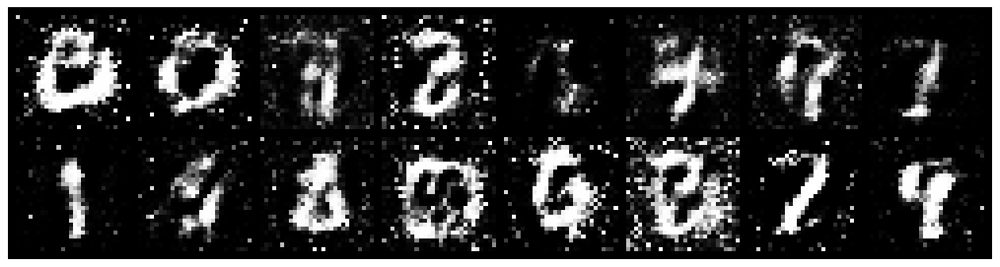

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.0386, Generator Loss: 1.2707
D(x): 0.6938, D(G(z)): 0.3515


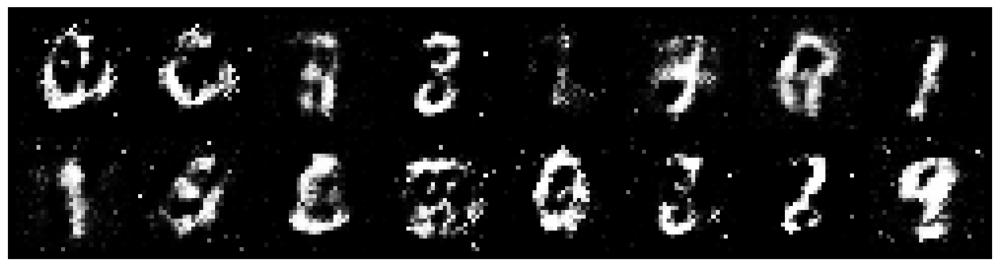

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.0603, Generator Loss: 1.4871
D(x): 0.6475, D(G(z)): 0.3375


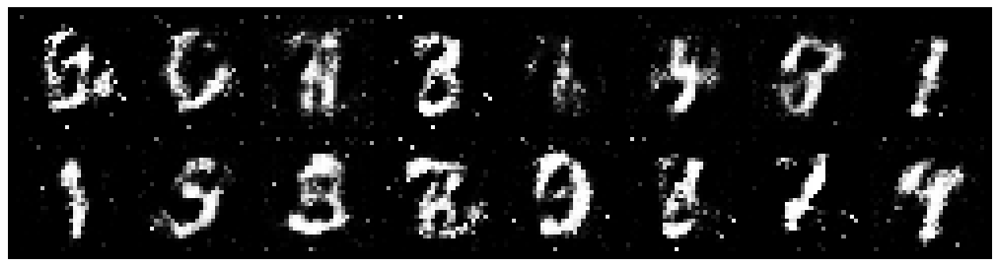

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.8194, Generator Loss: 1.9372
D(x): 0.6913, D(G(z)): 0.2647


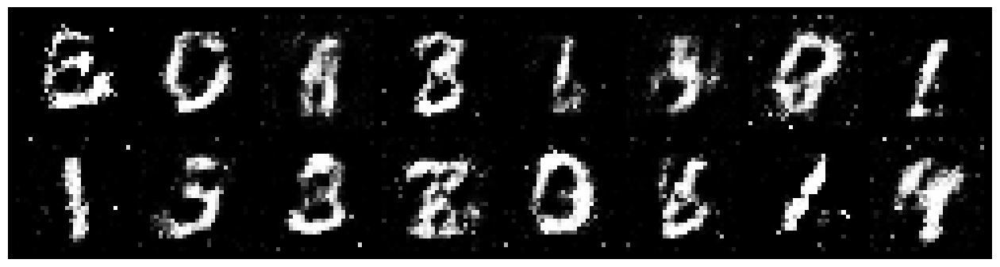

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.7858, Generator Loss: 1.7028
D(x): 0.7337, D(G(z)): 0.2659


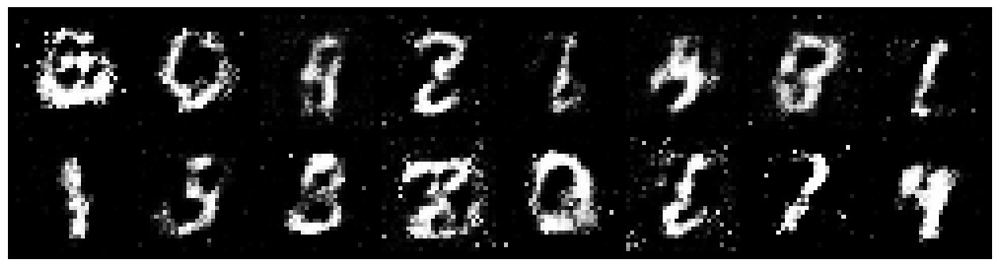

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8421, Generator Loss: 1.9788
D(x): 0.6760, D(G(z)): 0.2268


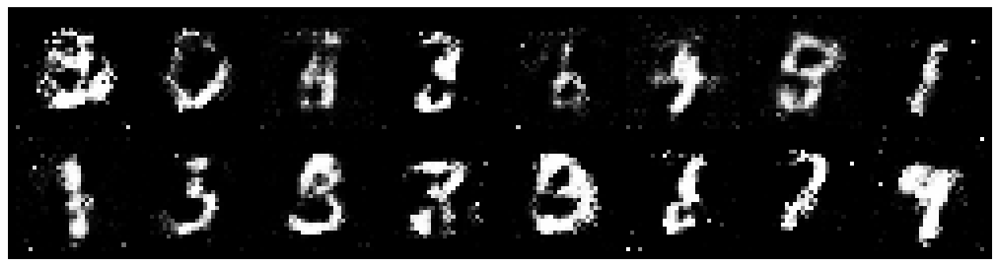

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.6951, Generator Loss: 1.9351
D(x): 0.7998, D(G(z)): 0.2771


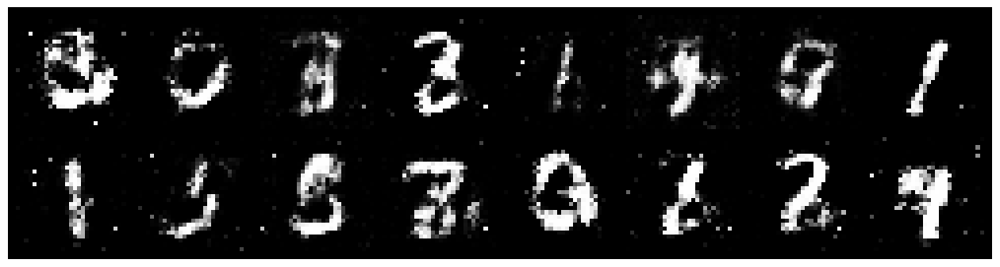

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8542, Generator Loss: 1.6587
D(x): 0.7636, D(G(z)): 0.3327


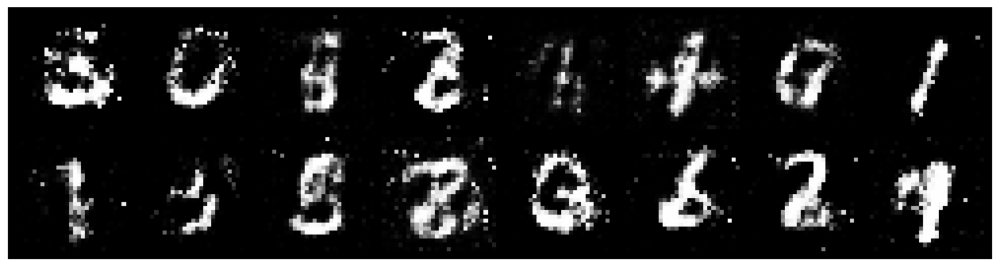

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.9512, Generator Loss: 1.4938
D(x): 0.7082, D(G(z)): 0.3448


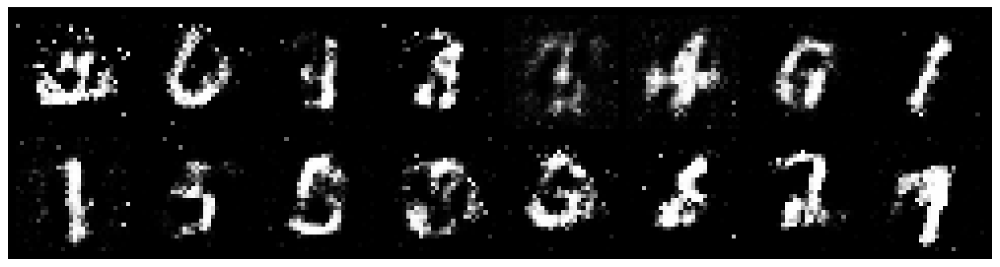

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.7230, Generator Loss: 1.8265
D(x): 0.7790, D(G(z)): 0.2891


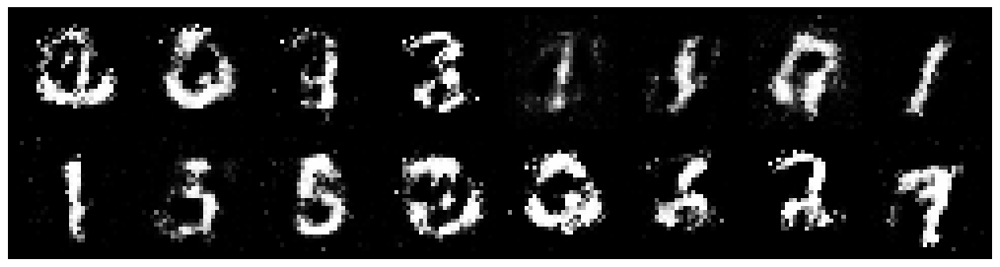

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7494, Generator Loss: 1.7328
D(x): 0.7501, D(G(z)): 0.2602


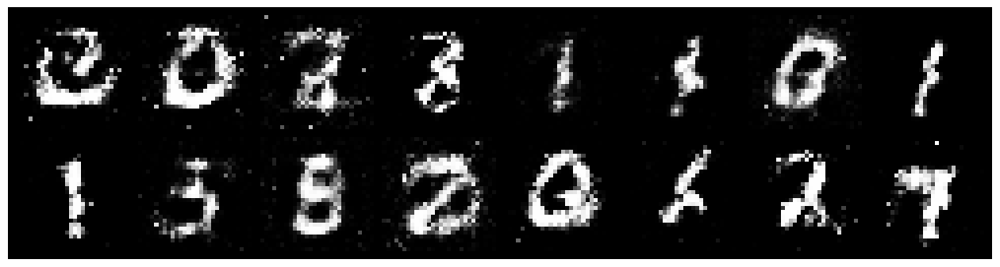

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9523, Generator Loss: 1.4008
D(x): 0.6370, D(G(z)): 0.2726


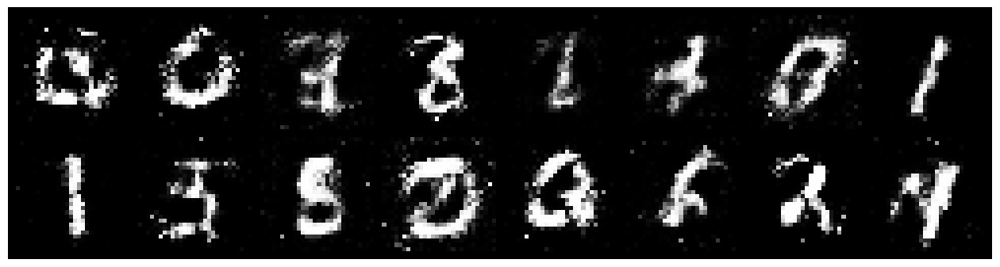

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.0318, Generator Loss: 1.3518
D(x): 0.7183, D(G(z)): 0.3871


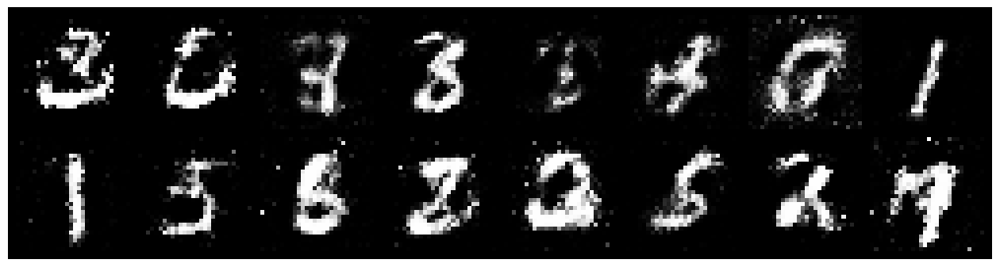

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0830, Generator Loss: 1.4719
D(x): 0.6547, D(G(z)): 0.3572


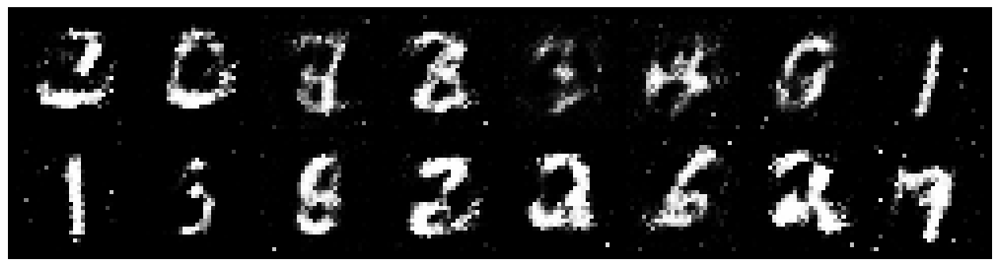

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8269, Generator Loss: 1.5904
D(x): 0.7157, D(G(z)): 0.2771


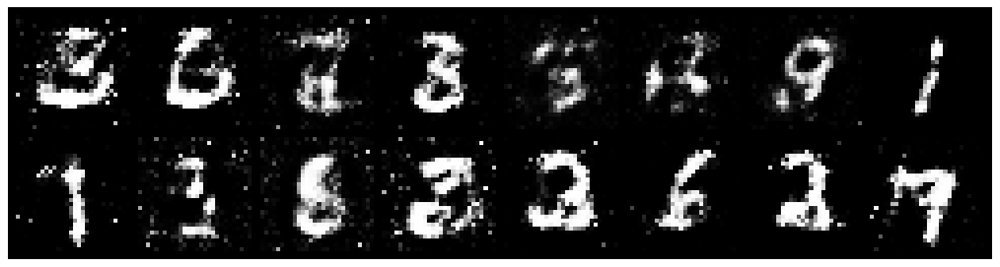

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0646, Generator Loss: 1.4426
D(x): 0.6585, D(G(z)): 0.3407


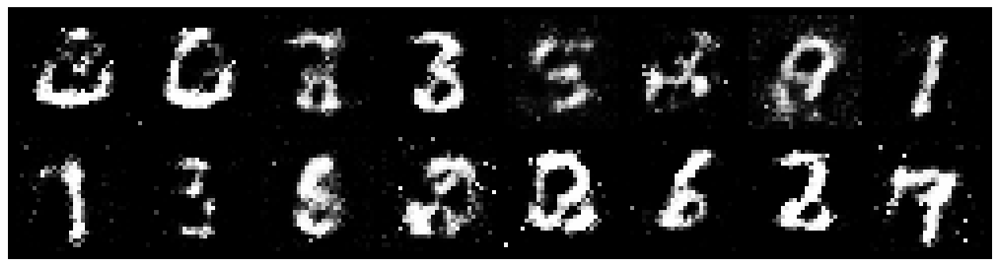

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.9776, Generator Loss: 1.7956
D(x): 0.6235, D(G(z)): 0.2569


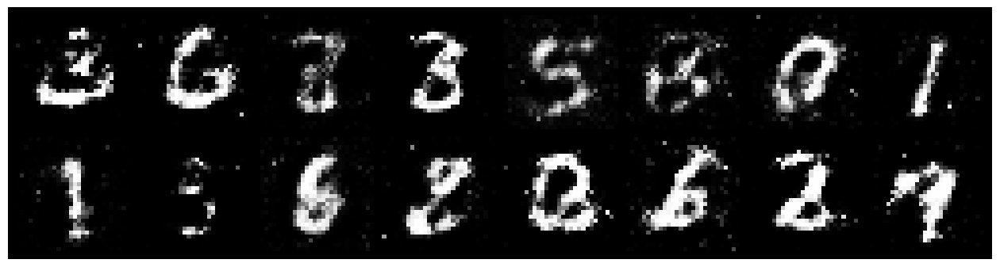

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.7528, Generator Loss: 1.5506
D(x): 0.6913, D(G(z)): 0.2398


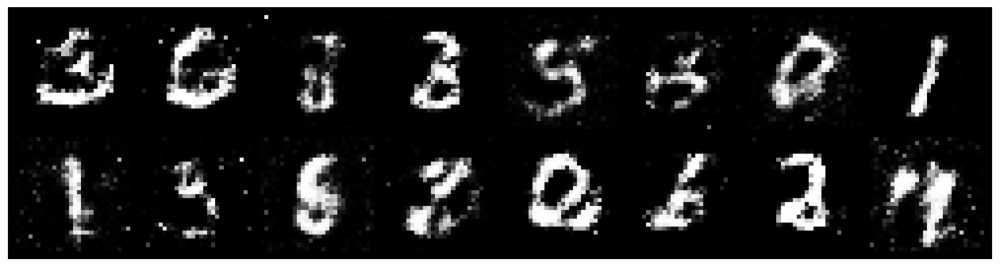

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9318, Generator Loss: 1.0598
D(x): 0.7410, D(G(z)): 0.3825


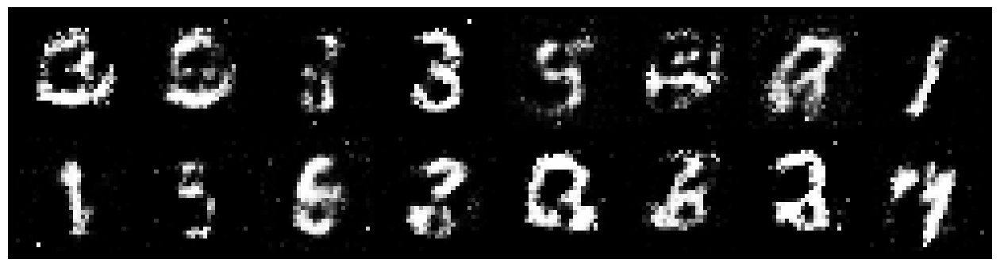

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.7737, Generator Loss: 1.9131
D(x): 0.7202, D(G(z)): 0.2706


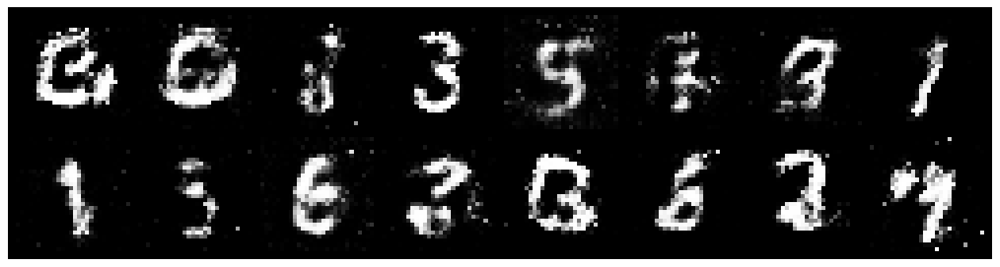

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.7905, Generator Loss: 1.6559
D(x): 0.7483, D(G(z)): 0.2943


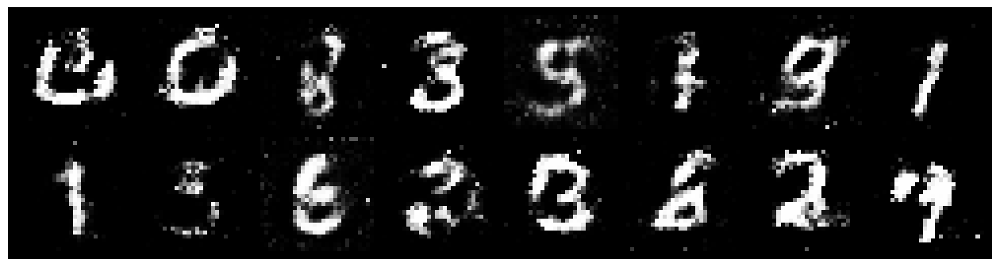

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0955, Generator Loss: 1.5784
D(x): 0.6722, D(G(z)): 0.3704


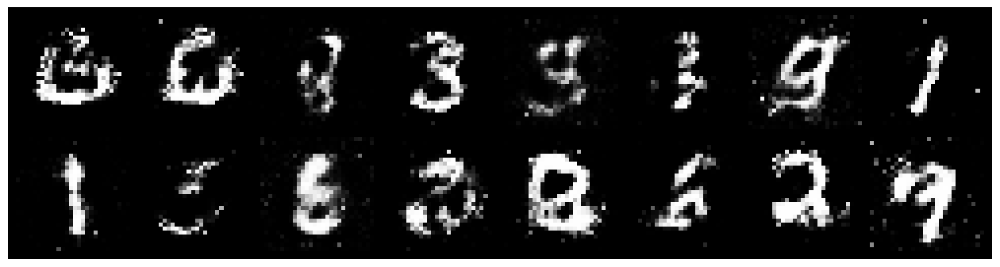

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9343, Generator Loss: 1.5910
D(x): 0.6570, D(G(z)): 0.2701


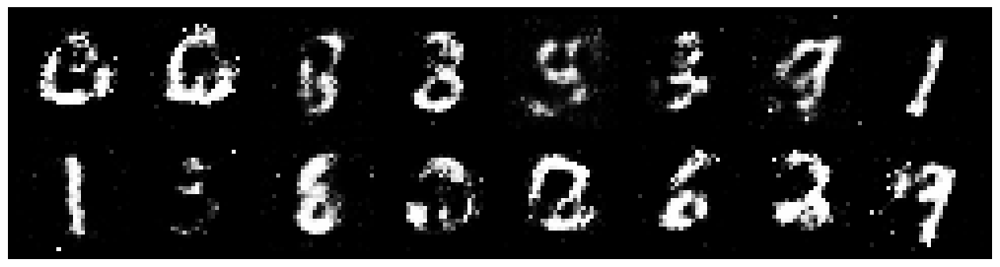

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.0287, Generator Loss: 1.1541
D(x): 0.6424, D(G(z)): 0.3254


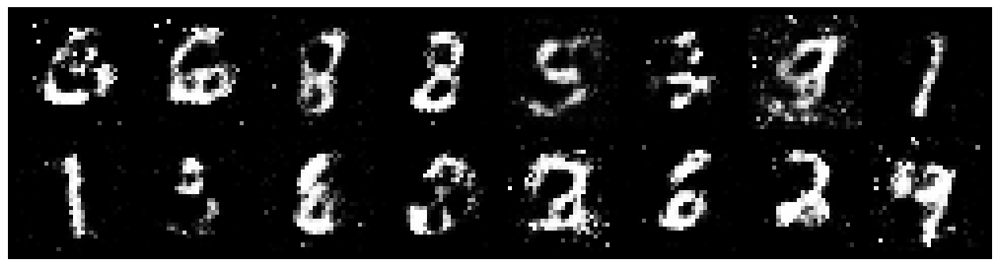

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.9605, Generator Loss: 1.1163
D(x): 0.6909, D(G(z)): 0.3810


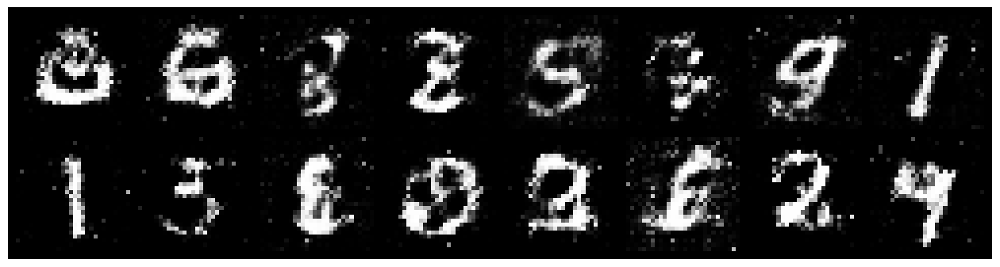

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 1.2172, Generator Loss: 1.4332
D(x): 0.6344, D(G(z)): 0.3760


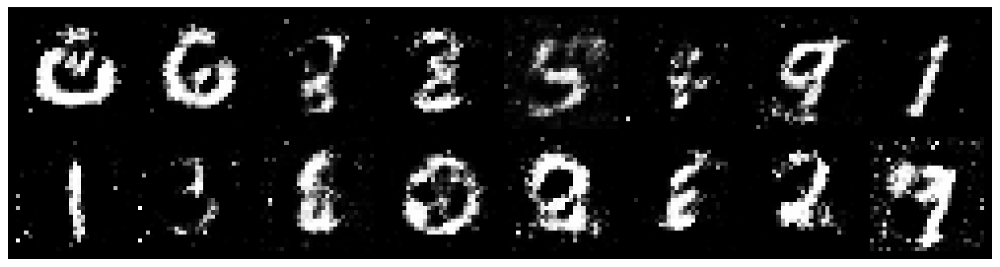

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.0487, Generator Loss: 1.6489
D(x): 0.5924, D(G(z)): 0.2649


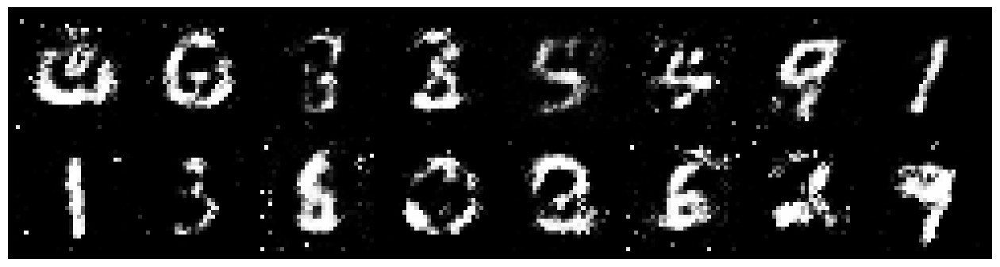

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.9145, Generator Loss: 1.3954
D(x): 0.7200, D(G(z)): 0.3524


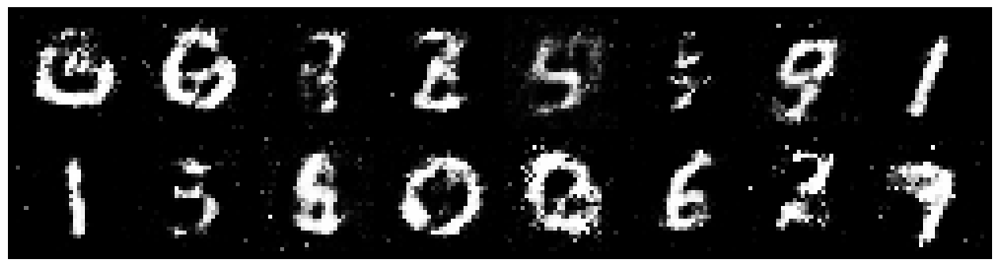

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.8900, Generator Loss: 1.5338
D(x): 0.6490, D(G(z)): 0.2509


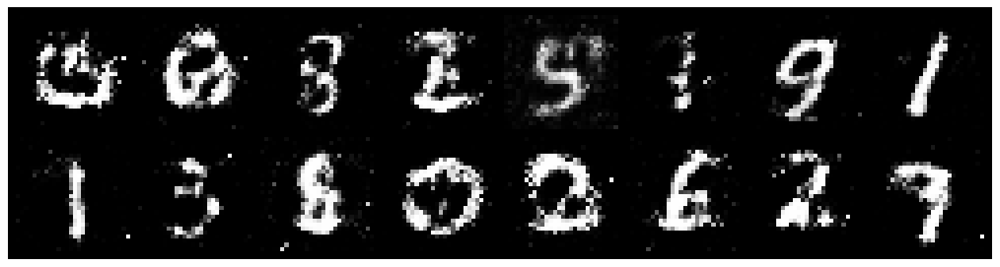

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0503, Generator Loss: 1.1253
D(x): 0.6720, D(G(z)): 0.3720


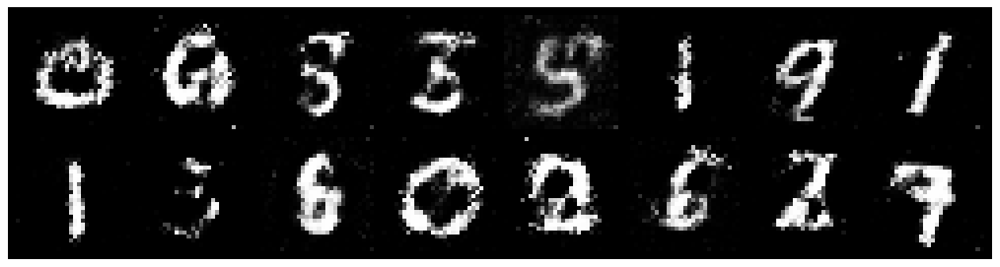

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0153, Generator Loss: 1.3909
D(x): 0.6703, D(G(z)): 0.3624


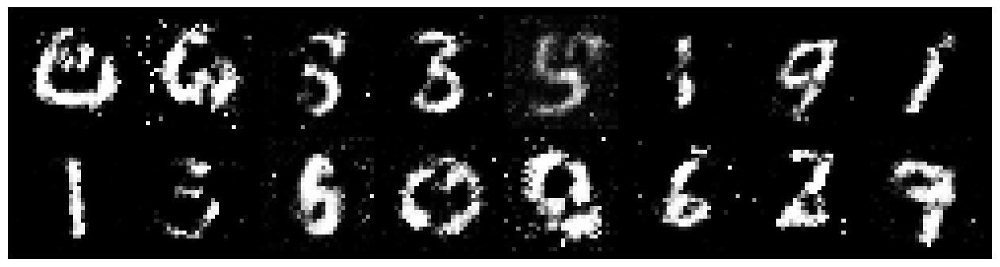

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9855, Generator Loss: 1.3689
D(x): 0.6592, D(G(z)): 0.3207


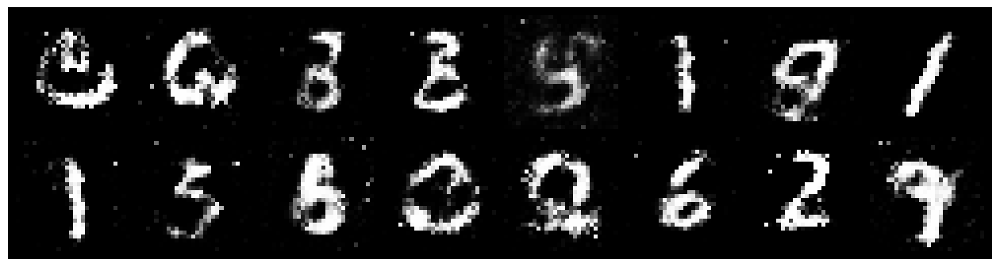

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0616, Generator Loss: 1.3226
D(x): 0.6399, D(G(z)): 0.3457


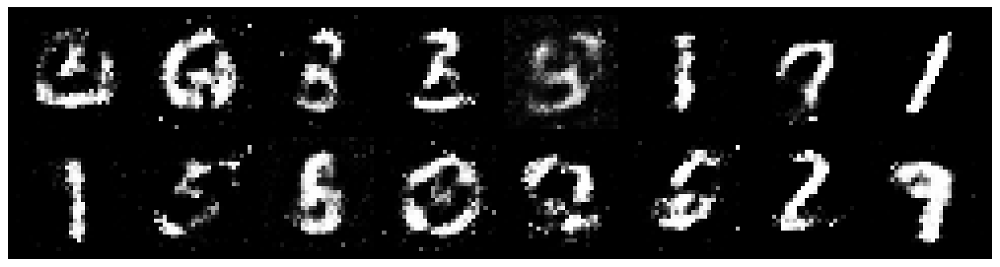

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9586, Generator Loss: 1.3705
D(x): 0.7065, D(G(z)): 0.3550


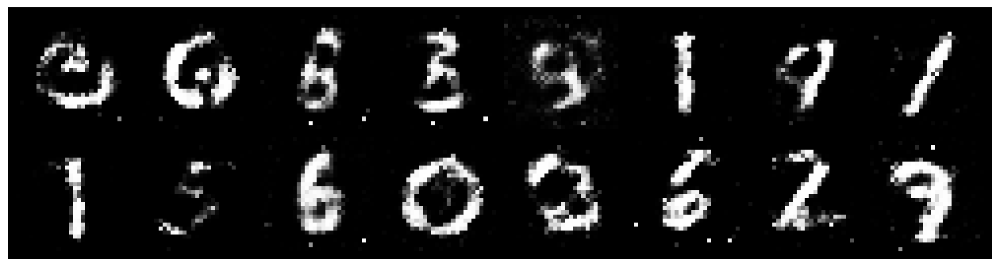

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.0259, Generator Loss: 1.1634
D(x): 0.7191, D(G(z)): 0.4059


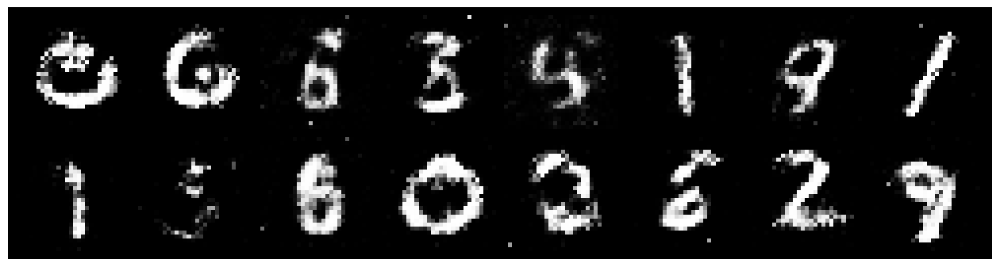

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.2392, Generator Loss: 1.1992
D(x): 0.6261, D(G(z)): 0.4146


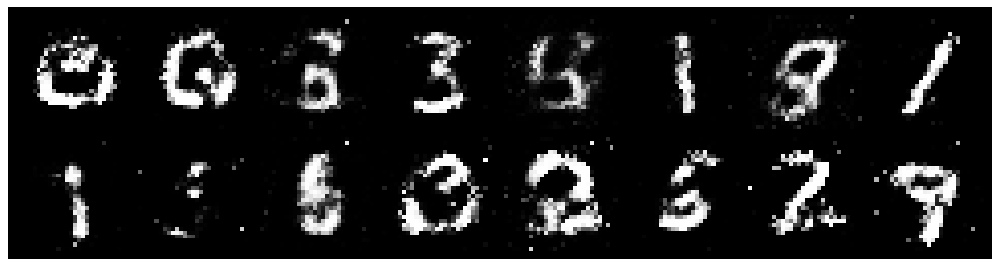

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9824, Generator Loss: 1.5359
D(x): 0.6775, D(G(z)): 0.3538


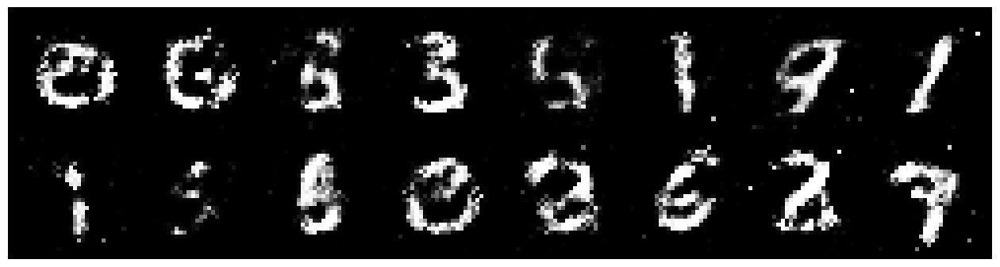

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9886, Generator Loss: 1.1541
D(x): 0.7445, D(G(z)): 0.4098


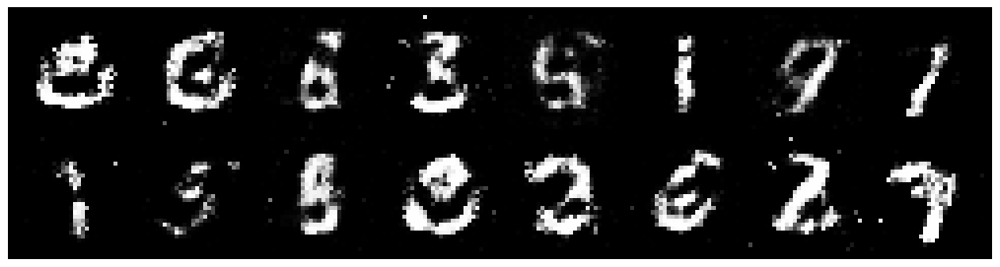

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.0592, Generator Loss: 1.1565
D(x): 0.6021, D(G(z)): 0.3569


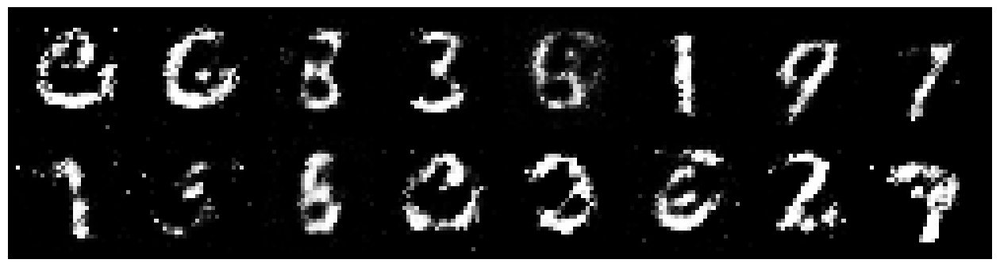

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.9876, Generator Loss: 1.3864
D(x): 0.6986, D(G(z)): 0.3823


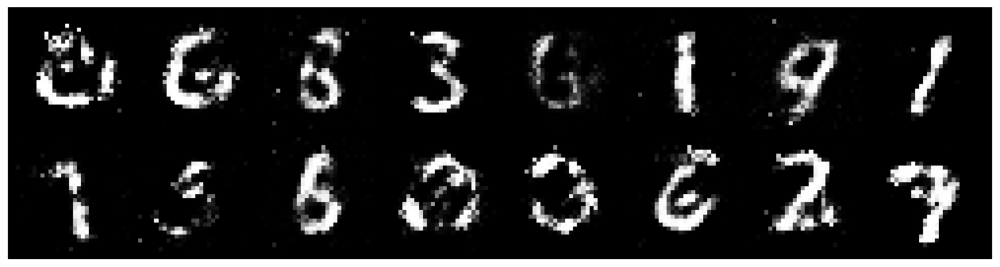

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.9698, Generator Loss: 1.5555
D(x): 0.6848, D(G(z)): 0.3315


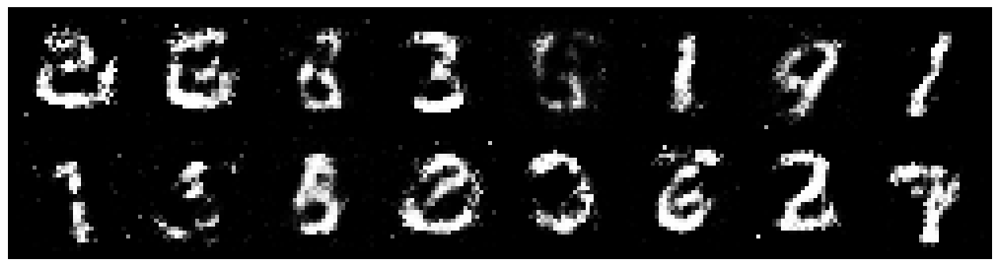

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8687, Generator Loss: 1.7445
D(x): 0.7176, D(G(z)): 0.2951


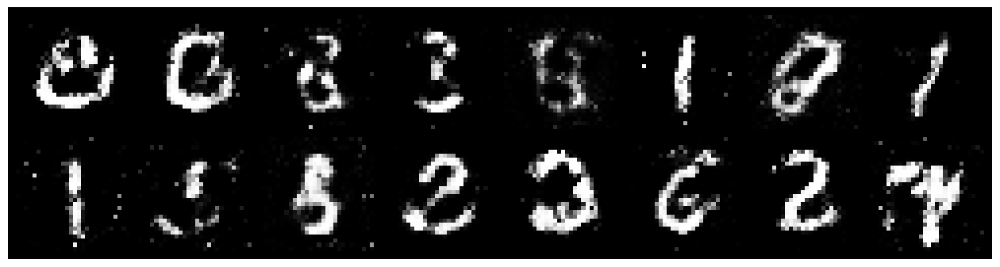

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9314, Generator Loss: 1.3794
D(x): 0.7101, D(G(z)): 0.3217


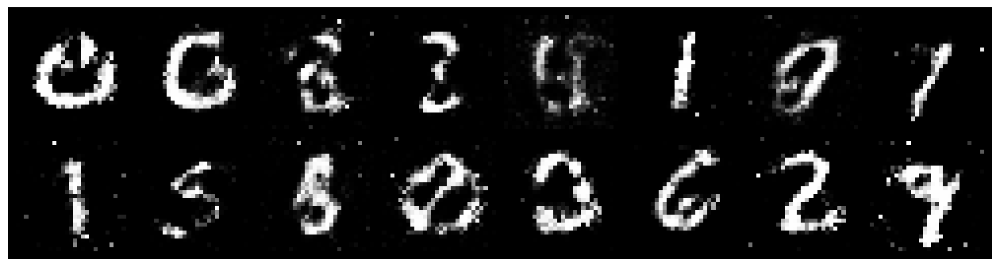

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.1016, Generator Loss: 1.3136
D(x): 0.6093, D(G(z)): 0.3377


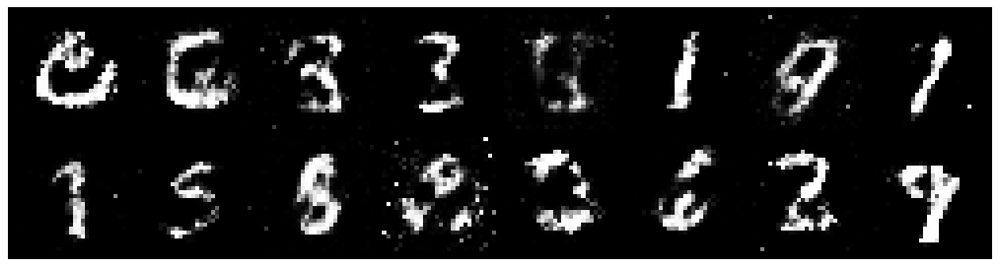

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0811, Generator Loss: 1.1953
D(x): 0.6781, D(G(z)): 0.3939


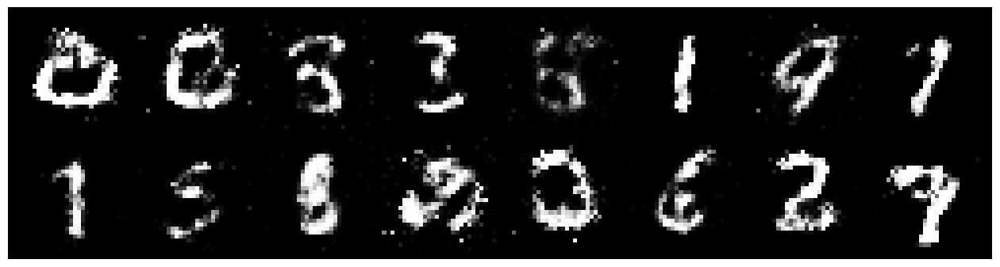

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0494, Generator Loss: 1.7706
D(x): 0.6257, D(G(z)): 0.2601


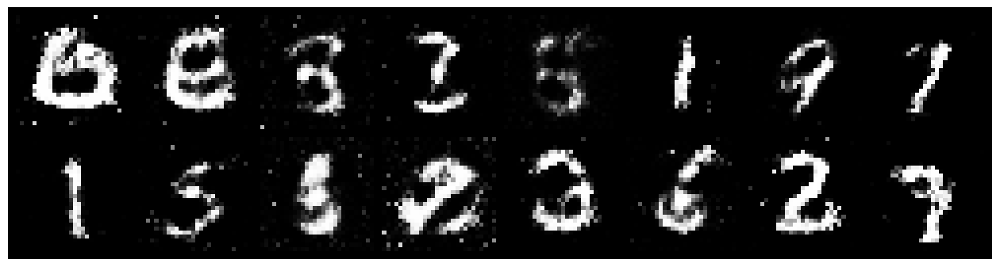

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9865, Generator Loss: 1.4072
D(x): 0.6058, D(G(z)): 0.2420


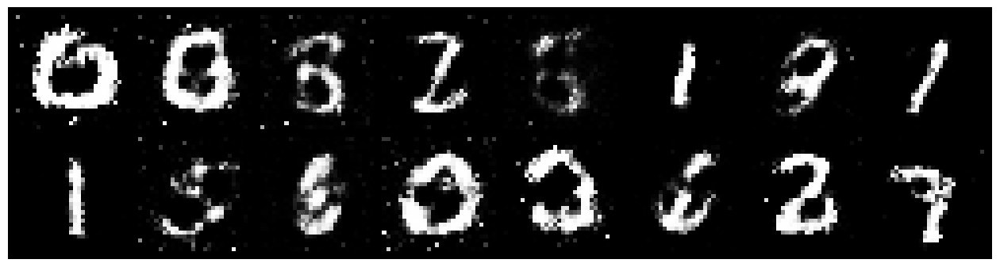

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.1502, Generator Loss: 1.2070
D(x): 0.6106, D(G(z)): 0.3805


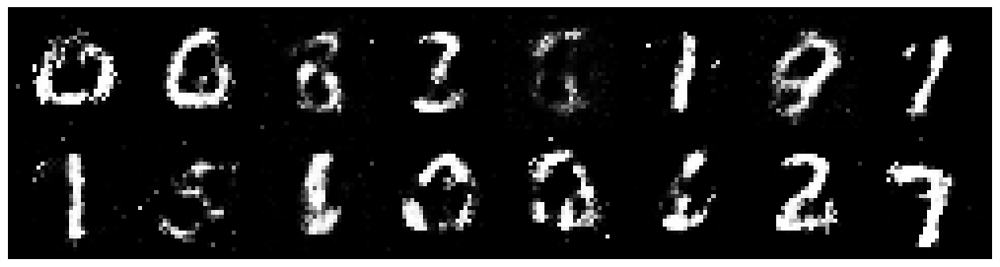

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.9822, Generator Loss: 1.1287
D(x): 0.6622, D(G(z)): 0.3527


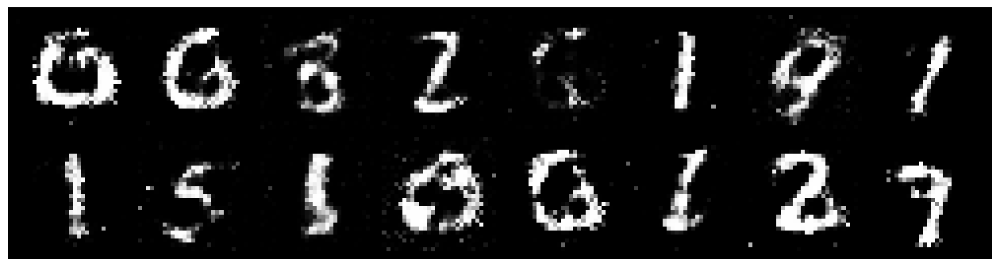

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0230, Generator Loss: 1.1859
D(x): 0.6825, D(G(z)): 0.3625


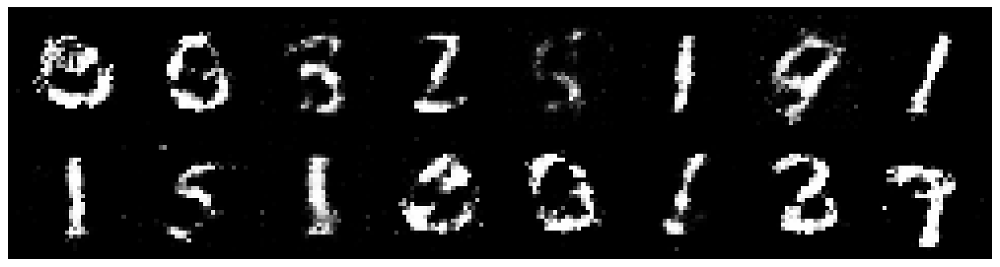

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.0399, Generator Loss: 1.3666
D(x): 0.6054, D(G(z)): 0.3065


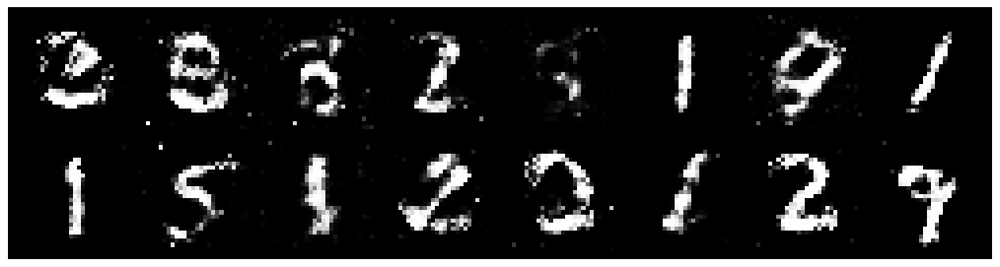

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.2275, Generator Loss: 1.2950
D(x): 0.6126, D(G(z)): 0.3780


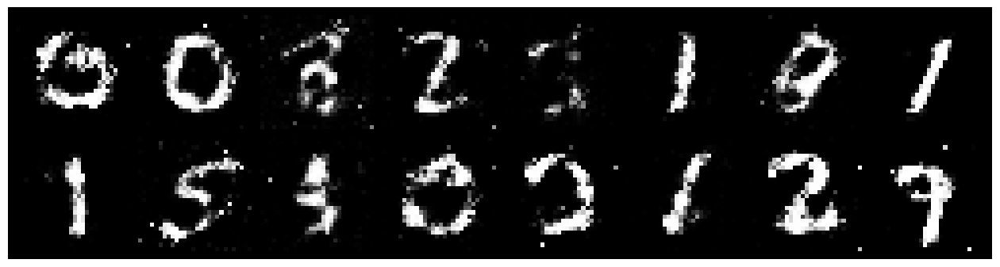

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0535, Generator Loss: 1.0905
D(x): 0.6462, D(G(z)): 0.3814


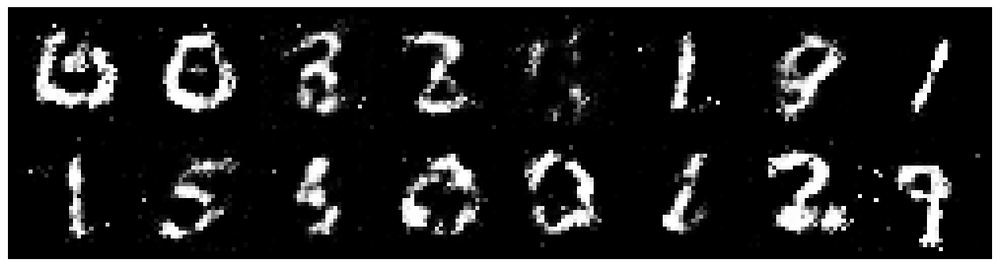

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0800, Generator Loss: 1.3003
D(x): 0.5930, D(G(z)): 0.3132


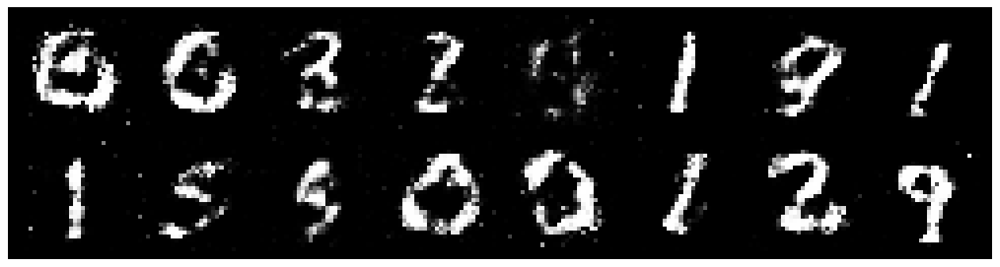

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0193, Generator Loss: 1.3677
D(x): 0.6221, D(G(z)): 0.3156


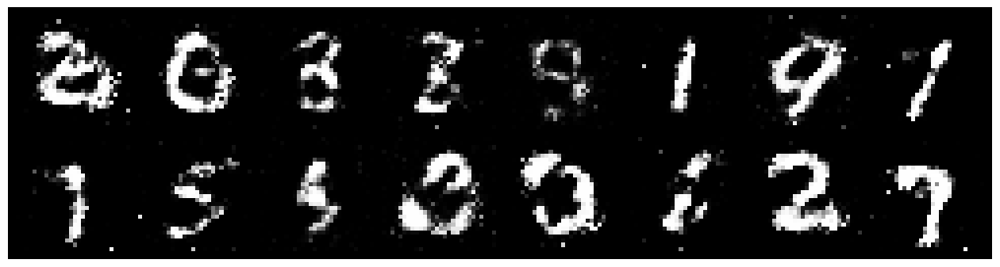

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9423, Generator Loss: 1.1780
D(x): 0.6645, D(G(z)): 0.3096


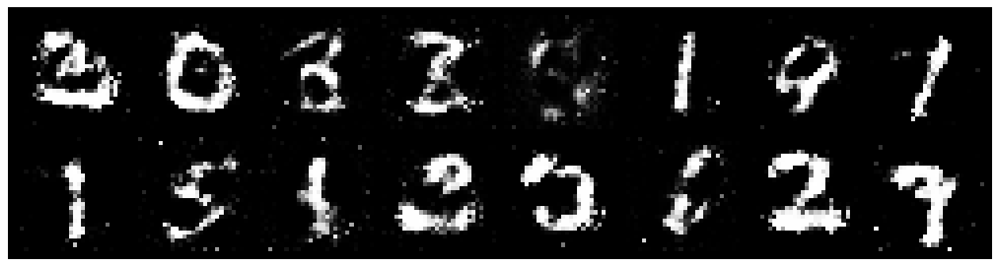

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9459, Generator Loss: 1.3590
D(x): 0.7131, D(G(z)): 0.3501


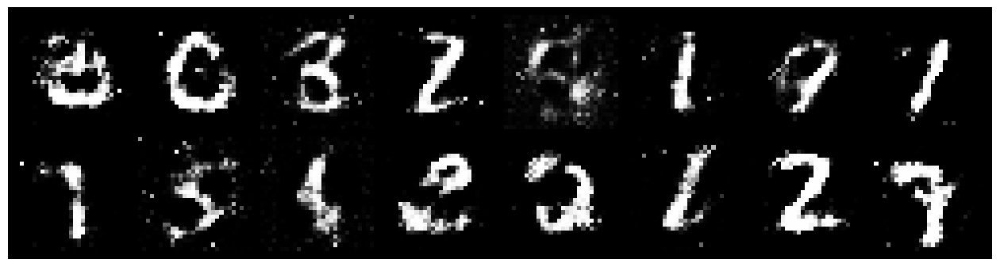

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0900, Generator Loss: 1.1153
D(x): 0.6738, D(G(z)): 0.3747


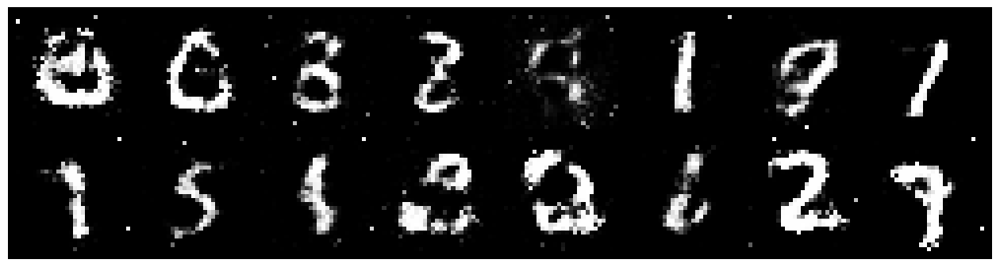

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.1998, Generator Loss: 1.1051
D(x): 0.6327, D(G(z)): 0.4098


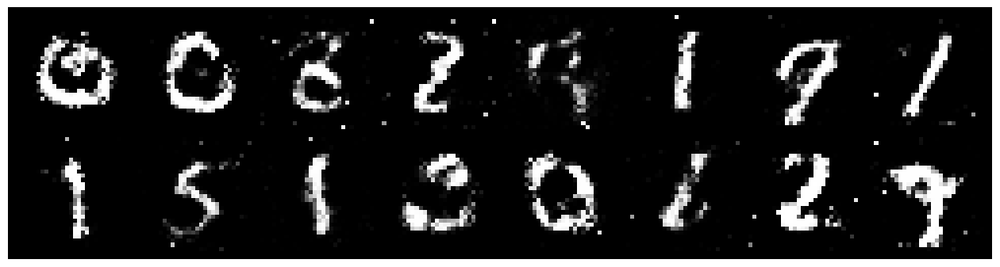

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1740, Generator Loss: 1.1567
D(x): 0.6536, D(G(z)): 0.4007


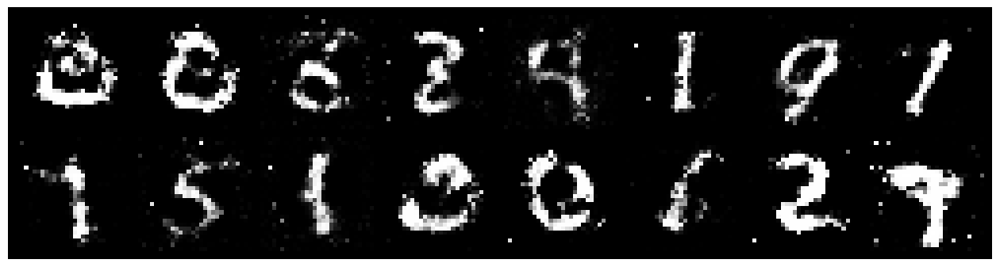

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0466, Generator Loss: 1.1113
D(x): 0.7479, D(G(z)): 0.4252


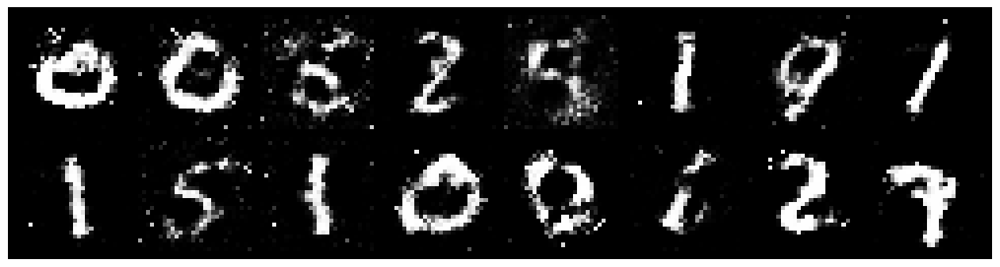

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 0.8995, Generator Loss: 1.4798
D(x): 0.7122, D(G(z)): 0.3411


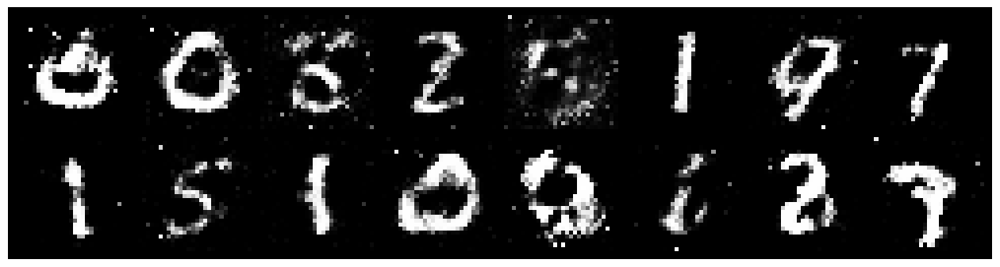

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.2226, Generator Loss: 1.3719
D(x): 0.6106, D(G(z)): 0.3723


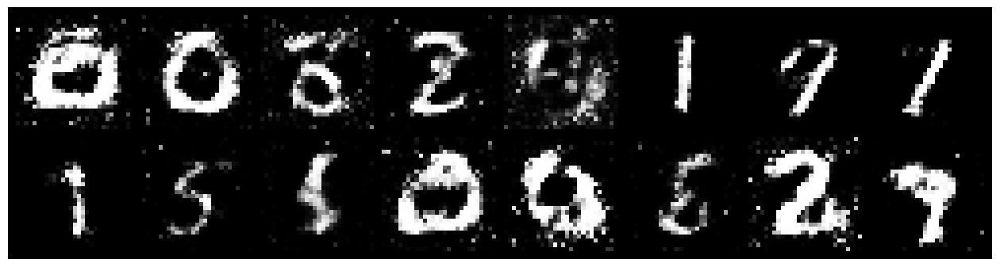

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1404, Generator Loss: 1.0208
D(x): 0.6751, D(G(z)): 0.4383


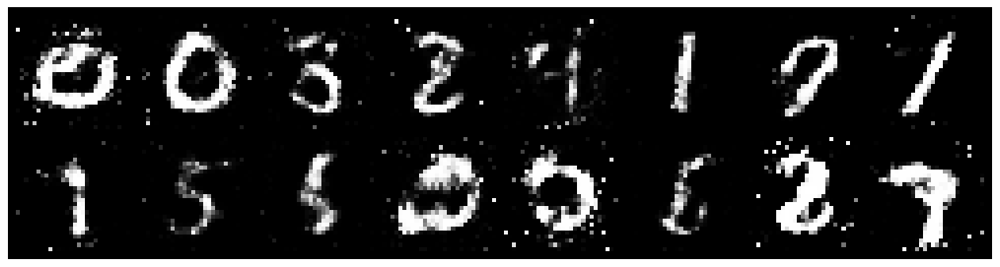

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.0493, Generator Loss: 1.0004
D(x): 0.6702, D(G(z)): 0.3831


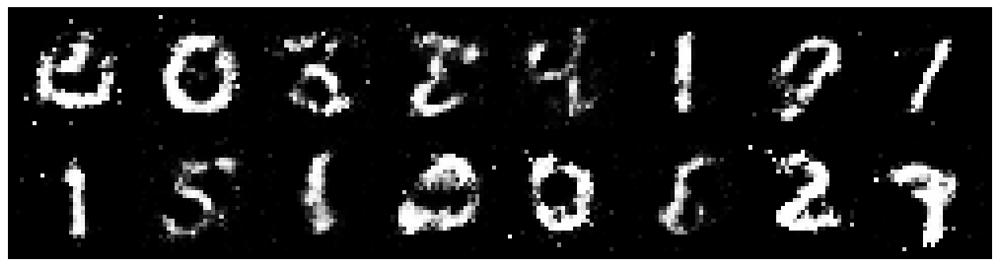

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.1439, Generator Loss: 1.2347
D(x): 0.6260, D(G(z)): 0.3843


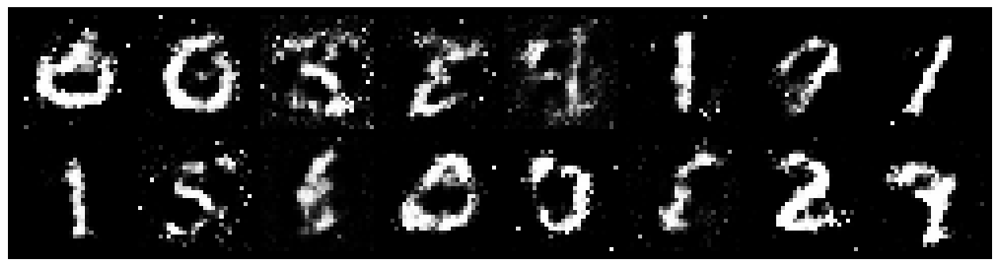

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.2421, Generator Loss: 1.4625
D(x): 0.6184, D(G(z)): 0.3976


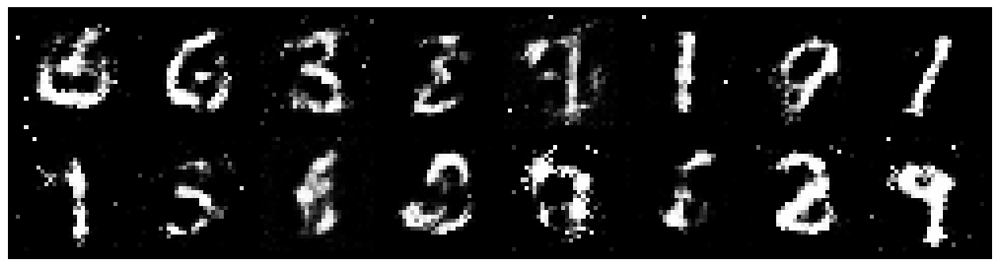

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0277, Generator Loss: 1.1124
D(x): 0.6791, D(G(z)): 0.3963


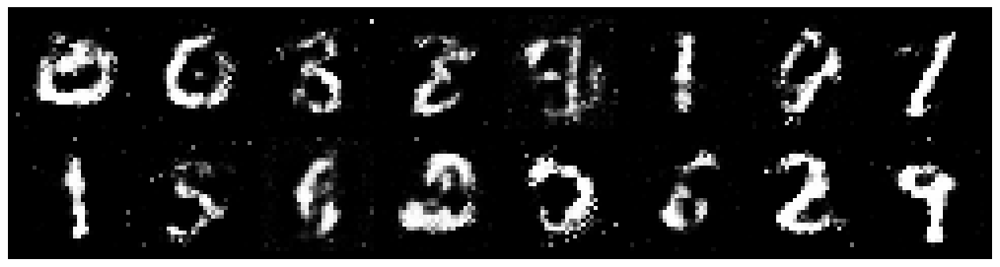

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.9751, Generator Loss: 1.3146
D(x): 0.7106, D(G(z)): 0.3715


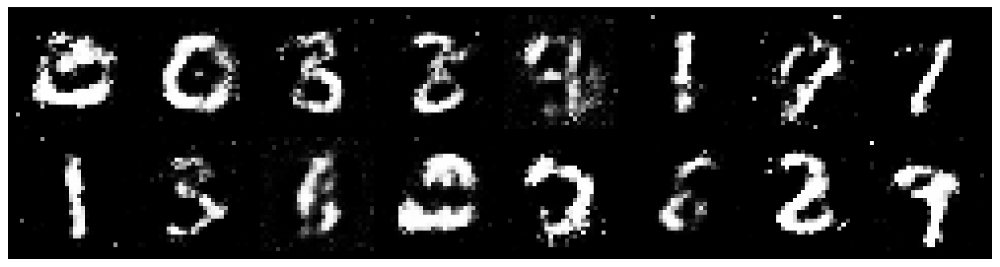

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.1169, Generator Loss: 1.4179
D(x): 0.6382, D(G(z)): 0.3594


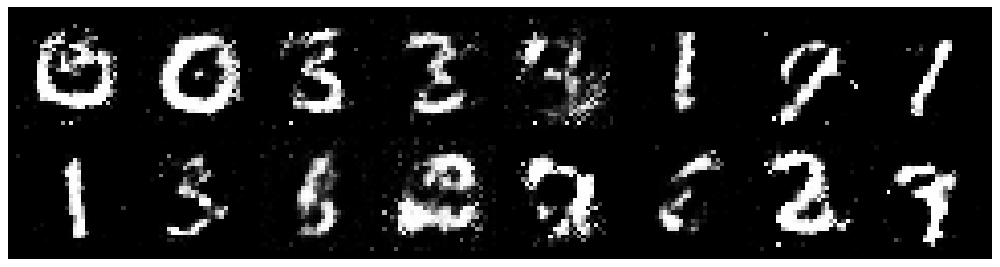

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0365, Generator Loss: 1.2732
D(x): 0.5868, D(G(z)): 0.2675


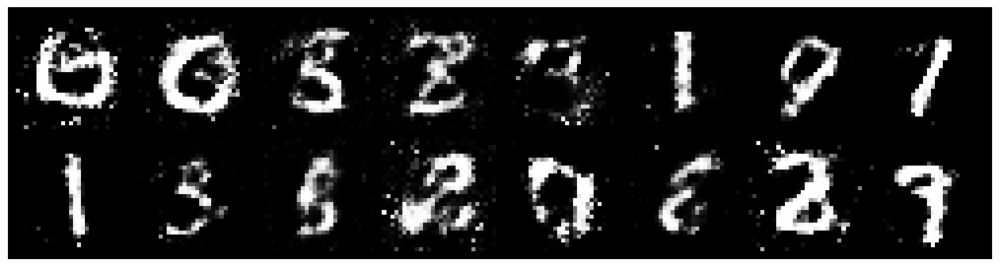

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0222, Generator Loss: 1.2705
D(x): 0.6793, D(G(z)): 0.3200


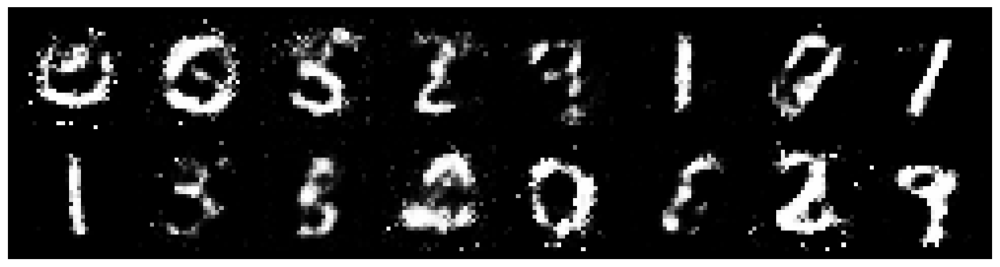

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1918, Generator Loss: 1.2750
D(x): 0.6736, D(G(z)): 0.4353


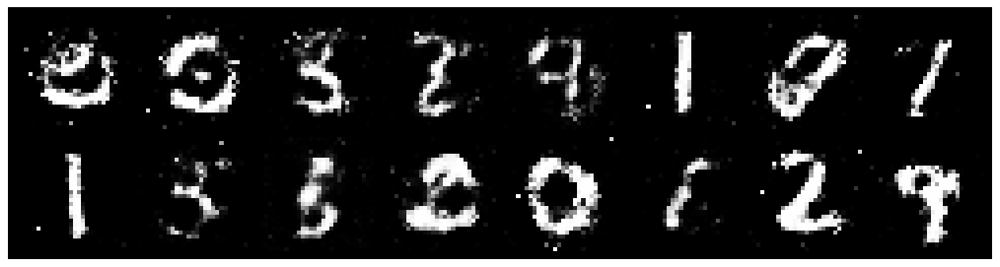

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.0643, Generator Loss: 1.0901
D(x): 0.6547, D(G(z)): 0.3826


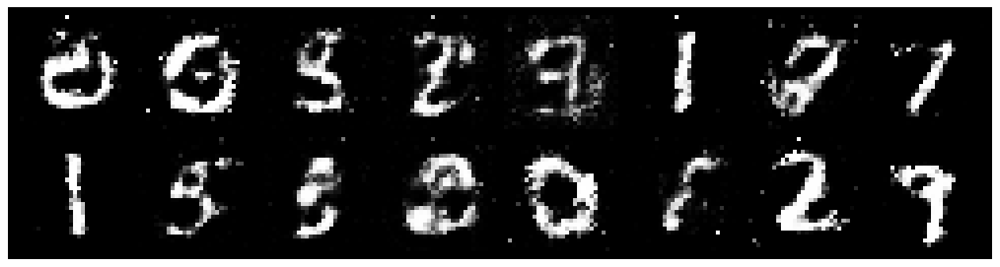

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.1333, Generator Loss: 1.1470
D(x): 0.6493, D(G(z)): 0.4217


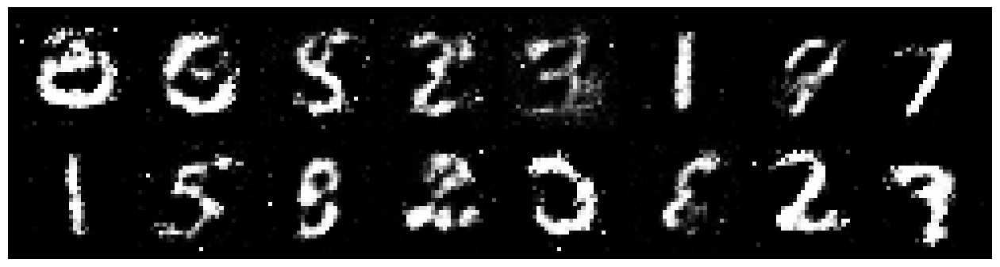

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.1623, Generator Loss: 1.0114
D(x): 0.6513, D(G(z)): 0.4346


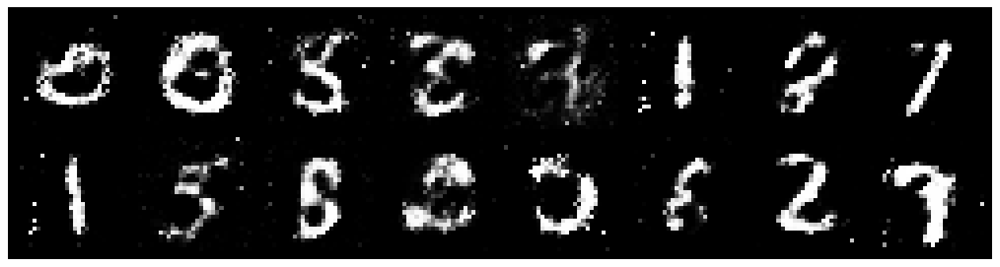

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0195, Generator Loss: 1.0473
D(x): 0.6444, D(G(z)): 0.3608


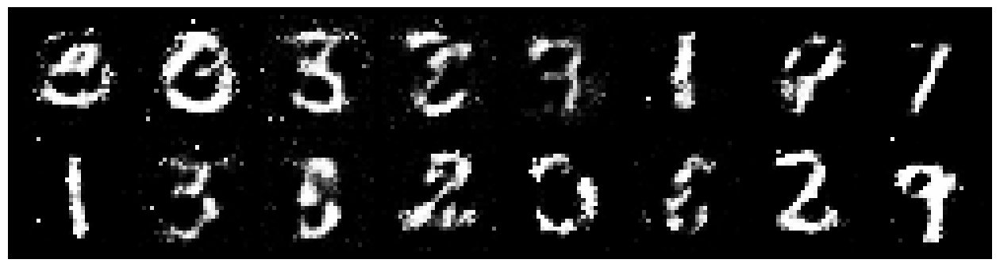

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0559, Generator Loss: 1.2213
D(x): 0.6728, D(G(z)): 0.4132


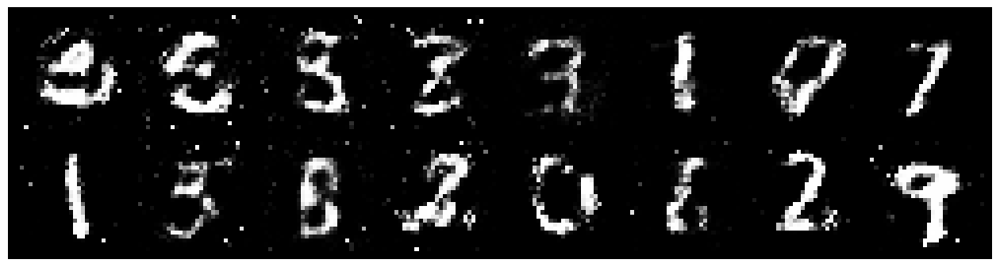

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.9127, Generator Loss: 1.2280
D(x): 0.7435, D(G(z)): 0.3579


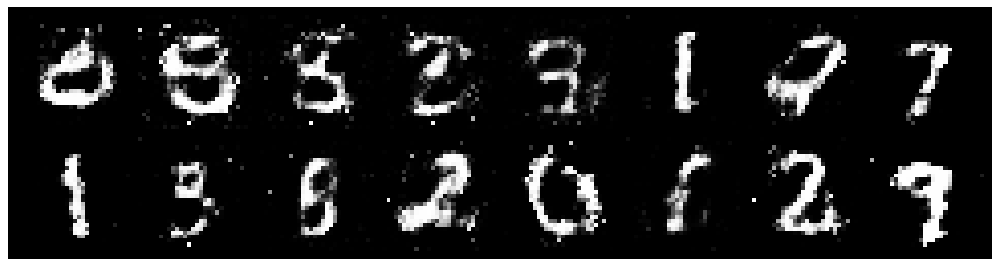

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1308, Generator Loss: 1.4646
D(x): 0.6543, D(G(z)): 0.3908


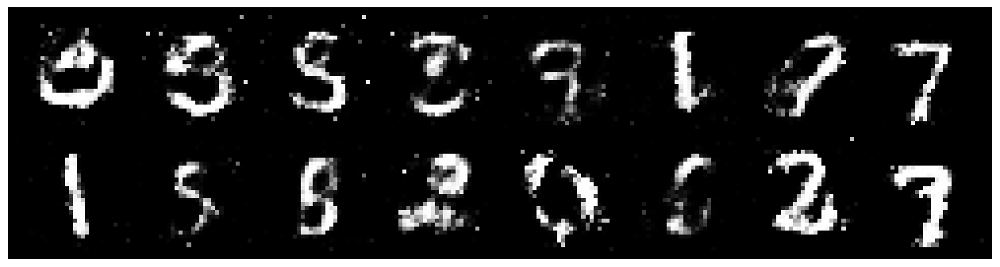

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0454, Generator Loss: 1.2101
D(x): 0.6624, D(G(z)): 0.3664


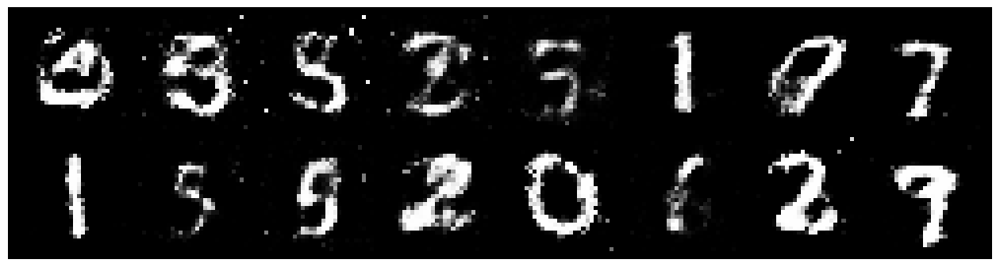

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.2041, Generator Loss: 1.4302
D(x): 0.5631, D(G(z)): 0.3112


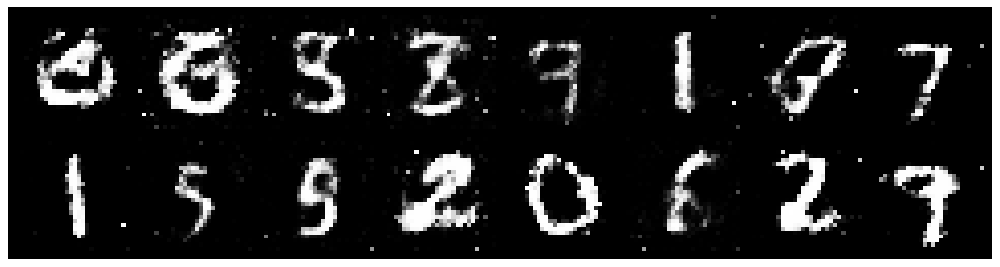

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0453, Generator Loss: 1.4730
D(x): 0.6681, D(G(z)): 0.3461


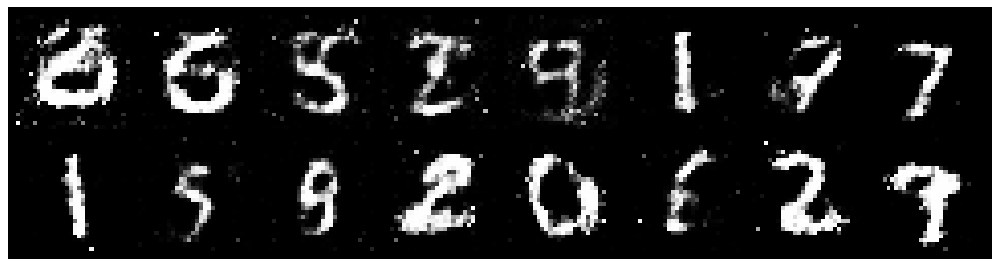

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0259, Generator Loss: 1.2039
D(x): 0.6712, D(G(z)): 0.3717


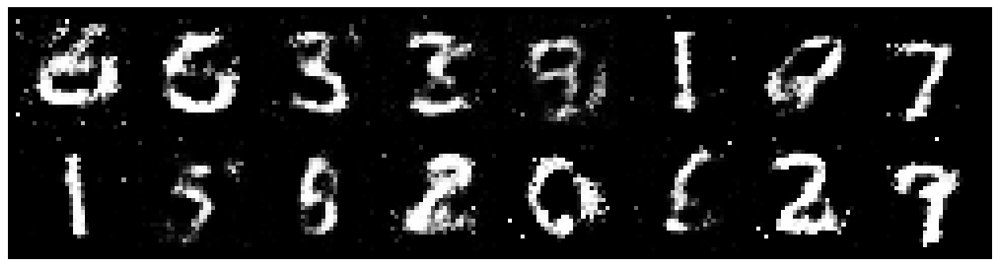

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1194, Generator Loss: 1.0170
D(x): 0.6389, D(G(z)): 0.4083


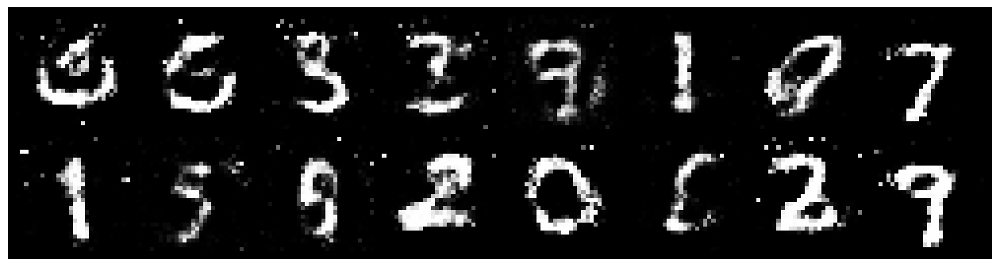

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.1996, Generator Loss: 1.1368
D(x): 0.5984, D(G(z)): 0.3874


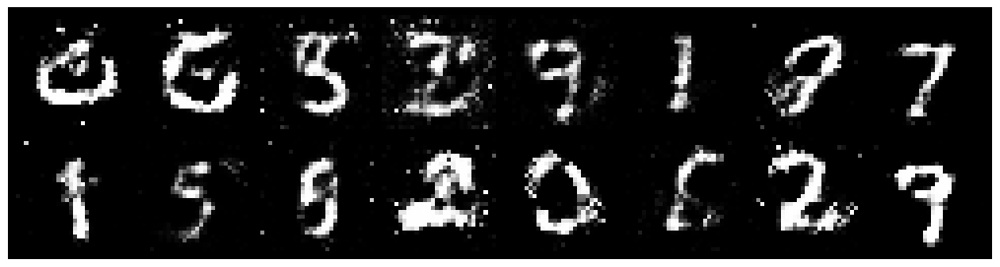

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.1609, Generator Loss: 1.2096
D(x): 0.5966, D(G(z)): 0.3933


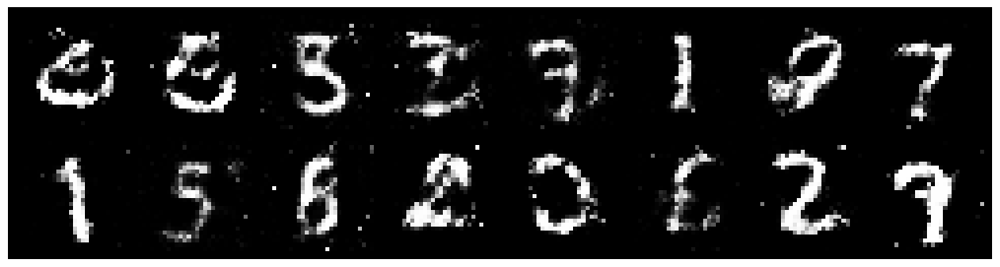

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.2210, Generator Loss: 1.2392
D(x): 0.5597, D(G(z)): 0.3811


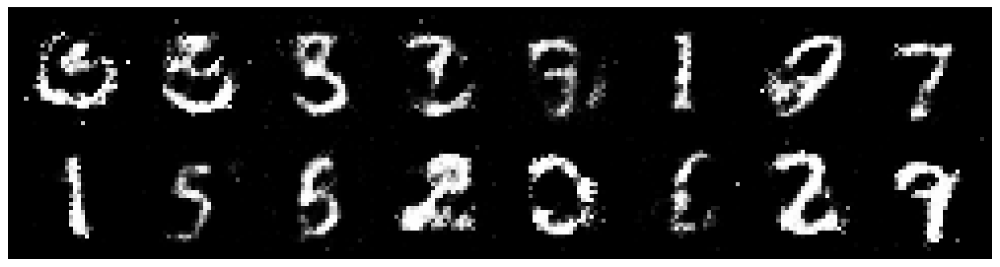

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 0.9287, Generator Loss: 1.1166
D(x): 0.6841, D(G(z)): 0.3568


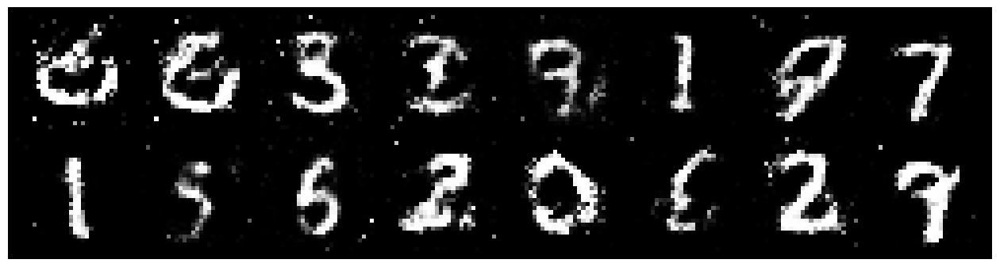

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.0642, Generator Loss: 1.1634
D(x): 0.6328, D(G(z)): 0.3239


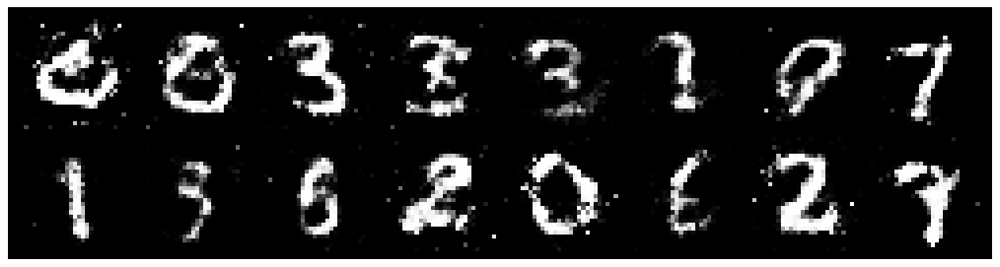

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.9762, Generator Loss: 1.3699
D(x): 0.6639, D(G(z)): 0.3227


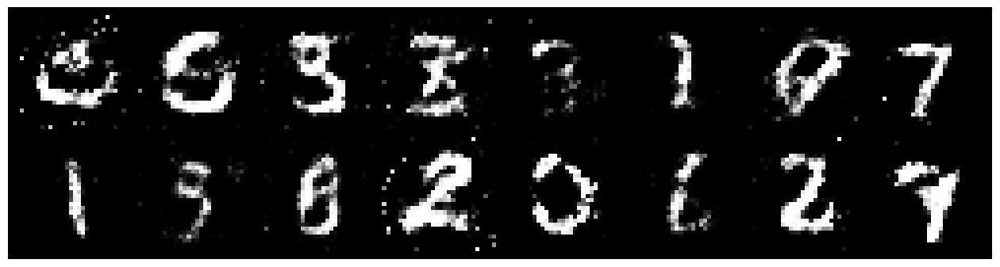

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 0.9752, Generator Loss: 1.6186
D(x): 0.6815, D(G(z)): 0.3557


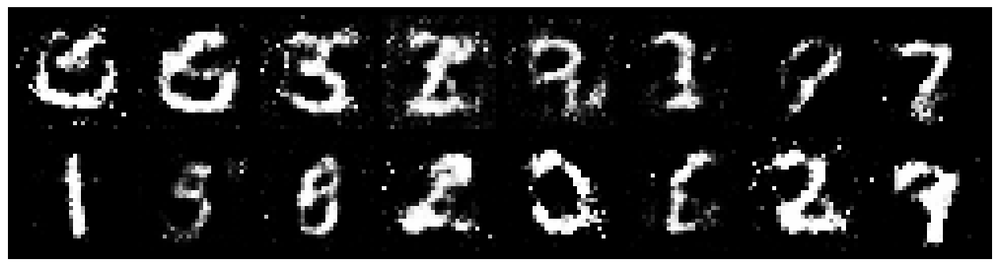

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.0840, Generator Loss: 1.2876
D(x): 0.6266, D(G(z)): 0.3724


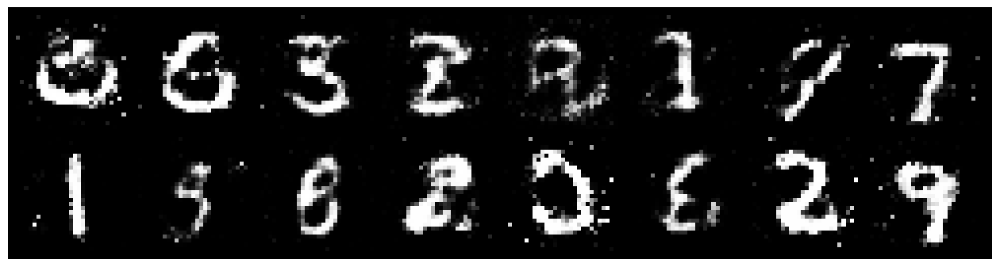

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 0.9417, Generator Loss: 1.4466
D(x): 0.6426, D(G(z)): 0.3029


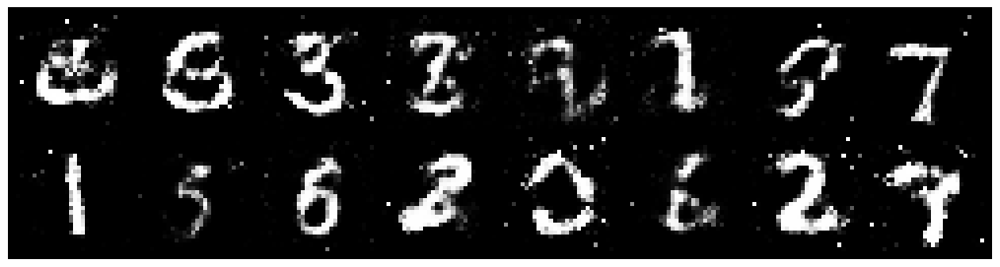

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.0406, Generator Loss: 1.4574
D(x): 0.6410, D(G(z)): 0.3576


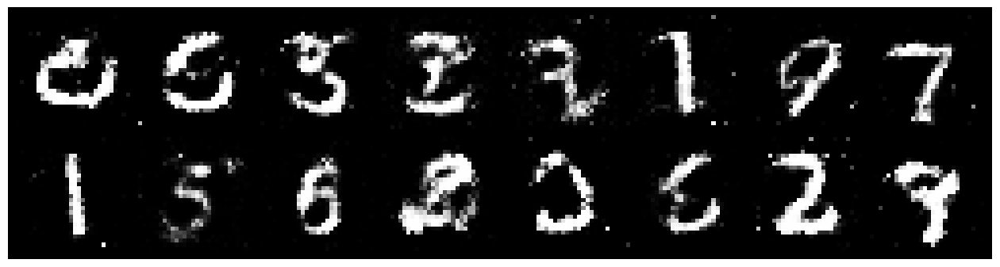

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.2437, Generator Loss: 1.1922
D(x): 0.5878, D(G(z)): 0.3692


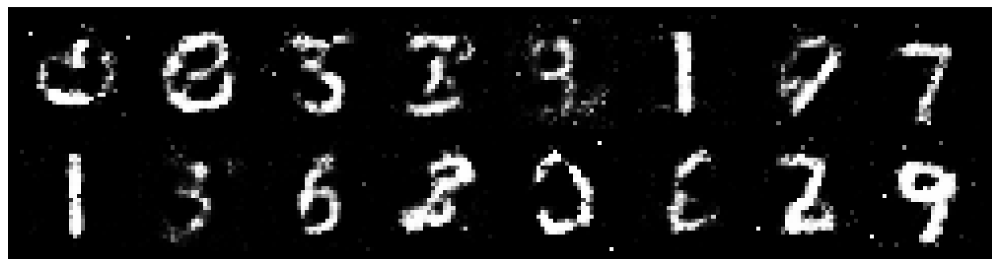

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0664, Generator Loss: 1.3345
D(x): 0.5991, D(G(z)): 0.3396


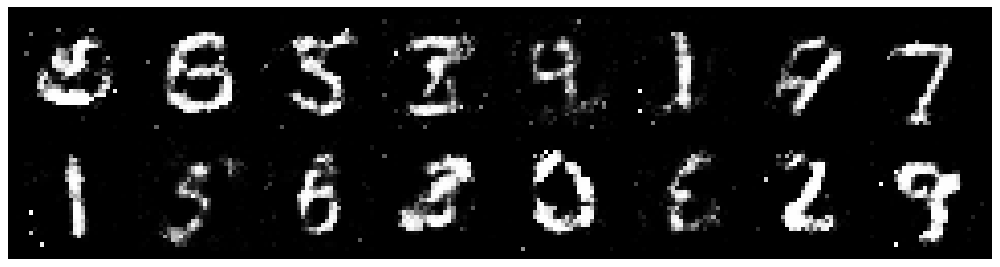

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.0285, Generator Loss: 1.2447
D(x): 0.6712, D(G(z)): 0.3851


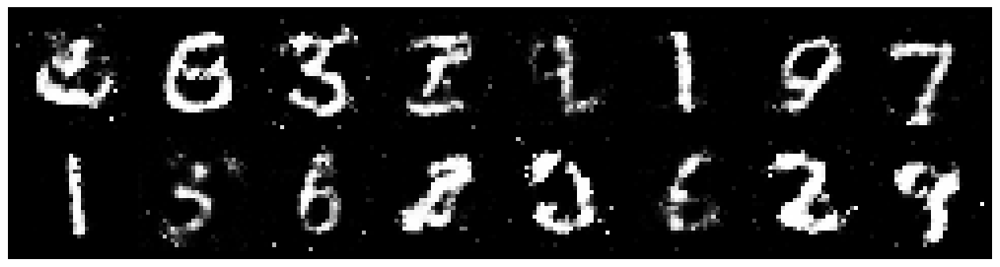

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0415, Generator Loss: 1.0518
D(x): 0.6532, D(G(z)): 0.3945


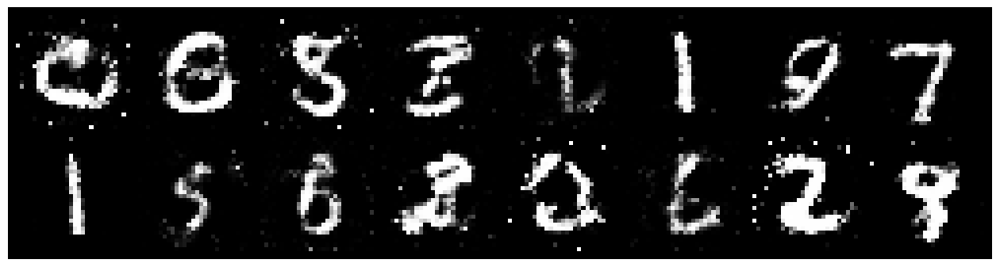

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.1728, Generator Loss: 1.2215
D(x): 0.5541, D(G(z)): 0.3071


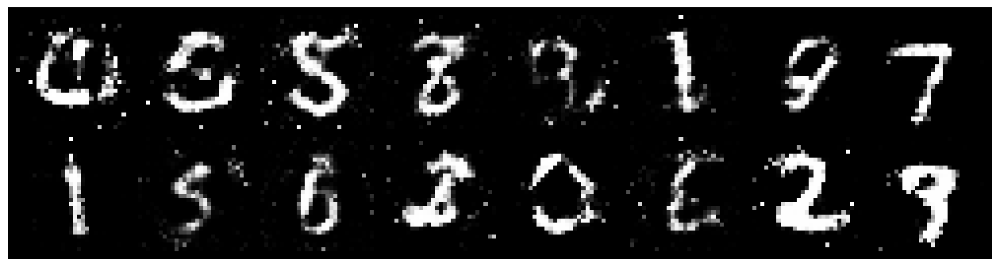

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1419, Generator Loss: 1.2812
D(x): 0.6136, D(G(z)): 0.3801


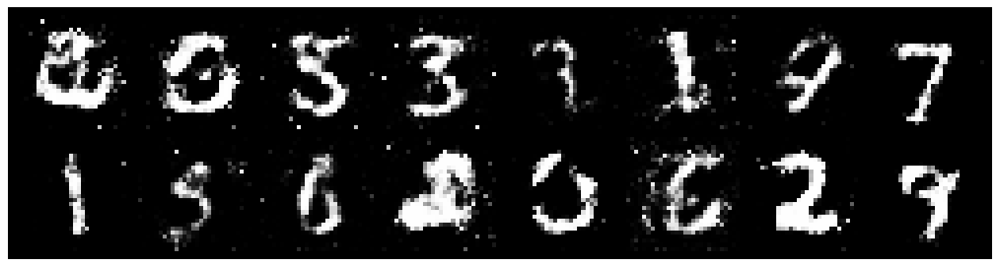

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.2810, Generator Loss: 1.2452
D(x): 0.6243, D(G(z)): 0.4192


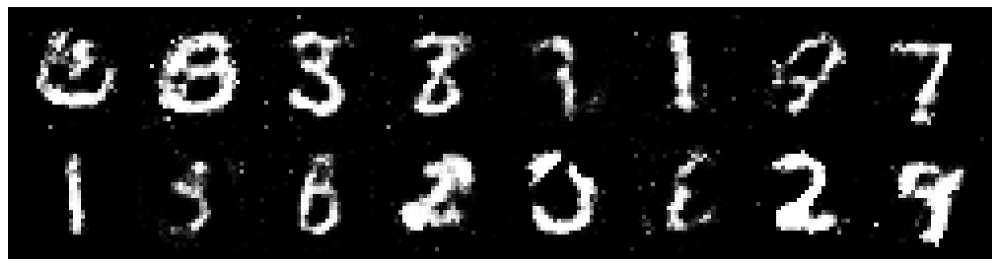

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1976, Generator Loss: 1.1158
D(x): 0.5994, D(G(z)): 0.3772


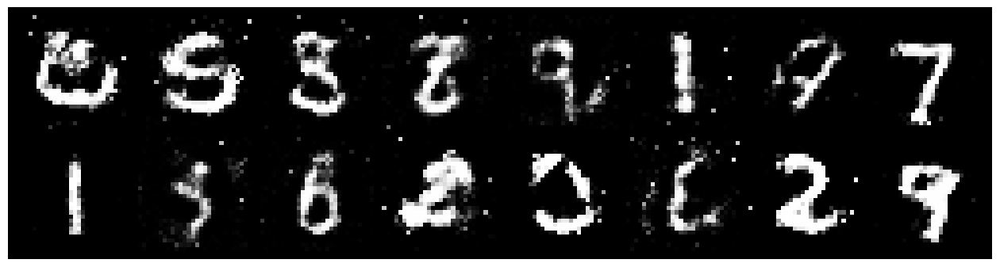

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.2170, Generator Loss: 1.1266
D(x): 0.5776, D(G(z)): 0.4252


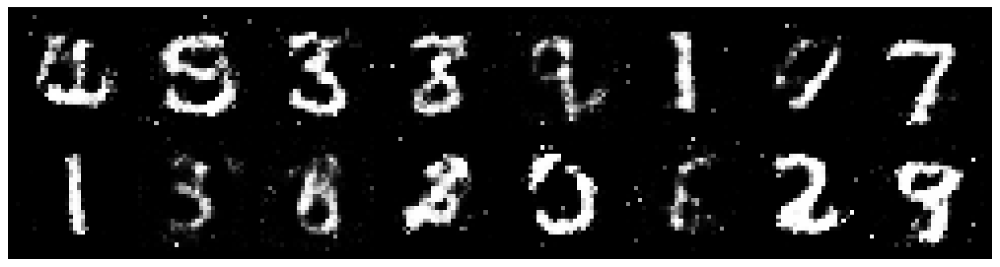

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.2245, Generator Loss: 1.0848
D(x): 0.5448, D(G(z)): 0.3910


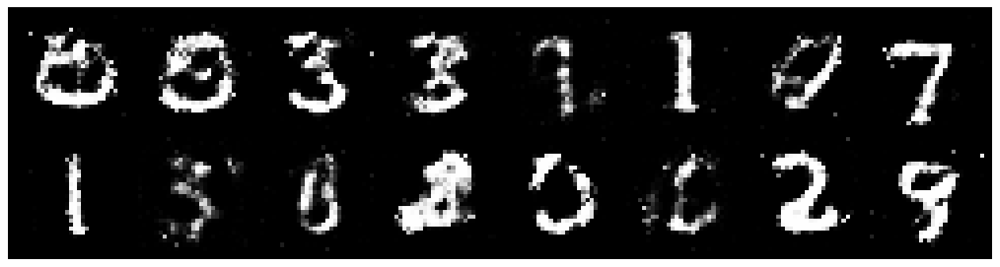

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.9918, Generator Loss: 1.0570
D(x): 0.6644, D(G(z)): 0.3810


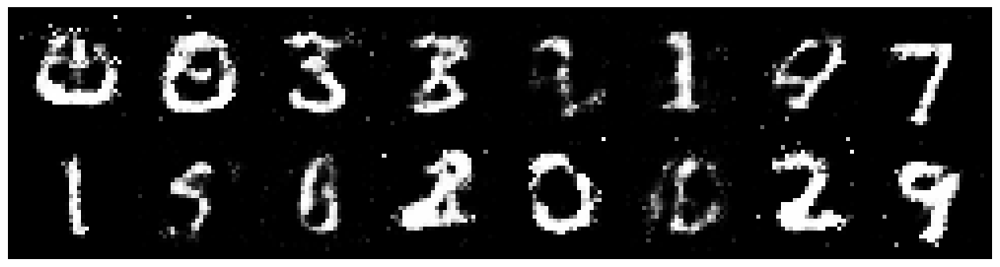

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0950, Generator Loss: 1.1615
D(x): 0.6150, D(G(z)): 0.3716


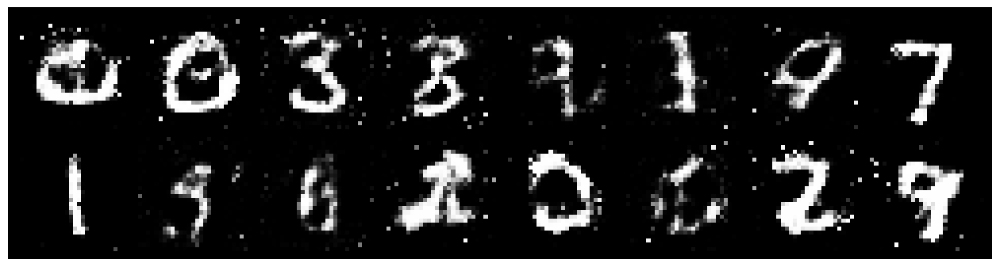

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.2712, Generator Loss: 1.1589
D(x): 0.5092, D(G(z)): 0.3343


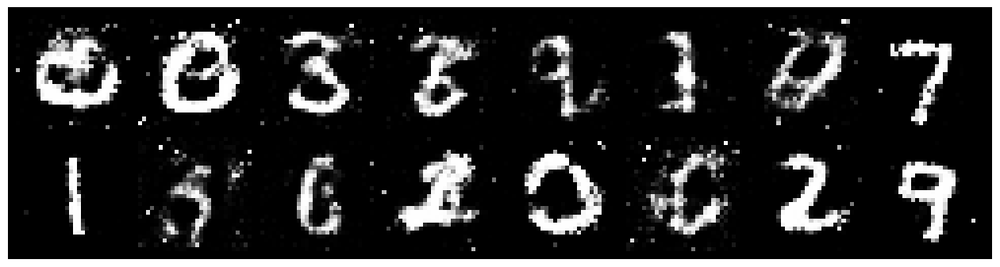

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1084, Generator Loss: 0.9246
D(x): 0.5543, D(G(z)): 0.3453


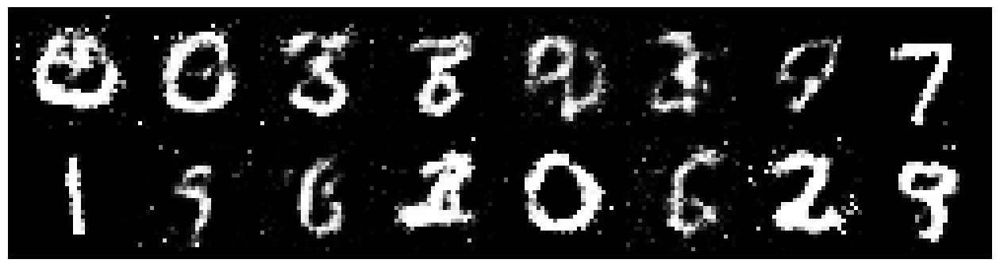

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0728, Generator Loss: 0.9866
D(x): 0.6223, D(G(z)): 0.3814


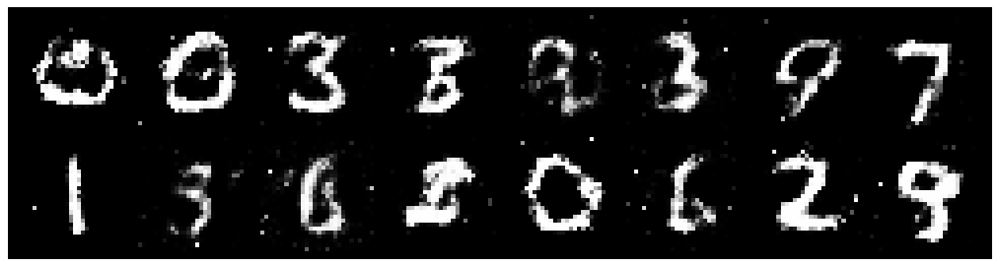

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.2383, Generator Loss: 1.2259
D(x): 0.5486, D(G(z)): 0.3646


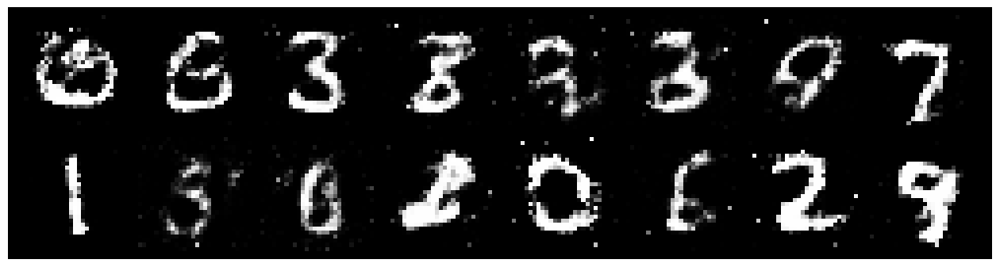

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.2196, Generator Loss: 1.0874
D(x): 0.6225, D(G(z)): 0.4319


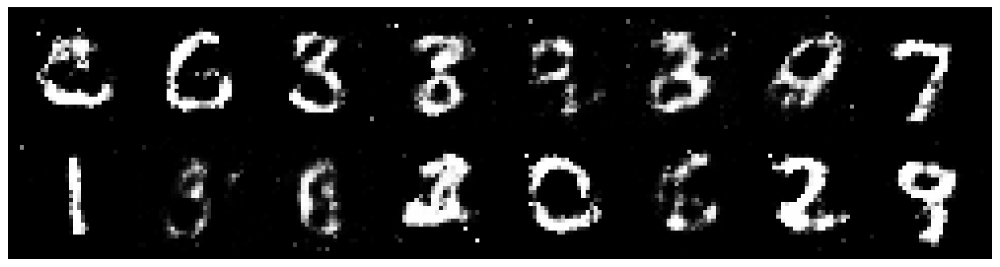

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.1275, Generator Loss: 0.9455
D(x): 0.6158, D(G(z)): 0.3776


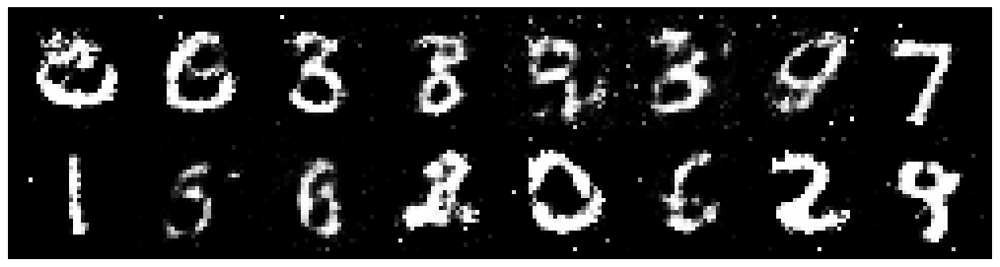

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.0585, Generator Loss: 0.9342
D(x): 0.6225, D(G(z)): 0.3827


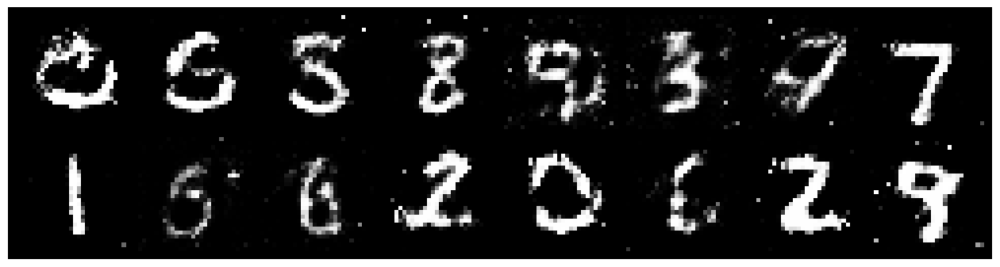

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1514, Generator Loss: 1.0188
D(x): 0.6204, D(G(z)): 0.4231


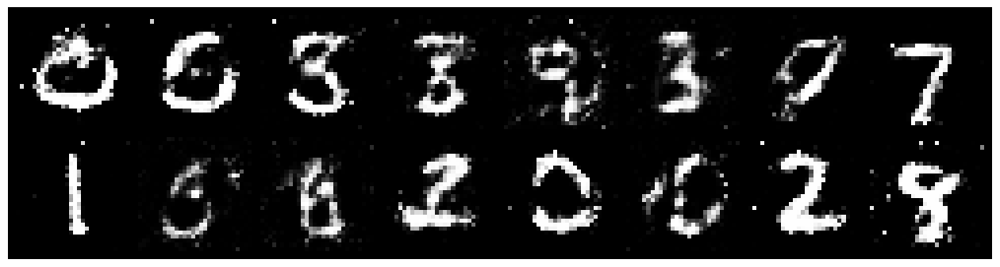

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1732, Generator Loss: 1.0755
D(x): 0.6436, D(G(z)): 0.4230


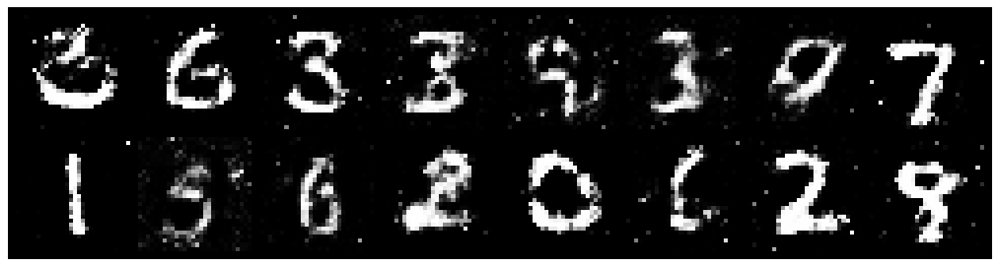

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0980, Generator Loss: 1.0162
D(x): 0.6307, D(G(z)): 0.3767


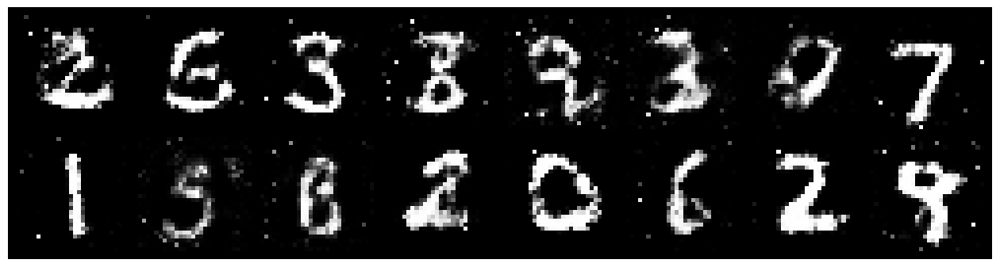

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0838, Generator Loss: 1.1122
D(x): 0.6311, D(G(z)): 0.3900


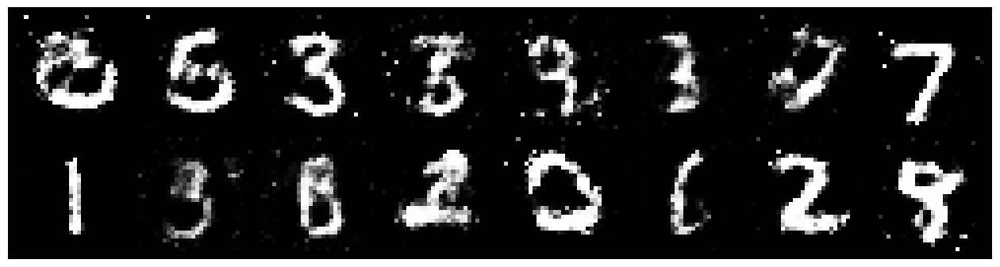

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1607, Generator Loss: 1.1293
D(x): 0.5906, D(G(z)): 0.3891


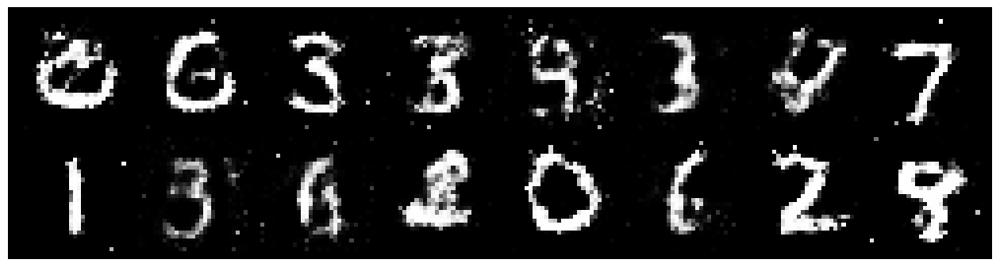

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0989, Generator Loss: 1.1777
D(x): 0.5904, D(G(z)): 0.3520


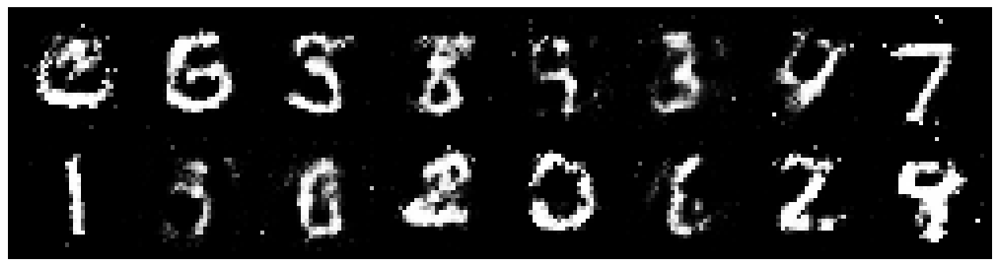

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0335, Generator Loss: 1.2411
D(x): 0.6025, D(G(z)): 0.3288


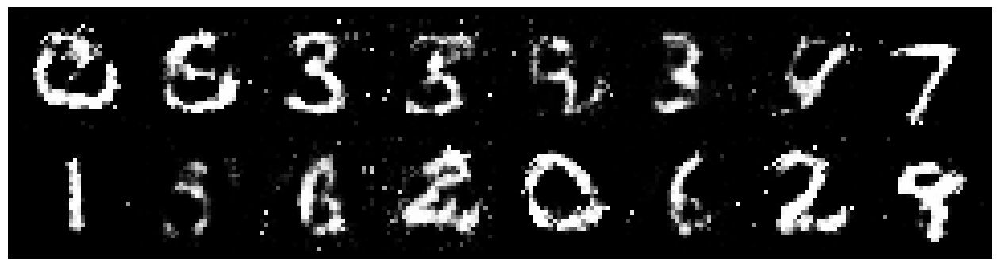

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 0.9849, Generator Loss: 1.1607
D(x): 0.6387, D(G(z)): 0.3604


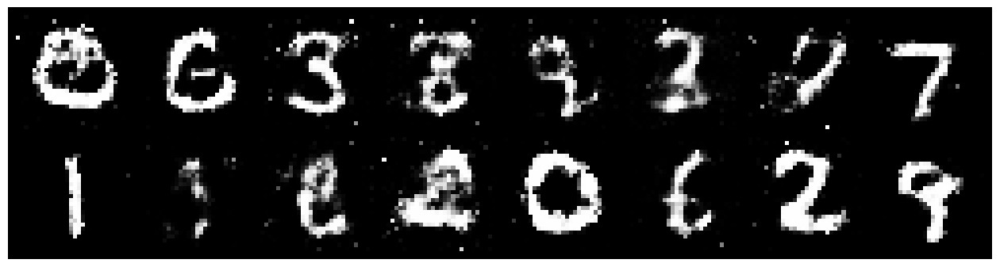

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1259, Generator Loss: 1.3704
D(x): 0.5902, D(G(z)): 0.3480


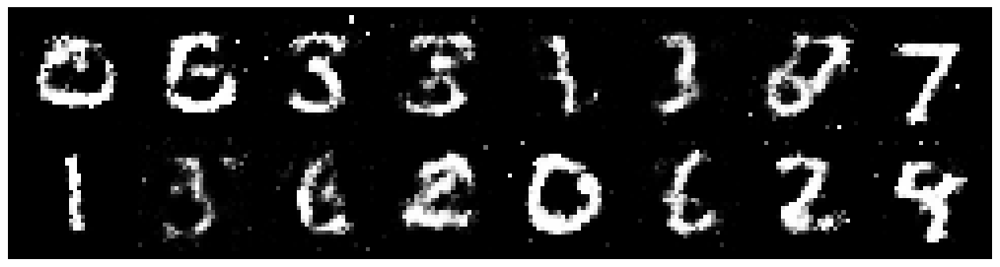

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1593, Generator Loss: 1.2263
D(x): 0.6385, D(G(z)): 0.4042


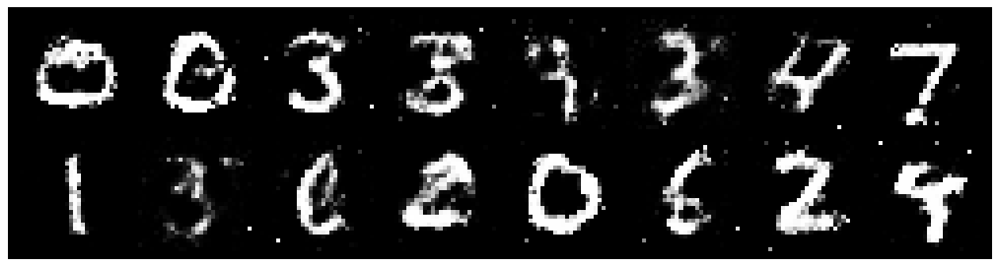

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1675, Generator Loss: 1.2539
D(x): 0.6045, D(G(z)): 0.3644


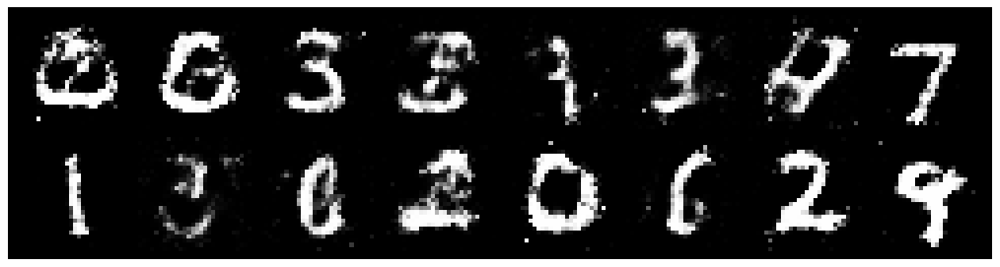

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.0456, Generator Loss: 1.1472
D(x): 0.6890, D(G(z)): 0.4014


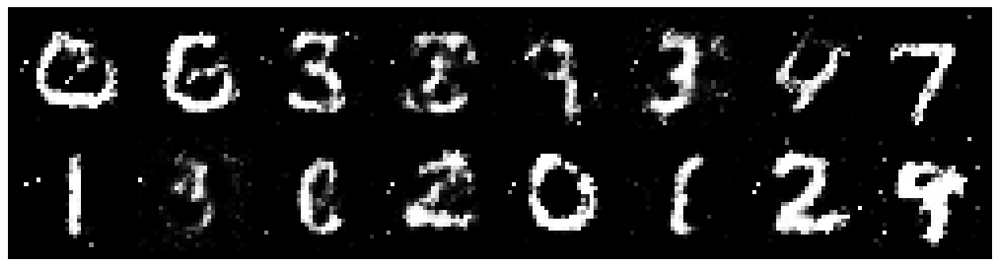

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0863, Generator Loss: 1.0815
D(x): 0.6410, D(G(z)): 0.3873


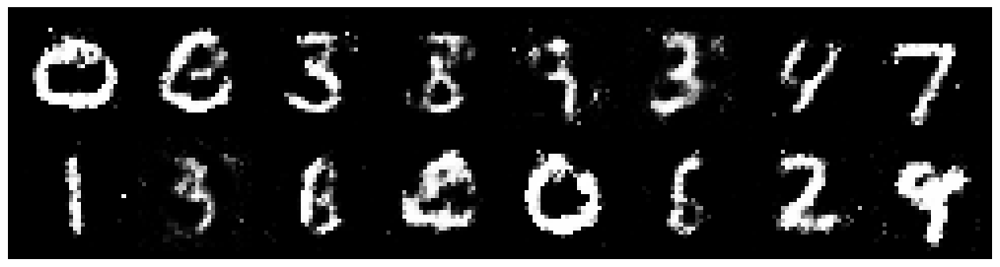

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.0687, Generator Loss: 1.0593
D(x): 0.6462, D(G(z)): 0.4145


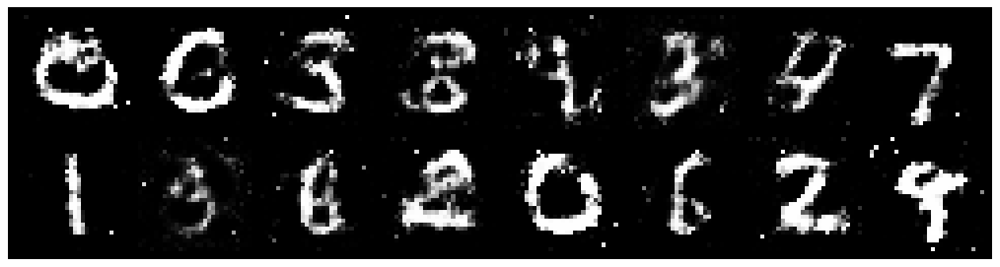

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.0332, Generator Loss: 1.2112
D(x): 0.6392, D(G(z)): 0.3614


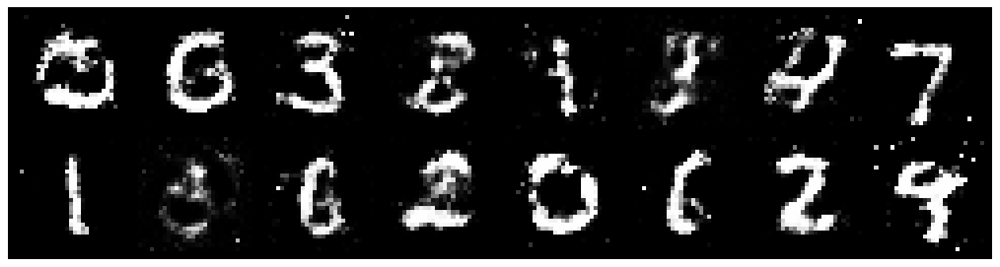

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2995, Generator Loss: 0.9666
D(x): 0.6095, D(G(z)): 0.4676


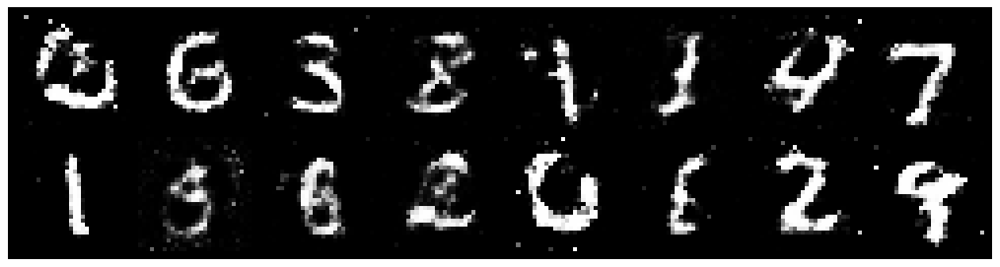

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0456, Generator Loss: 1.2027
D(x): 0.6661, D(G(z)): 0.4024


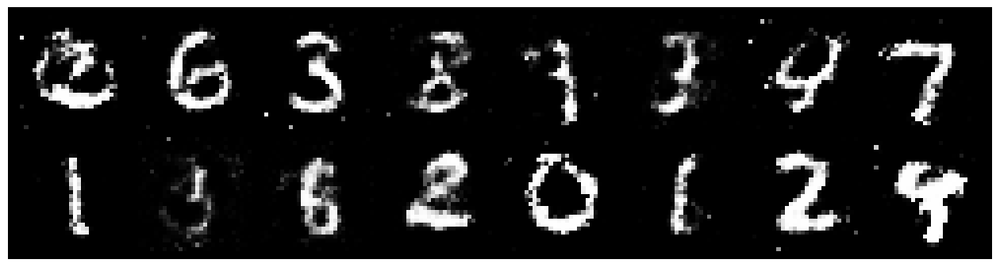

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1033, Generator Loss: 1.0540
D(x): 0.5971, D(G(z)): 0.3581


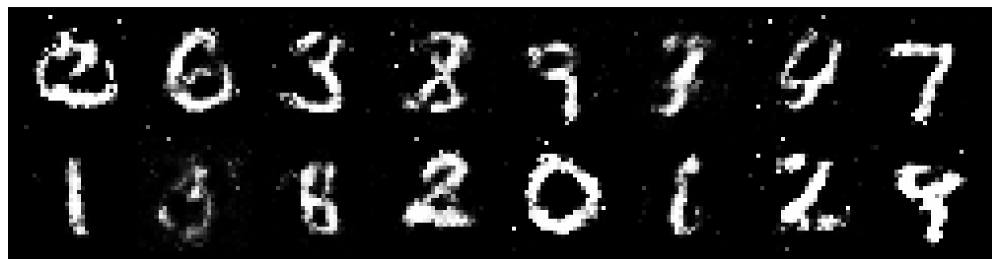

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1169, Generator Loss: 0.9597
D(x): 0.5847, D(G(z)): 0.3732


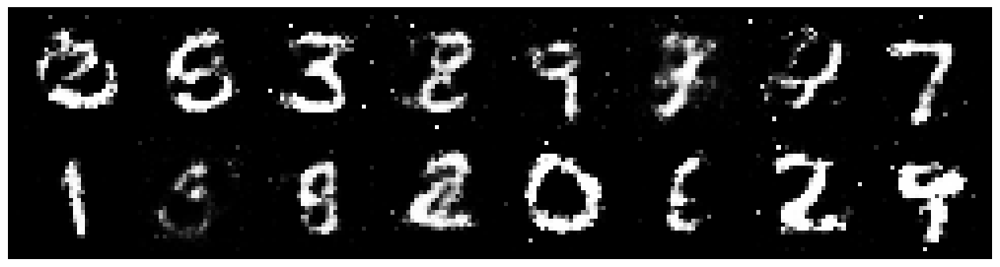

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1037, Generator Loss: 1.1113
D(x): 0.5899, D(G(z)): 0.3763


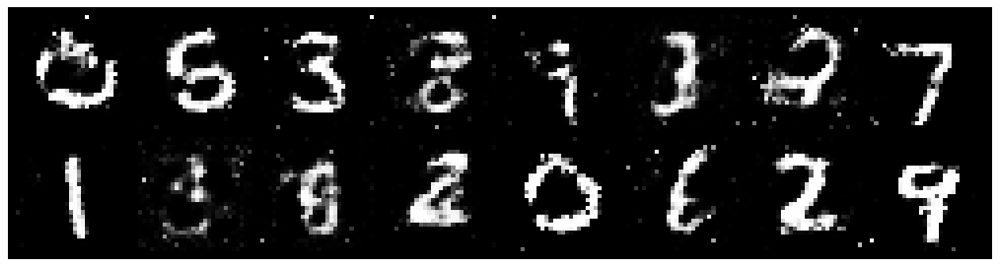

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1104, Generator Loss: 1.1090
D(x): 0.6296, D(G(z)): 0.4138


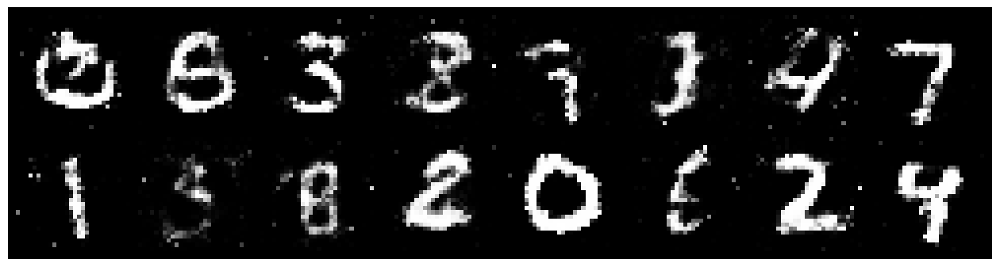

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9321
D(x): 0.5241, D(G(z)): 0.4058


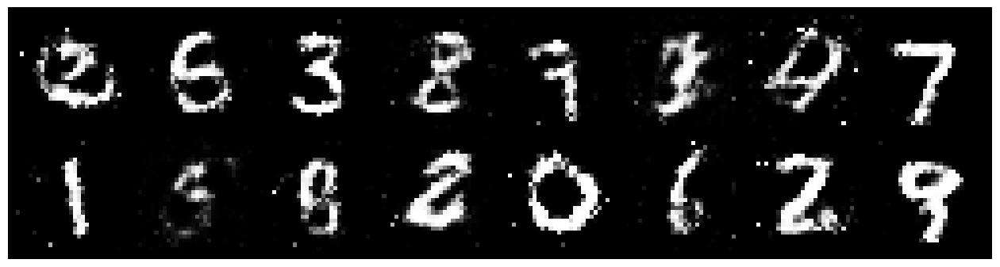

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.2641, Generator Loss: 0.8884
D(x): 0.5578, D(G(z)): 0.4264


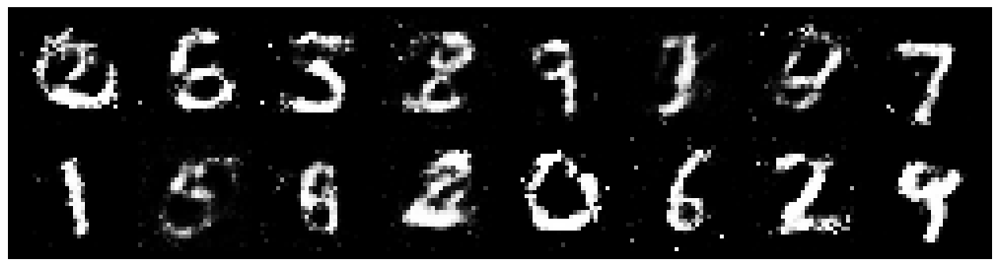

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0292, Generator Loss: 1.2095
D(x): 0.6577, D(G(z)): 0.3667


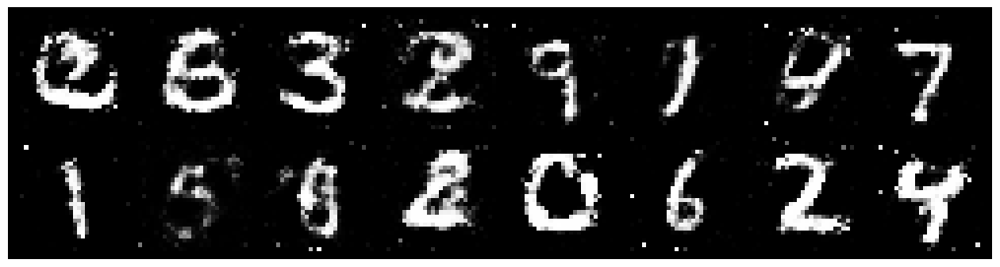

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.2511, Generator Loss: 1.0891
D(x): 0.5807, D(G(z)): 0.4305


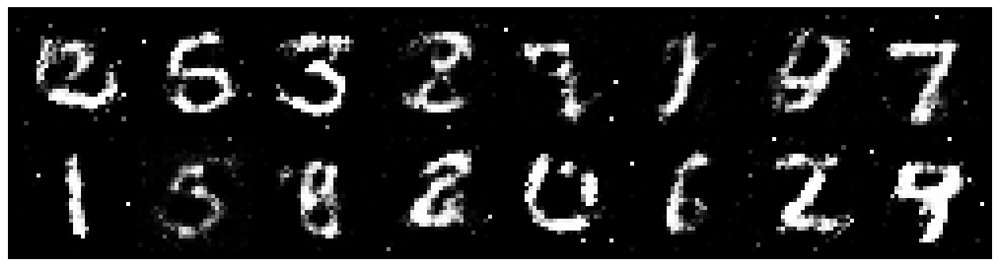

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2940, Generator Loss: 1.0023
D(x): 0.5297, D(G(z)): 0.3826


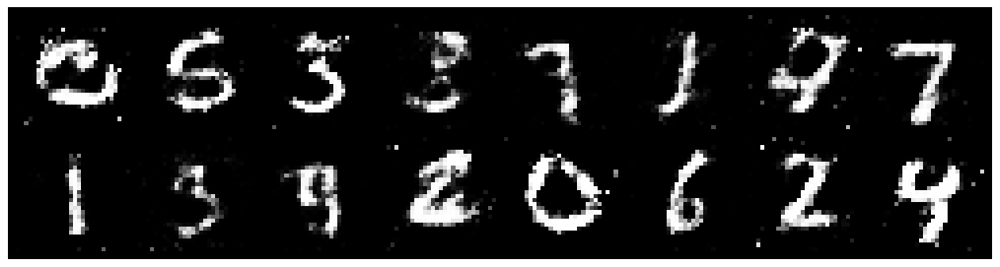

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.2588, Generator Loss: 1.0828
D(x): 0.6167, D(G(z)): 0.4381


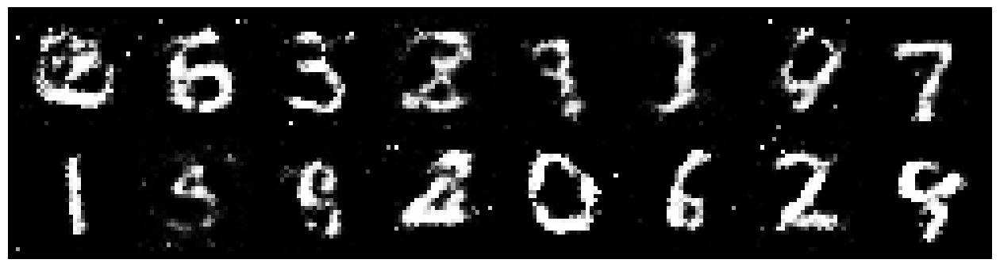

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.3953, Generator Loss: 0.9344
D(x): 0.5681, D(G(z)): 0.4711


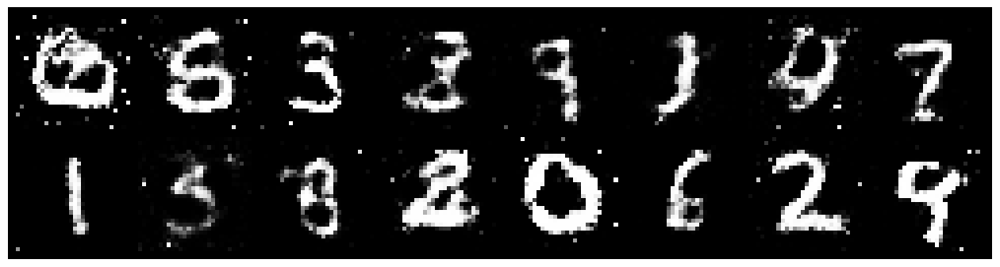

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.2768, Generator Loss: 0.9164
D(x): 0.6258, D(G(z)): 0.4881


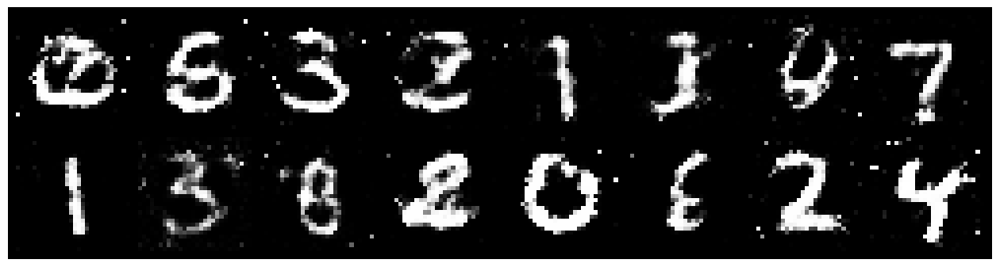

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2522, Generator Loss: 1.0952
D(x): 0.5281, D(G(z)): 0.3873


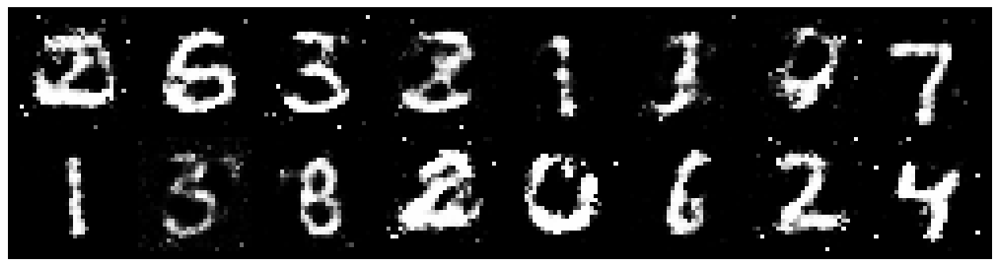

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1579, Generator Loss: 1.0000
D(x): 0.6372, D(G(z)): 0.4372


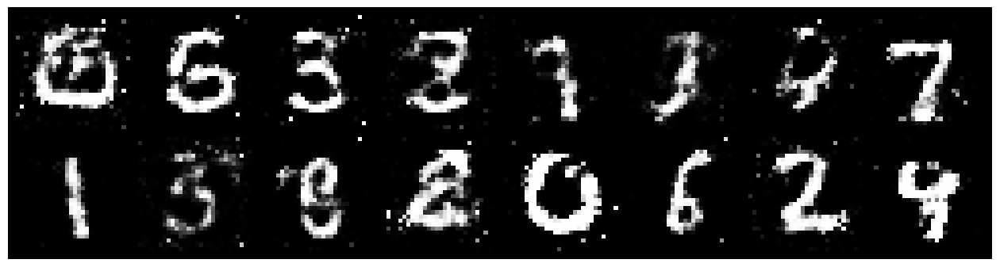

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1665, Generator Loss: 1.0314
D(x): 0.6208, D(G(z)): 0.4183


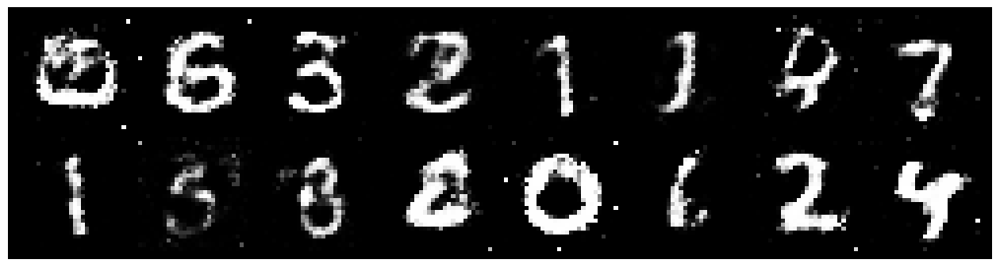

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1790, Generator Loss: 0.9260
D(x): 0.6243, D(G(z)): 0.4107


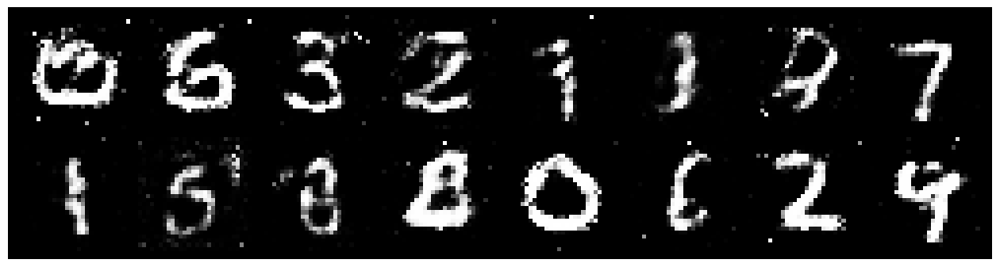

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.2088, Generator Loss: 1.1971
D(x): 0.5910, D(G(z)): 0.3939


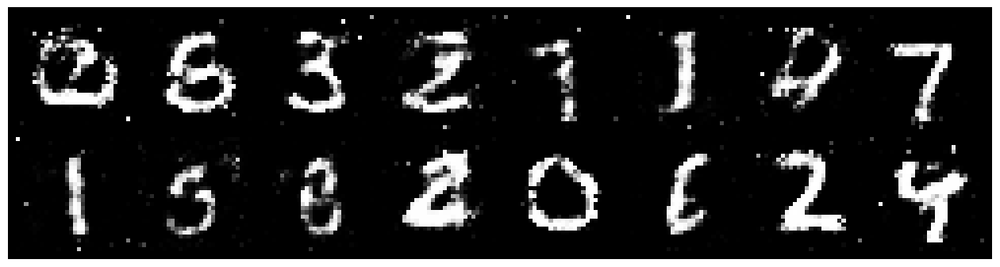

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1752, Generator Loss: 0.9952
D(x): 0.5877, D(G(z)): 0.3805


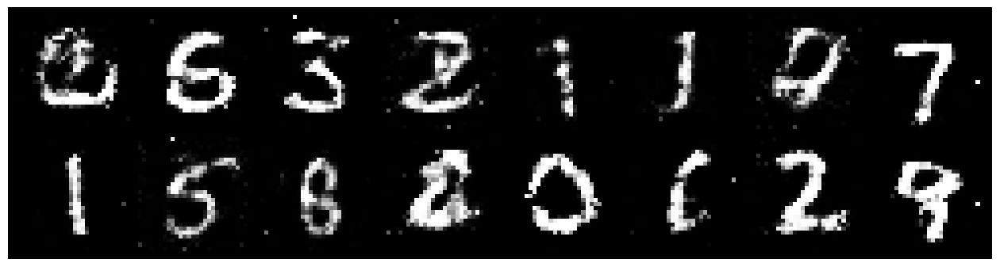

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.2259, Generator Loss: 1.0049
D(x): 0.5815, D(G(z)): 0.3957


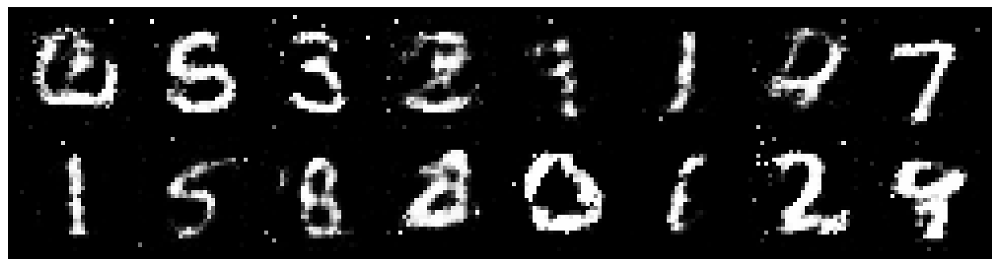

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.2883, Generator Loss: 0.9671
D(x): 0.5673, D(G(z)): 0.4259


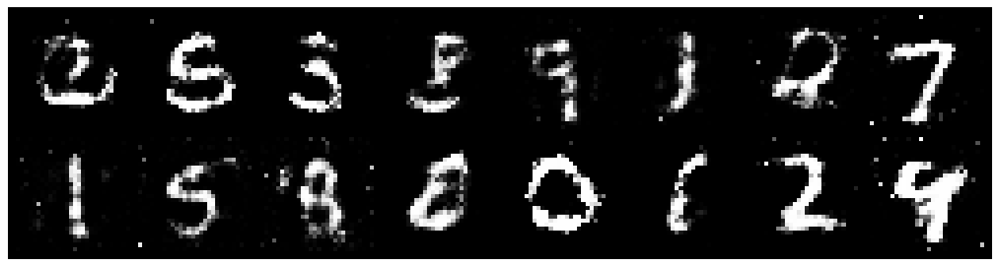

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.2746, Generator Loss: 1.0156
D(x): 0.5421, D(G(z)): 0.3995


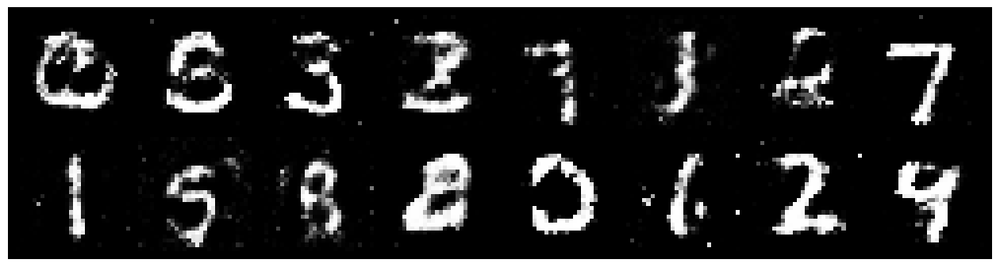

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.1677, Generator Loss: 0.8481
D(x): 0.5674, D(G(z)): 0.4165


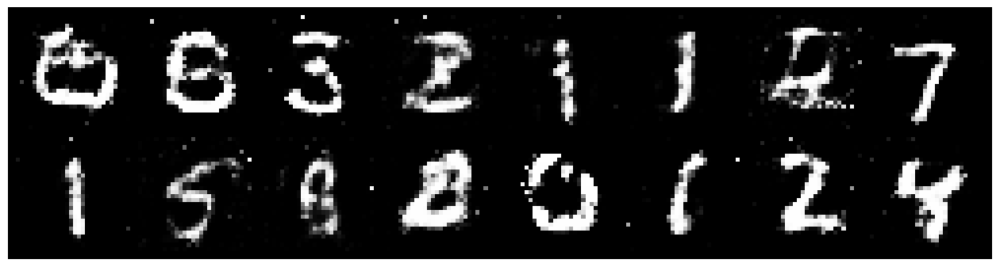

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.3920, Generator Loss: 0.8999
D(x): 0.6076, D(G(z)): 0.4839


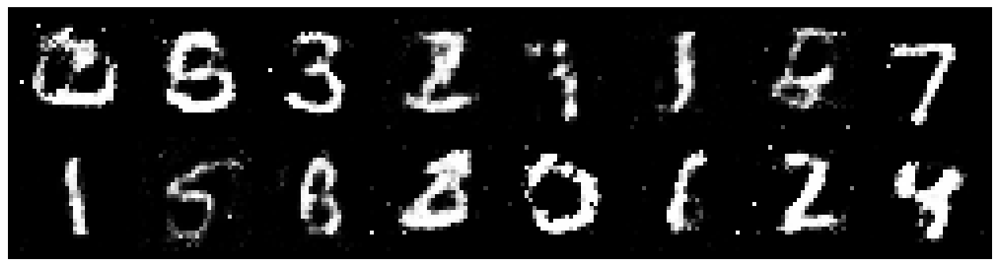

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.2706, Generator Loss: 0.8925
D(x): 0.6216, D(G(z)): 0.4858


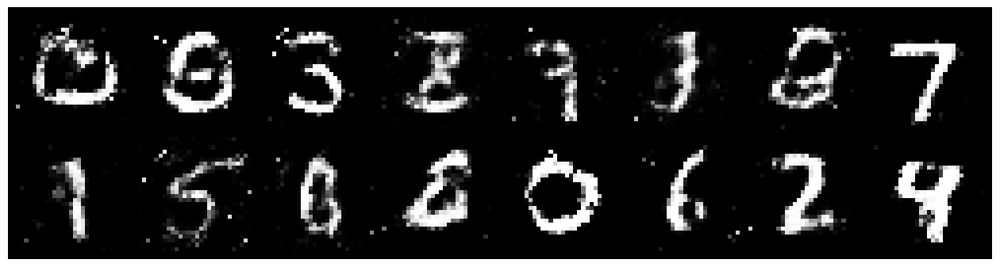

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.0847, Generator Loss: 1.1017
D(x): 0.5858, D(G(z)): 0.3610


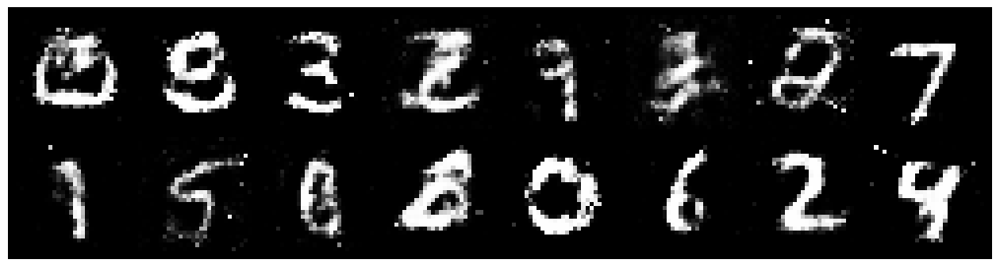

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.0340, Generator Loss: 1.1766
D(x): 0.5934, D(G(z)): 0.3474


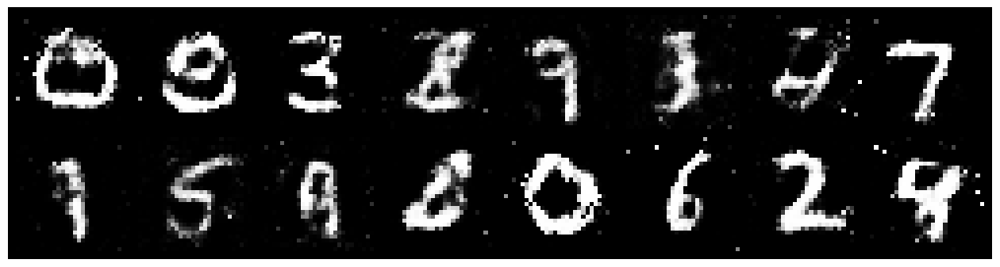

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1515, Generator Loss: 1.1384
D(x): 0.5747, D(G(z)): 0.3738


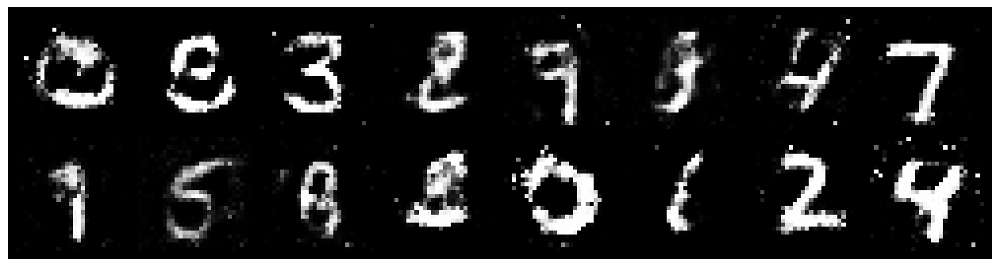

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1296, Generator Loss: 1.1923
D(x): 0.5670, D(G(z)): 0.3649


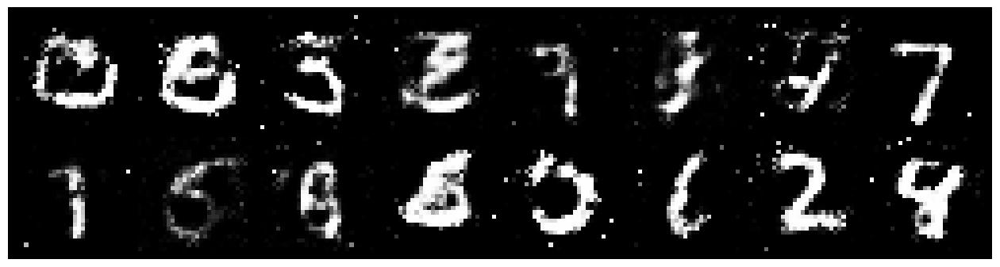

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8952
D(x): 0.5502, D(G(z)): 0.4504


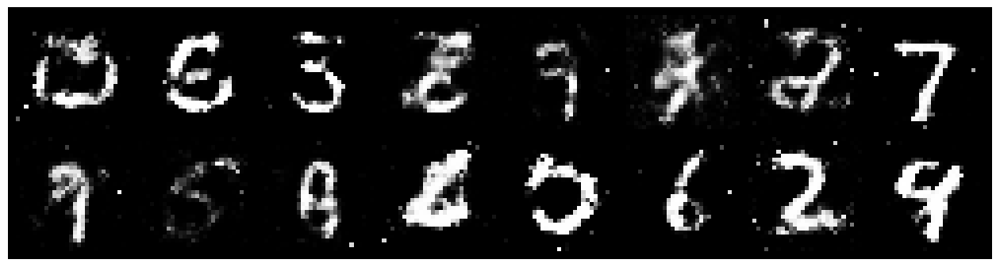

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.3316, Generator Loss: 1.0923
D(x): 0.5544, D(G(z)): 0.4195


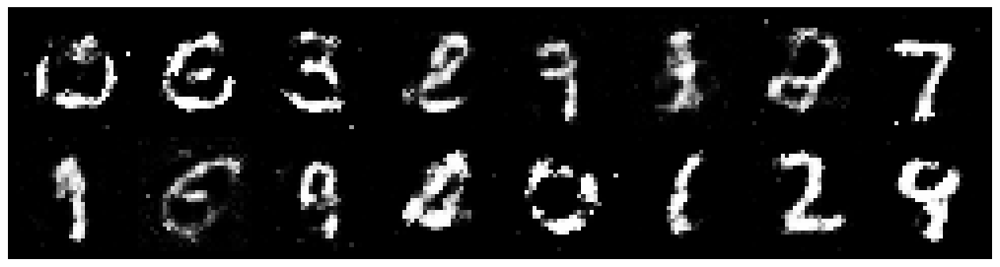

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2548, Generator Loss: 0.9739
D(x): 0.5480, D(G(z)): 0.4150


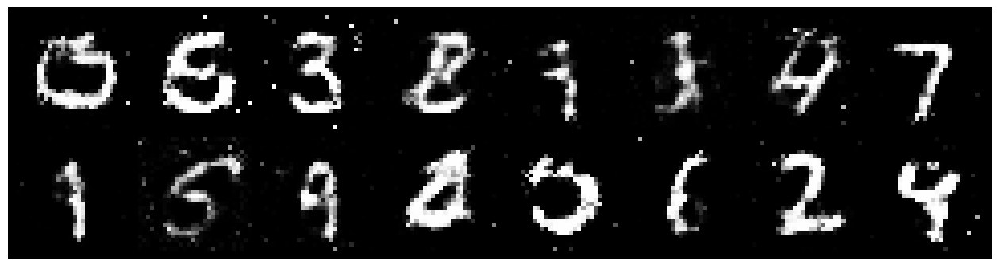

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1716, Generator Loss: 1.1138
D(x): 0.5847, D(G(z)): 0.3926


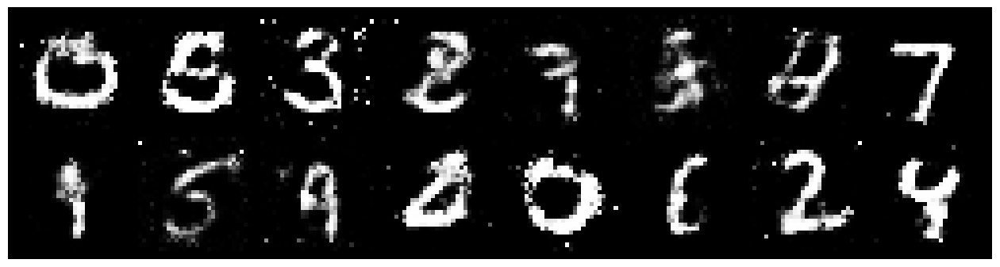

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2163, Generator Loss: 1.1150
D(x): 0.5707, D(G(z)): 0.4110


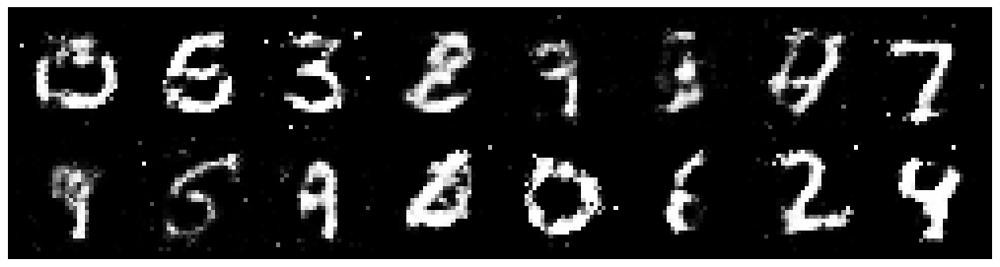

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.0422, Generator Loss: 1.1758
D(x): 0.6333, D(G(z)): 0.3675


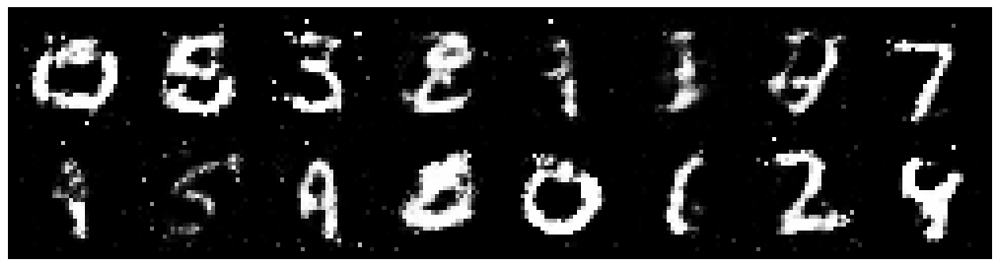

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 0.9812, Generator Loss: 1.2501
D(x): 0.6864, D(G(z)): 0.3633


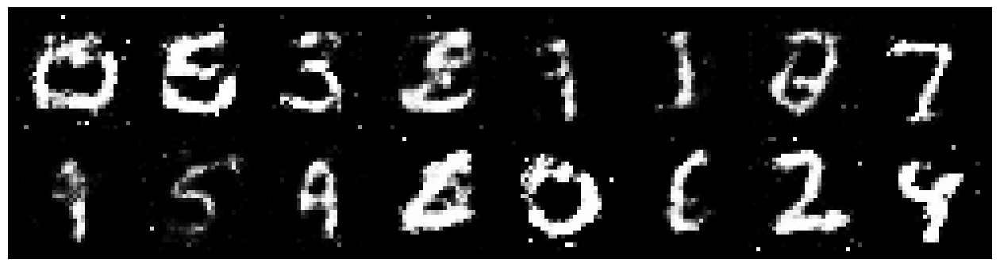

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.0875, Generator Loss: 1.1157
D(x): 0.6004, D(G(z)): 0.3805


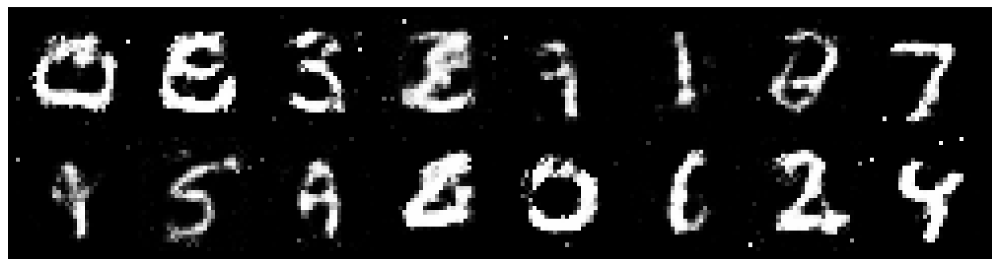

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1624, Generator Loss: 1.2702
D(x): 0.5933, D(G(z)): 0.3851


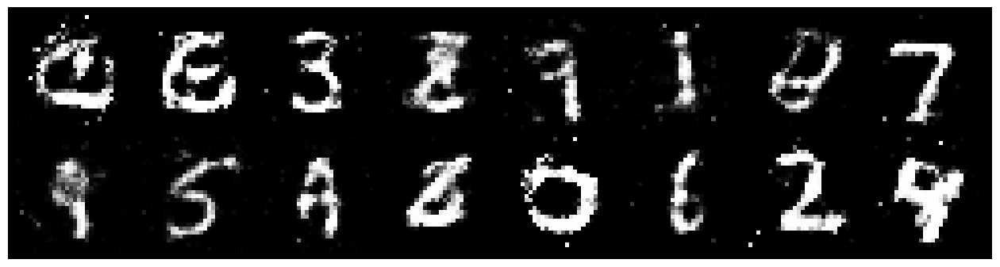

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.0906, Generator Loss: 1.1080
D(x): 0.5956, D(G(z)): 0.3402


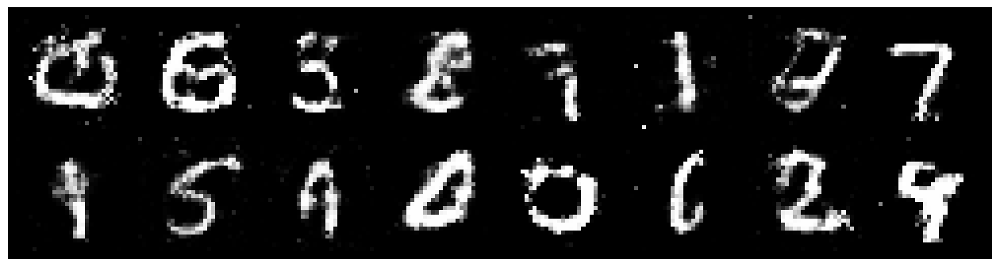

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1713, Generator Loss: 1.0840
D(x): 0.6026, D(G(z)): 0.3987


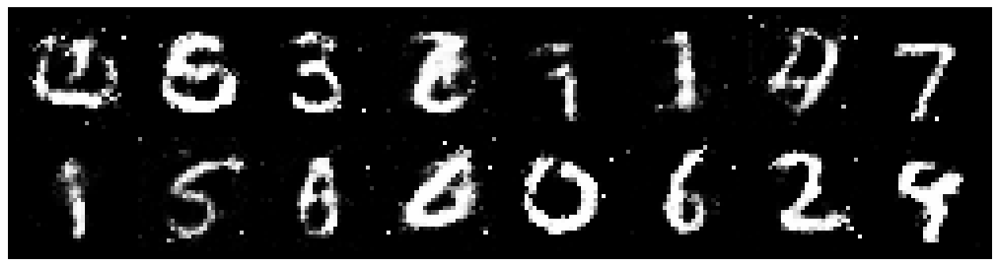

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.2539, Generator Loss: 1.1432
D(x): 0.5675, D(G(z)): 0.3962


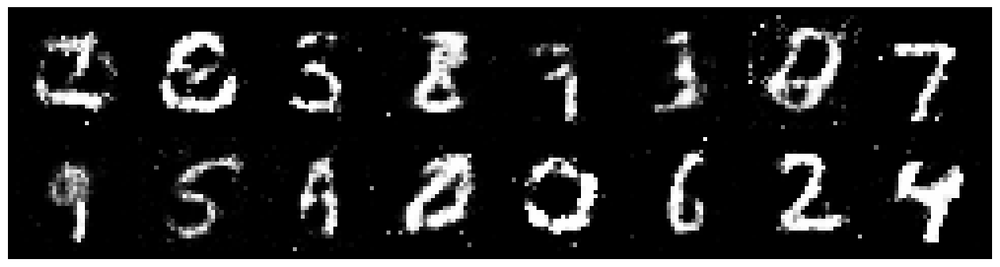

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.2789, Generator Loss: 0.9681
D(x): 0.6198, D(G(z)): 0.4582


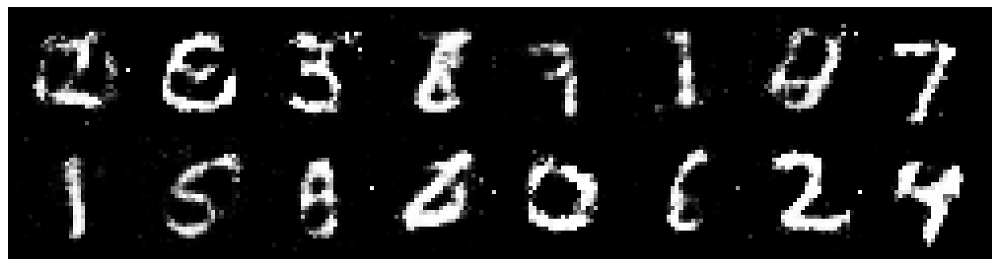

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1615, Generator Loss: 1.1386
D(x): 0.6293, D(G(z)): 0.4081


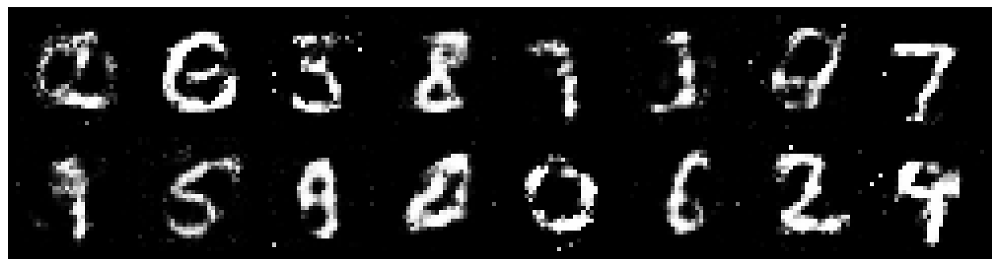

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.2290, Generator Loss: 0.9818
D(x): 0.6107, D(G(z)): 0.4342


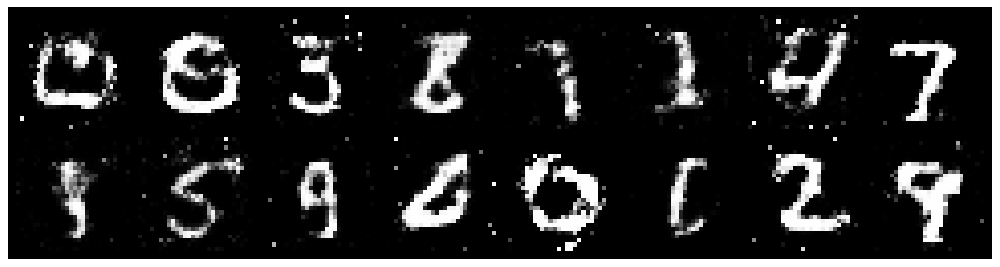

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.2367, Generator Loss: 1.0167
D(x): 0.5573, D(G(z)): 0.3934


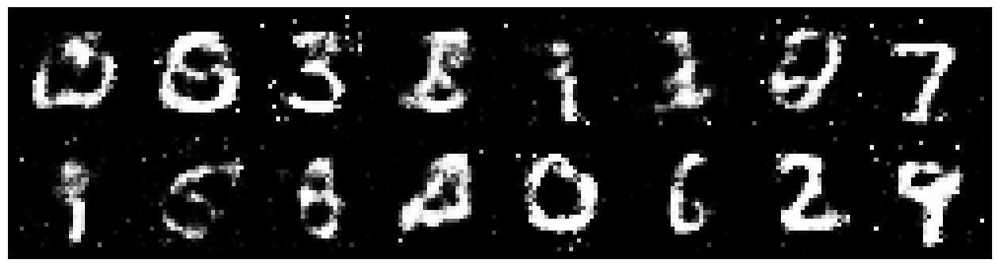

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 0.9840, Generator Loss: 0.9511
D(x): 0.6651, D(G(z)): 0.3606


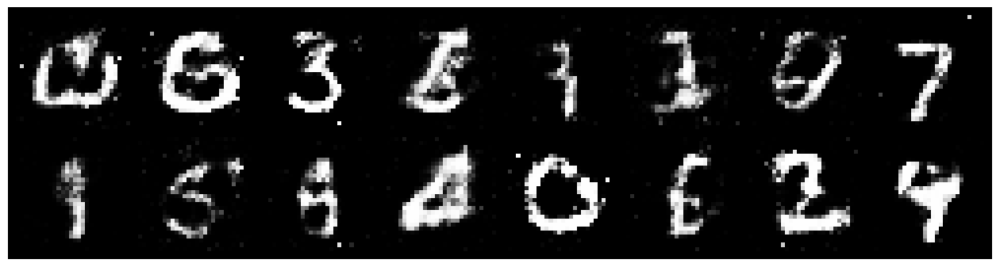

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.0320, Generator Loss: 1.1227
D(x): 0.6341, D(G(z)): 0.3278


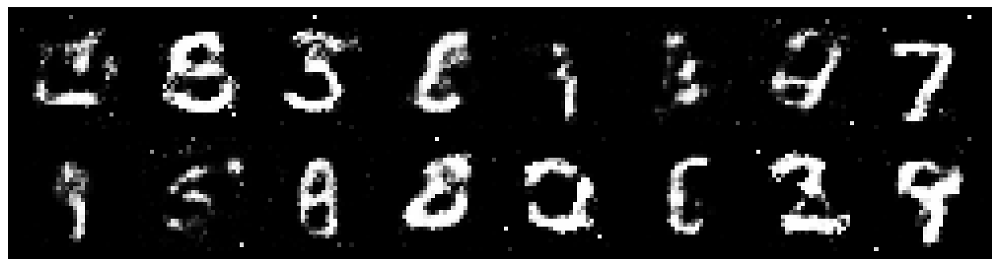

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.0471, Generator Loss: 1.0074
D(x): 0.6544, D(G(z)): 0.3988


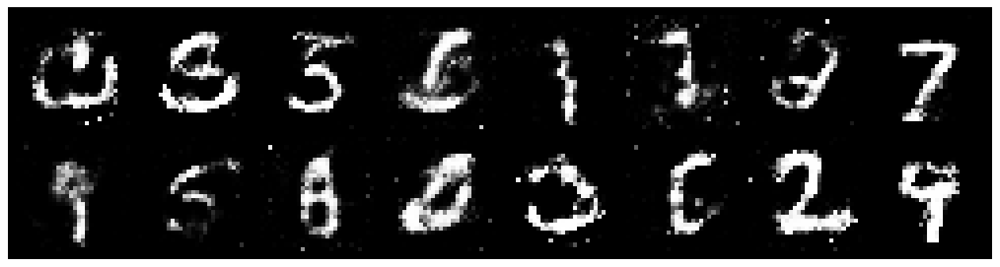

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1986, Generator Loss: 1.0574
D(x): 0.6055, D(G(z)): 0.4293


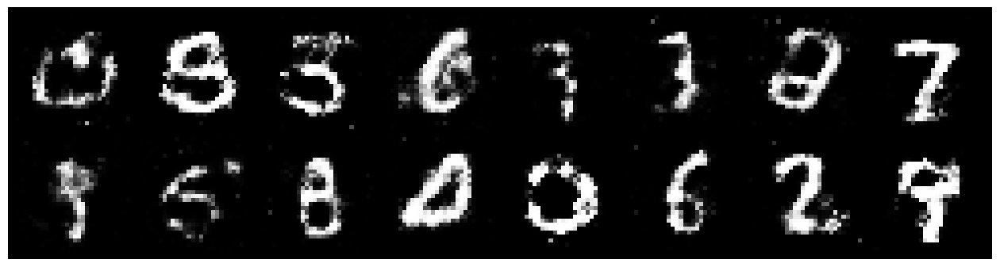

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.1378, Generator Loss: 1.0804
D(x): 0.5674, D(G(z)): 0.3751


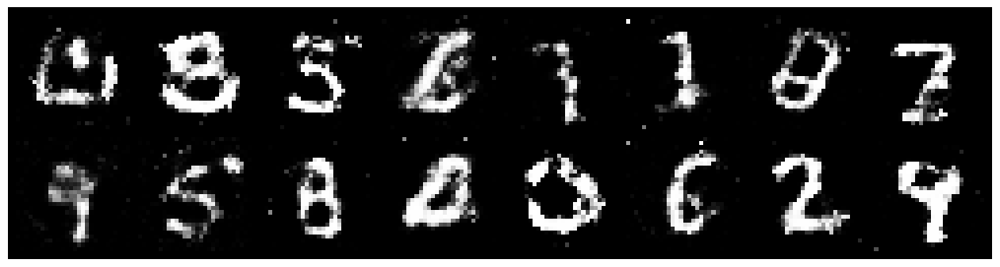

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1967, Generator Loss: 0.9320
D(x): 0.6335, D(G(z)): 0.4764


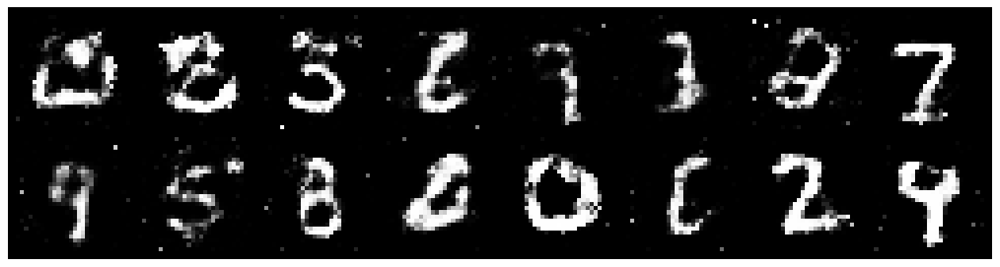

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.1120, Generator Loss: 1.1807
D(x): 0.5830, D(G(z)): 0.3561


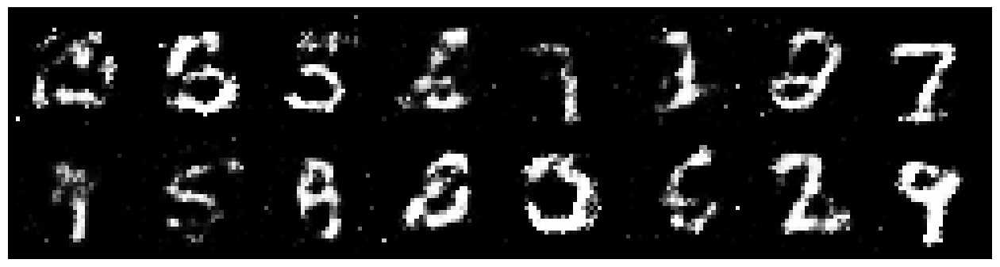

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.1684, Generator Loss: 1.0682
D(x): 0.5813, D(G(z)): 0.3681


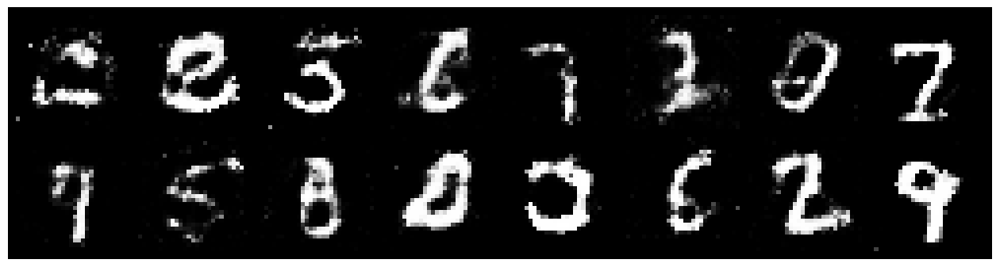

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.2614, Generator Loss: 1.1304
D(x): 0.5718, D(G(z)): 0.4132


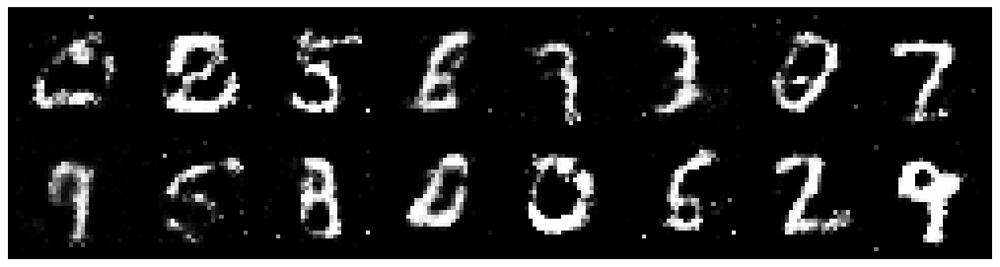

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.0515, Generator Loss: 1.1478
D(x): 0.6366, D(G(z)): 0.3961


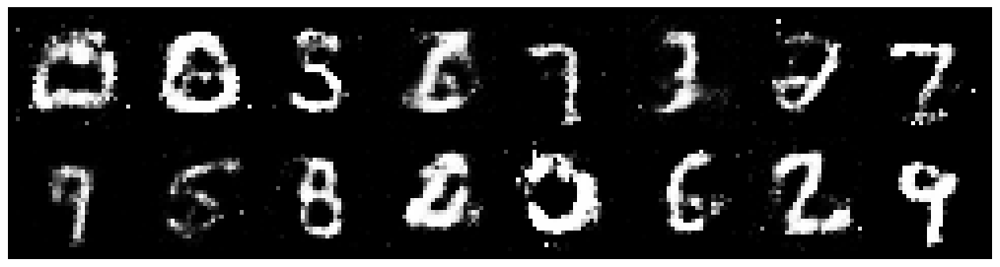

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.0865, Generator Loss: 1.2100
D(x): 0.5907, D(G(z)): 0.3568


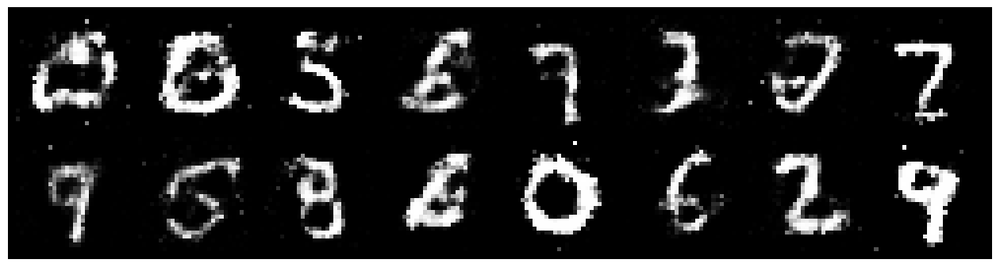

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2885, Generator Loss: 1.0678
D(x): 0.5684, D(G(z)): 0.4090


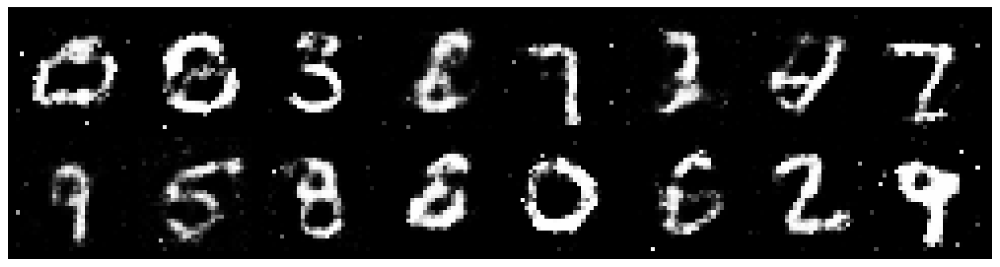

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.2876, Generator Loss: 1.0994
D(x): 0.5776, D(G(z)): 0.4062


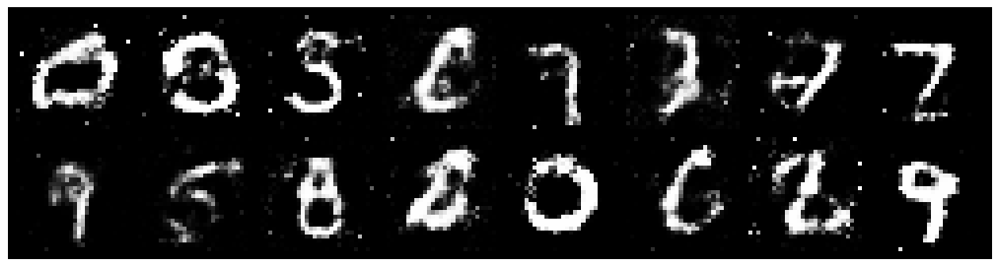

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2703, Generator Loss: 1.1163
D(x): 0.5617, D(G(z)): 0.4183


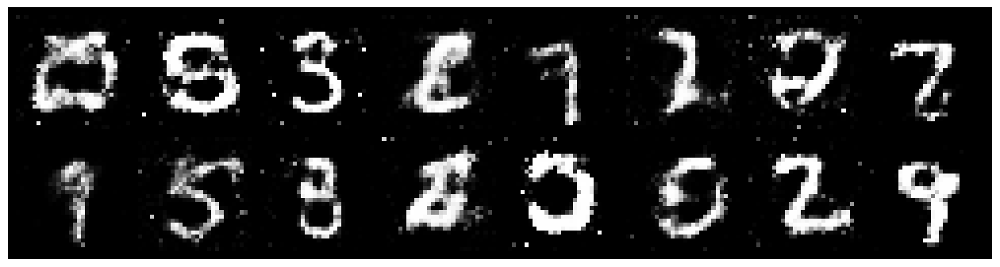

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1917, Generator Loss: 1.0631
D(x): 0.5522, D(G(z)): 0.3942


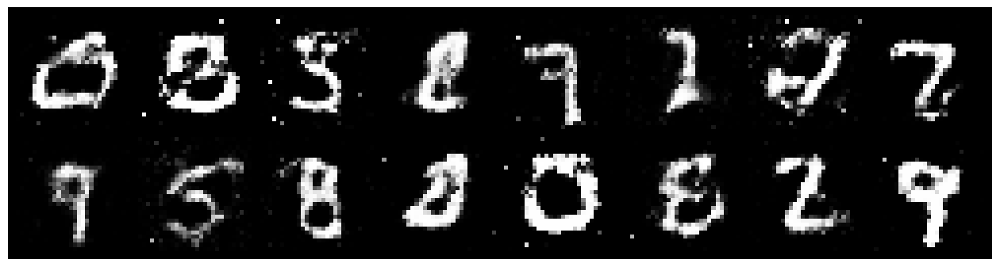

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2665, Generator Loss: 0.8906
D(x): 0.6065, D(G(z)): 0.4652


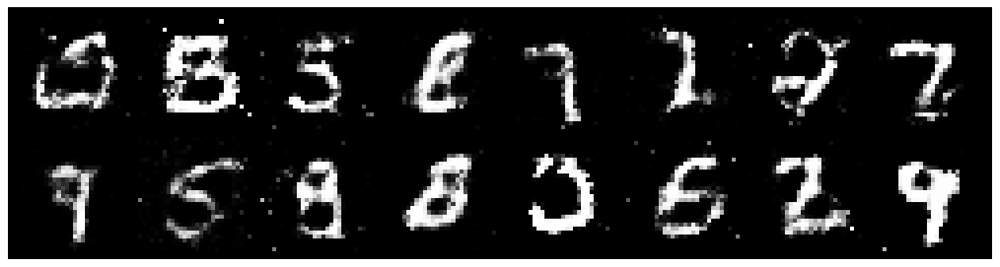

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2534, Generator Loss: 0.8737
D(x): 0.6028, D(G(z)): 0.4766


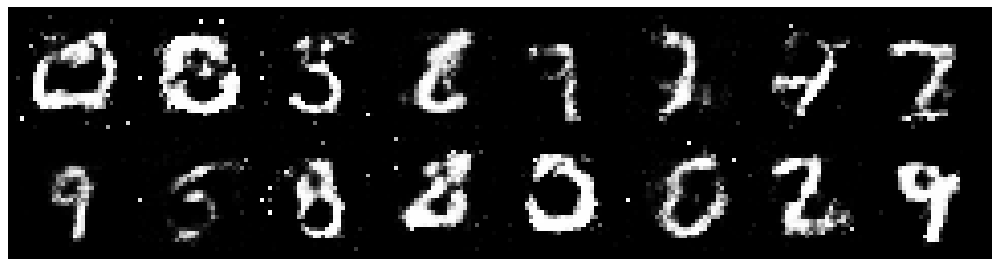

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2327, Generator Loss: 1.0844
D(x): 0.5896, D(G(z)): 0.4422


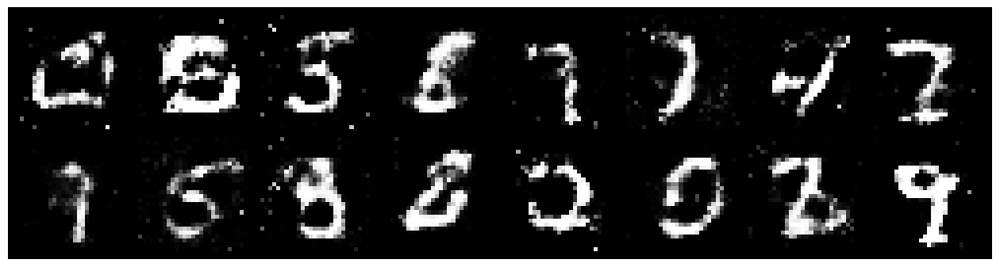

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1865, Generator Loss: 1.0375
D(x): 0.5409, D(G(z)): 0.3788


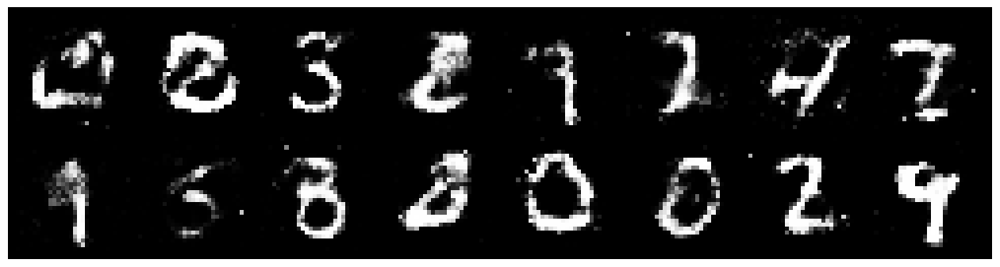

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1681, Generator Loss: 1.0616
D(x): 0.5856, D(G(z)): 0.4101


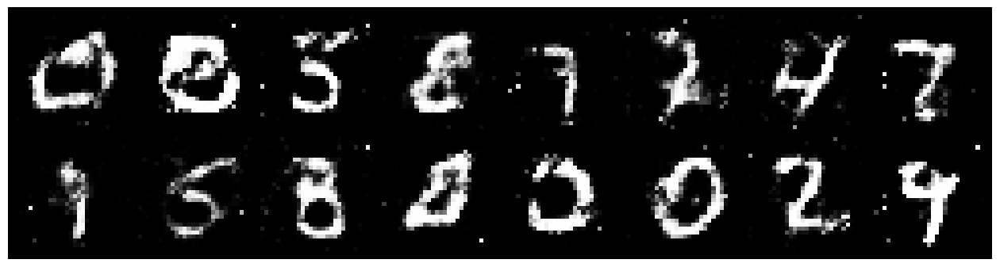

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2811, Generator Loss: 0.8538
D(x): 0.5908, D(G(z)): 0.4407


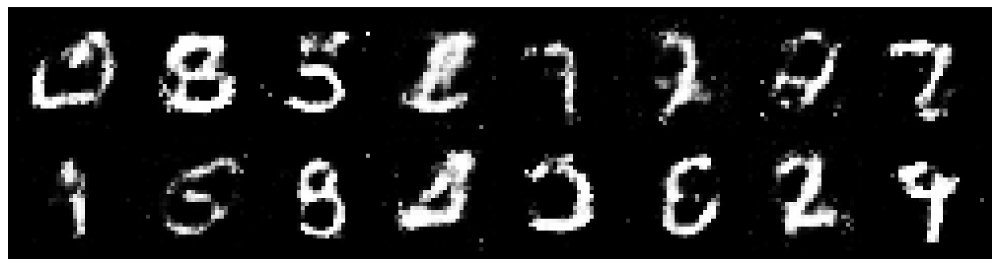

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.1805, Generator Loss: 1.0306
D(x): 0.6255, D(G(z)): 0.4522


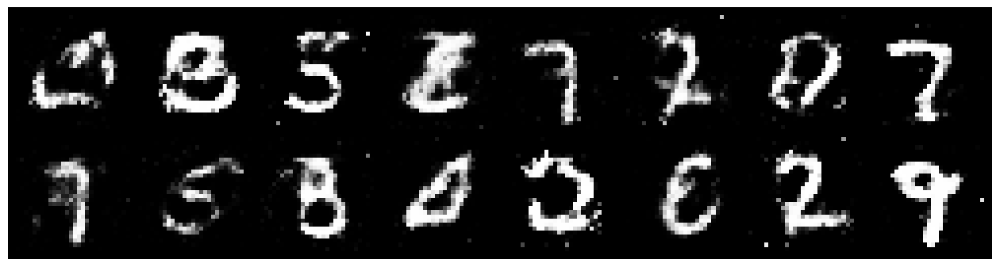

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1729, Generator Loss: 0.8354
D(x): 0.6485, D(G(z)): 0.4467


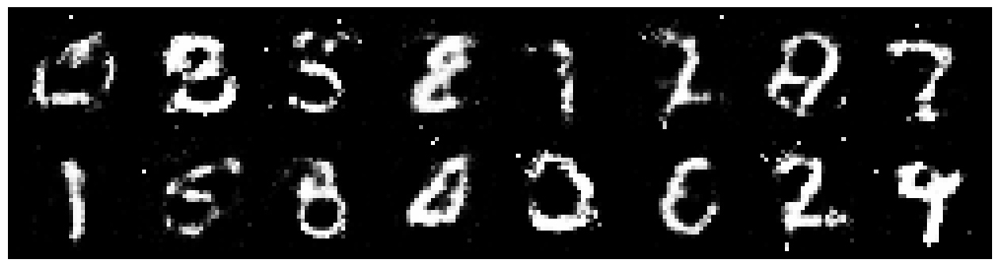

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.3583, Generator Loss: 0.9507
D(x): 0.5796, D(G(z)): 0.4496


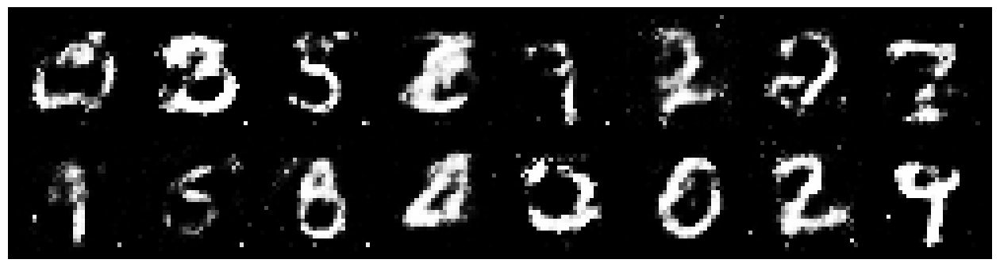

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1797, Generator Loss: 0.8615
D(x): 0.6041, D(G(z)): 0.4228


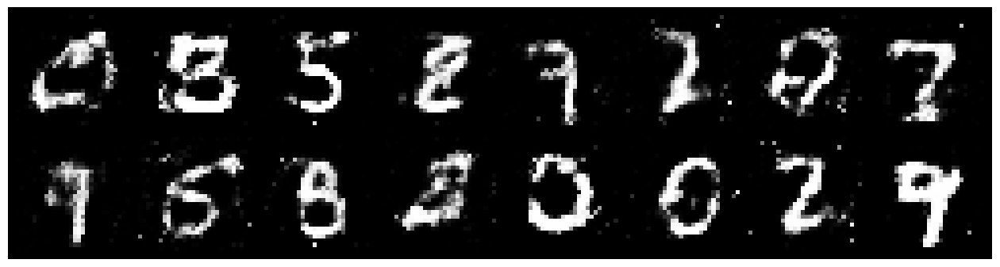

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.3627, Generator Loss: 1.1530
D(x): 0.5458, D(G(z)): 0.4143


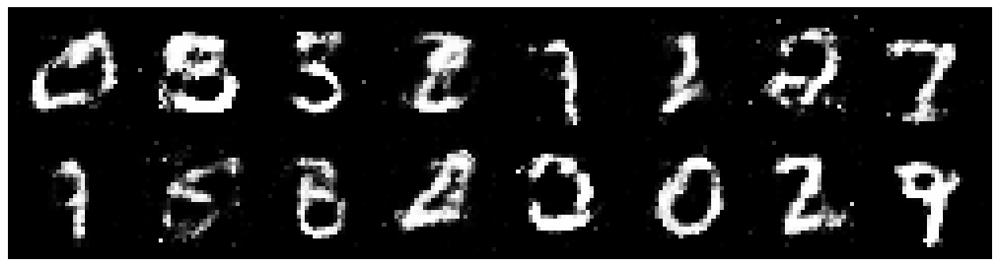

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.2865, Generator Loss: 0.9279
D(x): 0.5535, D(G(z)): 0.4082


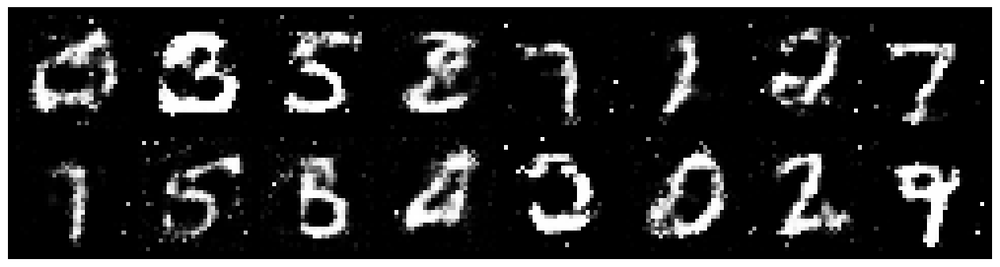

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2762, Generator Loss: 0.9077
D(x): 0.5936, D(G(z)): 0.4554


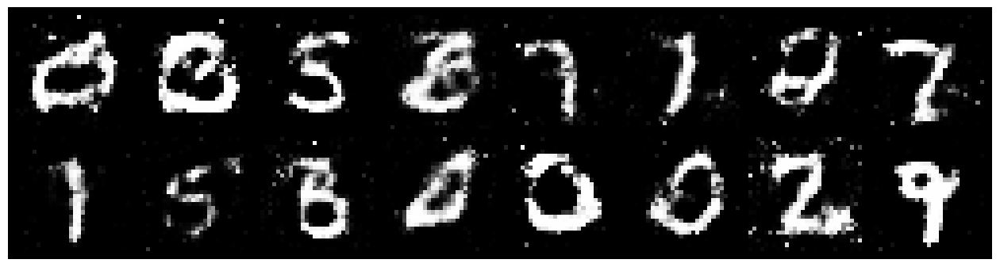

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2516, Generator Loss: 1.0417
D(x): 0.5363, D(G(z)): 0.3928


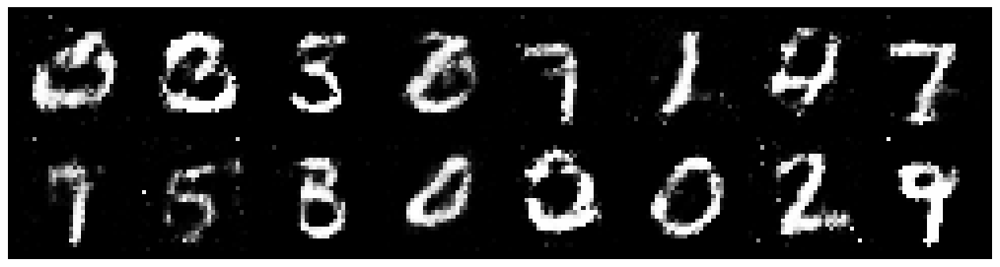

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2838, Generator Loss: 0.8878
D(x): 0.5708, D(G(z)): 0.4602


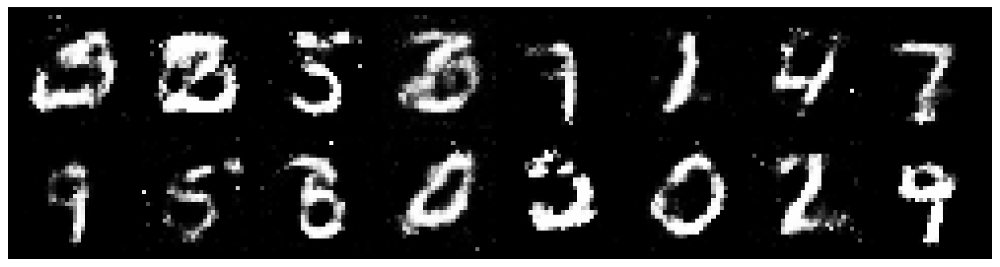

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2441, Generator Loss: 0.9188
D(x): 0.5564, D(G(z)): 0.3924


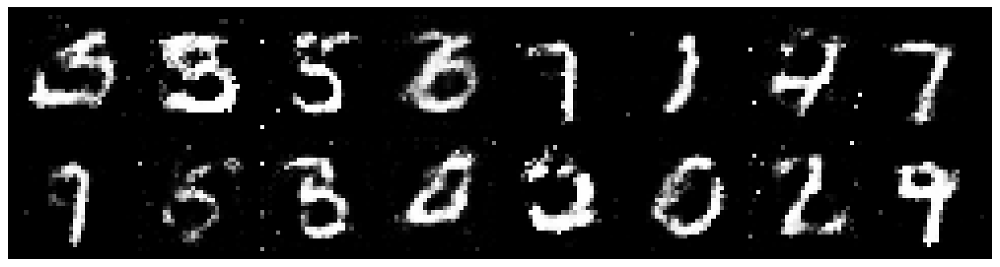

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1070, Generator Loss: 1.0193
D(x): 0.6128, D(G(z)): 0.3942


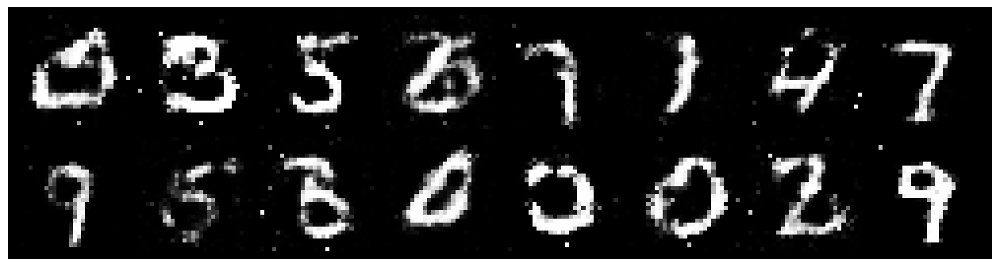

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.1351, Generator Loss: 1.0077
D(x): 0.5995, D(G(z)): 0.4007


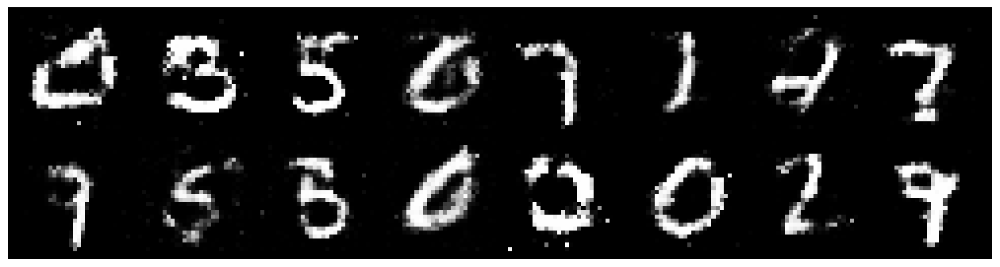

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1561, Generator Loss: 0.8482
D(x): 0.6117, D(G(z)): 0.4482


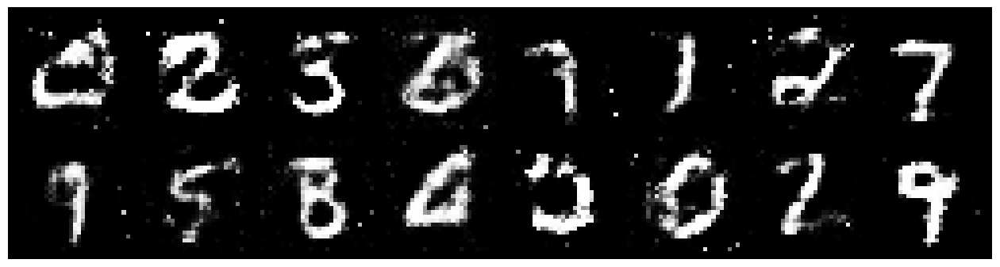

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9899
D(x): 0.5508, D(G(z)): 0.3961


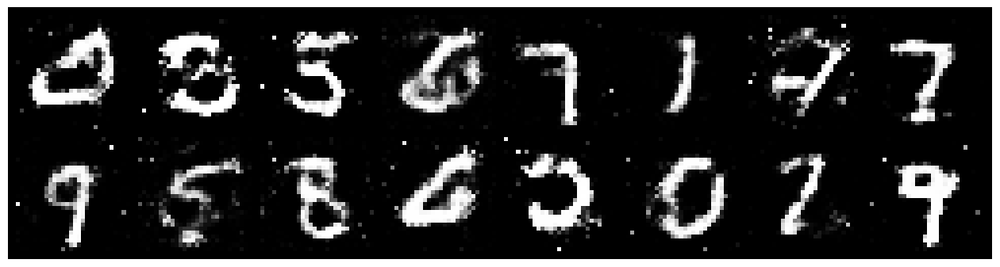

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.3519, Generator Loss: 0.9651
D(x): 0.5595, D(G(z)): 0.4561


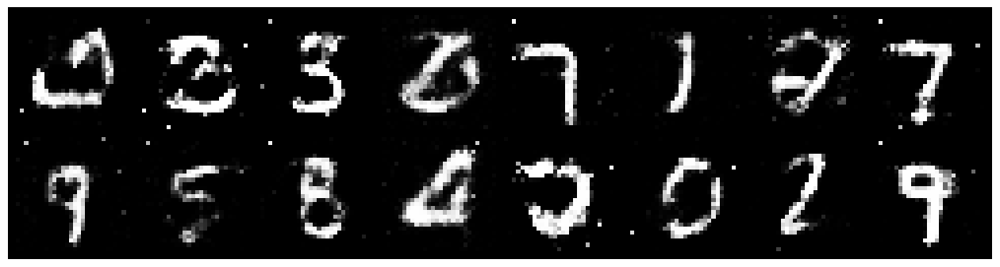

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2337, Generator Loss: 1.0817
D(x): 0.5778, D(G(z)): 0.4111


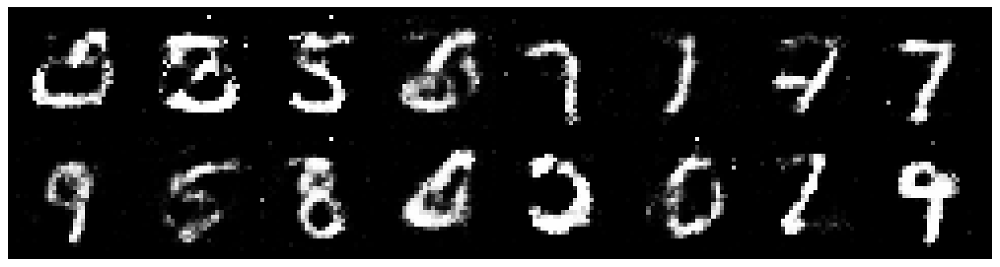

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 0.9327, Generator Loss: 1.1411
D(x): 0.6593, D(G(z)): 0.3578


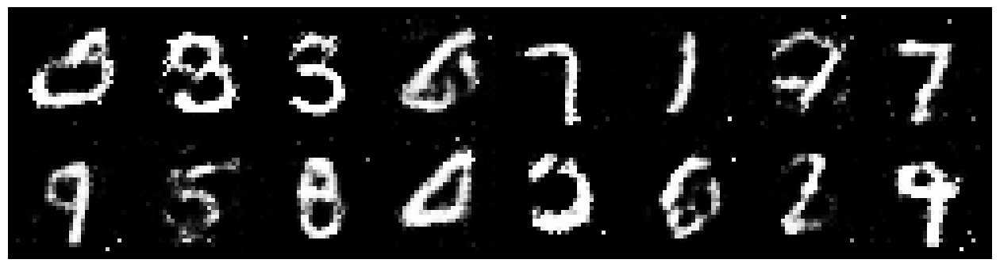

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.0906, Generator Loss: 1.4705
D(x): 0.5811, D(G(z)): 0.3401


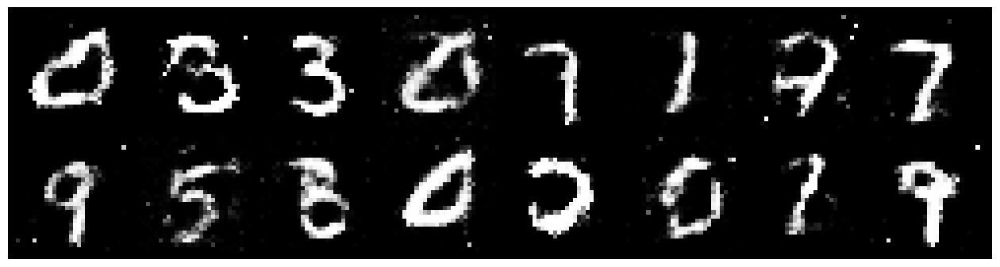

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 0.9847, Generator Loss: 1.1640
D(x): 0.6293, D(G(z)): 0.3480


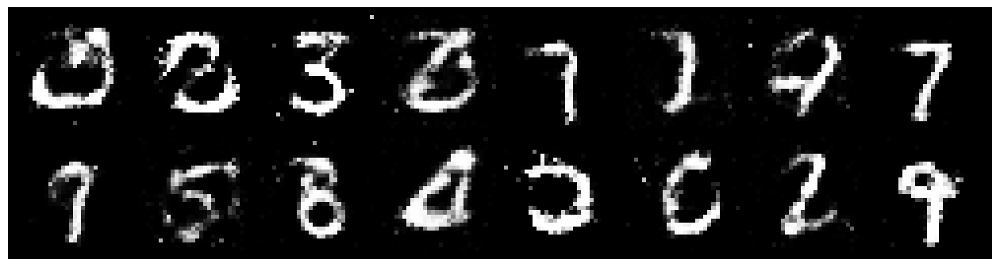

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1919, Generator Loss: 1.0215
D(x): 0.5969, D(G(z)): 0.4299


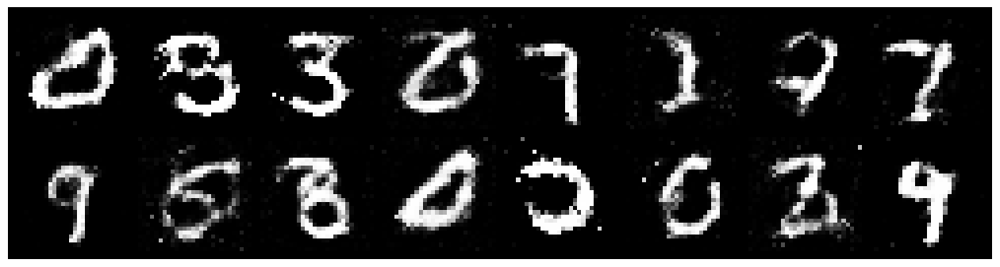

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1695, Generator Loss: 0.9590
D(x): 0.6394, D(G(z)): 0.4143


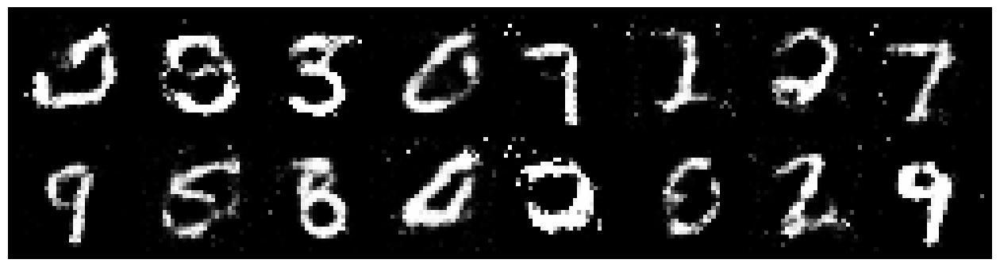

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2394, Generator Loss: 1.0315
D(x): 0.5938, D(G(z)): 0.4378


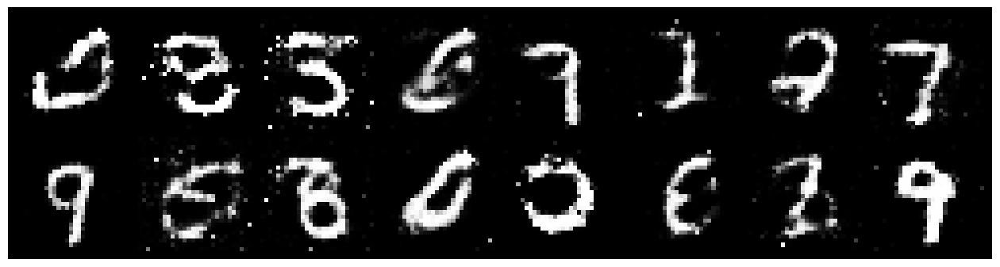

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1587, Generator Loss: 1.1155
D(x): 0.6221, D(G(z)): 0.4107


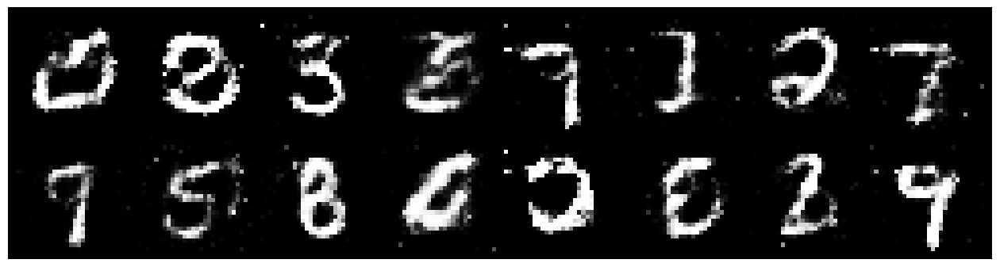

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1842, Generator Loss: 1.0030
D(x): 0.6311, D(G(z)): 0.4367


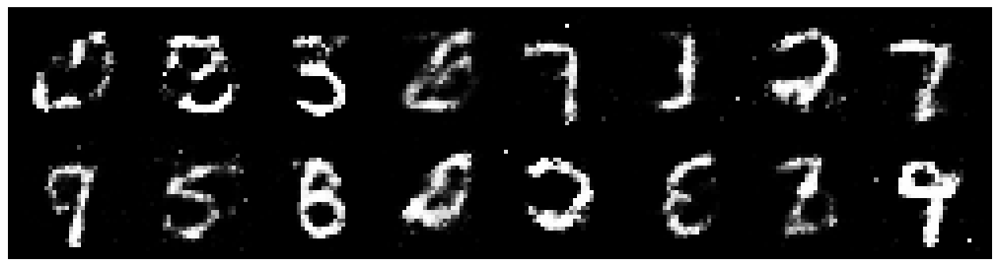

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.3631, Generator Loss: 1.0808
D(x): 0.4864, D(G(z)): 0.4052


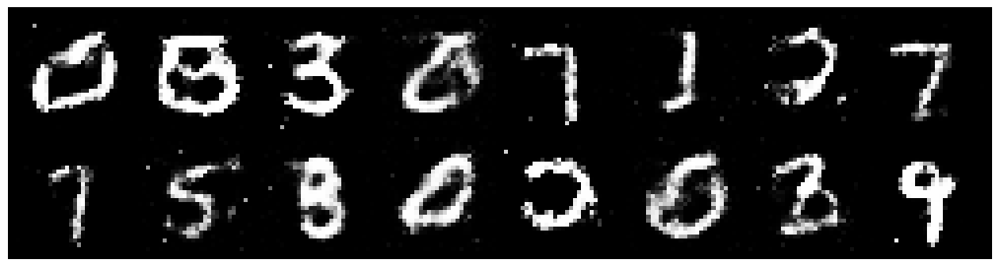

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.2067, Generator Loss: 0.7950
D(x): 0.5732, D(G(z)): 0.4377


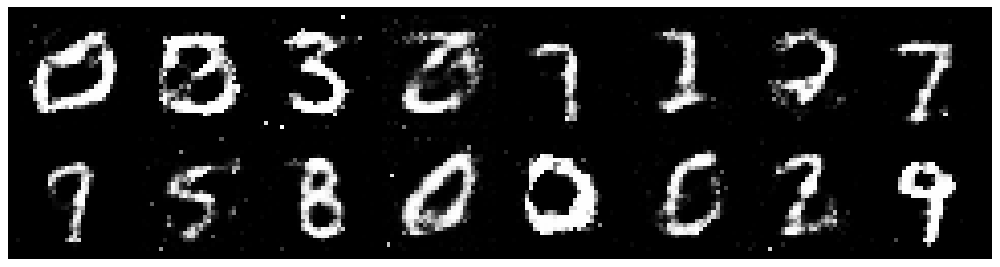

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.3546, Generator Loss: 0.9379
D(x): 0.5158, D(G(z)): 0.4113


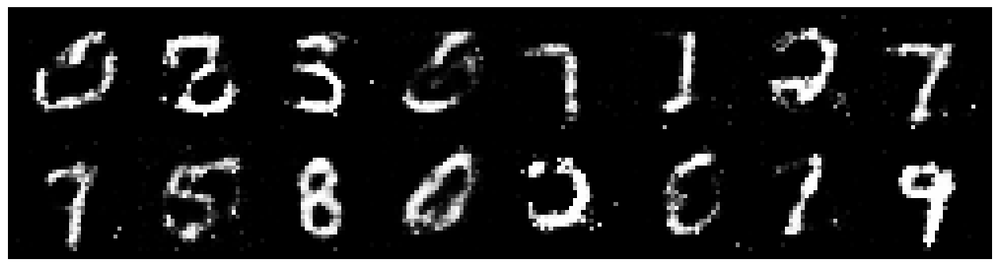

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1318, Generator Loss: 1.1312
D(x): 0.6467, D(G(z)): 0.4162


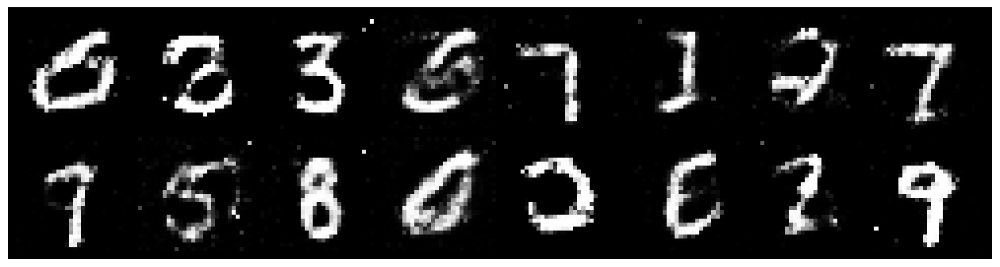

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.0423, Generator Loss: 1.1383
D(x): 0.6381, D(G(z)): 0.3462


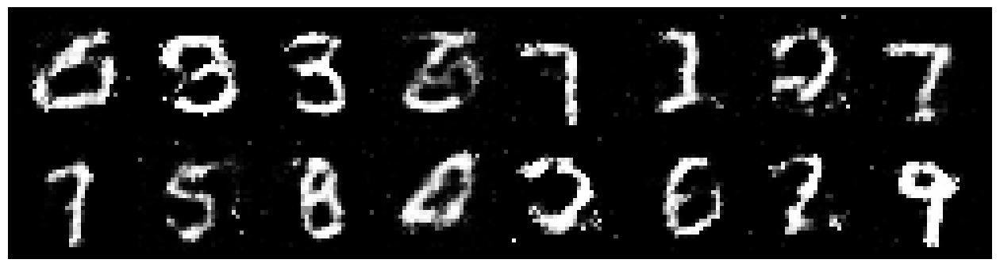

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1401, Generator Loss: 1.2342
D(x): 0.6266, D(G(z)): 0.3826


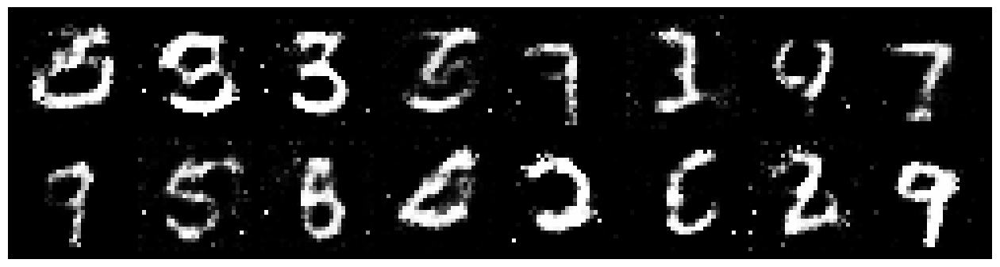

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2451, Generator Loss: 1.2662
D(x): 0.5497, D(G(z)): 0.3691


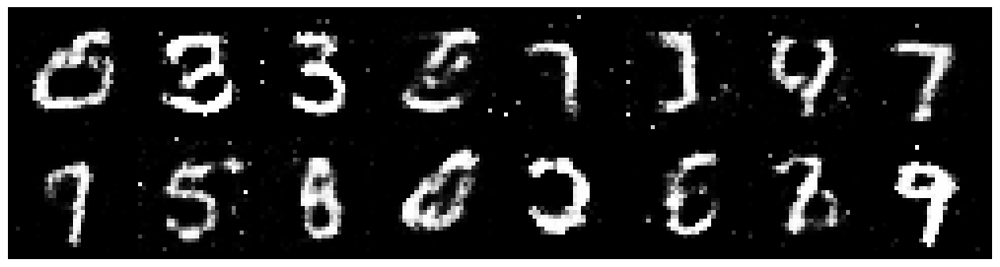

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2498, Generator Loss: 1.1535
D(x): 0.5947, D(G(z)): 0.4178


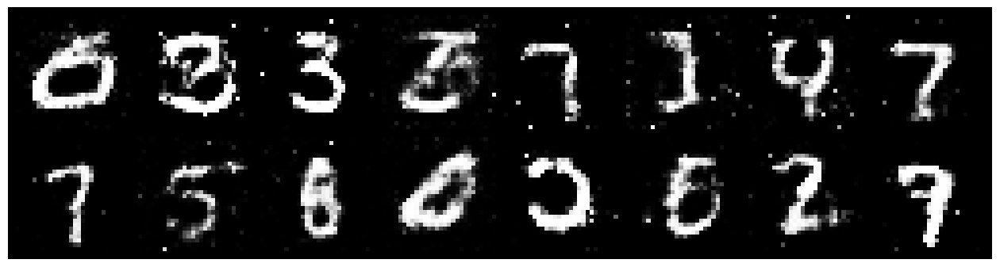

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1296, Generator Loss: 1.1963
D(x): 0.6289, D(G(z)): 0.3919


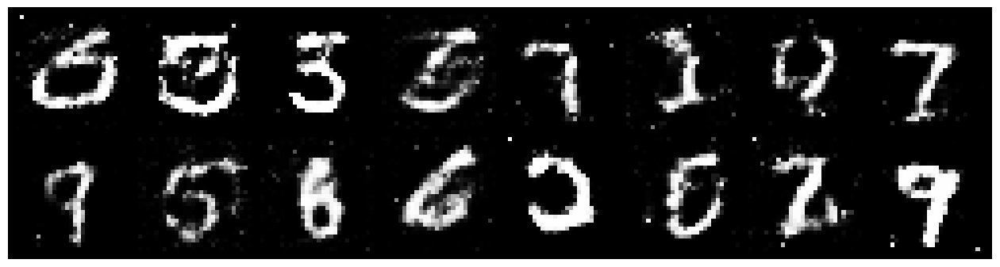

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2063, Generator Loss: 1.0255
D(x): 0.6246, D(G(z)): 0.4220


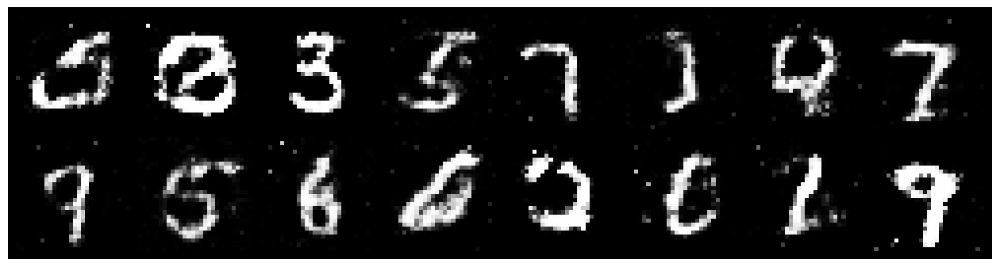

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2592, Generator Loss: 1.1000
D(x): 0.6310, D(G(z)): 0.4561


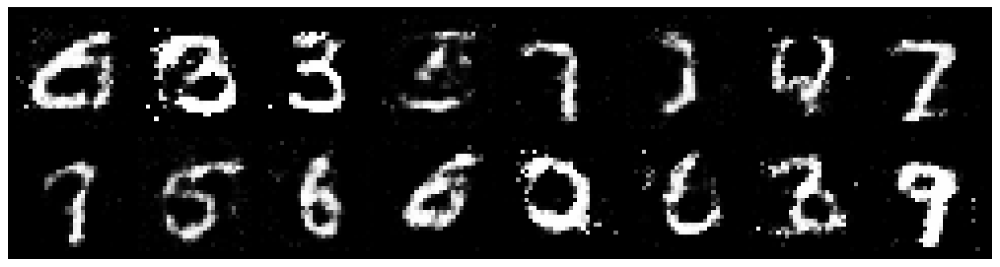

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1685, Generator Loss: 1.1735
D(x): 0.5960, D(G(z)): 0.3839


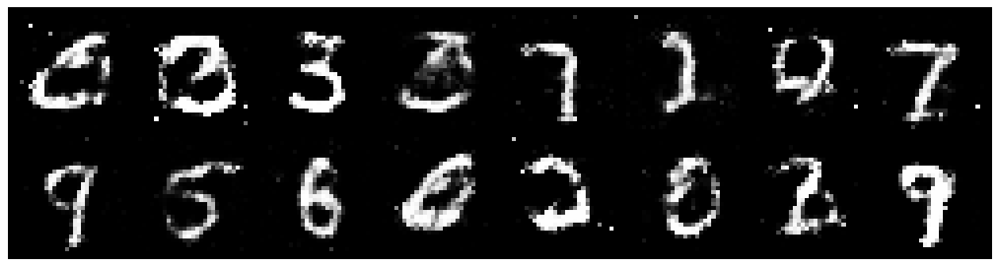

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1689, Generator Loss: 0.8668
D(x): 0.5815, D(G(z)): 0.4217


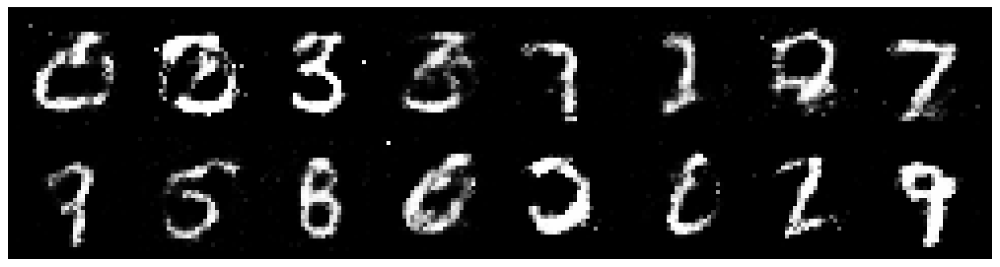

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8567
D(x): 0.5620, D(G(z)): 0.4454


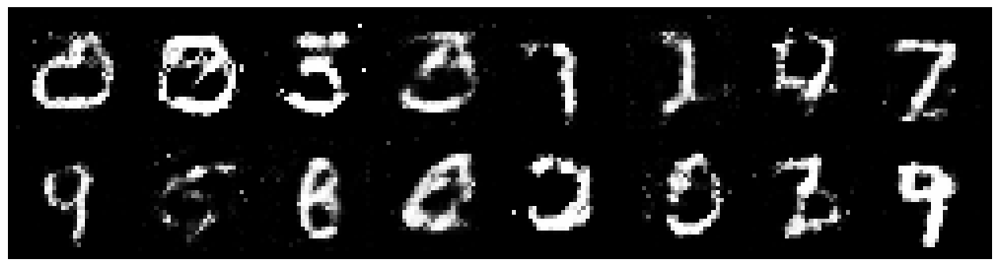

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8357
D(x): 0.5552, D(G(z)): 0.4688


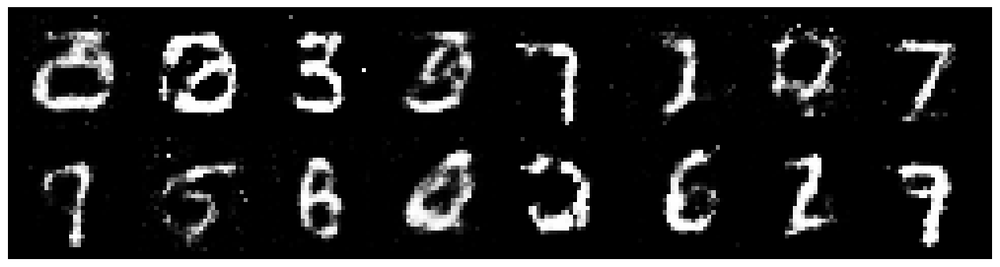

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2066, Generator Loss: 1.0113
D(x): 0.5663, D(G(z)): 0.3861


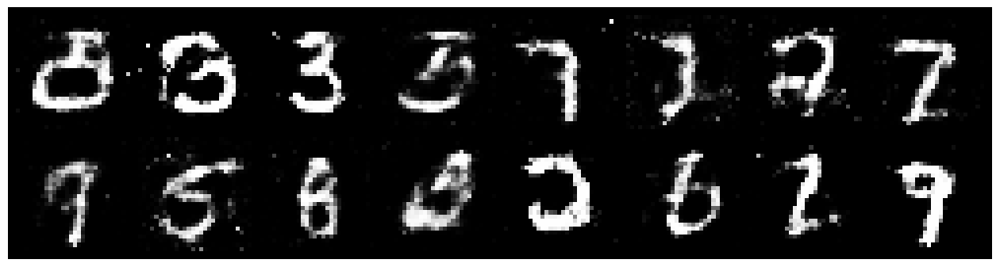

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.3036, Generator Loss: 0.8809
D(x): 0.5963, D(G(z)): 0.4602


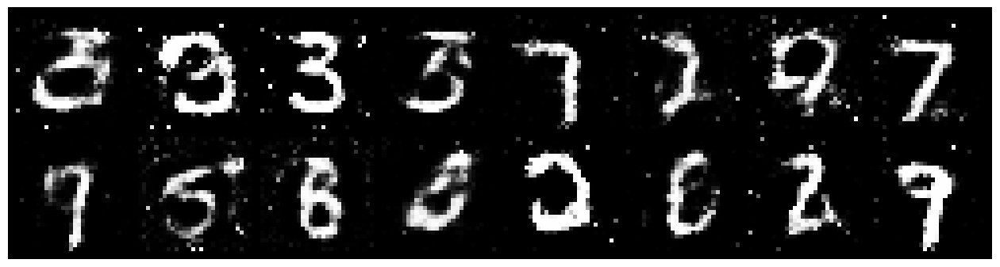

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2663, Generator Loss: 0.9744
D(x): 0.6122, D(G(z)): 0.4518


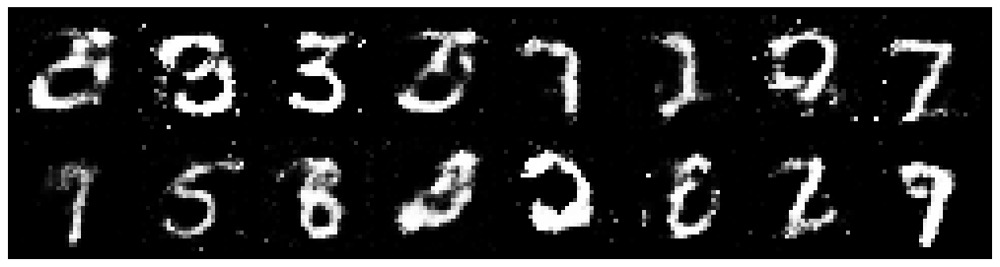

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2773, Generator Loss: 0.7999
D(x): 0.6315, D(G(z)): 0.4819


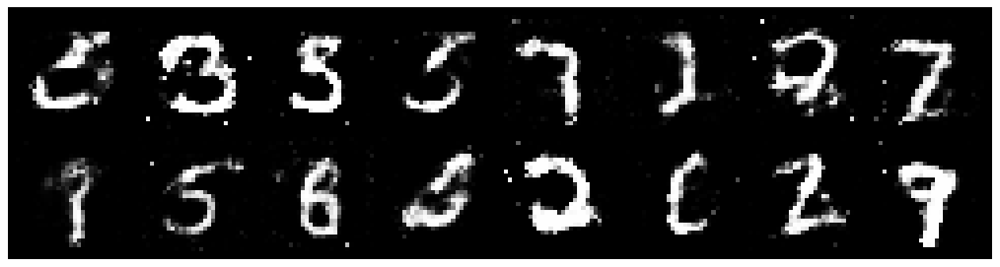

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1538, Generator Loss: 0.9448
D(x): 0.5872, D(G(z)): 0.3967


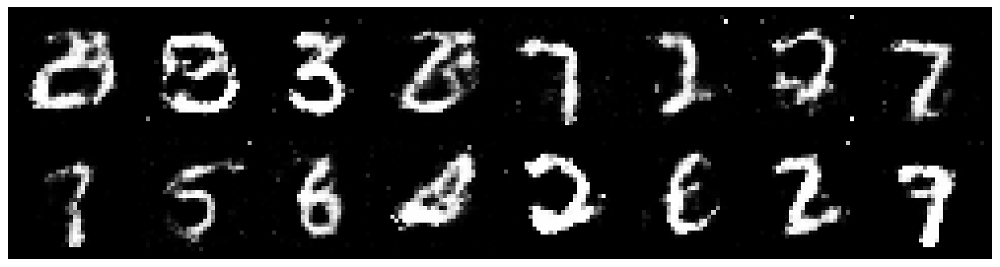

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.3214, Generator Loss: 0.8996
D(x): 0.5686, D(G(z)): 0.4648


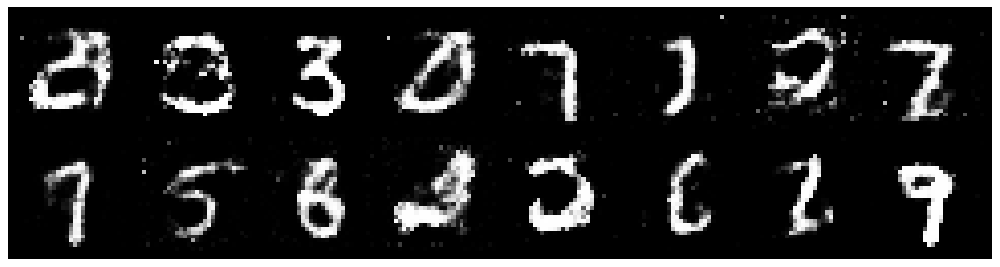

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.3988, Generator Loss: 0.6852
D(x): 0.5632, D(G(z)): 0.5085


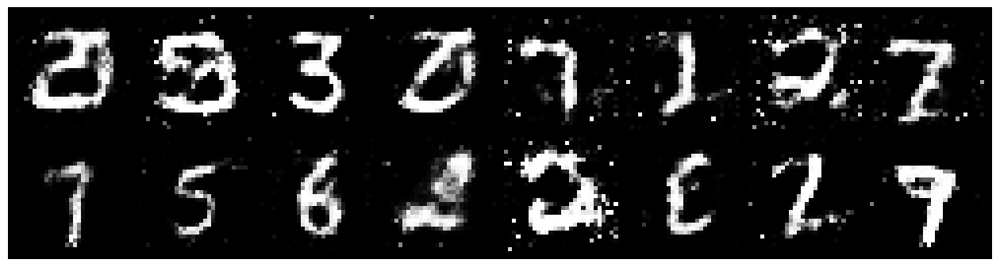

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2095, Generator Loss: 0.8984
D(x): 0.5768, D(G(z)): 0.4160


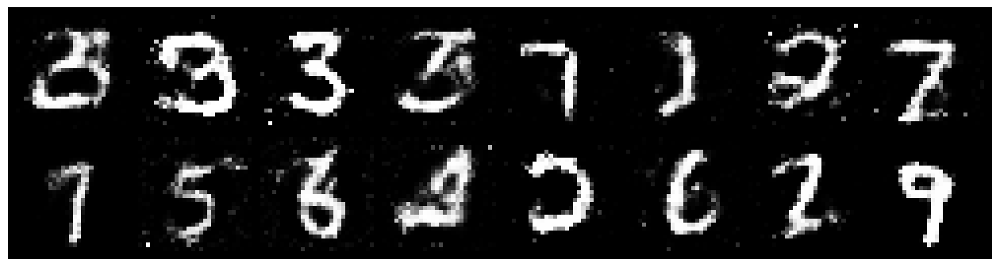

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2748, Generator Loss: 0.9495
D(x): 0.6712, D(G(z)): 0.4904


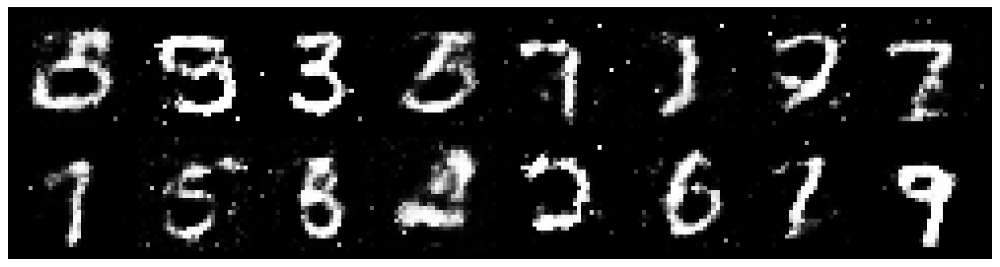

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.3193, Generator Loss: 1.1071
D(x): 0.5868, D(G(z)): 0.4473


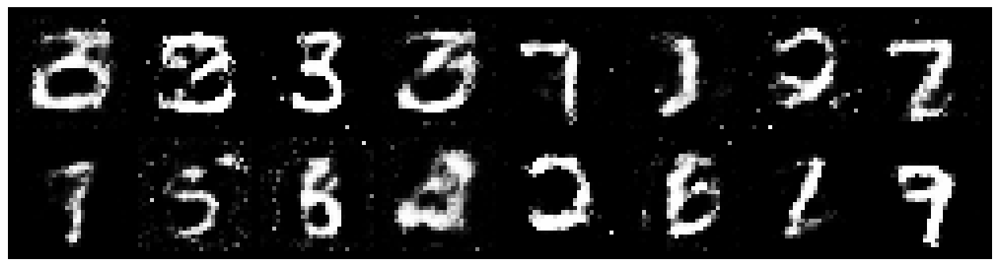

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2055, Generator Loss: 1.0153
D(x): 0.5444, D(G(z)): 0.3896


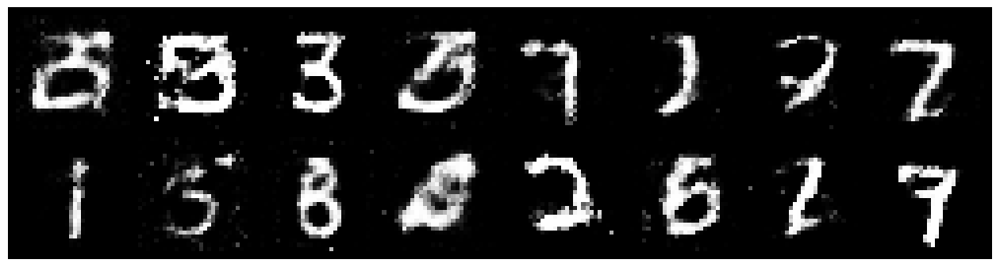

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.2328, Generator Loss: 0.8829
D(x): 0.5682, D(G(z)): 0.4248


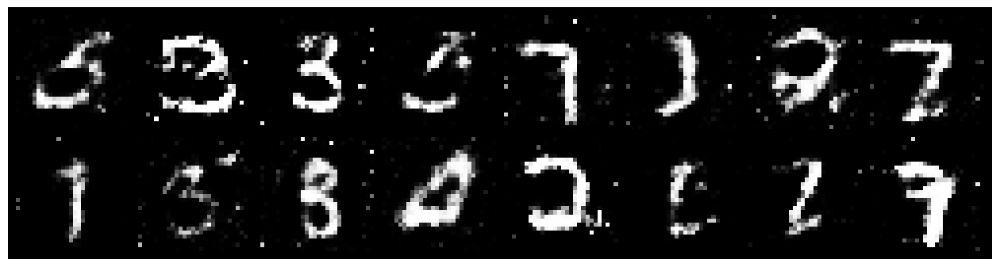

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8657
D(x): 0.5896, D(G(z)): 0.4609


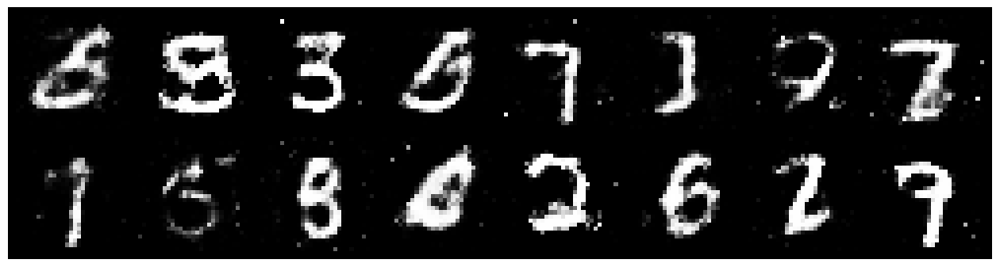

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1930, Generator Loss: 1.0178
D(x): 0.5646, D(G(z)): 0.4024


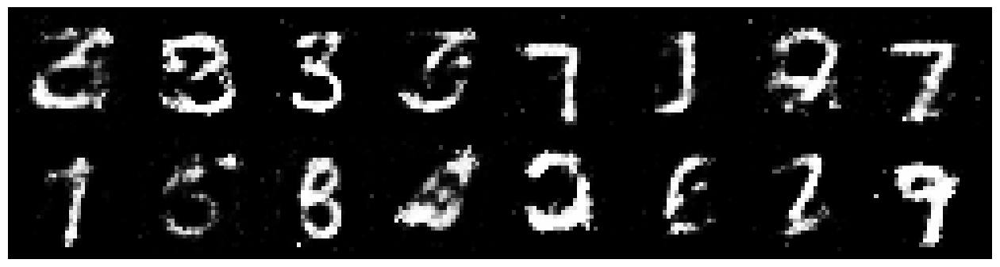

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8751
D(x): 0.5175, D(G(z)): 0.4152


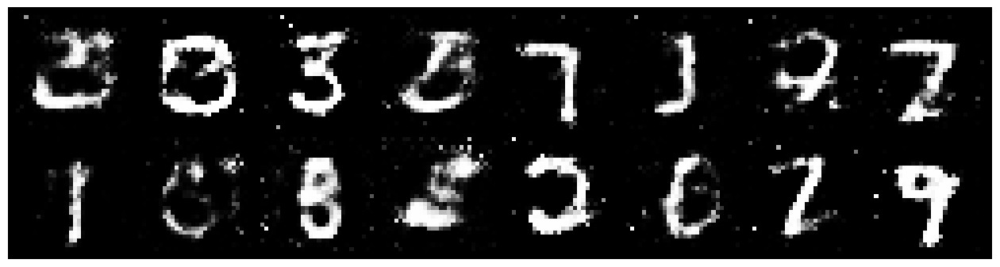

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.1540, Generator Loss: 0.9051
D(x): 0.5834, D(G(z)): 0.4057


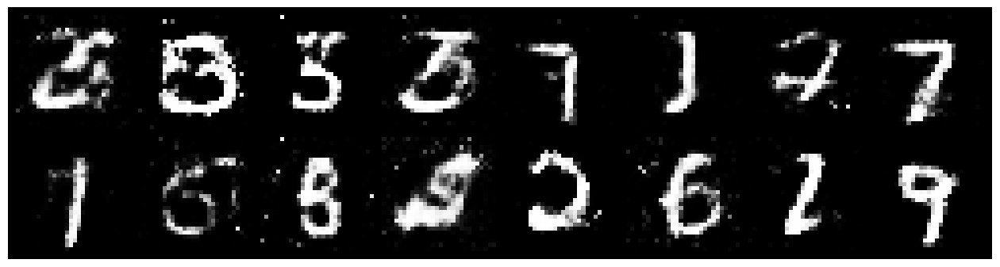

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2050, Generator Loss: 0.8580
D(x): 0.5836, D(G(z)): 0.4341


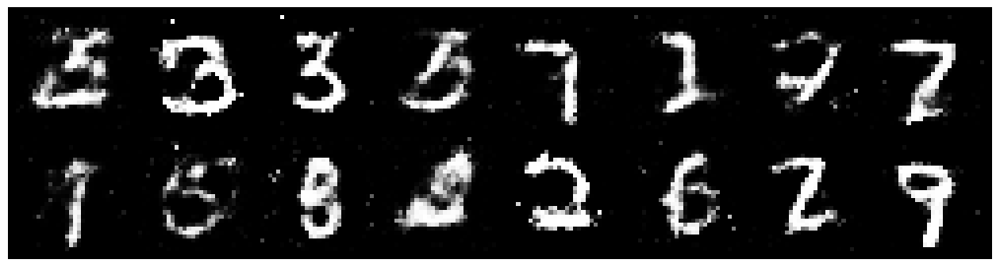

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.1731, Generator Loss: 1.2571
D(x): 0.5597, D(G(z)): 0.3611


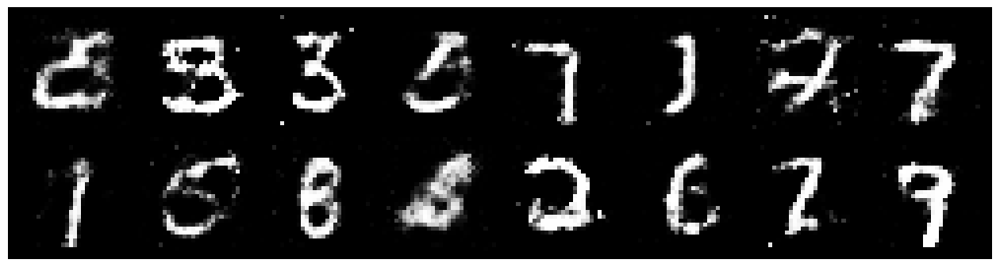

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.0324, Generator Loss: 1.1934
D(x): 0.6664, D(G(z)): 0.4086


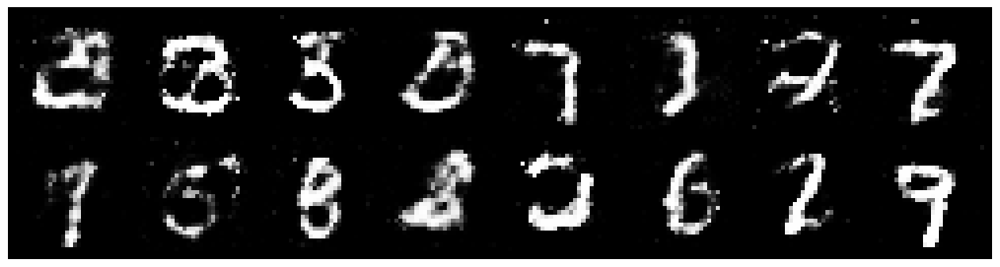

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2052, Generator Loss: 1.1923
D(x): 0.5911, D(G(z)): 0.4182


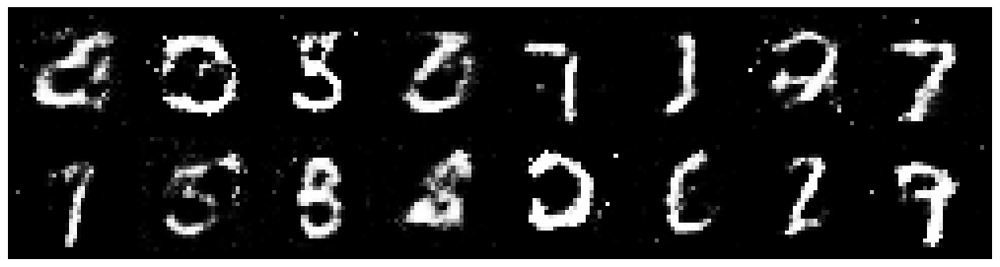

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2183, Generator Loss: 0.9768
D(x): 0.6124, D(G(z)): 0.4372


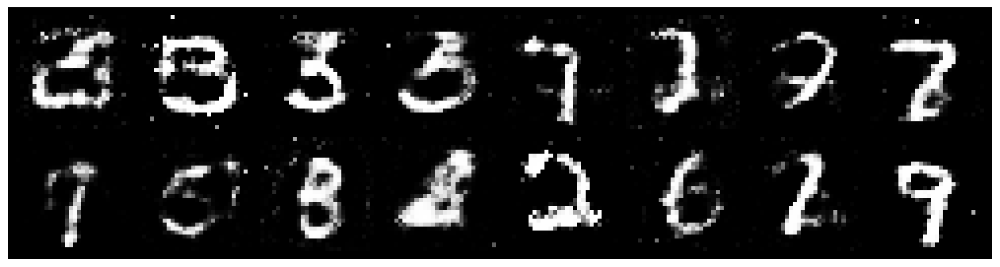

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2129, Generator Loss: 1.0817
D(x): 0.6098, D(G(z)): 0.4464


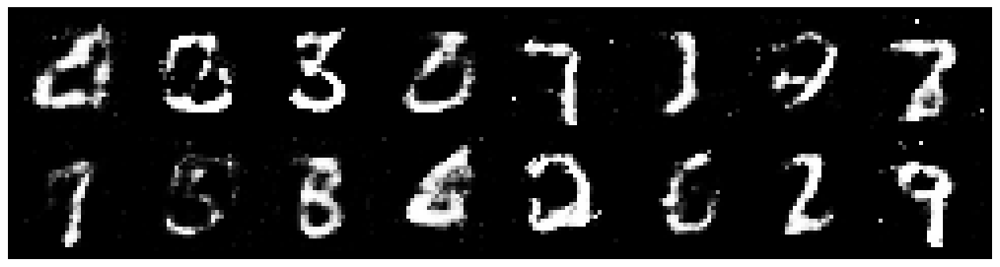

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2459, Generator Loss: 1.0342
D(x): 0.5688, D(G(z)): 0.4336


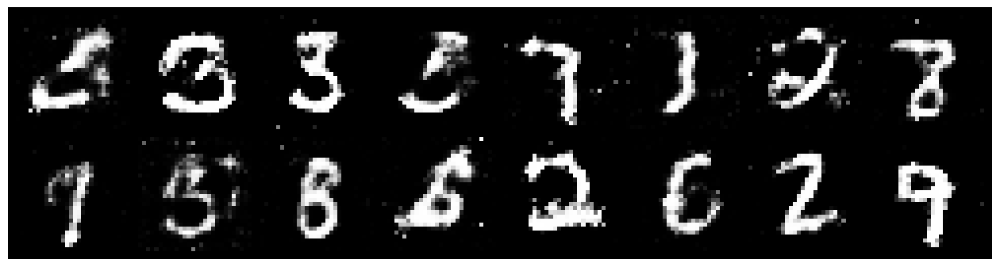

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1373, Generator Loss: 0.9518
D(x): 0.6176, D(G(z)): 0.4199


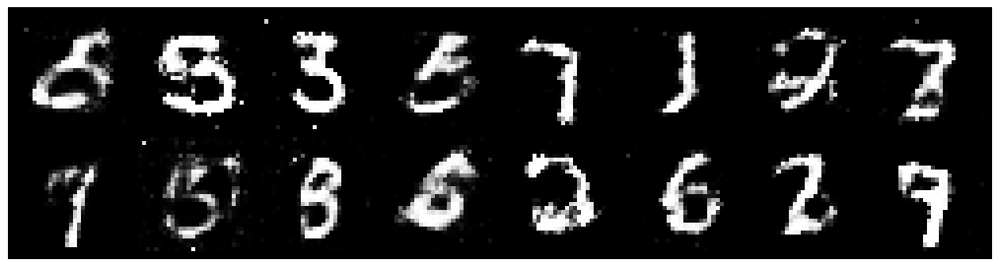

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.0930, Generator Loss: 0.8803
D(x): 0.6511, D(G(z)): 0.4161


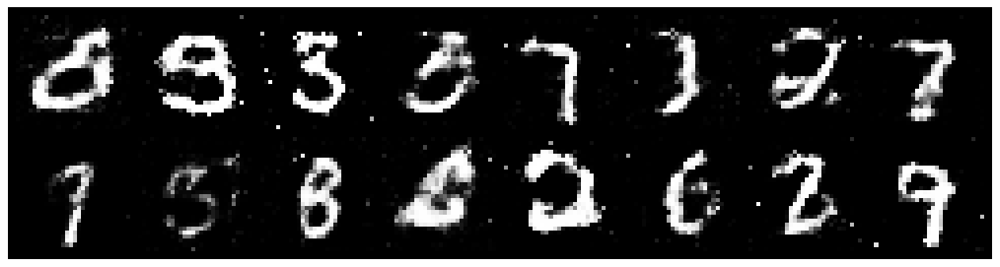

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2526, Generator Loss: 0.8833
D(x): 0.5721, D(G(z)): 0.4411


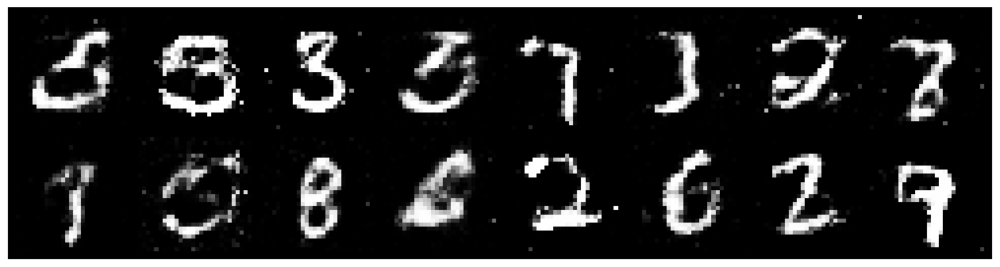

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2156, Generator Loss: 0.8405
D(x): 0.5750, D(G(z)): 0.4098


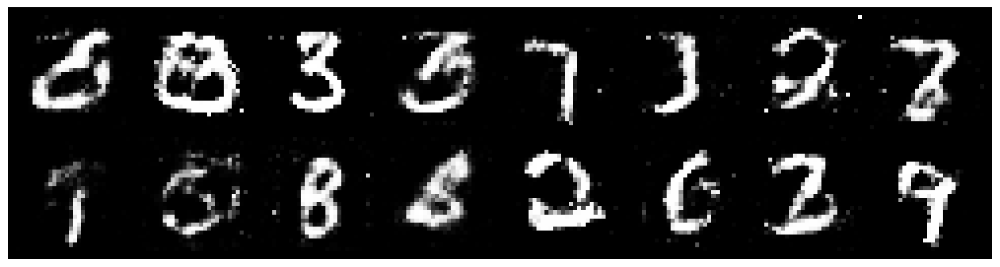

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2226, Generator Loss: 0.8585
D(x): 0.6283, D(G(z)): 0.4652


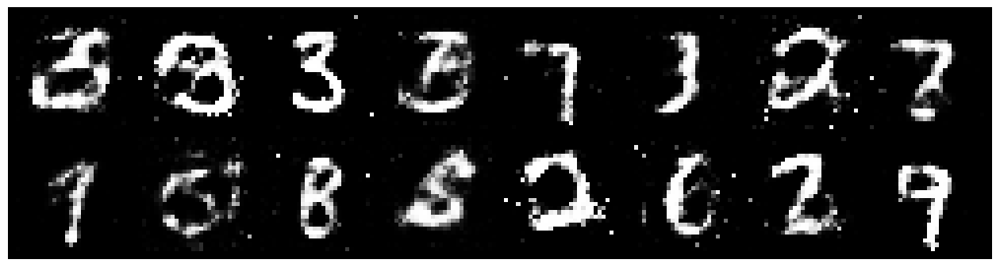

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1809, Generator Loss: 1.1139
D(x): 0.5903, D(G(z)): 0.4000


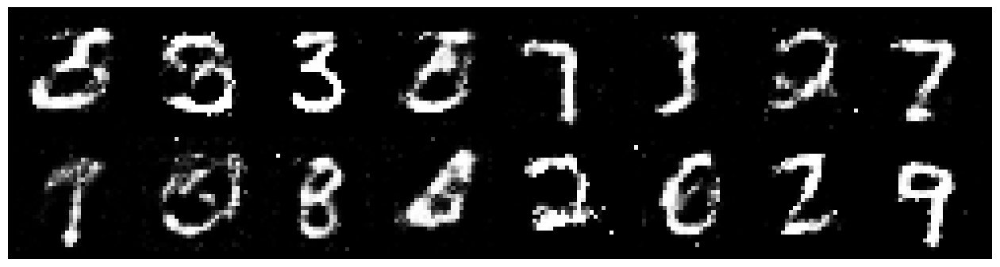

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2188, Generator Loss: 0.8621
D(x): 0.6052, D(G(z)): 0.4631


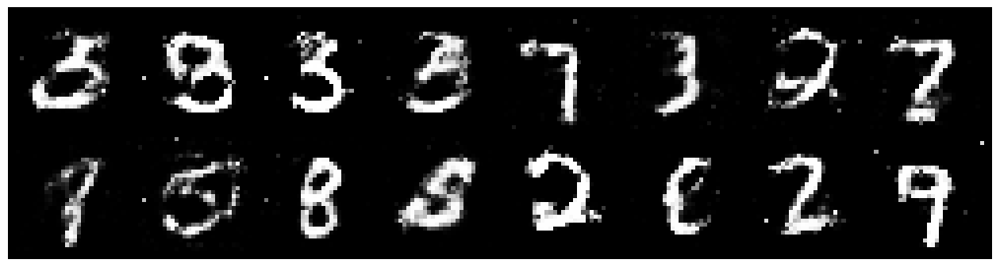

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1360, Generator Loss: 1.1489
D(x): 0.5481, D(G(z)): 0.3602


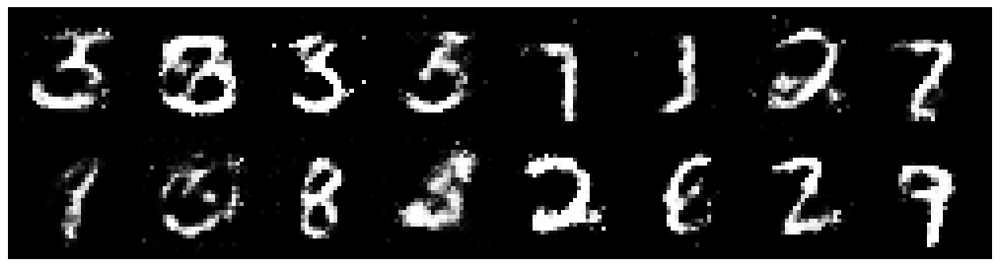

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1006, Generator Loss: 0.8952
D(x): 0.6347, D(G(z)): 0.4254


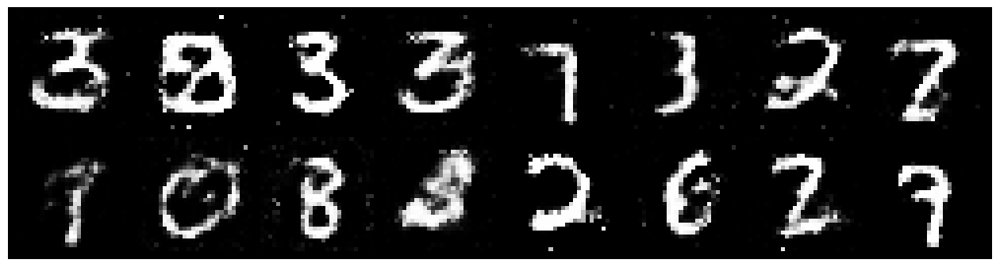

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1333, Generator Loss: 0.9088
D(x): 0.5749, D(G(z)): 0.4013


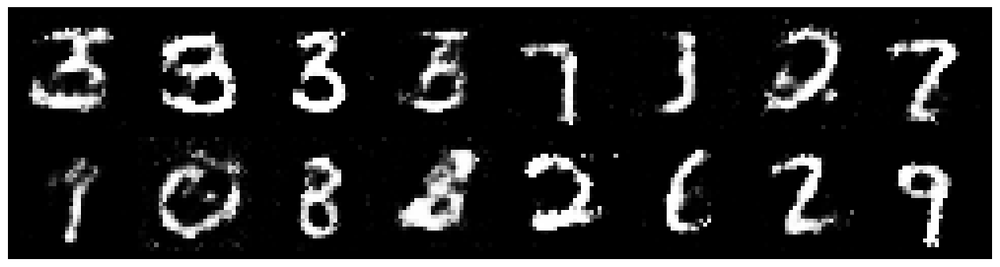

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.1642, Generator Loss: 1.0859
D(x): 0.5689, D(G(z)): 0.3729


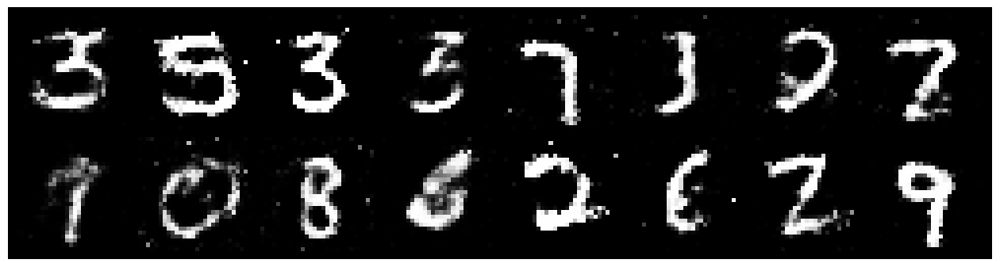

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.0780, Generator Loss: 1.0027
D(x): 0.6064, D(G(z)): 0.3899


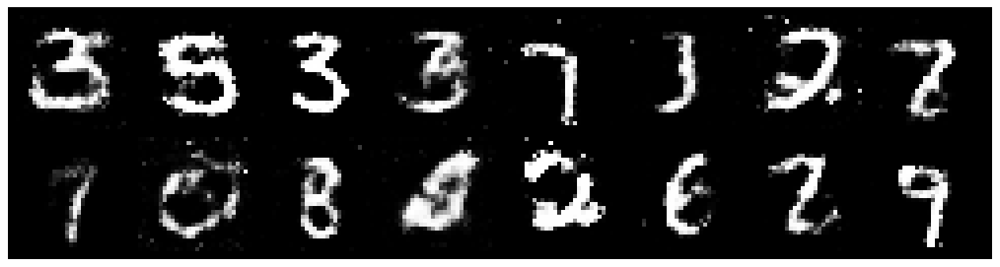

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2459, Generator Loss: 1.1148
D(x): 0.5704, D(G(z)): 0.3849


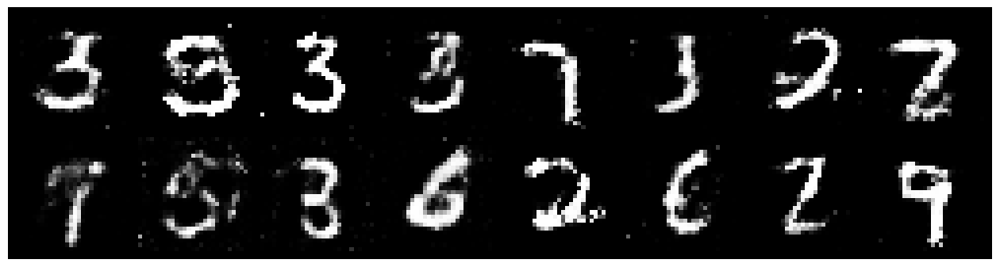

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1343, Generator Loss: 0.9135
D(x): 0.6233, D(G(z)): 0.4315


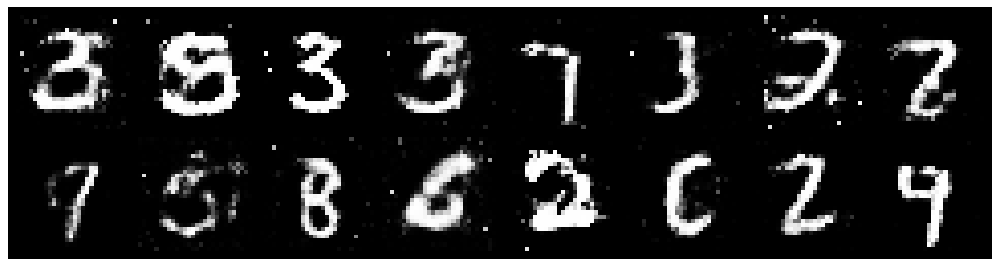

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.1310, Generator Loss: 1.0344
D(x): 0.5569, D(G(z)): 0.3629


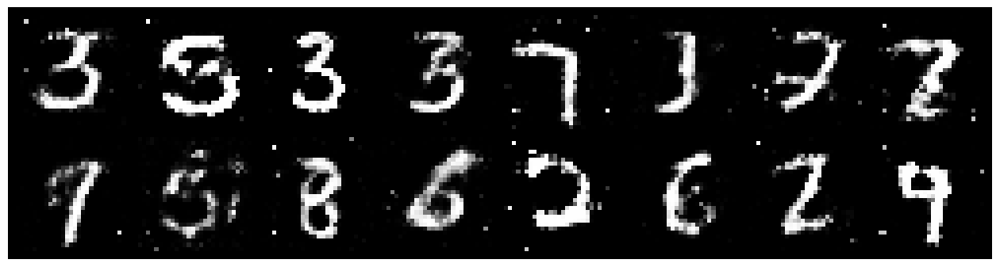

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2129, Generator Loss: 1.0570
D(x): 0.5616, D(G(z)): 0.4224


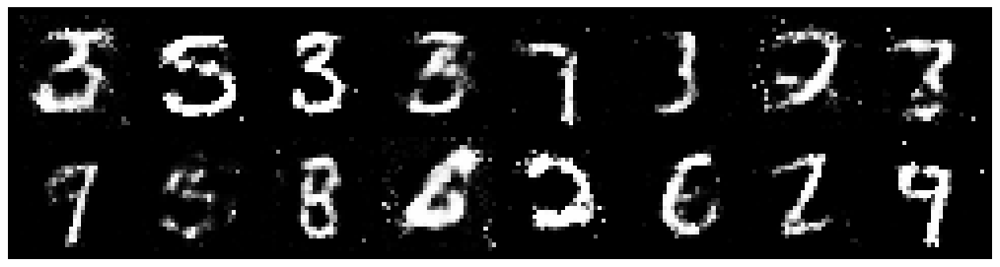

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.2319, Generator Loss: 1.0816
D(x): 0.5460, D(G(z)): 0.3882


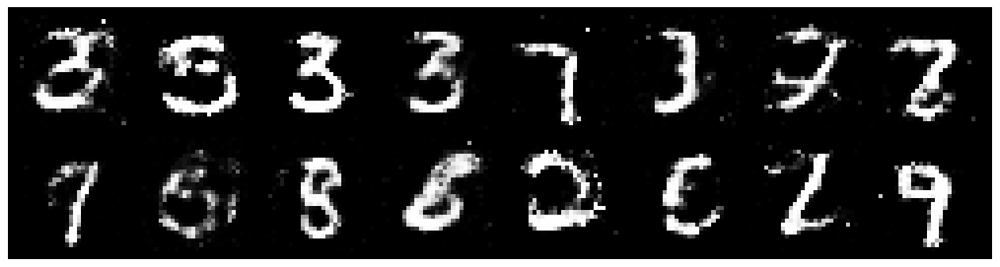

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1536, Generator Loss: 1.0885
D(x): 0.6722, D(G(z)): 0.4441


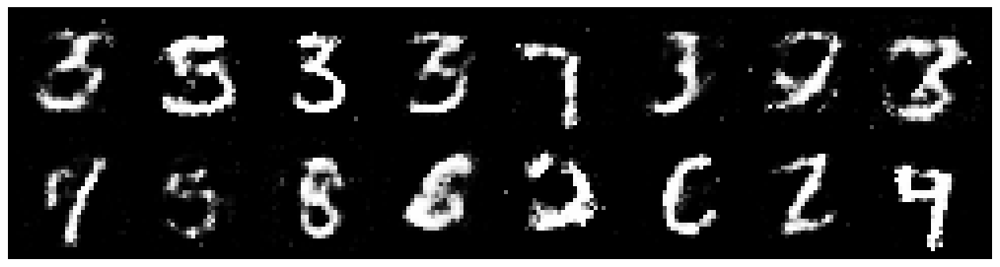

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9332
D(x): 0.5683, D(G(z)): 0.4269


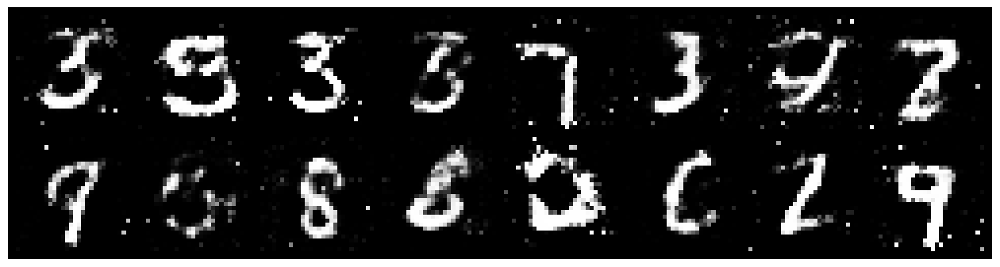

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1386, Generator Loss: 0.9243
D(x): 0.5962, D(G(z)): 0.4141


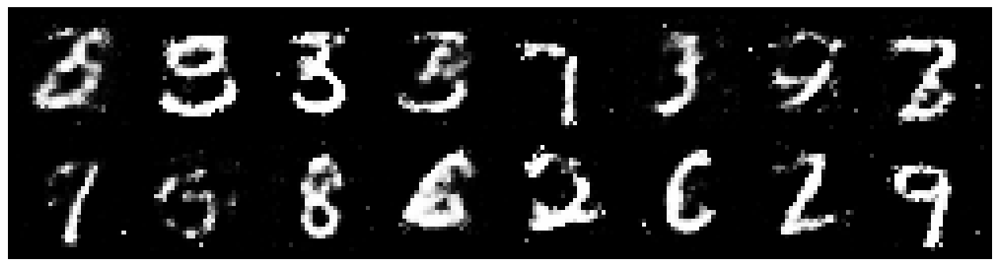

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.0664, Generator Loss: 1.0868
D(x): 0.5899, D(G(z)): 0.3405


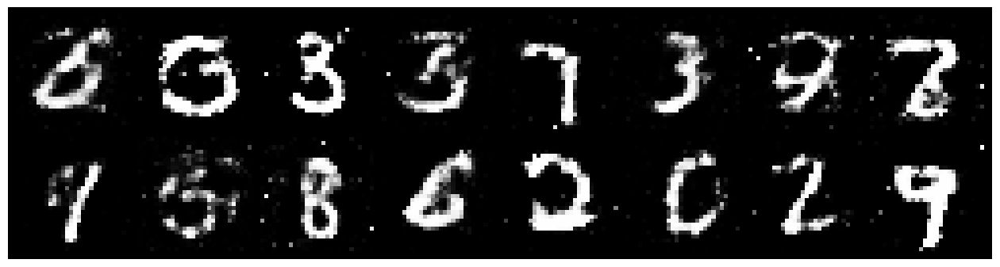

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2845, Generator Loss: 1.0623
D(x): 0.5406, D(G(z)): 0.4177


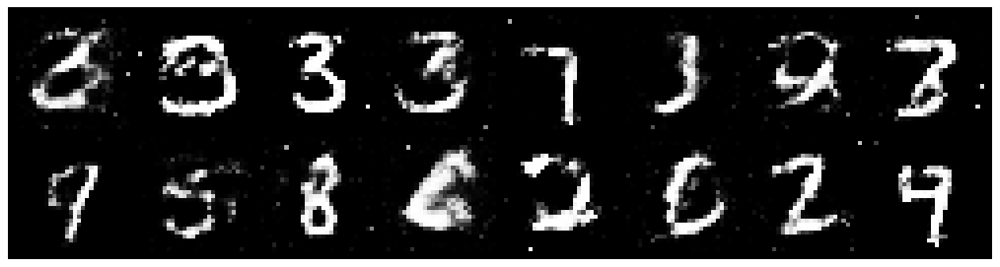

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.4129, Generator Loss: 0.8354
D(x): 0.4942, D(G(z)): 0.4405


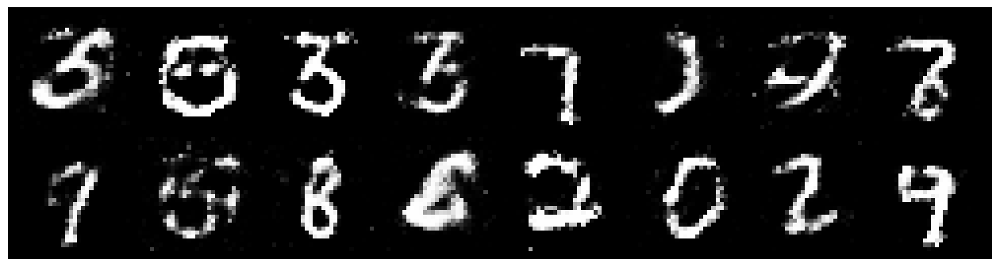

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8479
D(x): 0.6300, D(G(z)): 0.4832


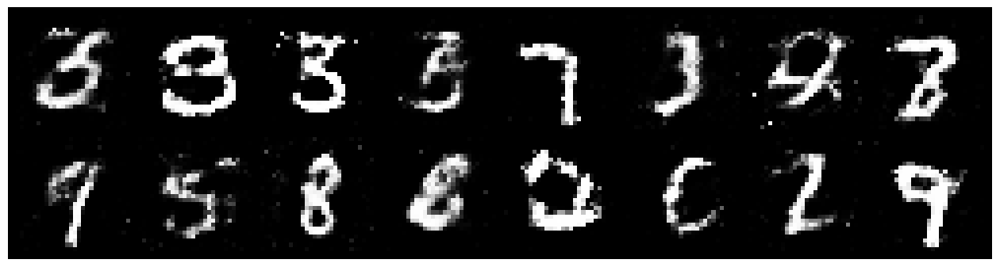

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1279, Generator Loss: 0.8621
D(x): 0.5938, D(G(z)): 0.4135


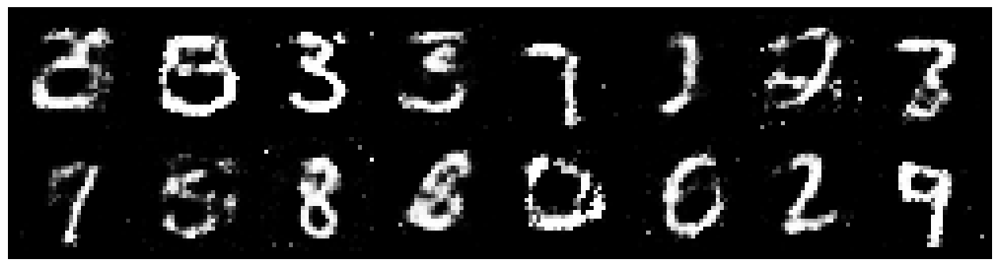

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1960, Generator Loss: 0.8622
D(x): 0.5990, D(G(z)): 0.4414


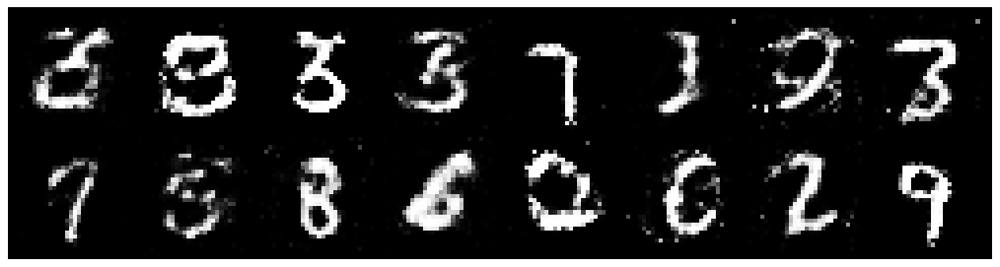

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1448, Generator Loss: 0.9372
D(x): 0.5801, D(G(z)): 0.3974


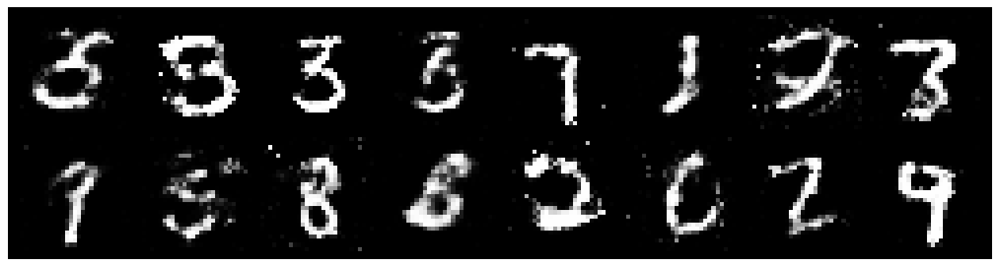

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1738, Generator Loss: 1.0002
D(x): 0.5958, D(G(z)): 0.4274


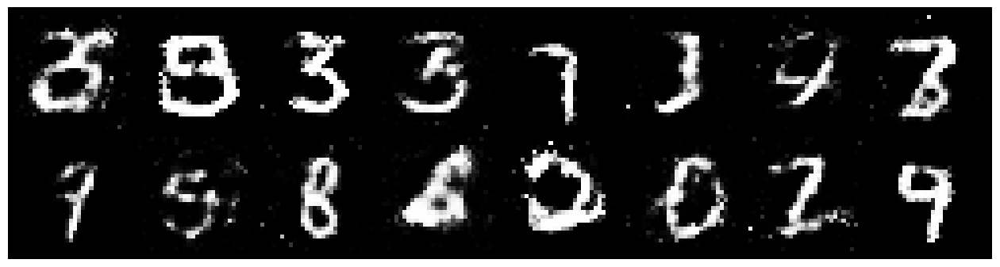

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2646, Generator Loss: 1.1599
D(x): 0.6033, D(G(z)): 0.4383


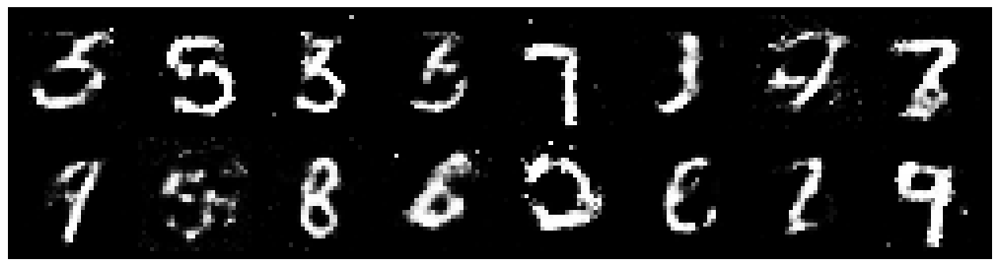

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1699, Generator Loss: 1.1918
D(x): 0.6074, D(G(z)): 0.3877


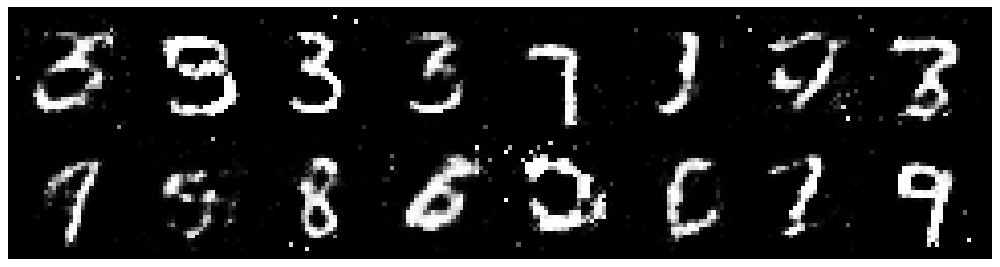

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2478, Generator Loss: 0.9819
D(x): 0.5922, D(G(z)): 0.4162


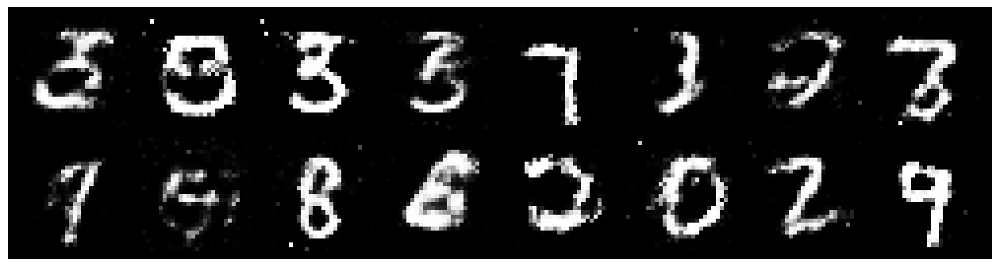

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2904, Generator Loss: 0.9236
D(x): 0.5916, D(G(z)): 0.4689


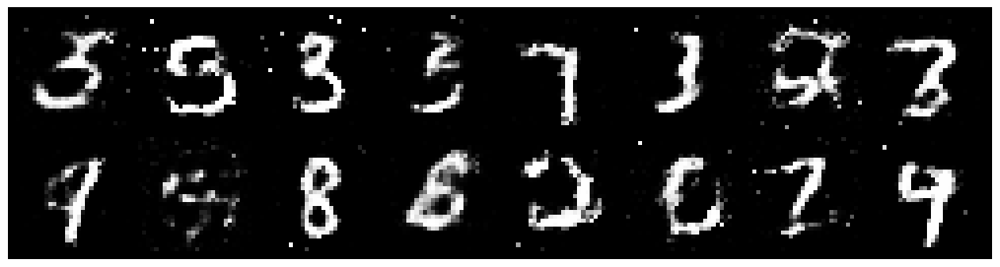

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.3709, Generator Loss: 0.8981
D(x): 0.5720, D(G(z)): 0.4755


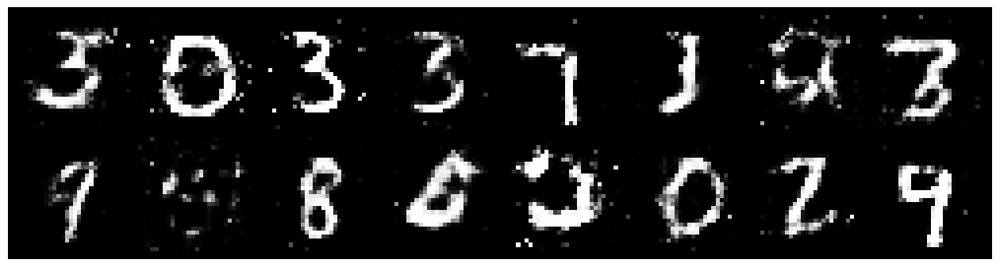

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.3086, Generator Loss: 1.0092
D(x): 0.5545, D(G(z)): 0.4216


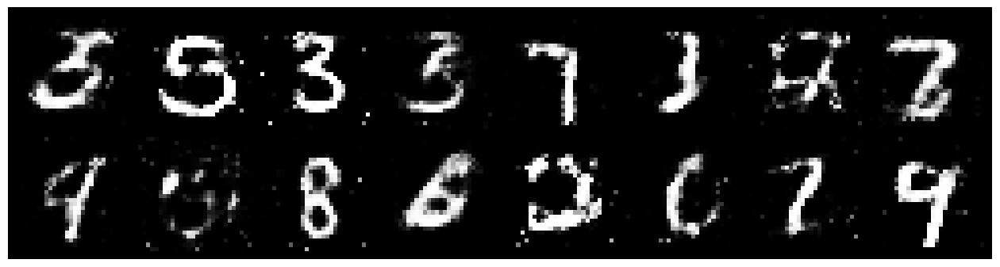

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2725, Generator Loss: 1.1975
D(x): 0.5449, D(G(z)): 0.3937


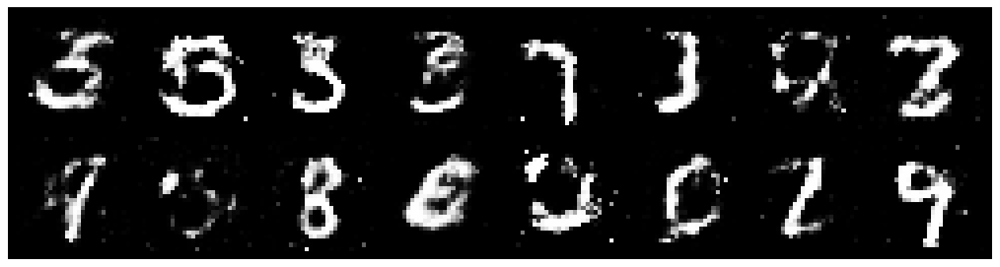

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.2907, Generator Loss: 1.0595
D(x): 0.5965, D(G(z)): 0.4602


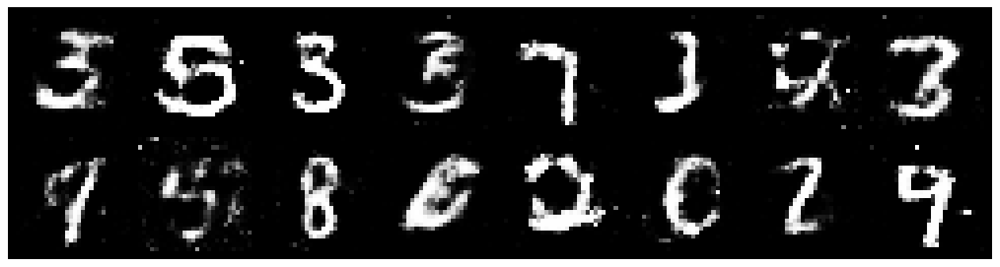

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.3875, Generator Loss: 0.9751
D(x): 0.5358, D(G(z)): 0.4404


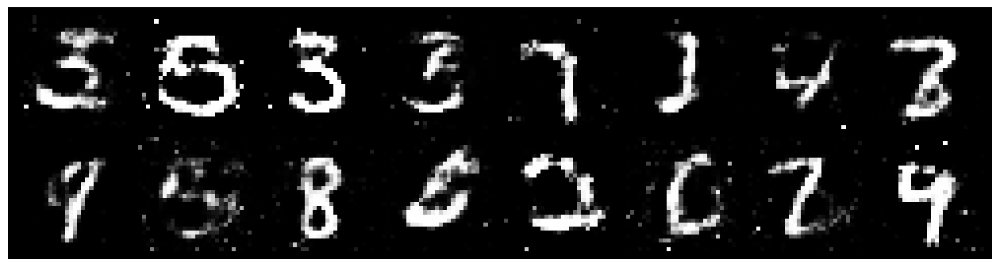

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.1942, Generator Loss: 1.1411
D(x): 0.5993, D(G(z)): 0.4292


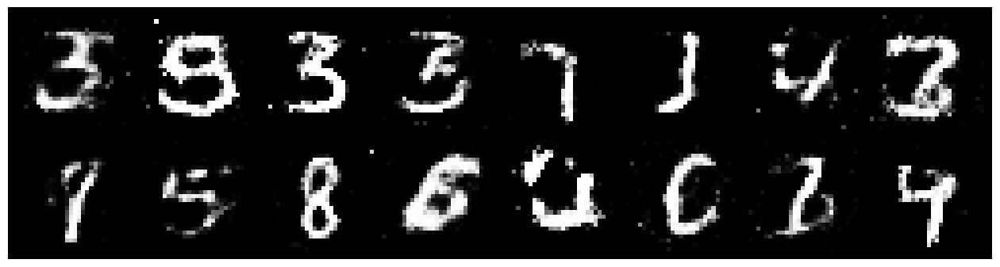

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.1626, Generator Loss: 0.9590
D(x): 0.5987, D(G(z)): 0.4142


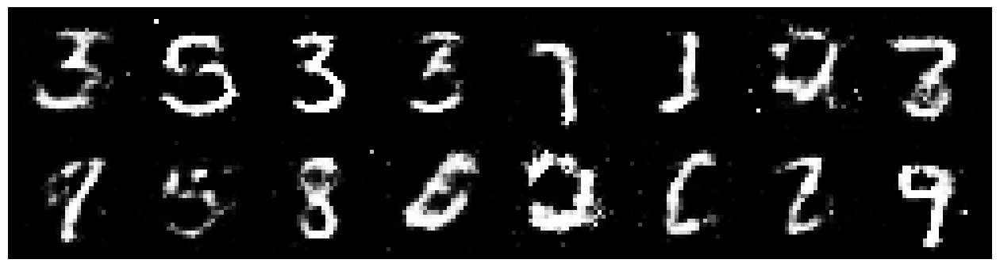

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1938, Generator Loss: 1.0999
D(x): 0.5831, D(G(z)): 0.3969


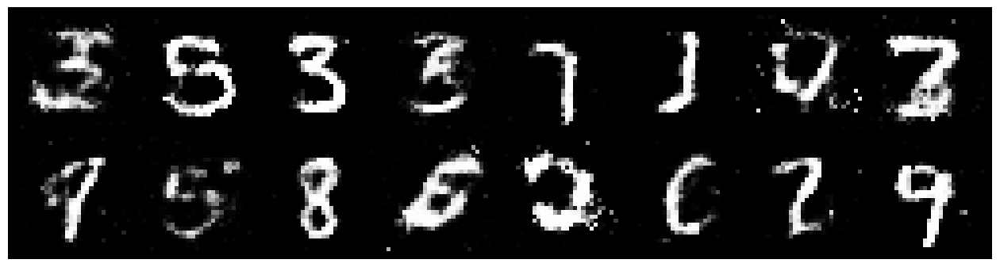

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.3535, Generator Loss: 0.9749
D(x): 0.5444, D(G(z)): 0.4368


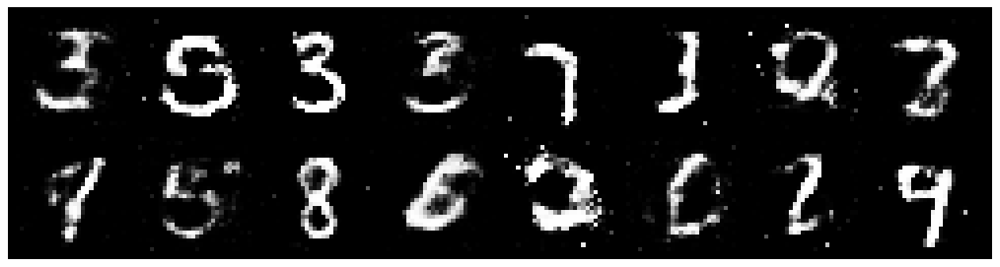

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2278, Generator Loss: 0.9859
D(x): 0.6167, D(G(z)): 0.4366


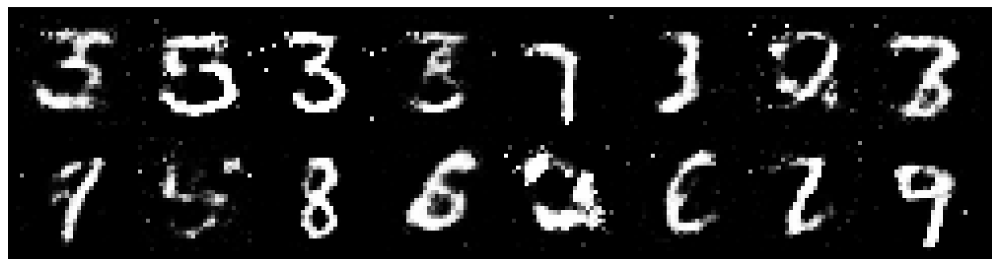

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2385, Generator Loss: 1.0664
D(x): 0.5765, D(G(z)): 0.4352


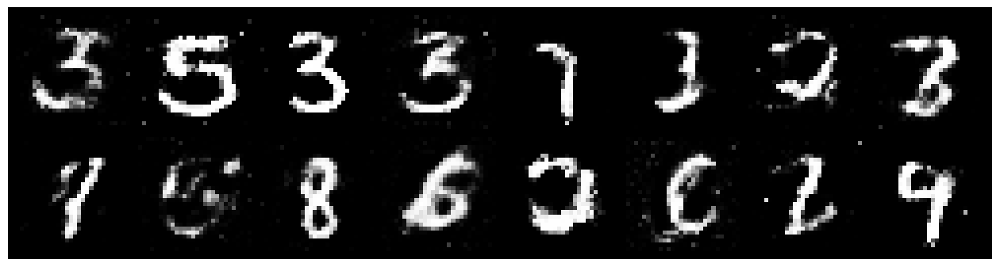

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2715, Generator Loss: 0.9043
D(x): 0.5728, D(G(z)): 0.4454


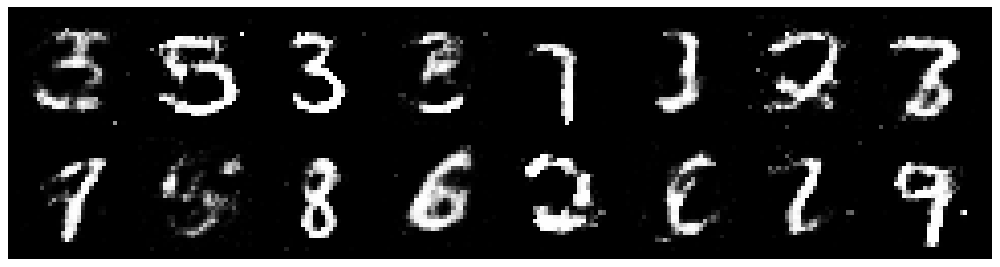

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.3332, Generator Loss: 0.9135
D(x): 0.5807, D(G(z)): 0.4811


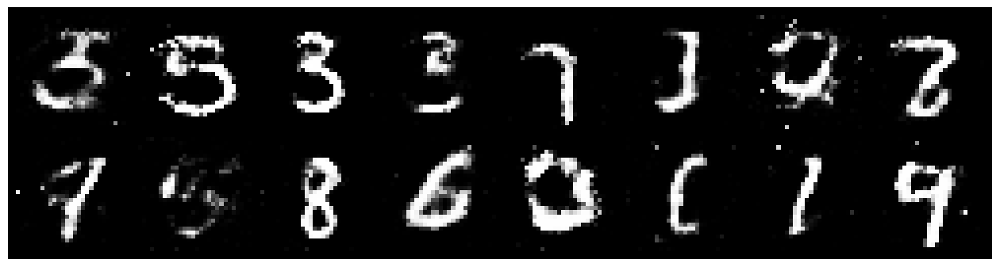

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2411, Generator Loss: 1.2517
D(x): 0.5871, D(G(z)): 0.4046


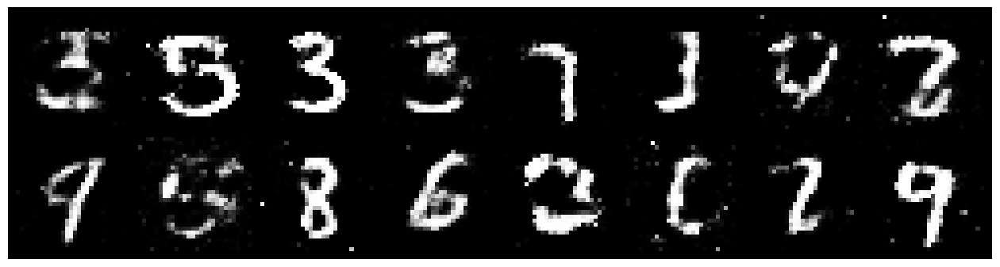

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2193, Generator Loss: 1.1391
D(x): 0.5420, D(G(z)): 0.3981


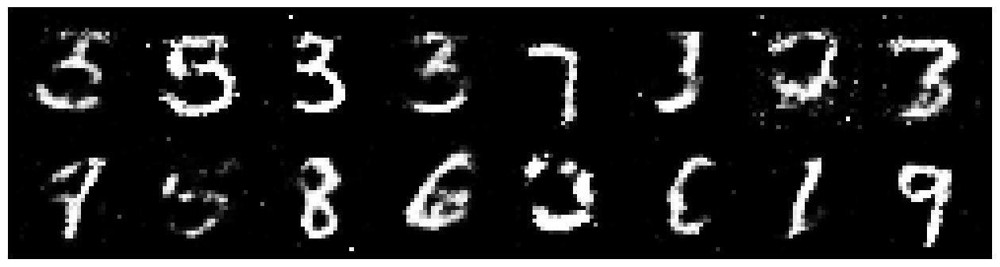

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1988, Generator Loss: 0.9076
D(x): 0.6035, D(G(z)): 0.4543


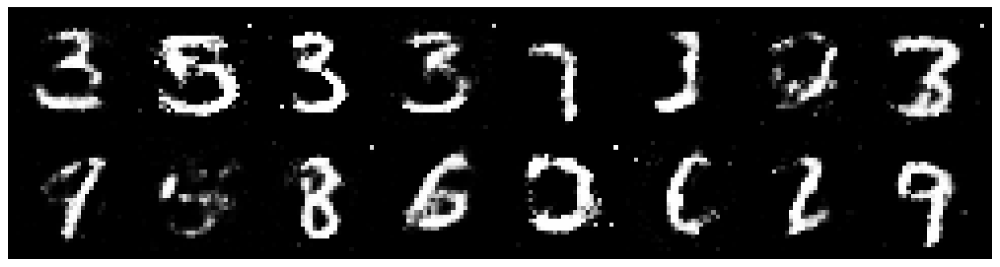

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2142, Generator Loss: 0.9994
D(x): 0.5725, D(G(z)): 0.4194


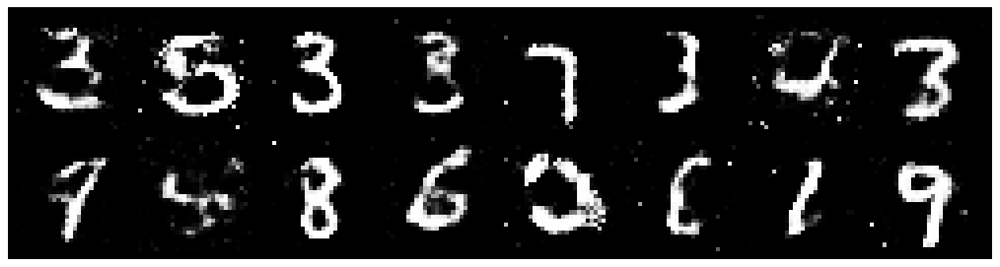

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2754, Generator Loss: 1.1035
D(x): 0.5727, D(G(z)): 0.4332


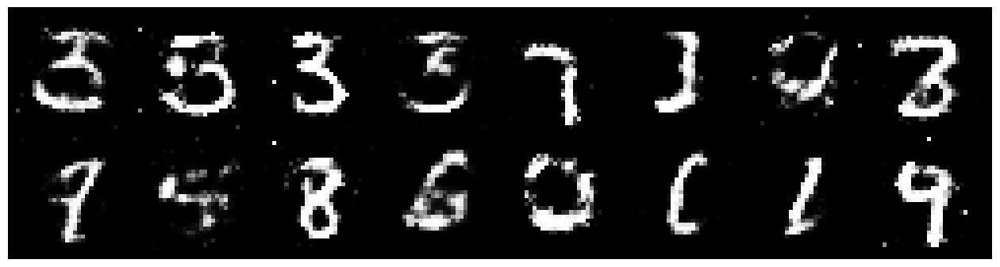

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2004, Generator Loss: 1.0234
D(x): 0.5614, D(G(z)): 0.3911


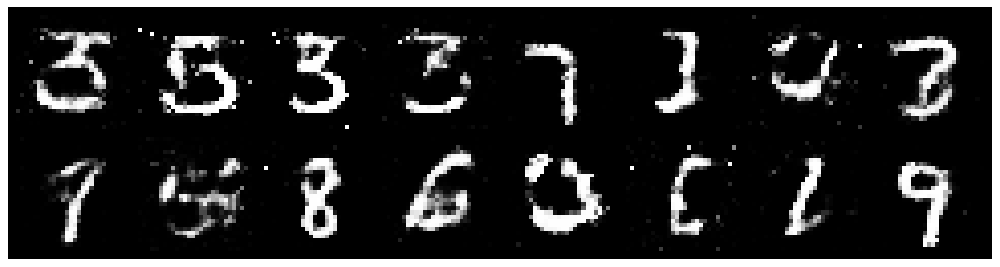

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2089, Generator Loss: 0.8892
D(x): 0.5848, D(G(z)): 0.4417


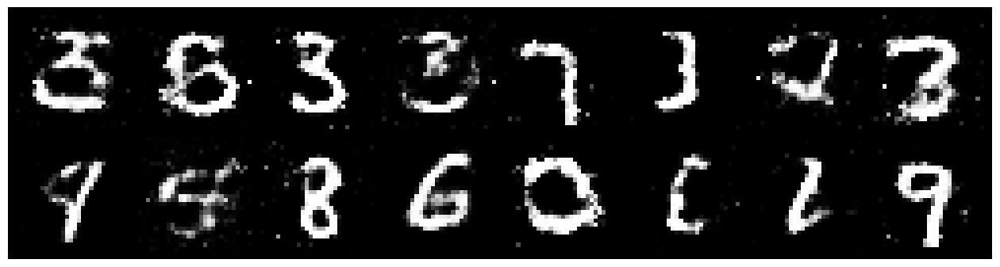

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2286, Generator Loss: 0.9855
D(x): 0.5527, D(G(z)): 0.3834


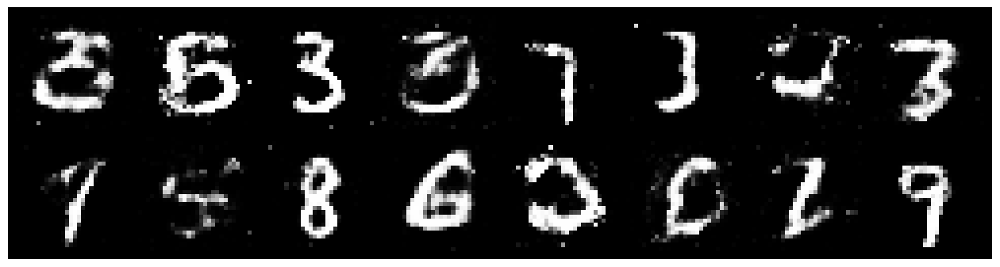

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2858, Generator Loss: 1.0940
D(x): 0.5220, D(G(z)): 0.3860


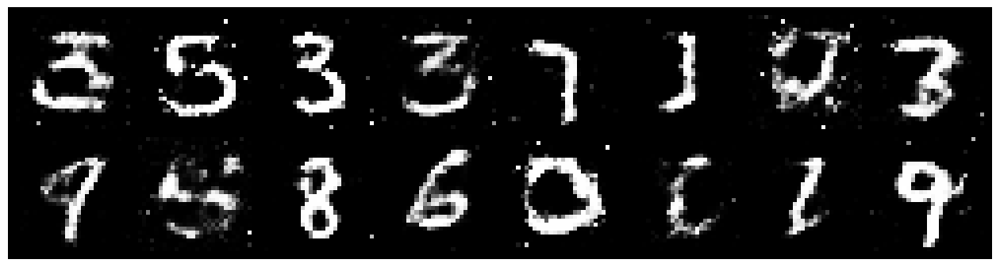

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.1727, Generator Loss: 1.0321
D(x): 0.5767, D(G(z)): 0.3882


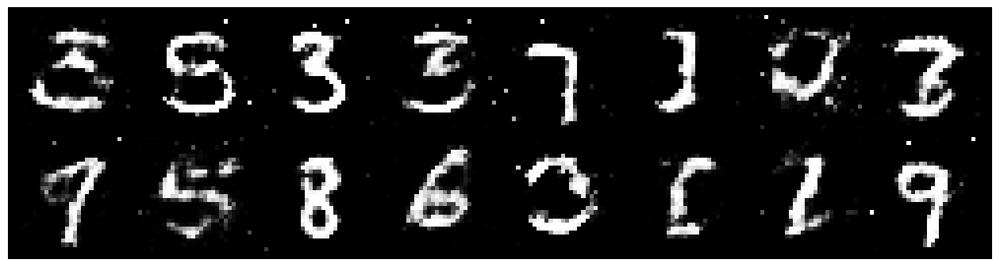

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.1636, Generator Loss: 1.0200
D(x): 0.5787, D(G(z)): 0.4117


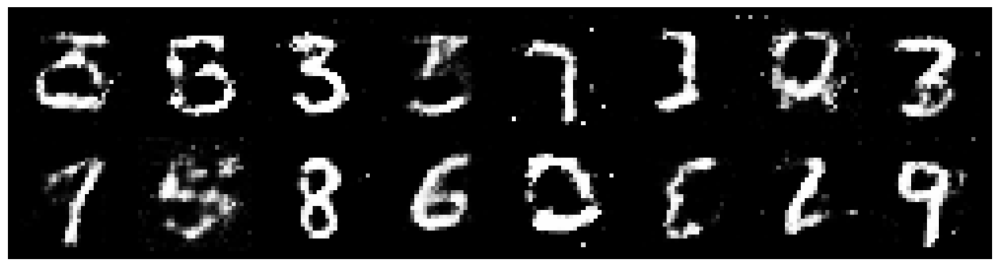

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1244, Generator Loss: 1.3240
D(x): 0.5724, D(G(z)): 0.3348


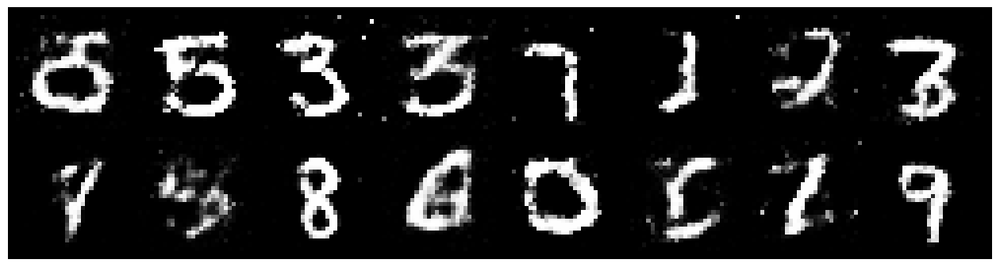

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2120, Generator Loss: 1.1214
D(x): 0.5803, D(G(z)): 0.3970


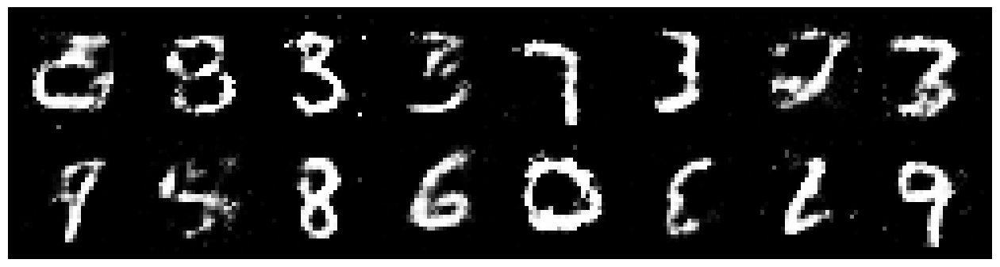

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2208, Generator Loss: 1.0097
D(x): 0.5970, D(G(z)): 0.4340


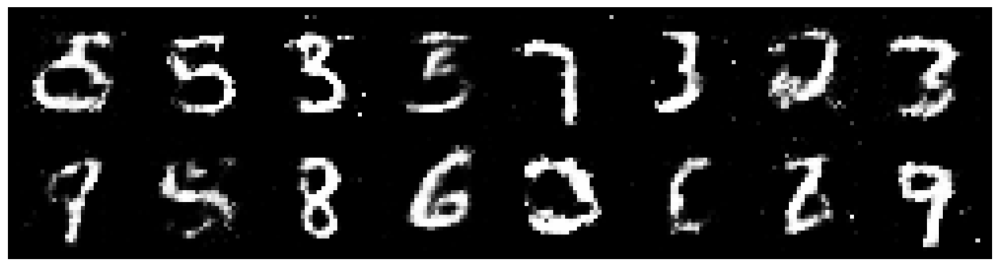

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2979, Generator Loss: 0.9310
D(x): 0.5807, D(G(z)): 0.4587


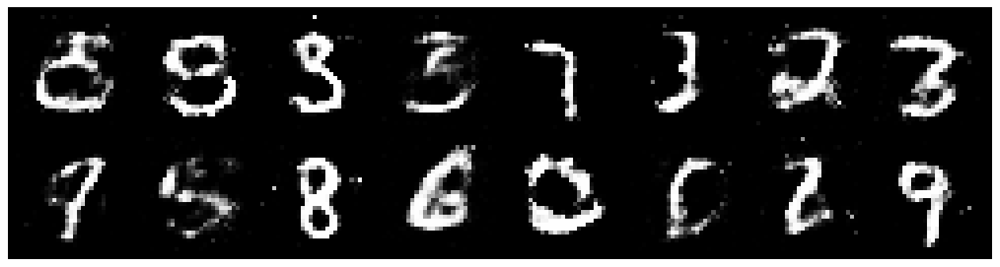

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2190, Generator Loss: 0.9446
D(x): 0.5772, D(G(z)): 0.4453


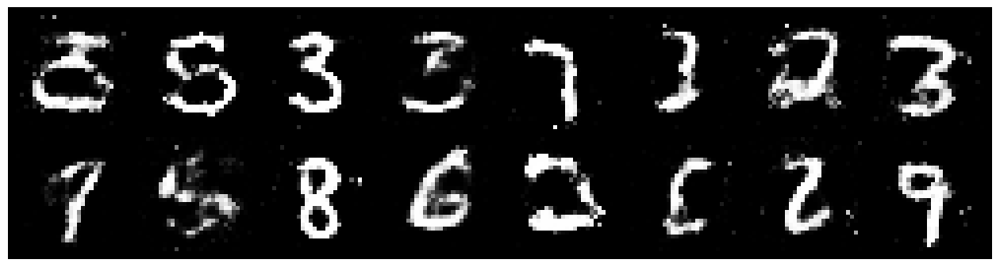

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3253, Generator Loss: 0.7583
D(x): 0.5596, D(G(z)): 0.4491


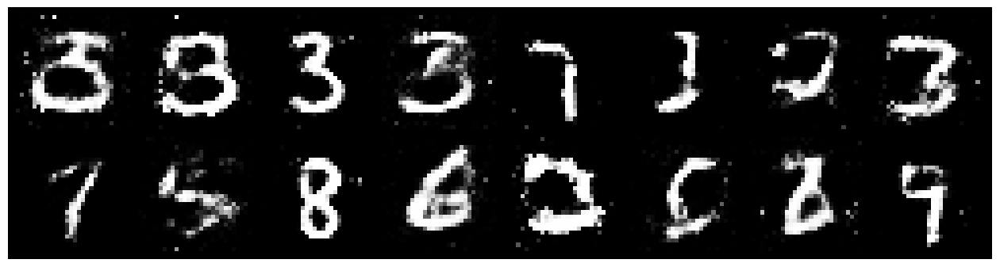

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.3242, Generator Loss: 0.9842
D(x): 0.5464, D(G(z)): 0.4486


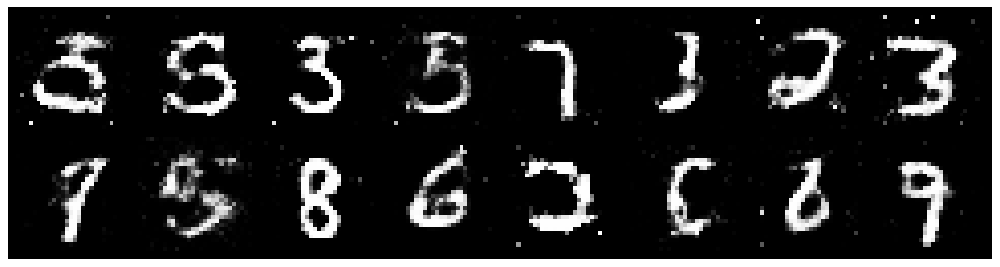

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2609, Generator Loss: 1.1083
D(x): 0.5202, D(G(z)): 0.3663


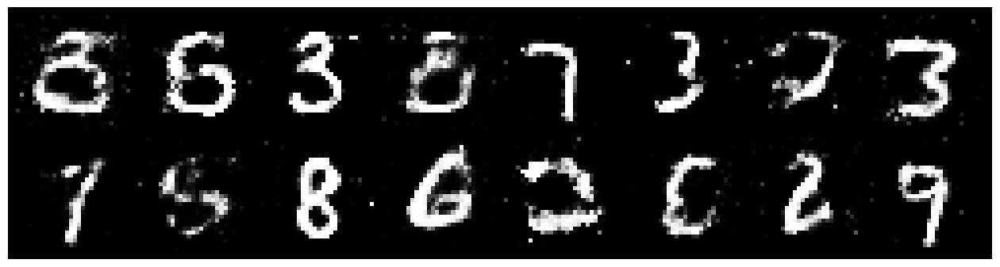

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.3662, Generator Loss: 0.9972
D(x): 0.5940, D(G(z)): 0.4734


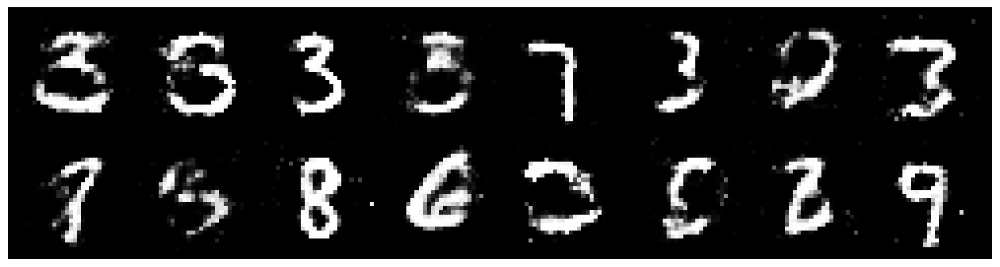

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.3328, Generator Loss: 0.8748
D(x): 0.5446, D(G(z)): 0.4526


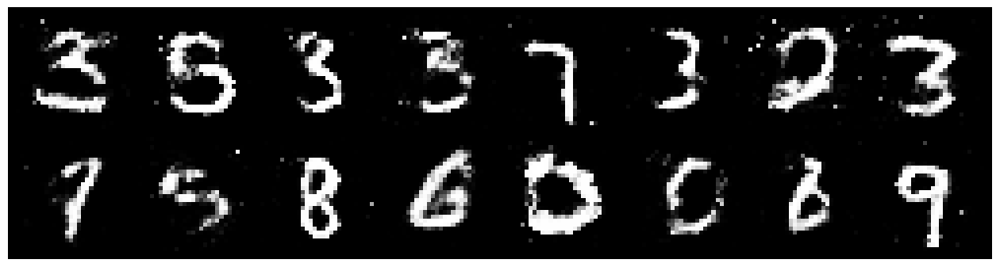

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2656, Generator Loss: 0.9322
D(x): 0.5942, D(G(z)): 0.4625


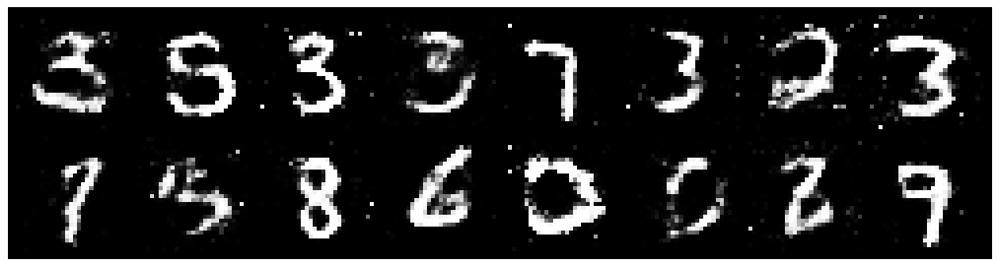

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2210, Generator Loss: 0.9653
D(x): 0.5562, D(G(z)): 0.4167


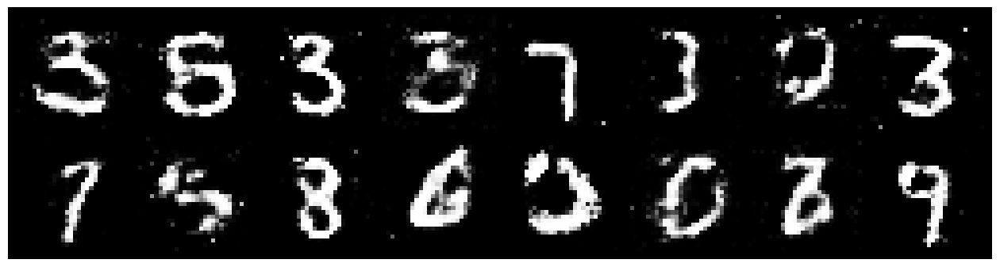

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2085, Generator Loss: 0.9212
D(x): 0.6207, D(G(z)): 0.4544


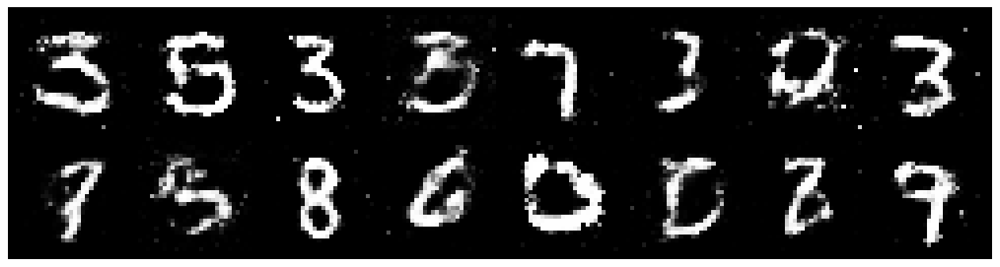

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1302, Generator Loss: 1.0053
D(x): 0.6121, D(G(z)): 0.4292


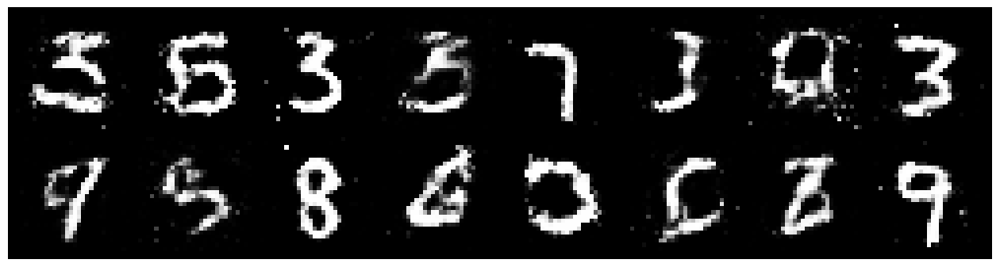

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2991, Generator Loss: 1.0459
D(x): 0.5585, D(G(z)): 0.4319


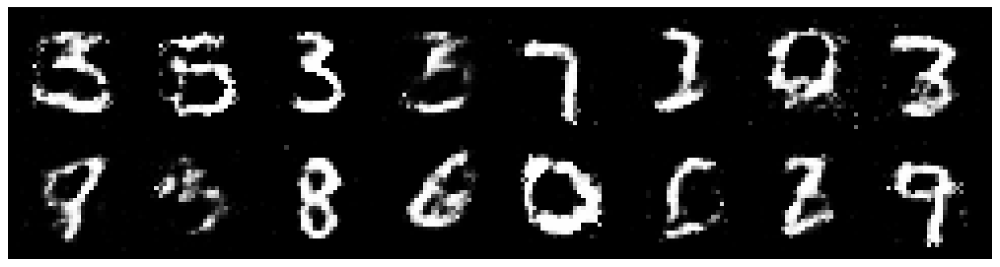

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.4133, Generator Loss: 0.7940
D(x): 0.5361, D(G(z)): 0.4844


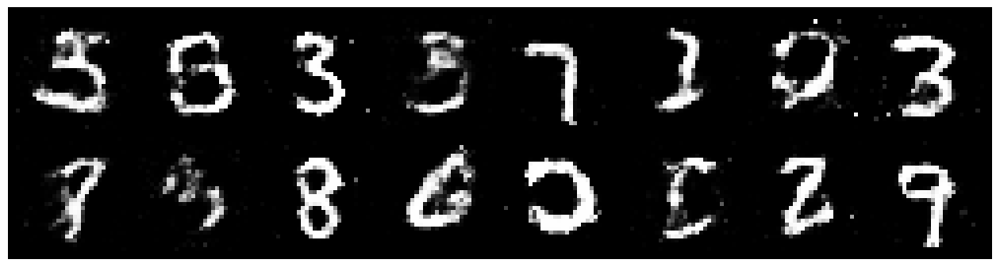

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.3212, Generator Loss: 0.8187
D(x): 0.5149, D(G(z)): 0.4365


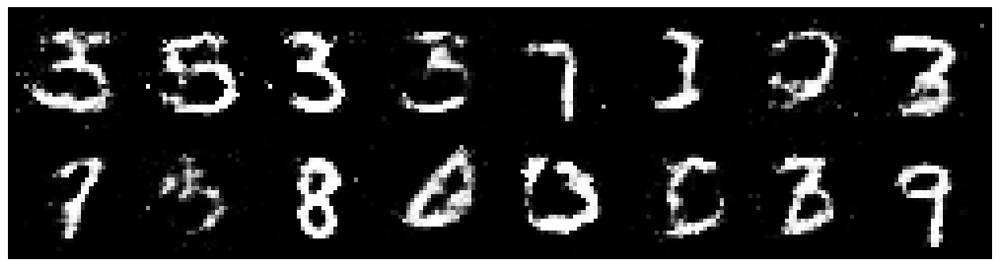

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.3589, Generator Loss: 0.8308
D(x): 0.6057, D(G(z)): 0.5181


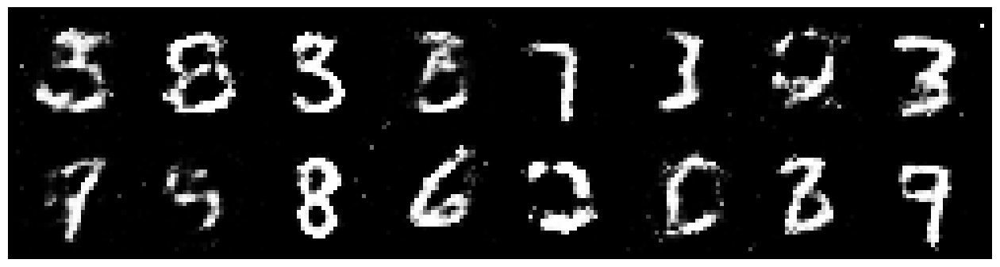

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9215
D(x): 0.5098, D(G(z)): 0.3704


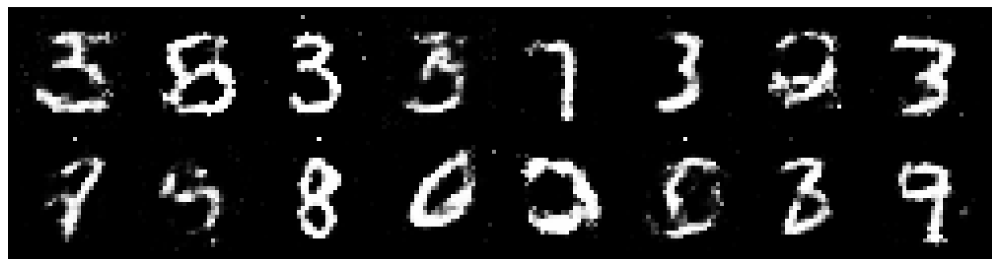

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3490, Generator Loss: 0.8805
D(x): 0.4980, D(G(z)): 0.4388


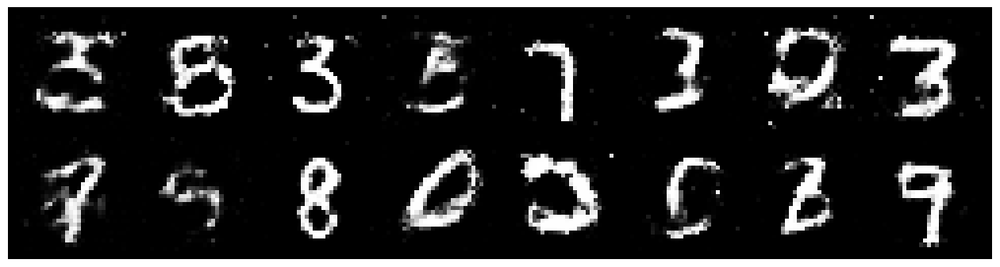

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2968, Generator Loss: 0.8965
D(x): 0.5817, D(G(z)): 0.4608


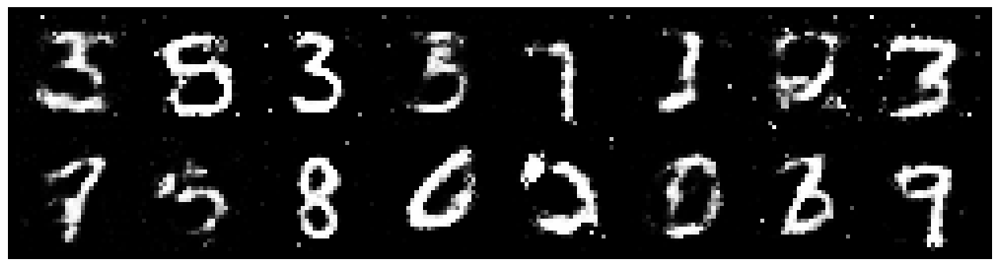

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.0639, Generator Loss: 0.9707
D(x): 0.6125, D(G(z)): 0.3824


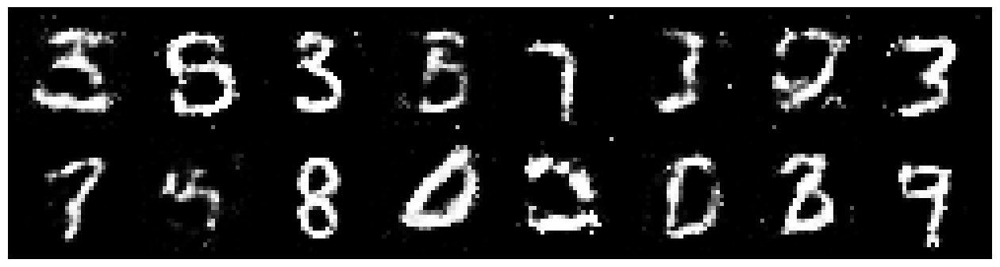

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2016, Generator Loss: 0.9416
D(x): 0.5524, D(G(z)): 0.3717


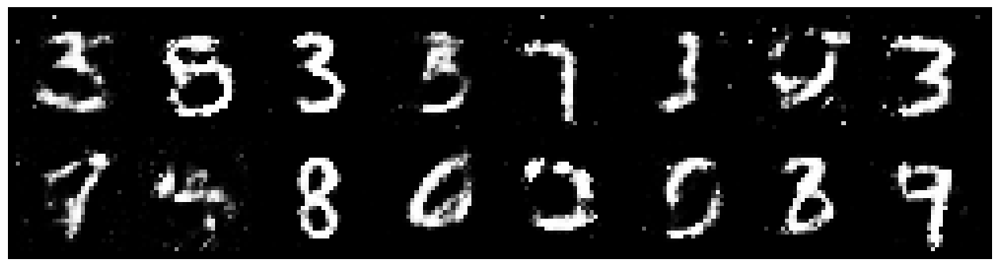

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.3216, Generator Loss: 0.9055
D(x): 0.5306, D(G(z)): 0.4363


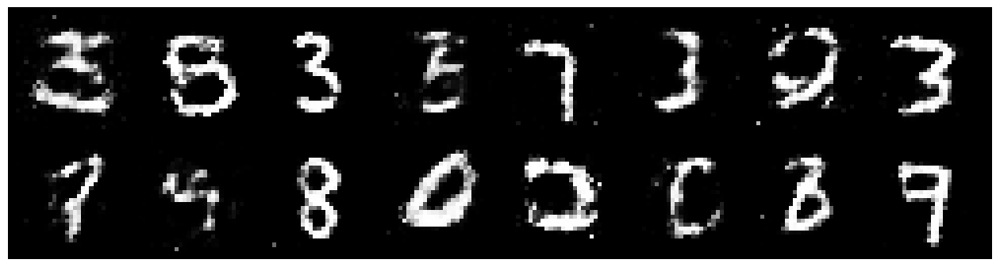

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2710, Generator Loss: 1.0644
D(x): 0.6186, D(G(z)): 0.4727


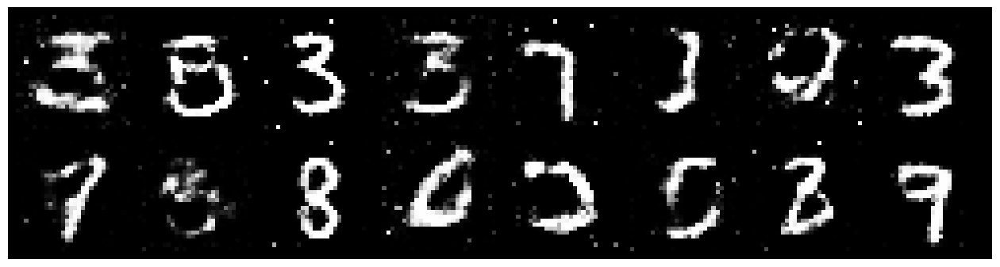

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.3121, Generator Loss: 0.9070
D(x): 0.6037, D(G(z)): 0.4806


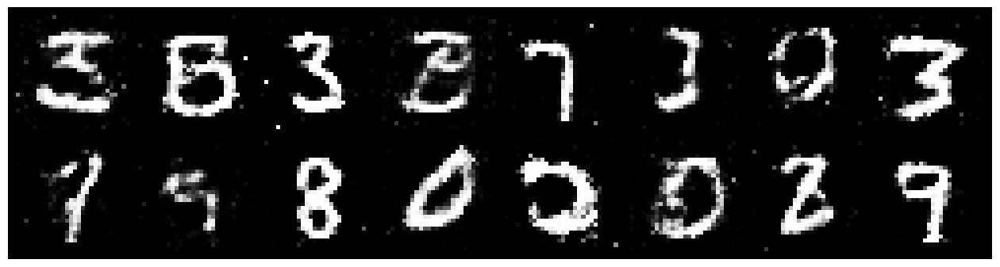

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2121, Generator Loss: 1.0345
D(x): 0.5735, D(G(z)): 0.4250


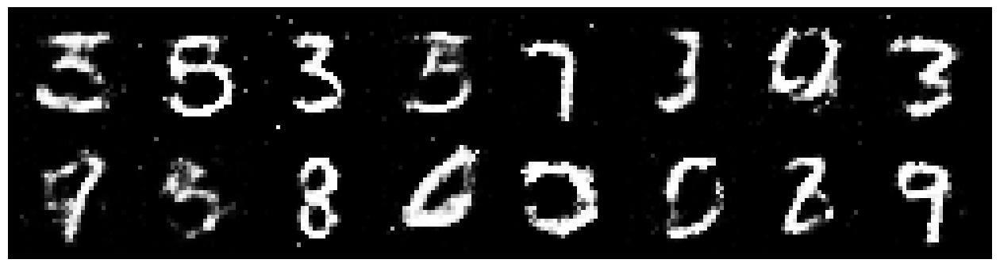

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.1725, Generator Loss: 0.8891
D(x): 0.5784, D(G(z)): 0.4201


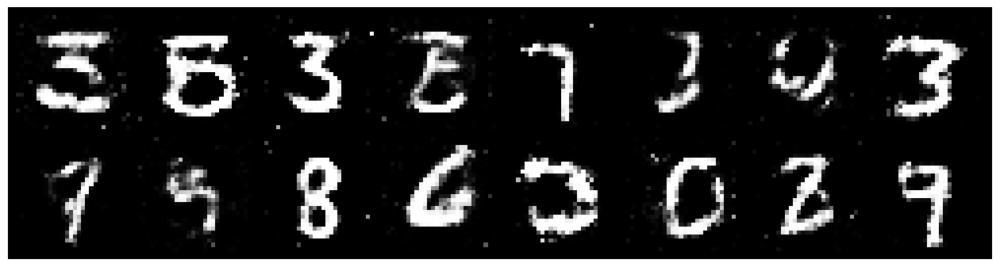

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1064, Generator Loss: 1.1290
D(x): 0.6247, D(G(z)): 0.4021


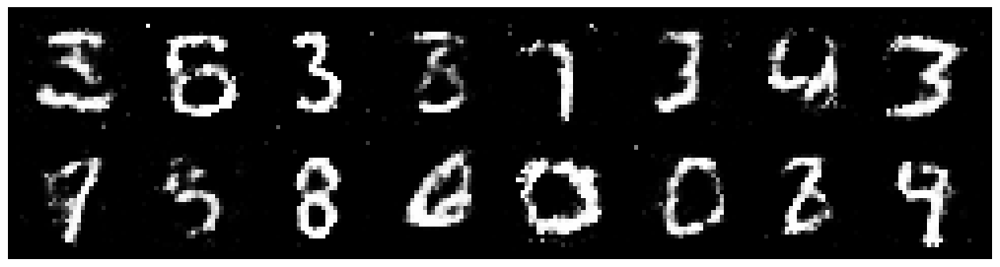

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2224, Generator Loss: 1.1193
D(x): 0.5858, D(G(z)): 0.4098


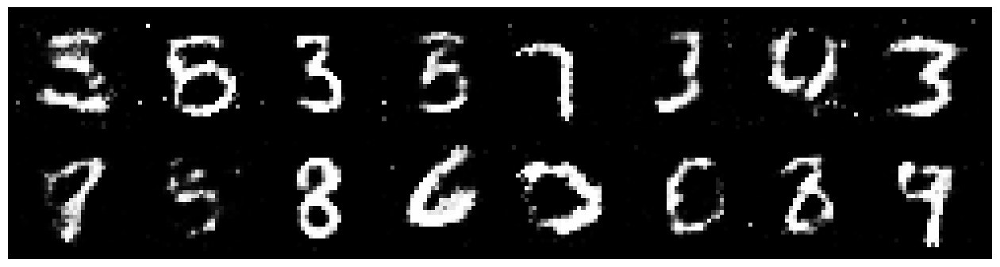

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.0879, Generator Loss: 1.0731
D(x): 0.5809, D(G(z)): 0.3602


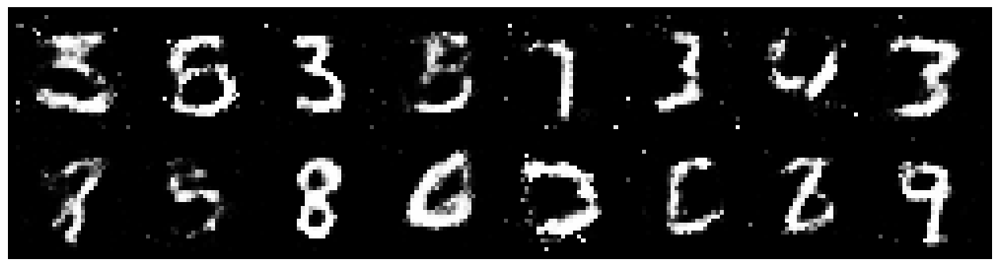

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2334, Generator Loss: 1.0453
D(x): 0.5117, D(G(z)): 0.3589


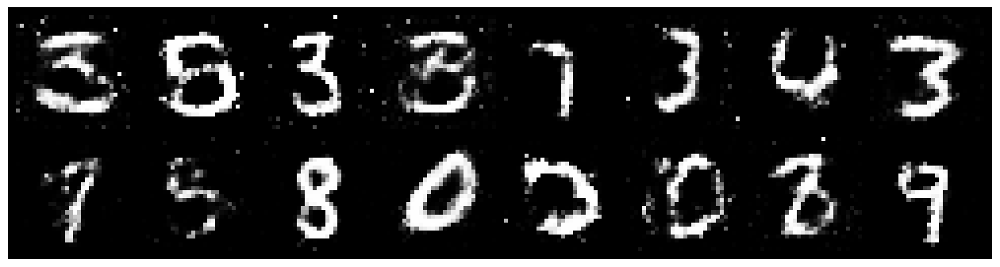

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1932, Generator Loss: 0.9726
D(x): 0.5896, D(G(z)): 0.4340


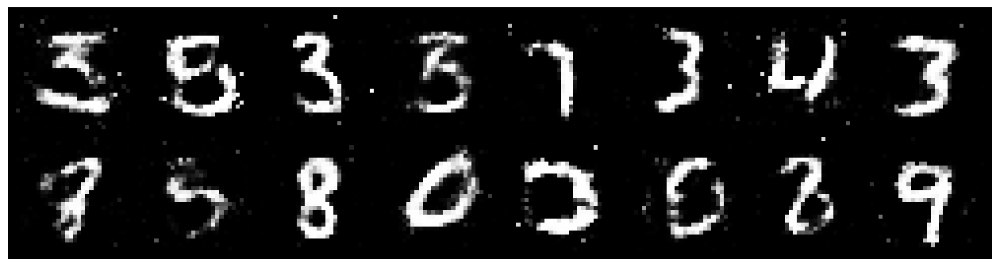

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2174, Generator Loss: 1.0154
D(x): 0.5376, D(G(z)): 0.3878


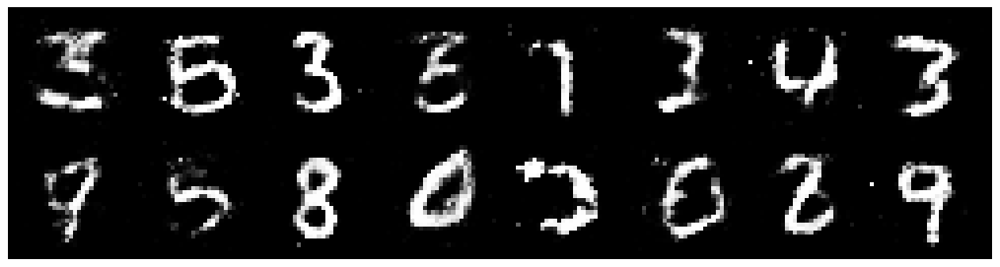

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.0825, Generator Loss: 1.0111
D(x): 0.6328, D(G(z)): 0.3920


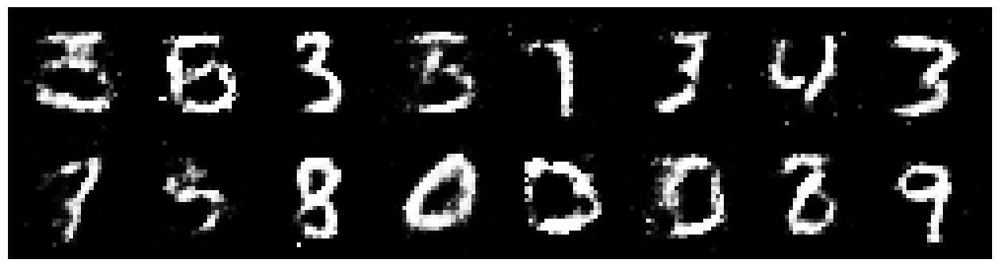

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2097, Generator Loss: 1.0558
D(x): 0.5944, D(G(z)): 0.4453


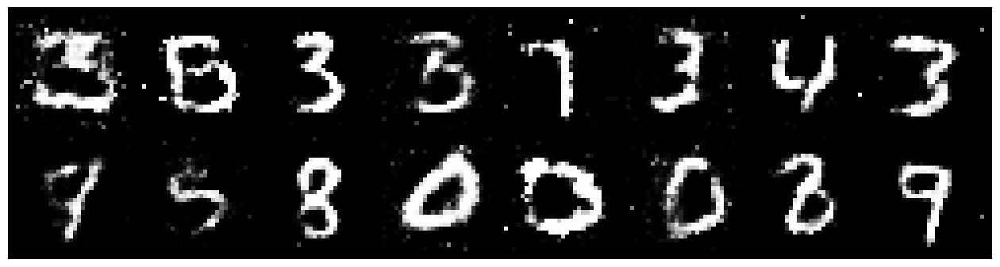

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2131, Generator Loss: 0.9163
D(x): 0.5735, D(G(z)): 0.4466


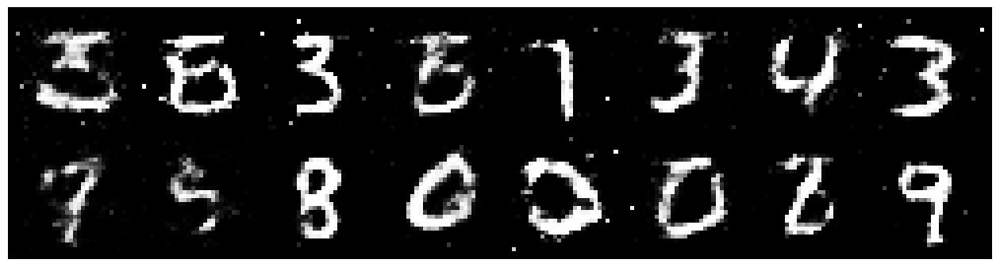

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1700, Generator Loss: 1.0356
D(x): 0.5896, D(G(z)): 0.4206


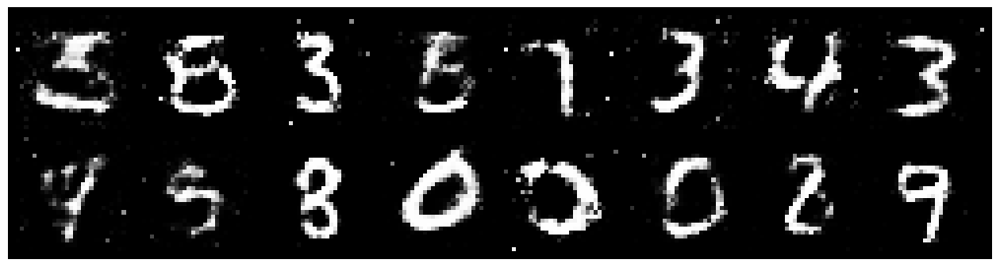

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9088
D(x): 0.5881, D(G(z)): 0.4312


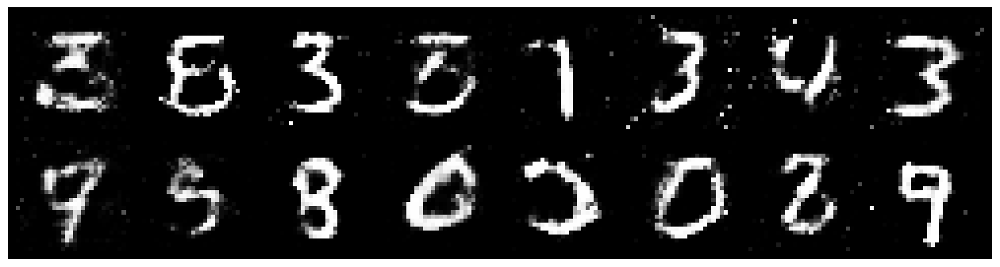

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.3022, Generator Loss: 0.9520
D(x): 0.5881, D(G(z)): 0.4802


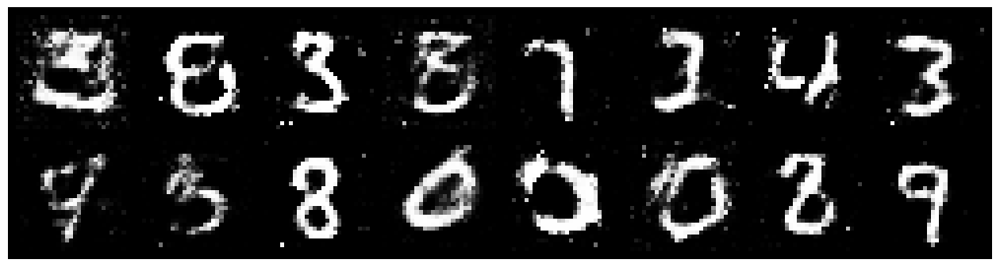

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.3843, Generator Loss: 0.9668
D(x): 0.5041, D(G(z)): 0.4149


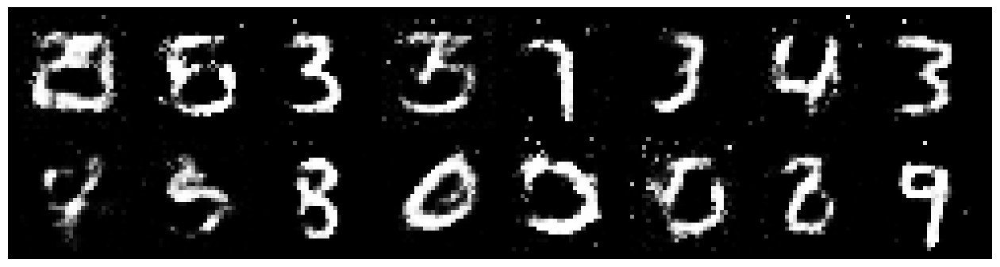

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2745, Generator Loss: 0.9298
D(x): 0.6141, D(G(z)): 0.4784


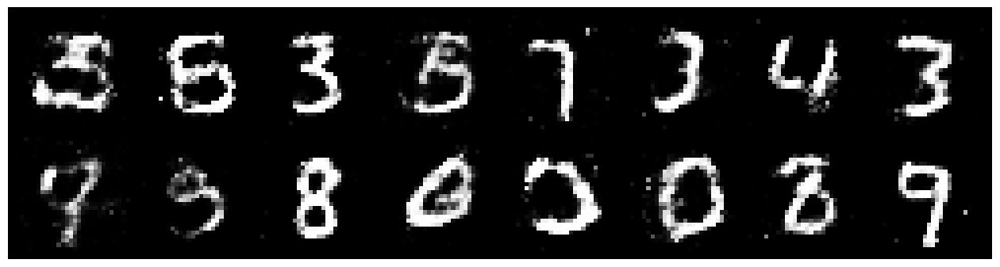

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.3377, Generator Loss: 0.9848
D(x): 0.5067, D(G(z)): 0.4175


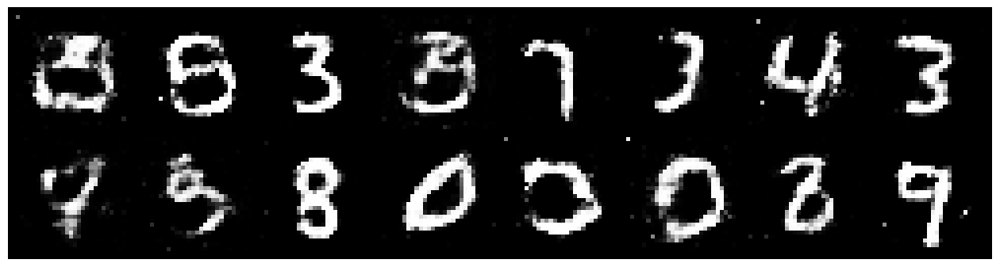

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.4445, Generator Loss: 0.9567
D(x): 0.5381, D(G(z)): 0.4783


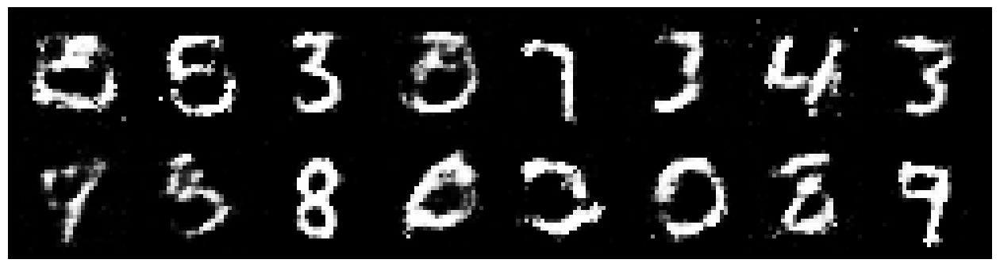

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1963, Generator Loss: 1.0905
D(x): 0.6400, D(G(z)): 0.4330


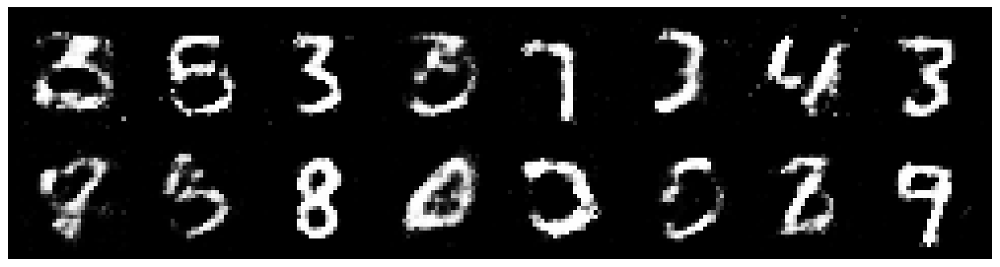

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2361, Generator Loss: 1.2107
D(x): 0.5877, D(G(z)): 0.4084


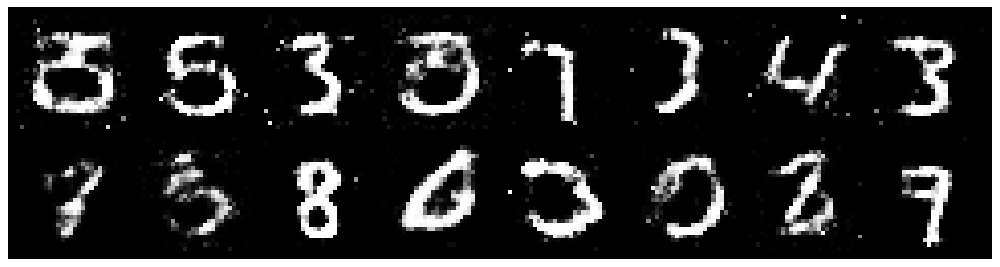

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1532, Generator Loss: 1.1066
D(x): 0.5689, D(G(z)): 0.3899


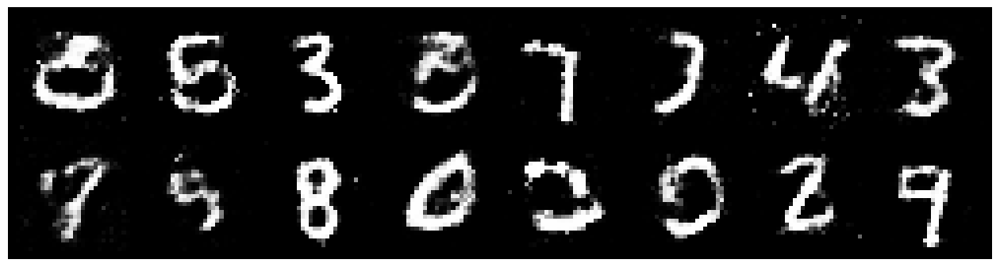

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.1197, Generator Loss: 1.0649
D(x): 0.6257, D(G(z)): 0.4095


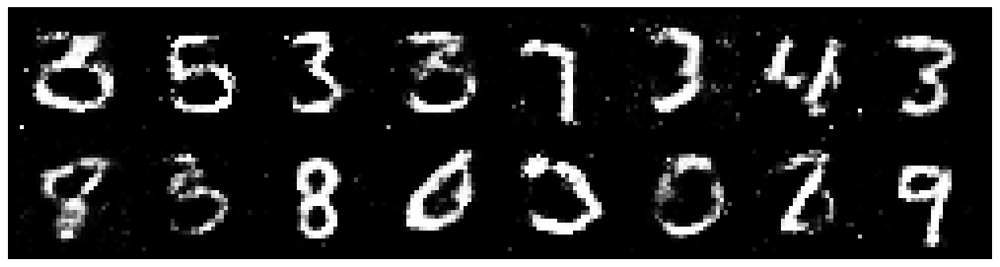

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2763, Generator Loss: 0.8846
D(x): 0.5642, D(G(z)): 0.4578


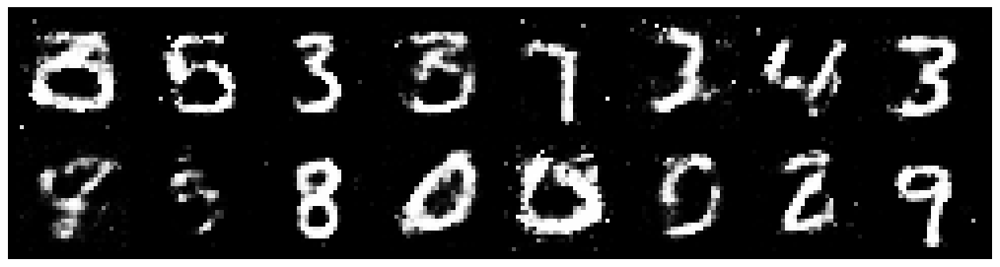

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2213, Generator Loss: 0.9391
D(x): 0.5640, D(G(z)): 0.4230


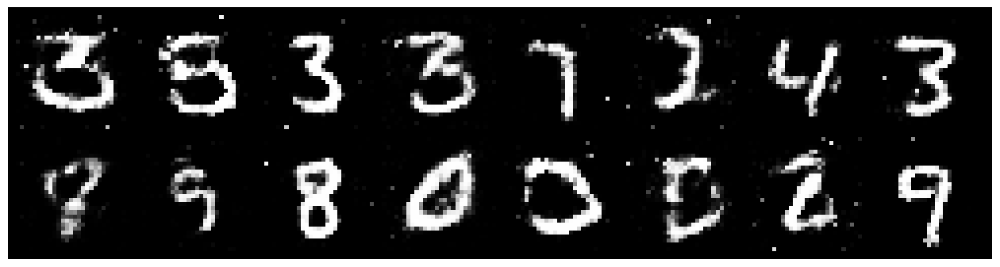

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2550, Generator Loss: 1.1244
D(x): 0.5358, D(G(z)): 0.4108


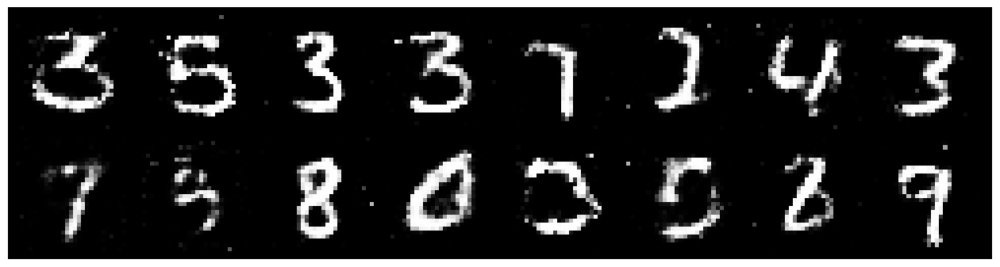

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.2121, Generator Loss: 0.9678
D(x): 0.5457, D(G(z)): 0.3879


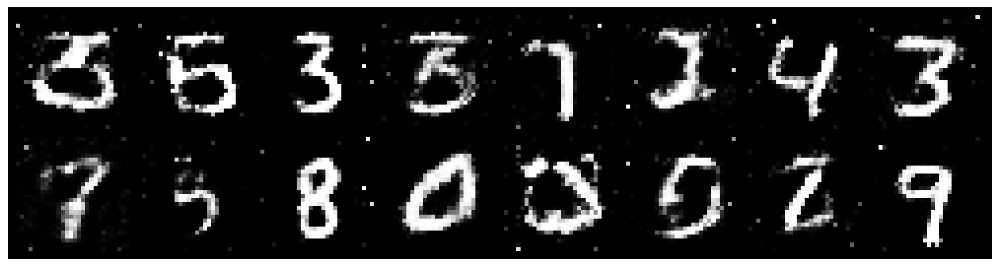

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2549, Generator Loss: 0.8707
D(x): 0.5800, D(G(z)): 0.4632


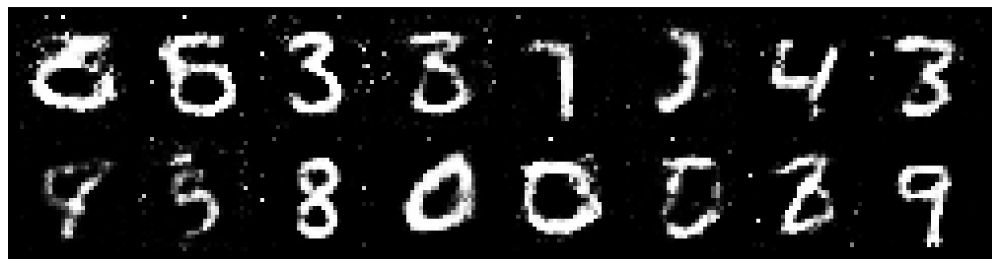

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1951, Generator Loss: 0.8841
D(x): 0.6103, D(G(z)): 0.4600


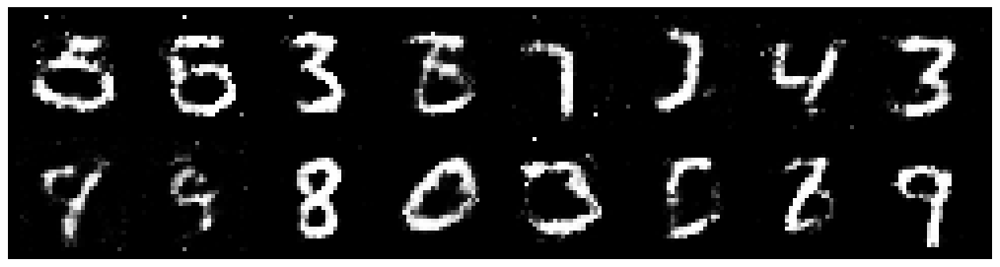

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2283, Generator Loss: 0.9759
D(x): 0.6006, D(G(z)): 0.4492


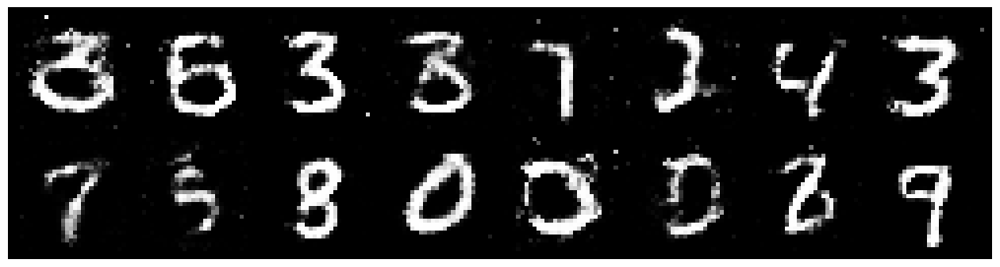

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.3259, Generator Loss: 1.0179
D(x): 0.5862, D(G(z)): 0.4508


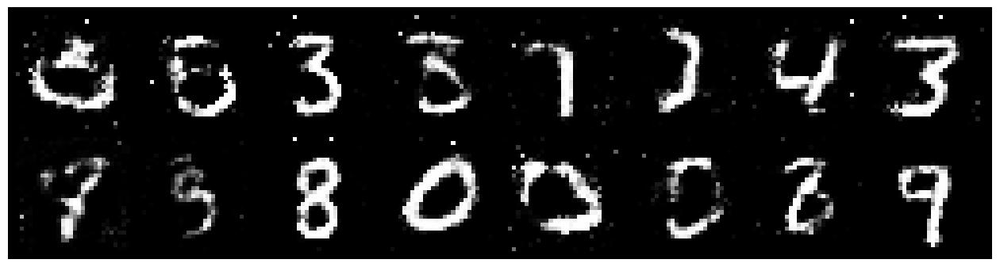

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2553, Generator Loss: 1.0310
D(x): 0.5635, D(G(z)): 0.4301


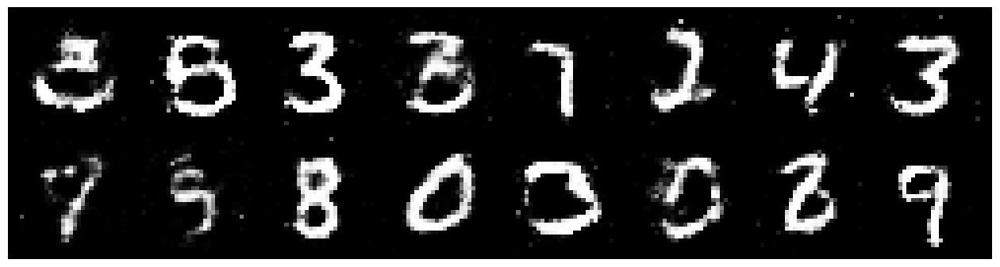

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1447, Generator Loss: 1.0029
D(x): 0.5988, D(G(z)): 0.3997


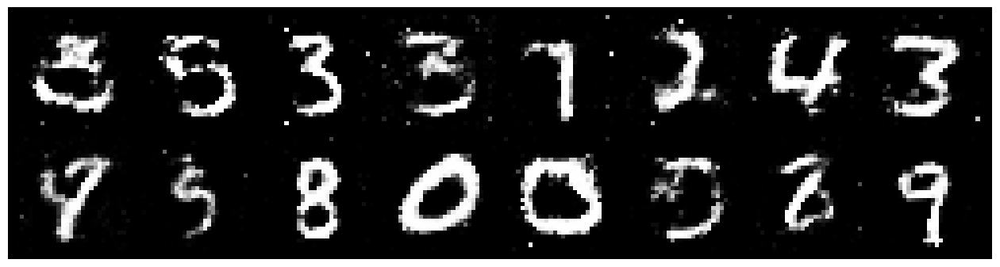

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2244, Generator Loss: 0.8480
D(x): 0.6691, D(G(z)): 0.4795


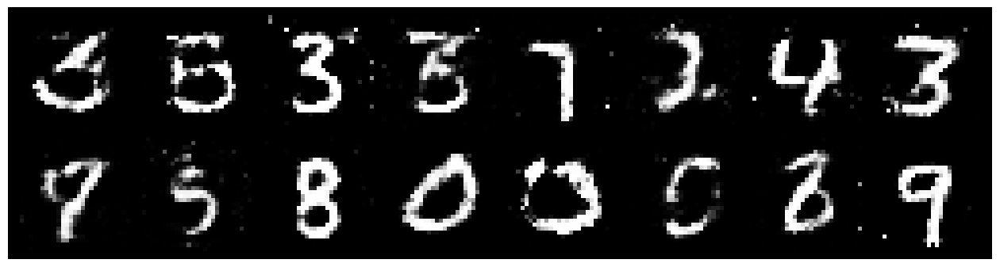

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.1220, Generator Loss: 0.9190
D(x): 0.5879, D(G(z)): 0.3953


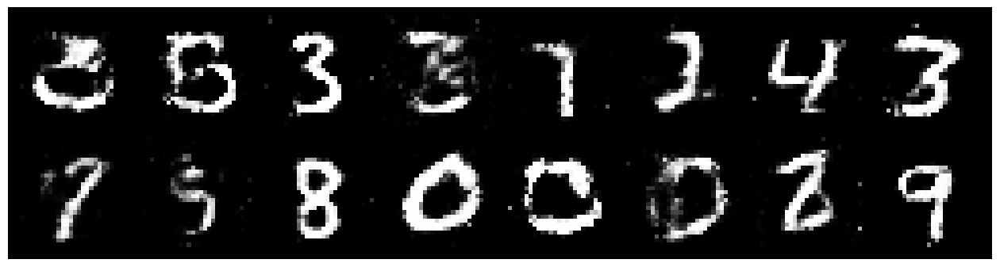

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2208, Generator Loss: 0.9311
D(x): 0.5869, D(G(z)): 0.4459


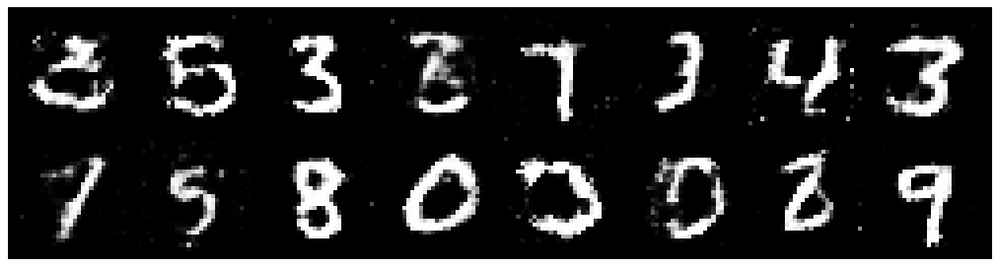

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.1883, Generator Loss: 1.0931
D(x): 0.5715, D(G(z)): 0.4034


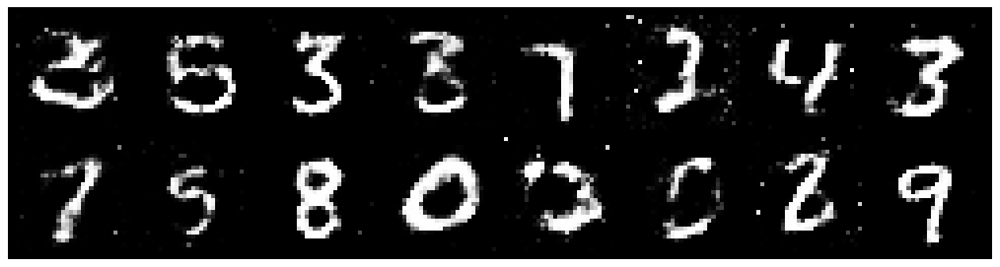

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2297, Generator Loss: 1.0957
D(x): 0.5803, D(G(z)): 0.4269


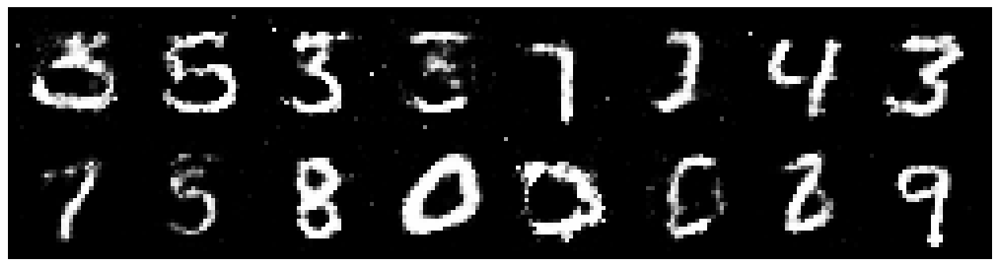

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.1009, Generator Loss: 1.2212
D(x): 0.6215, D(G(z)): 0.3912


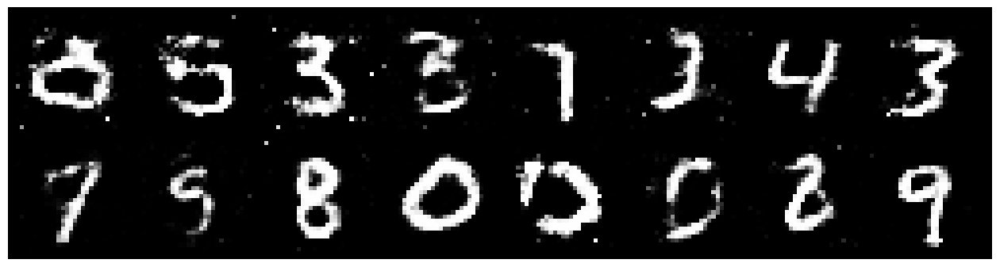

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.1944, Generator Loss: 0.9317
D(x): 0.6475, D(G(z)): 0.4639


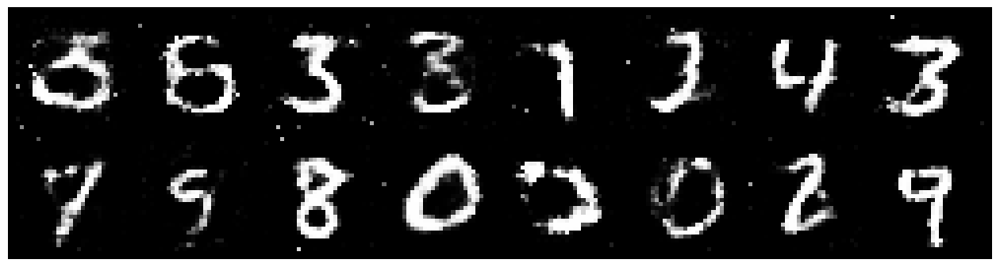

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2384, Generator Loss: 0.8390
D(x): 0.5728, D(G(z)): 0.4476


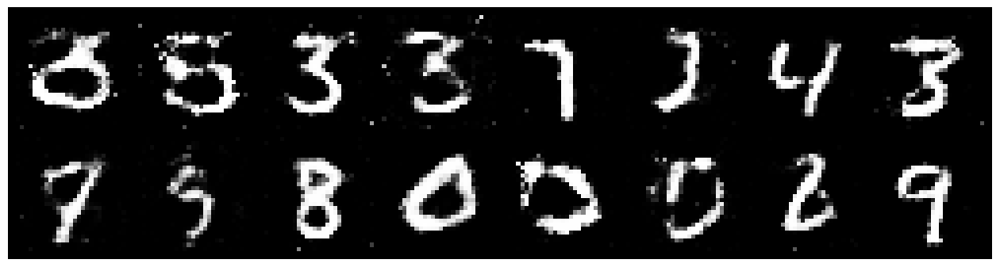

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2463, Generator Loss: 1.0553
D(x): 0.5598, D(G(z)): 0.4401


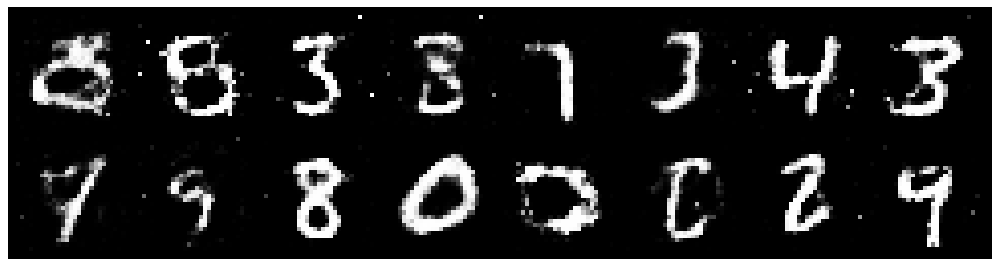

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2179, Generator Loss: 0.9480
D(x): 0.5958, D(G(z)): 0.4688


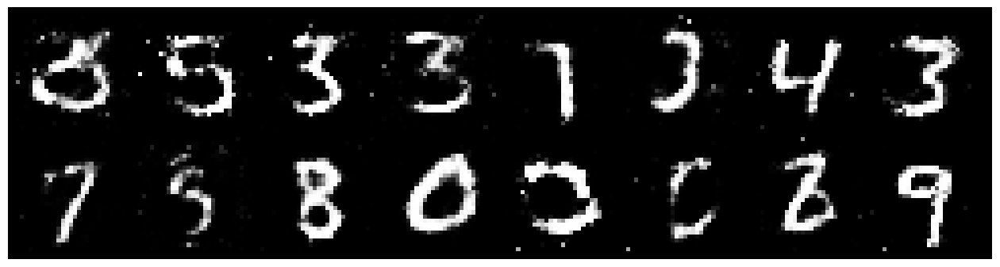

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2818, Generator Loss: 0.9944
D(x): 0.5431, D(G(z)): 0.4274


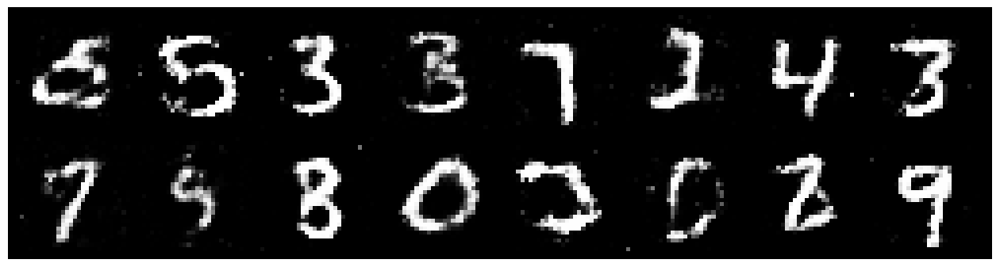

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.1908, Generator Loss: 0.9322
D(x): 0.6120, D(G(z)): 0.4522


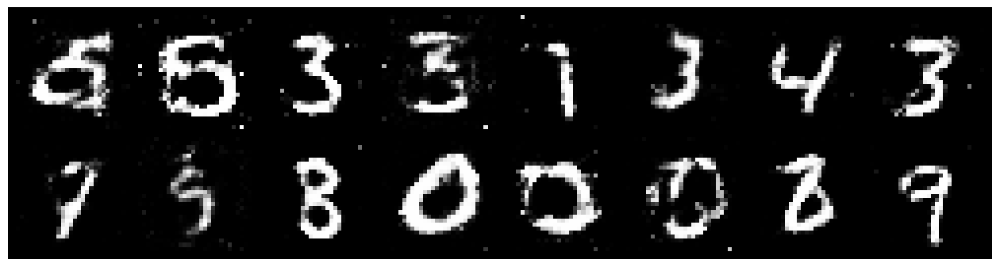

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.3436, Generator Loss: 0.8248
D(x): 0.5384, D(G(z)): 0.4771


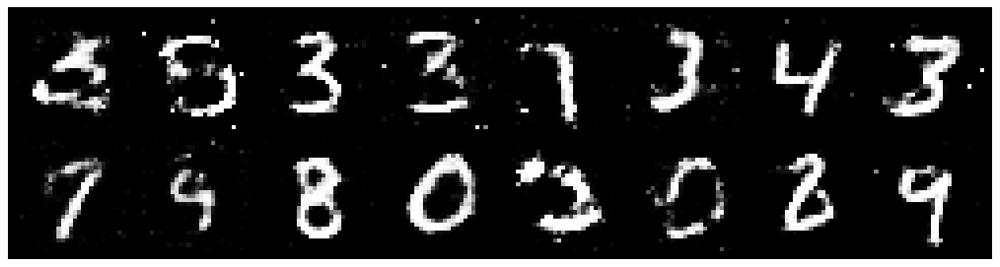

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1711, Generator Loss: 0.9774
D(x): 0.5581, D(G(z)): 0.3922


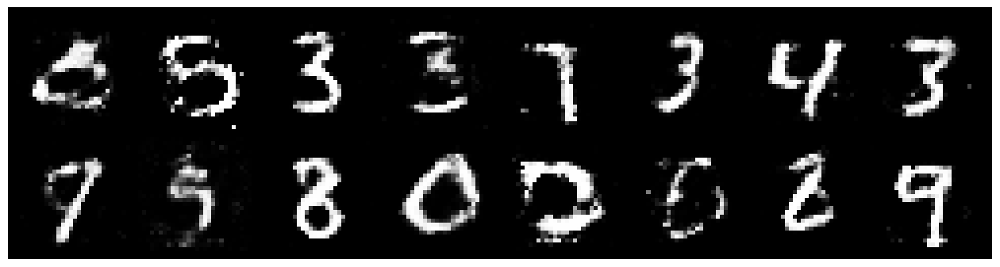

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2056, Generator Loss: 0.9589
D(x): 0.5504, D(G(z)): 0.3985


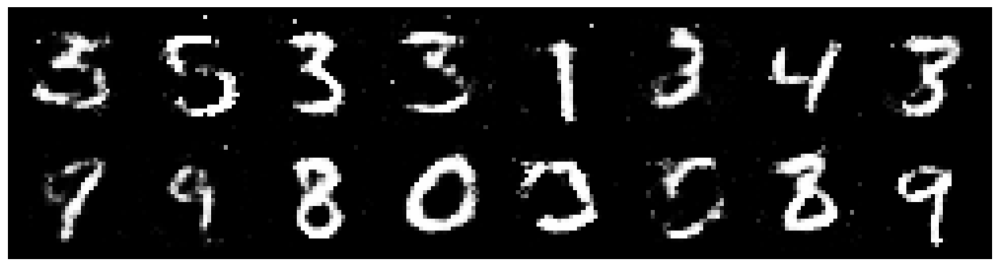

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1886, Generator Loss: 0.9580
D(x): 0.5692, D(G(z)): 0.4012


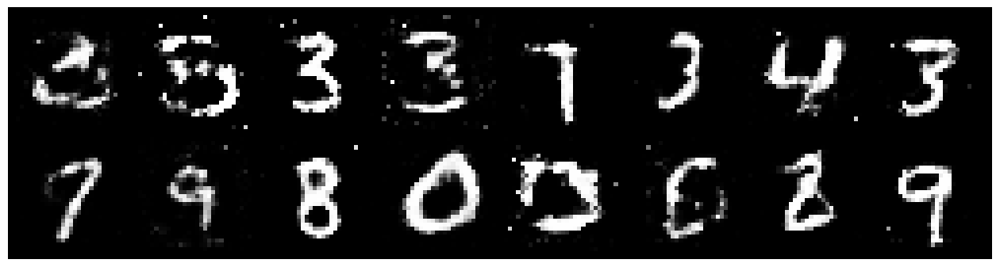

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2702, Generator Loss: 0.7940
D(x): 0.5731, D(G(z)): 0.4443


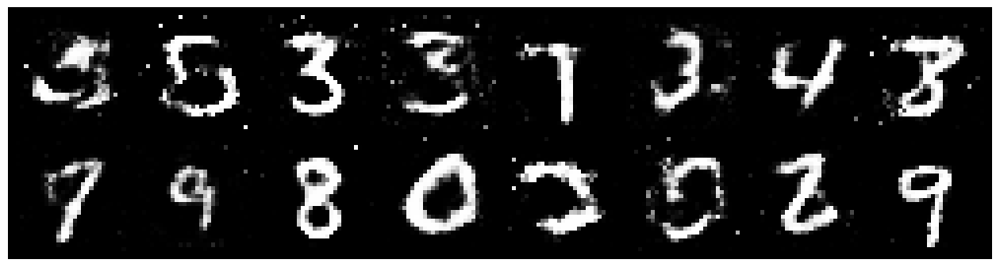

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2987, Generator Loss: 1.0303
D(x): 0.5646, D(G(z)): 0.3864


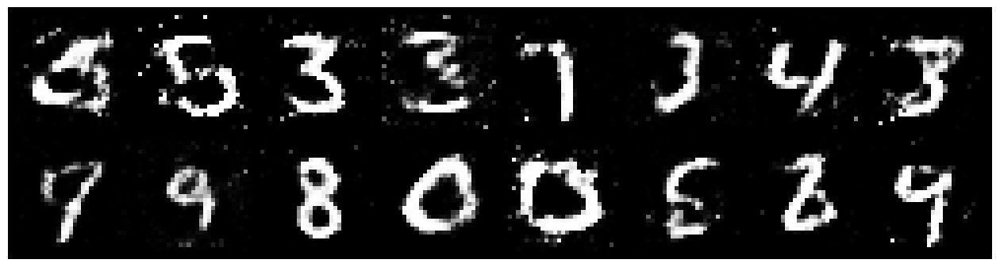

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.3198, Generator Loss: 0.9399
D(x): 0.5539, D(G(z)): 0.4405


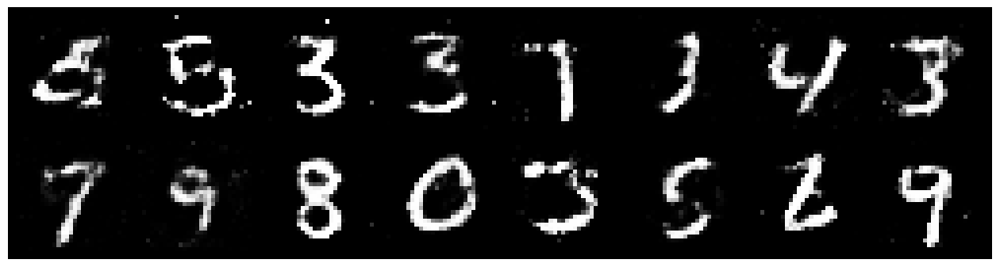

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.3350, Generator Loss: 0.9579
D(x): 0.5271, D(G(z)): 0.4396


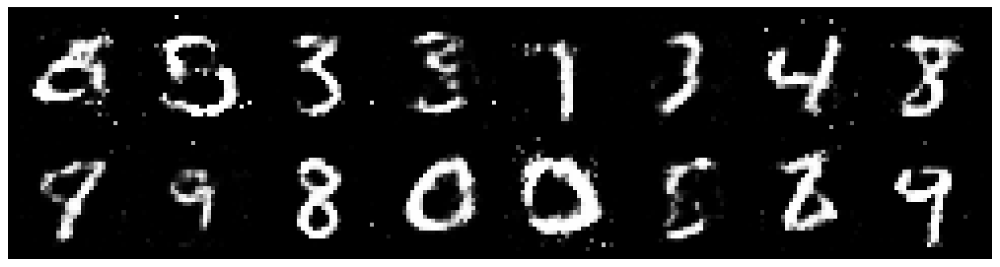

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3093, Generator Loss: 0.8059
D(x): 0.5785, D(G(z)): 0.4776


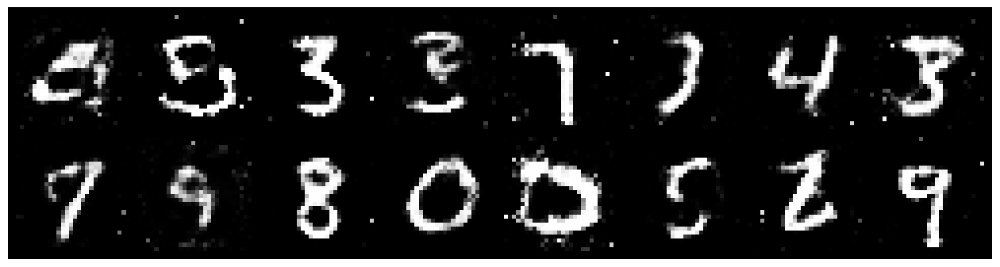

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.3922, Generator Loss: 0.8982
D(x): 0.5392, D(G(z)): 0.4564


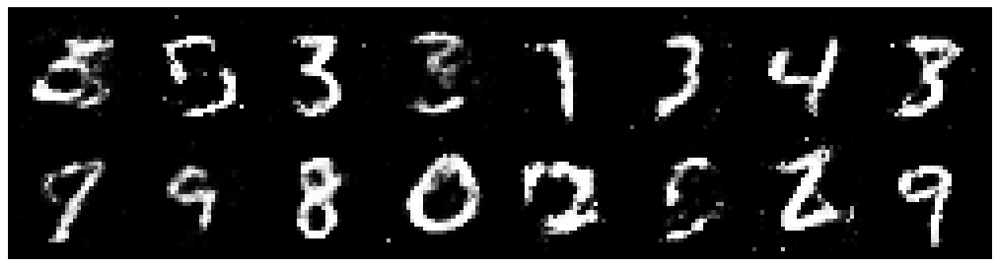

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2724, Generator Loss: 0.7931
D(x): 0.5603, D(G(z)): 0.4639


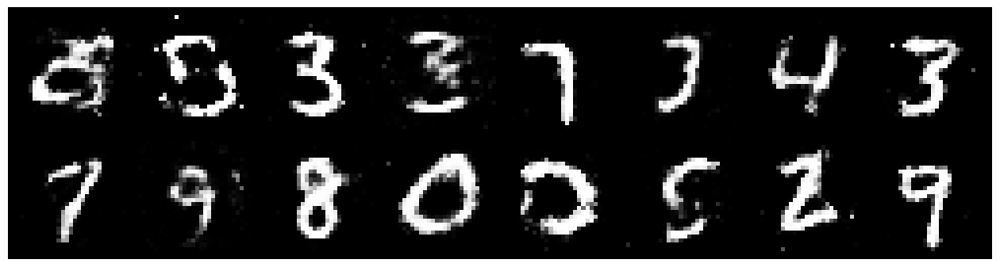

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3764, Generator Loss: 0.9039
D(x): 0.4985, D(G(z)): 0.4517


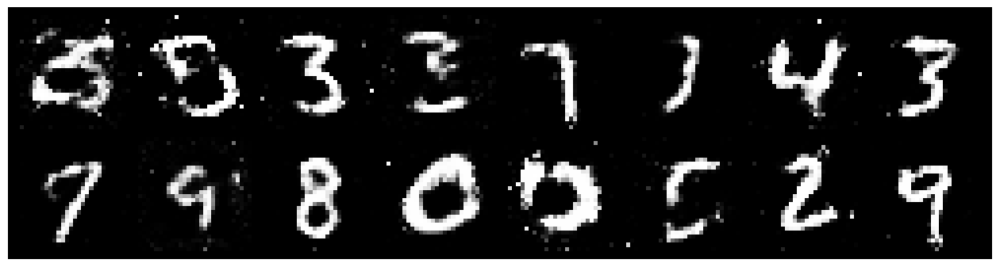

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.1925, Generator Loss: 0.8699
D(x): 0.5646, D(G(z)): 0.4256


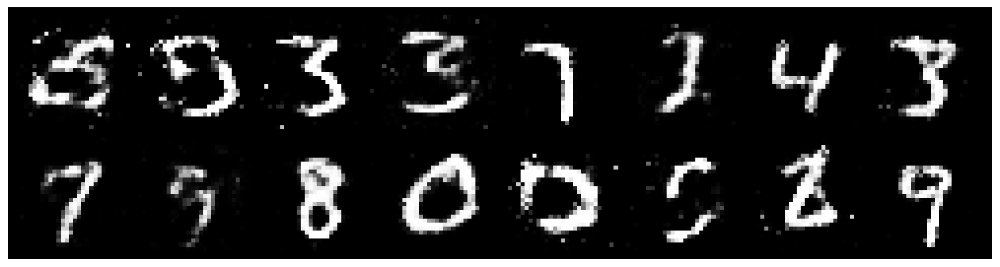

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2705, Generator Loss: 0.8656
D(x): 0.5668, D(G(z)): 0.4607


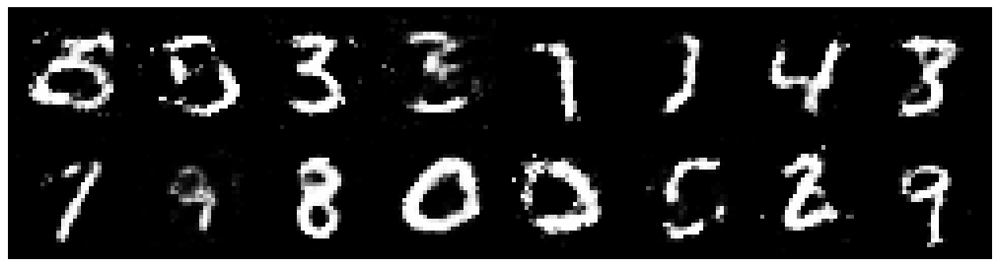

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1691, Generator Loss: 0.9147
D(x): 0.6142, D(G(z)): 0.4282


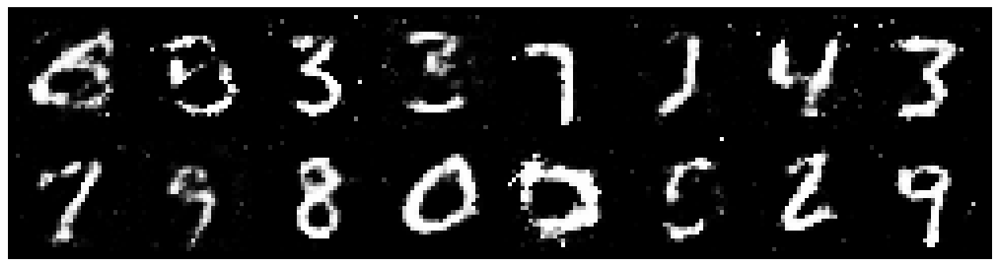

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.2289, Generator Loss: 0.9678
D(x): 0.5662, D(G(z)): 0.4221


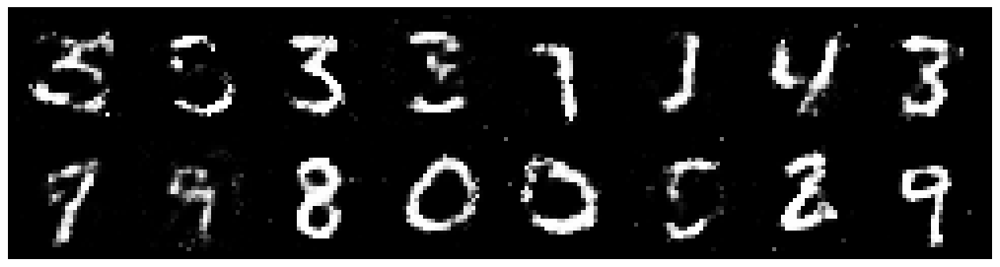

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8356
D(x): 0.5383, D(G(z)): 0.4044


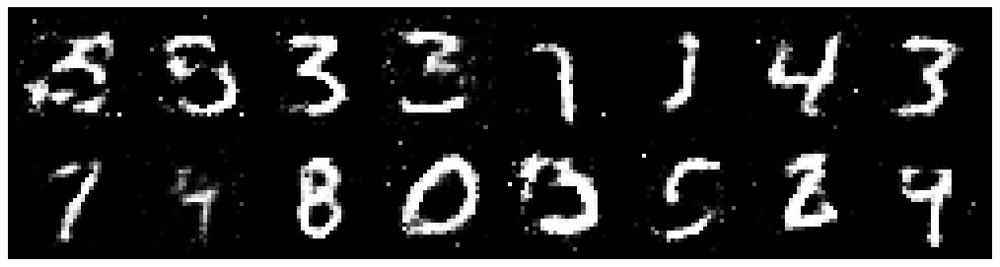

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2027, Generator Loss: 0.9902
D(x): 0.6167, D(G(z)): 0.4518


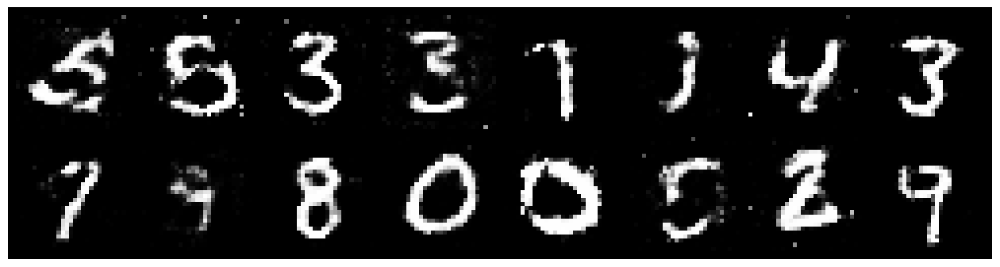

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2900, Generator Loss: 0.8329
D(x): 0.5792, D(G(z)): 0.4576


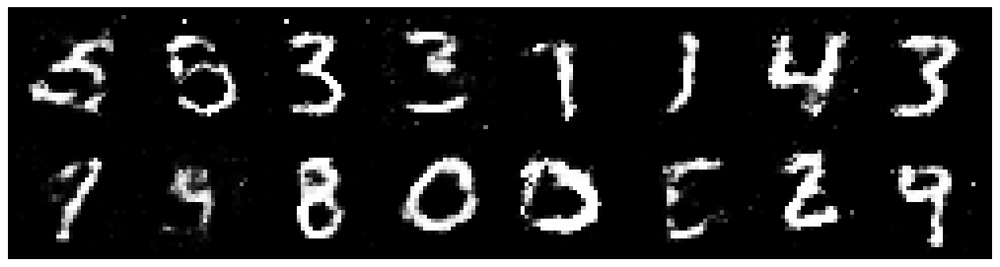

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2385, Generator Loss: 1.0152
D(x): 0.5469, D(G(z)): 0.4164


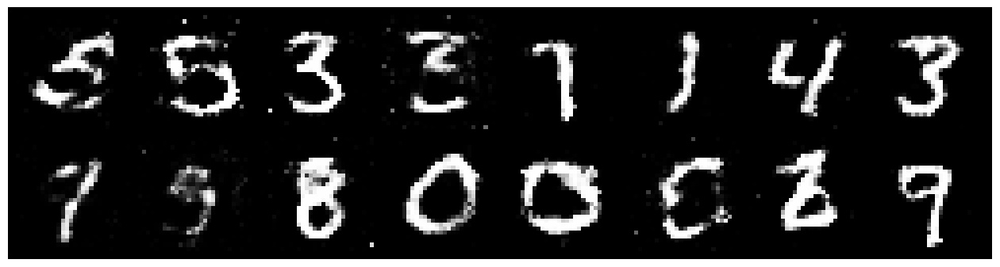

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2371, Generator Loss: 0.9398
D(x): 0.5740, D(G(z)): 0.4339


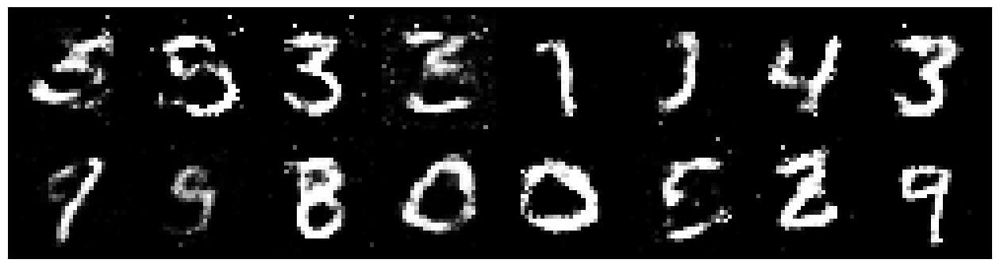

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1883, Generator Loss: 0.8935
D(x): 0.5649, D(G(z)): 0.4313


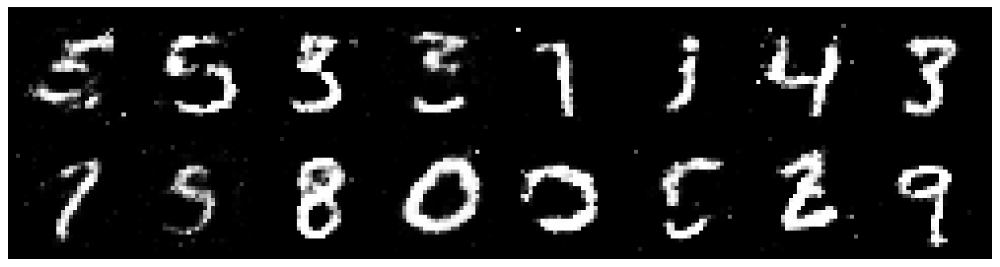

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2644, Generator Loss: 0.9000
D(x): 0.5610, D(G(z)): 0.4516


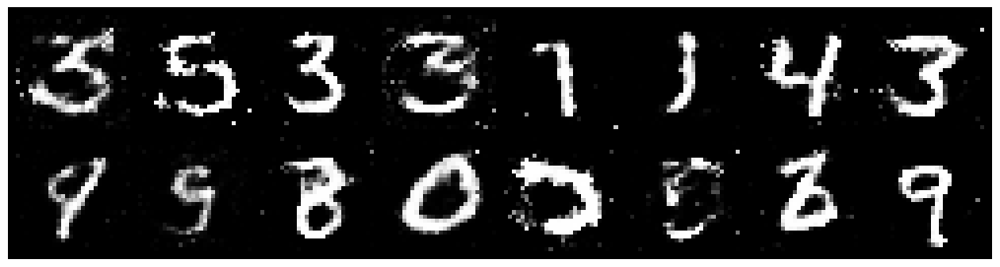

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2658, Generator Loss: 0.8429
D(x): 0.5464, D(G(z)): 0.4363


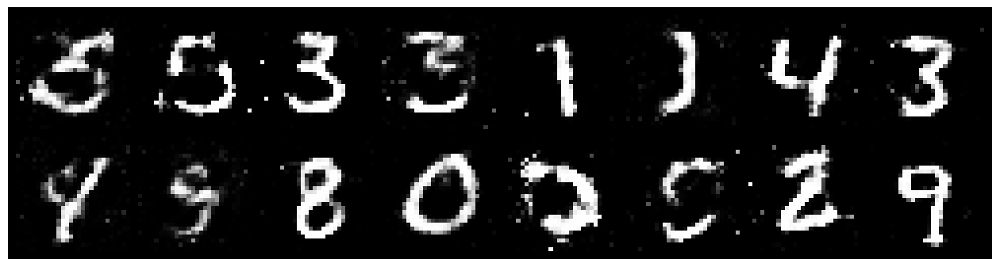

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.3165, Generator Loss: 0.8984
D(x): 0.5403, D(G(z)): 0.4525


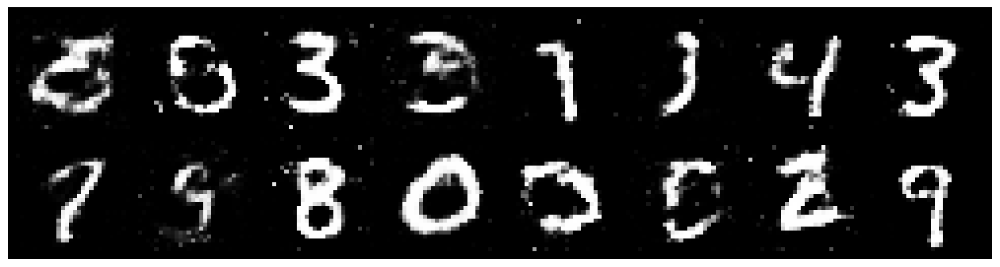

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2334, Generator Loss: 0.7869
D(x): 0.5701, D(G(z)): 0.4503


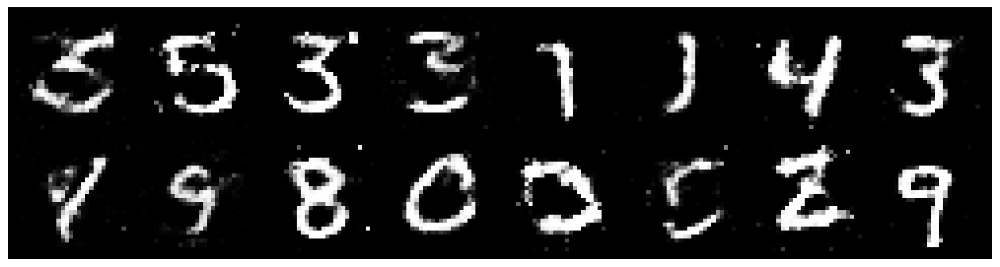

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.1778, Generator Loss: 0.9096
D(x): 0.5847, D(G(z)): 0.4178


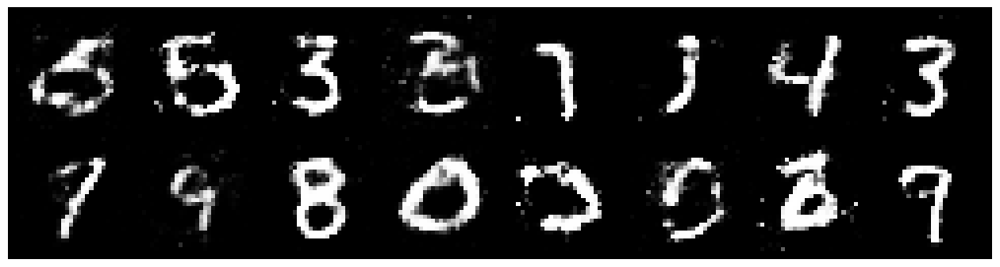

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.3632, Generator Loss: 0.7933
D(x): 0.5591, D(G(z)): 0.4950


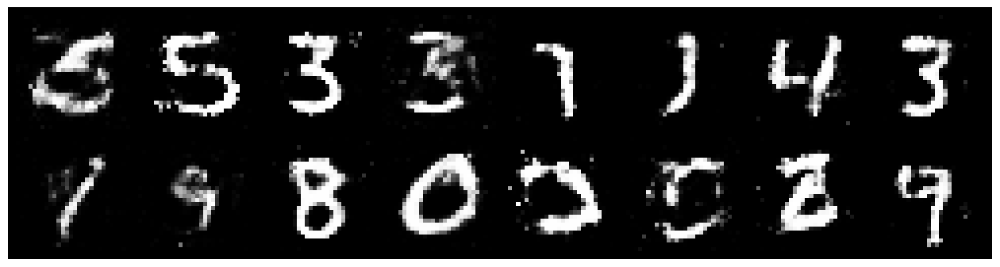

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8525
D(x): 0.5363, D(G(z)): 0.4229


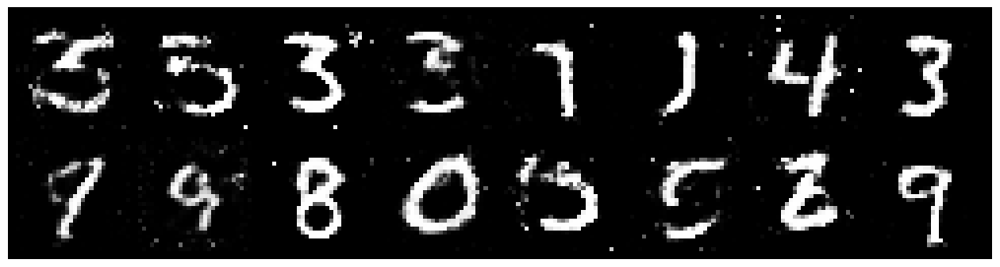

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.4024, Generator Loss: 0.9225
D(x): 0.5462, D(G(z)): 0.4696


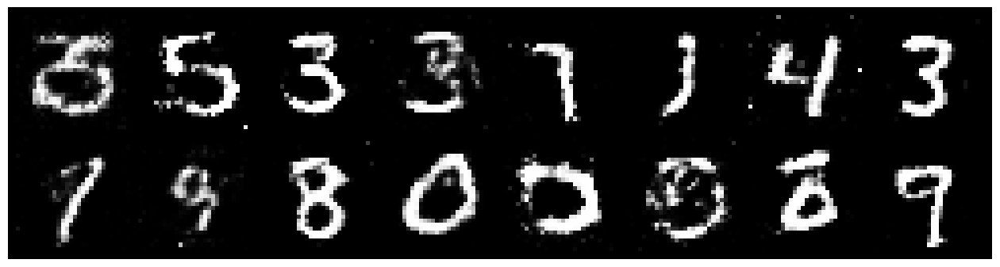

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.4069, Generator Loss: 0.9661
D(x): 0.5207, D(G(z)): 0.4404


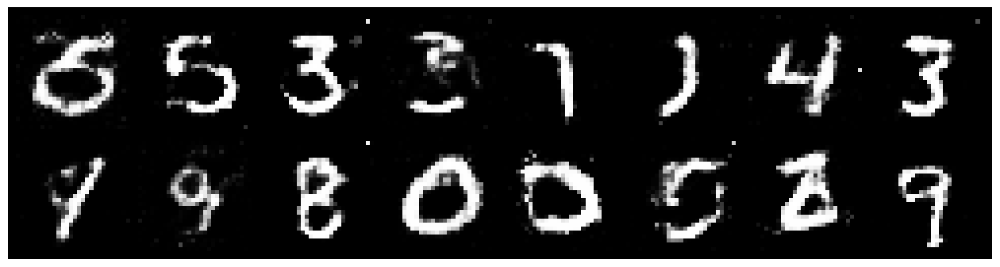

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.2001, Generator Loss: 1.0422
D(x): 0.6285, D(G(z)): 0.4429


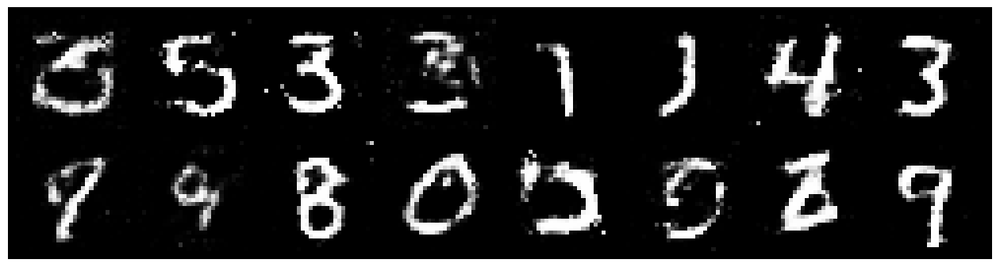

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2510, Generator Loss: 0.8384
D(x): 0.5797, D(G(z)): 0.4574


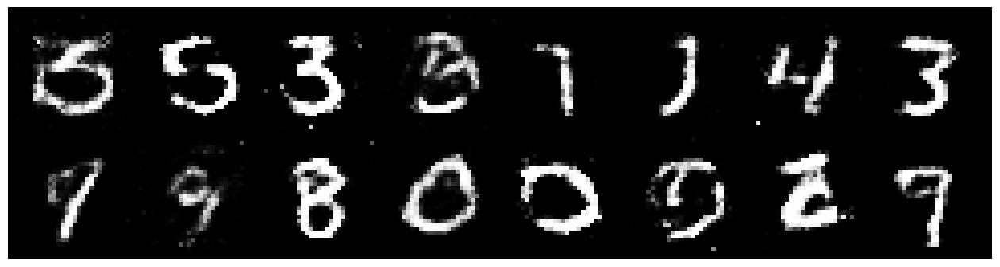

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.3066, Generator Loss: 0.7856
D(x): 0.5996, D(G(z)): 0.5024


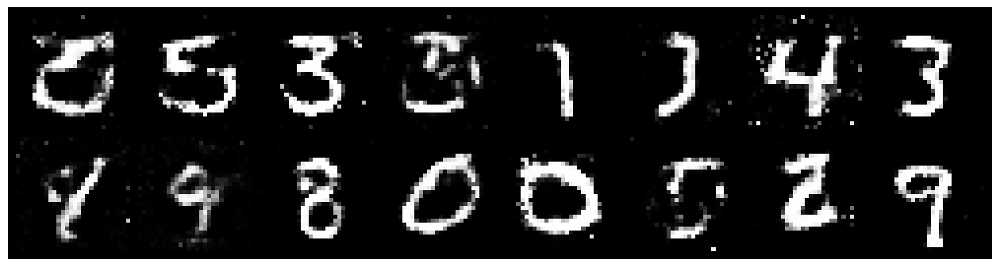

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3697, Generator Loss: 0.8839
D(x): 0.5214, D(G(z)): 0.4712


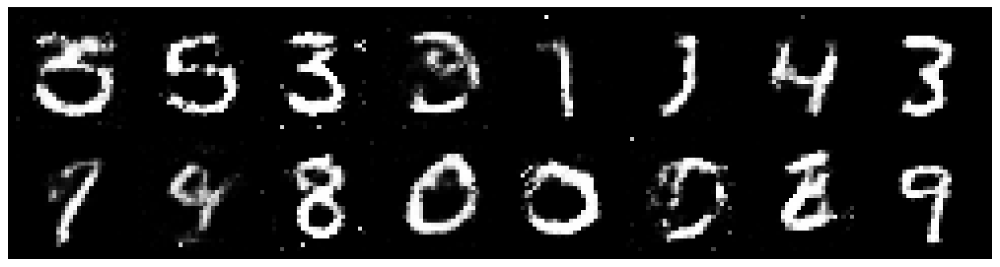

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.3329, Generator Loss: 0.8927
D(x): 0.5209, D(G(z)): 0.4069


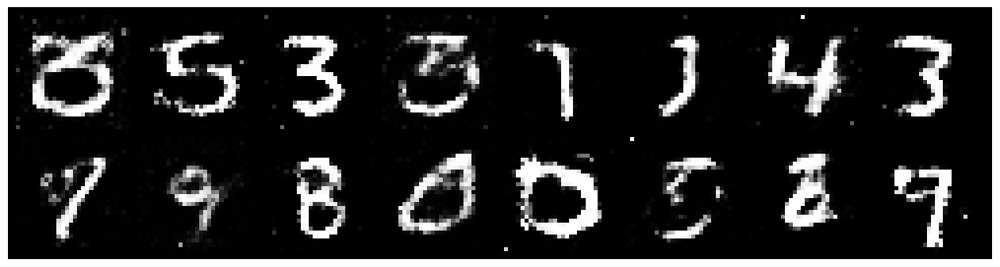

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8475
D(x): 0.5218, D(G(z)): 0.4058


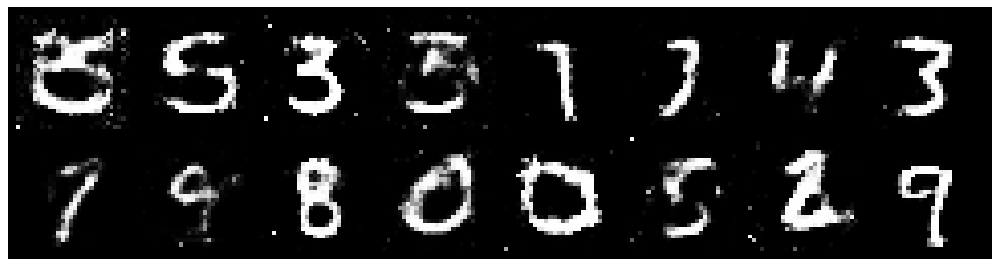

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1912, Generator Loss: 1.0126
D(x): 0.5479, D(G(z)): 0.3874


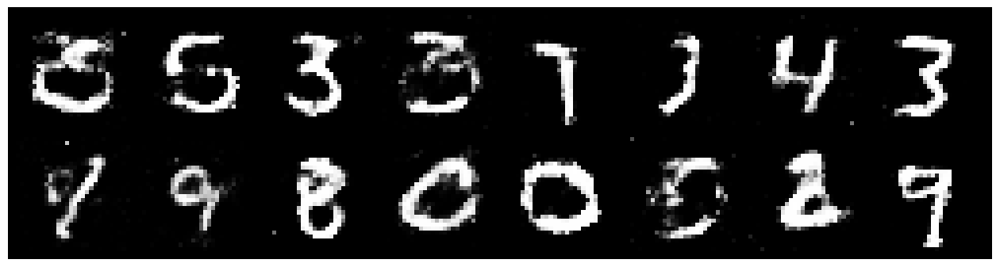

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2023, Generator Loss: 1.0370
D(x): 0.5561, D(G(z)): 0.3927


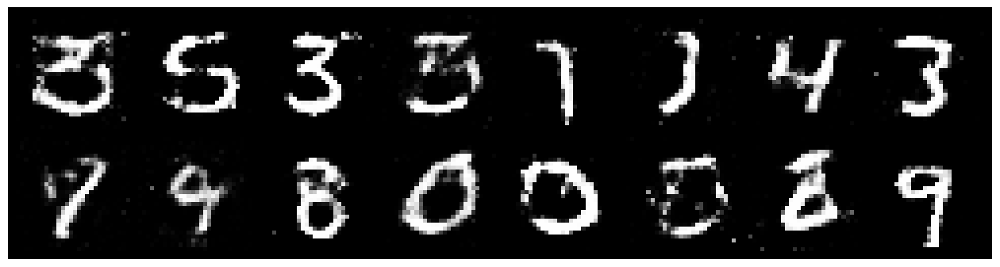

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8930
D(x): 0.5292, D(G(z)): 0.4172


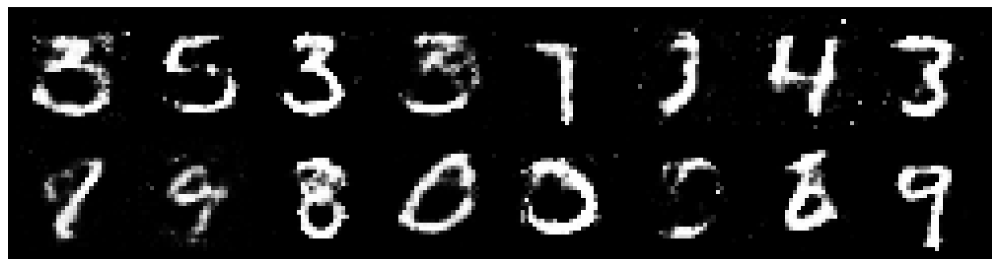

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2406, Generator Loss: 0.9598
D(x): 0.5567, D(G(z)): 0.4170


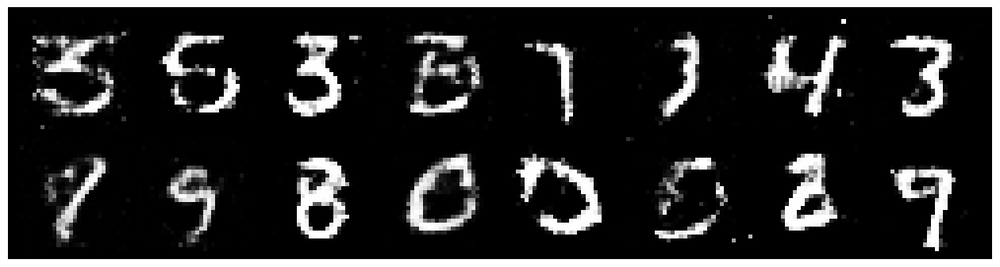

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2344, Generator Loss: 0.8005
D(x): 0.5672, D(G(z)): 0.4258


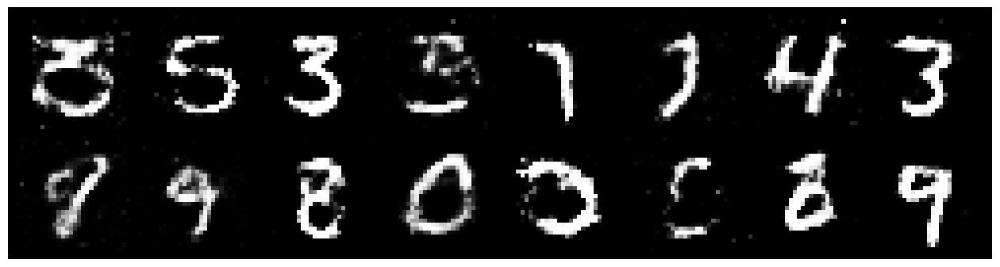

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.3881, Generator Loss: 0.7959
D(x): 0.5389, D(G(z)): 0.4726


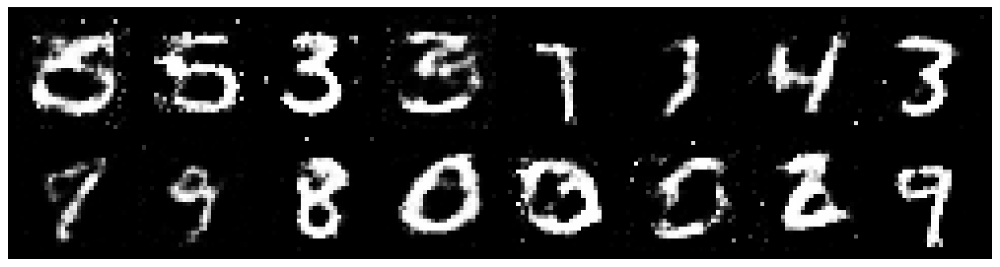

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8139
D(x): 0.5614, D(G(z)): 0.4476


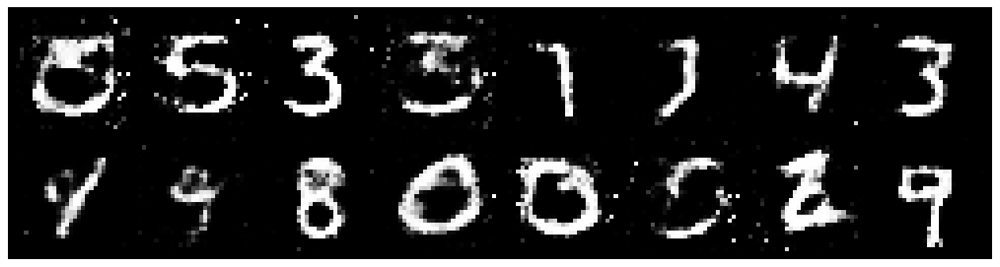

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3221, Generator Loss: 0.9133
D(x): 0.5144, D(G(z)): 0.4288


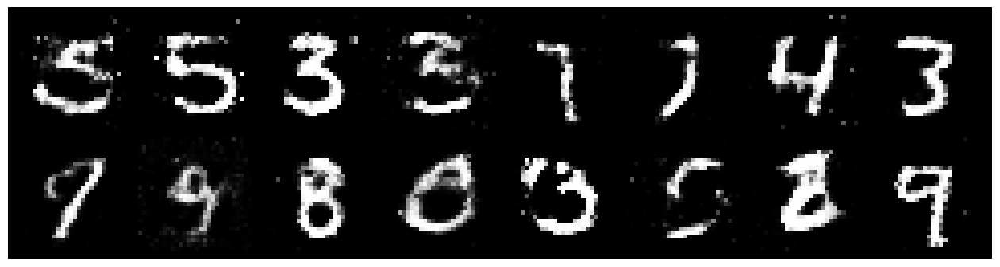

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2292, Generator Loss: 0.9355
D(x): 0.5851, D(G(z)): 0.4352


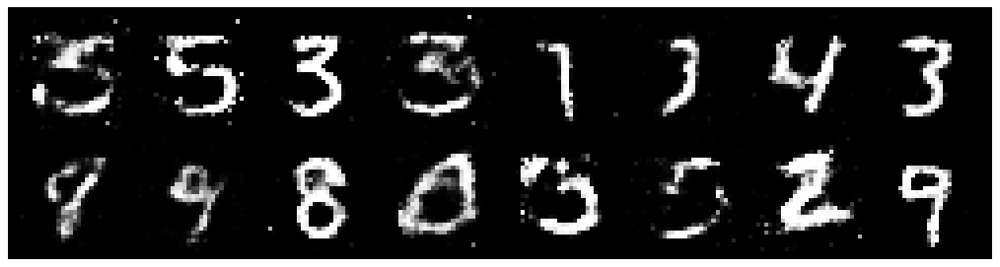

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9999
D(x): 0.5677, D(G(z)): 0.4449


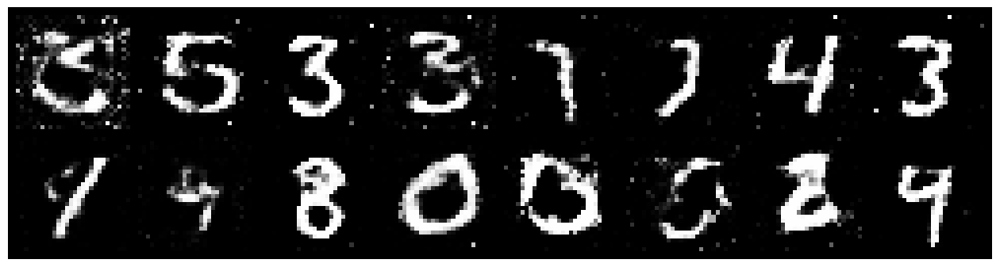

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.1538, Generator Loss: 0.9290
D(x): 0.5952, D(G(z)): 0.4270


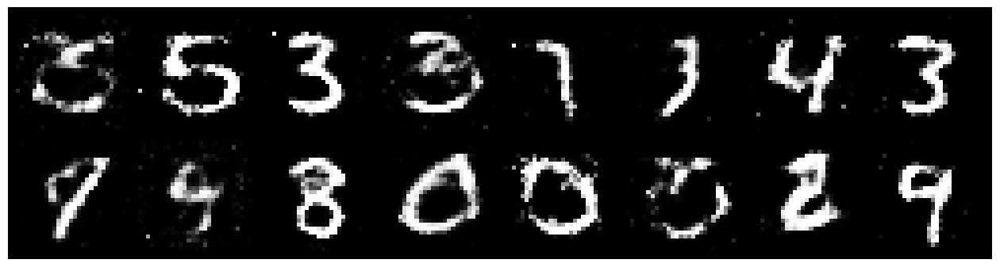

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2436, Generator Loss: 0.8825
D(x): 0.6101, D(G(z)): 0.4596


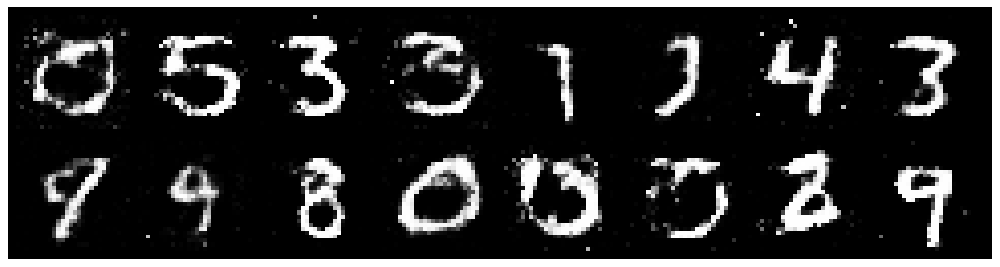

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3336, Generator Loss: 0.8066
D(x): 0.5573, D(G(z)): 0.4806


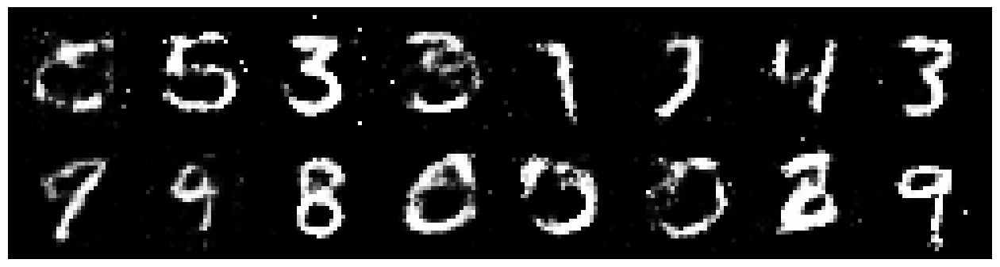

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2691, Generator Loss: 0.8012
D(x): 0.5639, D(G(z)): 0.4391


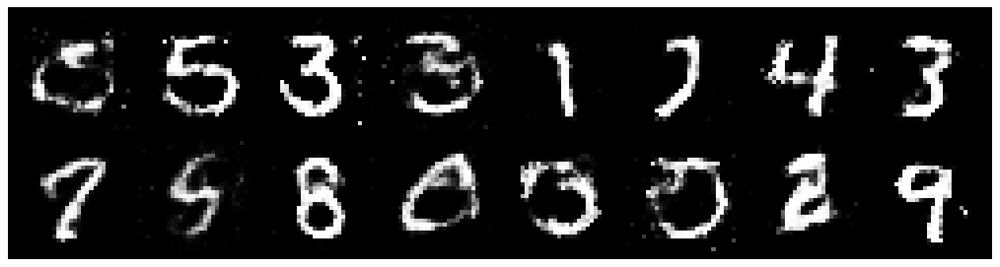

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2353, Generator Loss: 0.9111
D(x): 0.5587, D(G(z)): 0.4276


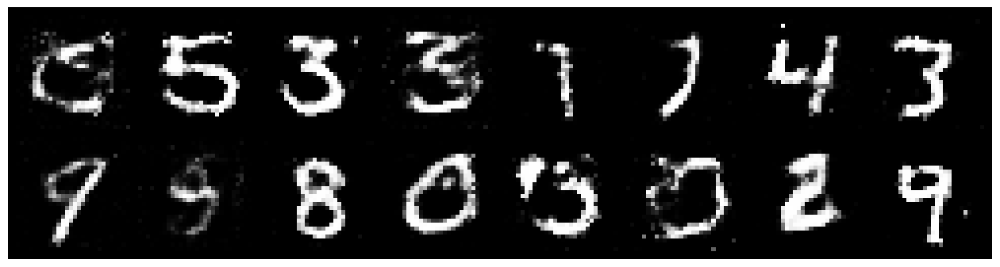

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.0892, Generator Loss: 1.0777
D(x): 0.6071, D(G(z)): 0.3607


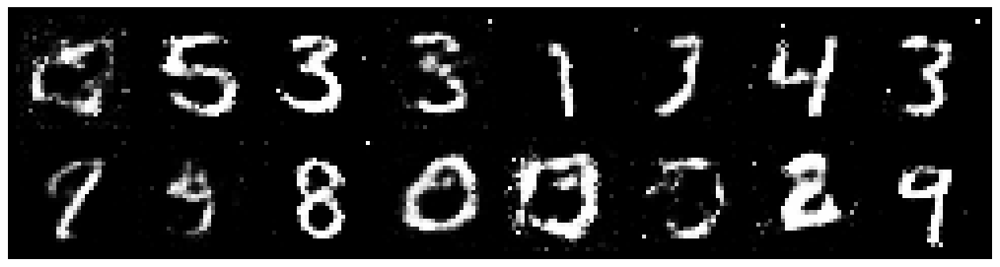

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2092, Generator Loss: 1.0845
D(x): 0.5228, D(G(z)): 0.3612


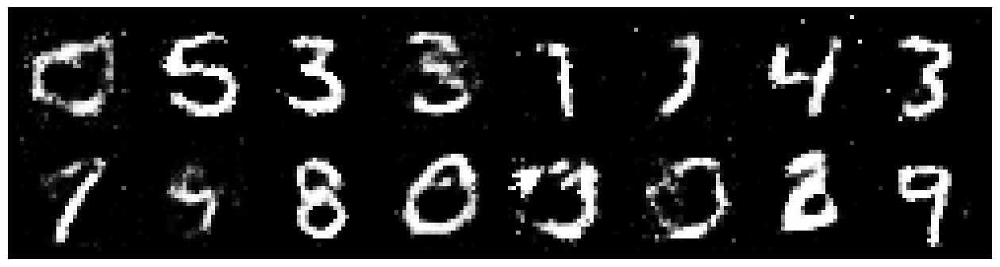

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.1502, Generator Loss: 1.0707
D(x): 0.5864, D(G(z)): 0.3932


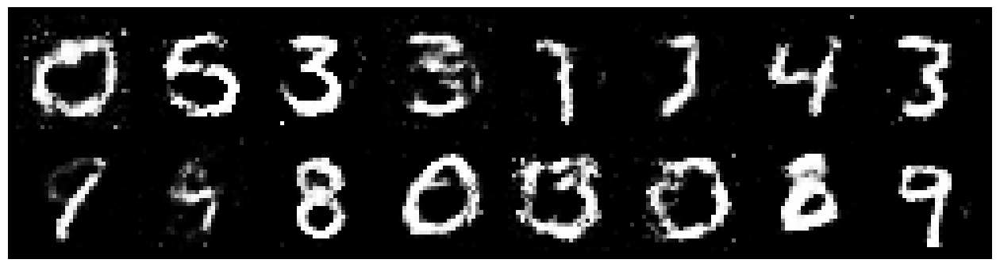

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.3019, Generator Loss: 0.9440
D(x): 0.5288, D(G(z)): 0.4311


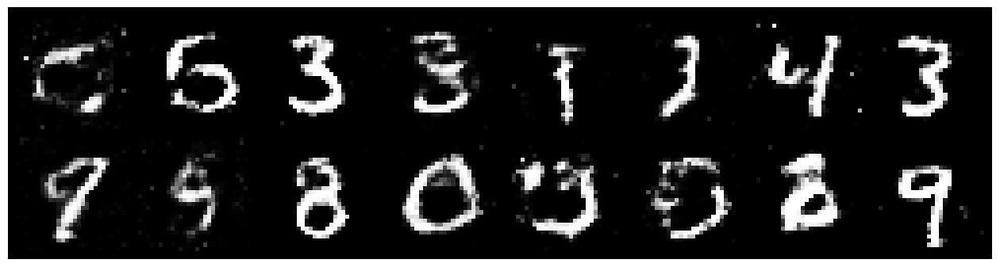

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2847, Generator Loss: 0.8384
D(x): 0.5832, D(G(z)): 0.4651


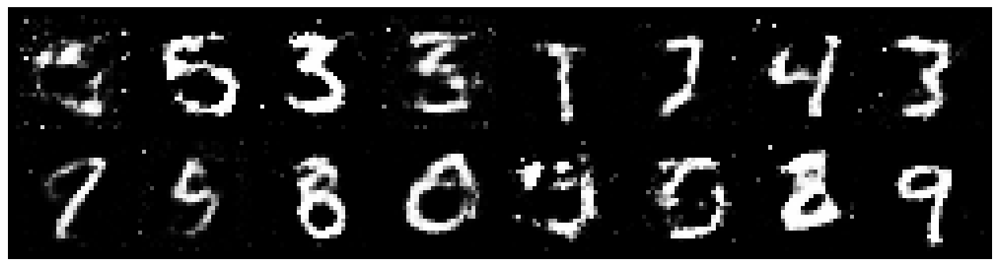

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2948, Generator Loss: 0.9115
D(x): 0.5755, D(G(z)): 0.4516


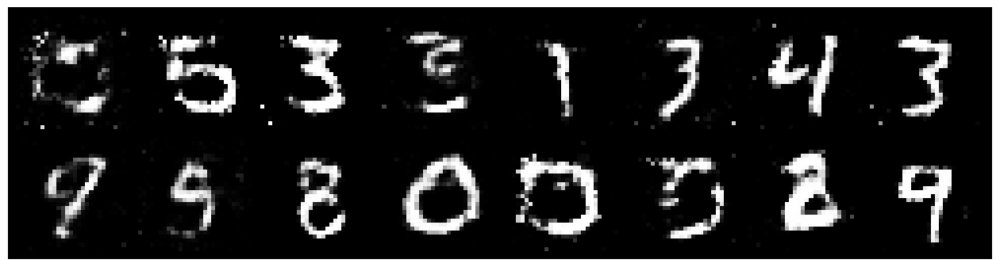

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2192, Generator Loss: 0.9402
D(x): 0.5903, D(G(z)): 0.4426


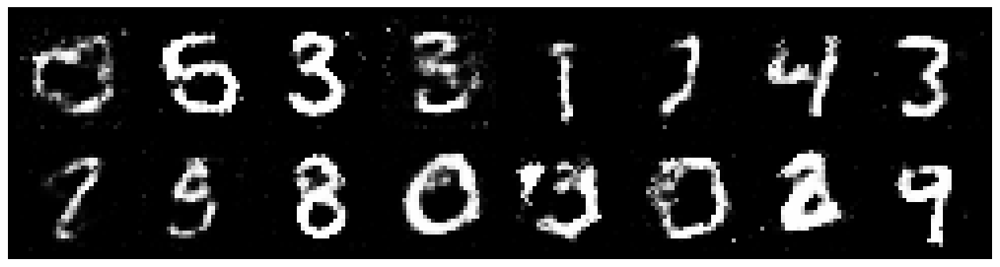

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8289
D(x): 0.5523, D(G(z)): 0.4610


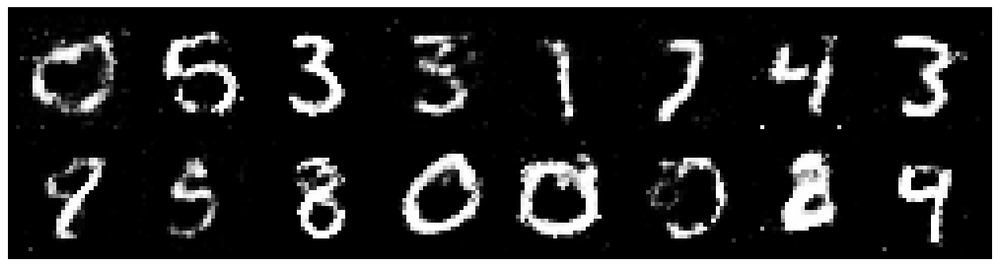

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.4077, Generator Loss: 0.8450
D(x): 0.5310, D(G(z)): 0.4905


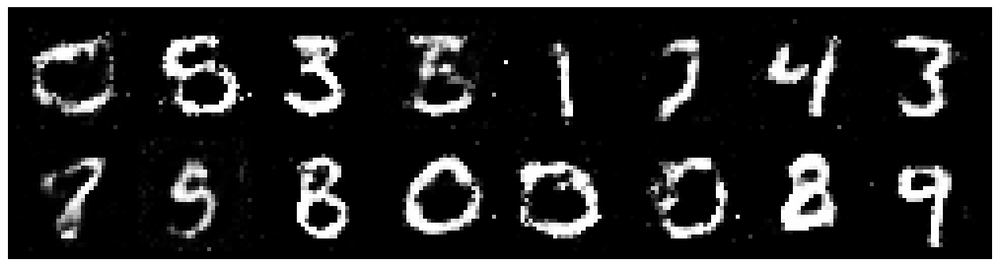

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.3212, Generator Loss: 0.8452
D(x): 0.5351, D(G(z)): 0.4576


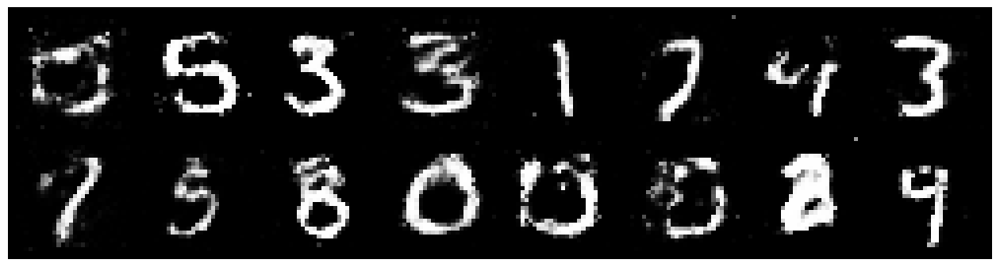

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.1872, Generator Loss: 0.9038
D(x): 0.5505, D(G(z)): 0.4124


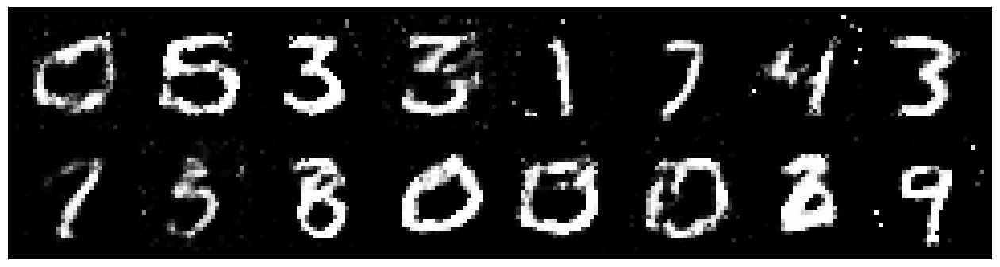

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2629, Generator Loss: 0.9612
D(x): 0.5628, D(G(z)): 0.4460


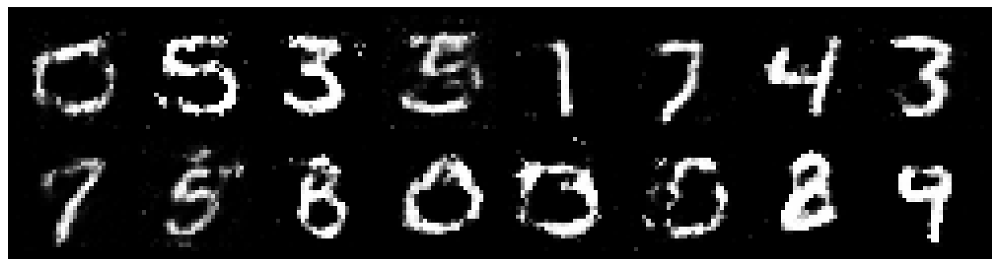

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.1824, Generator Loss: 1.0845
D(x): 0.5841, D(G(z)): 0.4091


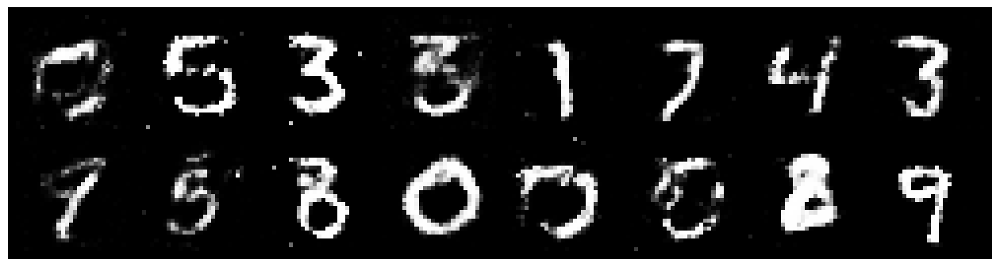

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2058, Generator Loss: 1.1452
D(x): 0.5649, D(G(z)): 0.3778


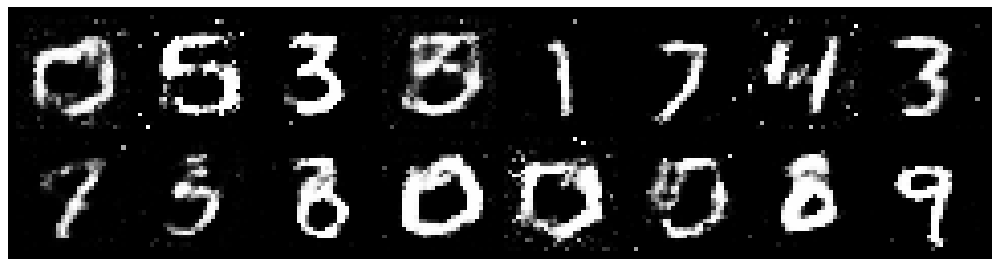

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2482, Generator Loss: 0.8534
D(x): 0.5497, D(G(z)): 0.4300


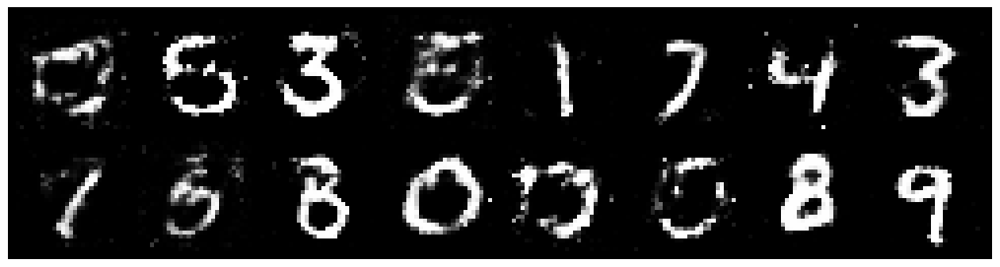

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.2566, Generator Loss: 0.8358
D(x): 0.5752, D(G(z)): 0.4468


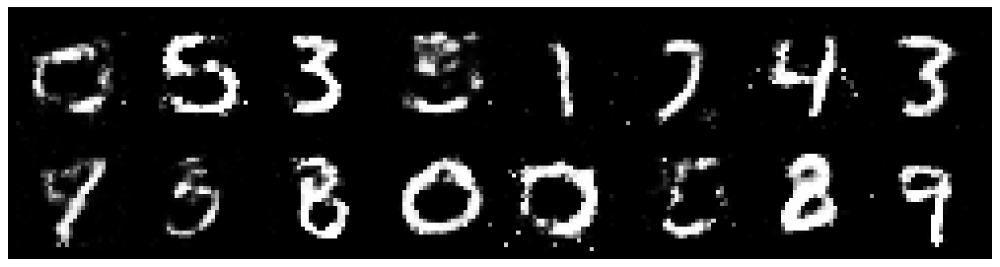

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2910, Generator Loss: 0.9077
D(x): 0.5404, D(G(z)): 0.4523


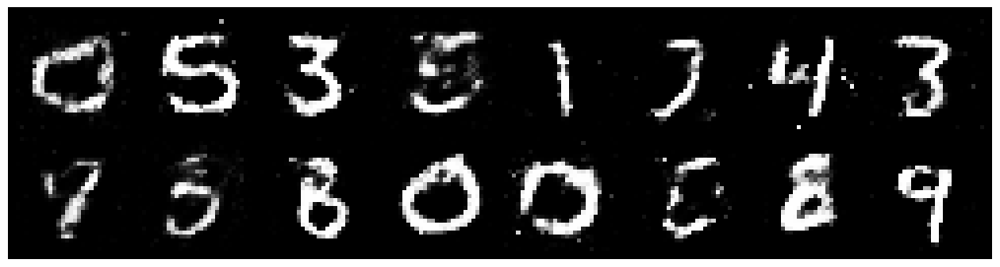

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.1863, Generator Loss: 0.9611
D(x): 0.5739, D(G(z)): 0.3713


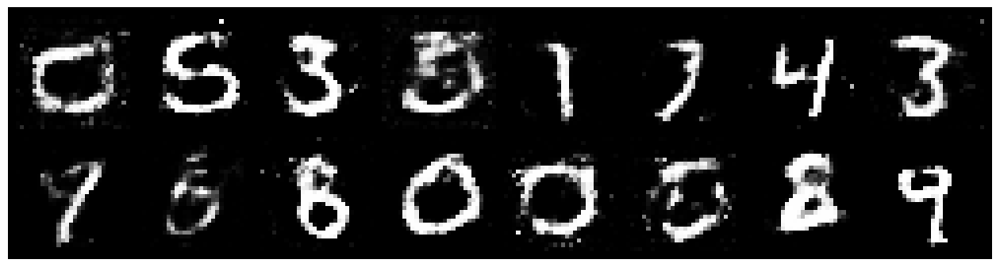

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2578, Generator Loss: 0.9058
D(x): 0.5486, D(G(z)): 0.4430


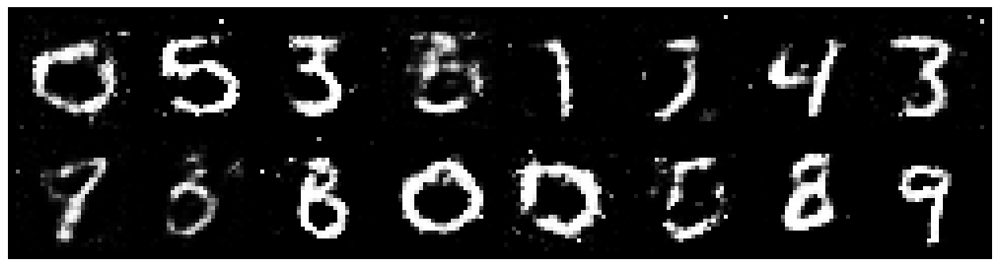

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8449
D(x): 0.5422, D(G(z)): 0.4360


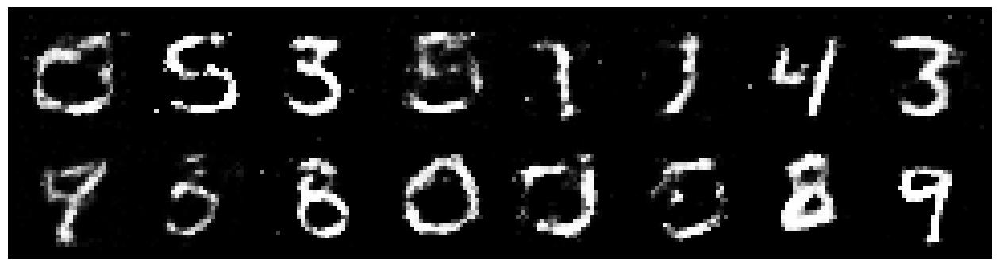

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2484, Generator Loss: 0.8407
D(x): 0.5767, D(G(z)): 0.4438


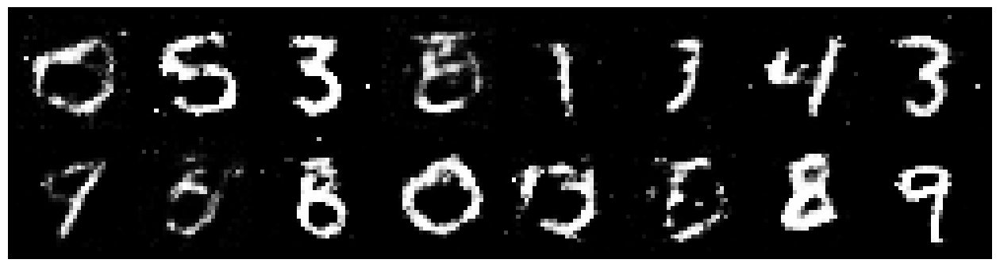

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.1071, Generator Loss: 0.9860
D(x): 0.5923, D(G(z)): 0.4017


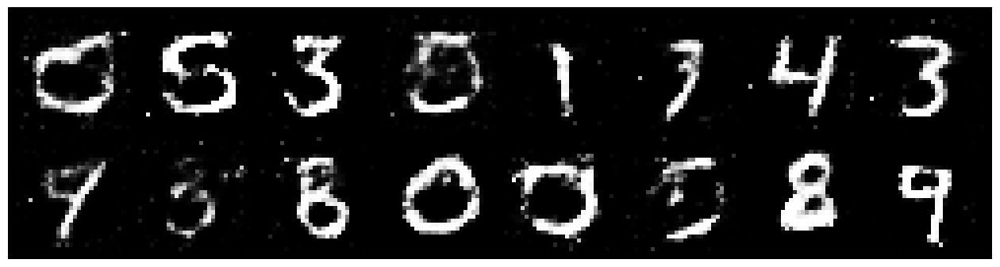

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2295, Generator Loss: 0.9904
D(x): 0.5699, D(G(z)): 0.4368


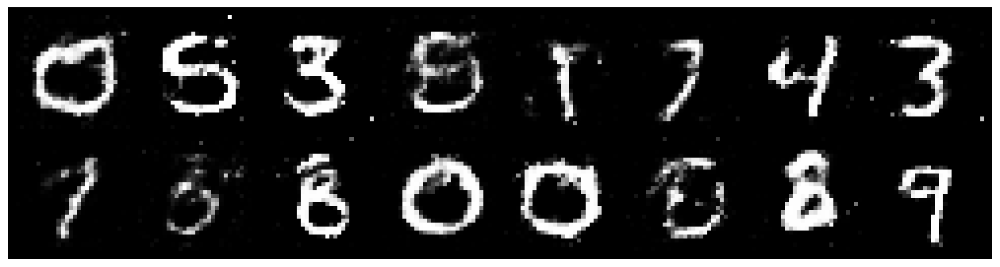

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.1941, Generator Loss: 1.0945
D(x): 0.5445, D(G(z)): 0.3801


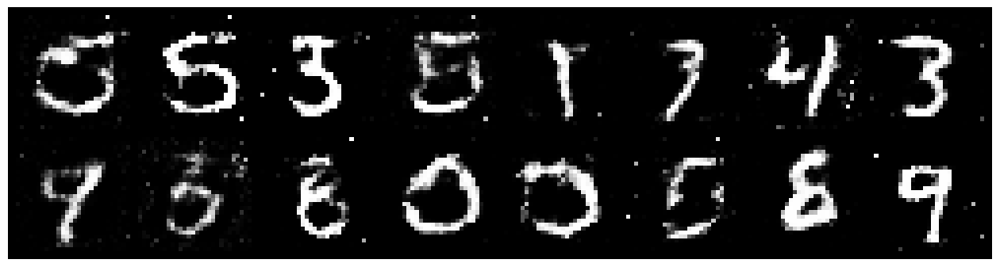

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3079, Generator Loss: 0.9716
D(x): 0.5316, D(G(z)): 0.4474


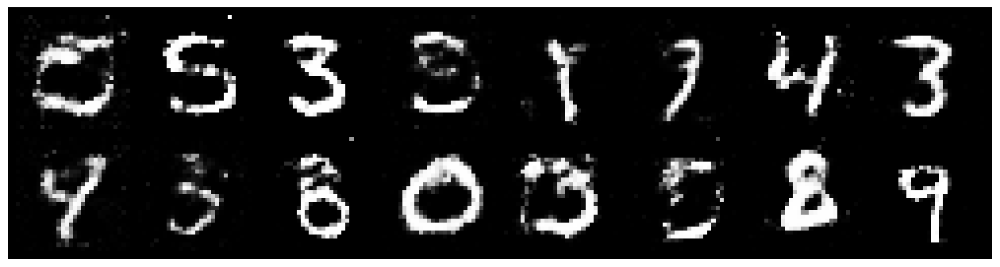

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.1555, Generator Loss: 0.9073
D(x): 0.6231, D(G(z)): 0.4471


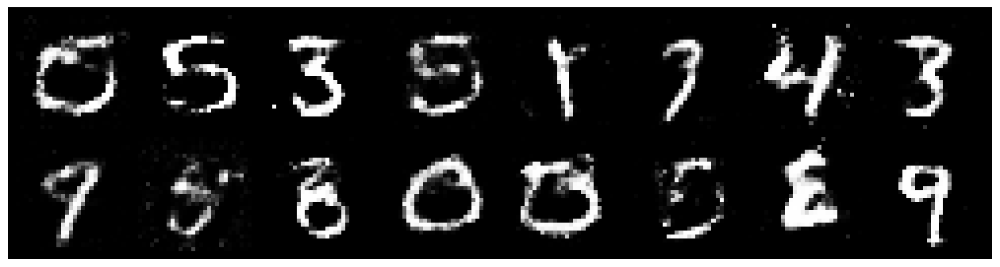

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2712, Generator Loss: 0.8542
D(x): 0.5614, D(G(z)): 0.4470


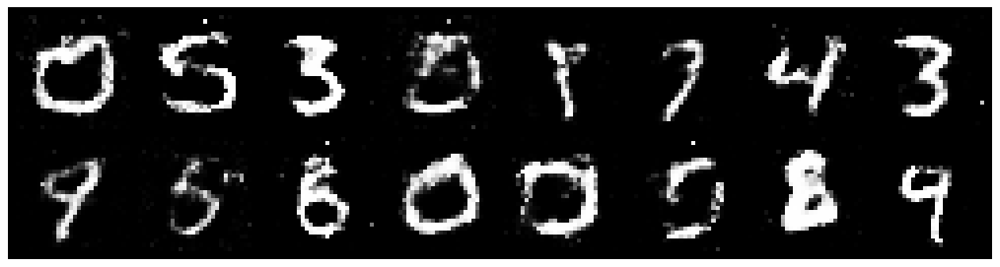

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1896, Generator Loss: 0.8578
D(x): 0.5926, D(G(z)): 0.4386


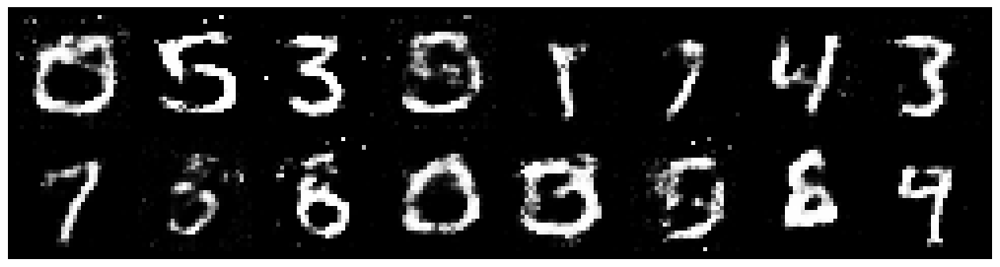

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.4578, Generator Loss: 0.9556
D(x): 0.5547, D(G(z)): 0.4904


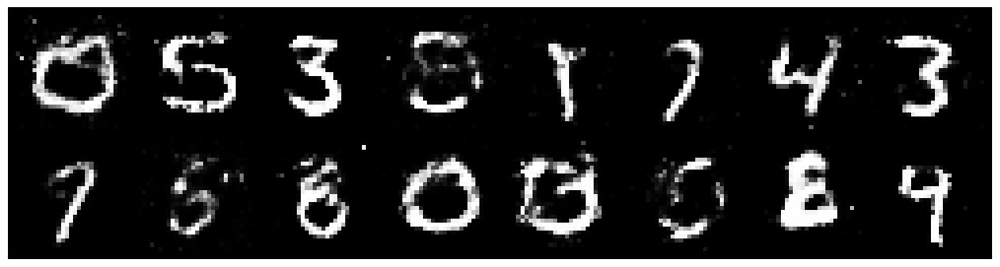

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2287, Generator Loss: 0.7902
D(x): 0.6115, D(G(z)): 0.4848


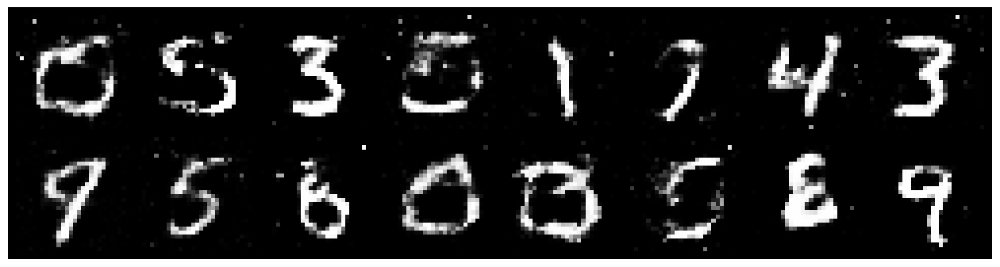

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.3574, Generator Loss: 0.7148
D(x): 0.5654, D(G(z)): 0.4949


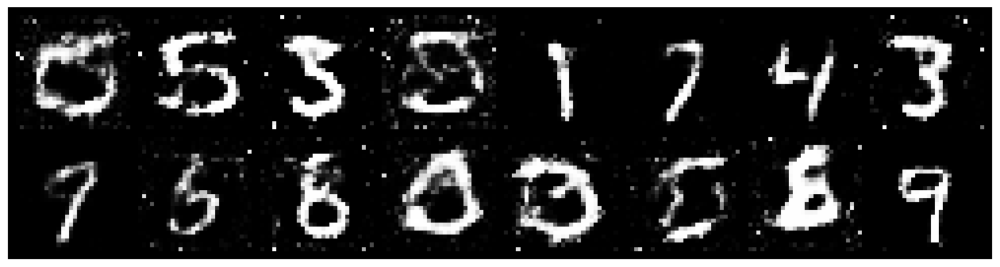

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2913, Generator Loss: 0.7574
D(x): 0.5552, D(G(z)): 0.4835


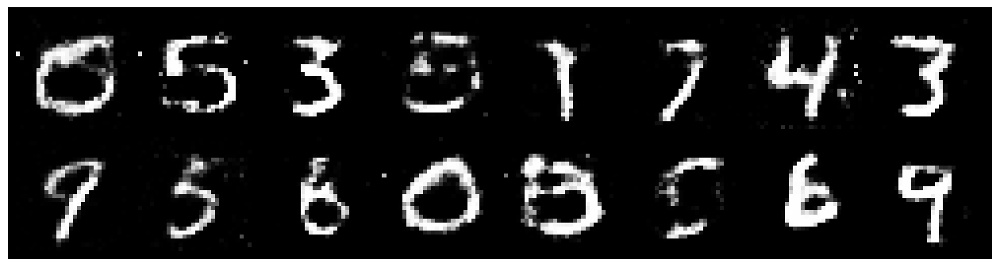

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.3082, Generator Loss: 0.9330
D(x): 0.5430, D(G(z)): 0.4384


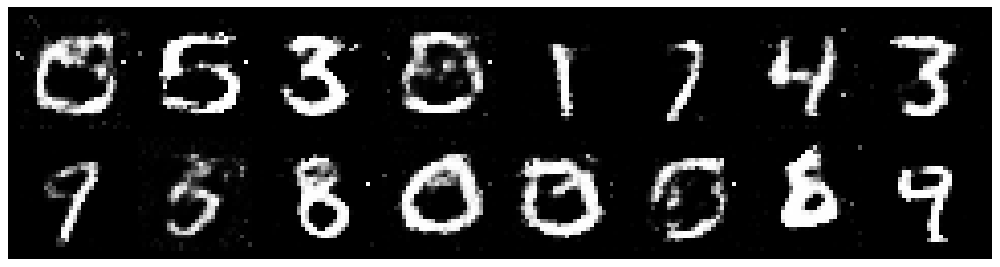

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2066, Generator Loss: 0.8584
D(x): 0.5855, D(G(z)): 0.4424


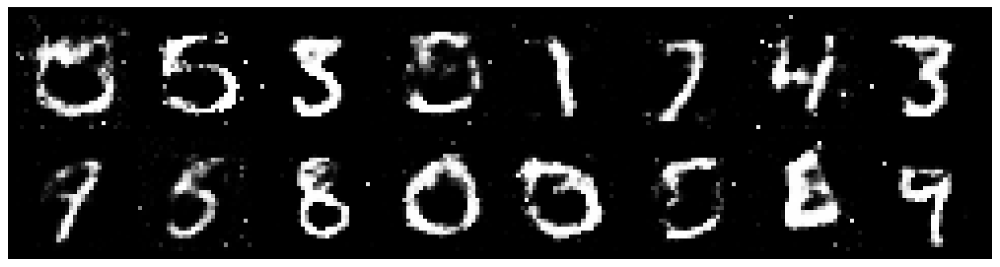

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3506, Generator Loss: 0.8799
D(x): 0.4726, D(G(z)): 0.4134


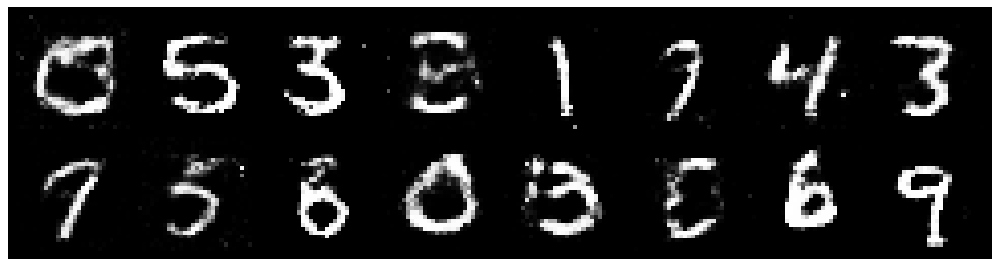

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3139, Generator Loss: 0.8381
D(x): 0.5329, D(G(z)): 0.4620


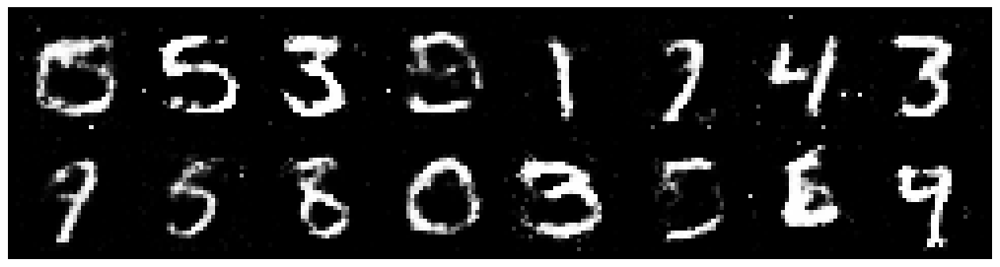

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3027, Generator Loss: 0.8936
D(x): 0.5573, D(G(z)): 0.4528


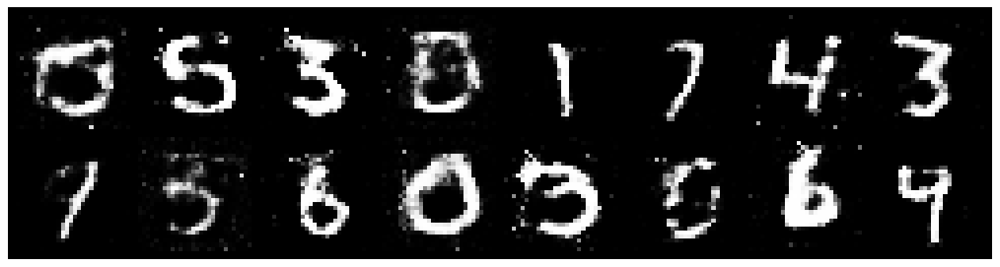

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2551, Generator Loss: 0.9194
D(x): 0.6016, D(G(z)): 0.4498


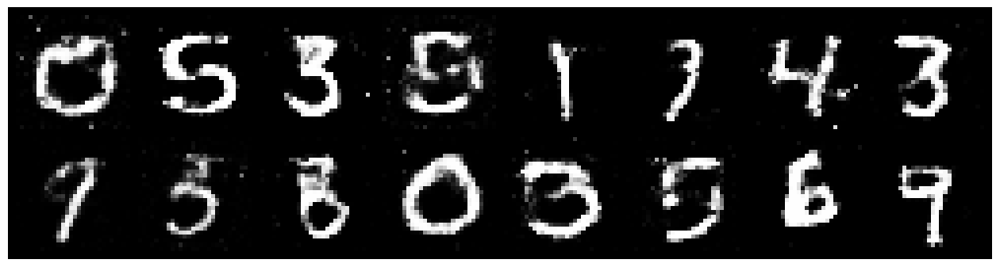

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.1591, Generator Loss: 0.9584
D(x): 0.5681, D(G(z)): 0.3894


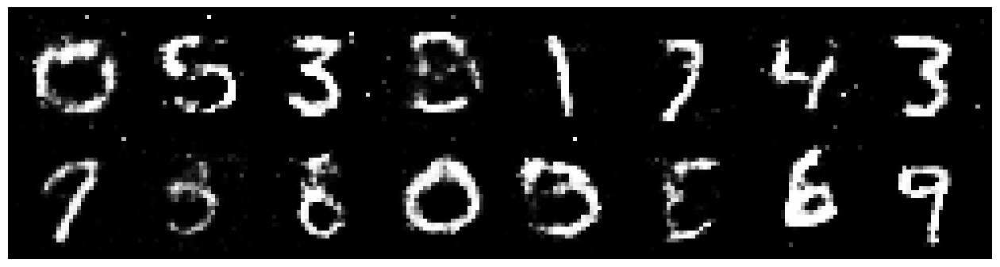

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2742, Generator Loss: 0.8301
D(x): 0.5978, D(G(z)): 0.4815


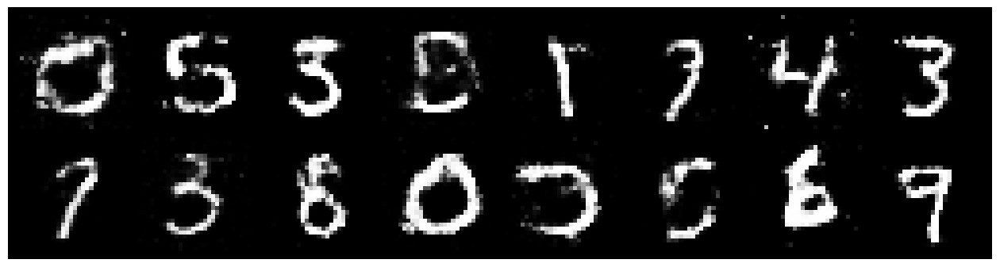

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8785
D(x): 0.5389, D(G(z)): 0.4080


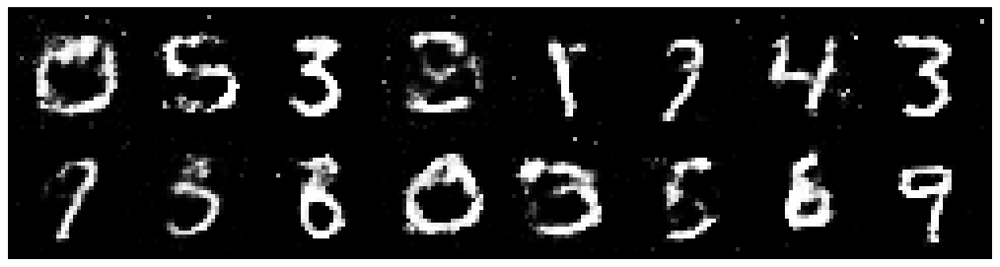

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2616, Generator Loss: 0.8407
D(x): 0.5805, D(G(z)): 0.4550


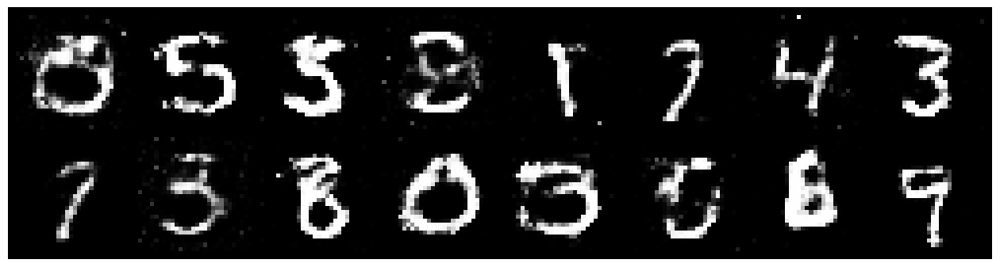

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2061, Generator Loss: 0.9345
D(x): 0.6176, D(G(z)): 0.4627


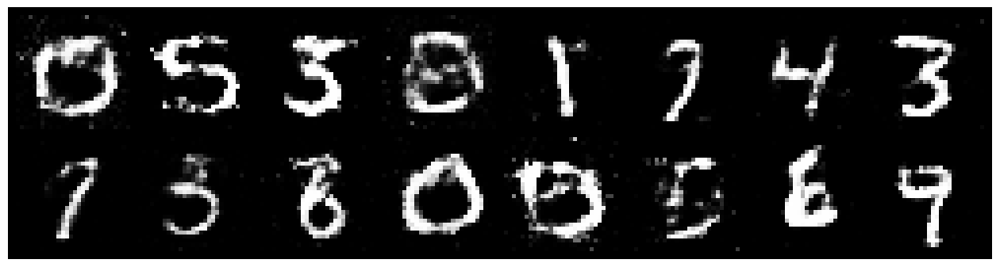

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2703, Generator Loss: 0.8862
D(x): 0.5812, D(G(z)): 0.4676


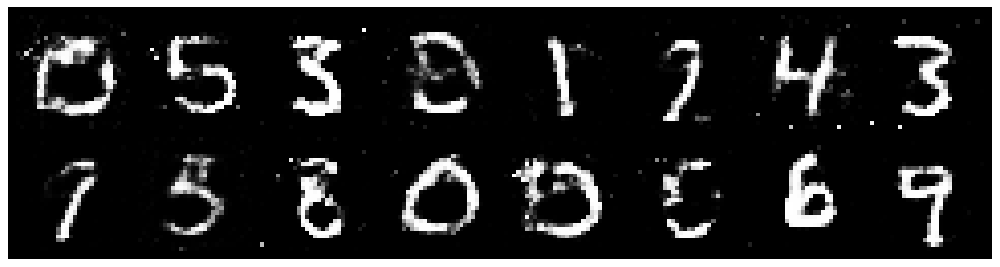

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2393, Generator Loss: 0.9292
D(x): 0.5743, D(G(z)): 0.4374


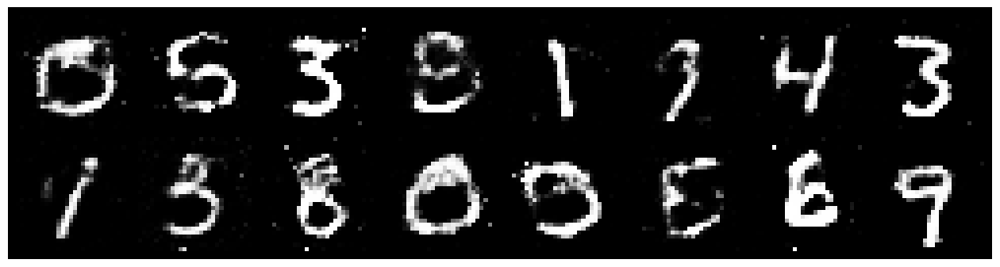

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.3715, Generator Loss: 0.7630
D(x): 0.5546, D(G(z)): 0.4947


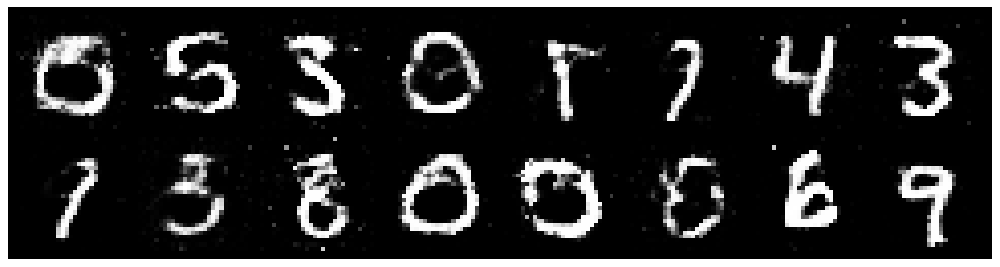

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3033, Generator Loss: 0.8053
D(x): 0.5999, D(G(z)): 0.4904


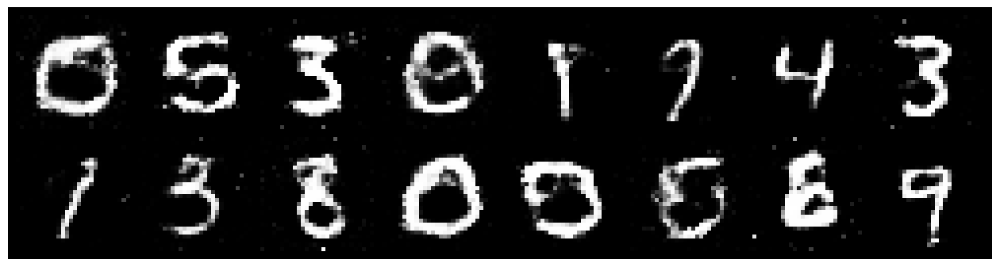

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3040, Generator Loss: 0.9210
D(x): 0.5694, D(G(z)): 0.4688


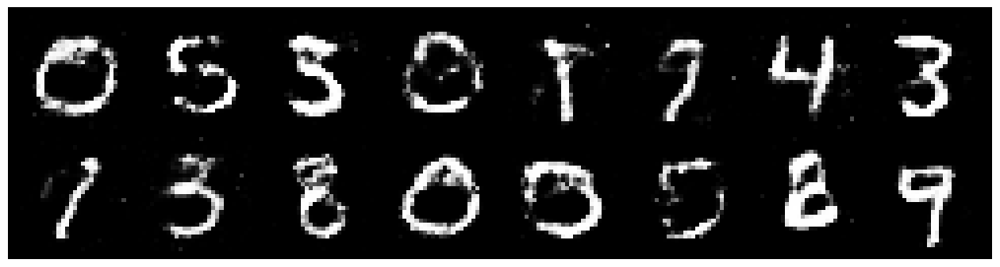

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2250, Generator Loss: 0.9556
D(x): 0.5886, D(G(z)): 0.4290


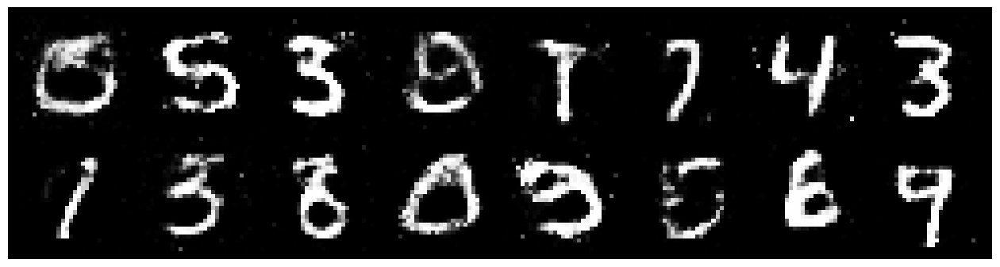

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1465, Generator Loss: 1.0219
D(x): 0.6106, D(G(z)): 0.4143


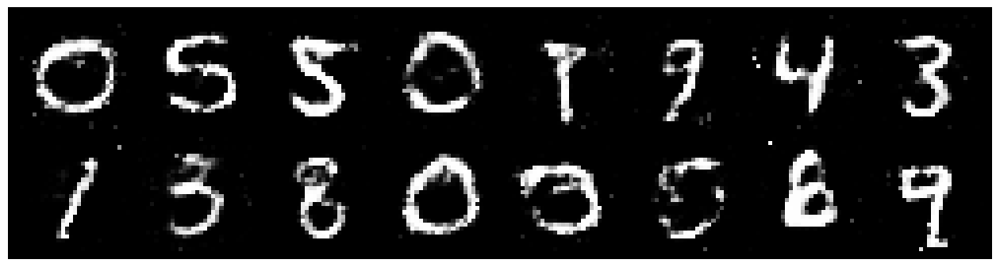

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3002, Generator Loss: 0.8795
D(x): 0.5640, D(G(z)): 0.4709


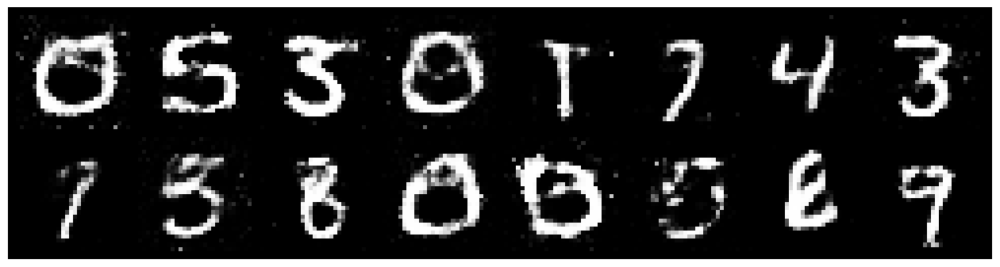

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3075, Generator Loss: 0.9422
D(x): 0.5683, D(G(z)): 0.4463


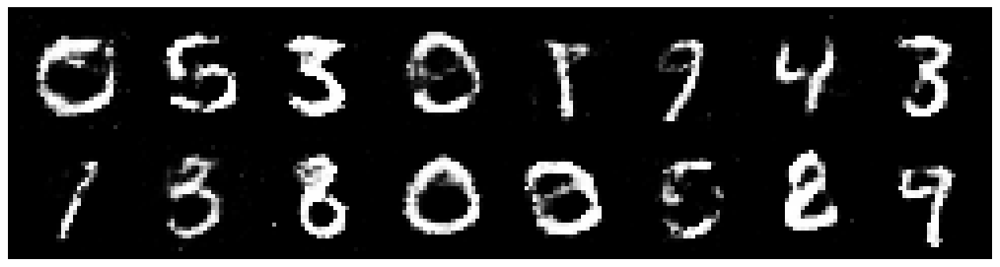

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2217, Generator Loss: 0.9710
D(x): 0.5739, D(G(z)): 0.4388


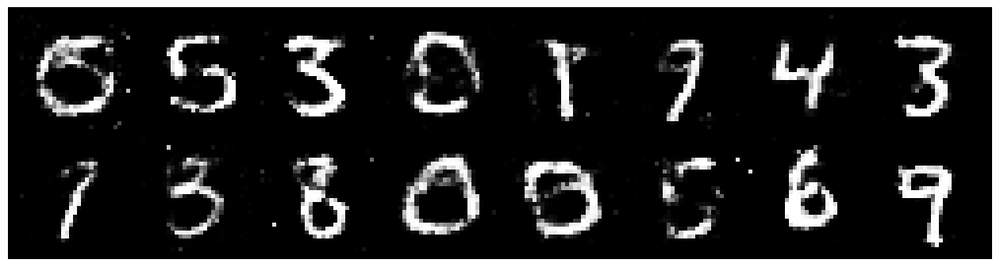

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2342, Generator Loss: 0.8864
D(x): 0.5405, D(G(z)): 0.4210


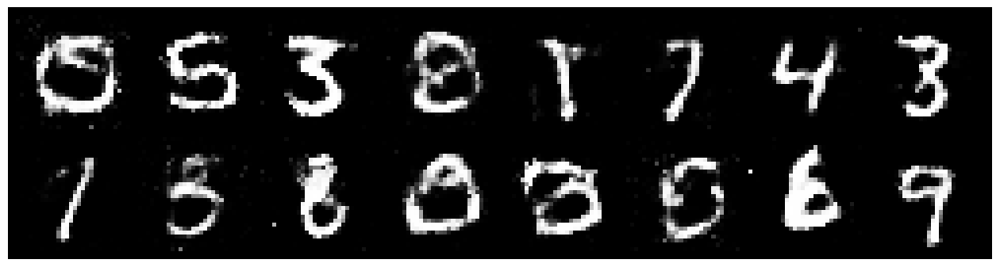

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3317, Generator Loss: 0.9182
D(x): 0.5316, D(G(z)): 0.4394


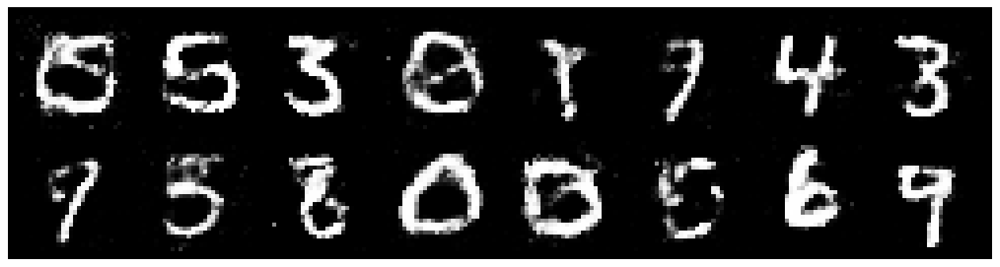

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2254, Generator Loss: 0.7625
D(x): 0.5862, D(G(z)): 0.4665


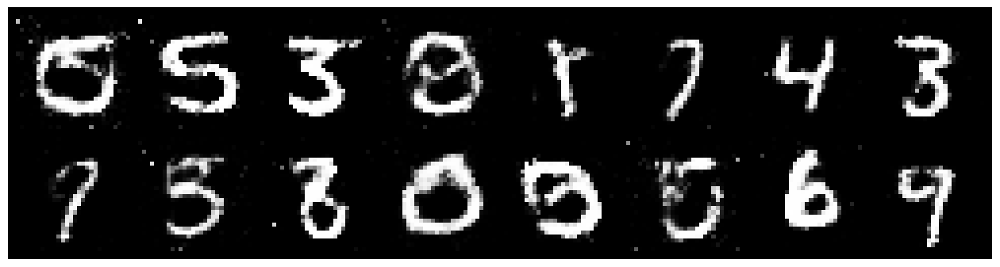

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2076, Generator Loss: 1.1088
D(x): 0.5529, D(G(z)): 0.4146


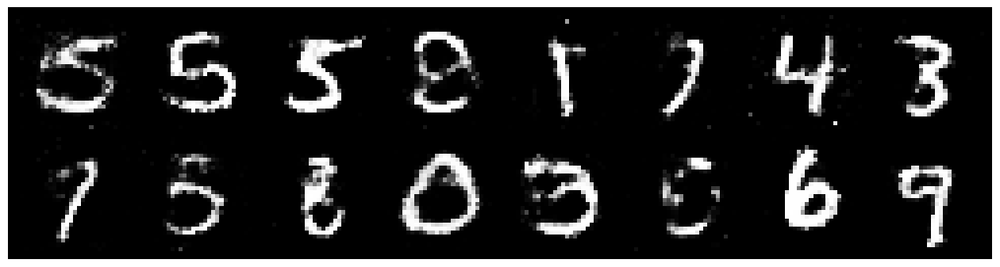

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3121, Generator Loss: 0.9544
D(x): 0.5391, D(G(z)): 0.4478


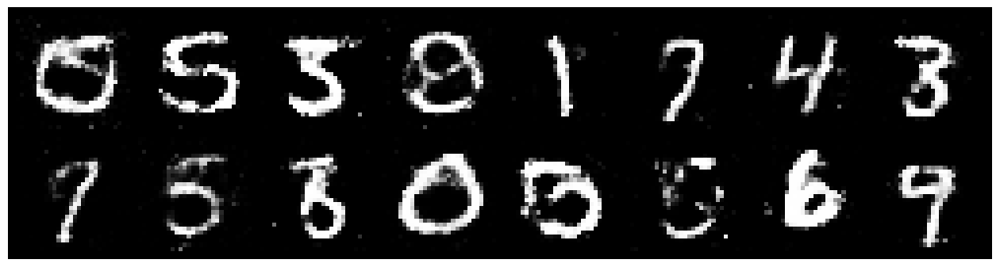

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8461
D(x): 0.5400, D(G(z)): 0.4334


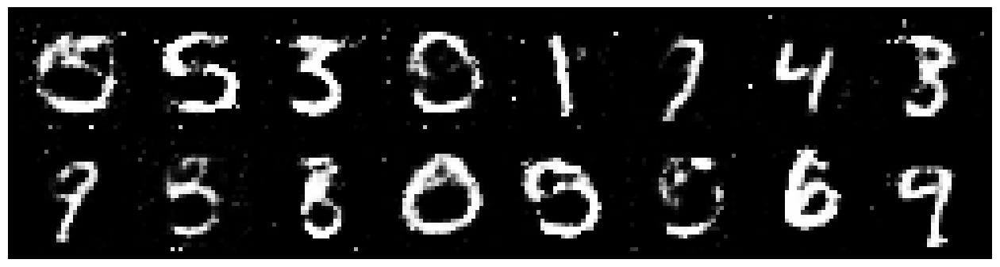

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2679, Generator Loss: 0.9803
D(x): 0.5310, D(G(z)): 0.4128


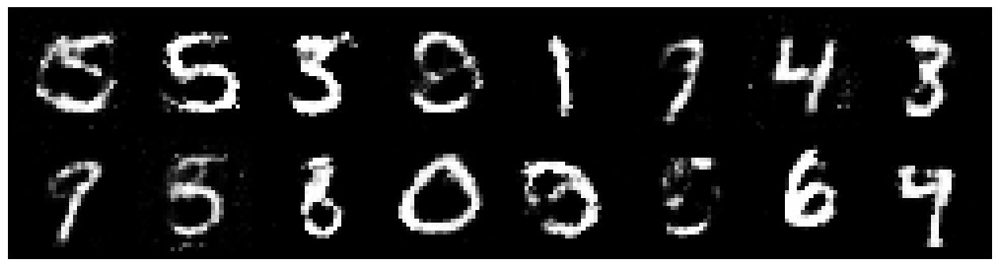

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2836, Generator Loss: 0.9179
D(x): 0.5580, D(G(z)): 0.4476


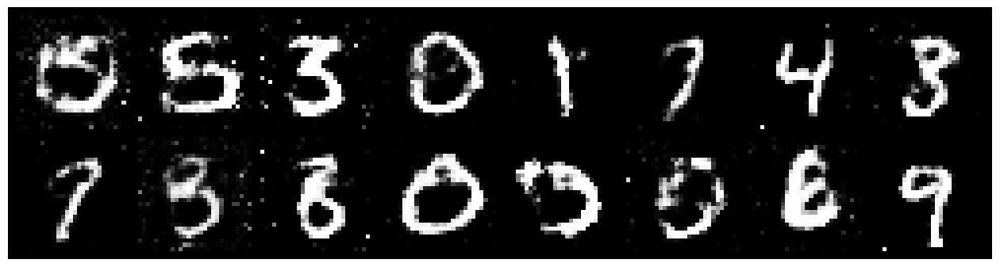

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.3112, Generator Loss: 0.8958
D(x): 0.5166, D(G(z)): 0.4294


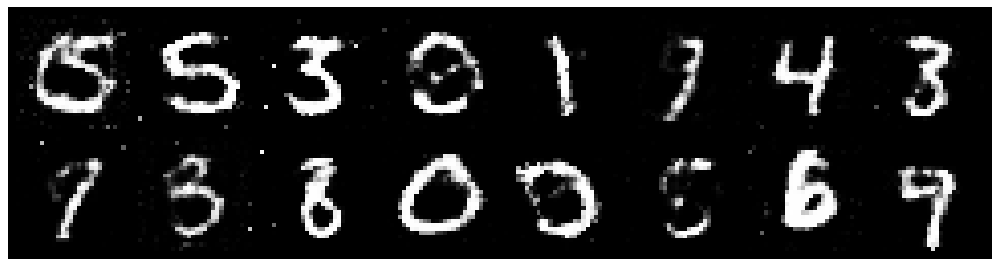

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2559, Generator Loss: 0.8778
D(x): 0.5530, D(G(z)): 0.4348


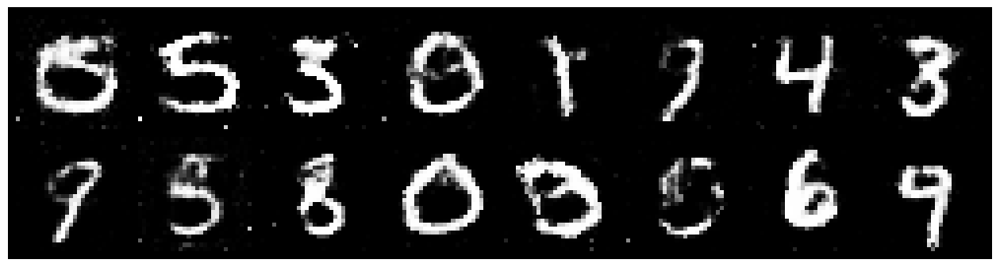

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2407, Generator Loss: 0.9471
D(x): 0.5781, D(G(z)): 0.4415


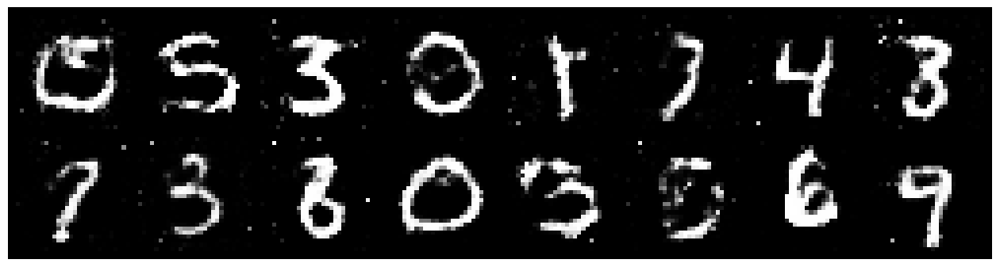

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2466, Generator Loss: 0.9557
D(x): 0.5830, D(G(z)): 0.4354


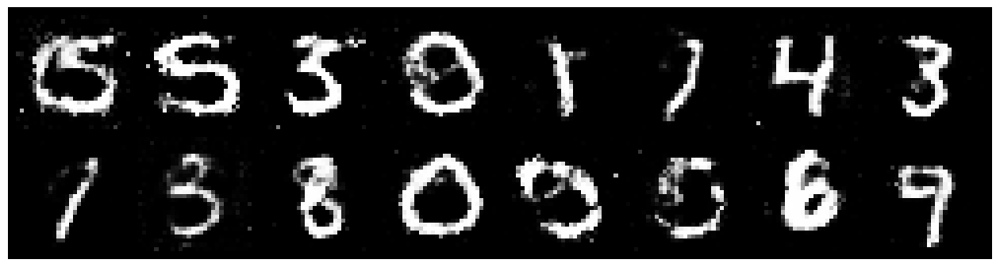

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.1649, Generator Loss: 0.9919
D(x): 0.5522, D(G(z)): 0.3939


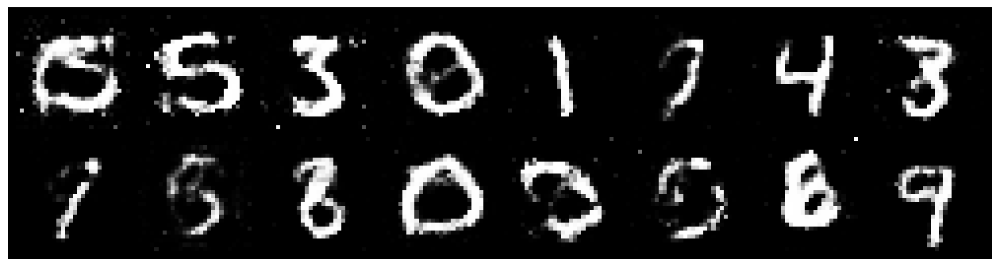

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.3253, Generator Loss: 0.9229
D(x): 0.5239, D(G(z)): 0.4504


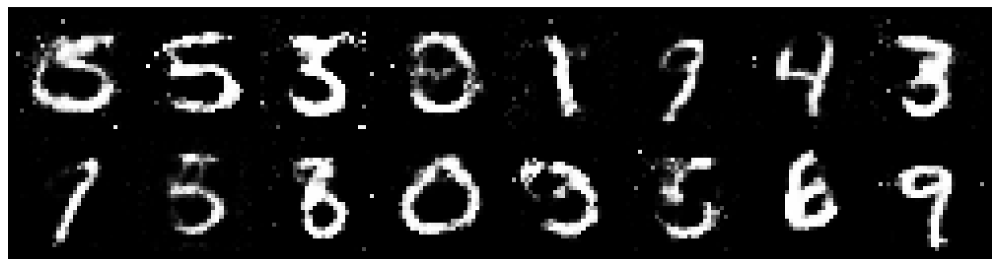

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.3393, Generator Loss: 0.8154
D(x): 0.5331, D(G(z)): 0.4726


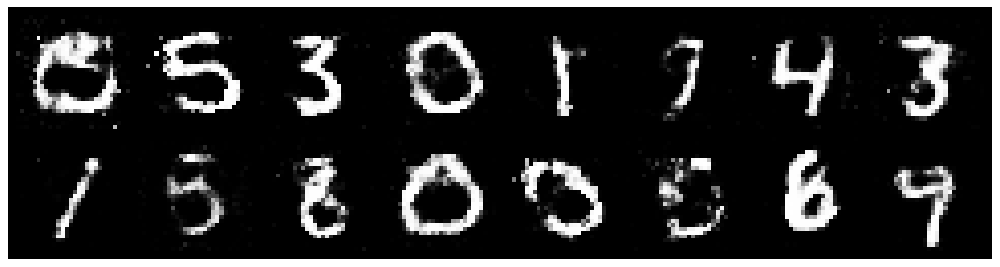

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.3165, Generator Loss: 0.7833
D(x): 0.5975, D(G(z)): 0.5127


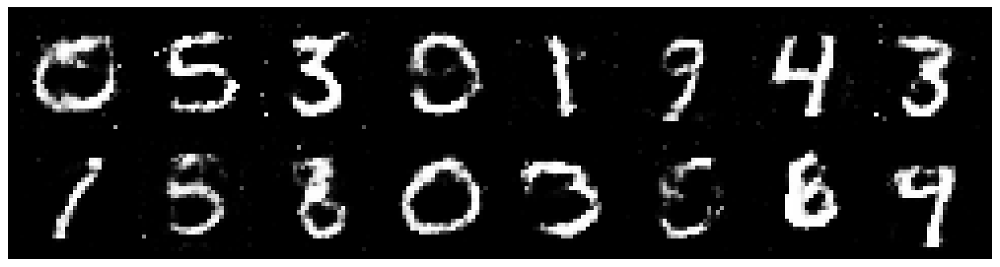

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.5010, Generator Loss: 1.0856
D(x): 0.4985, D(G(z)): 0.4546


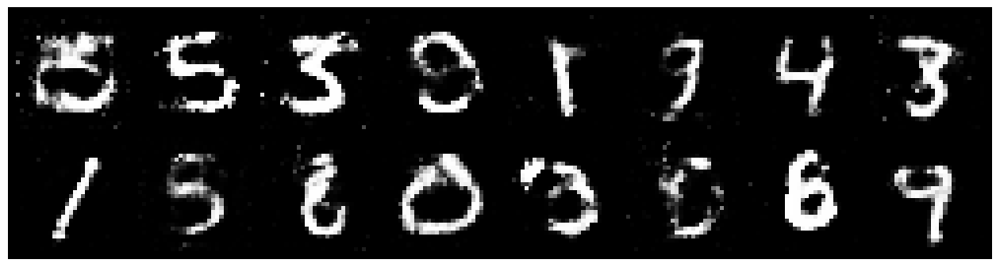

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.3045, Generator Loss: 0.8811
D(x): 0.5550, D(G(z)): 0.4505


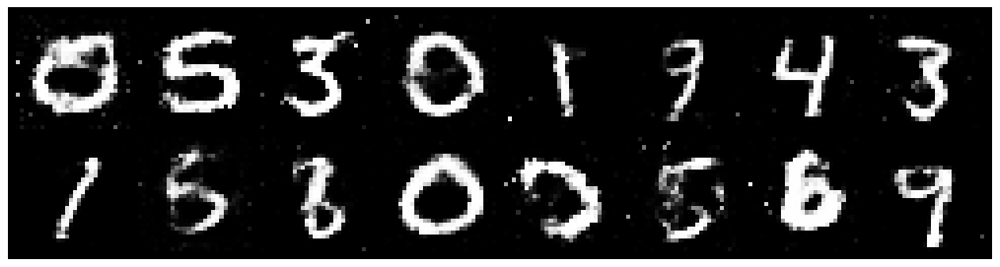

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2172, Generator Loss: 0.8856
D(x): 0.6245, D(G(z)): 0.4578


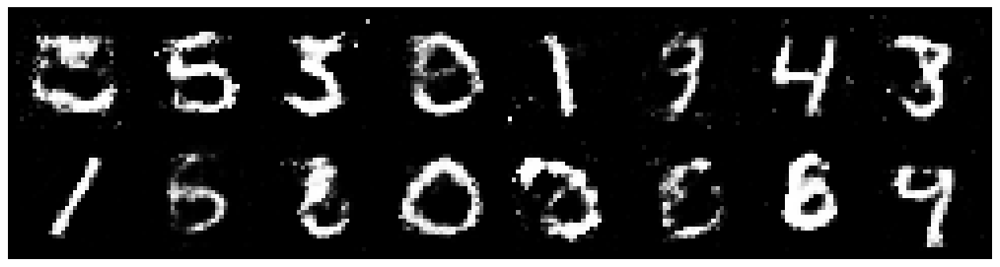

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1909, Generator Loss: 1.0084
D(x): 0.5840, D(G(z)): 0.4273


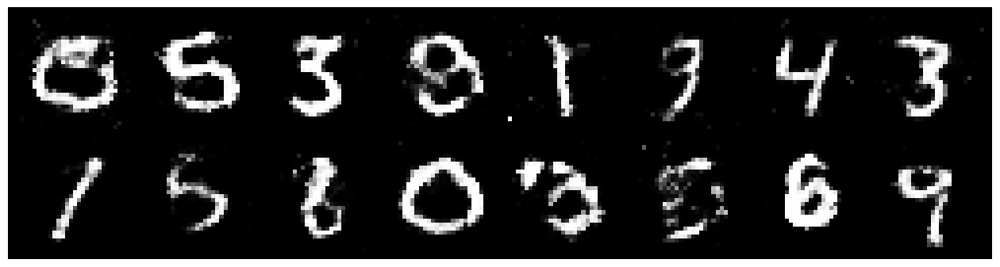

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2250, Generator Loss: 0.9411
D(x): 0.5566, D(G(z)): 0.4363


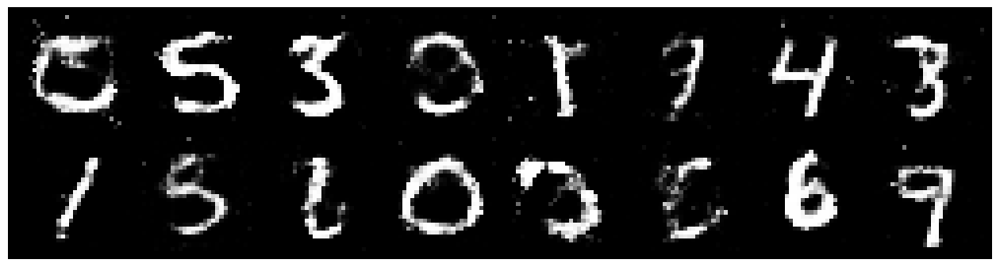

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2330, Generator Loss: 1.0140
D(x): 0.5554, D(G(z)): 0.4265


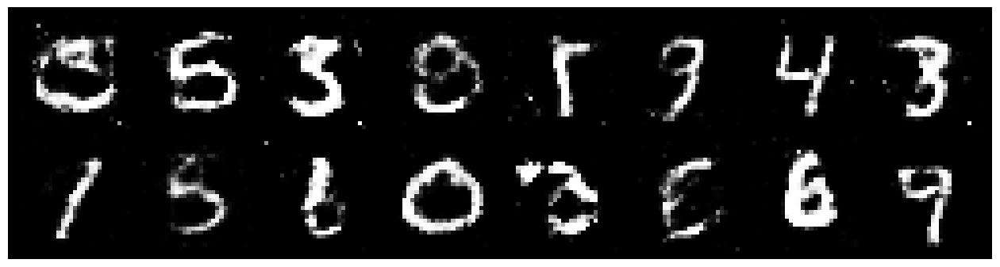

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2908, Generator Loss: 0.8545
D(x): 0.5477, D(G(z)): 0.4418


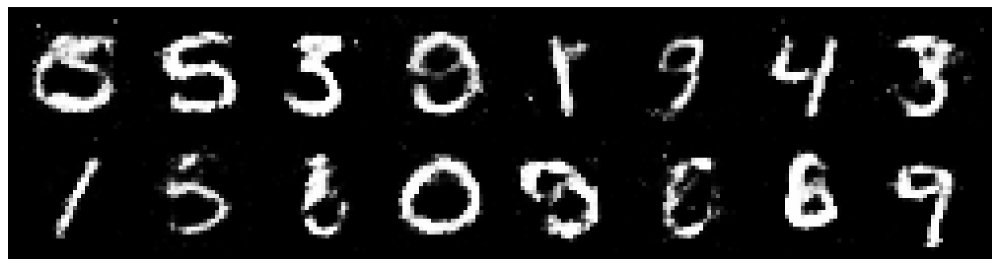

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2464, Generator Loss: 0.8652
D(x): 0.5596, D(G(z)): 0.4458


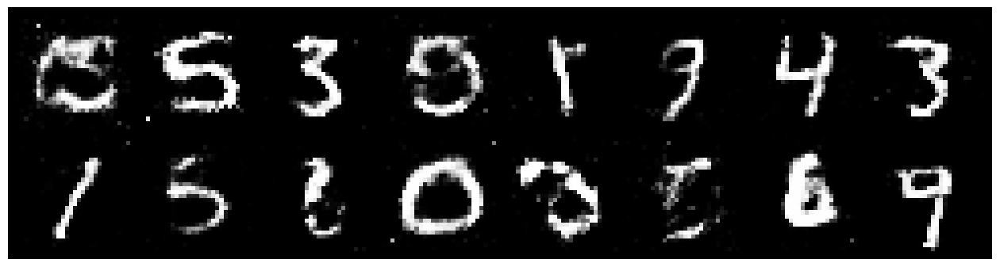

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2967, Generator Loss: 0.8508
D(x): 0.5426, D(G(z)): 0.4594


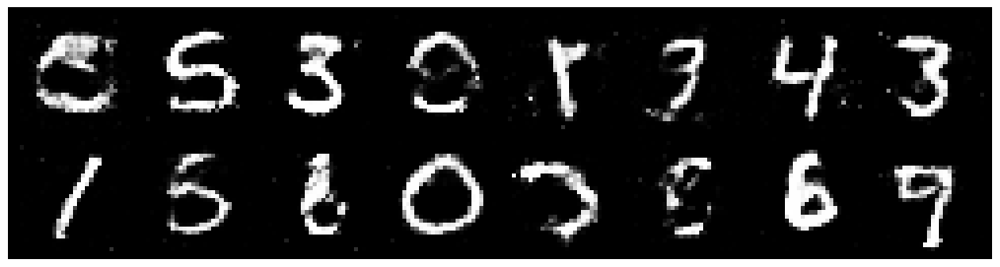

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2528, Generator Loss: 0.9247
D(x): 0.5418, D(G(z)): 0.4201


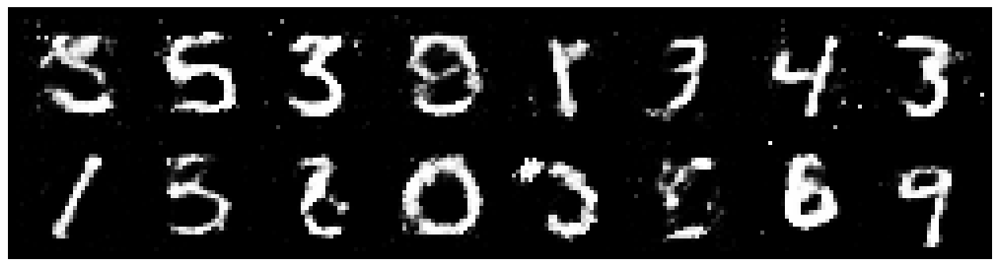

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3612, Generator Loss: 0.8805
D(x): 0.5467, D(G(z)): 0.4818


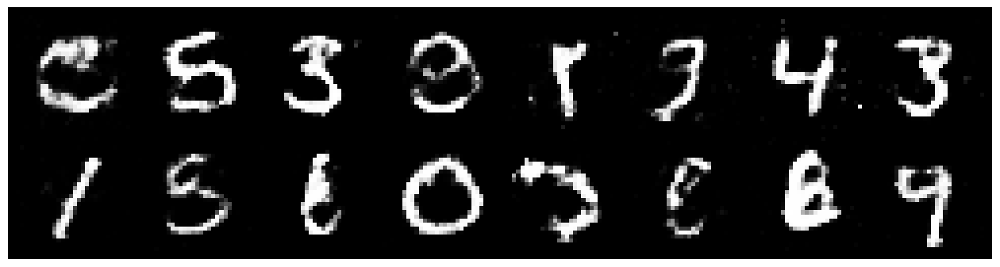

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2445, Generator Loss: 0.7523
D(x): 0.5530, D(G(z)): 0.4308


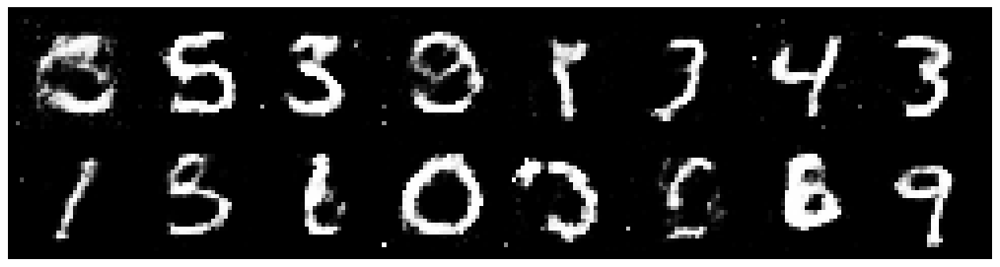

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3613, Generator Loss: 0.7883
D(x): 0.5535, D(G(z)): 0.4818


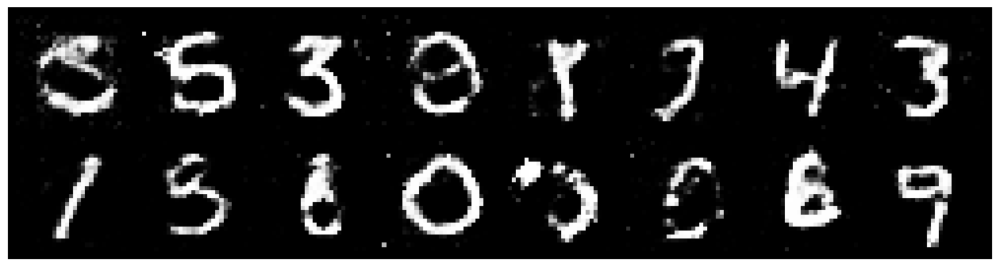

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3641, Generator Loss: 0.8184
D(x): 0.5426, D(G(z)): 0.4614


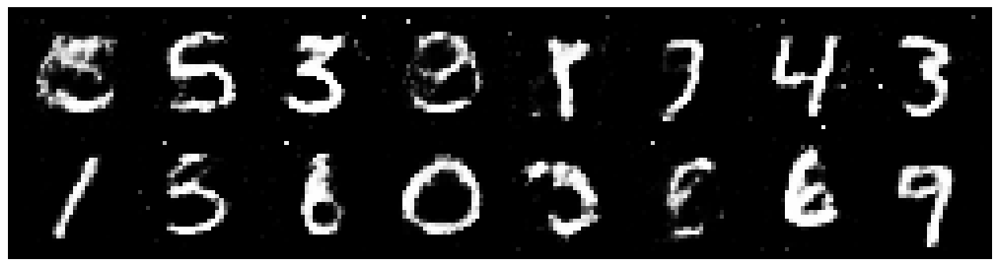

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.3318, Generator Loss: 0.8607
D(x): 0.5638, D(G(z)): 0.4752


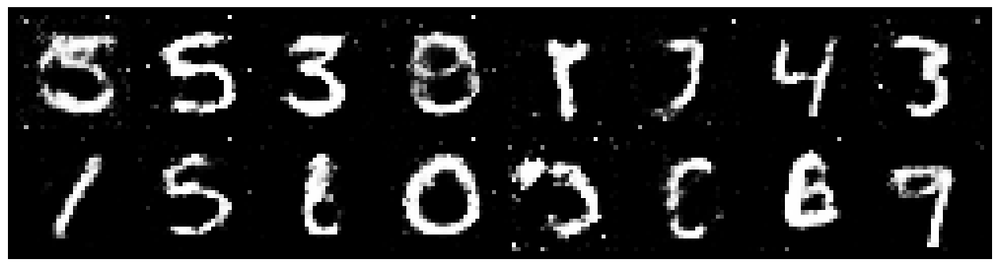

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2560, Generator Loss: 0.9311
D(x): 0.5353, D(G(z)): 0.4149


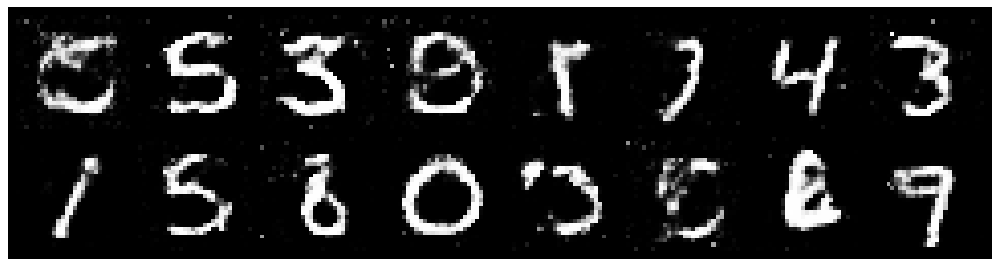

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2641, Generator Loss: 0.9432
D(x): 0.6150, D(G(z)): 0.4705


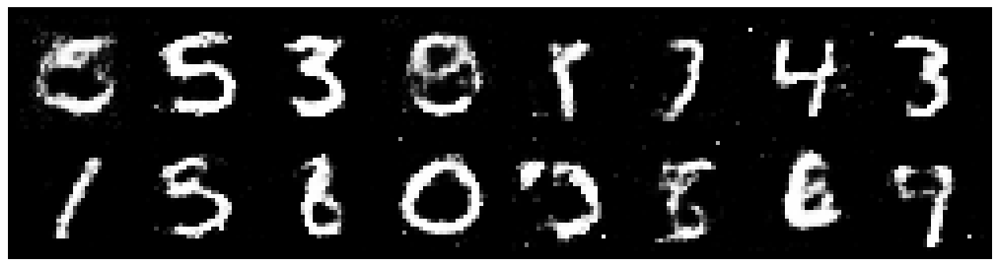

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2302, Generator Loss: 1.0536
D(x): 0.5804, D(G(z)): 0.4384


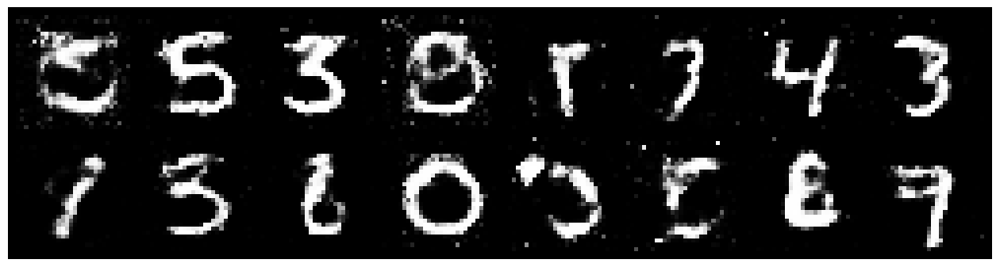

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.3492, Generator Loss: 0.7602
D(x): 0.5776, D(G(z)): 0.4840


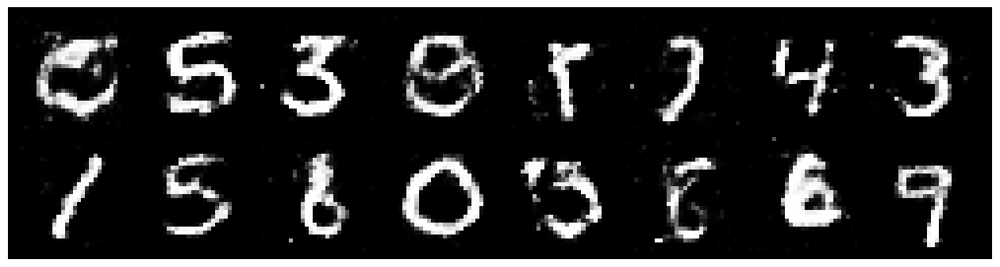

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.3338, Generator Loss: 0.9213
D(x): 0.5341, D(G(z)): 0.4530


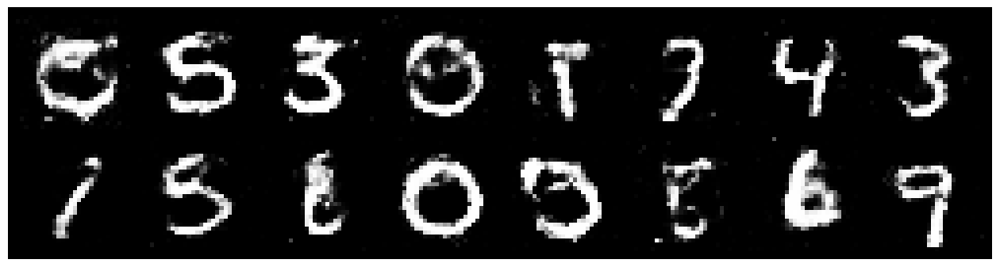

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2734, Generator Loss: 0.7983
D(x): 0.5749, D(G(z)): 0.4697


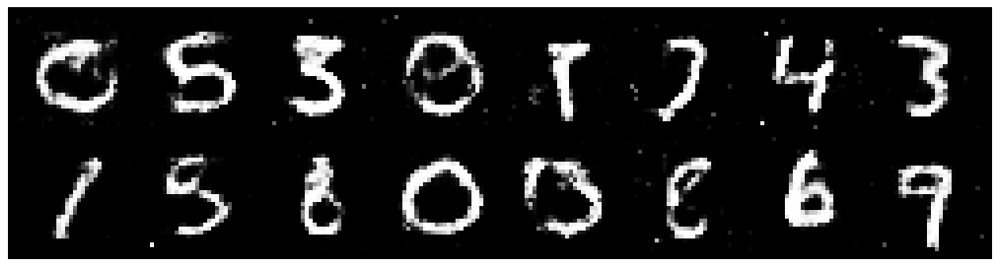

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9106
D(x): 0.5859, D(G(z)): 0.4605


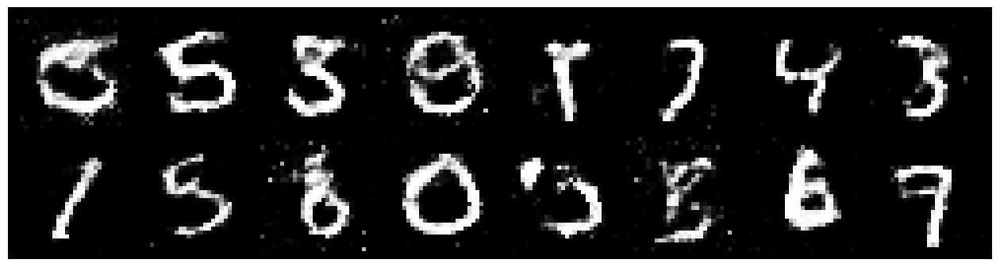

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2284, Generator Loss: 1.0020
D(x): 0.5531, D(G(z)): 0.4057


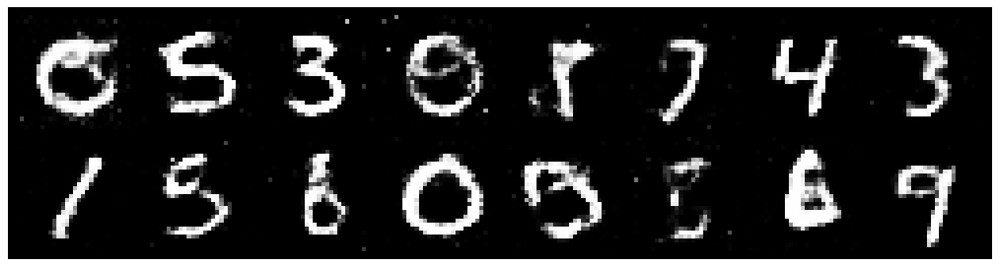

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2107, Generator Loss: 1.0072
D(x): 0.5528, D(G(z)): 0.4158


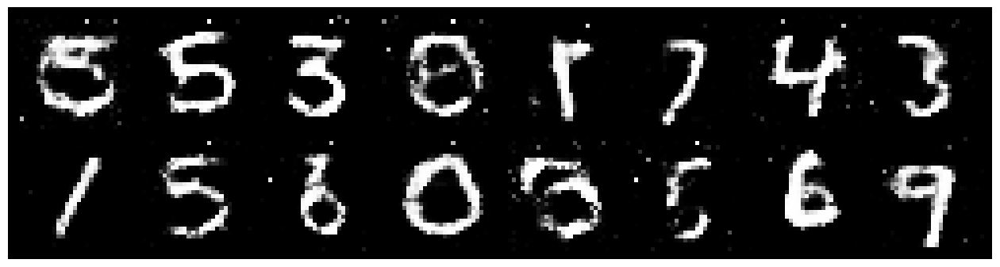

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2031, Generator Loss: 1.0218
D(x): 0.5300, D(G(z)): 0.3914


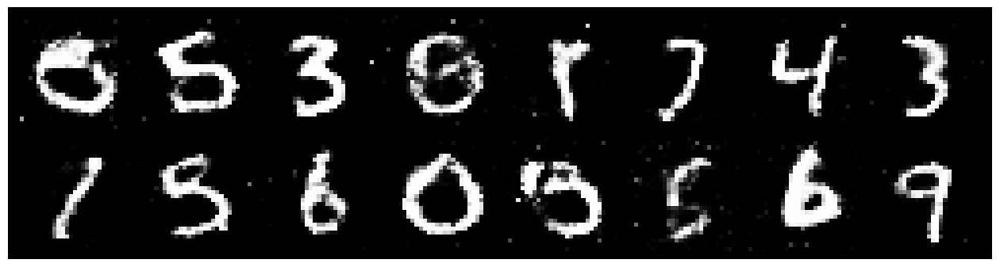

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2190, Generator Loss: 0.9214
D(x): 0.5506, D(G(z)): 0.4235


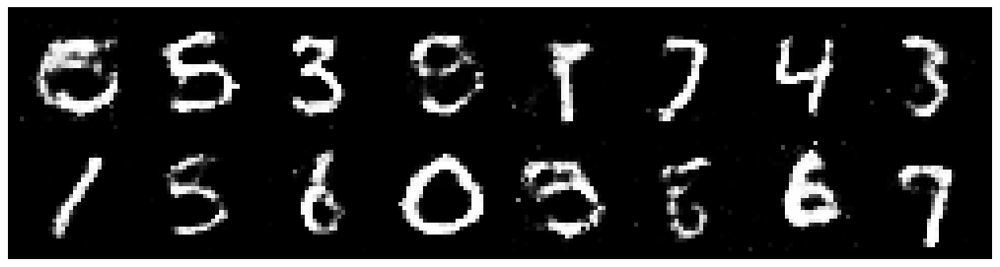

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3063, Generator Loss: 0.9061
D(x): 0.5529, D(G(z)): 0.4720


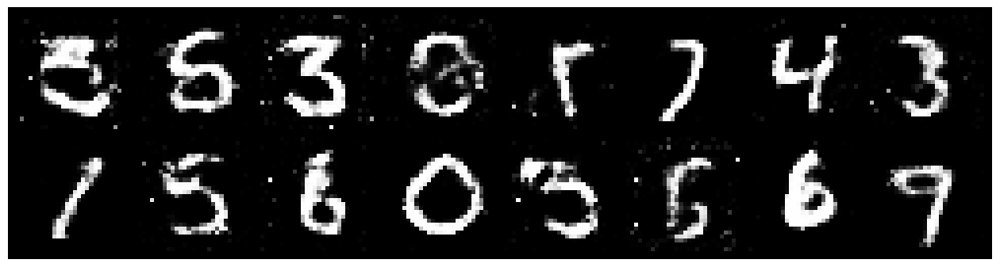

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8569
D(x): 0.5413, D(G(z)): 0.4537


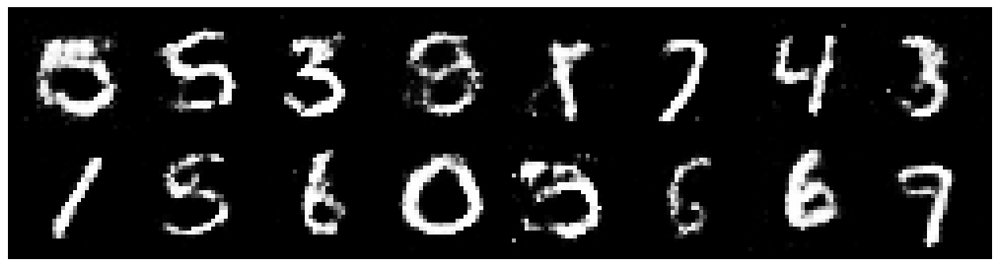

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8699
D(x): 0.5391, D(G(z)): 0.4499


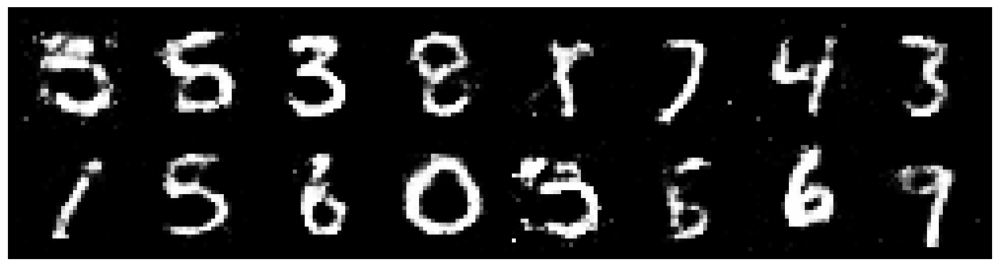

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3485, Generator Loss: 0.7589
D(x): 0.5306, D(G(z)): 0.4550


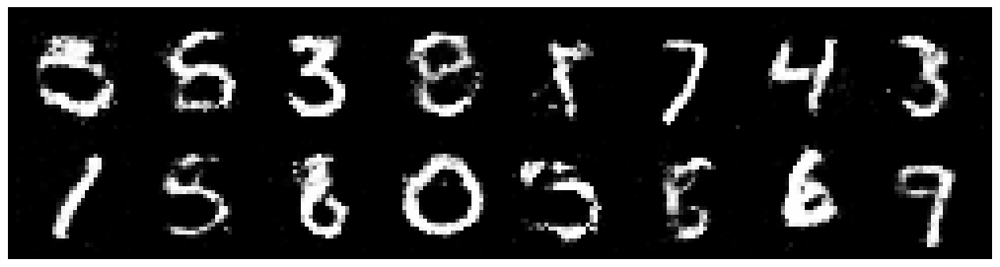

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2906, Generator Loss: 0.9535
D(x): 0.5410, D(G(z)): 0.4452


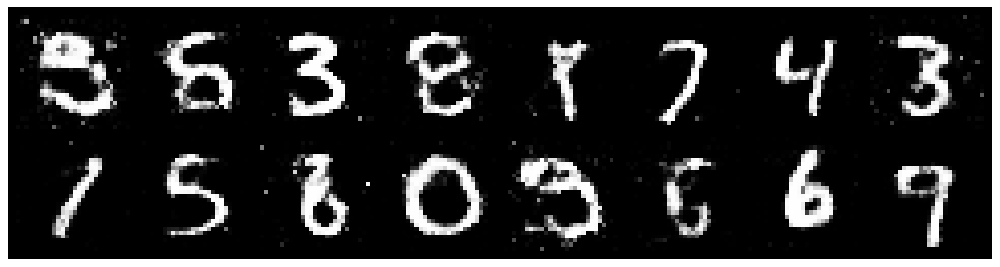

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.1810, Generator Loss: 0.9578
D(x): 0.5509, D(G(z)): 0.3872


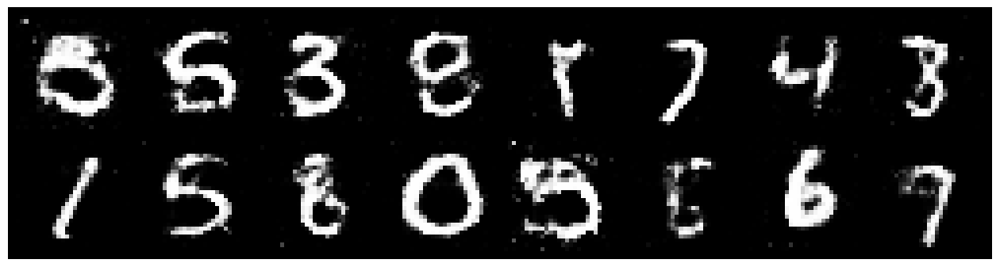

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2101, Generator Loss: 0.8077
D(x): 0.5758, D(G(z)): 0.4490


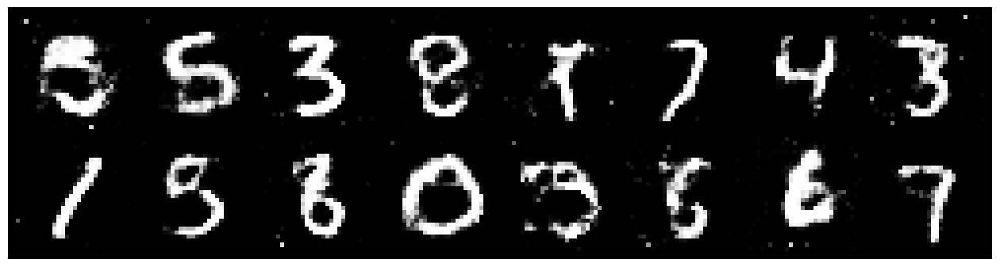

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2893, Generator Loss: 0.8790
D(x): 0.4941, D(G(z)): 0.3925


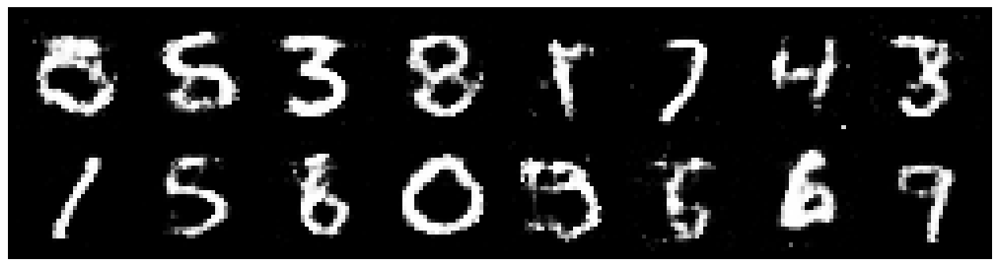

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3100, Generator Loss: 0.9077
D(x): 0.5573, D(G(z)): 0.4477


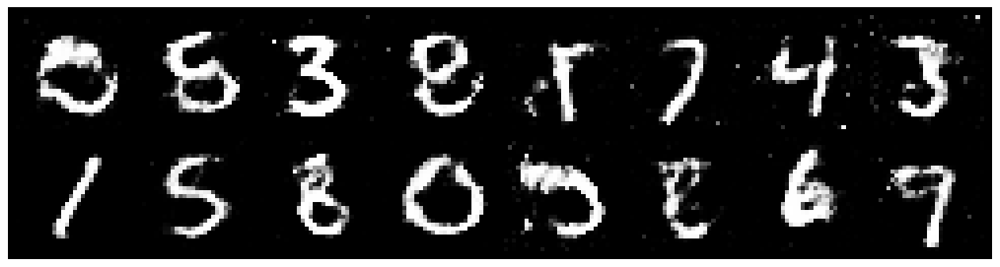

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9032
D(x): 0.5785, D(G(z)): 0.4450


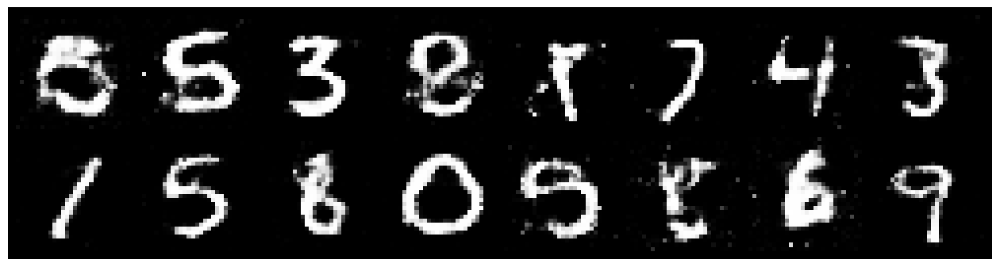

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2087, Generator Loss: 0.8927
D(x): 0.5816, D(G(z)): 0.4381


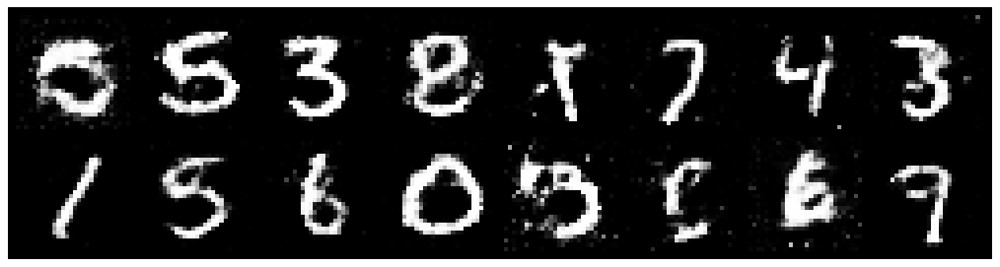

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2821, Generator Loss: 0.8410
D(x): 0.5668, D(G(z)): 0.4636


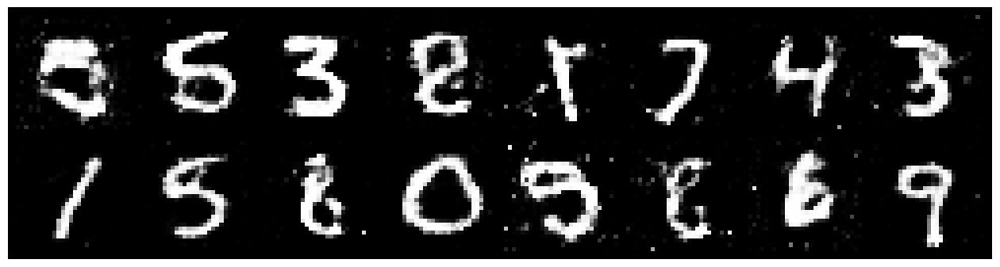

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.3491, Generator Loss: 0.8329
D(x): 0.5326, D(G(z)): 0.4719


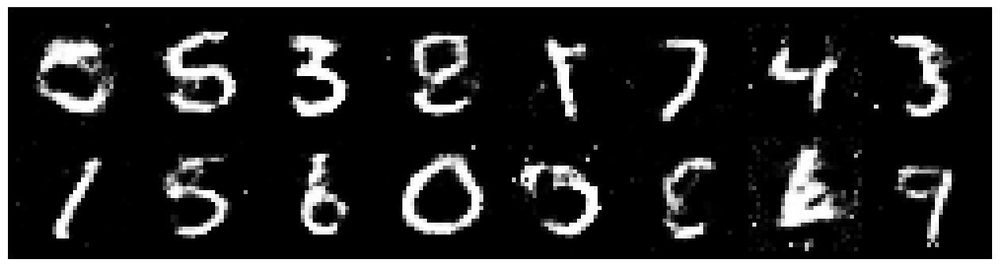

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3359, Generator Loss: 0.7541
D(x): 0.5598, D(G(z)): 0.4796


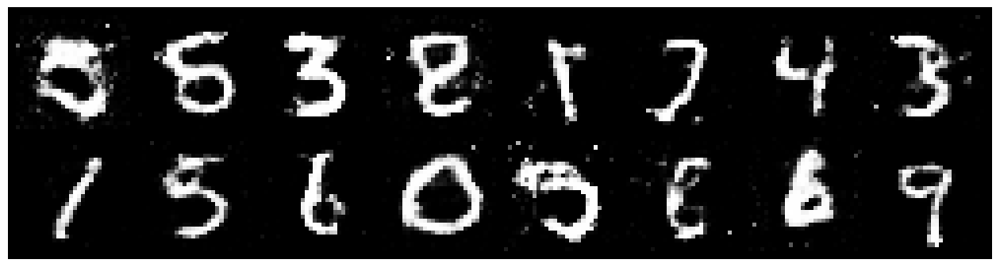

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3536, Generator Loss: 0.8566
D(x): 0.5884, D(G(z)): 0.4999


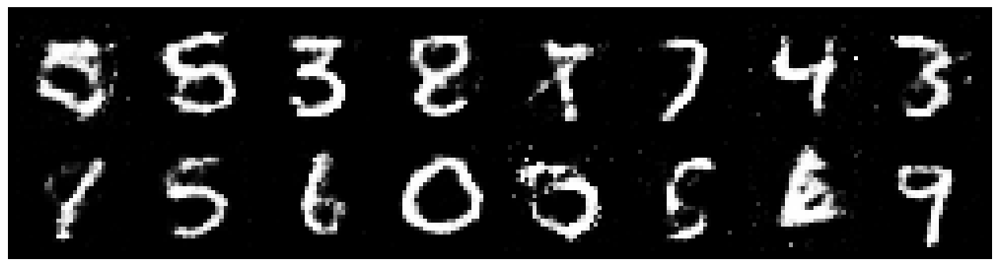

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.4495, Generator Loss: 0.7827
D(x): 0.5228, D(G(z)): 0.4975


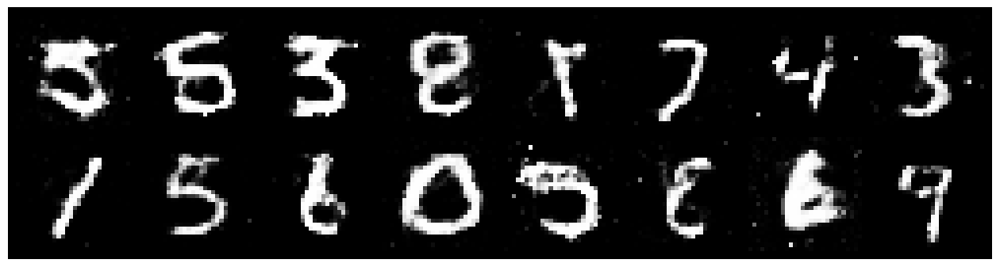

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.3327, Generator Loss: 0.8884
D(x): 0.5597, D(G(z)): 0.4702


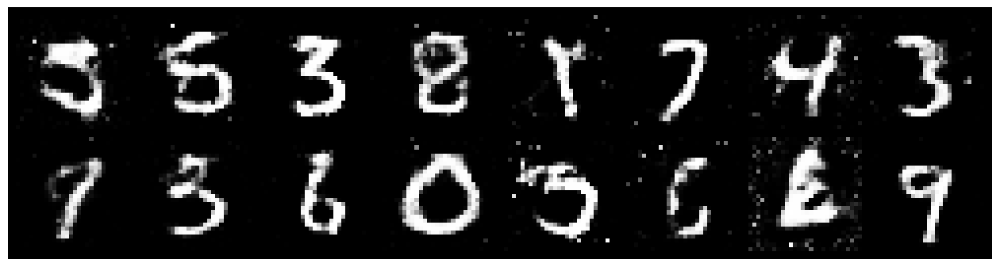

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.3188, Generator Loss: 0.7793
D(x): 0.5485, D(G(z)): 0.4729


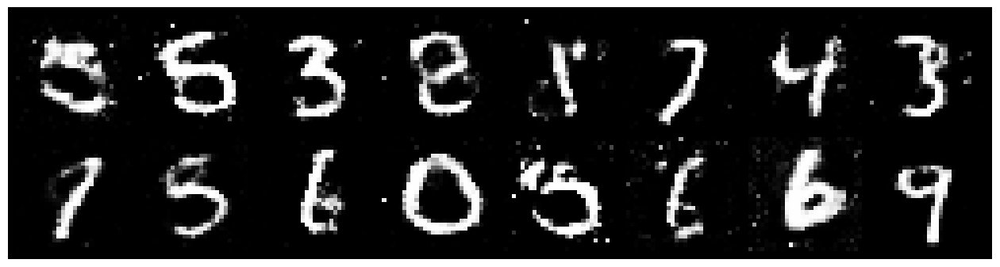

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2696, Generator Loss: 0.8488
D(x): 0.5518, D(G(z)): 0.4576


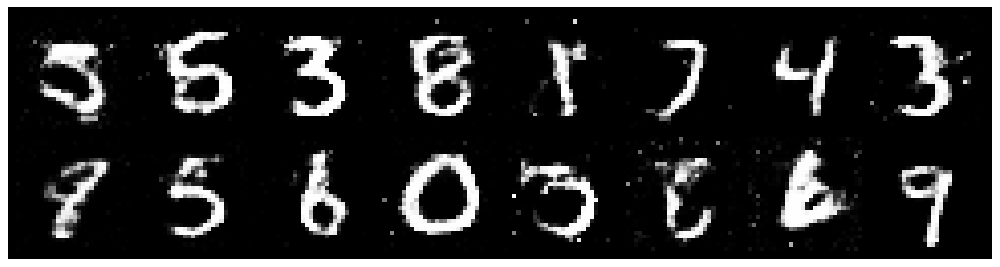

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.2840, Generator Loss: 0.8713
D(x): 0.5293, D(G(z)): 0.4293


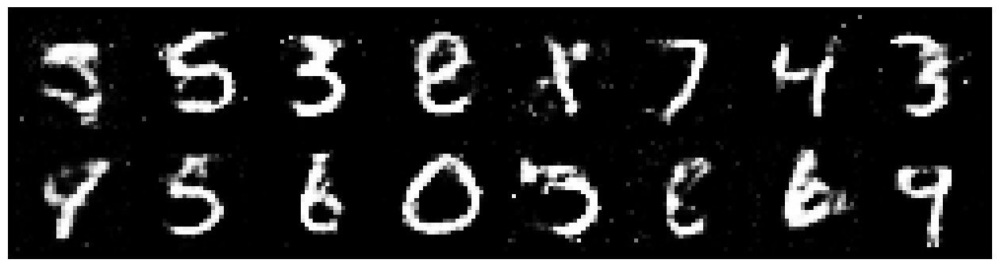

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2308, Generator Loss: 0.8657
D(x): 0.5682, D(G(z)): 0.4342


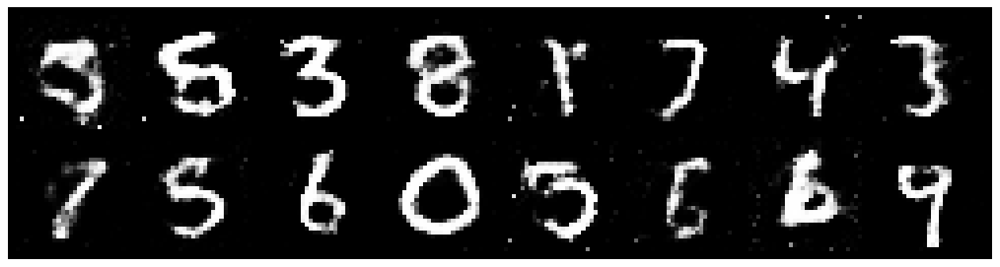

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2795, Generator Loss: 1.0238
D(x): 0.5991, D(G(z)): 0.4699


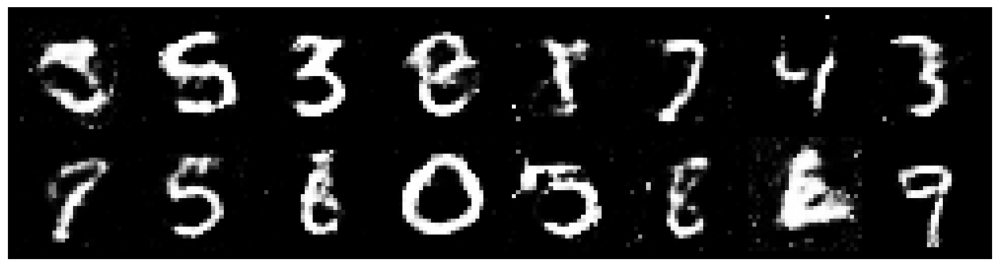

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.1665, Generator Loss: 1.0489
D(x): 0.5749, D(G(z)): 0.4030


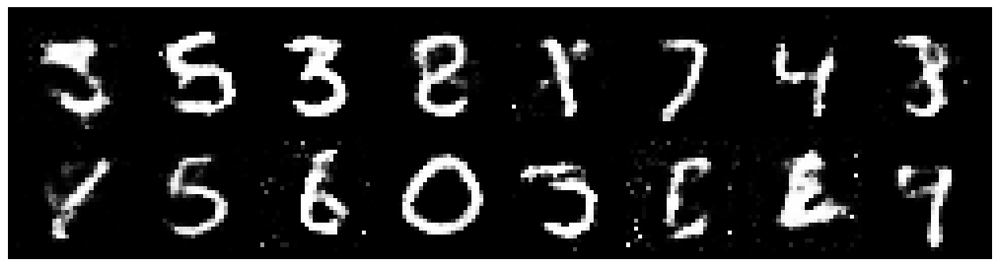

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3431, Generator Loss: 1.1549
D(x): 0.5542, D(G(z)): 0.4193


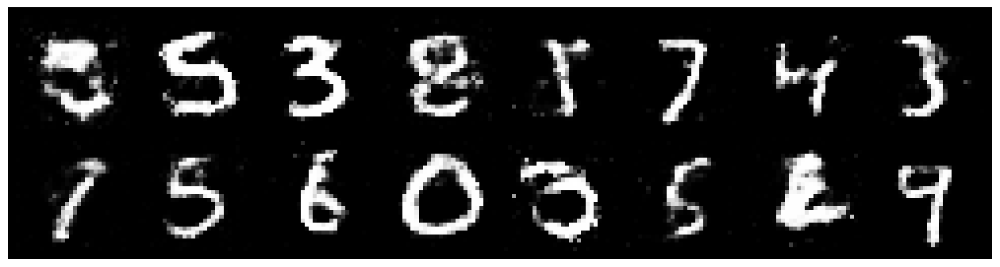

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2202, Generator Loss: 0.9203
D(x): 0.5648, D(G(z)): 0.4172


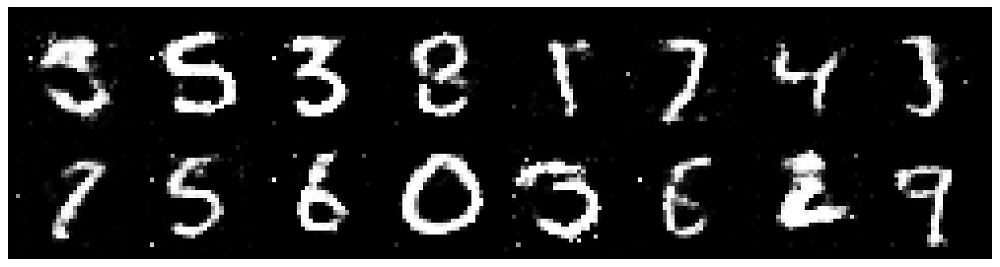

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2693, Generator Loss: 0.9783
D(x): 0.5899, D(G(z)): 0.4402


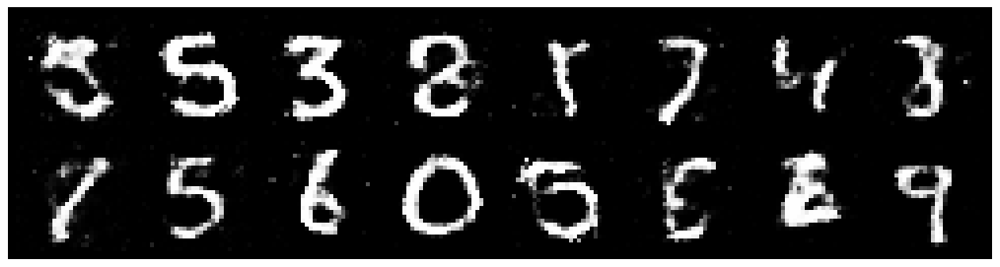

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2030, Generator Loss: 1.0099
D(x): 0.5846, D(G(z)): 0.4204


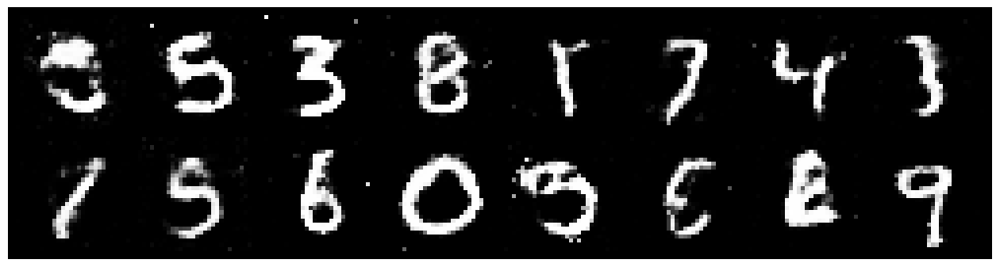

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3254, Generator Loss: 0.8687
D(x): 0.5521, D(G(z)): 0.4786


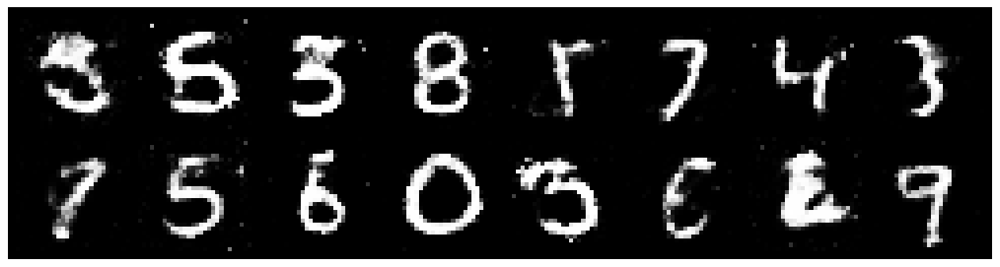

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.1748, Generator Loss: 0.8958
D(x): 0.5857, D(G(z)): 0.4302


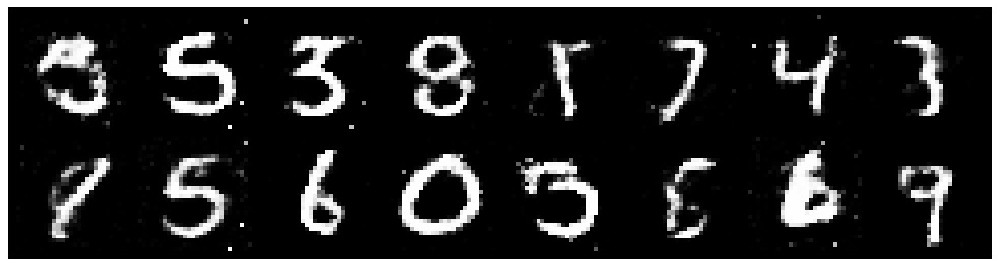

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3351, Generator Loss: 0.9471
D(x): 0.5341, D(G(z)): 0.4484


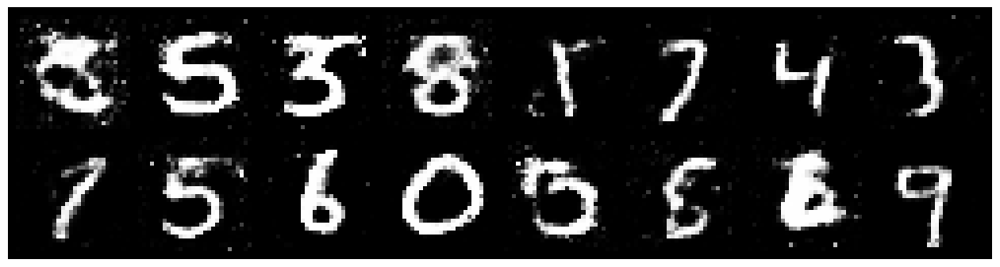

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2920, Generator Loss: 0.9155
D(x): 0.5190, D(G(z)): 0.4288


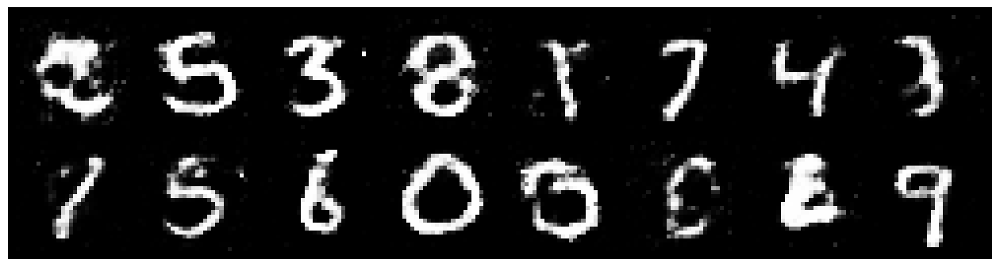

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8889
D(x): 0.5426, D(G(z)): 0.4519


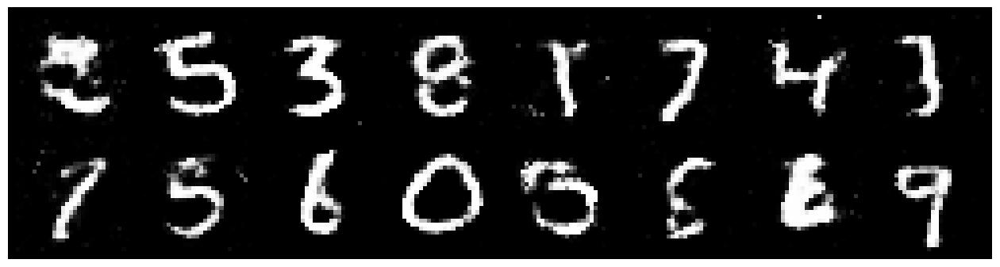

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2388, Generator Loss: 0.9113
D(x): 0.5460, D(G(z)): 0.4177


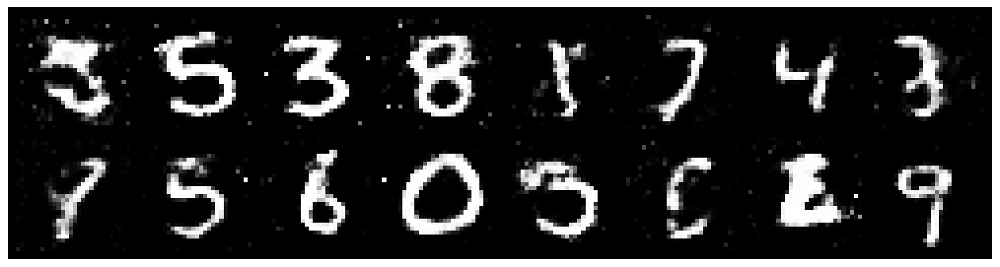

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2691, Generator Loss: 0.9721
D(x): 0.5300, D(G(z)): 0.4165


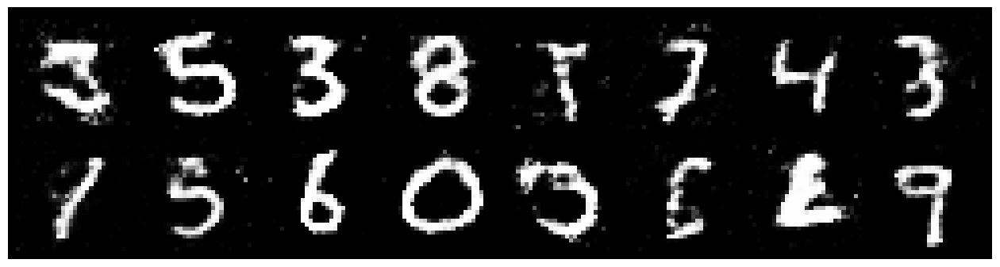

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.1991, Generator Loss: 1.0157
D(x): 0.6151, D(G(z)): 0.4361


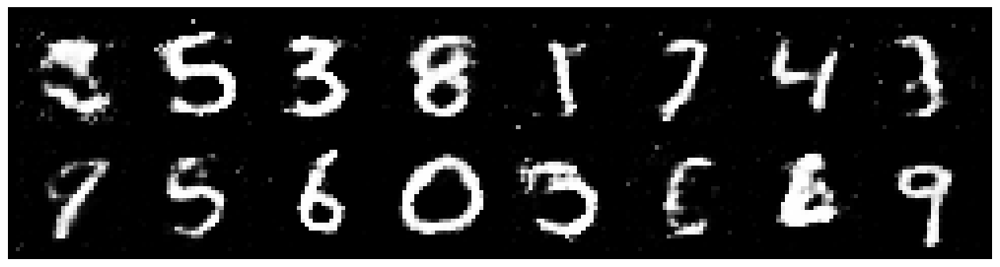

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2560, Generator Loss: 0.9263
D(x): 0.5768, D(G(z)): 0.4202


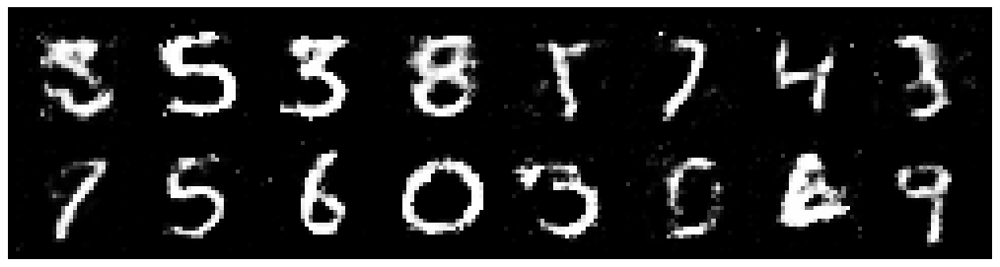

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.3559, Generator Loss: 0.7672
D(x): 0.5869, D(G(z)): 0.5035


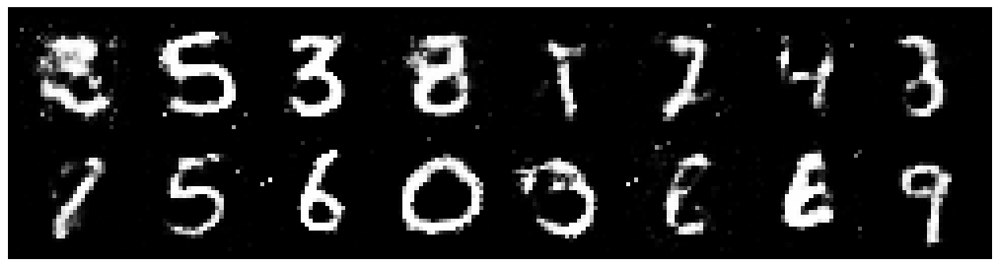

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2794, Generator Loss: 0.8722
D(x): 0.5668, D(G(z)): 0.4620


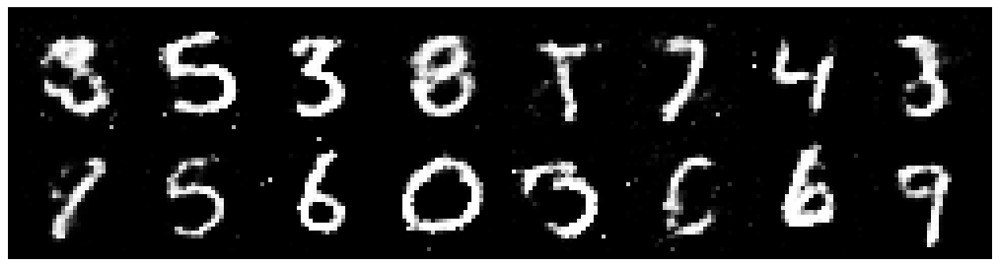

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.4179, Generator Loss: 0.9066
D(x): 0.5176, D(G(z)): 0.4781


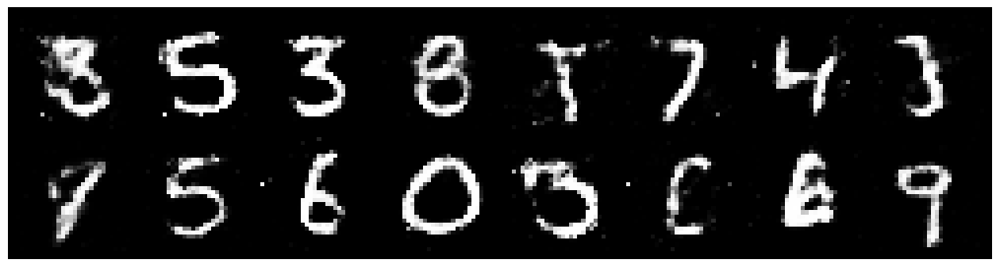

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3180, Generator Loss: 0.9935
D(x): 0.4993, D(G(z)): 0.4024


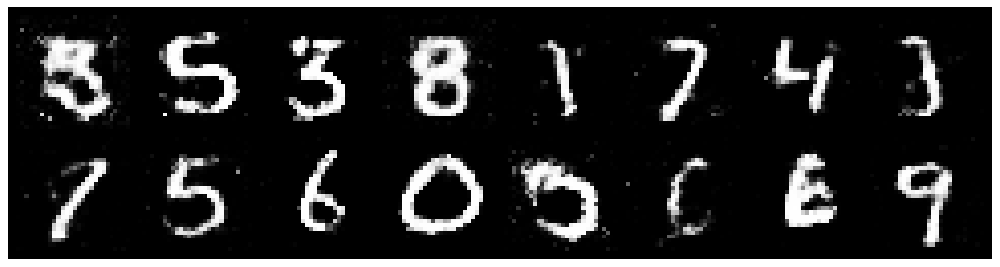

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2382, Generator Loss: 0.9293
D(x): 0.5427, D(G(z)): 0.4238


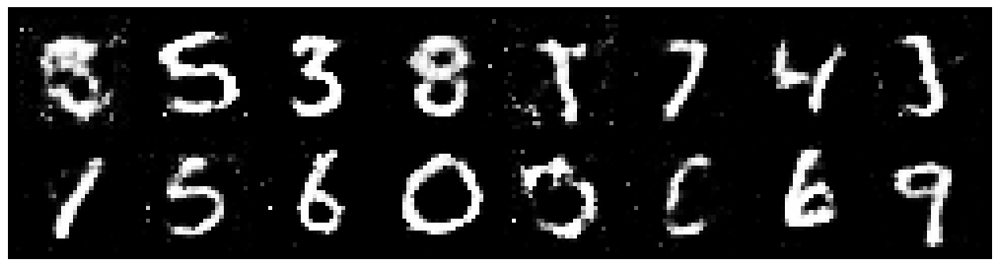

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.1768, Generator Loss: 0.9271
D(x): 0.5816, D(G(z)): 0.4231


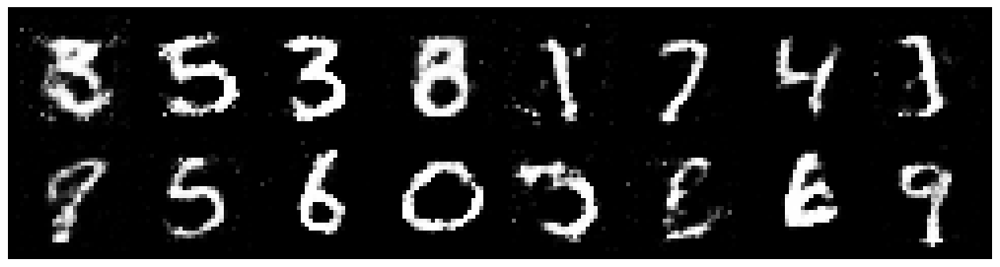

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.1400, Generator Loss: 0.9729
D(x): 0.6442, D(G(z)): 0.4298


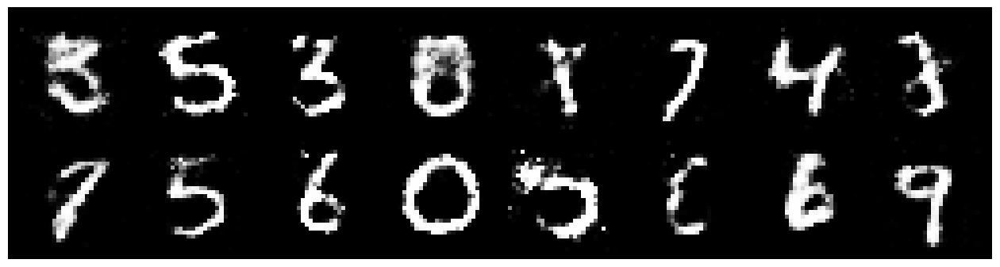

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.3298, Generator Loss: 0.8278
D(x): 0.5610, D(G(z)): 0.4757


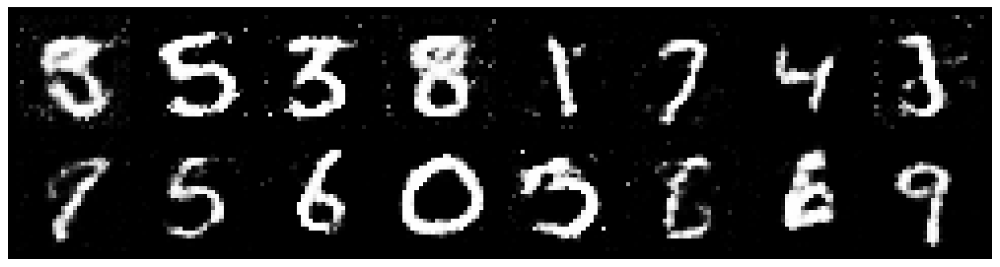

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2006, Generator Loss: 0.9765
D(x): 0.5465, D(G(z)): 0.3926


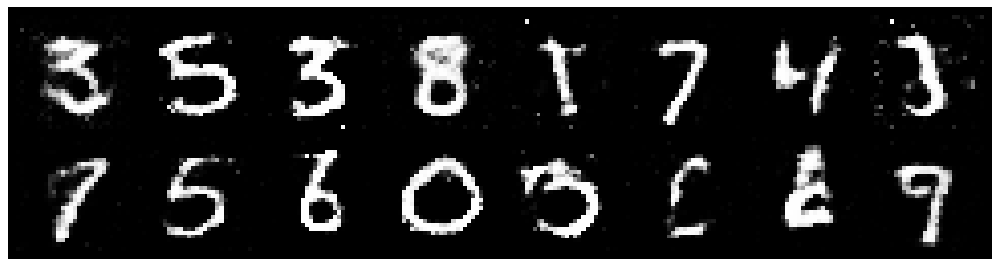

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2467, Generator Loss: 1.0796
D(x): 0.5684, D(G(z)): 0.4246


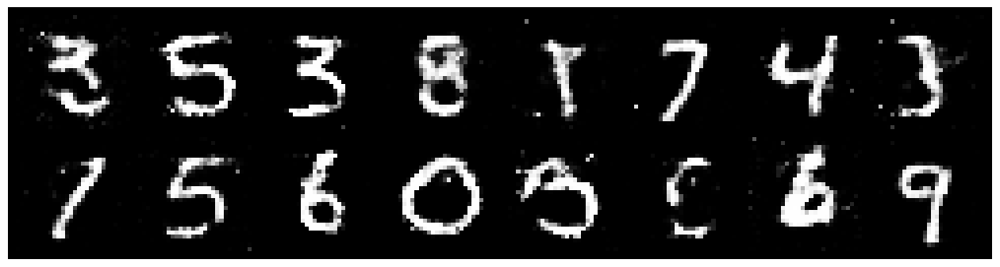

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3000, Generator Loss: 0.8950
D(x): 0.5498, D(G(z)): 0.4409


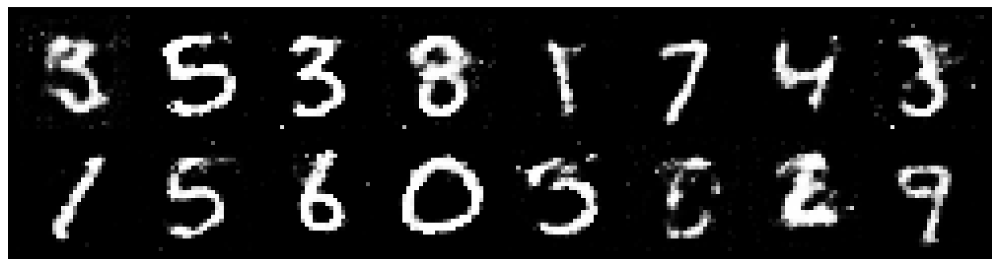

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.0983, Generator Loss: 0.9936
D(x): 0.5811, D(G(z)): 0.3706


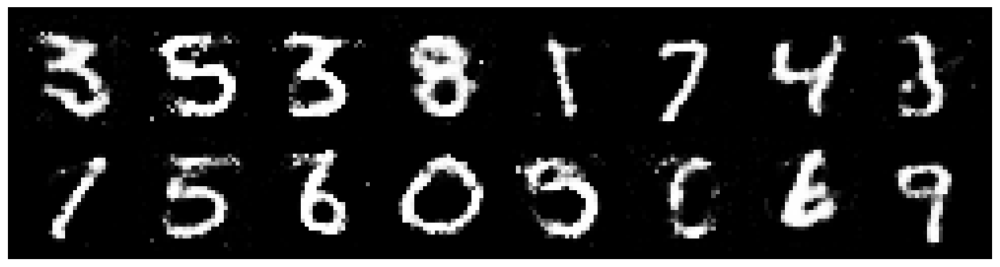

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2377, Generator Loss: 1.0505
D(x): 0.5503, D(G(z)): 0.4312


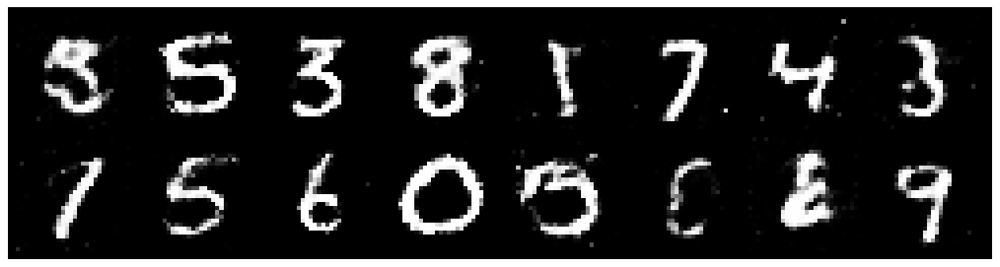

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2439, Generator Loss: 0.8851
D(x): 0.5584, D(G(z)): 0.4468


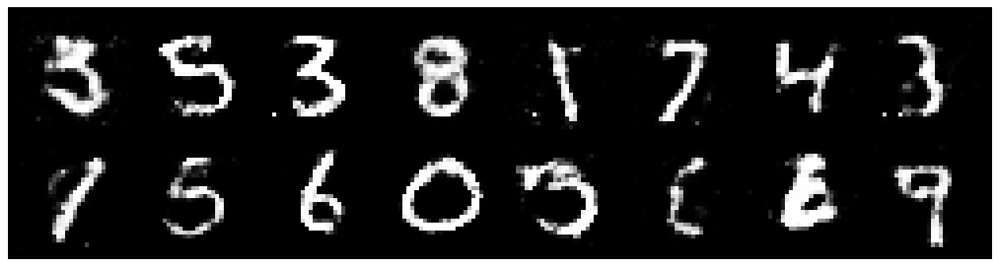

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2035, Generator Loss: 1.0187
D(x): 0.5751, D(G(z)): 0.4088


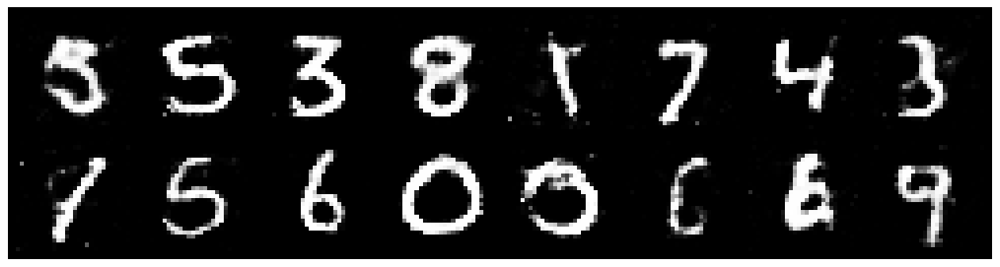

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.3068, Generator Loss: 0.8908
D(x): 0.5809, D(G(z)): 0.4850


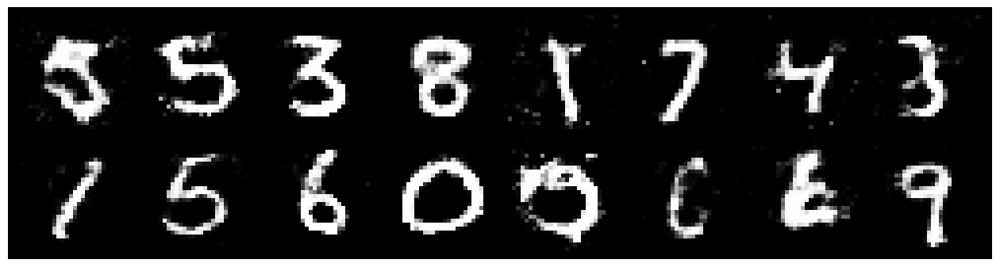

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.1712, Generator Loss: 1.0204
D(x): 0.5909, D(G(z)): 0.4218


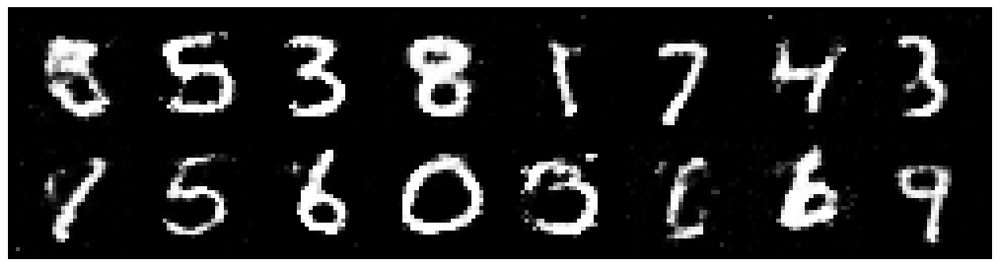

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2121, Generator Loss: 0.8519
D(x): 0.5819, D(G(z)): 0.4382


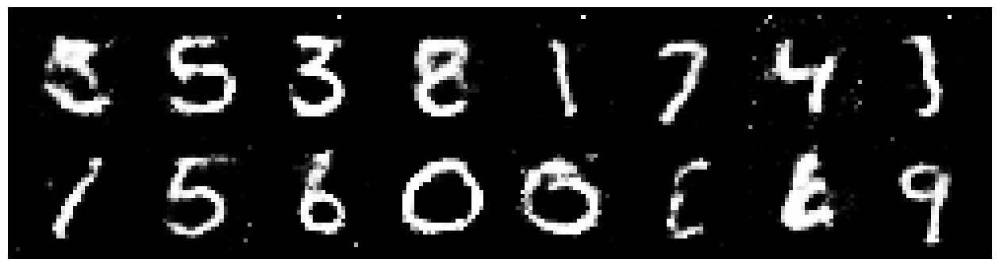

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2741, Generator Loss: 0.9058
D(x): 0.5620, D(G(z)): 0.4633


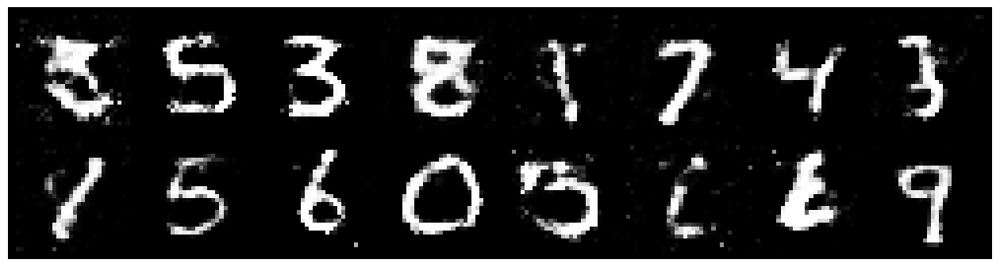

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2801, Generator Loss: 0.8513
D(x): 0.5454, D(G(z)): 0.4552


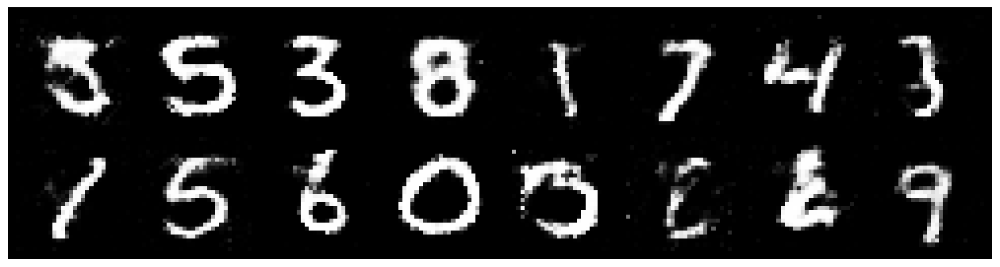

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.1973, Generator Loss: 0.8916
D(x): 0.5654, D(G(z)): 0.4314


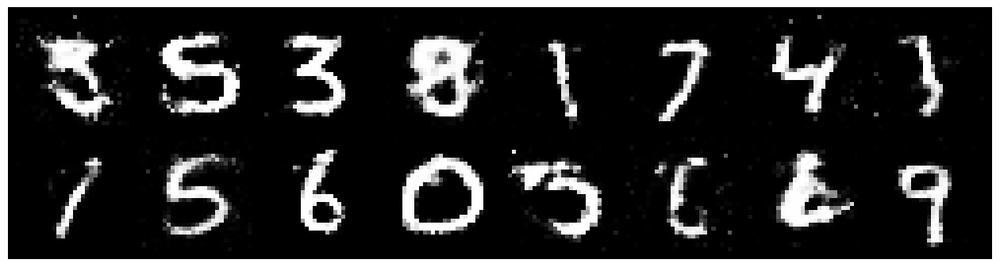

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2511, Generator Loss: 0.9146
D(x): 0.5598, D(G(z)): 0.4301


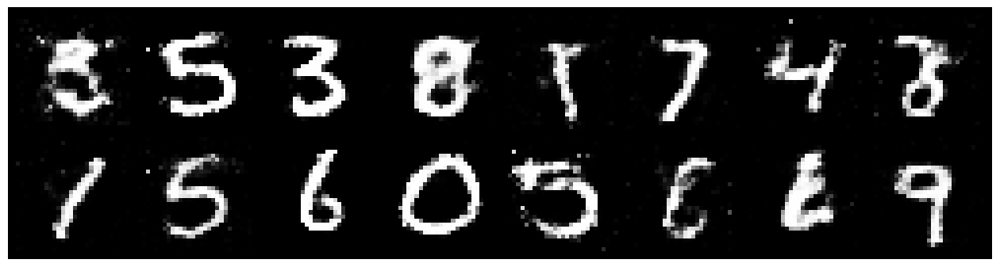

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2677, Generator Loss: 0.8500
D(x): 0.5482, D(G(z)): 0.4540


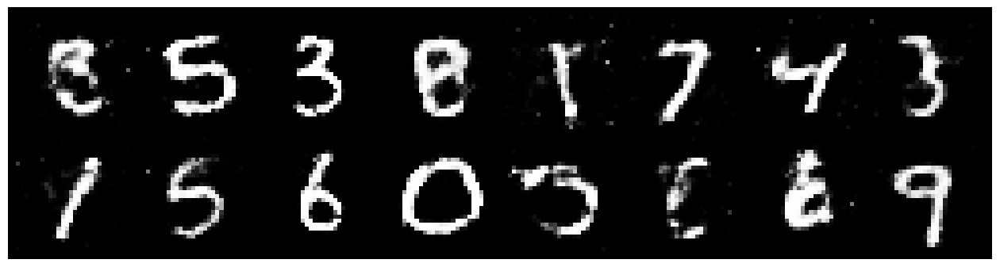

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2743, Generator Loss: 0.8314
D(x): 0.5728, D(G(z)): 0.4654


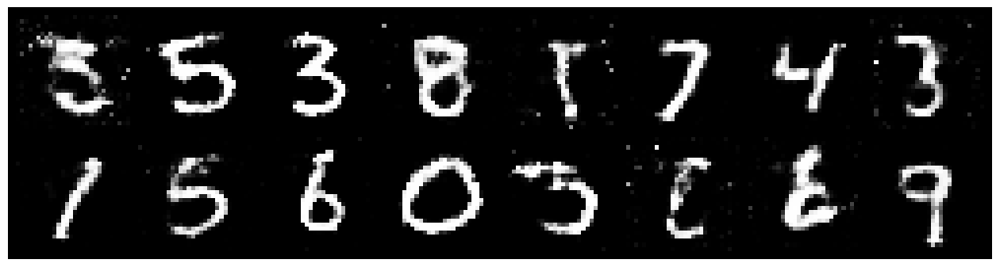

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.3232, Generator Loss: 0.9266
D(x): 0.5112, D(G(z)): 0.4287


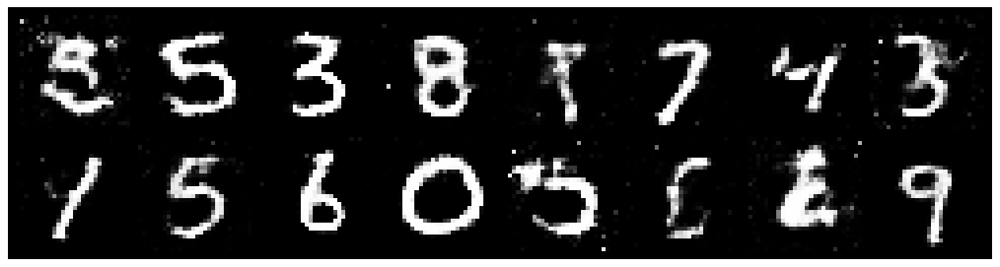

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2590, Generator Loss: 0.9107
D(x): 0.5371, D(G(z)): 0.4230


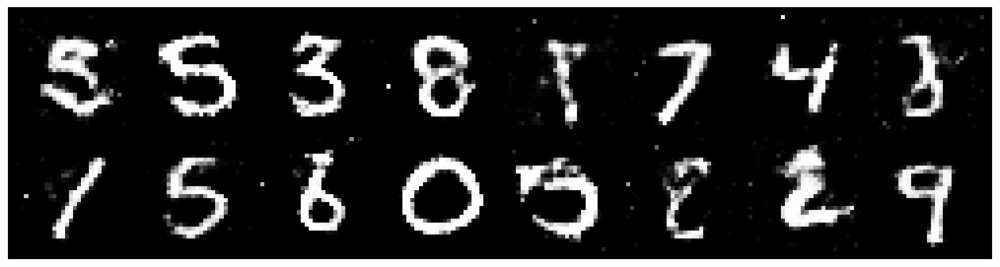

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.3250, Generator Loss: 0.8828
D(x): 0.5614, D(G(z)): 0.4790


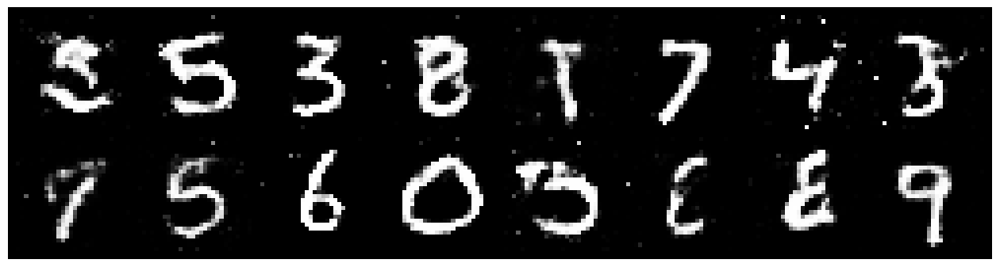

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2844, Generator Loss: 0.8621
D(x): 0.5510, D(G(z)): 0.4613


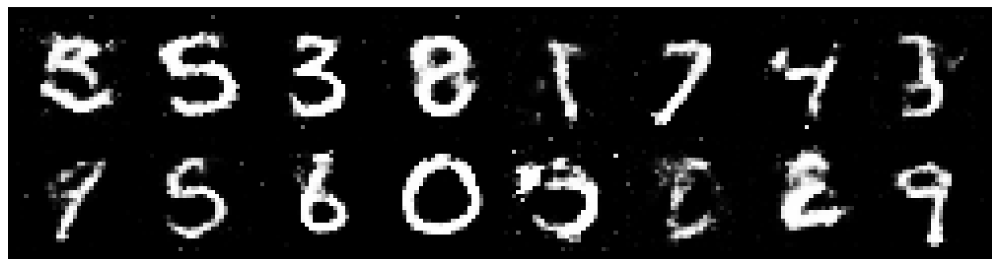

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.3302, Generator Loss: 0.9276
D(x): 0.5297, D(G(z)): 0.4433


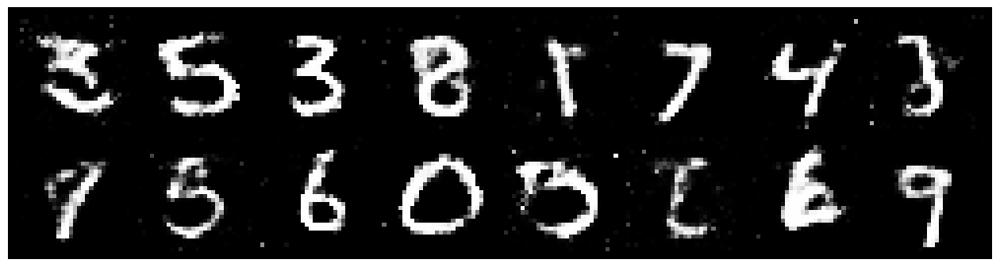

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.3085, Generator Loss: 0.7996
D(x): 0.5462, D(G(z)): 0.4791


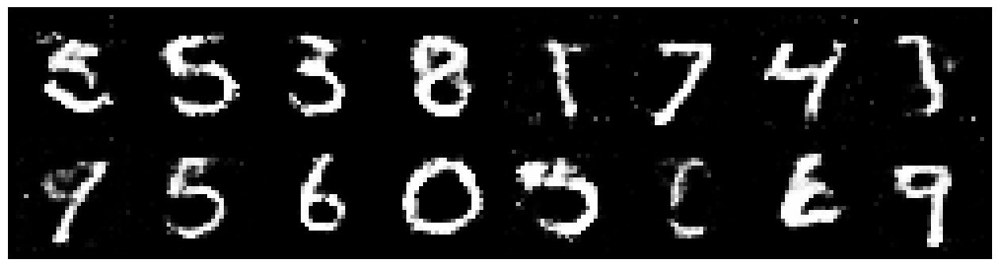

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2046, Generator Loss: 0.9094
D(x): 0.5918, D(G(z)): 0.4504


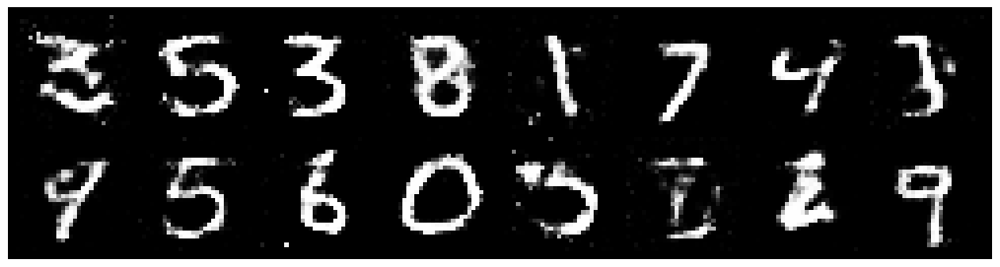

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2888, Generator Loss: 0.9876
D(x): 0.5675, D(G(z)): 0.4510


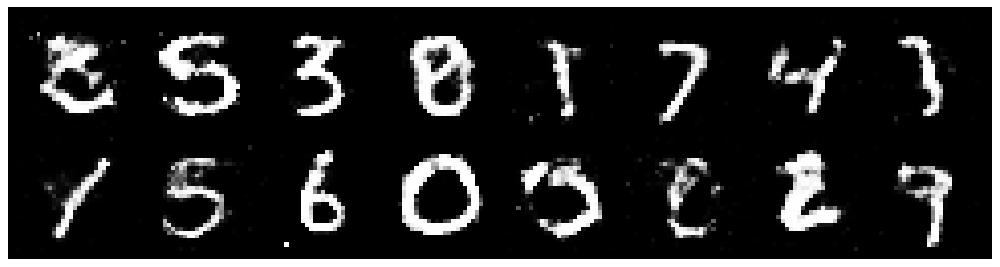

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2068, Generator Loss: 0.8921
D(x): 0.5540, D(G(z)): 0.4108


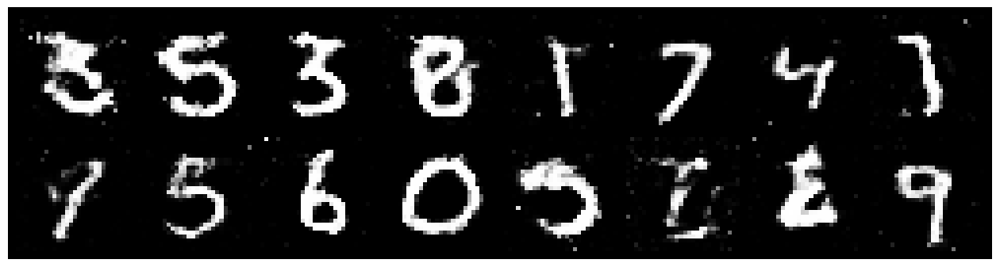

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2956, Generator Loss: 0.9950
D(x): 0.5666, D(G(z)): 0.4567


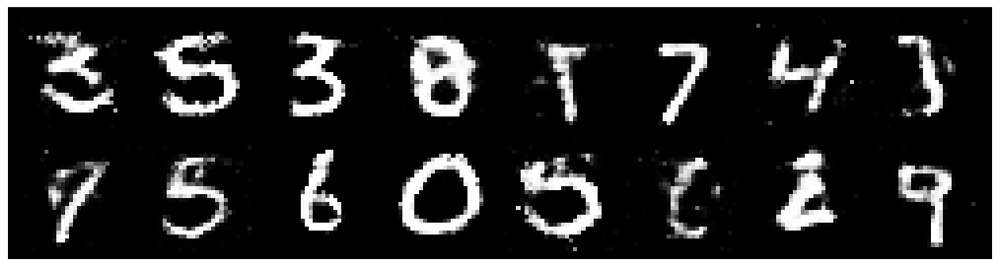

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3405, Generator Loss: 0.8533
D(x): 0.5434, D(G(z)): 0.4485


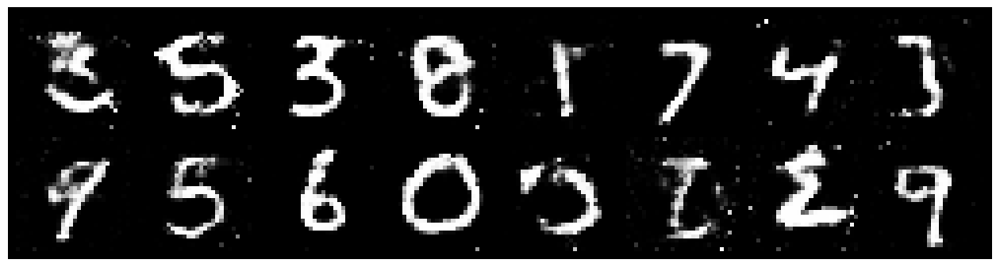

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3303, Generator Loss: 1.1104
D(x): 0.5235, D(G(z)): 0.4286


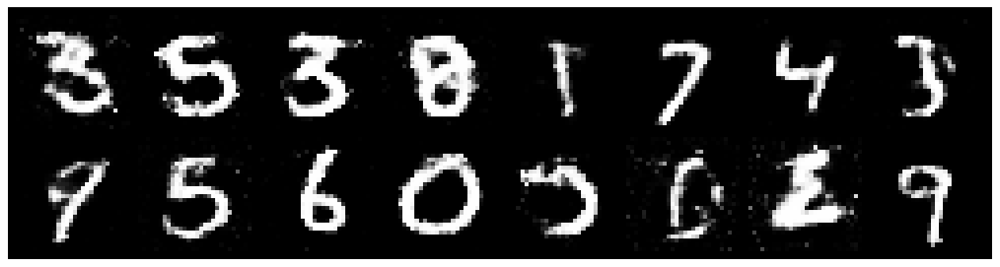

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3404, Generator Loss: 0.8452
D(x): 0.5539, D(G(z)): 0.4780


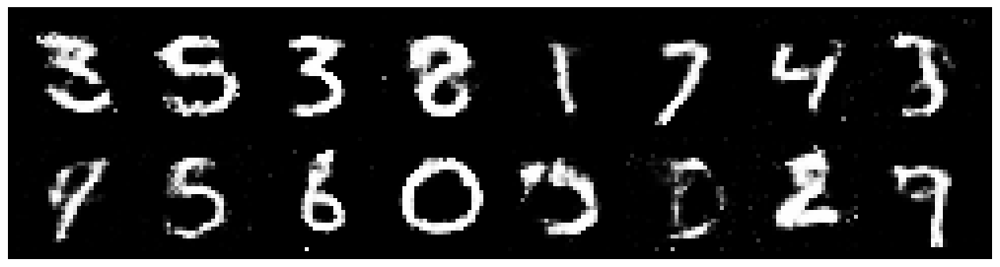

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.3328, Generator Loss: 0.8099
D(x): 0.5498, D(G(z)): 0.4872


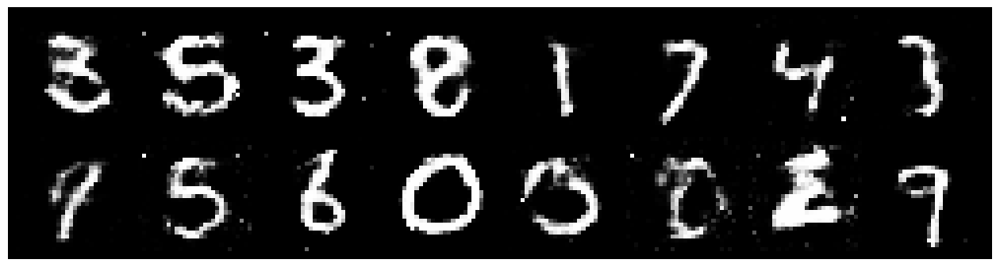

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2827, Generator Loss: 1.0015
D(x): 0.5206, D(G(z)): 0.4043


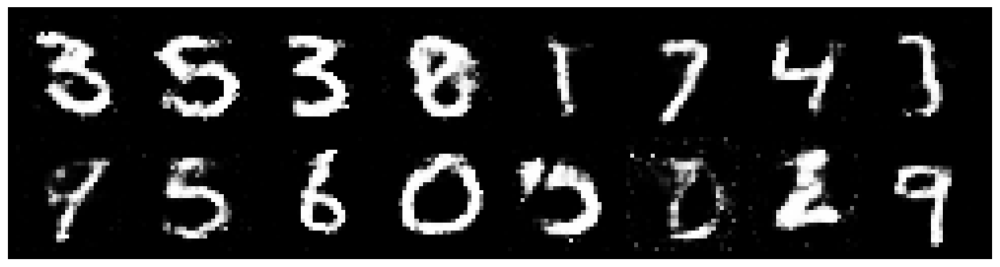

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3537, Generator Loss: 0.9468
D(x): 0.5078, D(G(z)): 0.4426


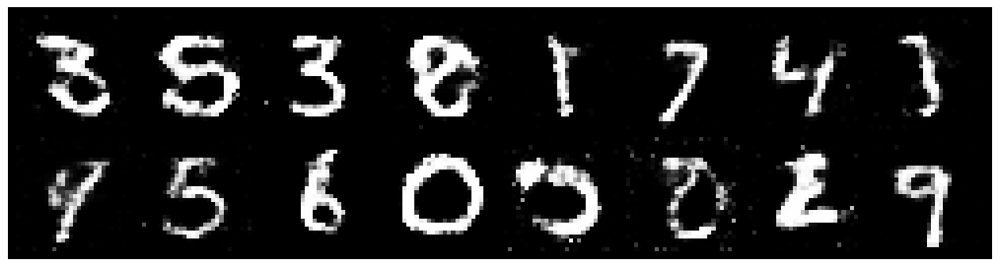

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2355, Generator Loss: 0.8743
D(x): 0.5512, D(G(z)): 0.4322


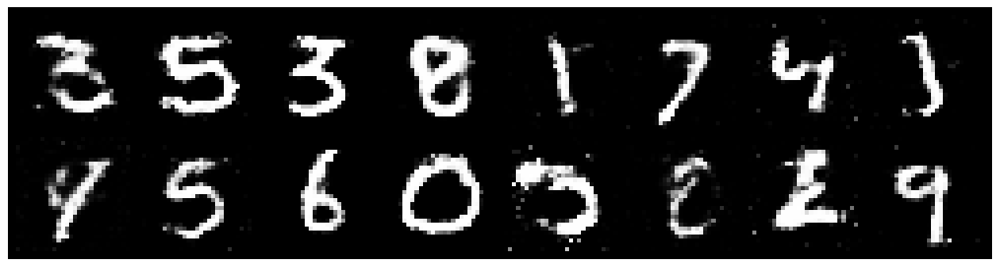

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2432, Generator Loss: 0.8887
D(x): 0.5528, D(G(z)): 0.4295


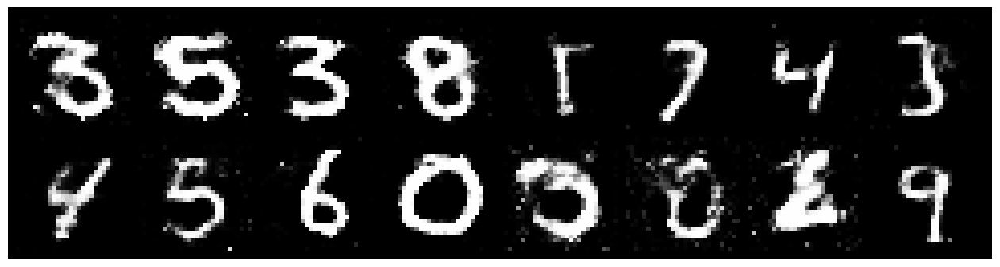

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.3069, Generator Loss: 0.7507
D(x): 0.5350, D(G(z)): 0.4687


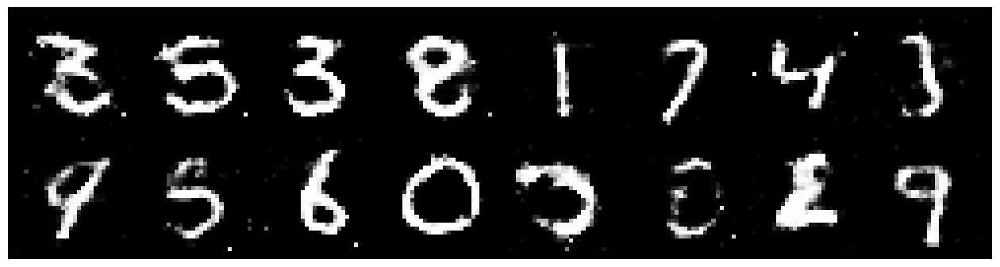

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3347, Generator Loss: 0.8440
D(x): 0.5030, D(G(z)): 0.4314


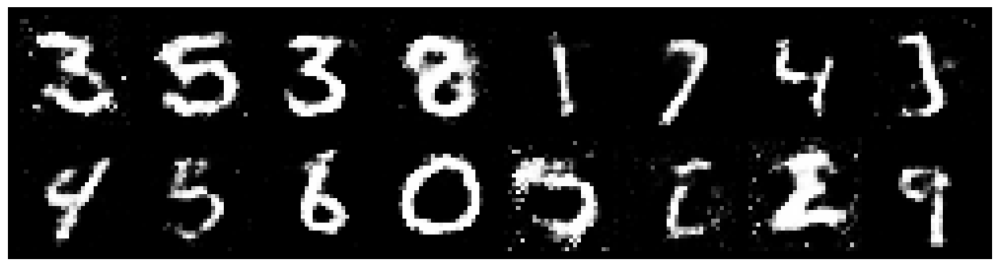

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2428, Generator Loss: 0.8140
D(x): 0.5662, D(G(z)): 0.4524


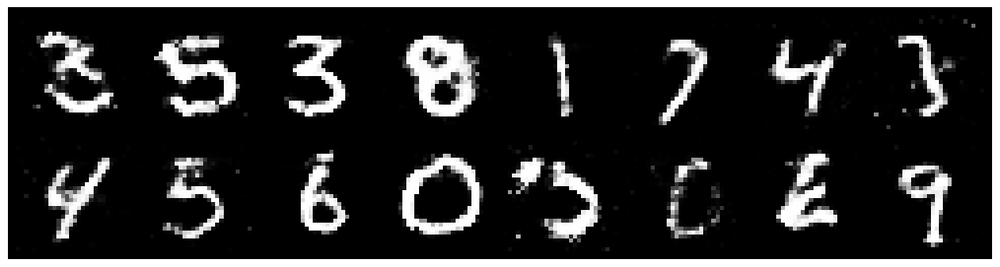

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3312, Generator Loss: 0.7795
D(x): 0.5763, D(G(z)): 0.5107


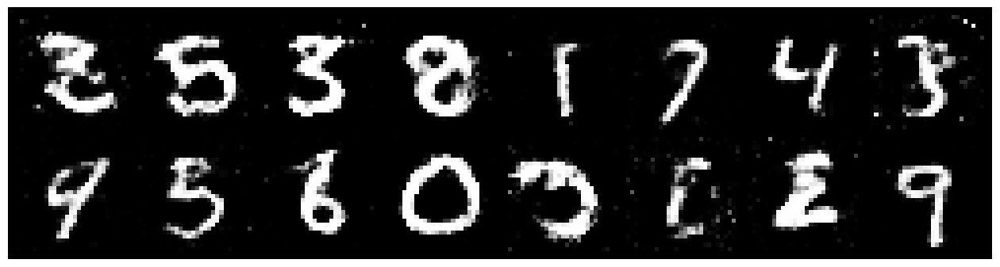

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8383
D(x): 0.5704, D(G(z)): 0.4705


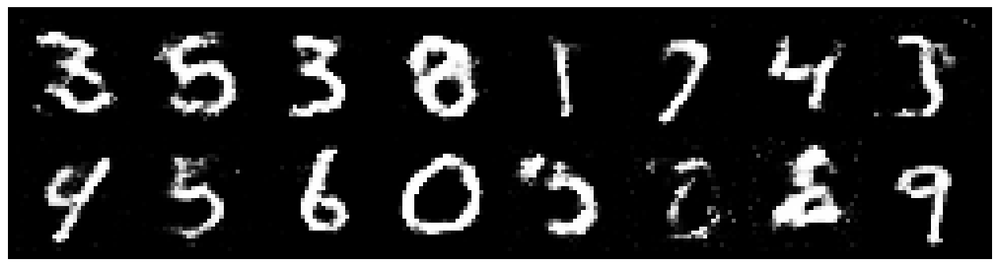

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2037, Generator Loss: 0.9625
D(x): 0.5469, D(G(z)): 0.4007


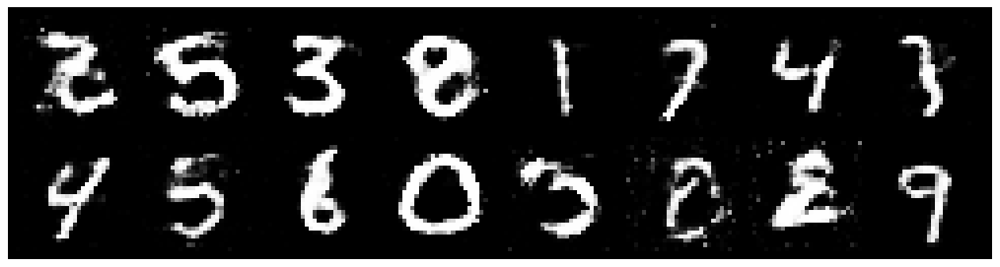

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.1873, Generator Loss: 0.8502
D(x): 0.5781, D(G(z)): 0.4326


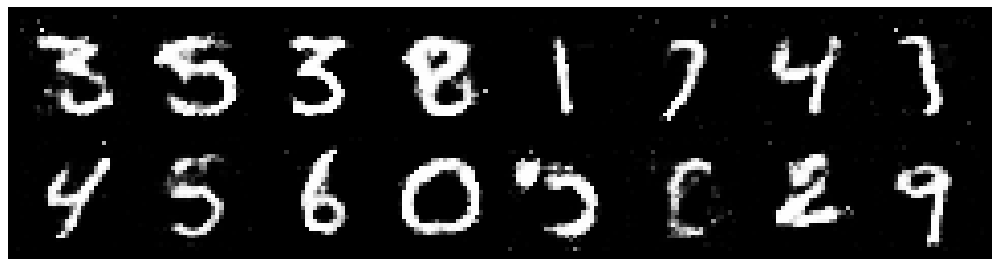

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3267, Generator Loss: 0.7931
D(x): 0.5433, D(G(z)): 0.4722


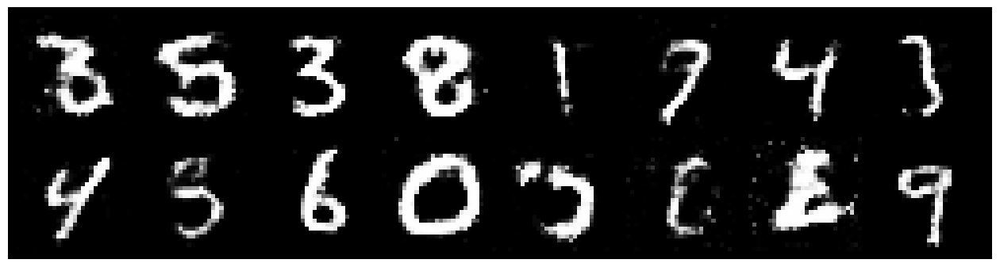

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2859, Generator Loss: 0.8578
D(x): 0.5546, D(G(z)): 0.4521


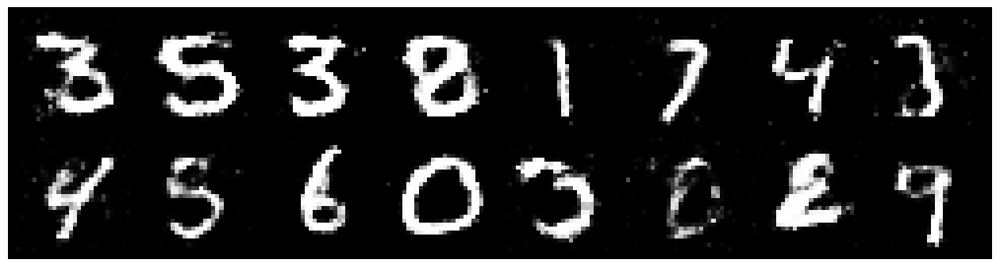

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3001, Generator Loss: 0.7956
D(x): 0.5755, D(G(z)): 0.4838


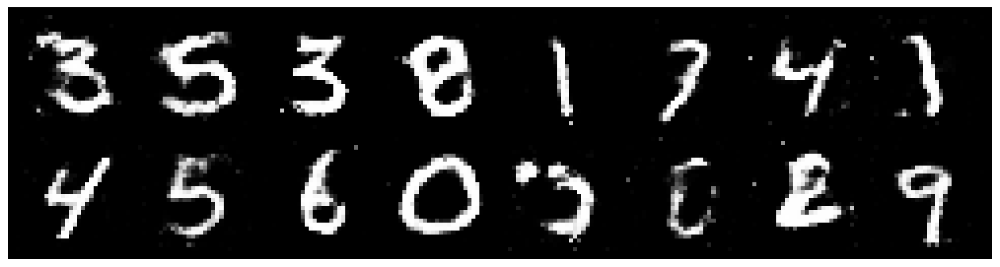

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.3318, Generator Loss: 0.8447
D(x): 0.5577, D(G(z)): 0.4877


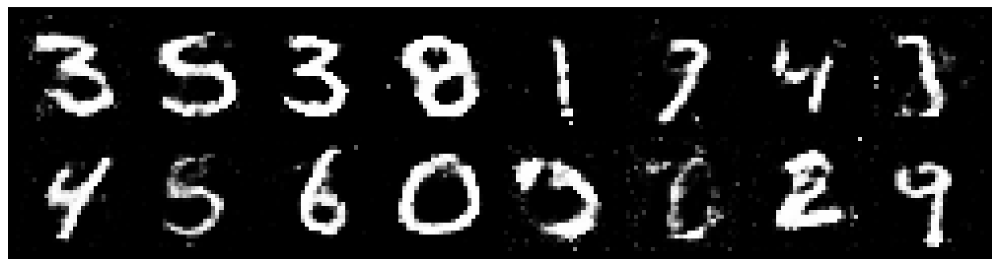

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.3724, Generator Loss: 0.9179
D(x): 0.5235, D(G(z)): 0.4631


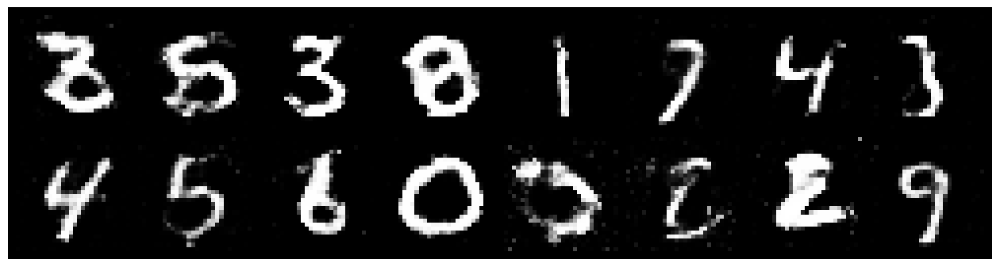

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.3365, Generator Loss: 0.8236
D(x): 0.5438, D(G(z)): 0.4715


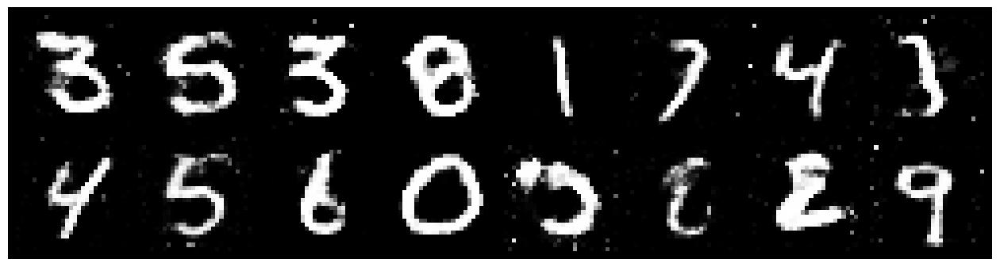

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.3199, Generator Loss: 0.7527
D(x): 0.5571, D(G(z)): 0.4644


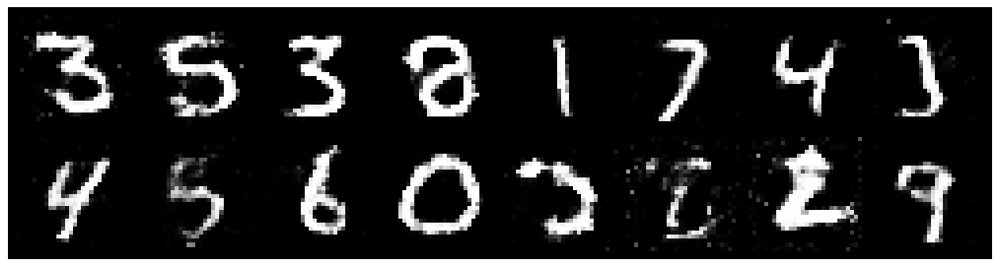

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2902, Generator Loss: 0.7095
D(x): 0.6052, D(G(z)): 0.5019


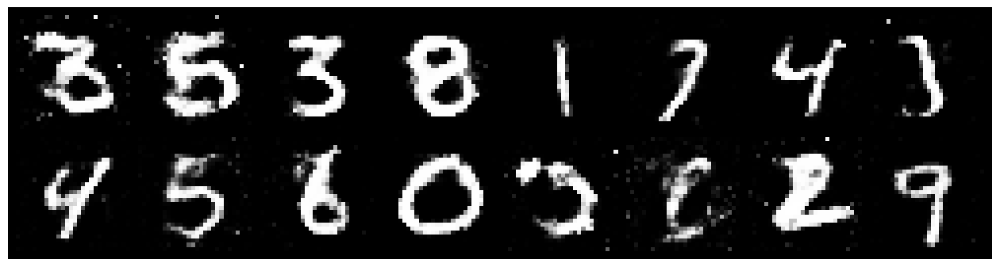

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3339, Generator Loss: 0.8045
D(x): 0.5509, D(G(z)): 0.4846


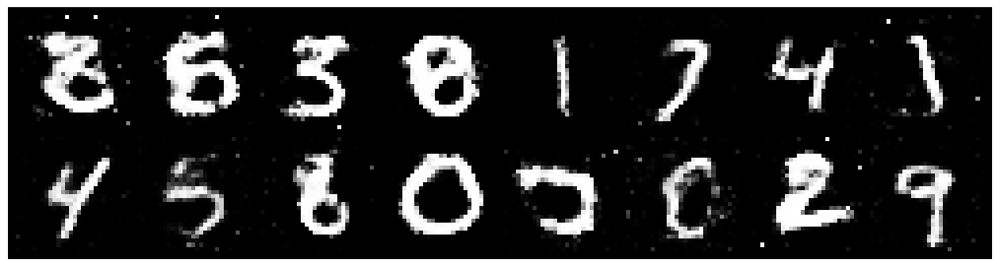

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2914, Generator Loss: 0.9009
D(x): 0.5708, D(G(z)): 0.4597


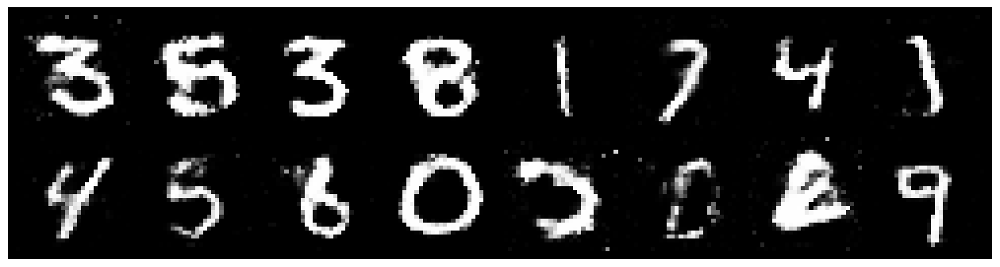

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8355
D(x): 0.5507, D(G(z)): 0.4731


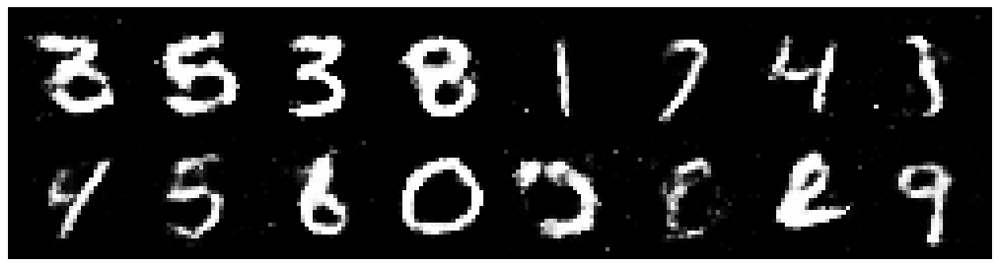

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.3066, Generator Loss: 0.8382
D(x): 0.5634, D(G(z)): 0.4859


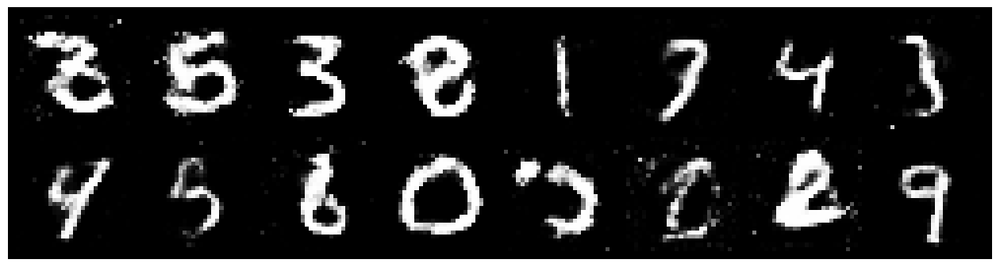

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2791, Generator Loss: 0.8074
D(x): 0.5465, D(G(z)): 0.4324


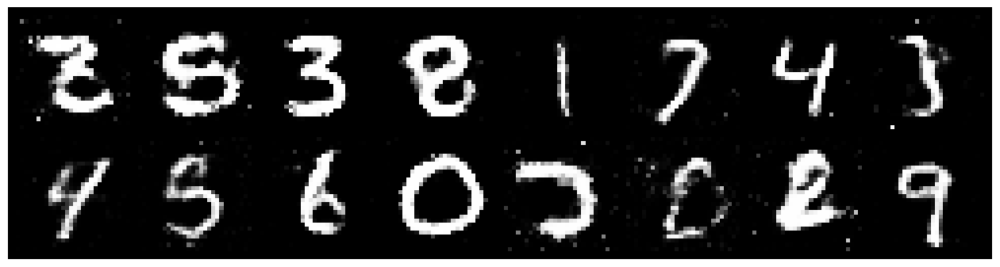

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2288, Generator Loss: 0.9036
D(x): 0.5742, D(G(z)): 0.4135


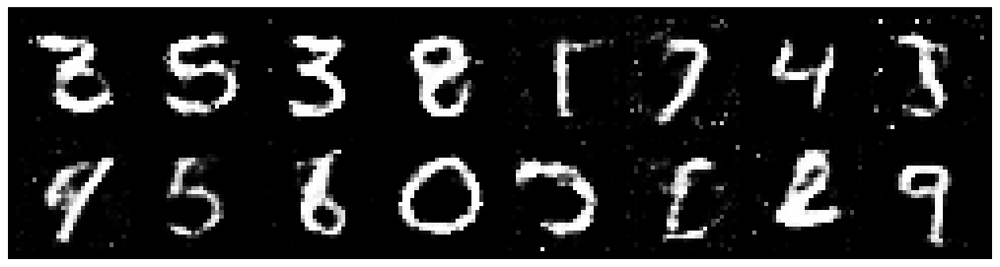

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.1867, Generator Loss: 0.9268
D(x): 0.5914, D(G(z)): 0.4167


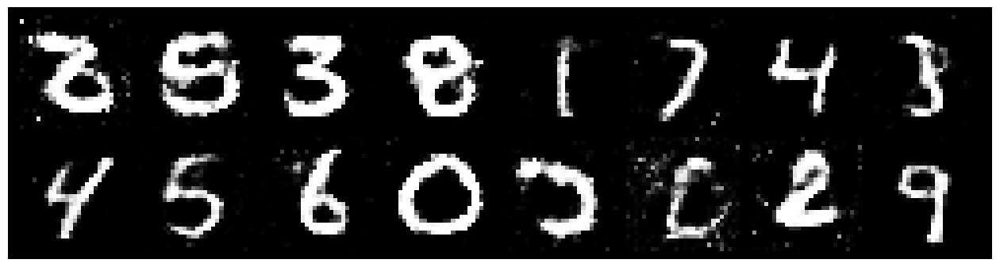

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2415, Generator Loss: 0.9074
D(x): 0.6407, D(G(z)): 0.4867


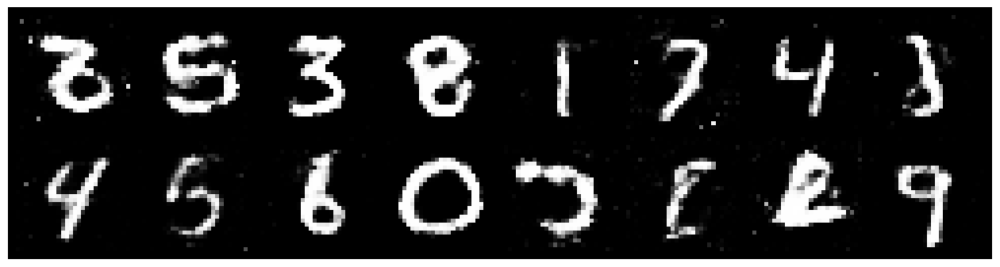

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.3576, Generator Loss: 0.9722
D(x): 0.5677, D(G(z)): 0.4789


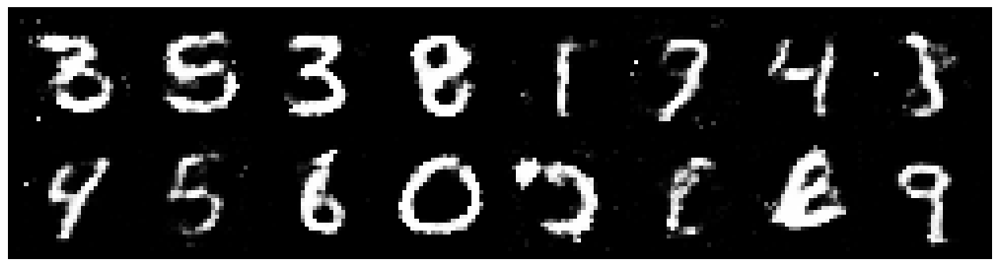

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2474, Generator Loss: 1.0162
D(x): 0.5802, D(G(z)): 0.4540


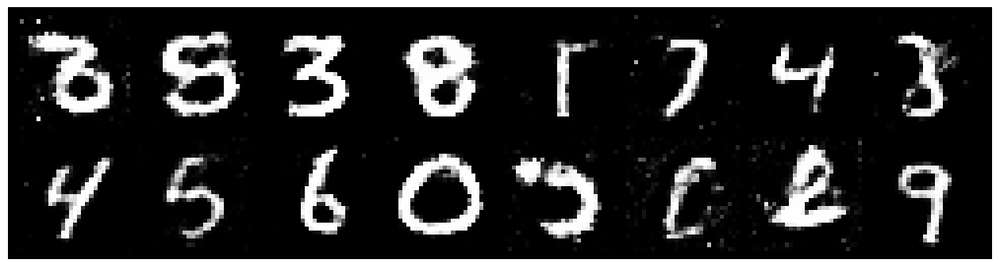

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.1967, Generator Loss: 1.0045
D(x): 0.5936, D(G(z)): 0.4310


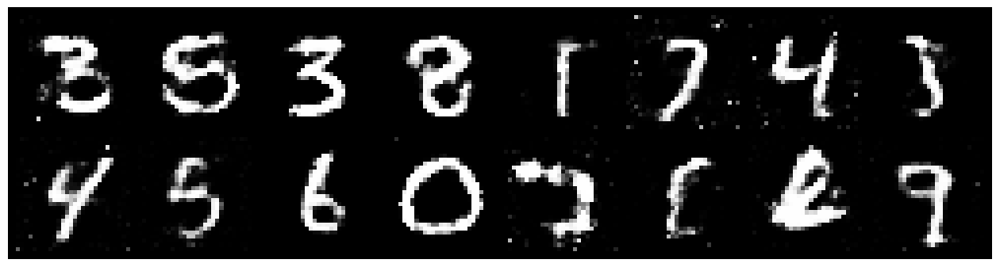

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2933, Generator Loss: 0.9745
D(x): 0.5280, D(G(z)): 0.4134


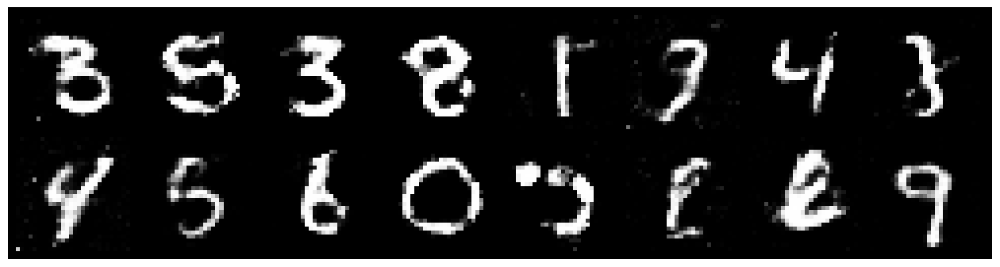

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8421
D(x): 0.5579, D(G(z)): 0.4537


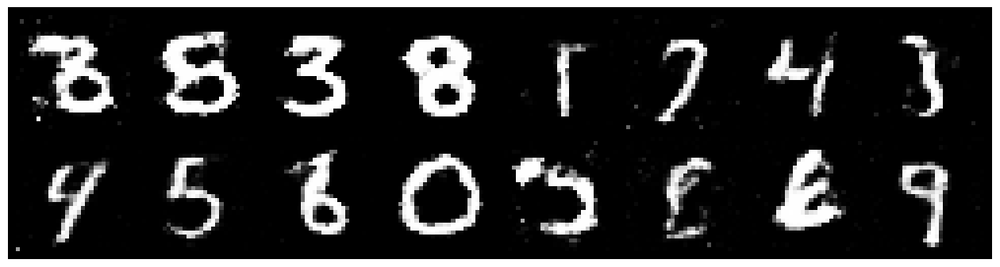

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.3611, Generator Loss: 0.9167
D(x): 0.5237, D(G(z)): 0.4488


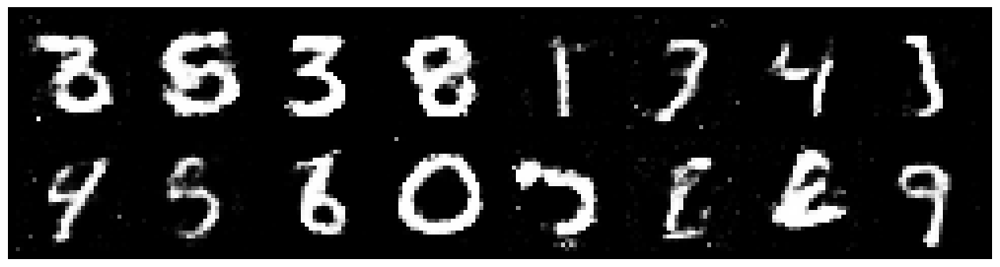

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2765, Generator Loss: 0.9952
D(x): 0.5722, D(G(z)): 0.4586


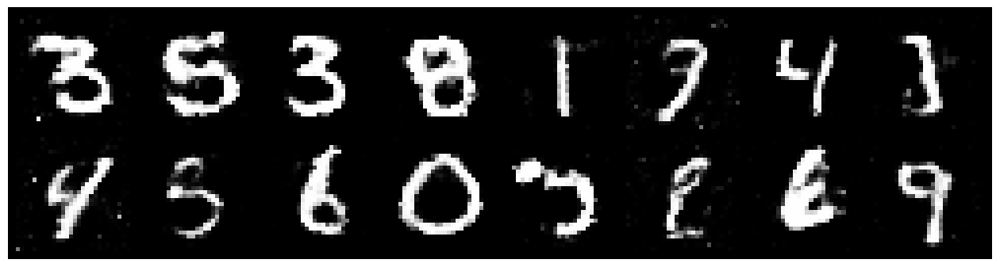

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3180, Generator Loss: 0.8712
D(x): 0.5525, D(G(z)): 0.4530


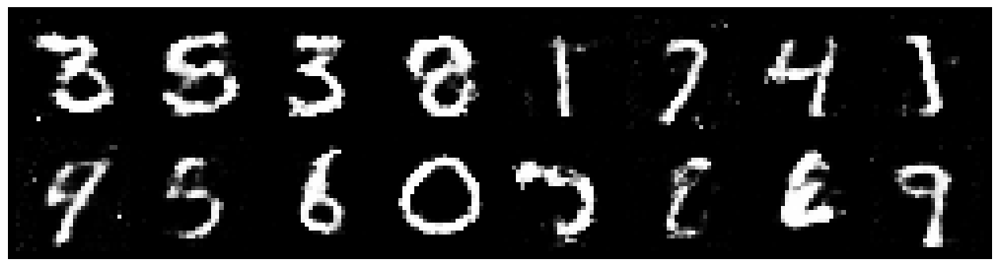

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2338, Generator Loss: 0.8979
D(x): 0.5553, D(G(z)): 0.4409


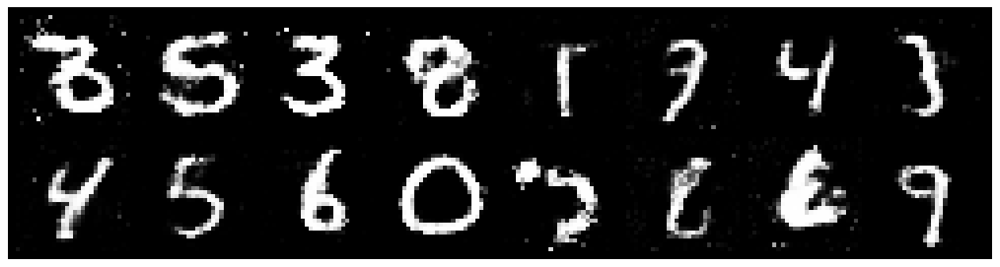

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2624, Generator Loss: 0.8843
D(x): 0.5409, D(G(z)): 0.4272


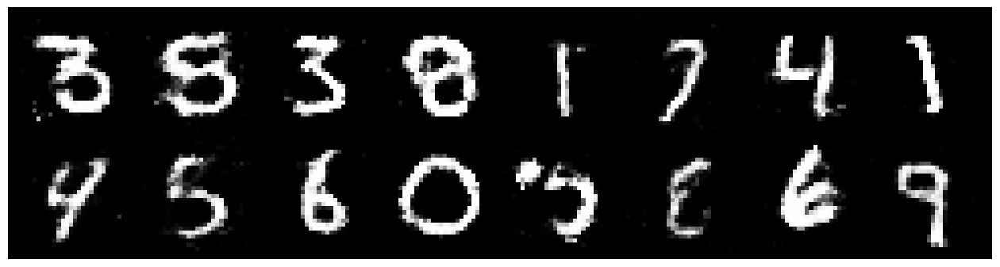

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.1897, Generator Loss: 0.9268
D(x): 0.5814, D(G(z)): 0.4344


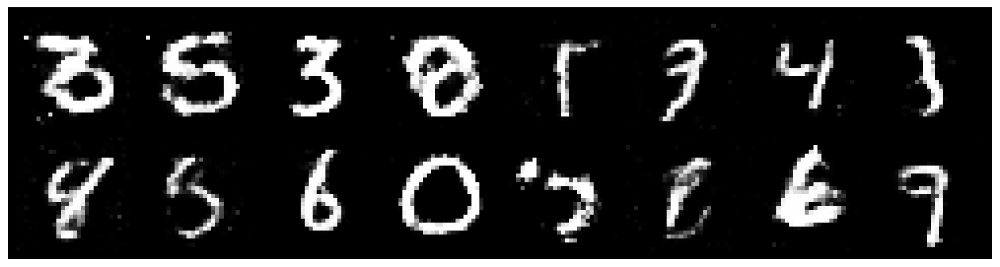

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8927
D(x): 0.5427, D(G(z)): 0.4366


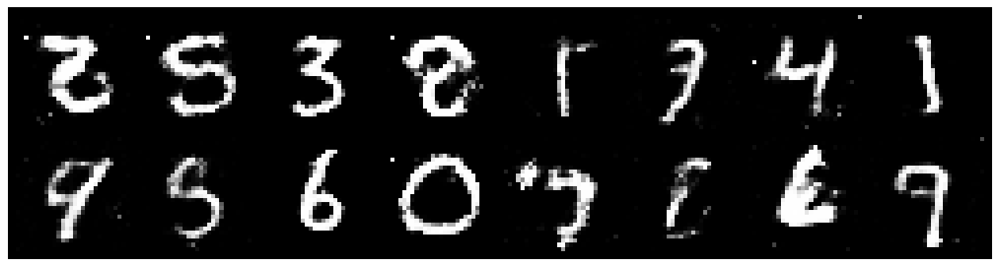

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2838, Generator Loss: 0.8665
D(x): 0.5141, D(G(z)): 0.4212


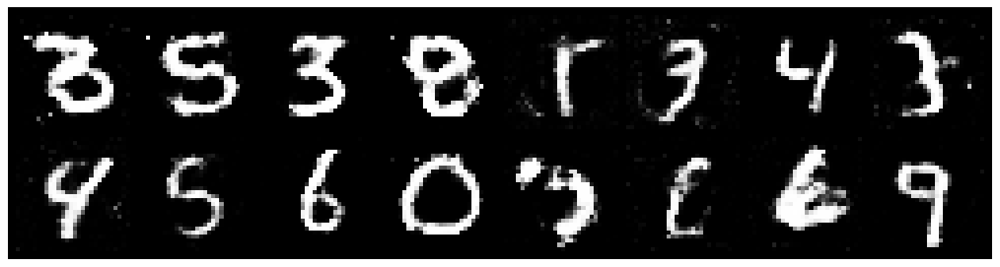

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2468, Generator Loss: 0.8528
D(x): 0.5520, D(G(z)): 0.4382


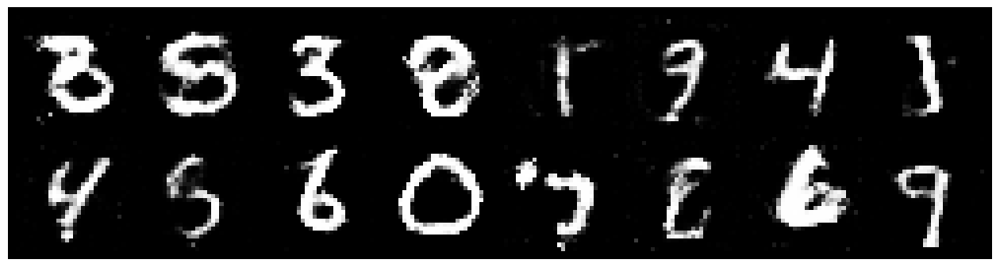

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3565, Generator Loss: 0.8065
D(x): 0.5629, D(G(z)): 0.4850


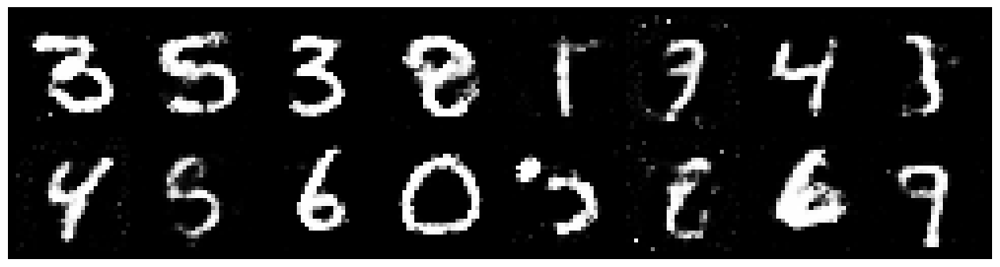

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.3735, Generator Loss: 0.8224
D(x): 0.5431, D(G(z)): 0.4795


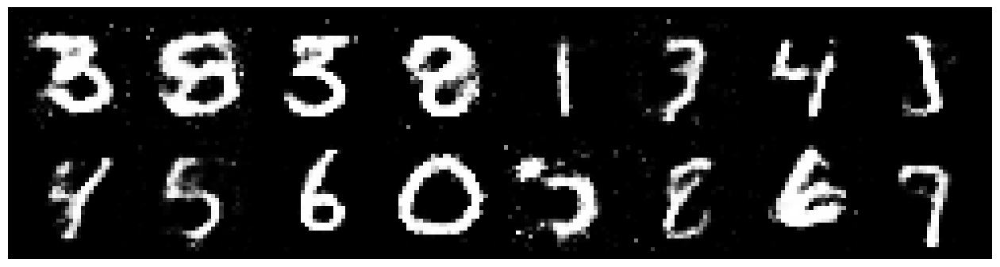

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3725, Generator Loss: 0.9358
D(x): 0.5088, D(G(z)): 0.4462


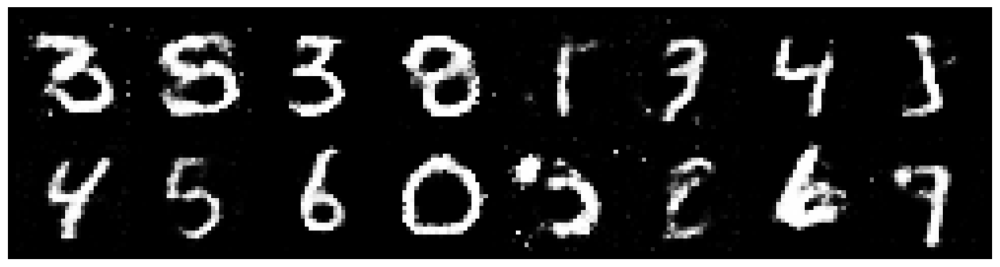

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3215, Generator Loss: 0.8976
D(x): 0.5579, D(G(z)): 0.4653


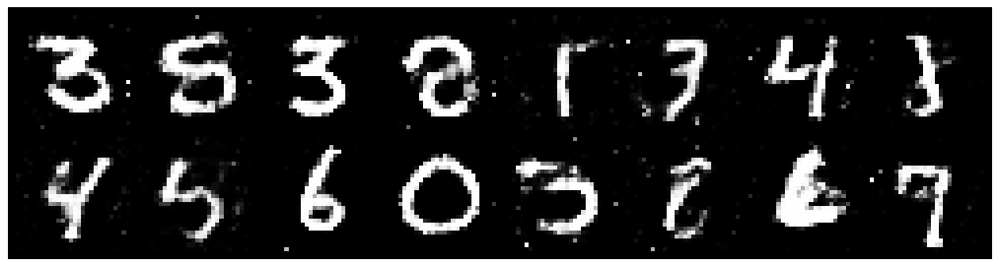

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2358, Generator Loss: 0.8323
D(x): 0.5681, D(G(z)): 0.4484


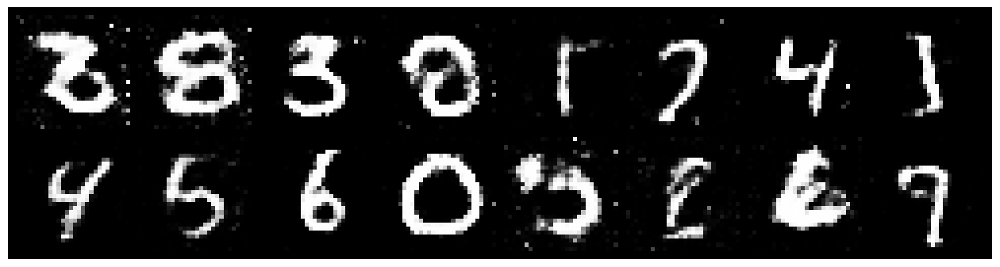

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8925
D(x): 0.5437, D(G(z)): 0.4220


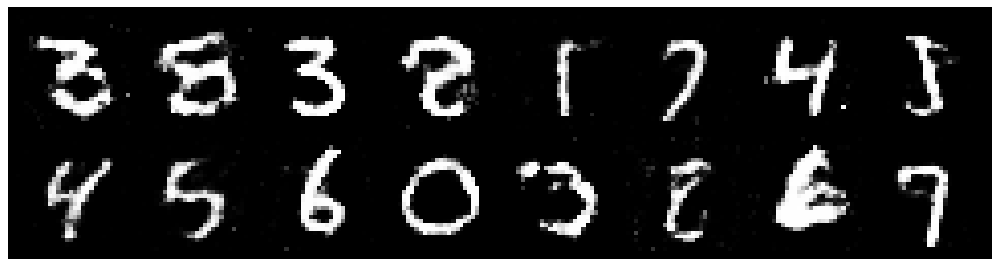

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2971, Generator Loss: 0.9623
D(x): 0.5303, D(G(z)): 0.4296


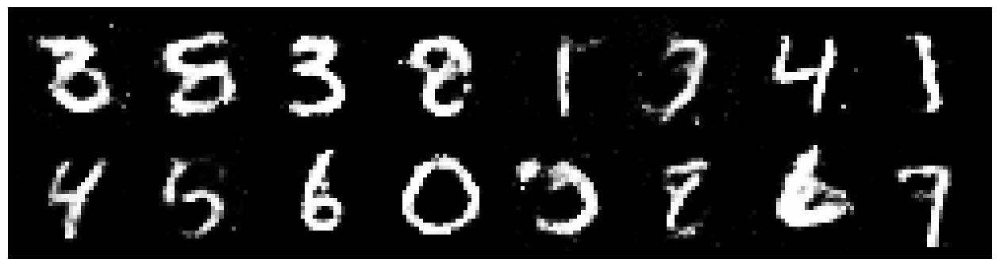

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9495
D(x): 0.5373, D(G(z)): 0.4216


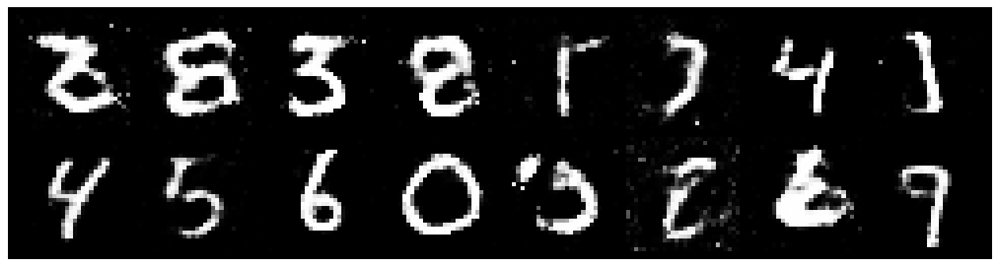

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2970, Generator Loss: 1.0963
D(x): 0.5646, D(G(z)): 0.4343


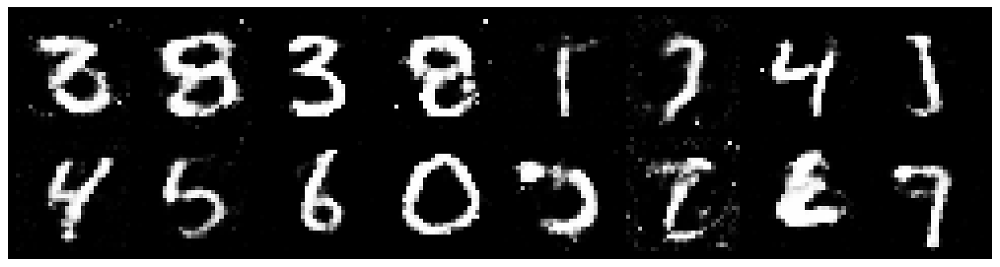

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2590, Generator Loss: 0.9110
D(x): 0.5549, D(G(z)): 0.4412


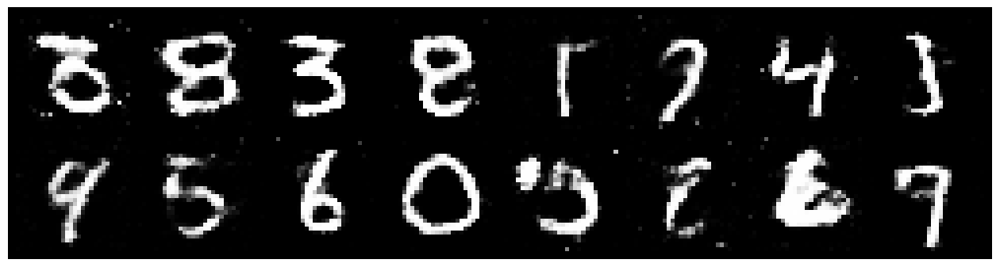

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.3161, Generator Loss: 0.8309
D(x): 0.5212, D(G(z)): 0.4145


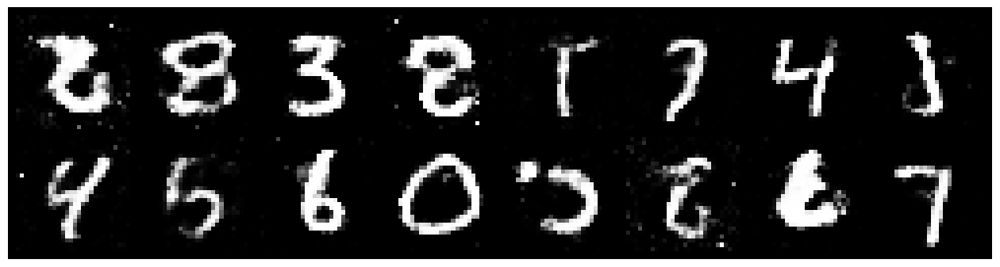

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3044, Generator Loss: 0.9335
D(x): 0.5243, D(G(z)): 0.4413


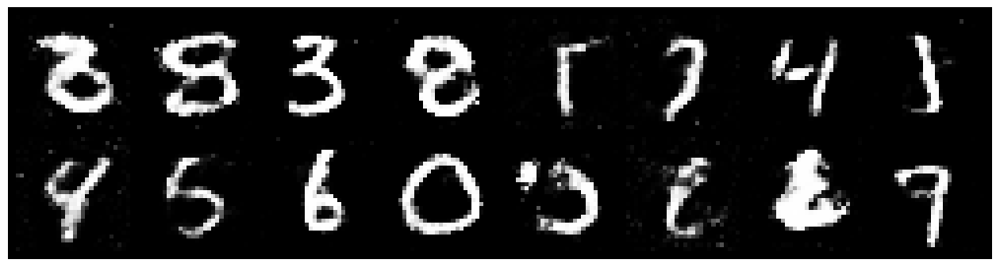

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3385, Generator Loss: 0.9427
D(x): 0.5263, D(G(z)): 0.4389


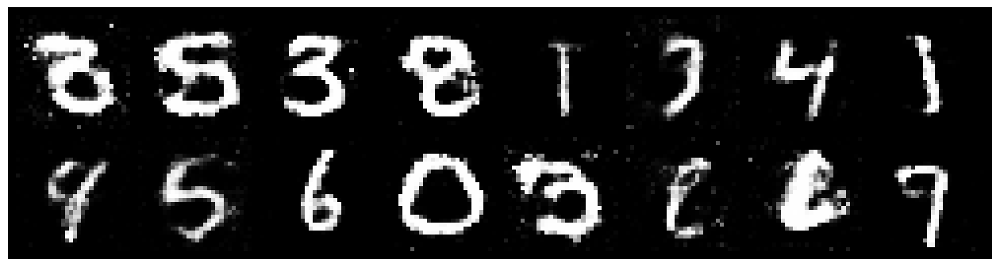

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2400, Generator Loss: 0.7698
D(x): 0.5635, D(G(z)): 0.4557


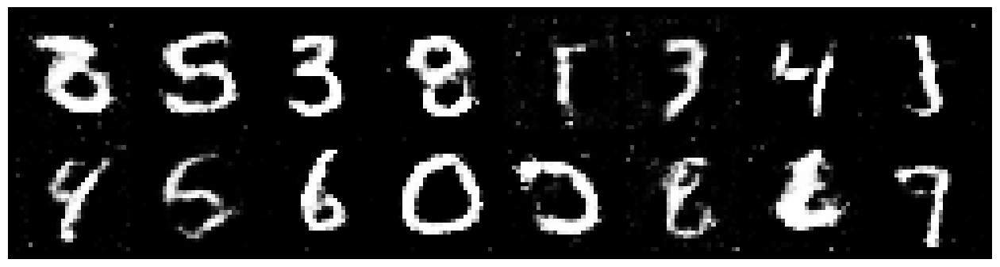

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3321, Generator Loss: 0.8640
D(x): 0.5274, D(G(z)): 0.4558


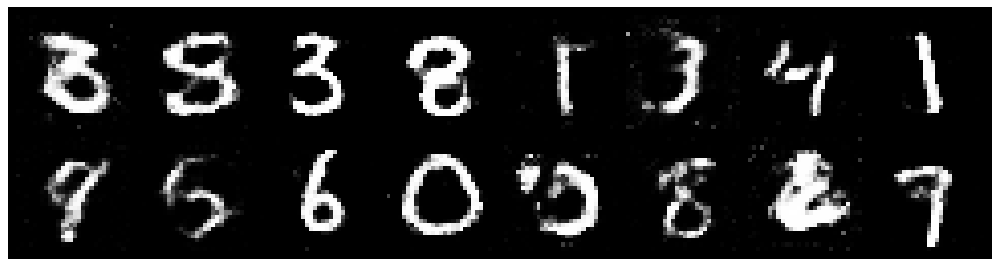

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3370, Generator Loss: 1.0294
D(x): 0.5299, D(G(z)): 0.4405


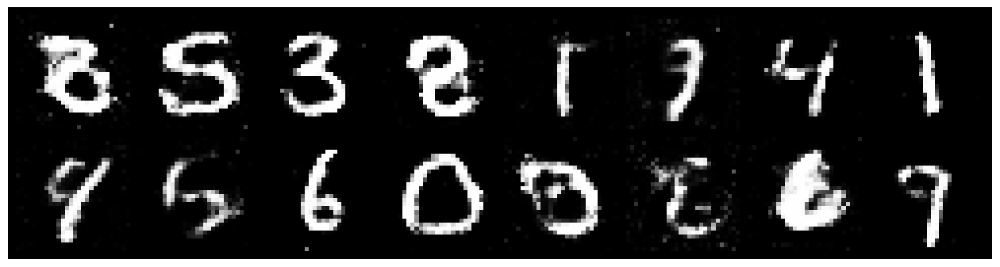

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.3563, Generator Loss: 0.8001
D(x): 0.5385, D(G(z)): 0.4722


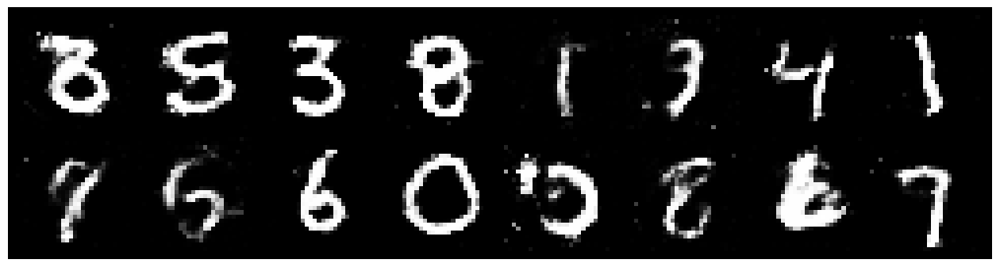

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2178, Generator Loss: 0.9401
D(x): 0.5609, D(G(z)): 0.4317


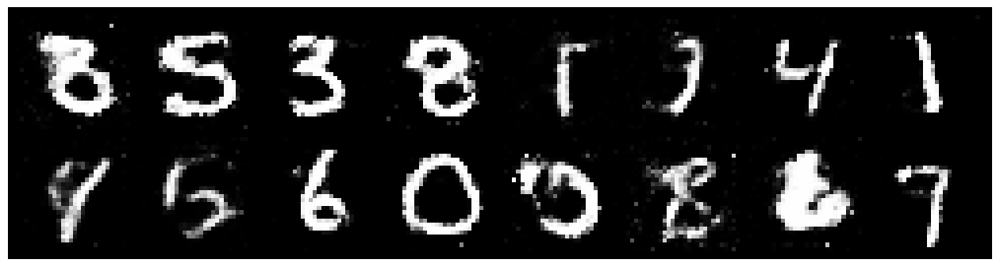

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.1911, Generator Loss: 0.8800
D(x): 0.5824, D(G(z)): 0.4338


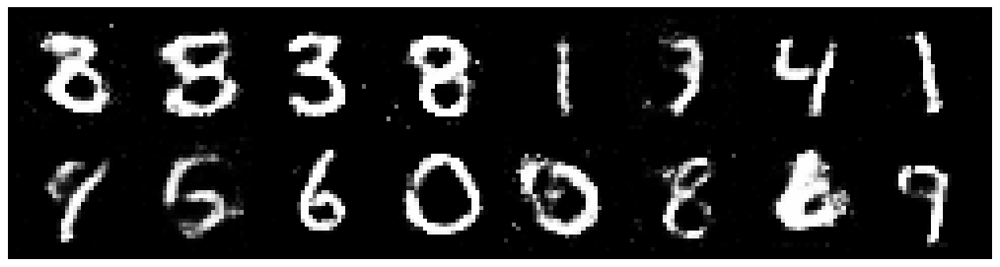

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.1778, Generator Loss: 0.9492
D(x): 0.5601, D(G(z)): 0.3972


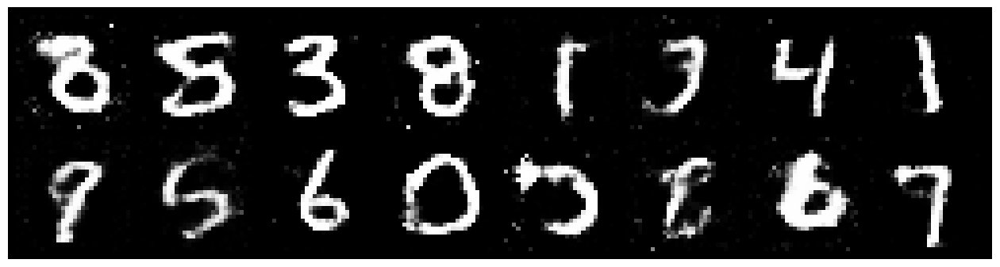

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.0862, Generator Loss: 1.0394
D(x): 0.5789, D(G(z)): 0.3580


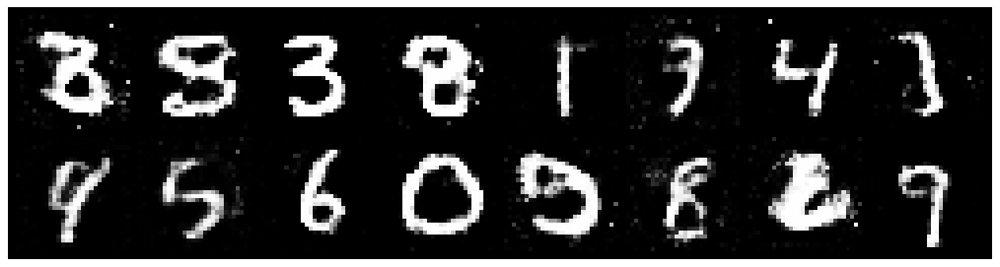

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2333, Generator Loss: 0.8294
D(x): 0.5882, D(G(z)): 0.4564


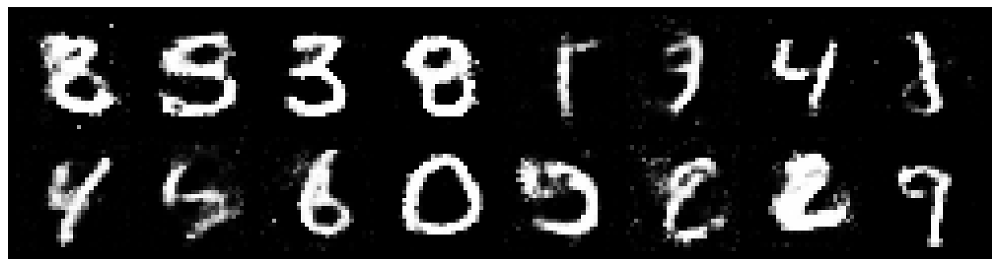

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2182, Generator Loss: 0.8856
D(x): 0.5929, D(G(z)): 0.4405


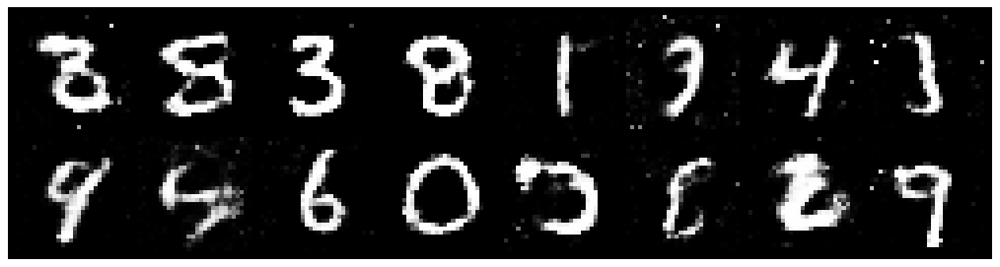

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.3049, Generator Loss: 0.8764
D(x): 0.5418, D(G(z)): 0.4420


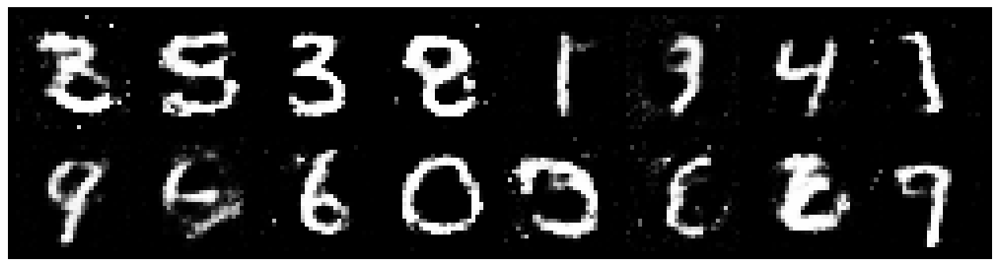

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.1824, Generator Loss: 0.9080
D(x): 0.5765, D(G(z)): 0.4108


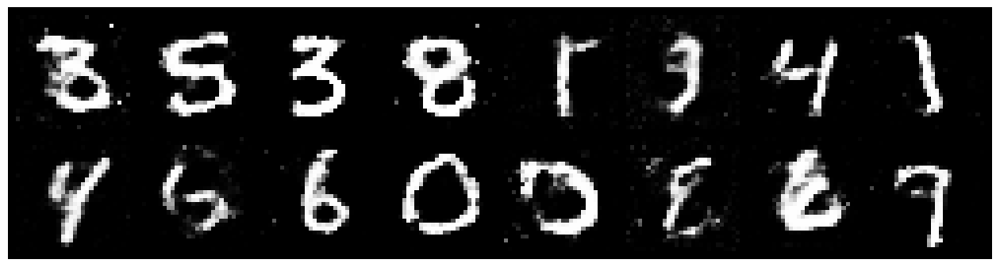

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2428, Generator Loss: 0.8724
D(x): 0.5434, D(G(z)): 0.4251


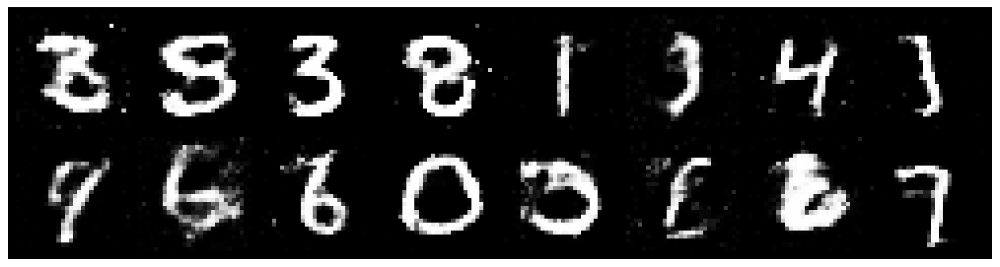

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3074, Generator Loss: 0.8882
D(x): 0.5556, D(G(z)): 0.4649


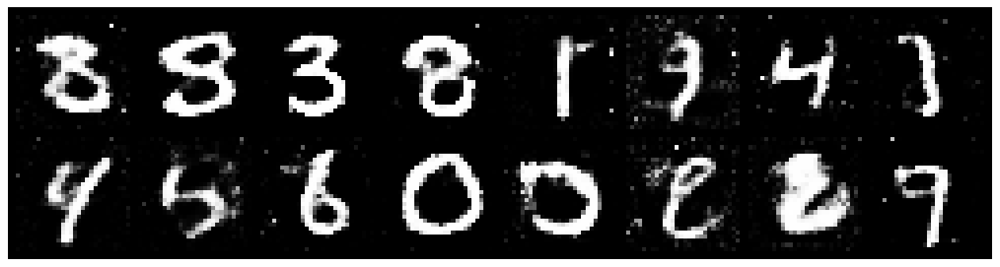

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2864, Generator Loss: 0.8655
D(x): 0.5581, D(G(z)): 0.4519


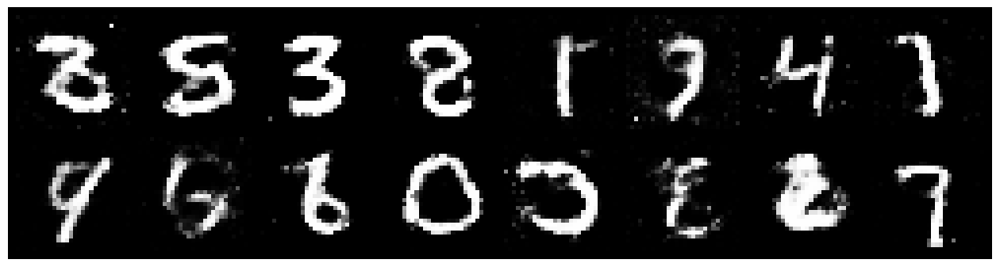

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2292, Generator Loss: 0.8518
D(x): 0.5292, D(G(z)): 0.4061


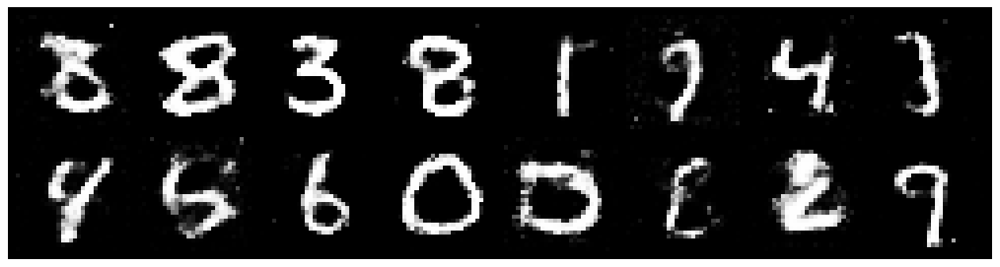

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.1530, Generator Loss: 0.9466
D(x): 0.5701, D(G(z)): 0.4068


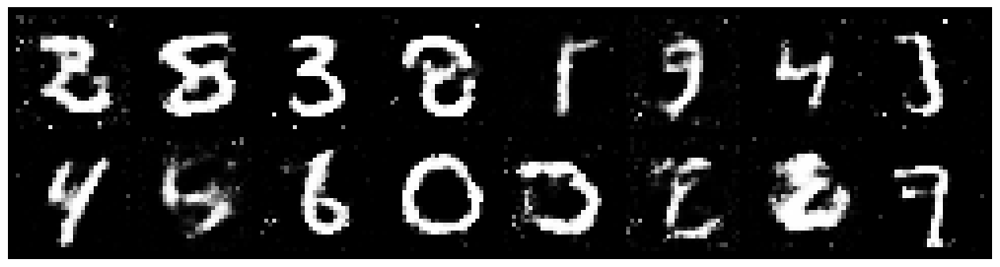

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.1386, Generator Loss: 0.8472
D(x): 0.6041, D(G(z)): 0.4255


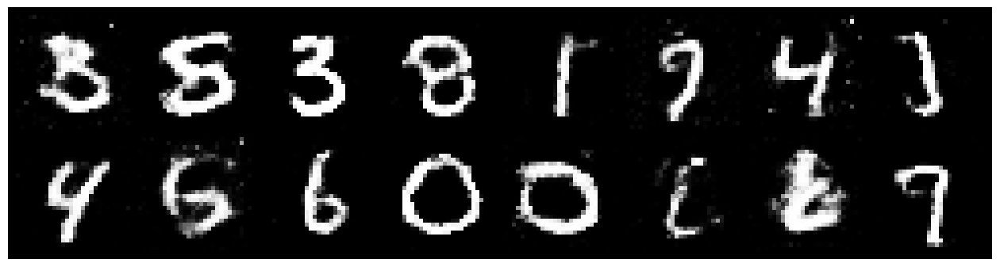

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9499
D(x): 0.5537, D(G(z)): 0.4379


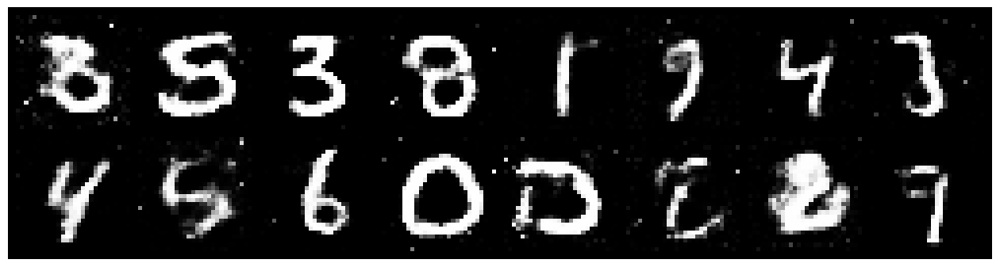

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.3754, Generator Loss: 0.9325
D(x): 0.4944, D(G(z)): 0.4394


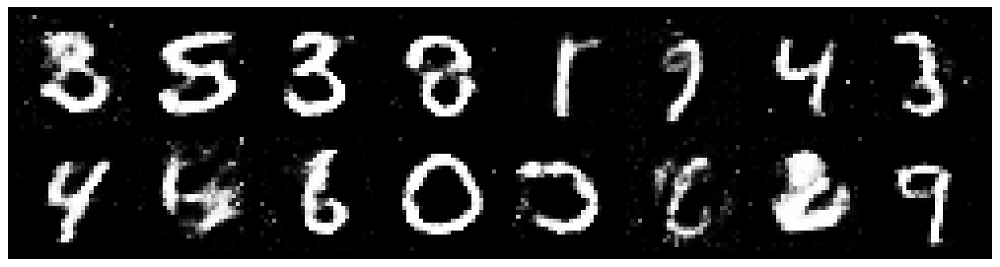

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2844, Generator Loss: 0.8970
D(x): 0.5349, D(G(z)): 0.4265


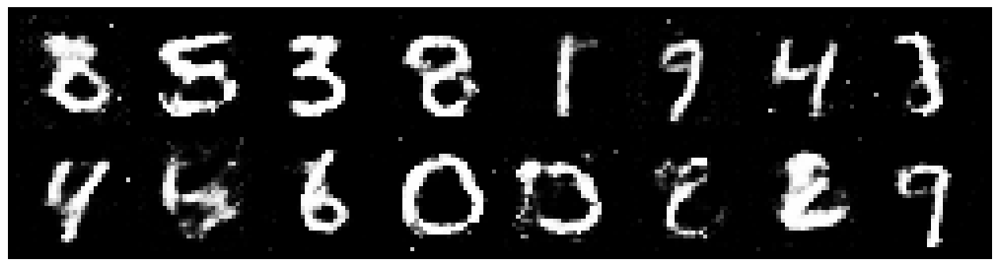

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2762, Generator Loss: 0.9338
D(x): 0.5326, D(G(z)): 0.4196


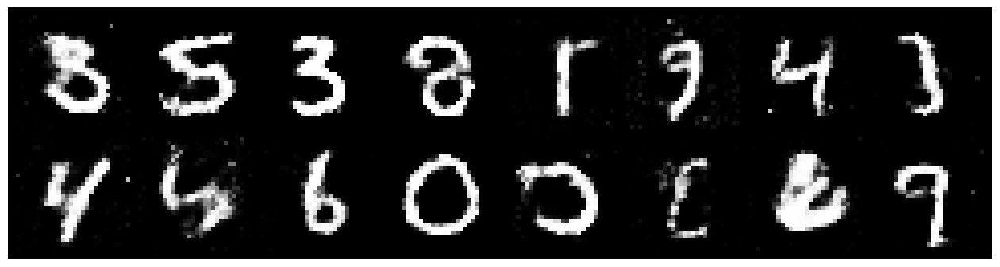

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2477, Generator Loss: 1.0211
D(x): 0.5528, D(G(z)): 0.4106


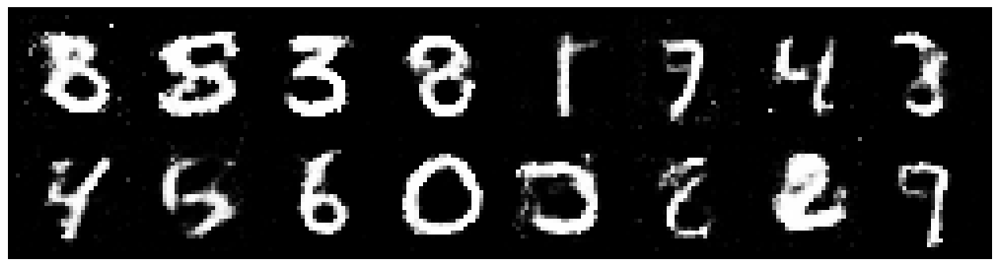

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.1967, Generator Loss: 1.0200
D(x): 0.5791, D(G(z)): 0.4256


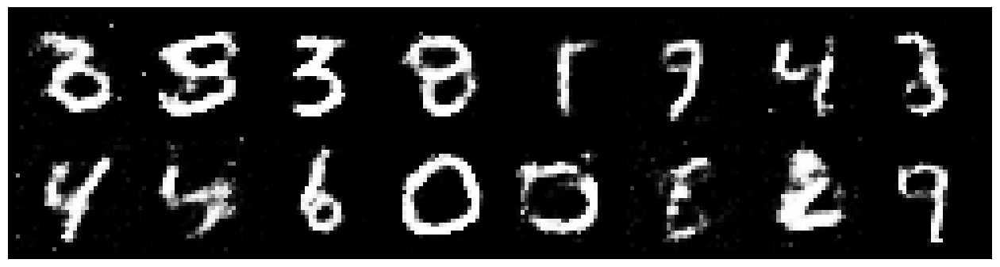

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2540, Generator Loss: 0.8279
D(x): 0.5434, D(G(z)): 0.4392


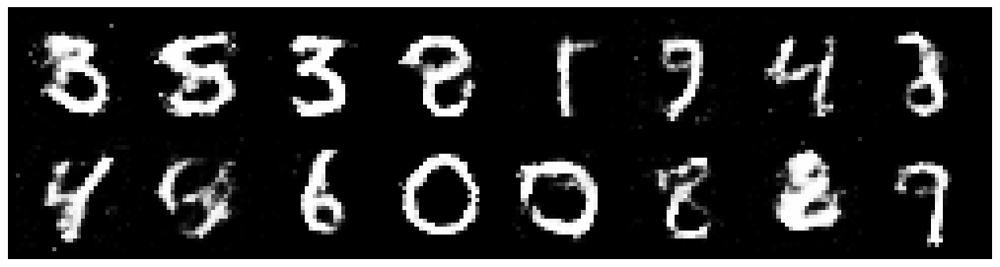

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2908, Generator Loss: 0.9427
D(x): 0.5461, D(G(z)): 0.4445


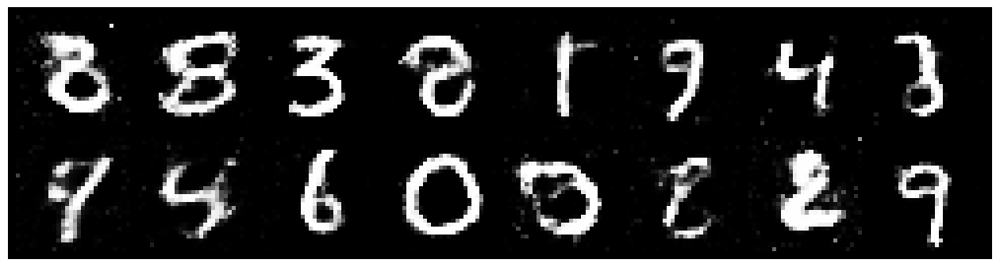

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.3119, Generator Loss: 0.9612
D(x): 0.5356, D(G(z)): 0.4428


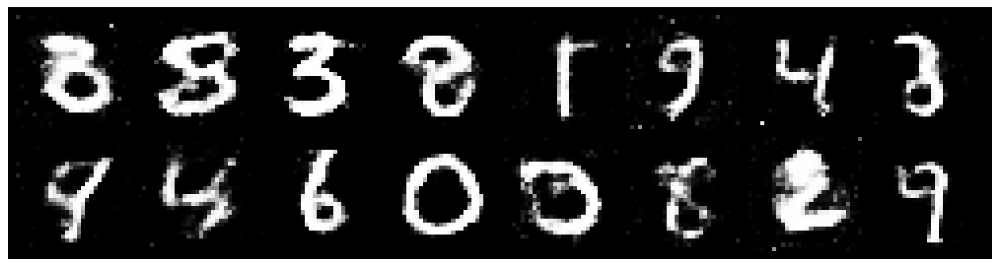

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8019
D(x): 0.5683, D(G(z)): 0.4468


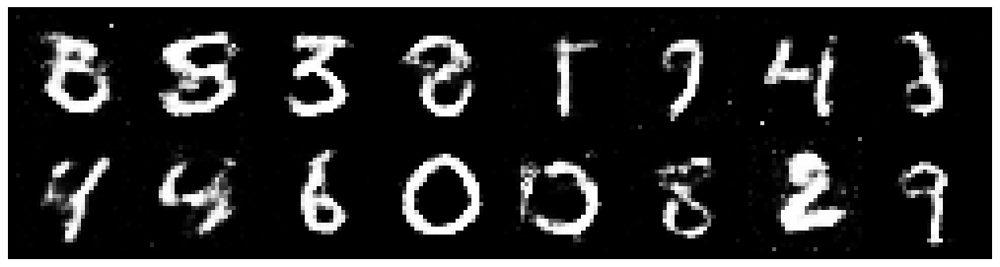

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2591, Generator Loss: 0.9594
D(x): 0.5275, D(G(z)): 0.4267


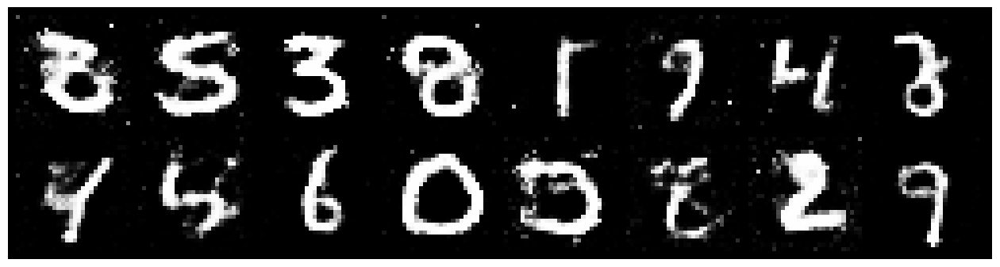

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2535, Generator Loss: 0.9742
D(x): 0.5359, D(G(z)): 0.4156


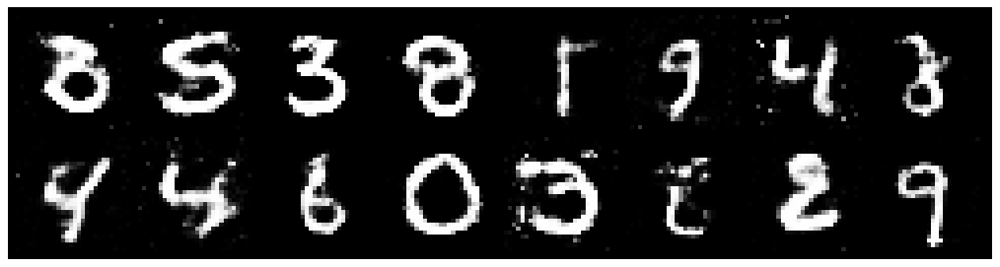

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3159, Generator Loss: 1.1251
D(x): 0.5370, D(G(z)): 0.4517


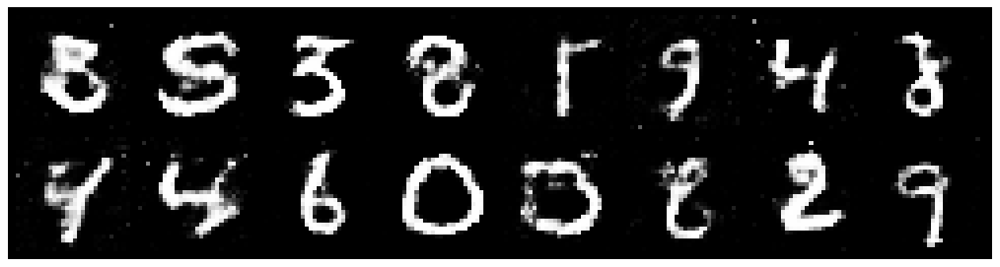

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2984, Generator Loss: 0.9855
D(x): 0.5554, D(G(z)): 0.4500


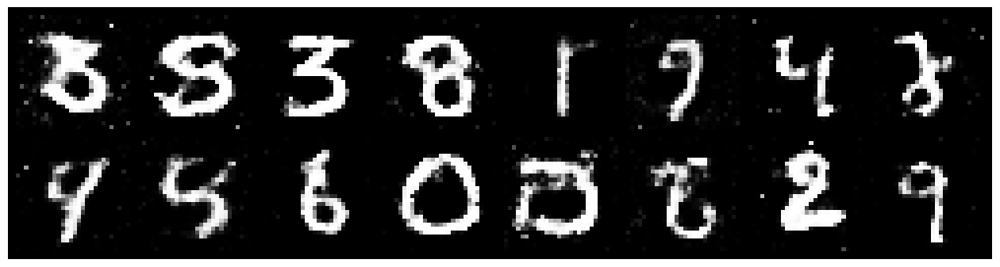

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.3622, Generator Loss: 0.8075
D(x): 0.5376, D(G(z)): 0.4836


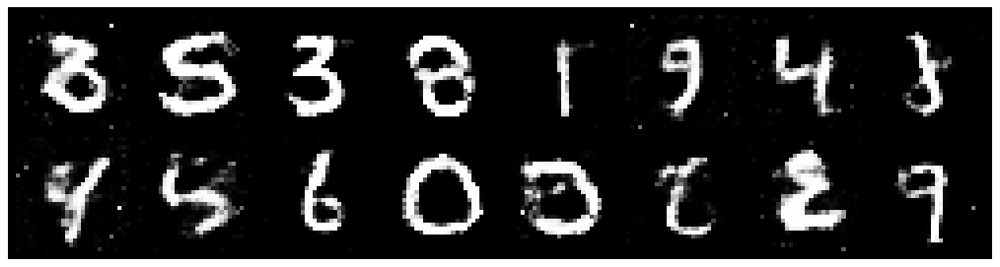

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.3956, Generator Loss: 0.8621
D(x): 0.5378, D(G(z)): 0.4741


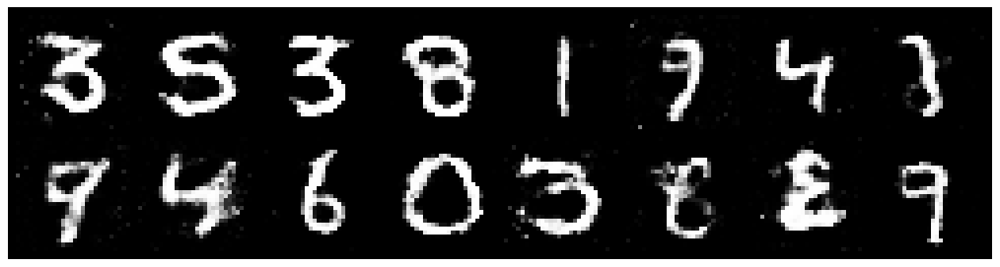

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3151, Generator Loss: 0.8254
D(x): 0.5788, D(G(z)): 0.4756


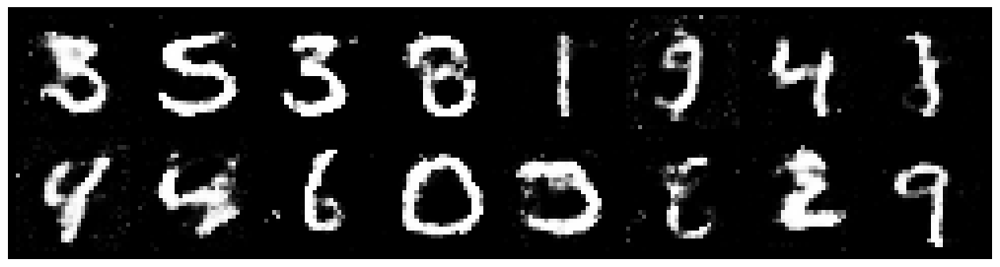

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3134, Generator Loss: 0.9098
D(x): 0.5307, D(G(z)): 0.4609


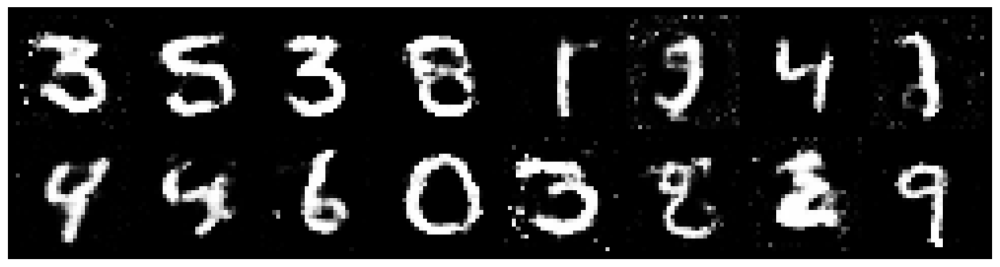

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.1921, Generator Loss: 0.8635
D(x): 0.5826, D(G(z)): 0.4310


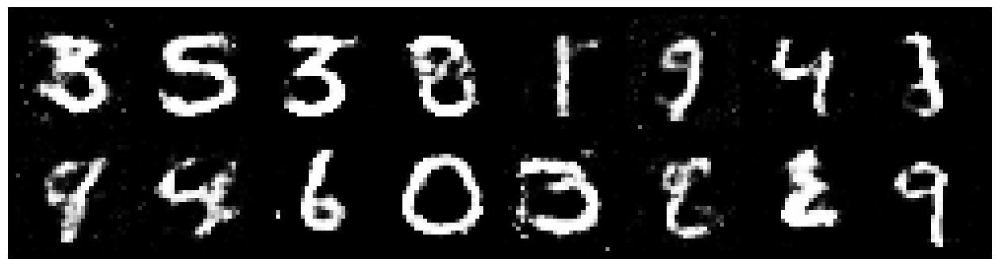

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2556, Generator Loss: 1.0423
D(x): 0.5400, D(G(z)): 0.4115


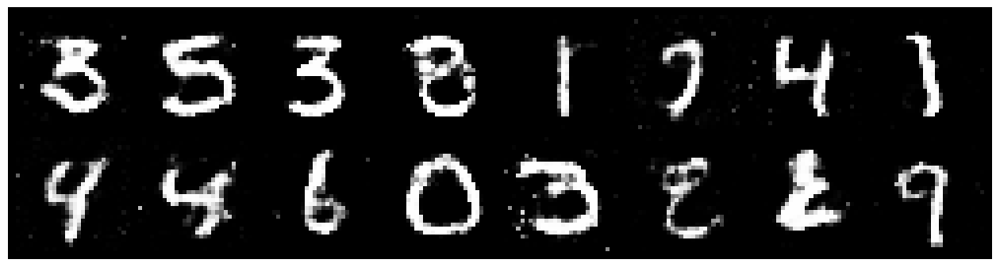

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.3165, Generator Loss: 0.8673
D(x): 0.5654, D(G(z)): 0.4552


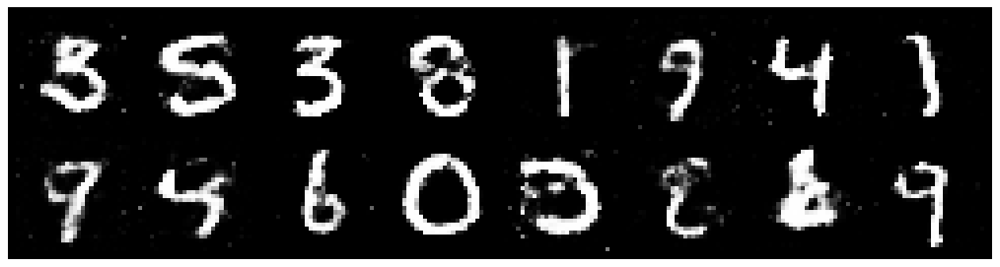

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3488, Generator Loss: 0.8371
D(x): 0.5541, D(G(z)): 0.4931


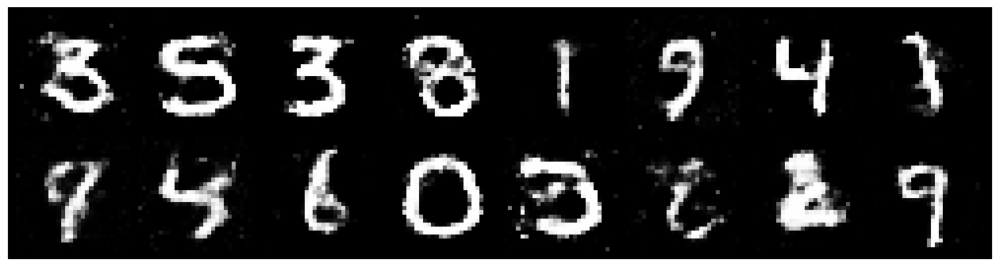

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2677, Generator Loss: 0.8732
D(x): 0.5749, D(G(z)): 0.4466


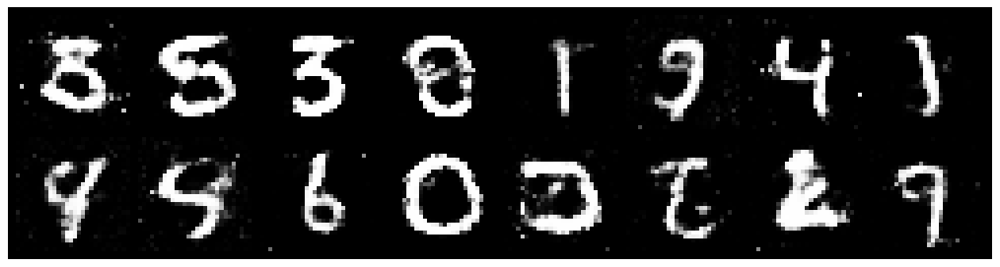

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2917, Generator Loss: 0.9061
D(x): 0.5407, D(G(z)): 0.4543


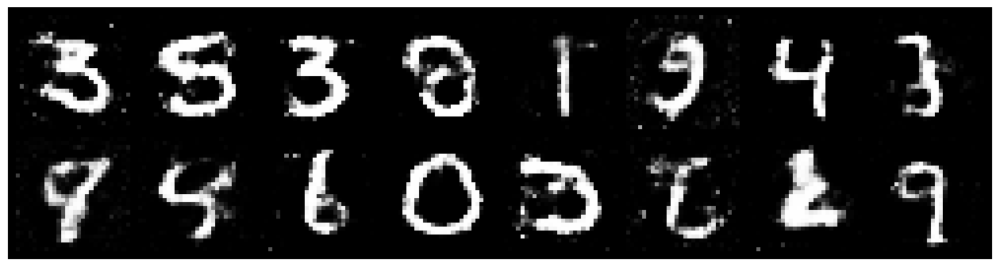

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2267, Generator Loss: 0.8779
D(x): 0.5355, D(G(z)): 0.4046


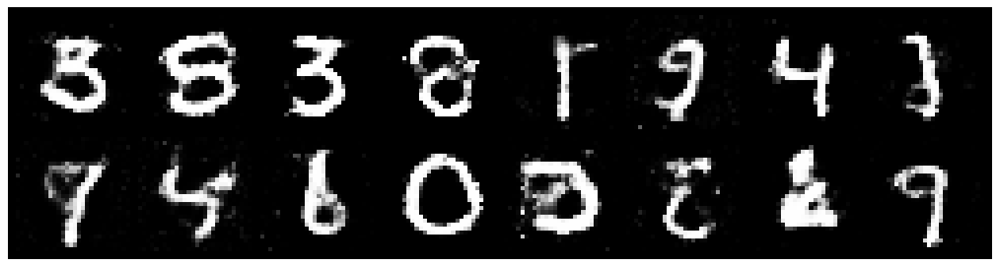

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2398, Generator Loss: 0.8545
D(x): 0.5527, D(G(z)): 0.4463


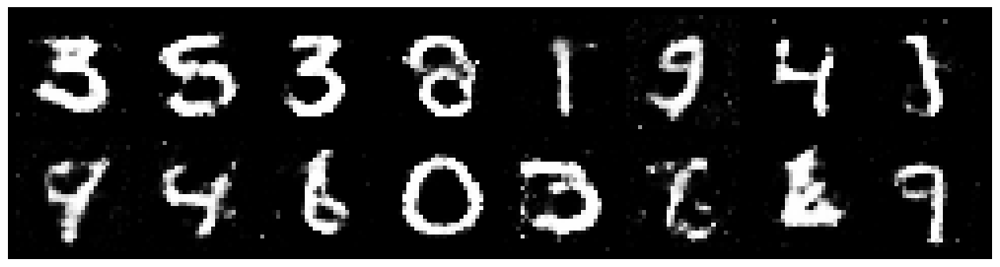

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2706, Generator Loss: 0.8559
D(x): 0.5534, D(G(z)): 0.4572


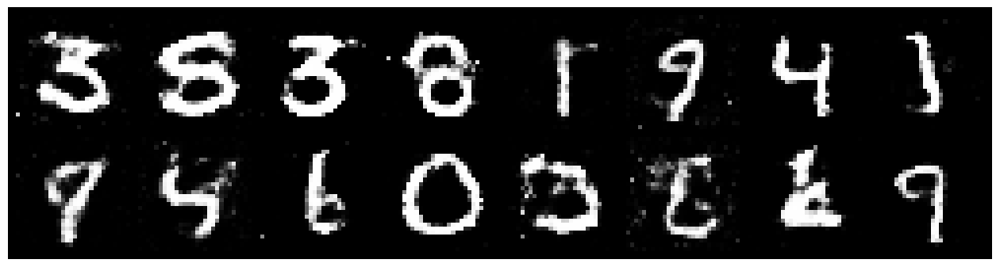

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2989, Generator Loss: 0.7844
D(x): 0.5589, D(G(z)): 0.4657


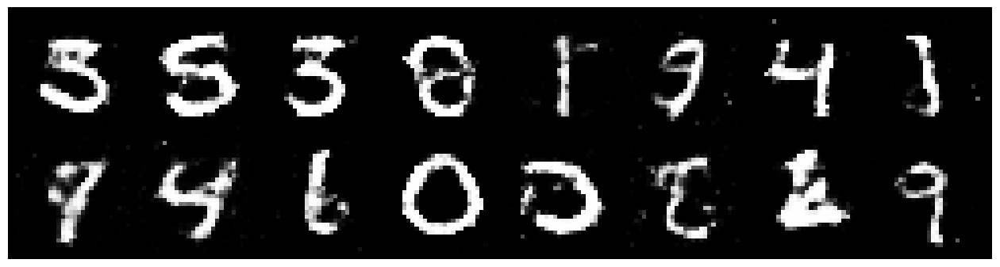

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8274
D(x): 0.5582, D(G(z)): 0.4618


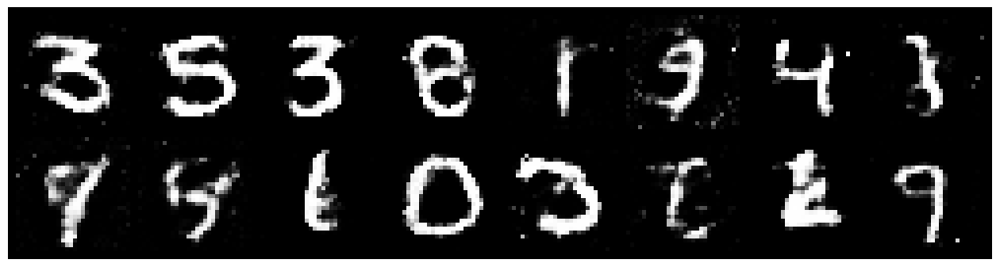

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3622, Generator Loss: 0.8737
D(x): 0.4925, D(G(z)): 0.4294


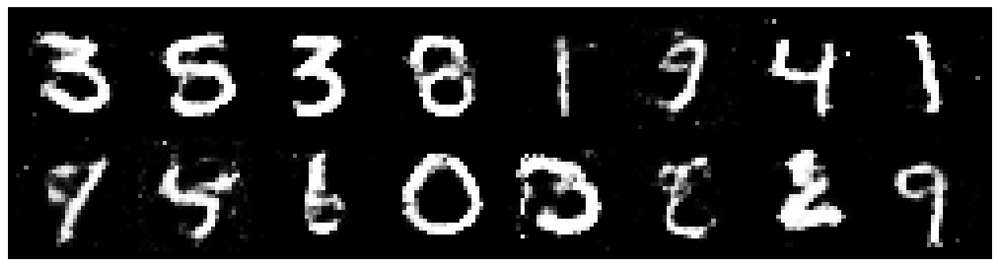

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2375, Generator Loss: 0.8167
D(x): 0.5905, D(G(z)): 0.4641


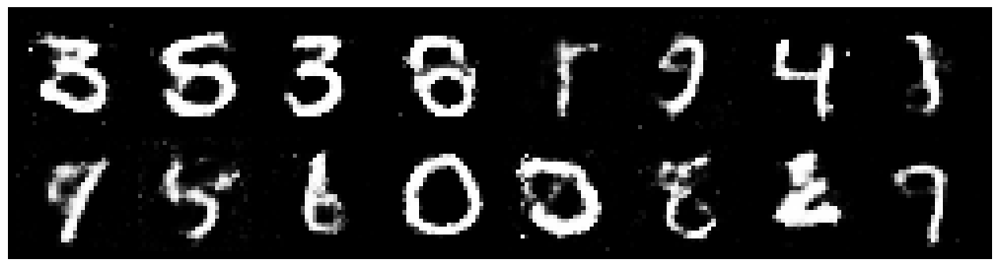

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8493
D(x): 0.5768, D(G(z)): 0.4628


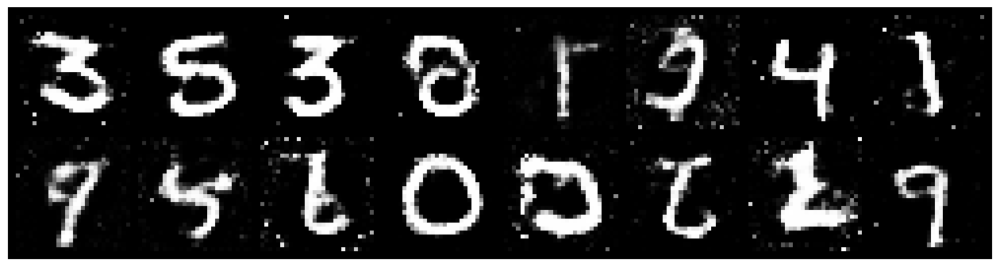

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3536, Generator Loss: 0.9258
D(x): 0.5511, D(G(z)): 0.4483


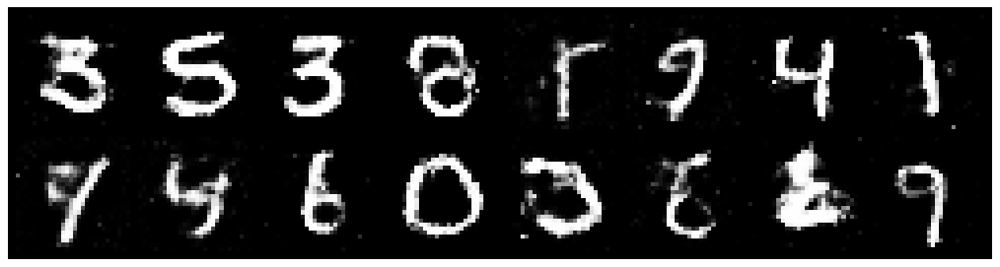

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2553, Generator Loss: 0.8654
D(x): 0.5469, D(G(z)): 0.4398


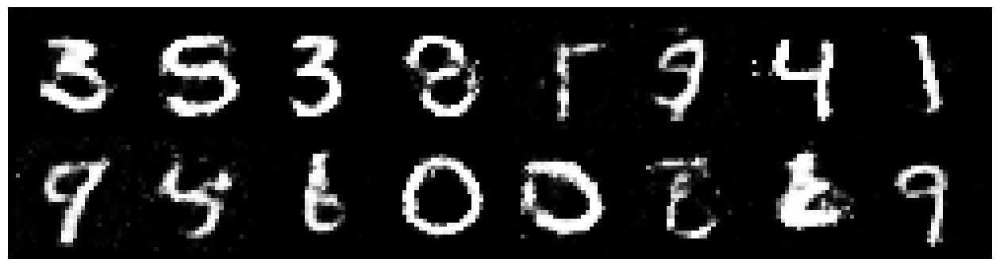

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2639, Generator Loss: 0.8489
D(x): 0.5868, D(G(z)): 0.4703


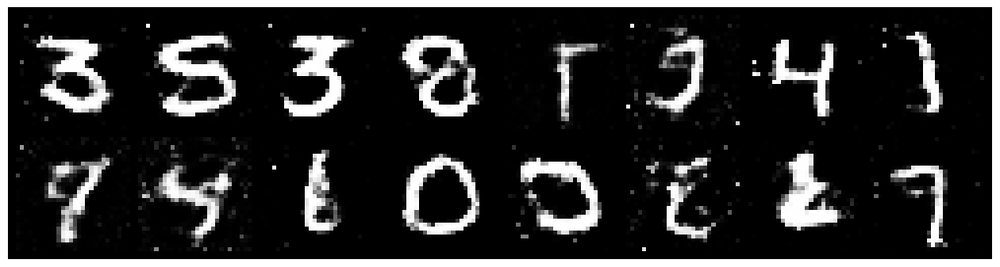

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2951, Generator Loss: 1.0175
D(x): 0.5231, D(G(z)): 0.4208


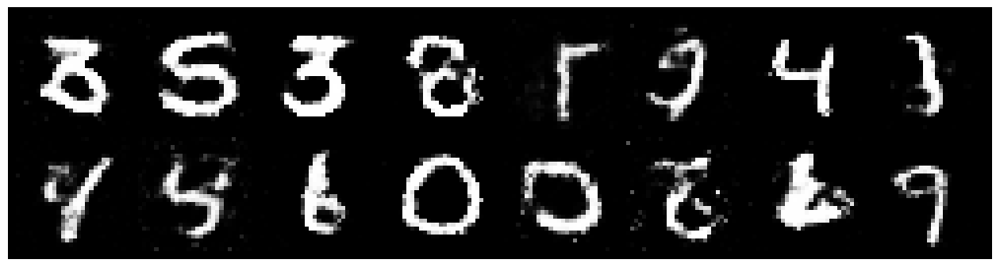

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2046, Generator Loss: 0.9264
D(x): 0.5821, D(G(z)): 0.4322


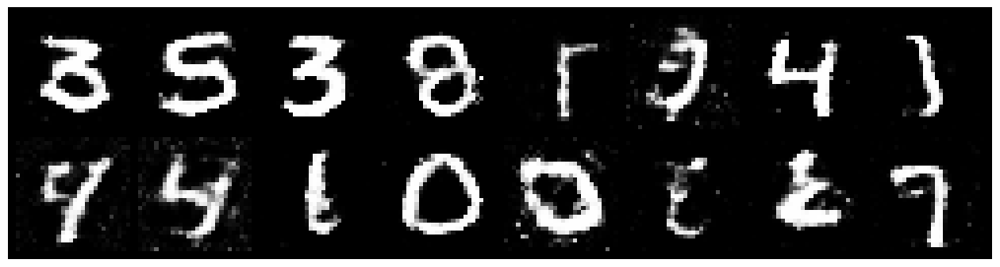

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.0902, Generator Loss: 0.9637
D(x): 0.5779, D(G(z)): 0.3811


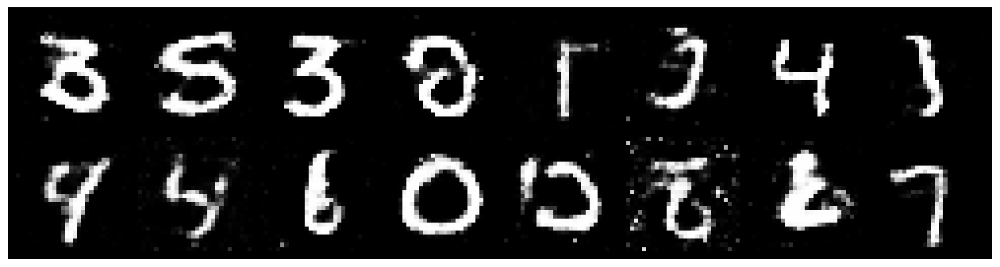

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2013, Generator Loss: 1.0057
D(x): 0.5668, D(G(z)): 0.3950


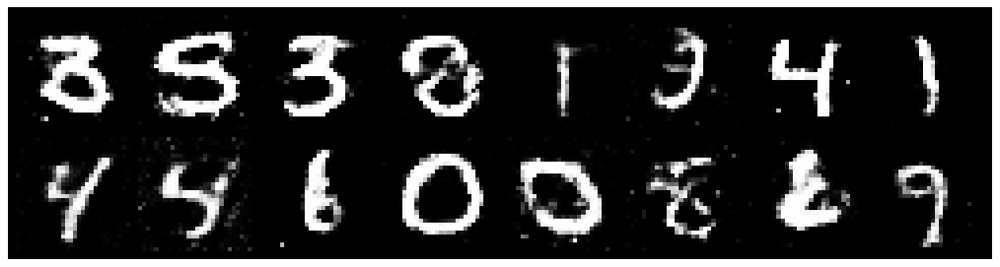

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2126, Generator Loss: 0.9371
D(x): 0.5608, D(G(z)): 0.4256


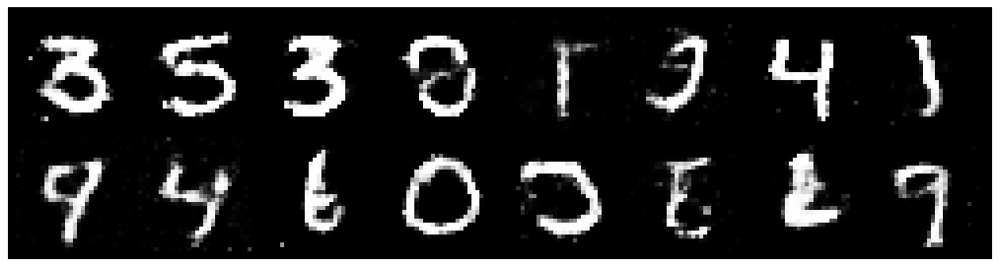

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2360, Generator Loss: 1.0731
D(x): 0.6083, D(G(z)): 0.4477


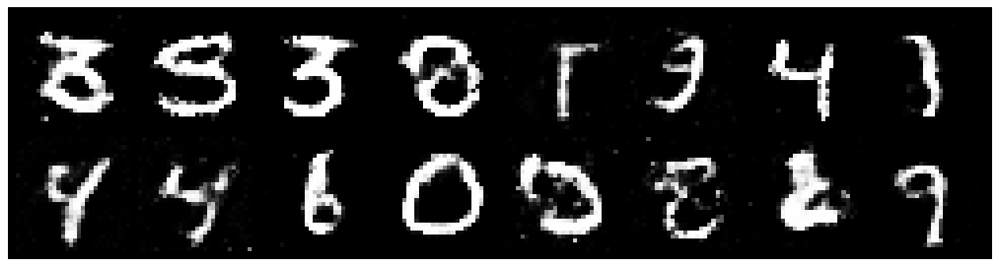

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.1529, Generator Loss: 1.1407
D(x): 0.5692, D(G(z)): 0.3880


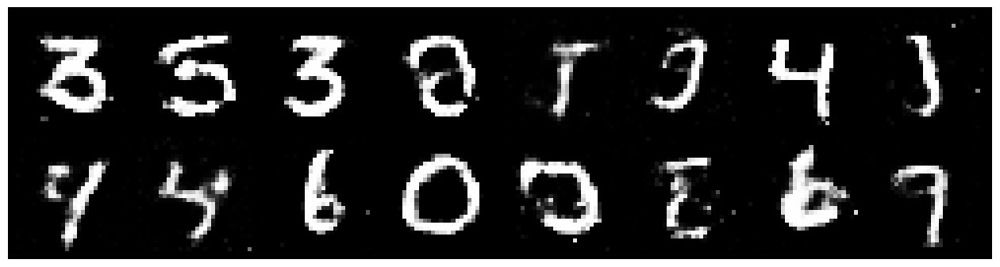

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2070, Generator Loss: 0.9345
D(x): 0.5784, D(G(z)): 0.4304


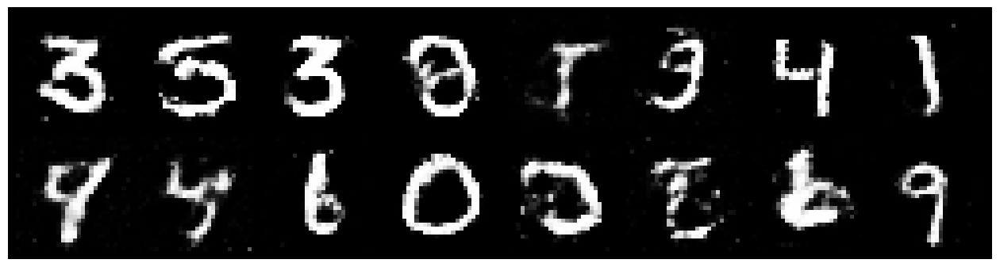

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1333, Generator Loss: 0.9286
D(x): 0.5974, D(G(z)): 0.4124


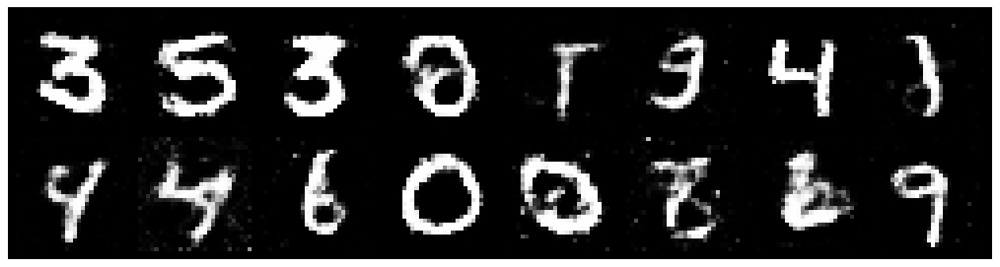

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.0974, Generator Loss: 1.0085
D(x): 0.6186, D(G(z)): 0.4034


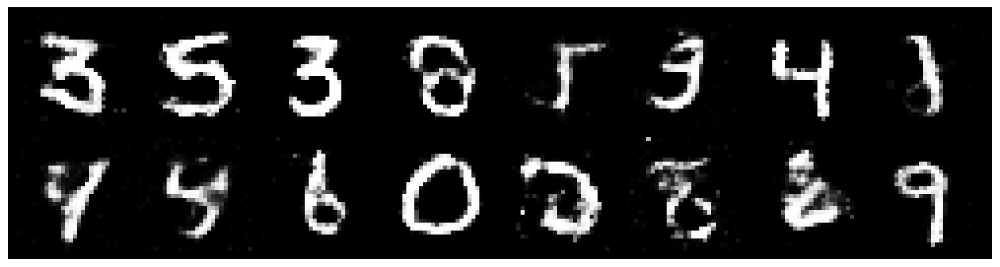

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.3483, Generator Loss: 0.9005
D(x): 0.5378, D(G(z)): 0.4674


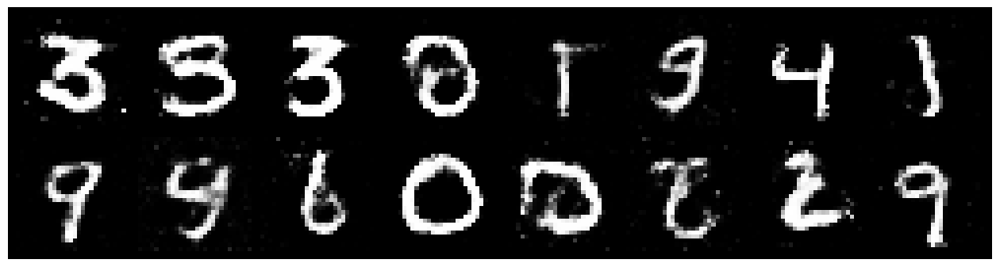

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3292, Generator Loss: 0.9311
D(x): 0.5044, D(G(z)): 0.4298


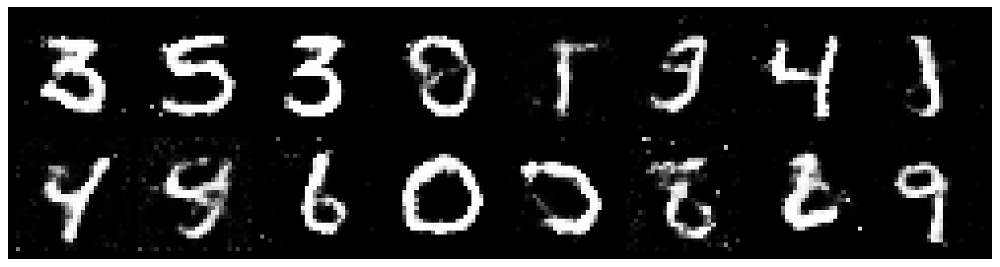

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2822, Generator Loss: 0.7767
D(x): 0.5373, D(G(z)): 0.4455


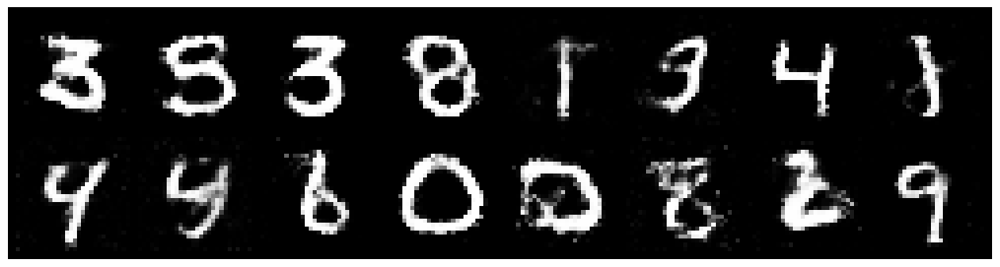

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2709, Generator Loss: 1.0000
D(x): 0.5563, D(G(z)): 0.4072


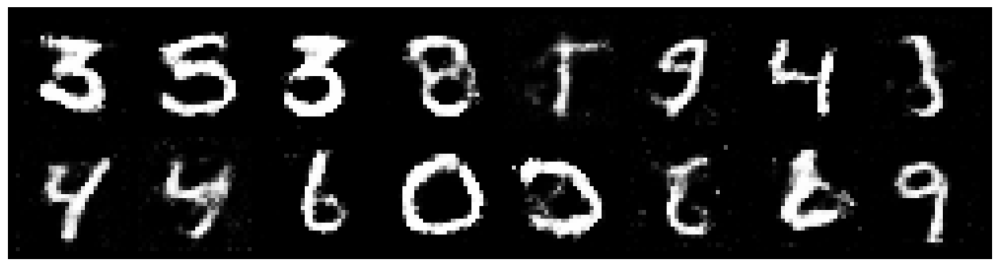

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2957, Generator Loss: 0.9811
D(x): 0.5524, D(G(z)): 0.4646


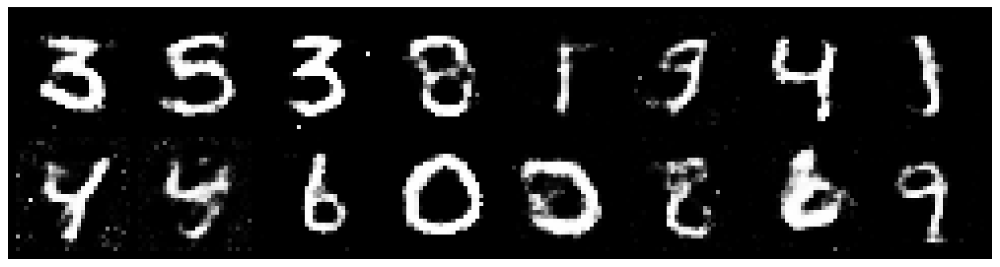

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2833, Generator Loss: 0.8249
D(x): 0.5448, D(G(z)): 0.4508


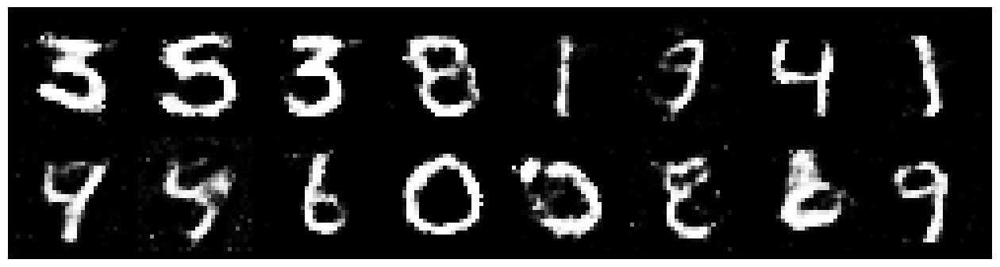

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2269, Generator Loss: 0.9302
D(x): 0.5514, D(G(z)): 0.4255


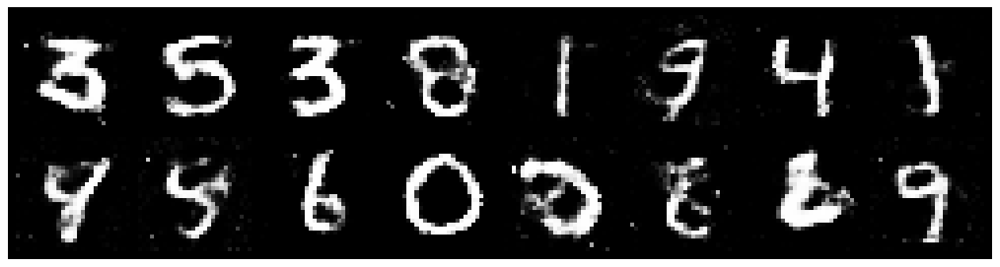

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3060, Generator Loss: 0.9686
D(x): 0.5271, D(G(z)): 0.4283


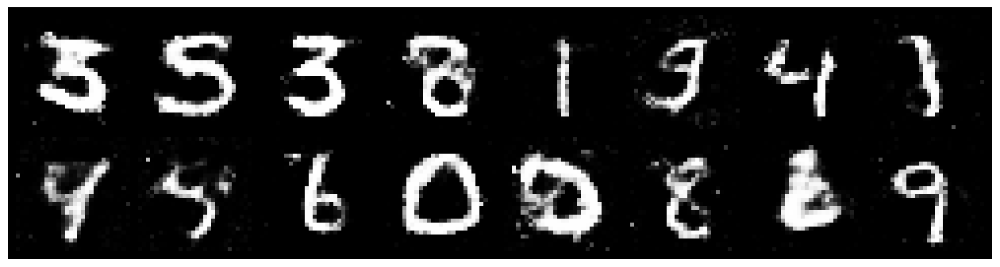

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2282, Generator Loss: 0.8629
D(x): 0.5338, D(G(z)): 0.4170


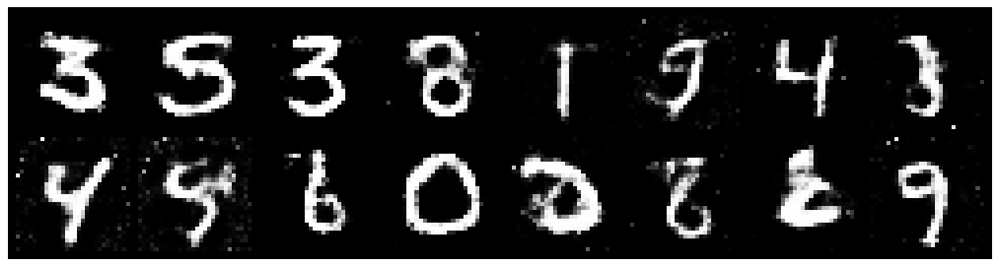

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8783
D(x): 0.5681, D(G(z)): 0.4750


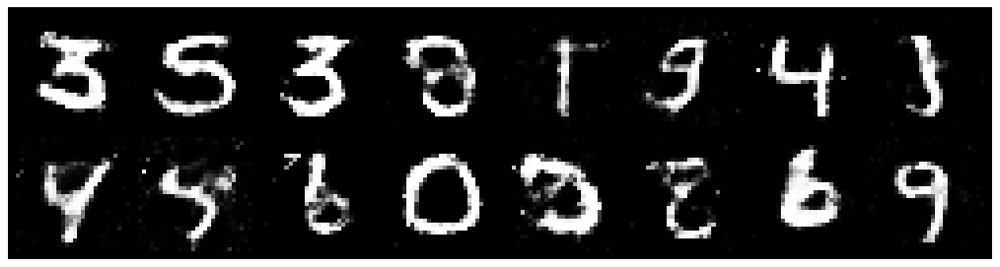

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2208, Generator Loss: 0.9911
D(x): 0.5738, D(G(z)): 0.4241


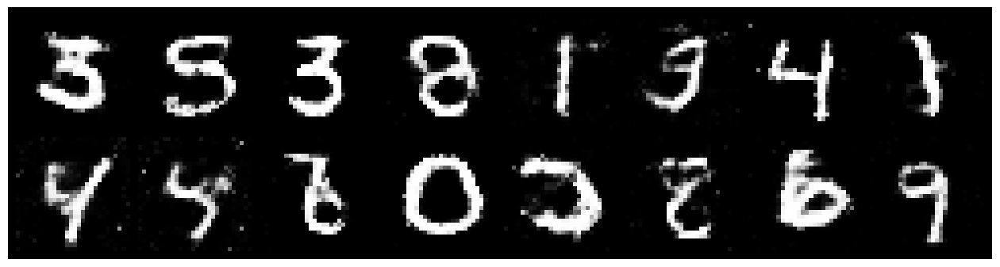

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2608, Generator Loss: 0.7857
D(x): 0.6032, D(G(z)): 0.4562


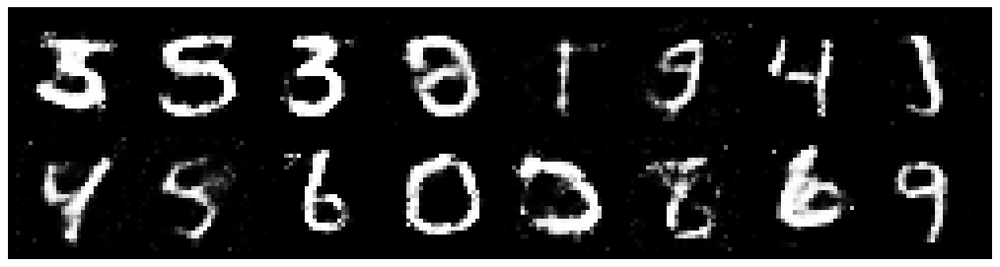

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.4032, Generator Loss: 0.8159
D(x): 0.5297, D(G(z)): 0.4759


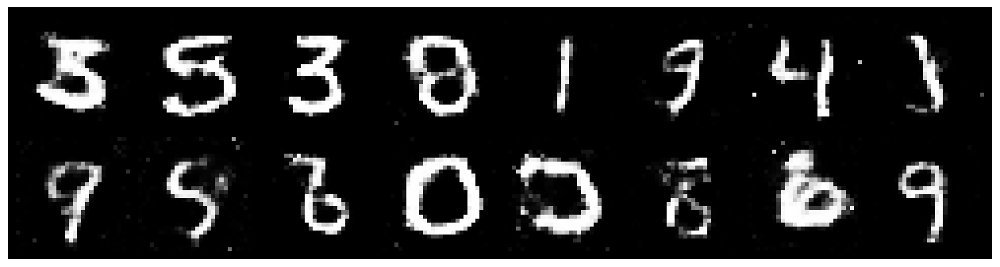

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3024, Generator Loss: 0.7859
D(x): 0.5667, D(G(z)): 0.4738


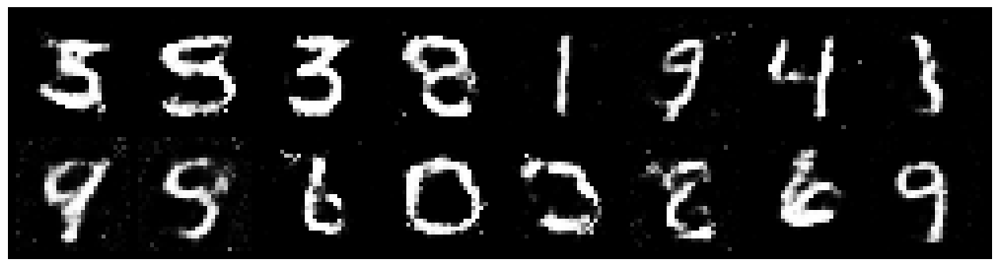

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2979, Generator Loss: 0.8869
D(x): 0.5511, D(G(z)): 0.4628


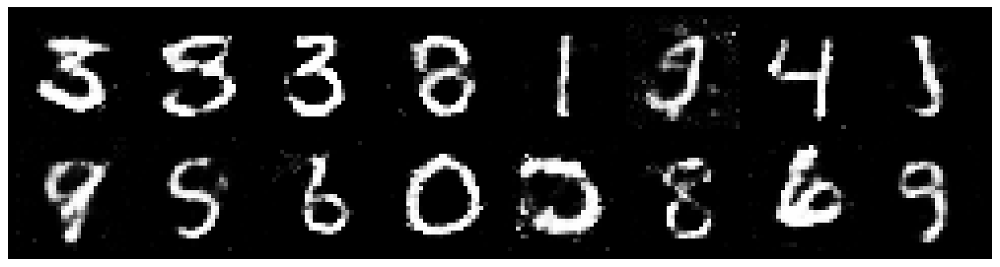

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3197, Generator Loss: 0.8087
D(x): 0.5293, D(G(z)): 0.4515


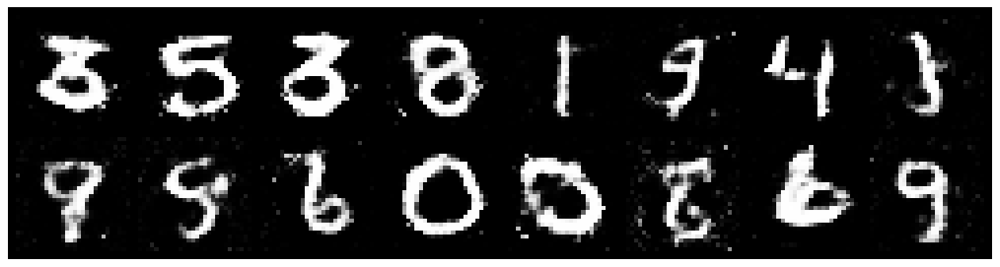

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2871, Generator Loss: 0.8065
D(x): 0.5463, D(G(z)): 0.4464


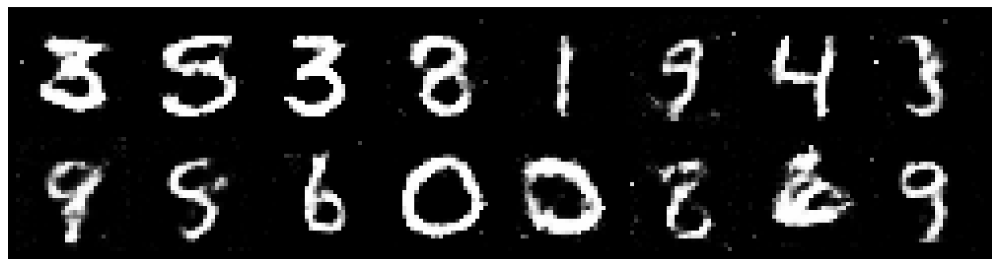

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3901, Generator Loss: 0.8089
D(x): 0.5234, D(G(z)): 0.4733


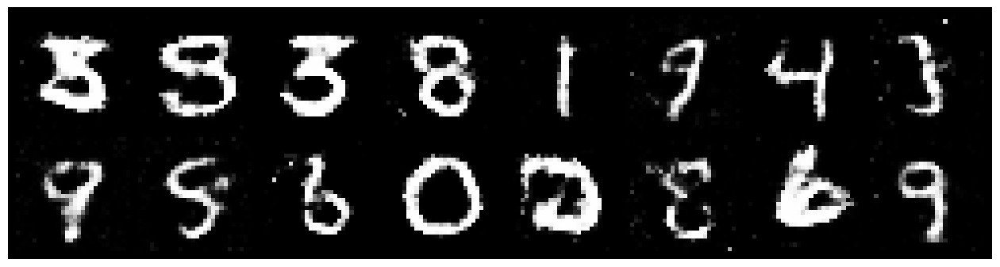

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3865, Generator Loss: 0.8442
D(x): 0.5111, D(G(z)): 0.4603


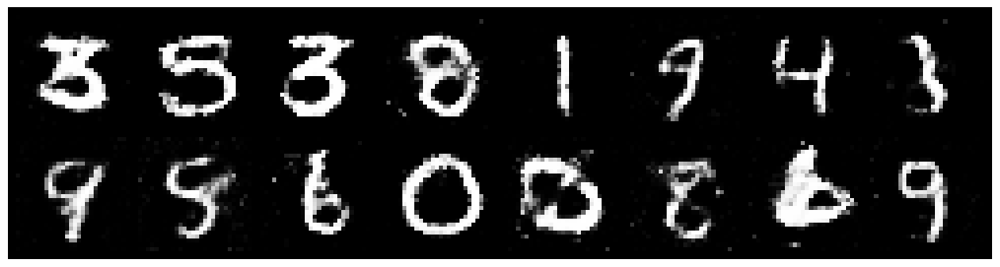

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3671, Generator Loss: 0.8477
D(x): 0.5024, D(G(z)): 0.4515


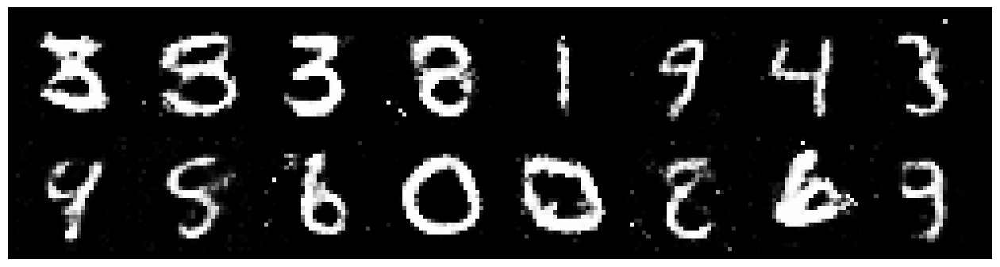

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.3706, Generator Loss: 0.8104
D(x): 0.5378, D(G(z)): 0.4900


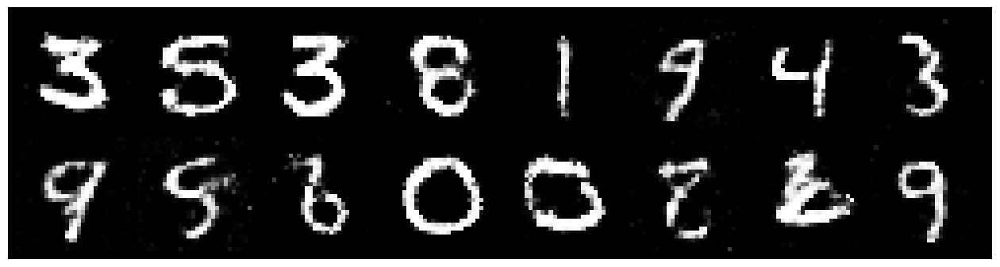

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2886, Generator Loss: 0.8700
D(x): 0.5717, D(G(z)): 0.4763


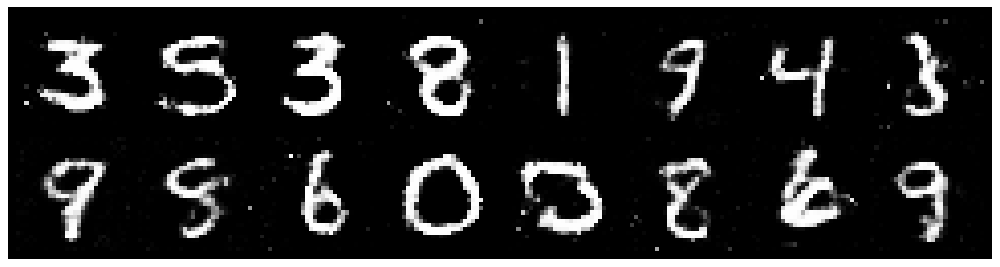

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2232, Generator Loss: 0.8848
D(x): 0.5461, D(G(z)): 0.4265


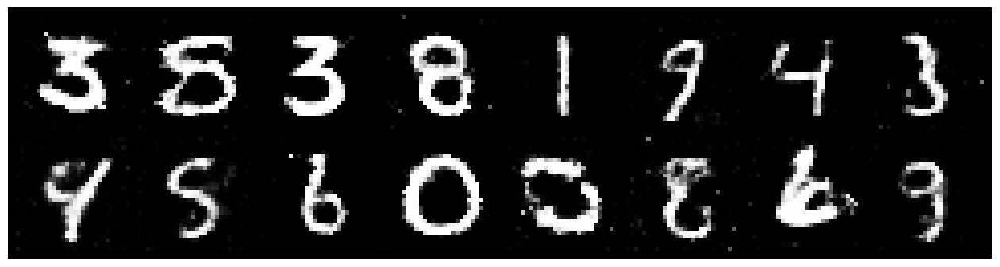

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2476, Generator Loss: 0.8501
D(x): 0.5524, D(G(z)): 0.4460


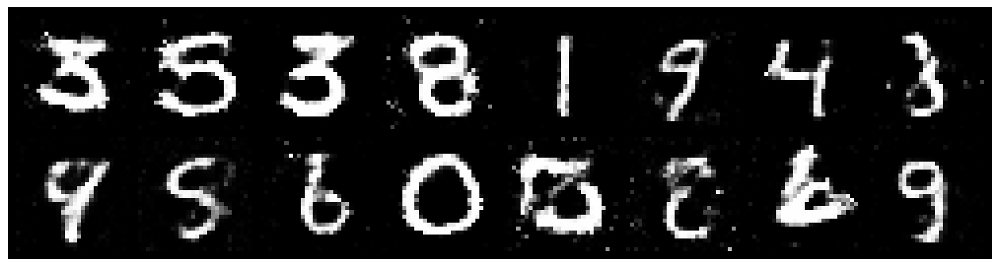

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2737, Generator Loss: 0.9188
D(x): 0.5535, D(G(z)): 0.4494


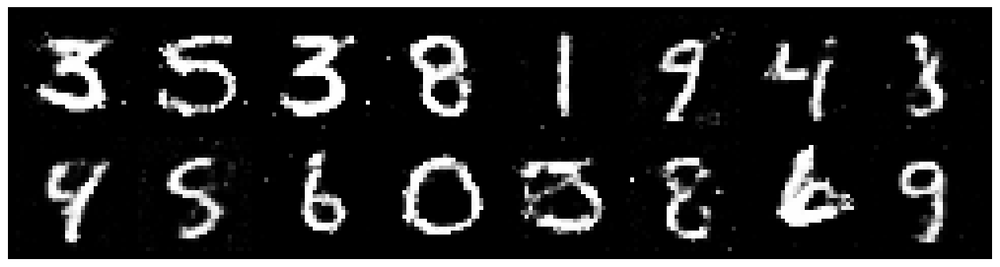

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2638, Generator Loss: 0.9960
D(x): 0.5346, D(G(z)): 0.4105


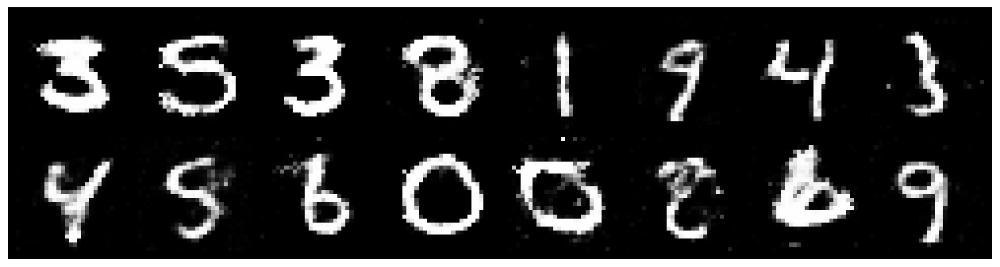

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2134, Generator Loss: 0.9659
D(x): 0.5843, D(G(z)): 0.4248


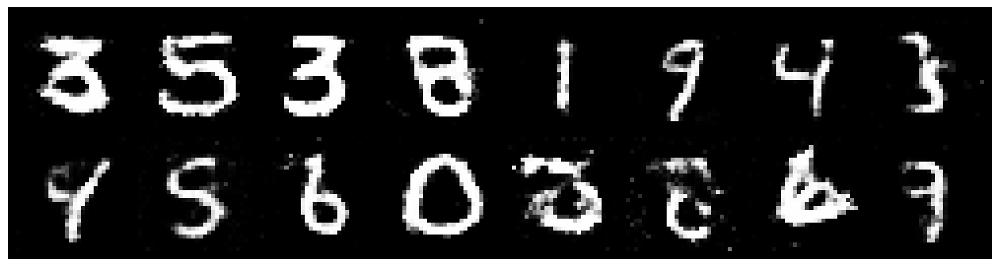

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.1707, Generator Loss: 0.9242
D(x): 0.6140, D(G(z)): 0.4412


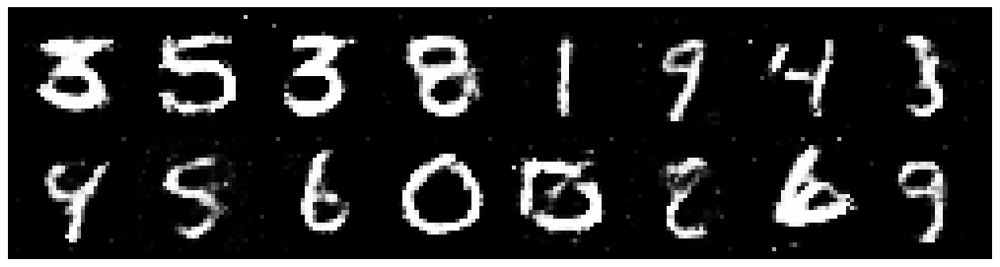

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2280, Generator Loss: 0.8978
D(x): 0.5495, D(G(z)): 0.4368


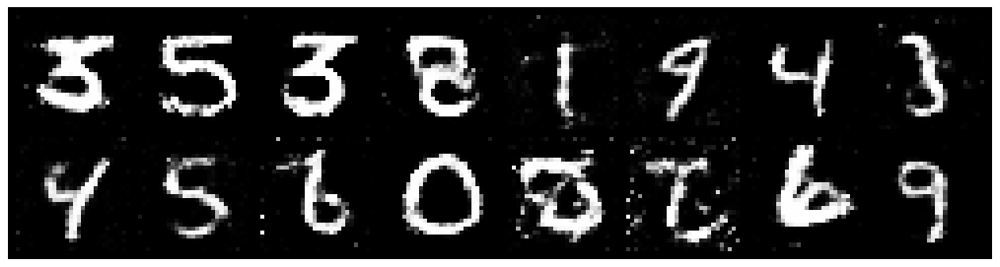

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2767, Generator Loss: 0.9569
D(x): 0.5700, D(G(z)): 0.4347


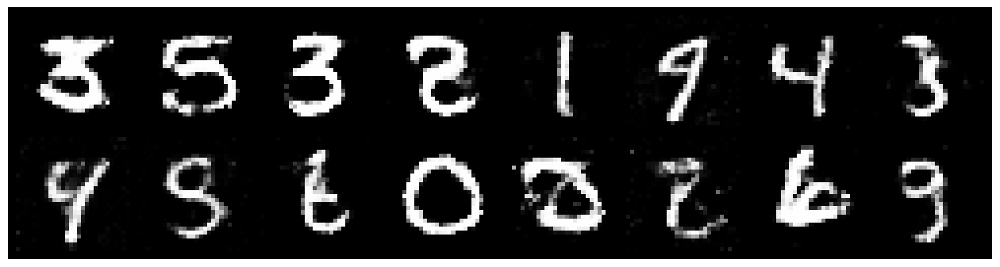

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2602, Generator Loss: 0.7895
D(x): 0.5662, D(G(z)): 0.4553


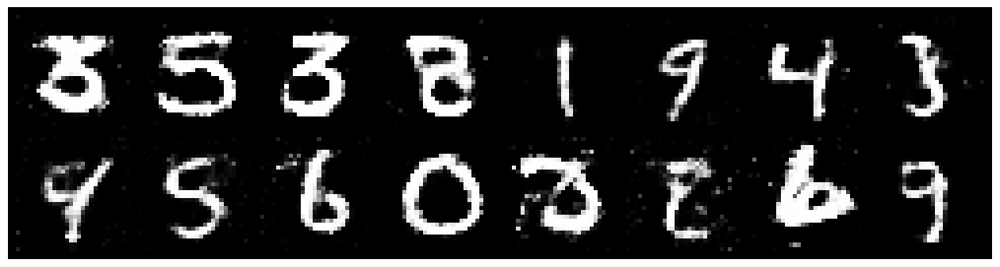

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3507, Generator Loss: 0.9509
D(x): 0.5082, D(G(z)): 0.4384


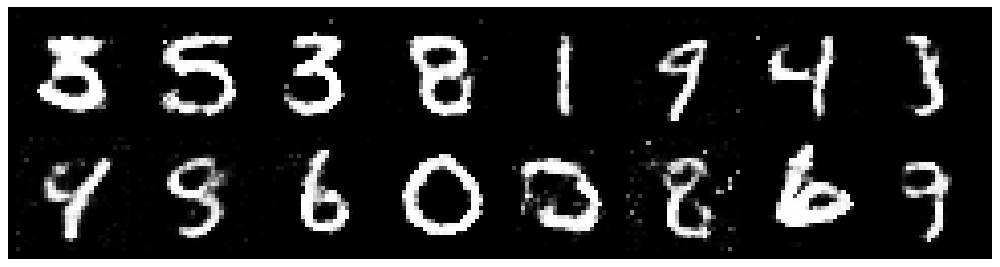

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2976, Generator Loss: 0.8862
D(x): 0.5406, D(G(z)): 0.4432


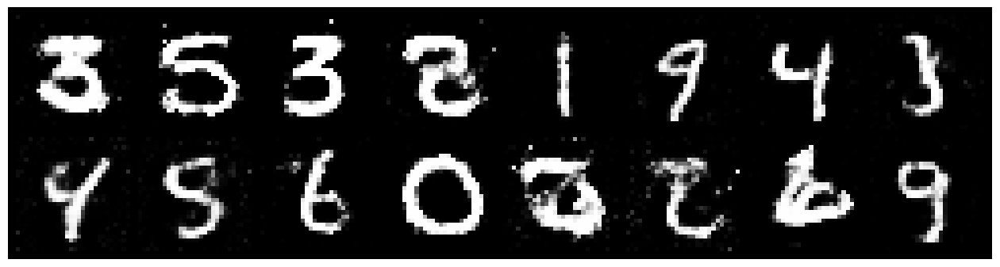

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8204
D(x): 0.5658, D(G(z)): 0.4626


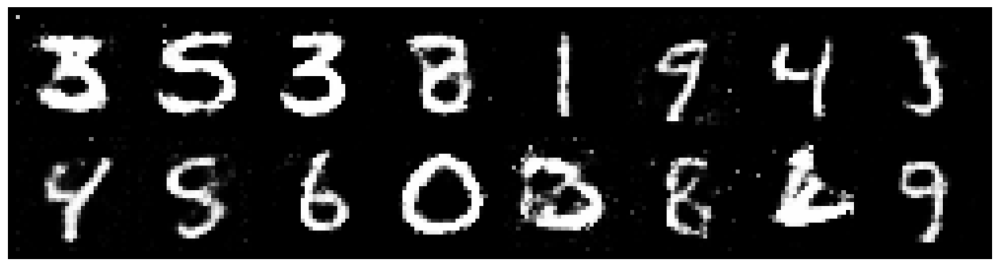

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9146
D(x): 0.5640, D(G(z)): 0.4317


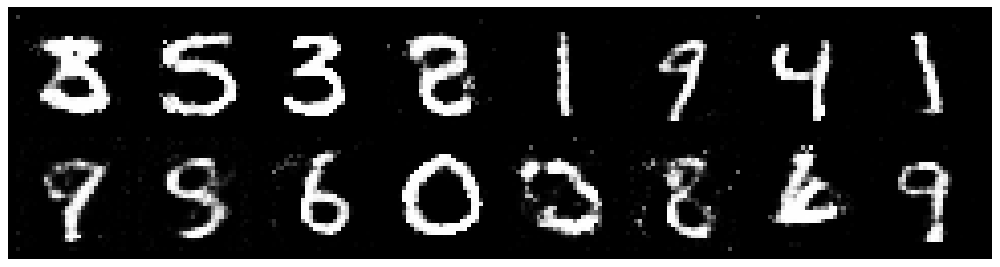

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.1706, Generator Loss: 0.9763
D(x): 0.6100, D(G(z)): 0.4457


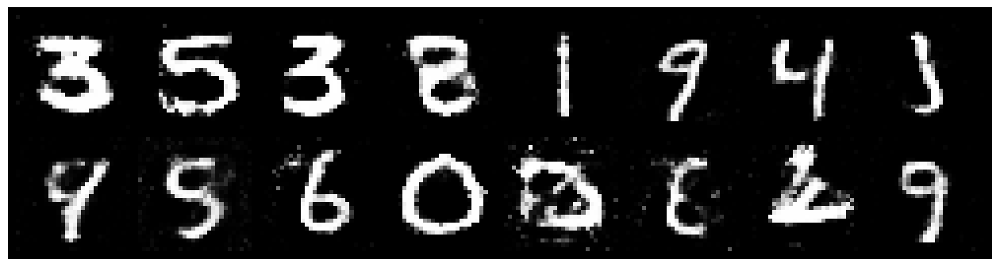

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.1845, Generator Loss: 0.9661
D(x): 0.5847, D(G(z)): 0.4251


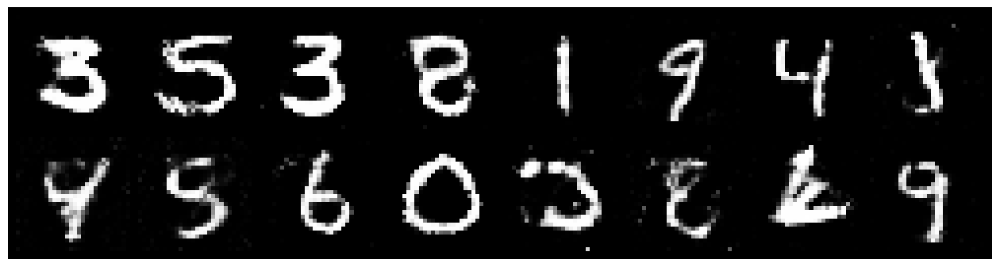

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.1707, Generator Loss: 0.8879
D(x): 0.5682, D(G(z)): 0.4100


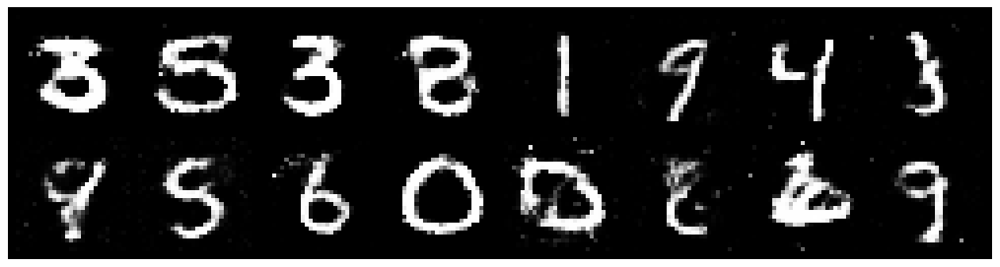

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.3690, Generator Loss: 0.8370
D(x): 0.5146, D(G(z)): 0.4547


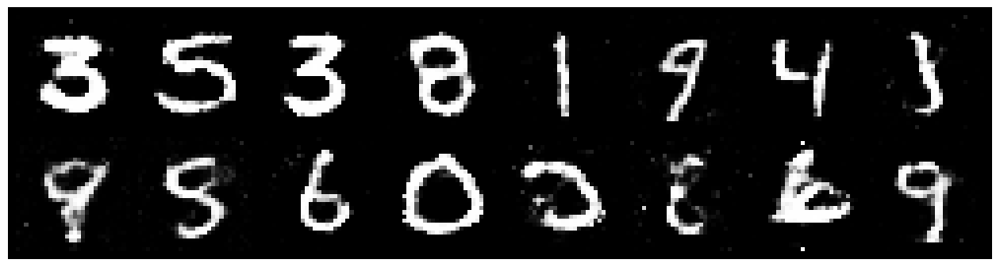

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.3890, Generator Loss: 0.9245
D(x): 0.4943, D(G(z)): 0.4311


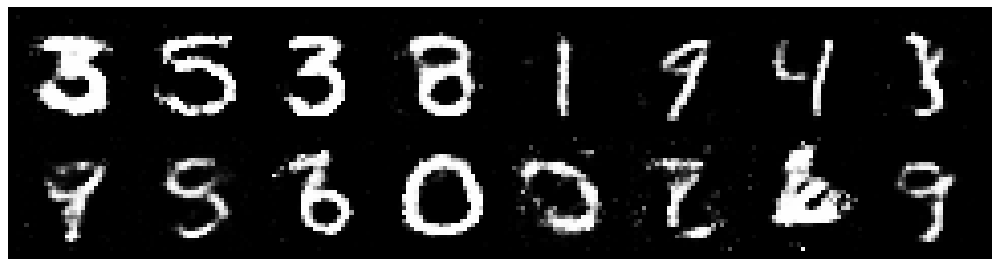

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.3188, Generator Loss: 0.8469
D(x): 0.5151, D(G(z)): 0.4458


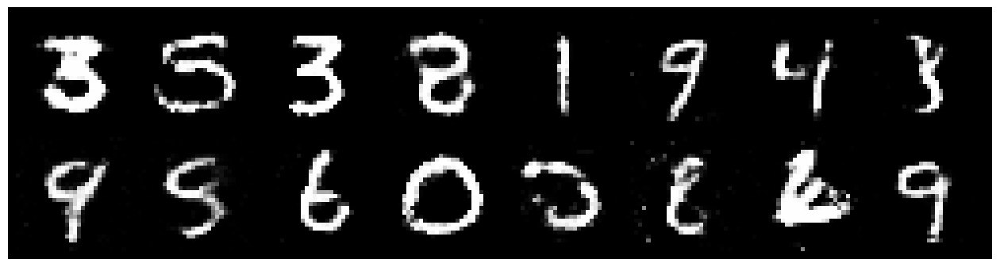

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2843, Generator Loss: 0.7844
D(x): 0.5744, D(G(z)): 0.4743


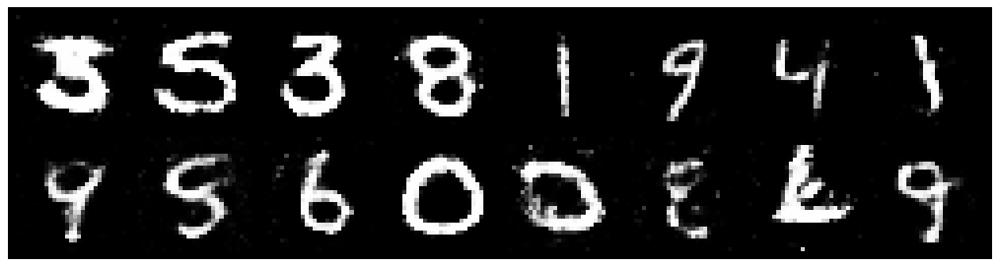

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.3630, Generator Loss: 0.8399
D(x): 0.5100, D(G(z)): 0.4665


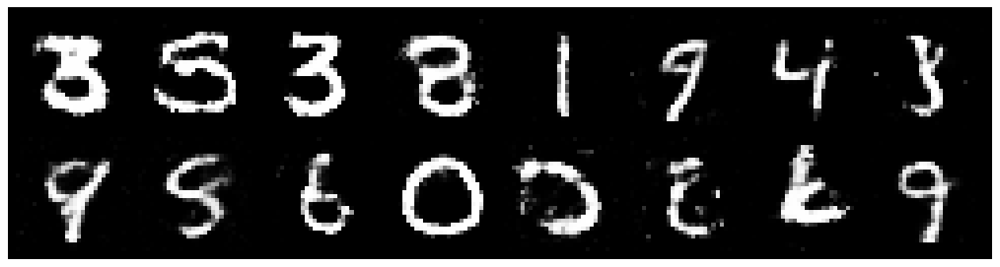

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3235, Generator Loss: 0.8555
D(x): 0.5273, D(G(z)): 0.4620


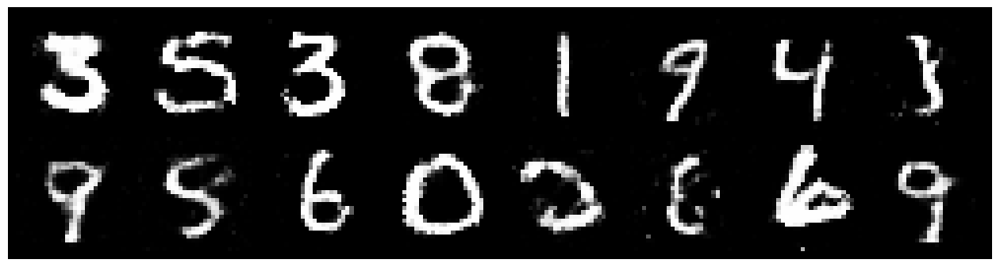

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.3174, Generator Loss: 0.8345
D(x): 0.5388, D(G(z)): 0.4764


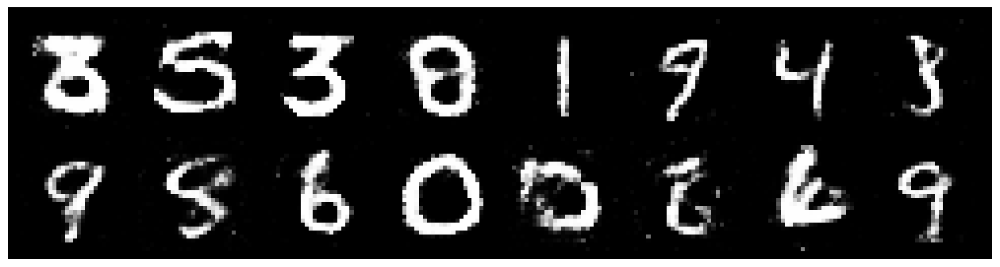

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2524, Generator Loss: 0.8777
D(x): 0.5548, D(G(z)): 0.4487


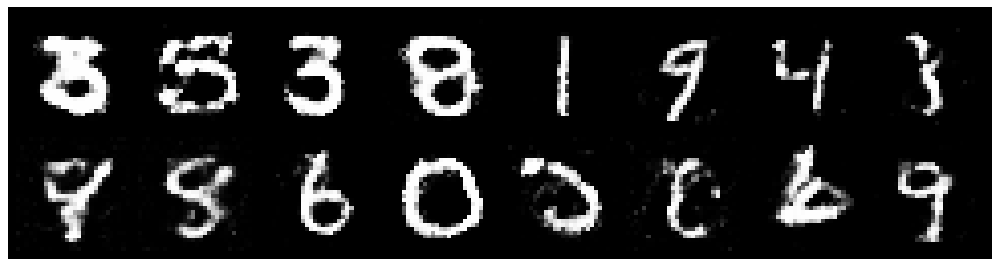

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.2738, Generator Loss: 0.8272
D(x): 0.5244, D(G(z)): 0.4411


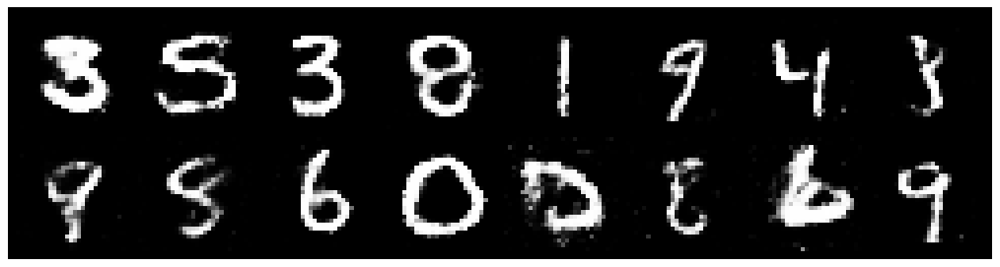

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.3566, Generator Loss: 0.8629
D(x): 0.4909, D(G(z)): 0.4453


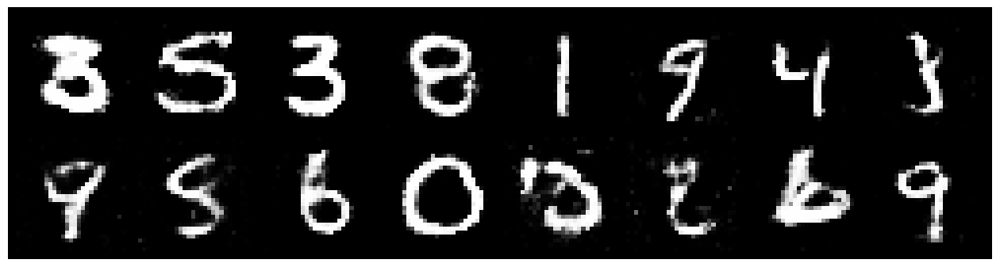

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8566
D(x): 0.5583, D(G(z)): 0.4461


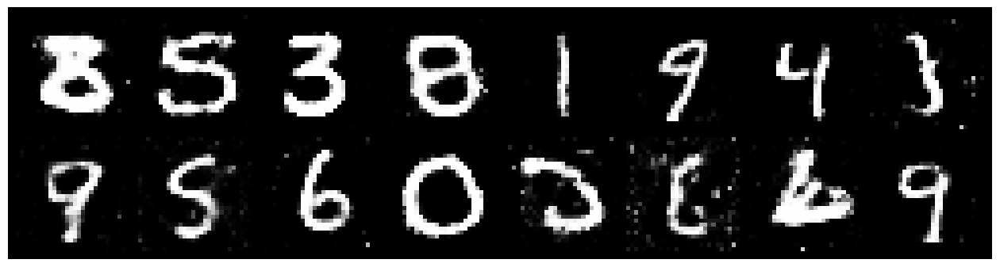

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2530, Generator Loss: 0.8656
D(x): 0.6145, D(G(z)): 0.4765


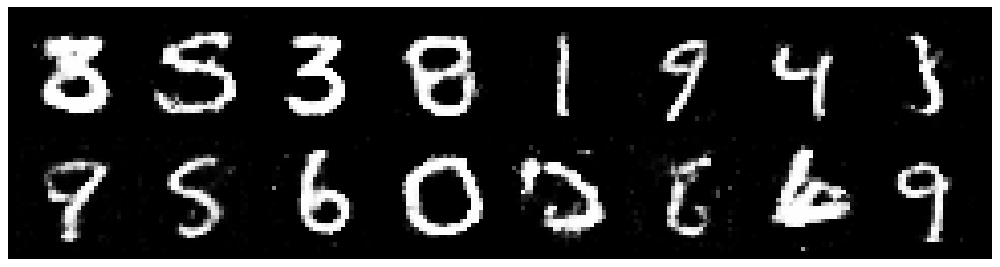

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2544, Generator Loss: 1.0278
D(x): 0.5347, D(G(z)): 0.3801


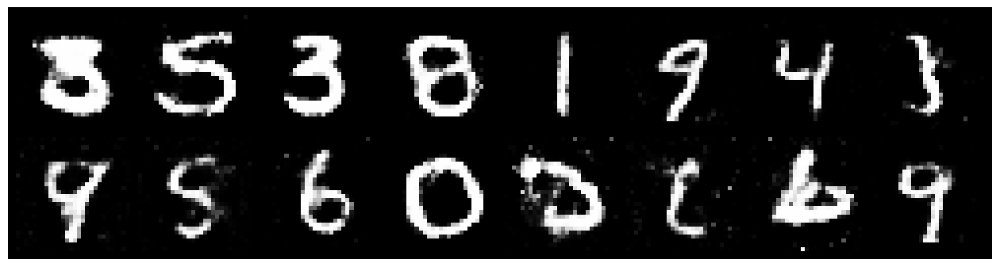

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.1787, Generator Loss: 0.9745
D(x): 0.5545, D(G(z)): 0.3931


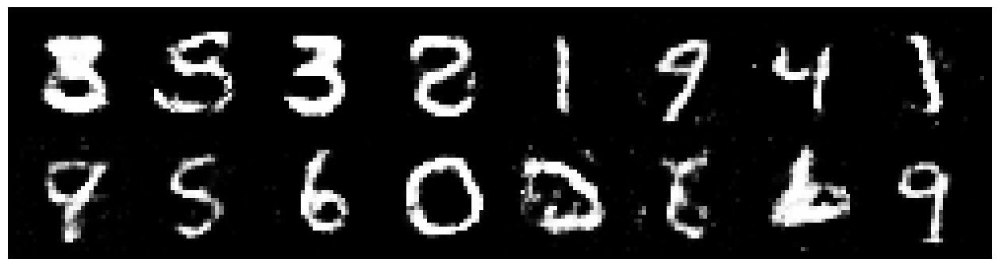

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2201, Generator Loss: 0.8732
D(x): 0.6132, D(G(z)): 0.4656


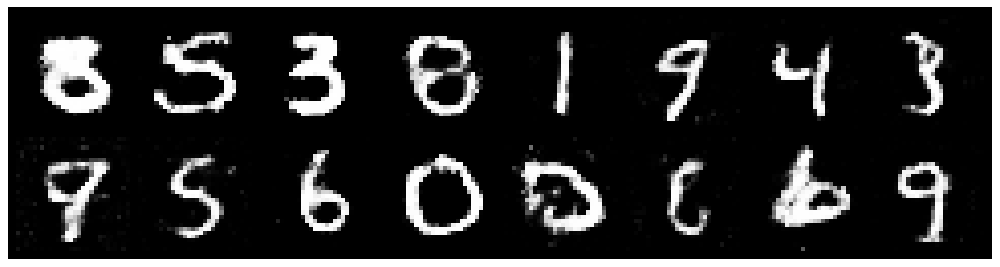

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2484, Generator Loss: 0.9842
D(x): 0.5503, D(G(z)): 0.4289


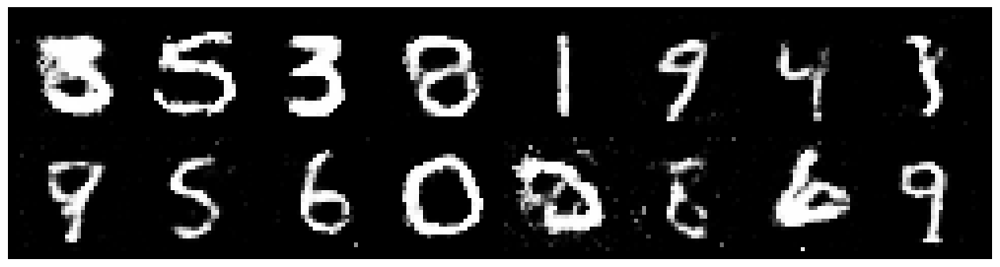

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2895, Generator Loss: 0.8428
D(x): 0.5549, D(G(z)): 0.4412


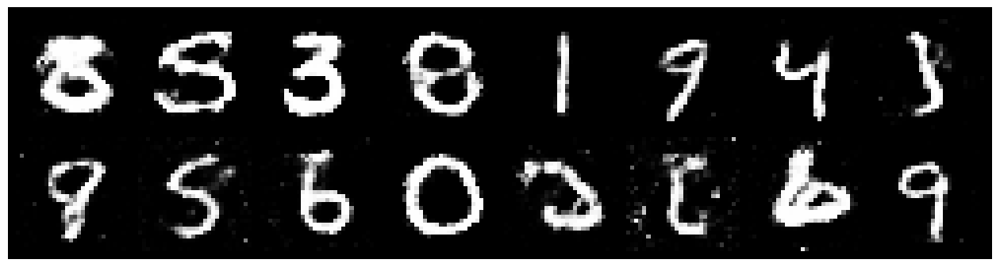

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.3656, Generator Loss: 0.9401
D(x): 0.5635, D(G(z)): 0.4807


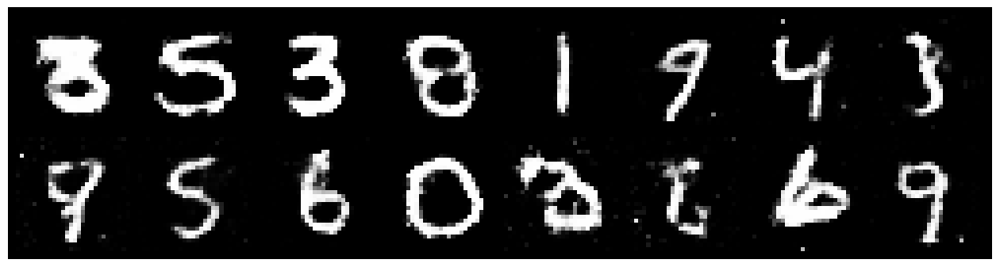

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2986, Generator Loss: 0.9045
D(x): 0.5595, D(G(z)): 0.4609


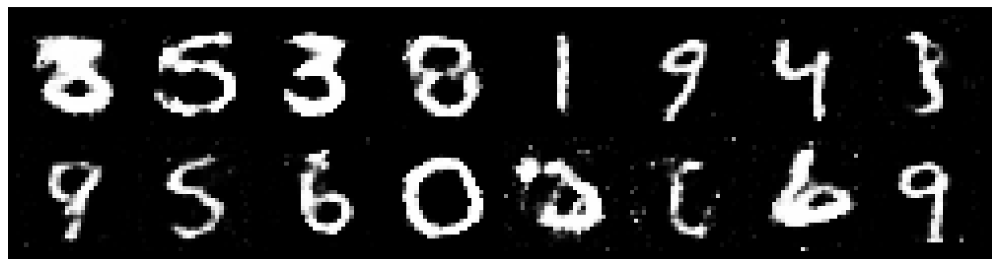

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2804, Generator Loss: 1.1219
D(x): 0.5363, D(G(z)): 0.4175


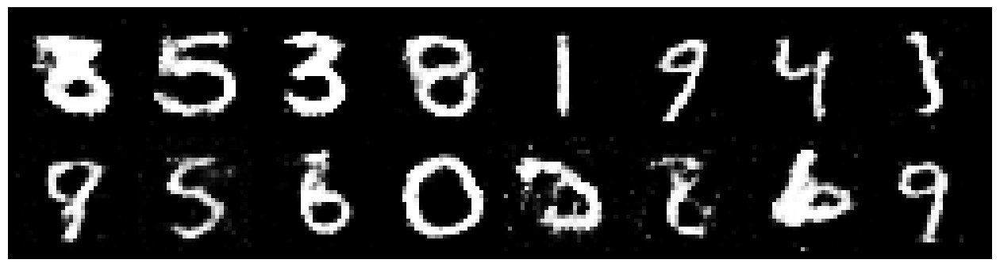

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2873, Generator Loss: 1.0282
D(x): 0.5571, D(G(z)): 0.4272


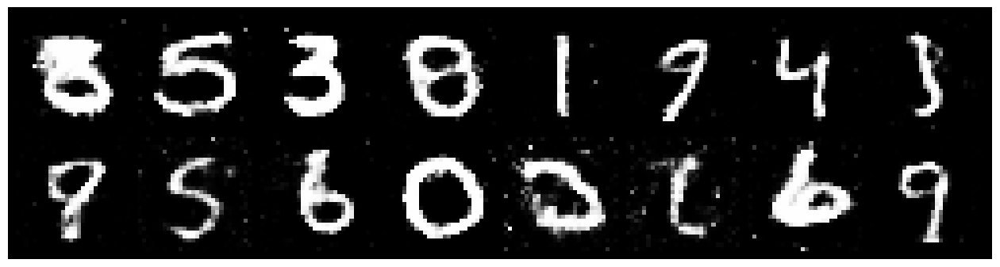

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2135, Generator Loss: 0.8651
D(x): 0.5626, D(G(z)): 0.4180


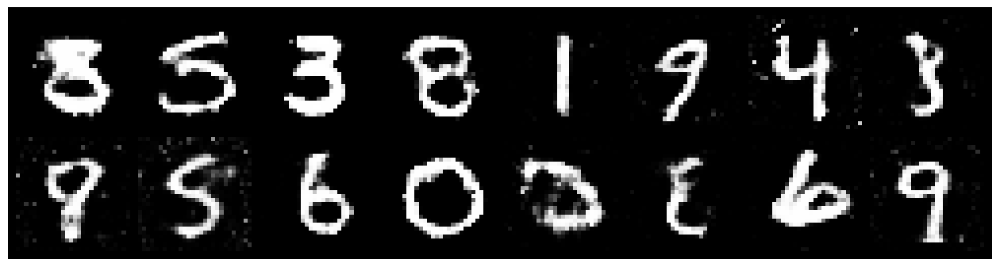

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.3097, Generator Loss: 0.8407
D(x): 0.5431, D(G(z)): 0.4647


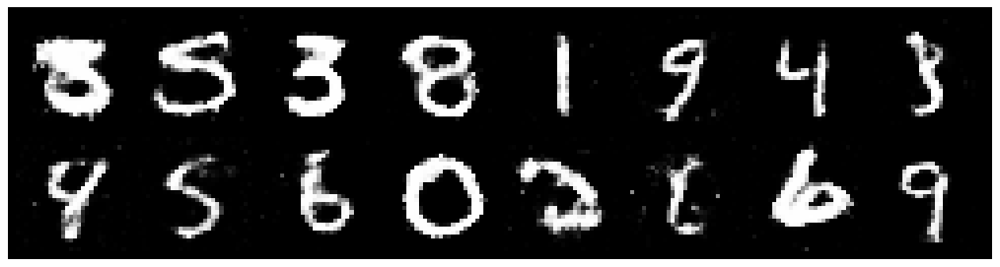

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8821
D(x): 0.5747, D(G(z)): 0.4700


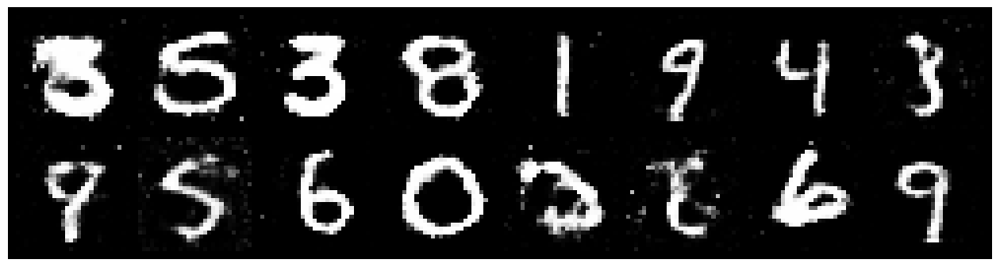

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2586, Generator Loss: 0.8176
D(x): 0.5357, D(G(z)): 0.4288


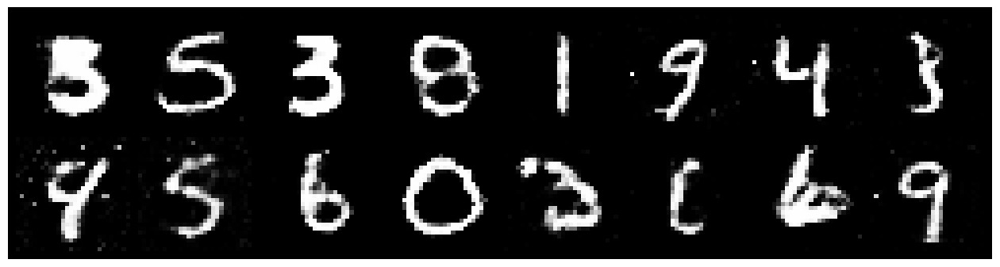

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.2587, Generator Loss: 1.0593
D(x): 0.5260, D(G(z)): 0.4023


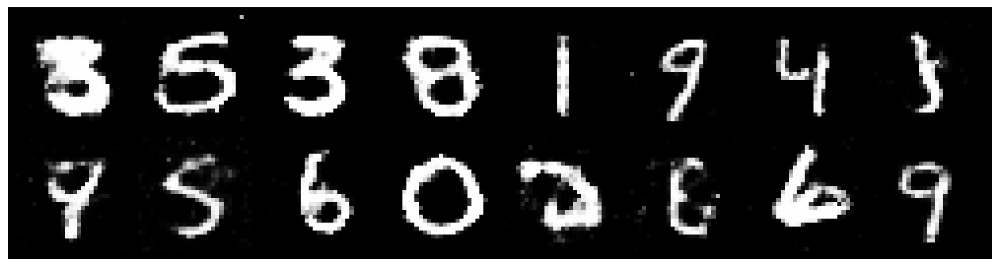

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2432, Generator Loss: 0.9238
D(x): 0.5723, D(G(z)): 0.4507


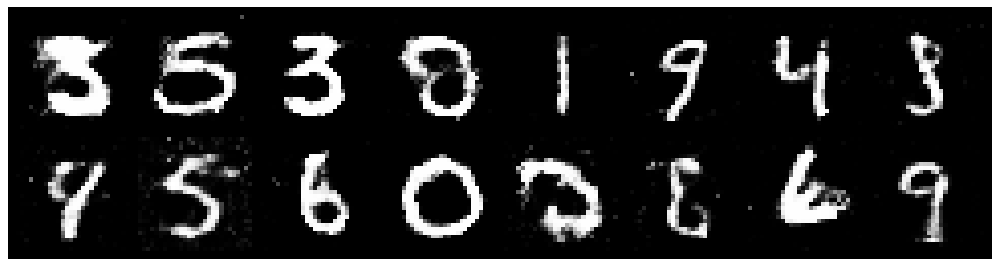

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2905, Generator Loss: 0.8399
D(x): 0.5291, D(G(z)): 0.4388


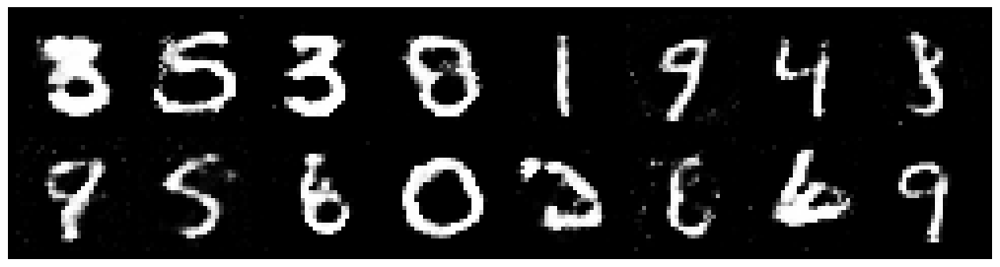

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.2508, Generator Loss: 0.9701
D(x): 0.5693, D(G(z)): 0.4321


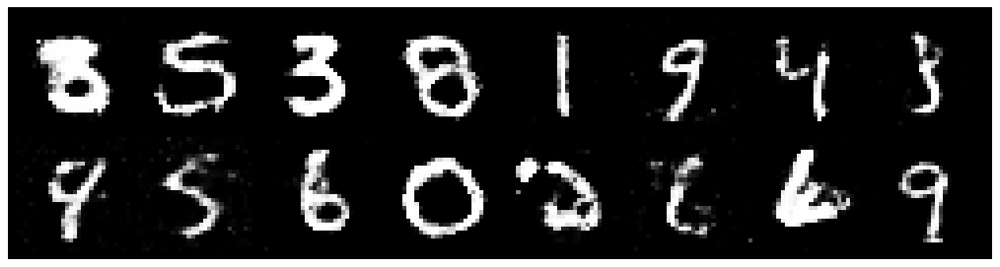

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.3259, Generator Loss: 0.9513
D(x): 0.5419, D(G(z)): 0.4359


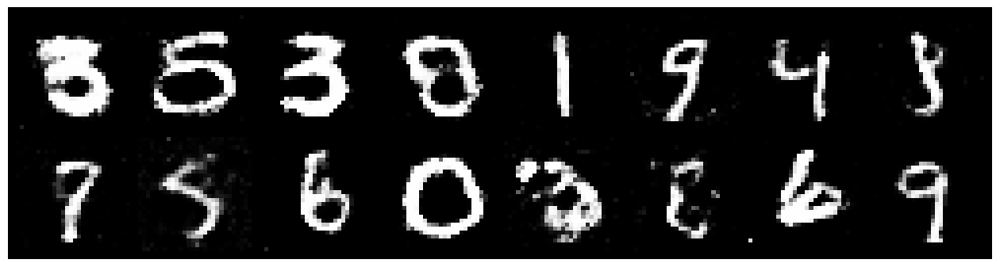

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.3194, Generator Loss: 0.8105
D(x): 0.5548, D(G(z)): 0.4668


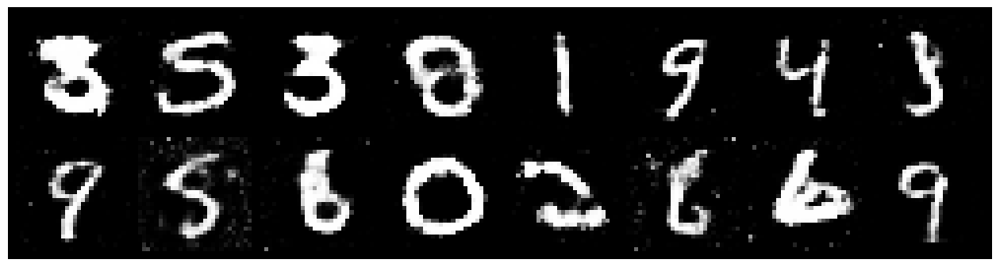

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2280, Generator Loss: 0.7254
D(x): 0.6027, D(G(z)): 0.4655


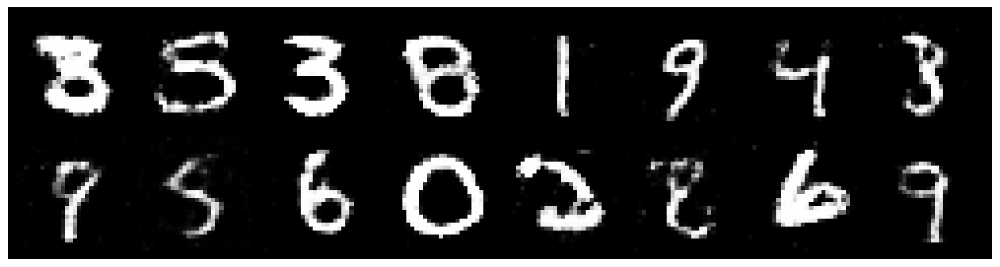

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2322, Generator Loss: 0.8532
D(x): 0.5569, D(G(z)): 0.4253


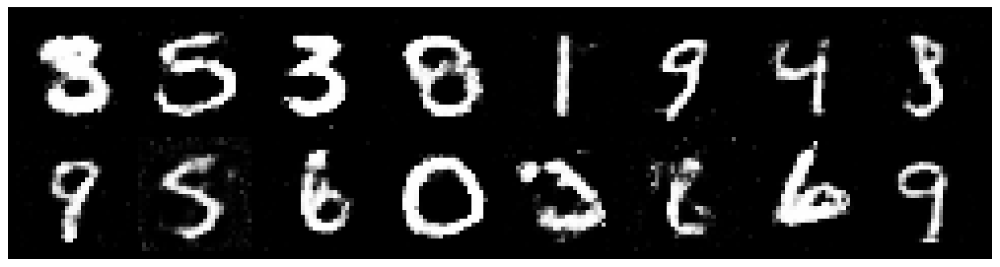

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2556, Generator Loss: 0.7588
D(x): 0.5515, D(G(z)): 0.4523


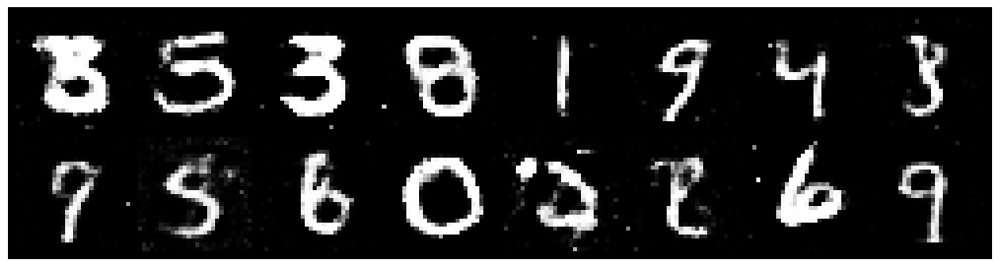

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8419
D(x): 0.5508, D(G(z)): 0.4561


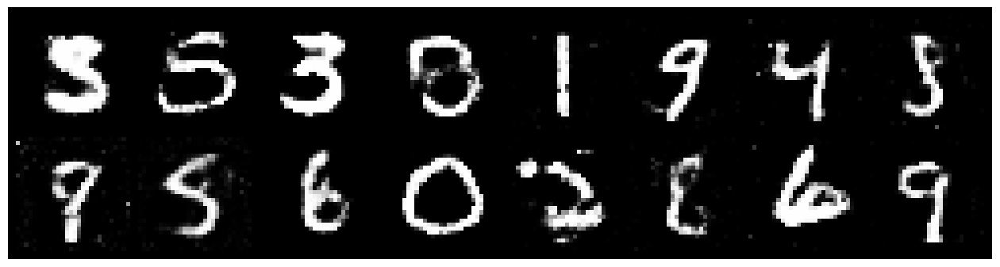

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.3038, Generator Loss: 0.8431
D(x): 0.5525, D(G(z)): 0.4685


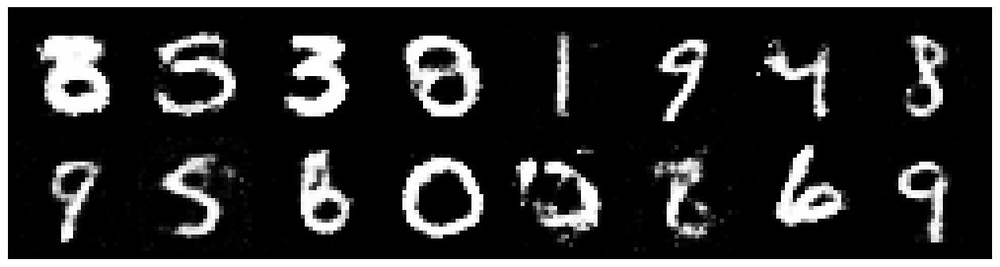

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3167, Generator Loss: 0.8711
D(x): 0.5757, D(G(z)): 0.4844


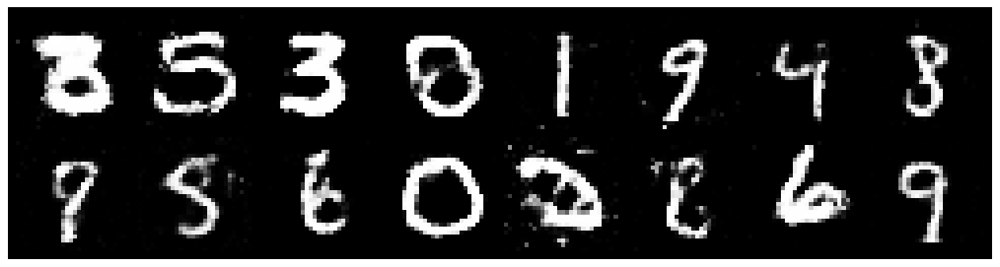

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2951, Generator Loss: 0.8998
D(x): 0.5117, D(G(z)): 0.4106


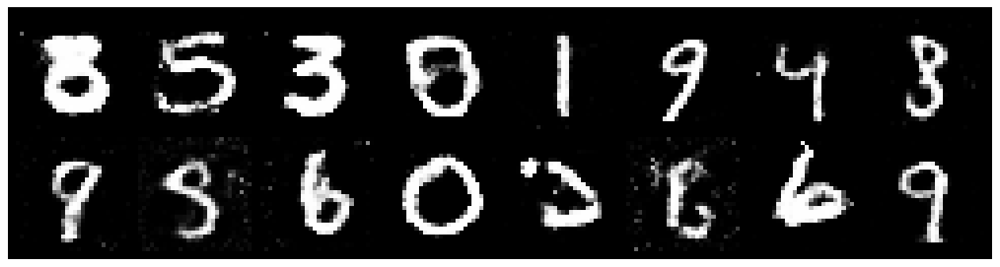

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2526, Generator Loss: 0.8008
D(x): 0.5844, D(G(z)): 0.4577


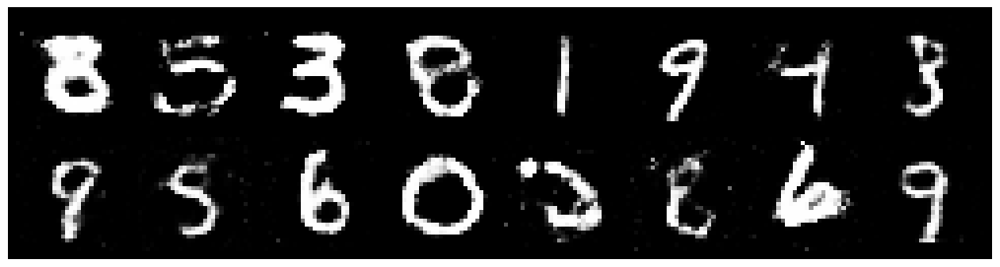

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.3449, Generator Loss: 0.8052
D(x): 0.5286, D(G(z)): 0.4529


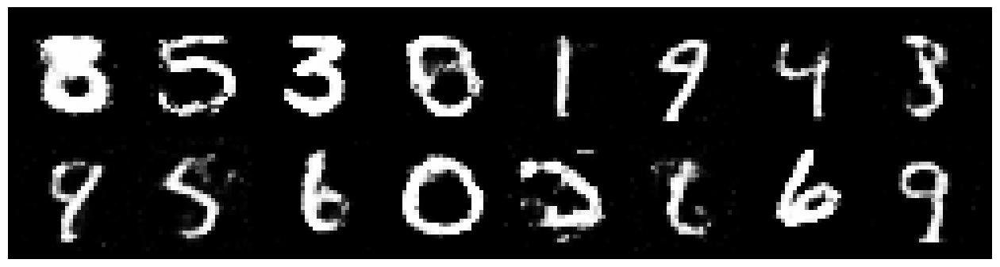

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.3253, Generator Loss: 0.8740
D(x): 0.5351, D(G(z)): 0.4596


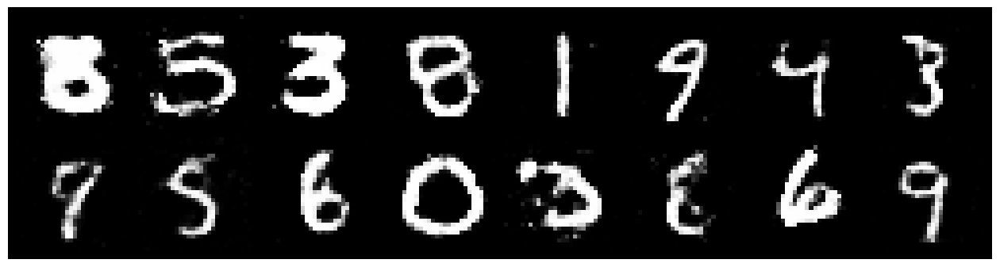

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.4209, Generator Loss: 0.9125
D(x): 0.5211, D(G(z)): 0.4747


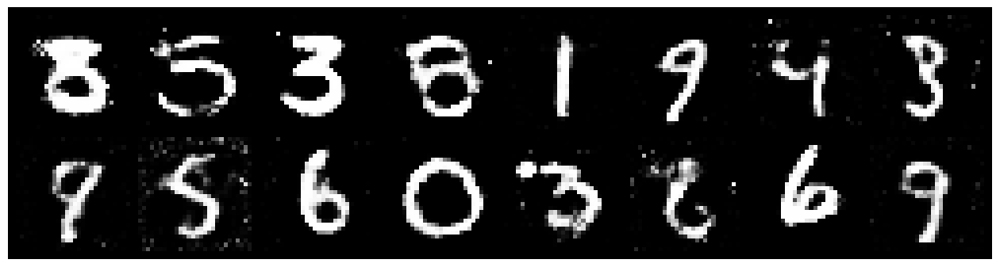

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3689, Generator Loss: 0.9062
D(x): 0.5353, D(G(z)): 0.4786


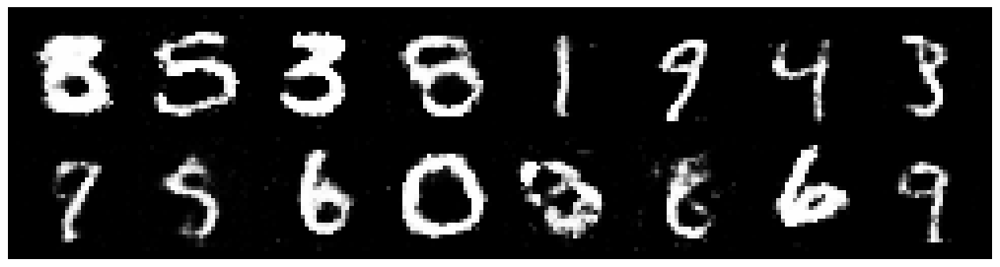

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.2295, Generator Loss: 0.7899
D(x): 0.5655, D(G(z)): 0.4568


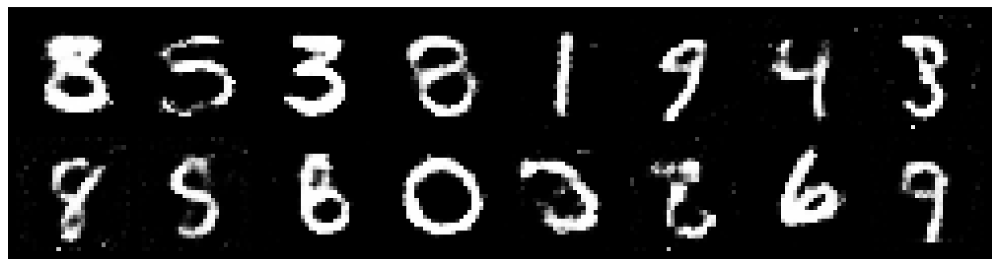

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2156, Generator Loss: 1.2023
D(x): 0.5784, D(G(z)): 0.4284


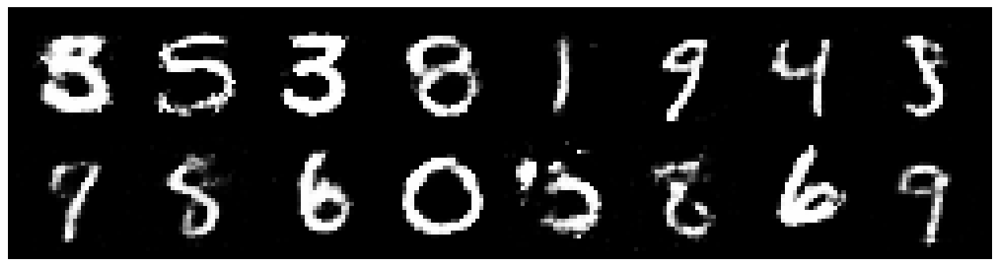

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8780
D(x): 0.5569, D(G(z)): 0.4186


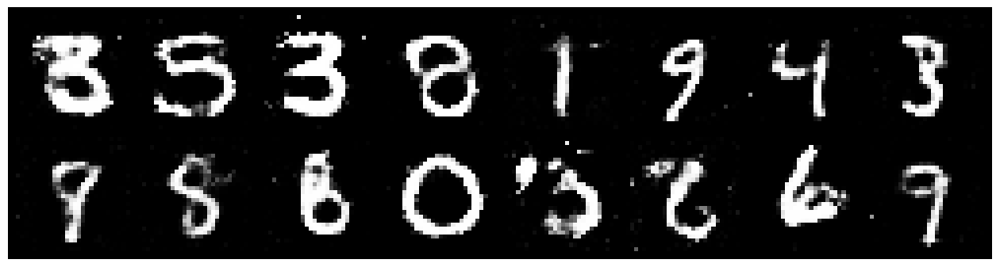

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.2021, Generator Loss: 0.8953
D(x): 0.5647, D(G(z)): 0.4205


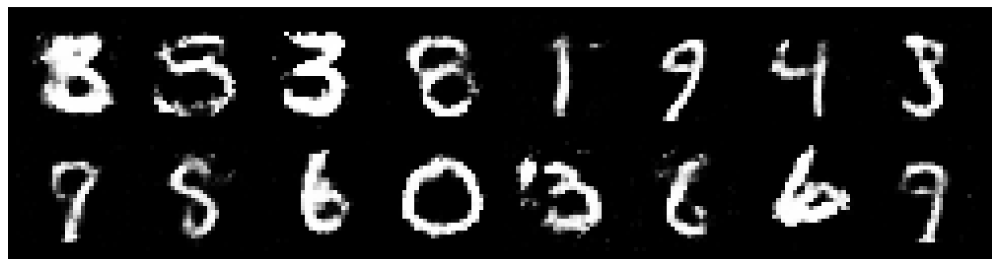

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2468, Generator Loss: 1.0299
D(x): 0.5214, D(G(z)): 0.3784


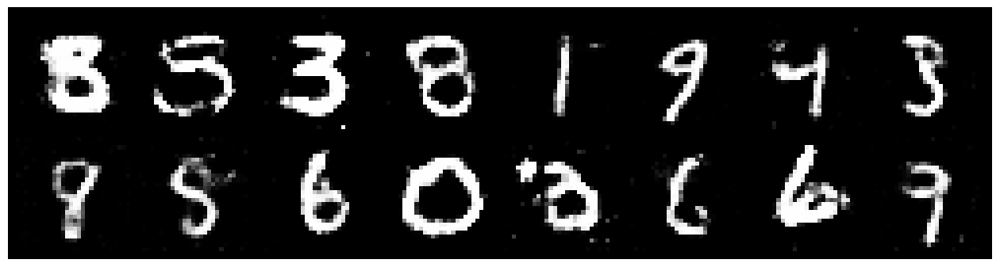

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2001, Generator Loss: 0.8592
D(x): 0.6035, D(G(z)): 0.4533


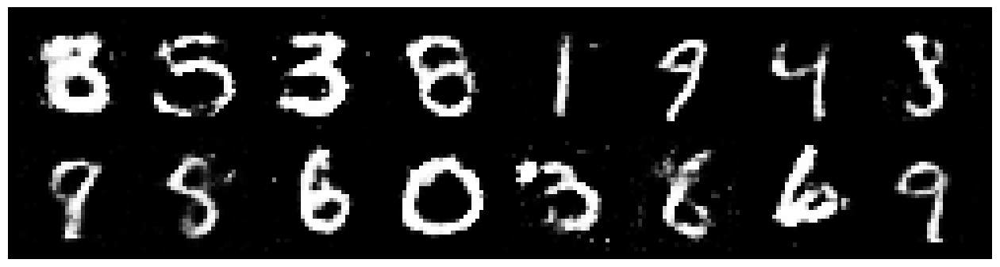

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8969
D(x): 0.5358, D(G(z)): 0.4225


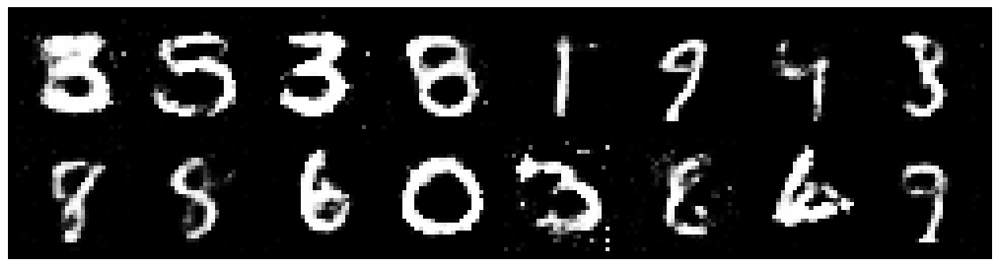

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.3363, Generator Loss: 0.8654
D(x): 0.5530, D(G(z)): 0.4806


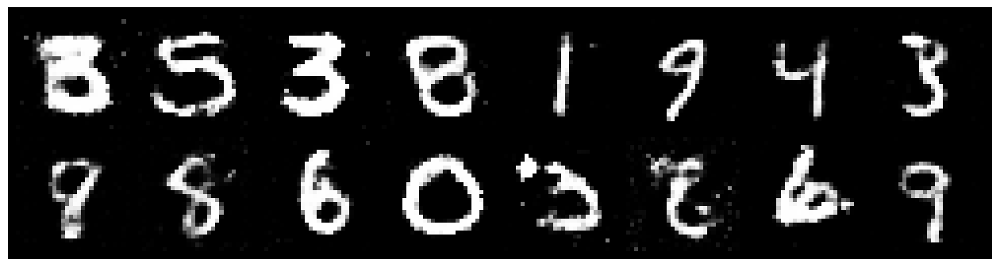

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.4060, Generator Loss: 0.9207
D(x): 0.5055, D(G(z)): 0.4420


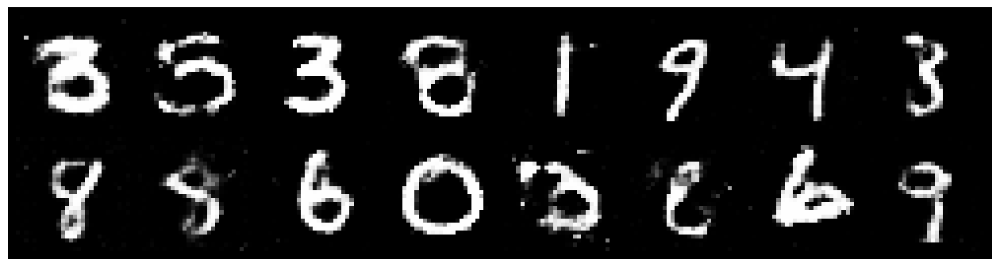

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3000, Generator Loss: 0.8642
D(x): 0.5355, D(G(z)): 0.4537


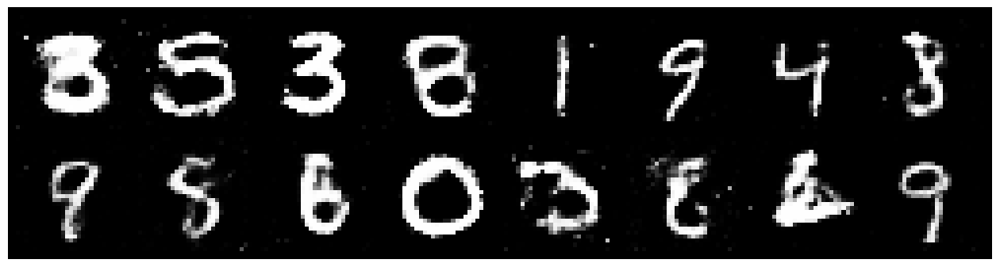

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3093, Generator Loss: 1.0011
D(x): 0.5383, D(G(z)): 0.4455


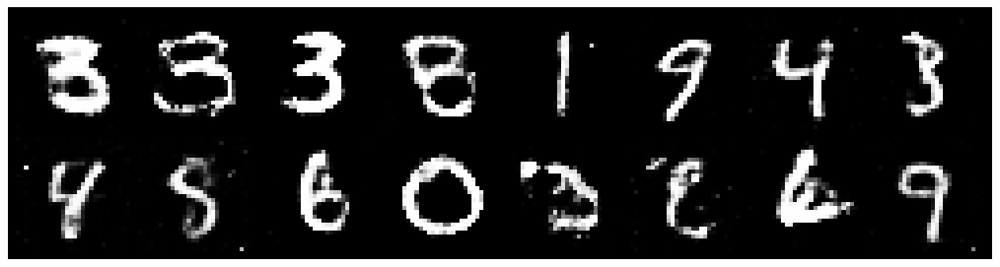

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2864, Generator Loss: 0.7971
D(x): 0.5585, D(G(z)): 0.4722


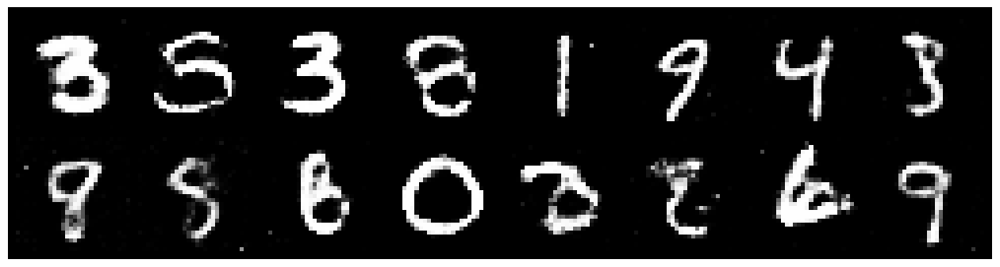

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.3412, Generator Loss: 0.7755
D(x): 0.5214, D(G(z)): 0.4734


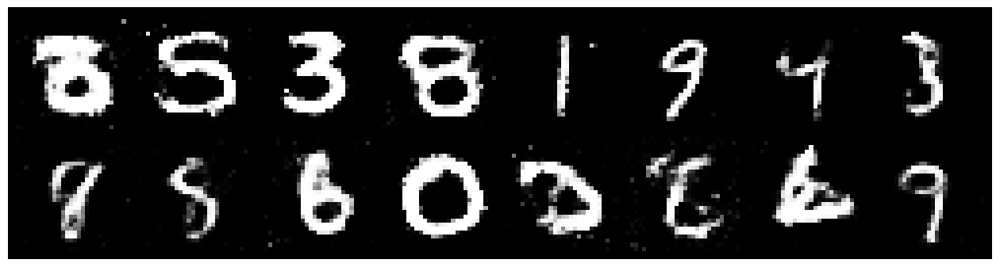

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.3677, Generator Loss: 0.9104
D(x): 0.5259, D(G(z)): 0.4656


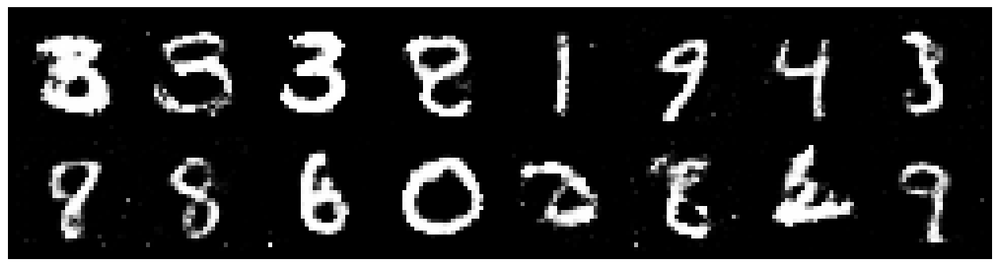

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.3552, Generator Loss: 0.9234
D(x): 0.5128, D(G(z)): 0.4159


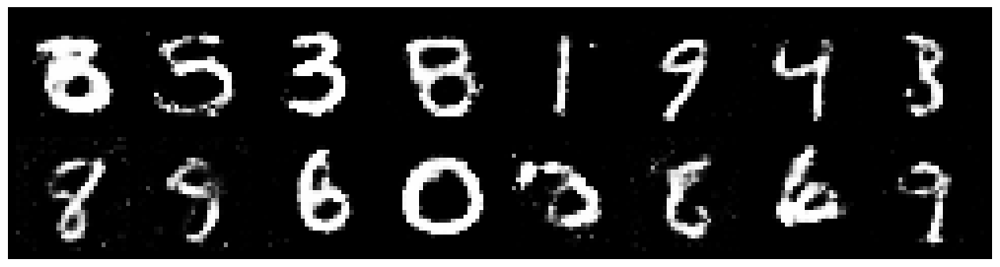

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2947, Generator Loss: 0.8917
D(x): 0.5342, D(G(z)): 0.4278


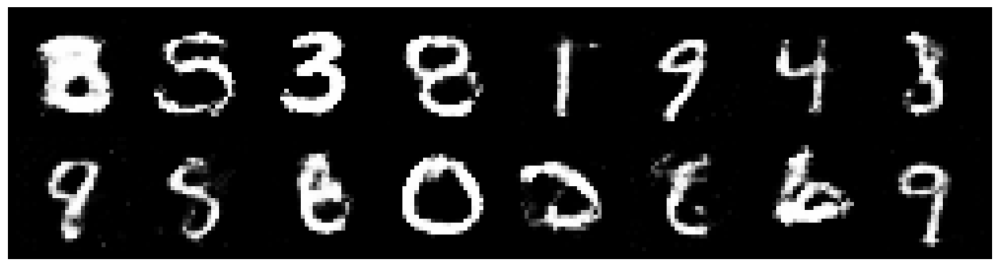

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2931, Generator Loss: 0.8736
D(x): 0.5988, D(G(z)): 0.4626


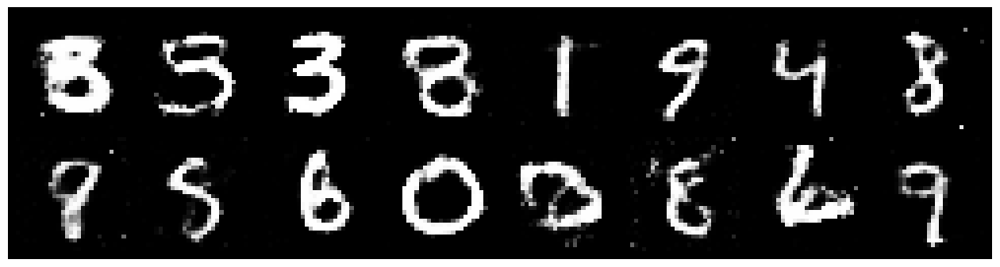

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8701
D(x): 0.5467, D(G(z)): 0.4691


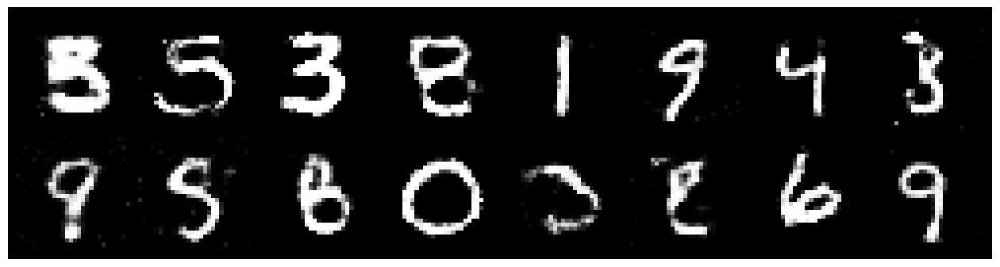

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2188, Generator Loss: 0.8230
D(x): 0.5888, D(G(z)): 0.4497


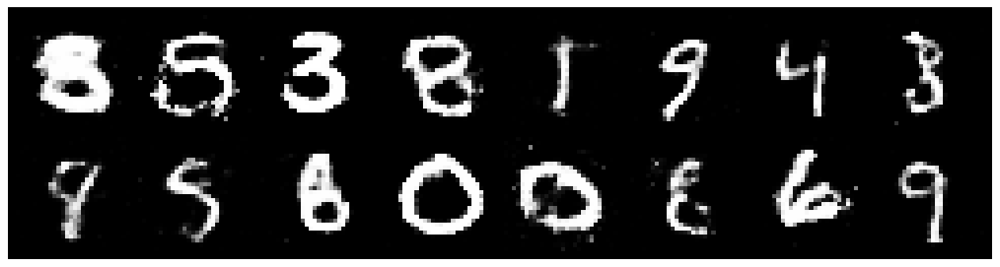

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3069, Generator Loss: 0.8611
D(x): 0.5612, D(G(z)): 0.4763


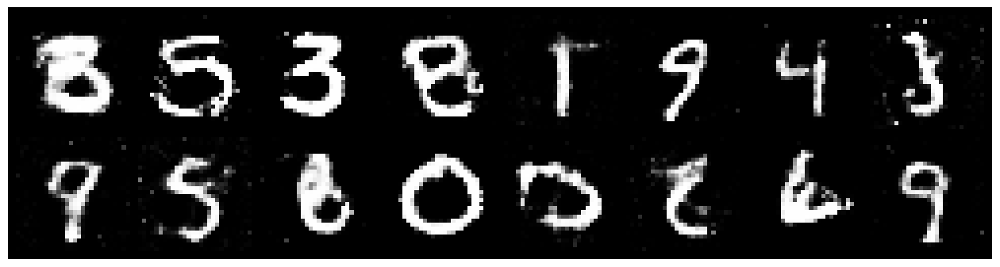

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.3213, Generator Loss: 0.9686
D(x): 0.5500, D(G(z)): 0.4545


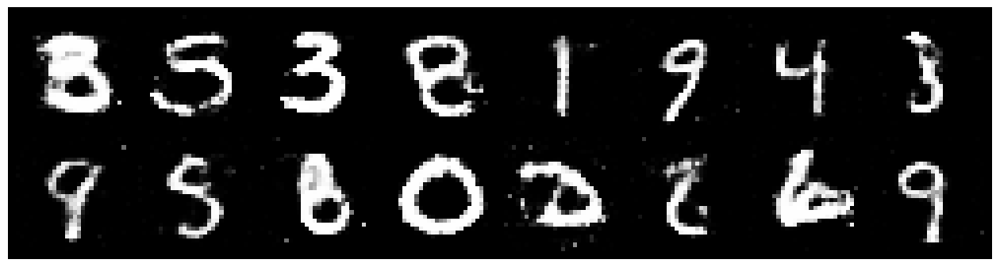

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2871, Generator Loss: 0.7957
D(x): 0.5965, D(G(z)): 0.4835


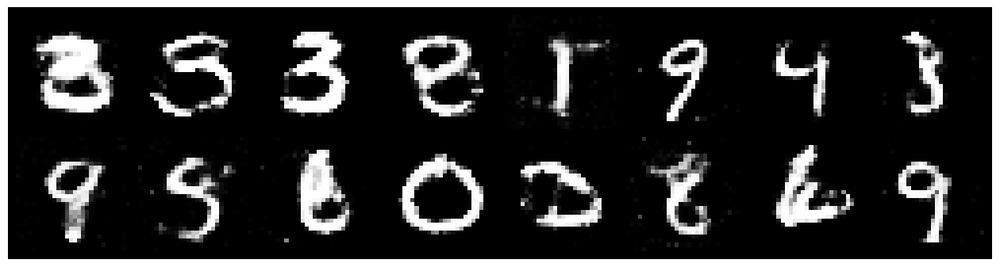

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2824, Generator Loss: 0.8572
D(x): 0.5497, D(G(z)): 0.4496


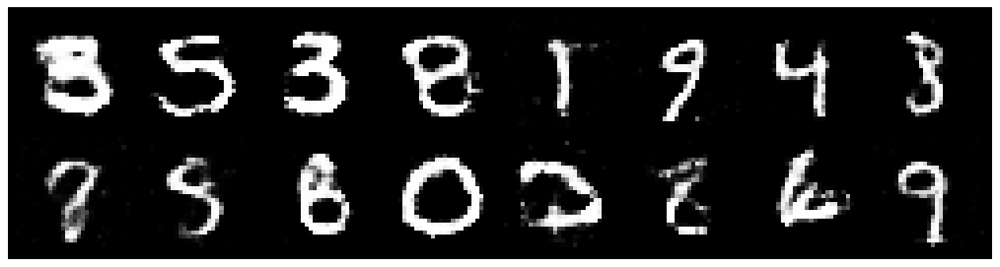

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2708, Generator Loss: 0.8522
D(x): 0.5867, D(G(z)): 0.4848


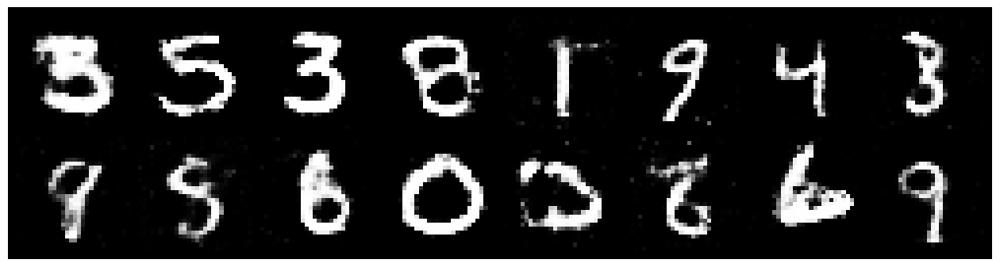

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2794, Generator Loss: 0.8116
D(x): 0.5458, D(G(z)): 0.4533


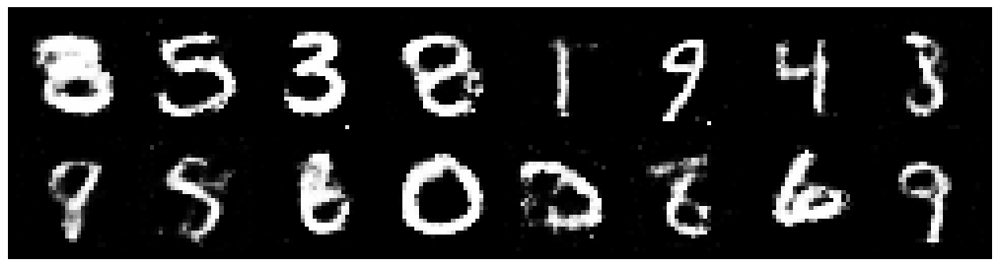

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.3357, Generator Loss: 0.8859
D(x): 0.5570, D(G(z)): 0.4770


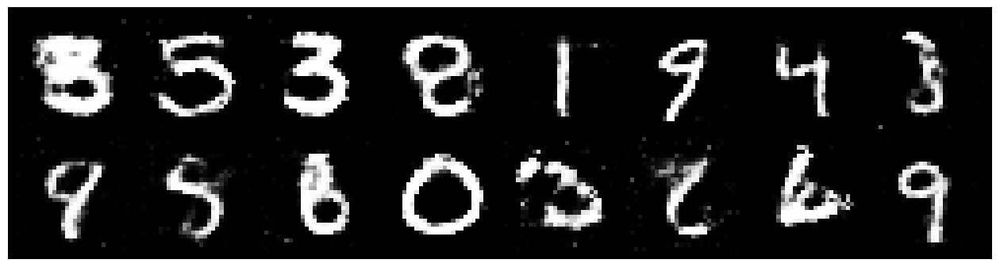

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.1877, Generator Loss: 0.9481
D(x): 0.5854, D(G(z)): 0.4316


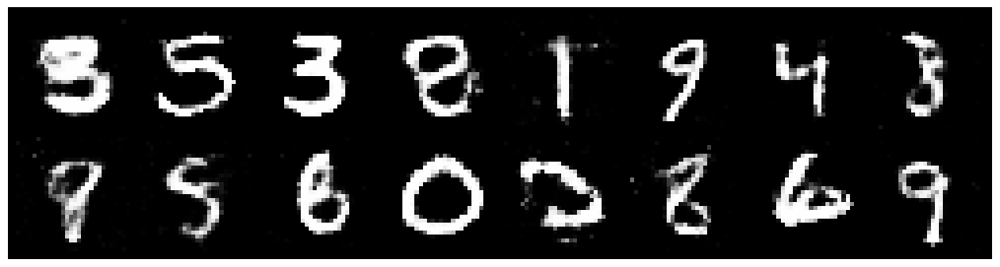

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.1990, Generator Loss: 0.9224
D(x): 0.5768, D(G(z)): 0.4240


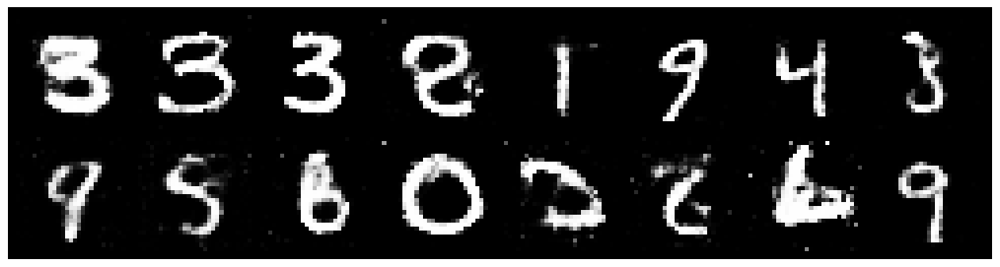

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3400, Generator Loss: 0.8672
D(x): 0.5762, D(G(z)): 0.4901


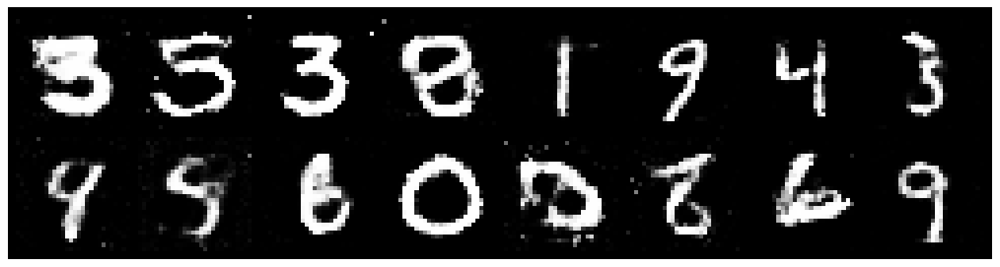

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.3586, Generator Loss: 0.8335
D(x): 0.5380, D(G(z)): 0.4652


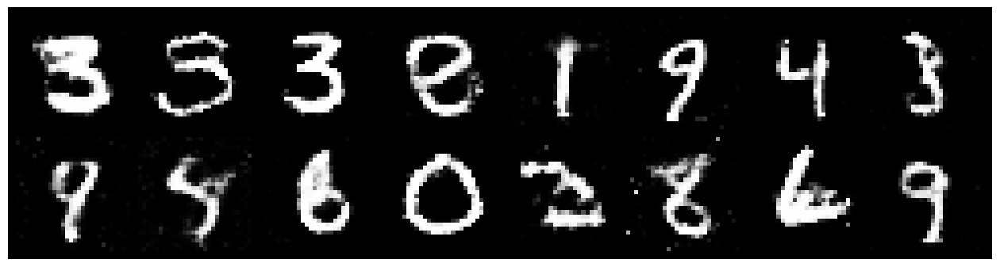

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.3074, Generator Loss: 0.8950
D(x): 0.5372, D(G(z)): 0.4491


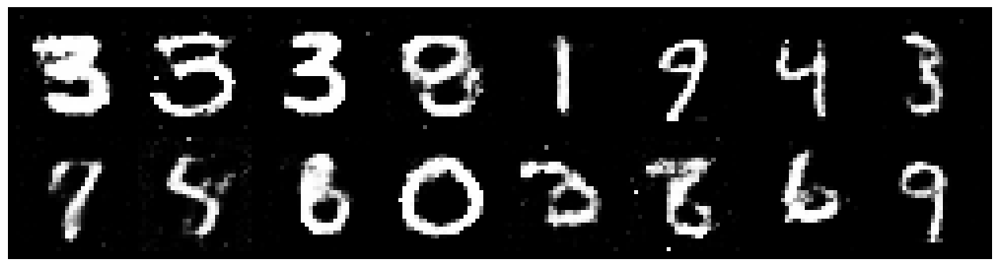

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.2678, Generator Loss: 0.8011
D(x): 0.5425, D(G(z)): 0.4496


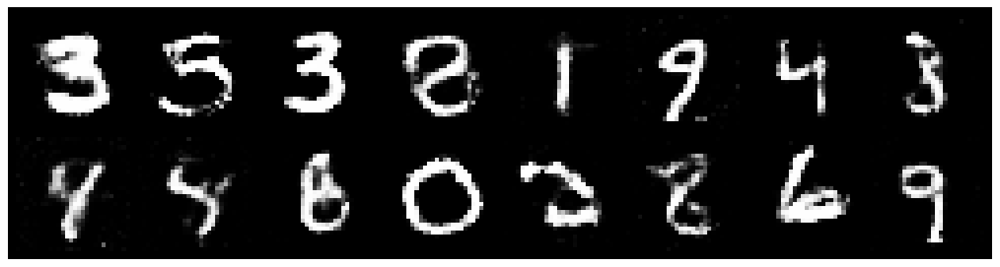

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3372, Generator Loss: 0.9669
D(x): 0.5585, D(G(z)): 0.4635


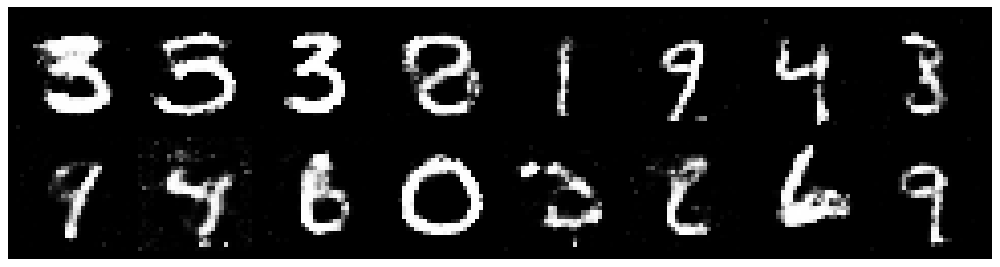

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2711, Generator Loss: 0.8528
D(x): 0.5122, D(G(z)): 0.4242


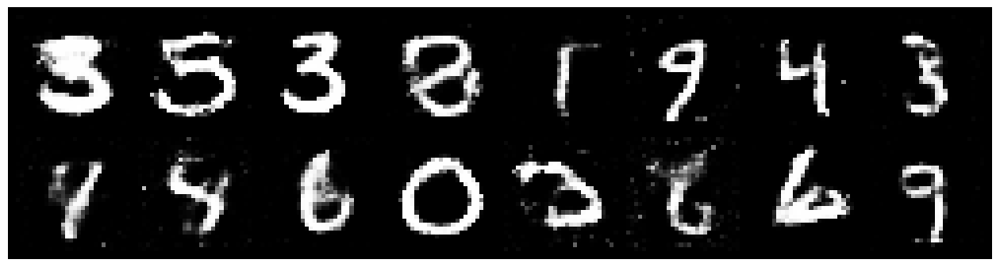

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2630, Generator Loss: 0.9247
D(x): 0.5451, D(G(z)): 0.4412


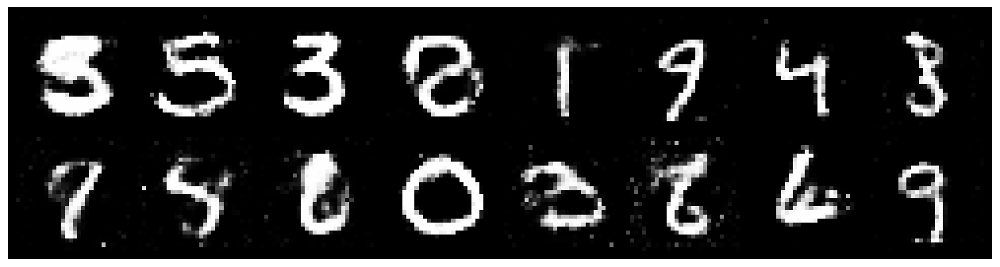

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2442, Generator Loss: 0.8956
D(x): 0.5510, D(G(z)): 0.4169


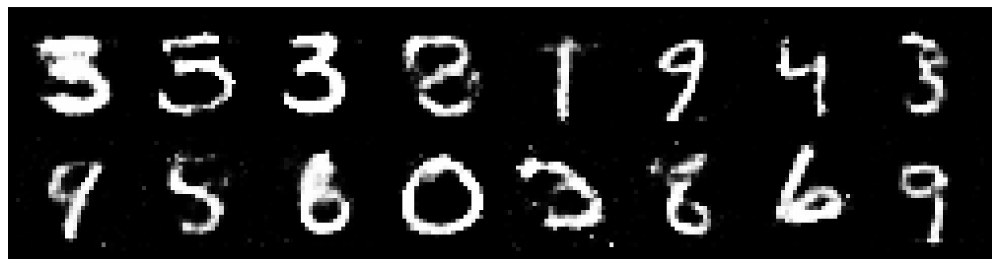

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2874, Generator Loss: 0.8323
D(x): 0.5414, D(G(z)): 0.4413


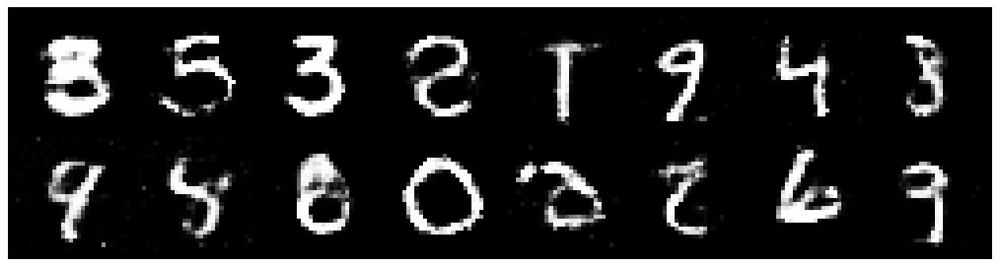

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2780, Generator Loss: 0.9075
D(x): 0.5147, D(G(z)): 0.4160


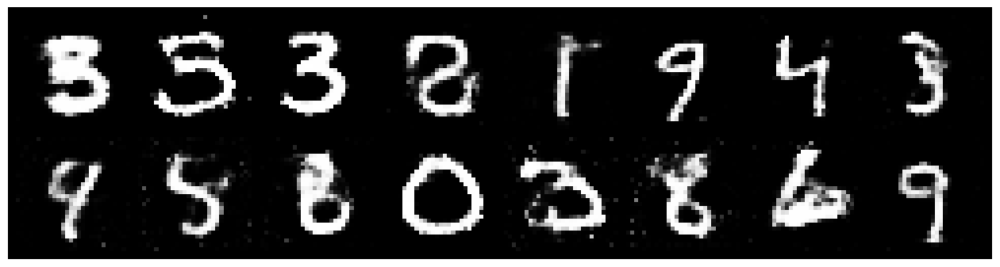

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.3375, Generator Loss: 0.8137
D(x): 0.5411, D(G(z)): 0.4725


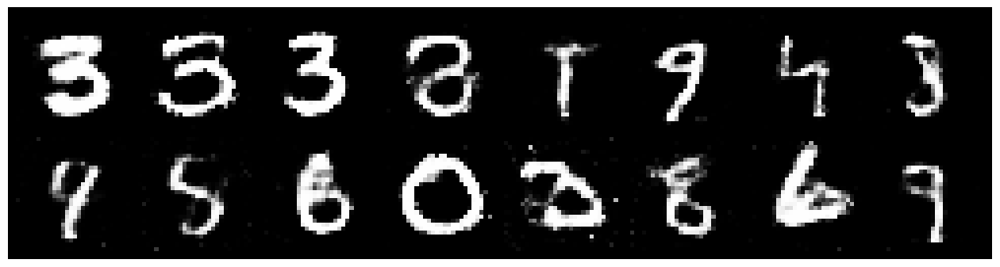

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8405
D(x): 0.5820, D(G(z)): 0.4587


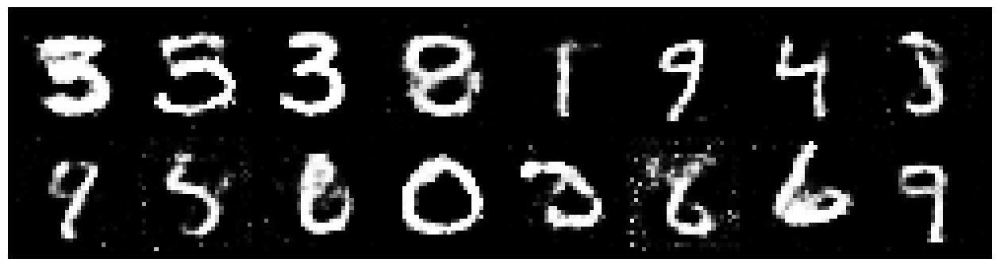

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9482
D(x): 0.5268, D(G(z)): 0.4205


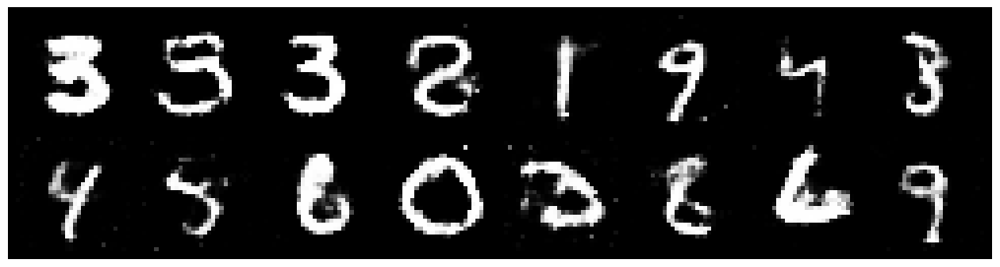

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2577, Generator Loss: 0.8180
D(x): 0.5648, D(G(z)): 0.4378


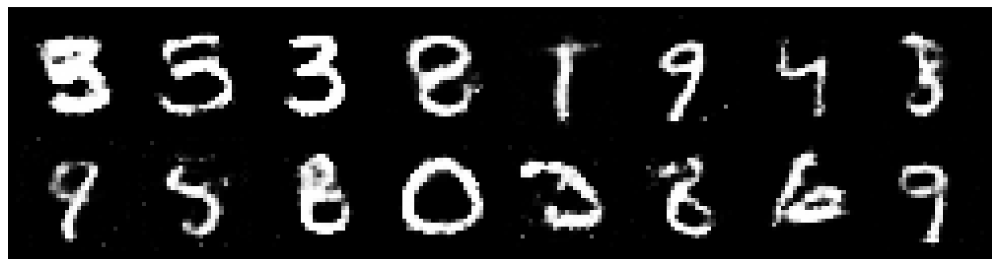

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9920
D(x): 0.5438, D(G(z)): 0.4289


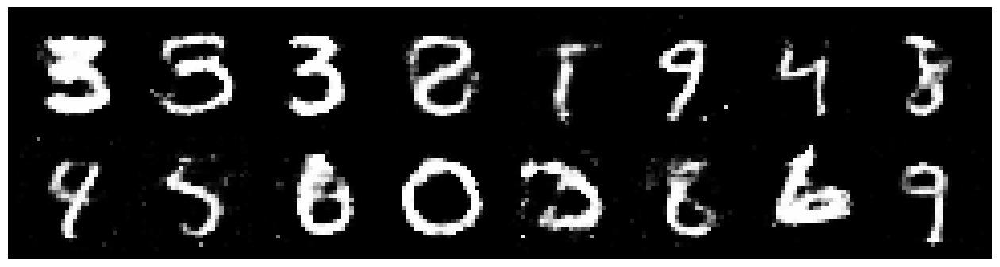

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.3050, Generator Loss: 1.0146
D(x): 0.5416, D(G(z)): 0.4279


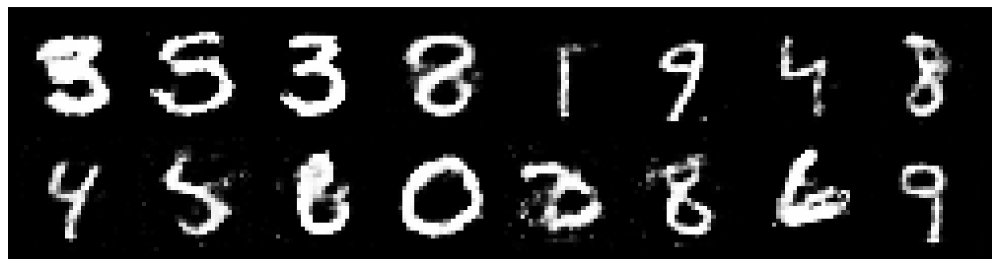

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3542, Generator Loss: 0.7595
D(x): 0.5347, D(G(z)): 0.4848


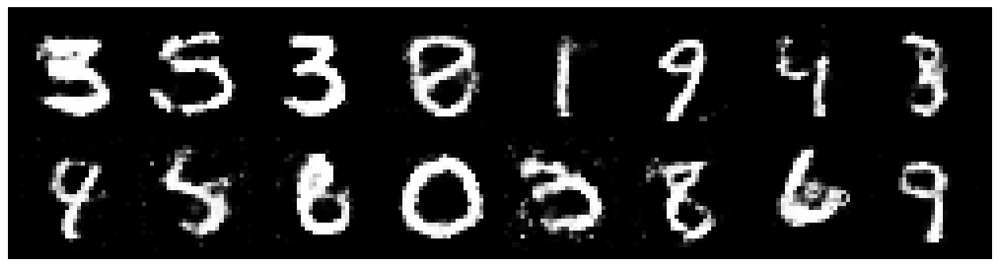

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.3384, Generator Loss: 0.9791
D(x): 0.5122, D(G(z)): 0.4338


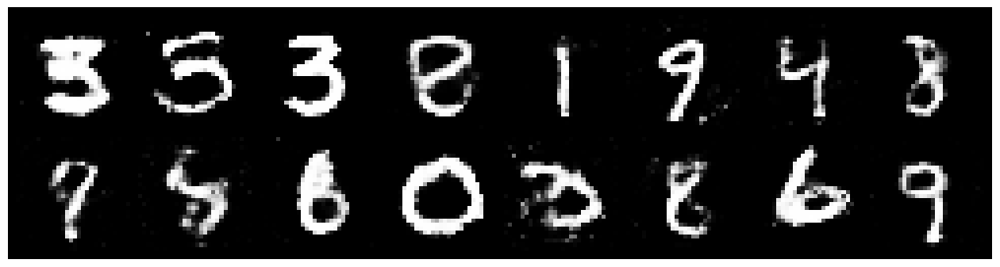

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.1752, Generator Loss: 0.8854
D(x): 0.5800, D(G(z)): 0.4299


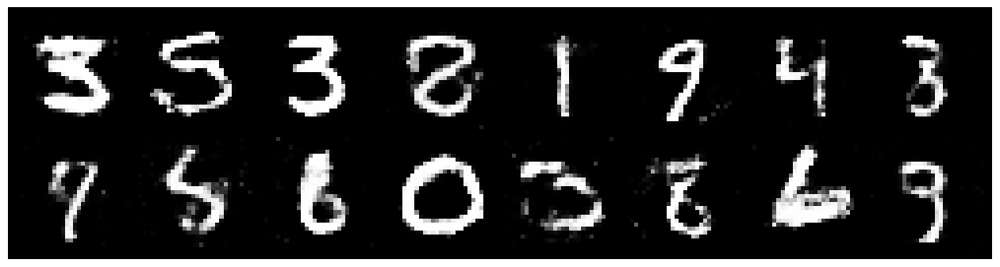

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.3258, Generator Loss: 1.1084
D(x): 0.5126, D(G(z)): 0.3912


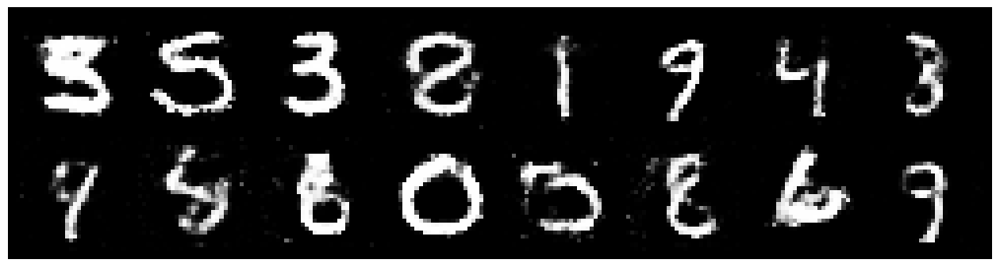

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3198, Generator Loss: 0.9639
D(x): 0.5346, D(G(z)): 0.4409


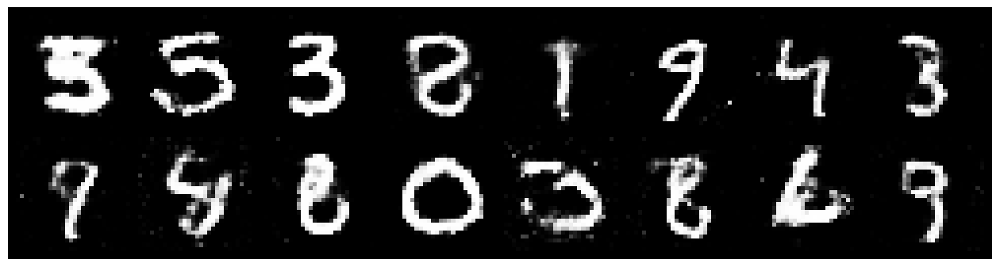

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3324, Generator Loss: 0.8177
D(x): 0.5336, D(G(z)): 0.4529


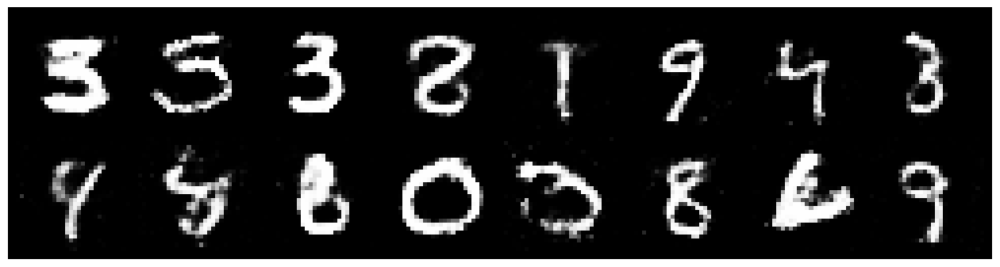

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3101, Generator Loss: 0.8407
D(x): 0.5423, D(G(z)): 0.4529


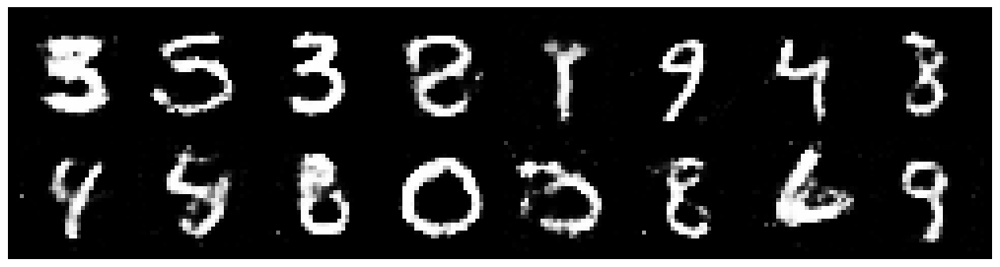

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.3161, Generator Loss: 0.7849
D(x): 0.5332, D(G(z)): 0.4690


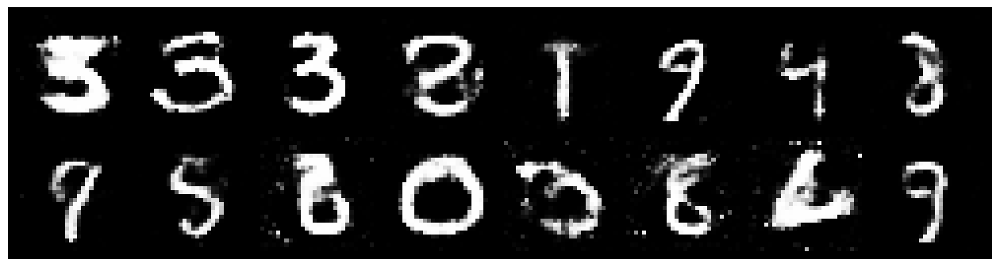

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2984, Generator Loss: 0.8783
D(x): 0.5610, D(G(z)): 0.4511


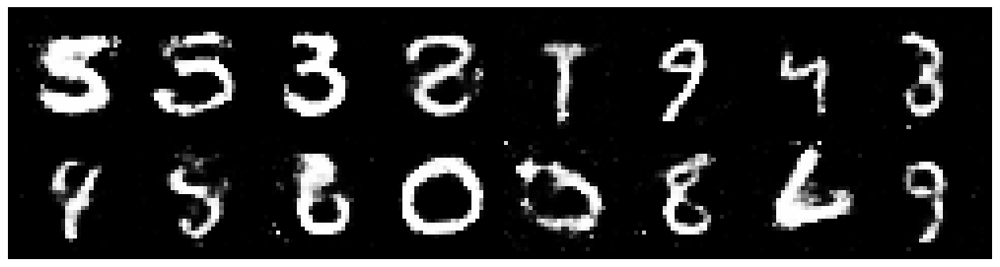

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.2920, Generator Loss: 0.8286
D(x): 0.5467, D(G(z)): 0.4623


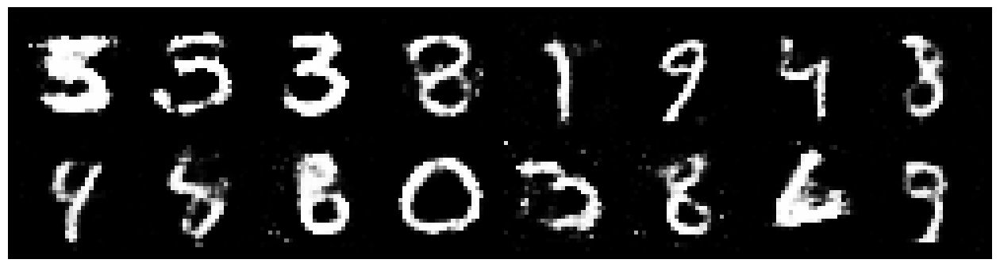

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9167
D(x): 0.5328, D(G(z)): 0.4259


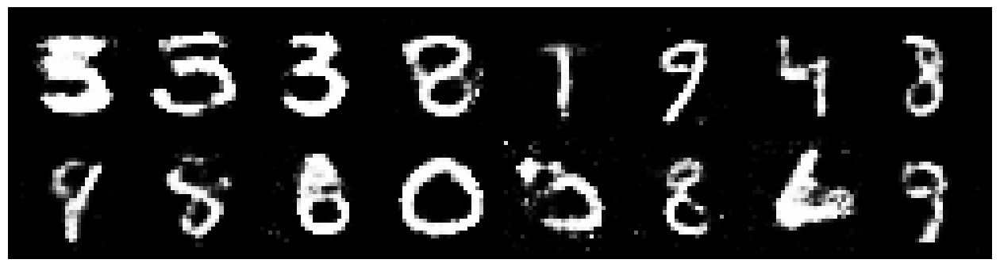

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2816, Generator Loss: 0.8772
D(x): 0.5438, D(G(z)): 0.4447


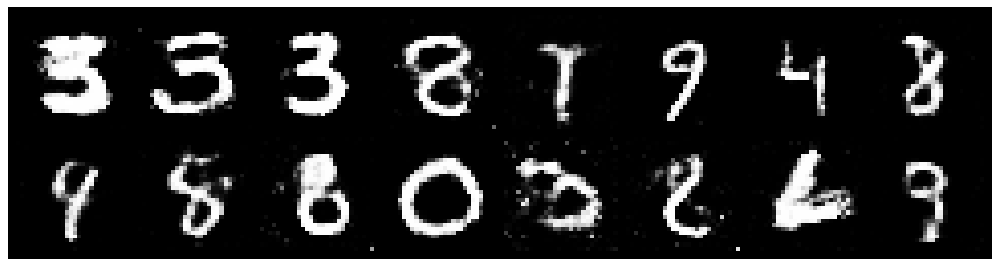

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.3713, Generator Loss: 0.7800
D(x): 0.5389, D(G(z)): 0.4860


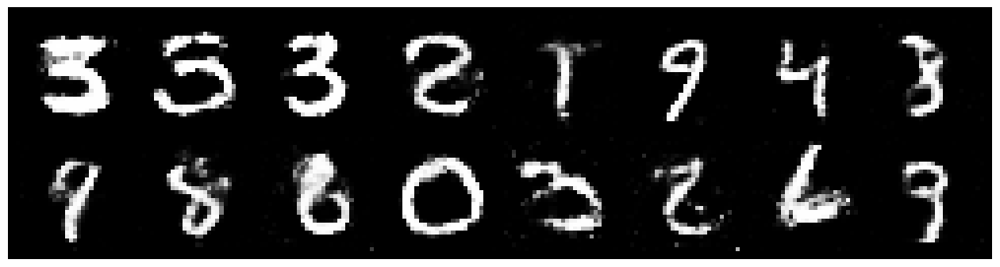

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2689, Generator Loss: 0.9712
D(x): 0.5150, D(G(z)): 0.4057


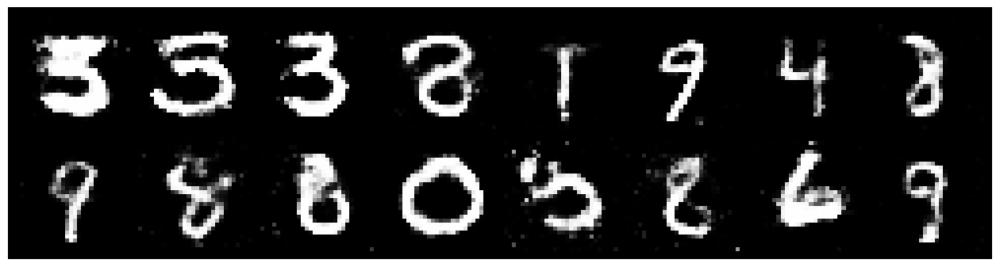

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2669, Generator Loss: 0.9168
D(x): 0.5247, D(G(z)): 0.4381


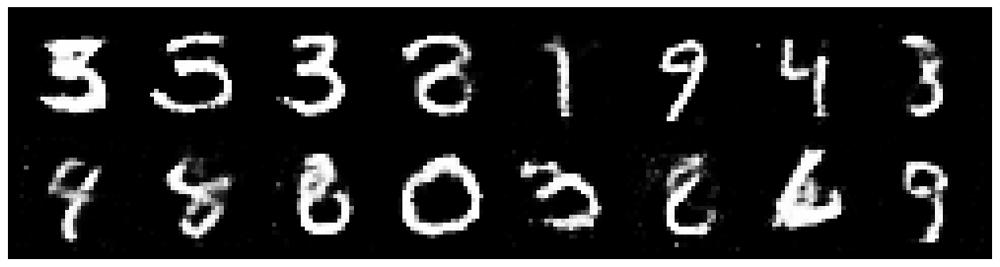

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2221, Generator Loss: 0.9261
D(x): 0.5520, D(G(z)): 0.4167


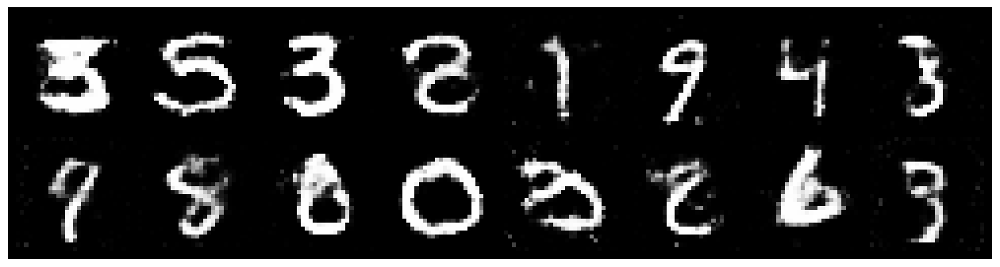

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2716, Generator Loss: 0.9805
D(x): 0.5582, D(G(z)): 0.4405


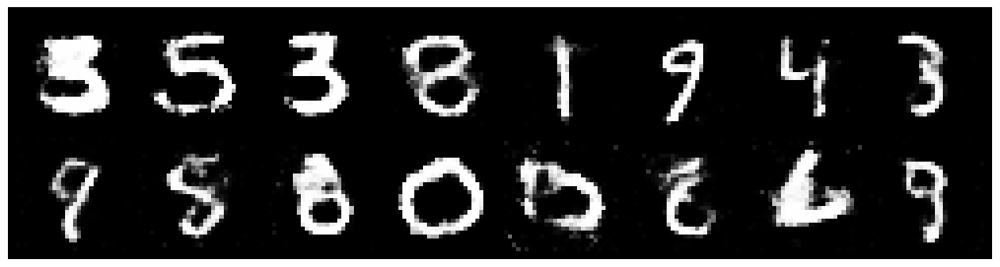

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.2813, Generator Loss: 0.8741
D(x): 0.6016, D(G(z)): 0.4796


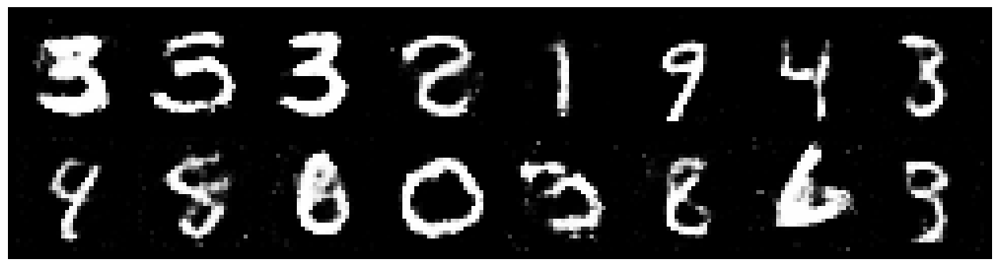

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2147, Generator Loss: 0.9681
D(x): 0.5759, D(G(z)): 0.4348


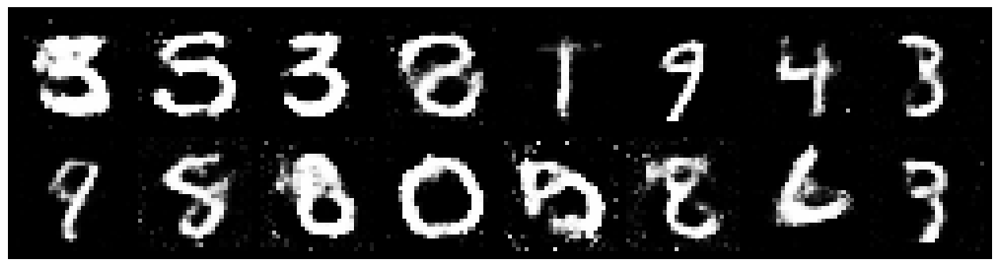

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.3534, Generator Loss: 0.8131
D(x): 0.5320, D(G(z)): 0.4608


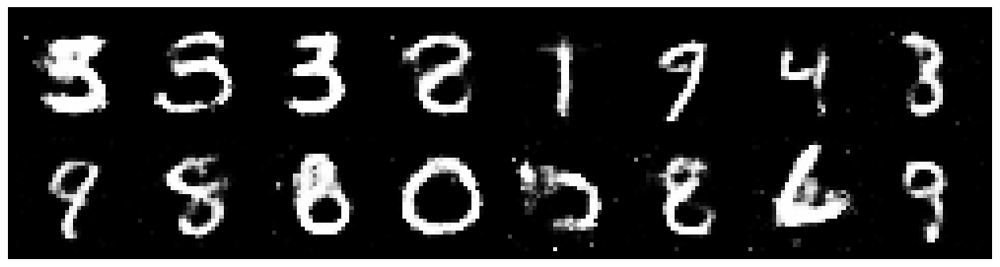

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.1727, Generator Loss: 0.9270
D(x): 0.5840, D(G(z)): 0.4217


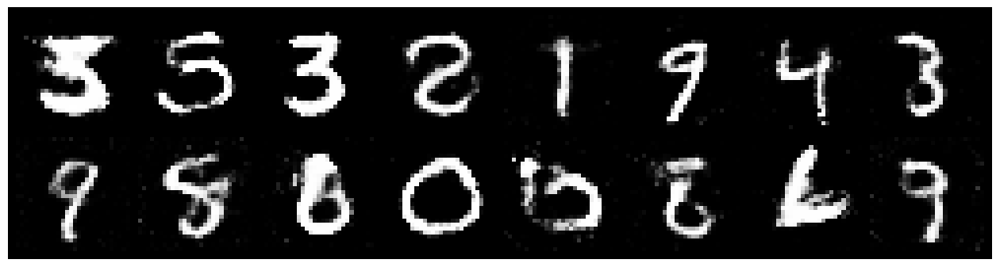

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2204, Generator Loss: 1.0881
D(x): 0.5647, D(G(z)): 0.4108


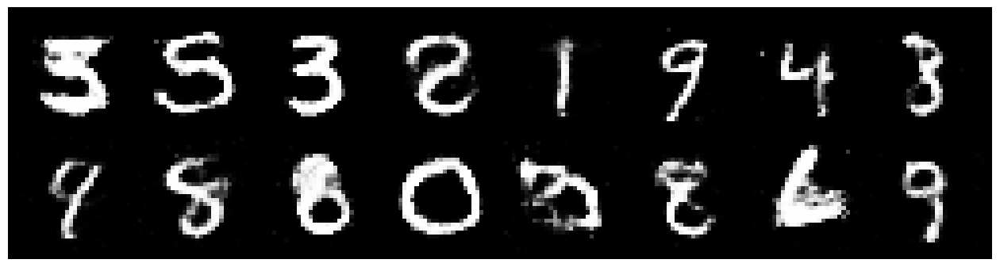

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2497, Generator Loss: 0.9144
D(x): 0.5252, D(G(z)): 0.4135


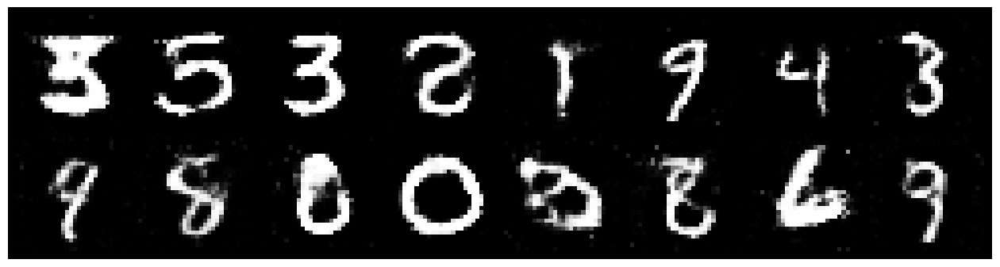

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2438, Generator Loss: 0.8760
D(x): 0.5639, D(G(z)): 0.4384


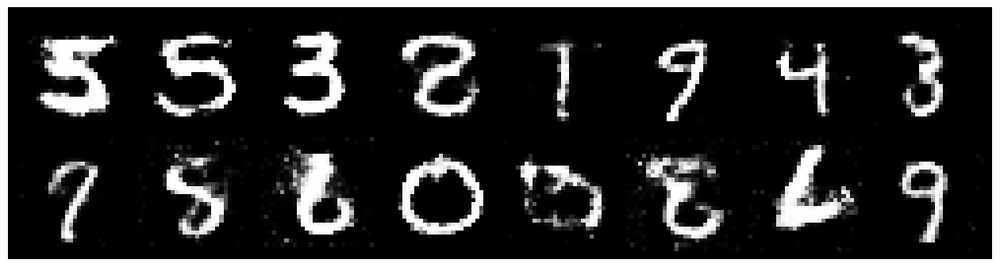

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2879, Generator Loss: 1.0282
D(x): 0.5087, D(G(z)): 0.4115


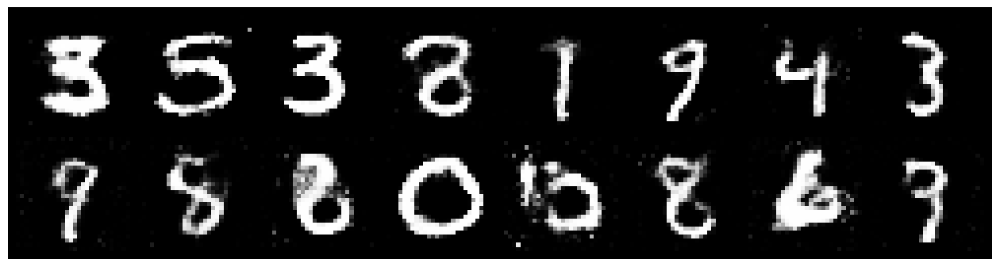

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2964, Generator Loss: 0.8703
D(x): 0.5352, D(G(z)): 0.4499


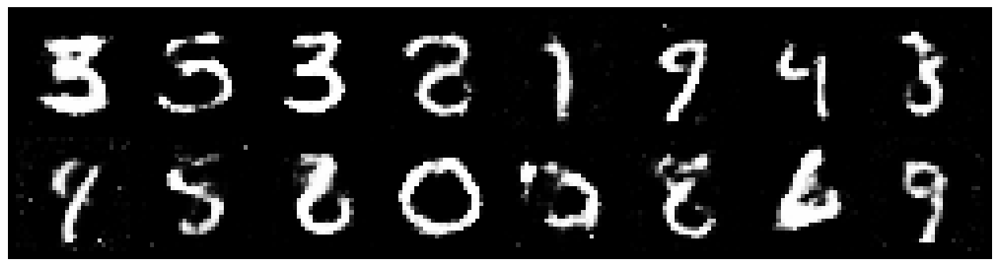

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3219, Generator Loss: 0.7760
D(x): 0.5939, D(G(z)): 0.4786


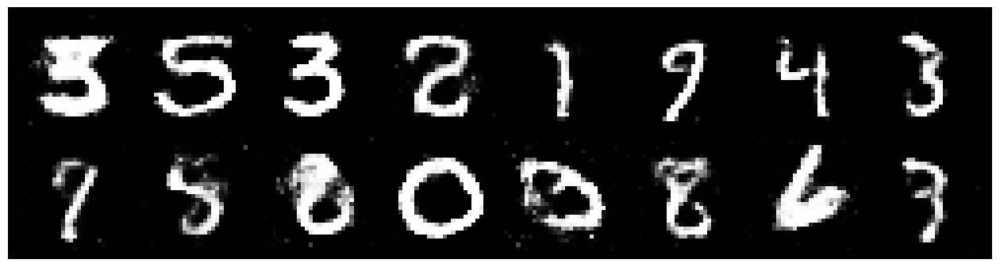

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2949, Generator Loss: 0.8137
D(x): 0.6065, D(G(z)): 0.5081


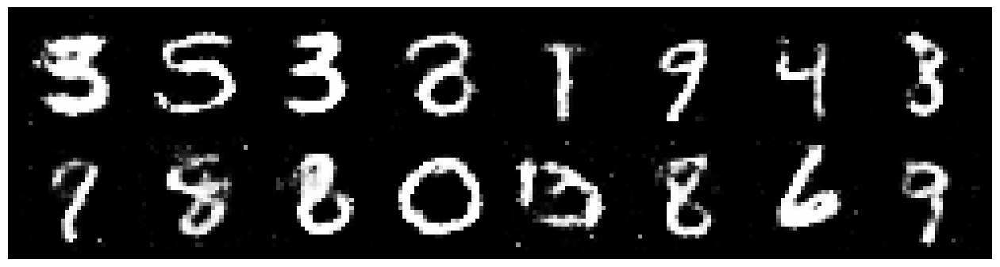

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3369, Generator Loss: 0.8117
D(x): 0.5353, D(G(z)): 0.4725


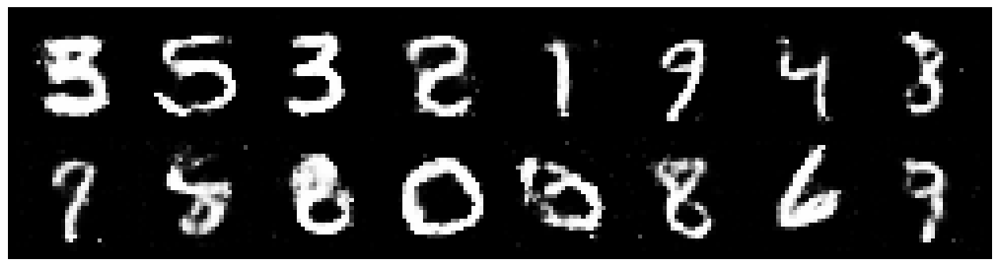

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2395, Generator Loss: 0.8768
D(x): 0.5631, D(G(z)): 0.4453


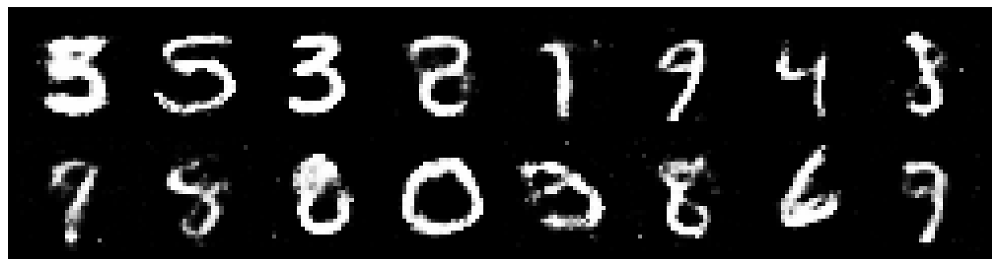

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2389, Generator Loss: 0.8190
D(x): 0.5514, D(G(z)): 0.4362


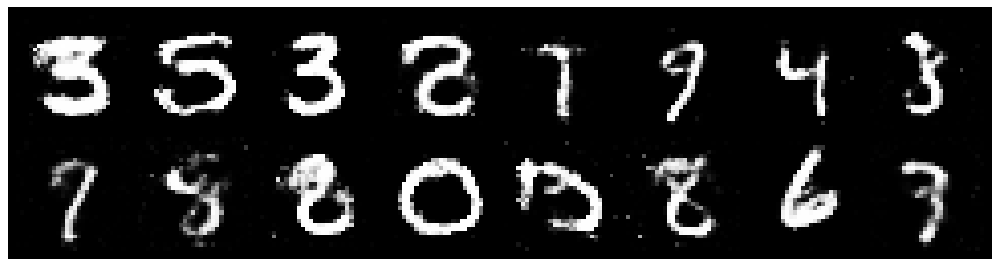

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8277
D(x): 0.5335, D(G(z)): 0.4815


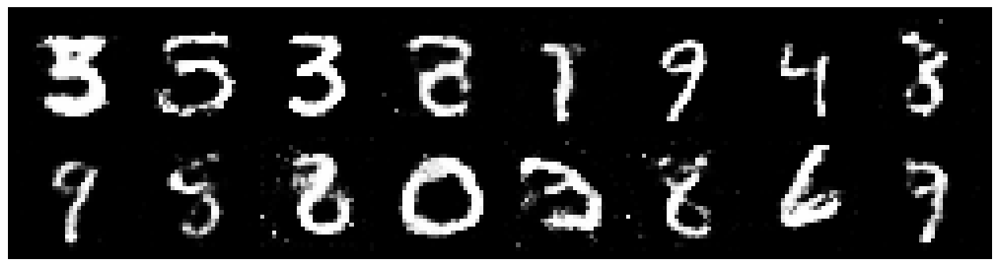

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9086
D(x): 0.5681, D(G(z)): 0.4242


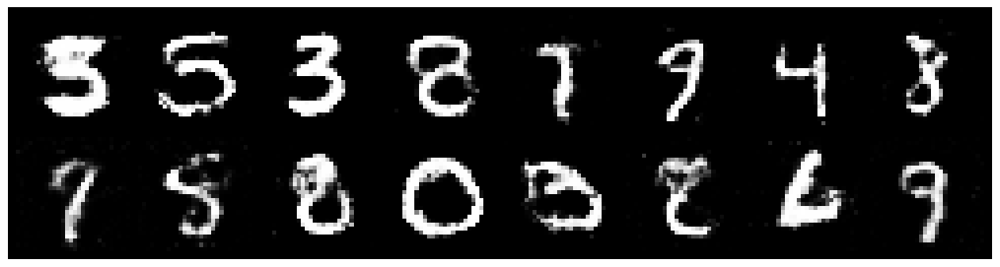

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.3242, Generator Loss: 0.8464
D(x): 0.5334, D(G(z)): 0.4410


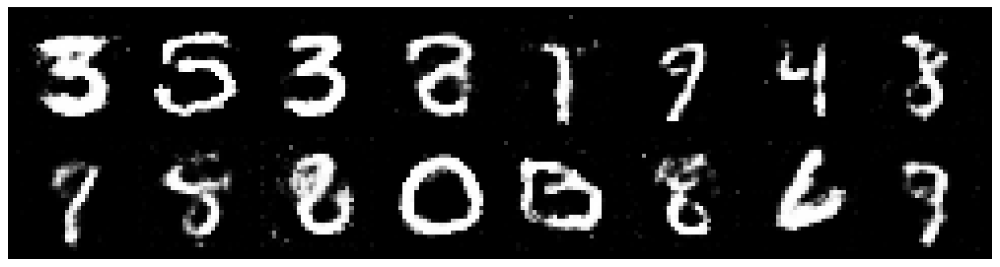

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.4322, Generator Loss: 0.7737
D(x): 0.5400, D(G(z)): 0.4864


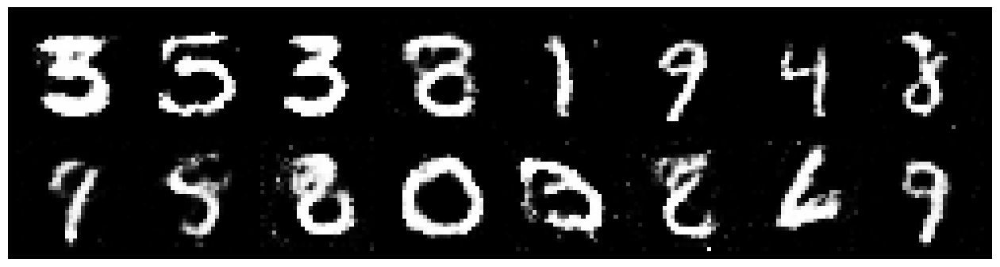

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.3287, Generator Loss: 0.7987
D(x): 0.5718, D(G(z)): 0.4883


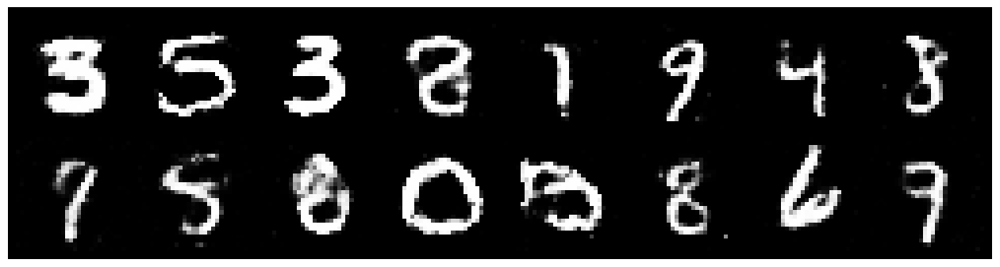

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.3465, Generator Loss: 0.8745
D(x): 0.4986, D(G(z)): 0.4366


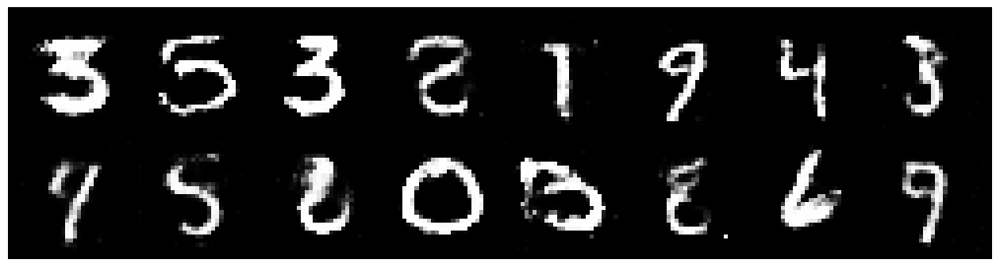

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.3181, Generator Loss: 0.8250
D(x): 0.5621, D(G(z)): 0.4843


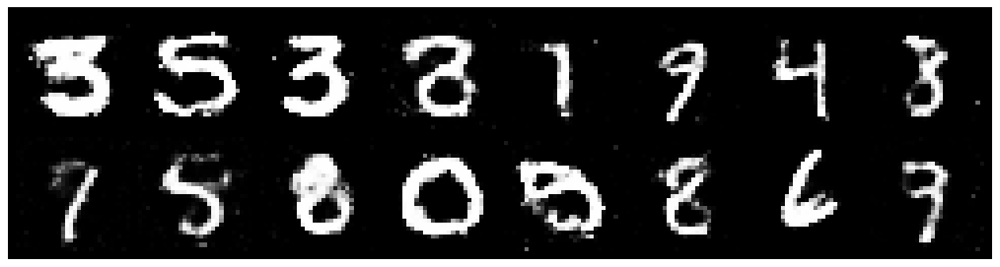

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2688, Generator Loss: 0.8618
D(x): 0.5786, D(G(z)): 0.4657


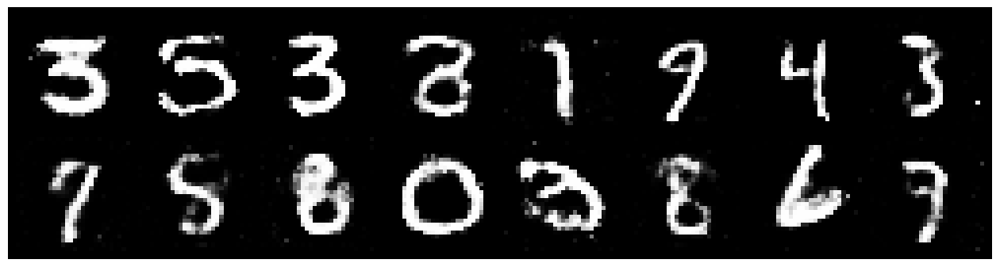

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.1831, Generator Loss: 0.8585
D(x): 0.5537, D(G(z)): 0.4077


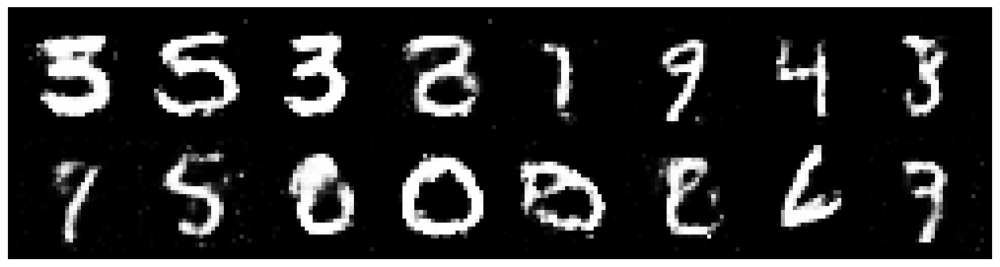

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2980, Generator Loss: 0.8472
D(x): 0.5654, D(G(z)): 0.4647


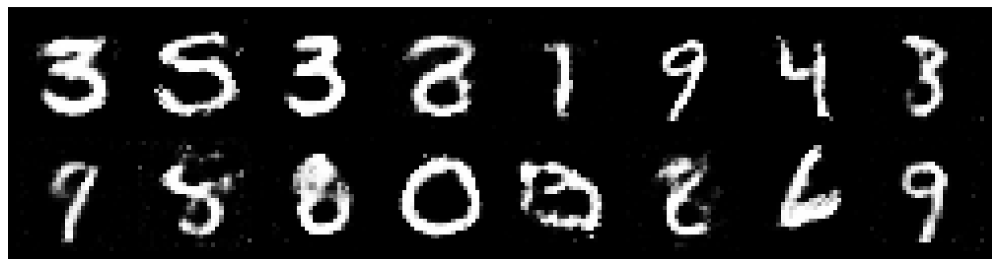

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.4276, Generator Loss: 0.8477
D(x): 0.4916, D(G(z)): 0.4631


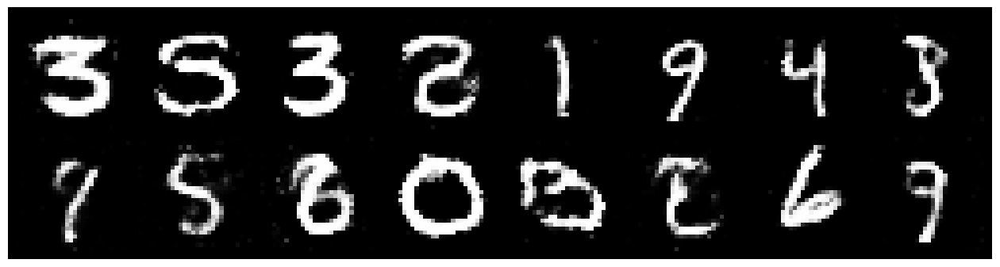

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8366
D(x): 0.5986, D(G(z)): 0.4820


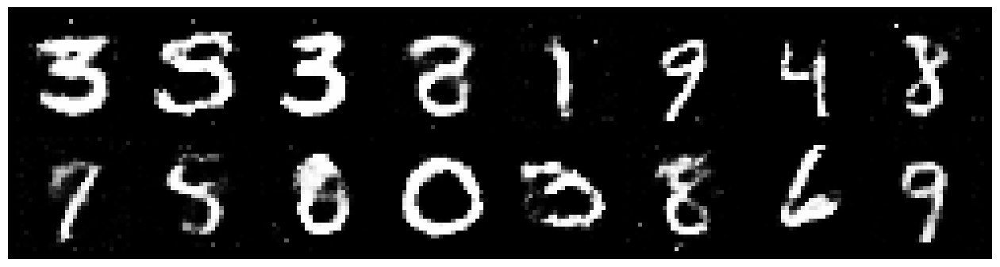

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2258, Generator Loss: 0.8372
D(x): 0.5667, D(G(z)): 0.4380


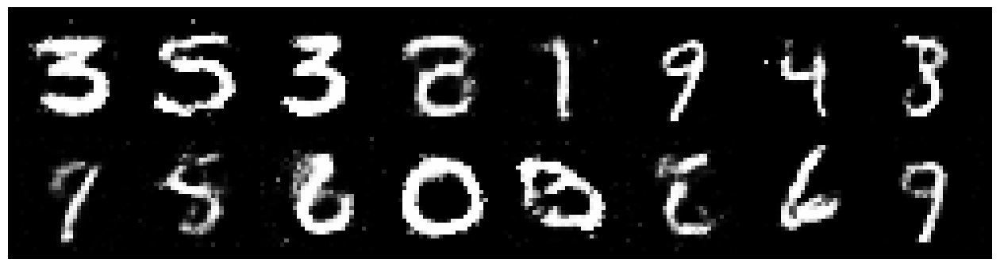

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.4035, Generator Loss: 0.9376
D(x): 0.4958, D(G(z)): 0.4387


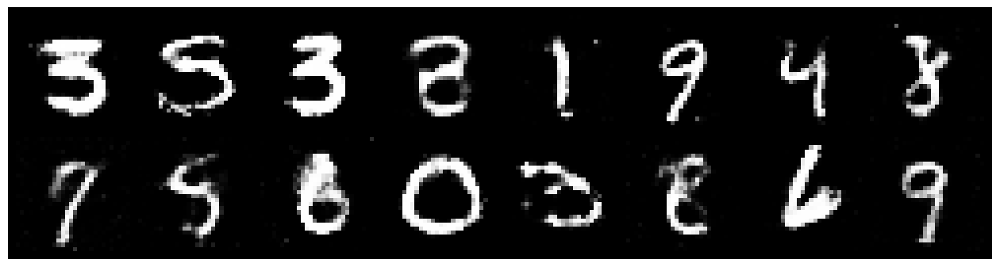

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2660, Generator Loss: 0.9404
D(x): 0.5164, D(G(z)): 0.4158


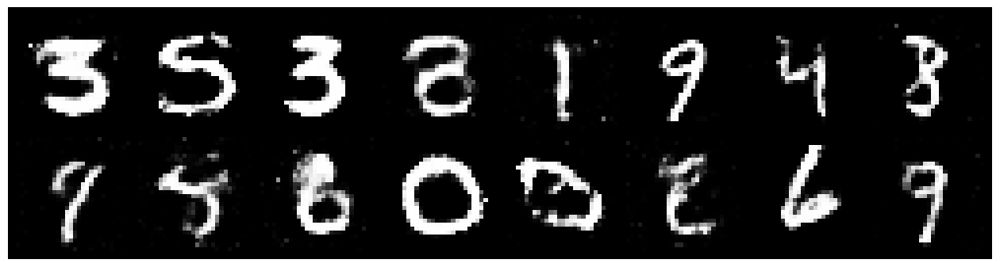

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2554, Generator Loss: 0.9690
D(x): 0.6083, D(G(z)): 0.4670


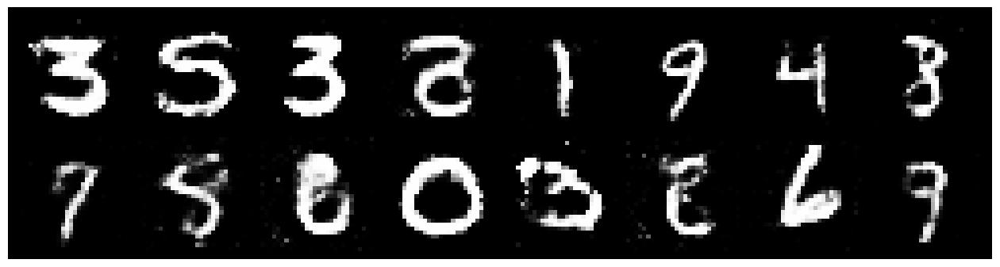

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.3337, Generator Loss: 0.9072
D(x): 0.5368, D(G(z)): 0.4714


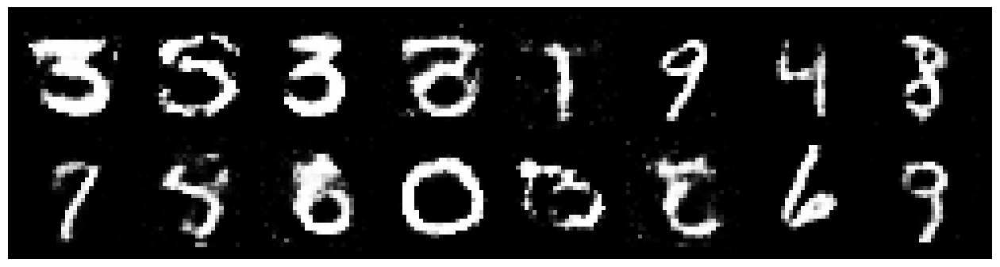

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.2110, Generator Loss: 1.0619
D(x): 0.5667, D(G(z)): 0.4162


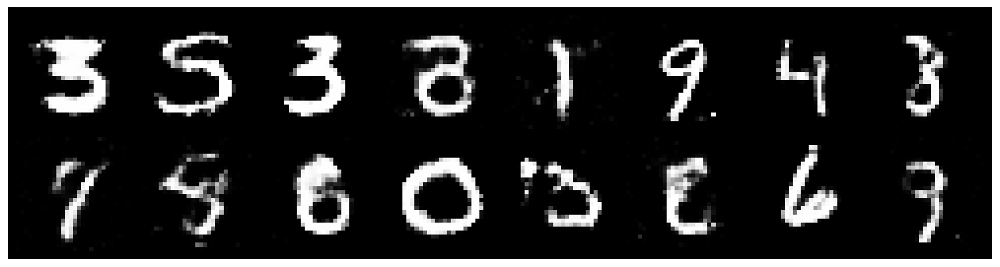

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.3460, Generator Loss: 1.0438
D(x): 0.5548, D(G(z)): 0.4708


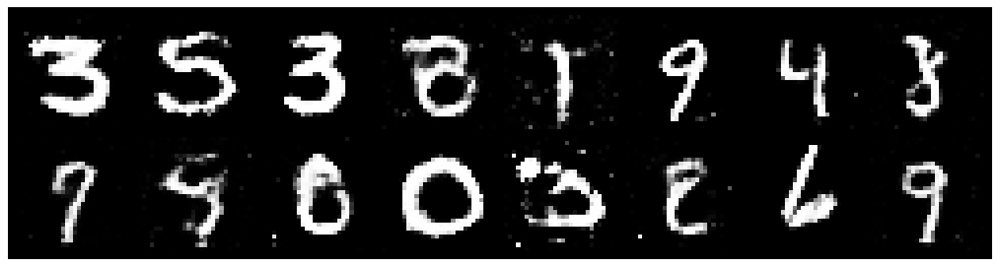

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.3029, Generator Loss: 0.8270
D(x): 0.5752, D(G(z)): 0.4631


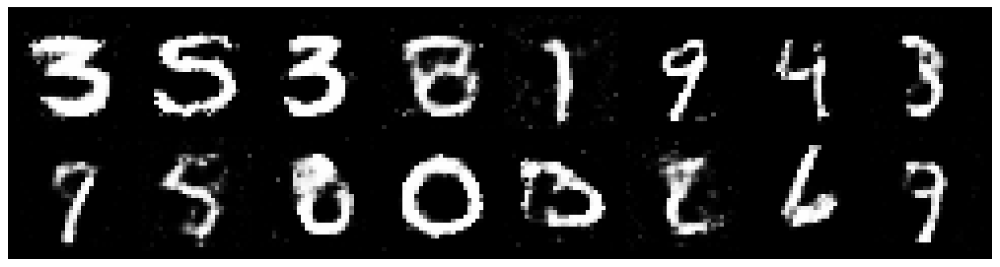

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.3216, Generator Loss: 0.8260
D(x): 0.5234, D(G(z)): 0.4547


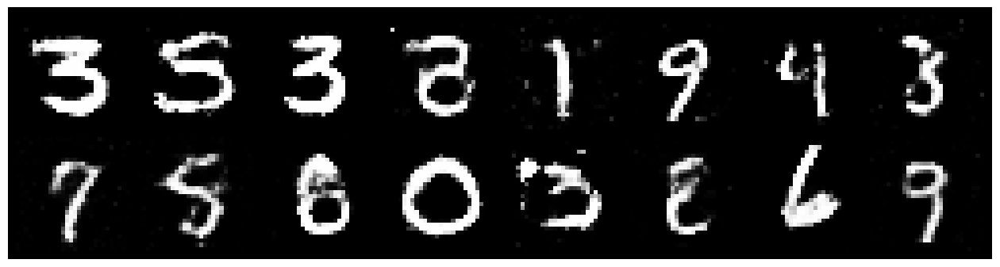

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8424
D(x): 0.5429, D(G(z)): 0.4683


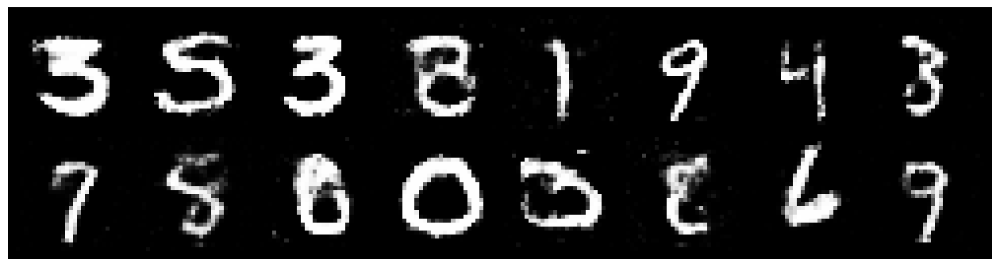

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3005, Generator Loss: 0.8163
D(x): 0.5521, D(G(z)): 0.4559


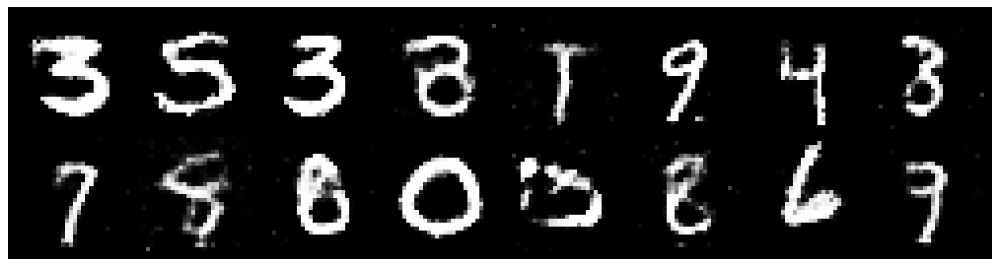

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2448, Generator Loss: 0.9103
D(x): 0.5461, D(G(z)): 0.4272


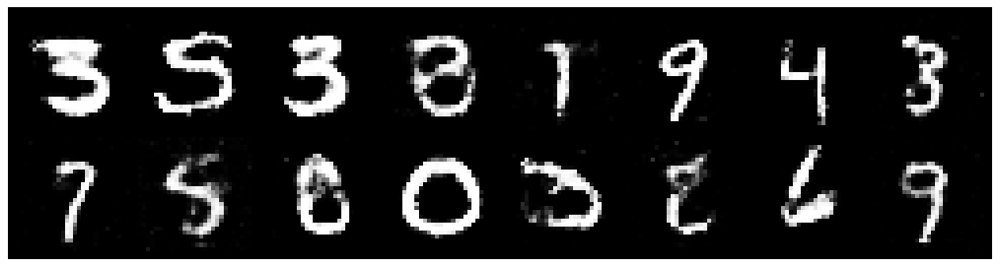

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3109, Generator Loss: 0.9027
D(x): 0.5559, D(G(z)): 0.4719


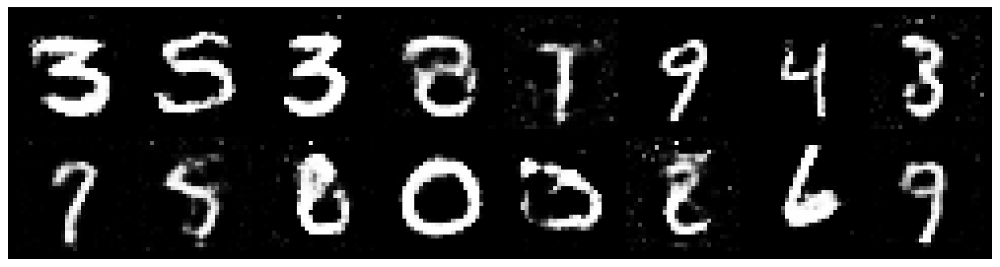

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2313, Generator Loss: 0.8011
D(x): 0.5435, D(G(z)): 0.4317


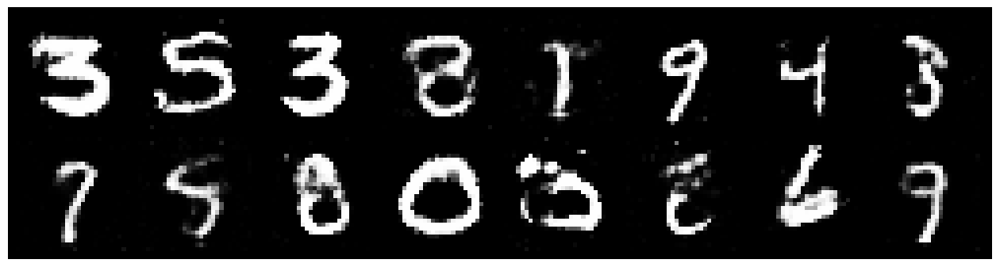

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2551, Generator Loss: 0.8414
D(x): 0.5560, D(G(z)): 0.4473


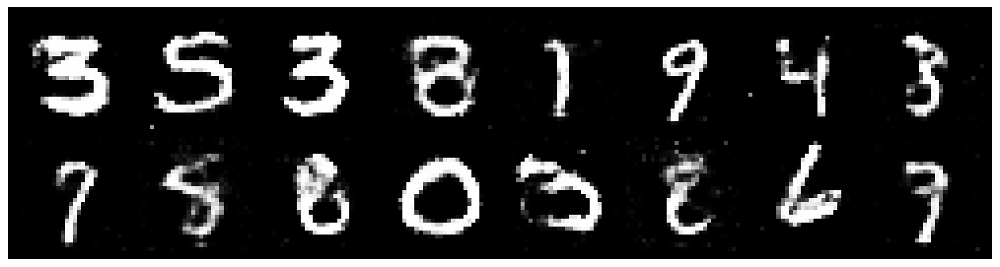

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.3000, Generator Loss: 0.8559
D(x): 0.5442, D(G(z)): 0.4647


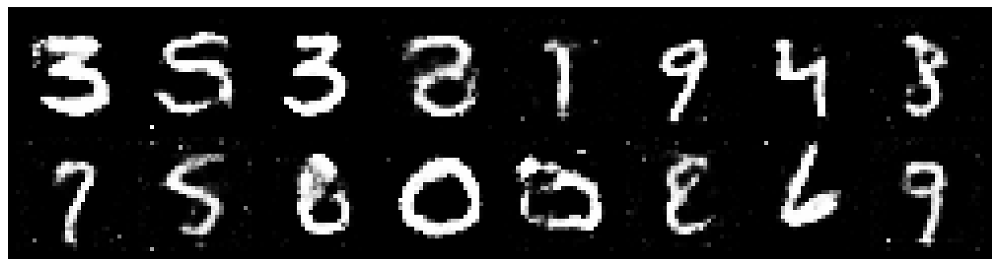

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.3063, Generator Loss: 0.8507
D(x): 0.5542, D(G(z)): 0.4674


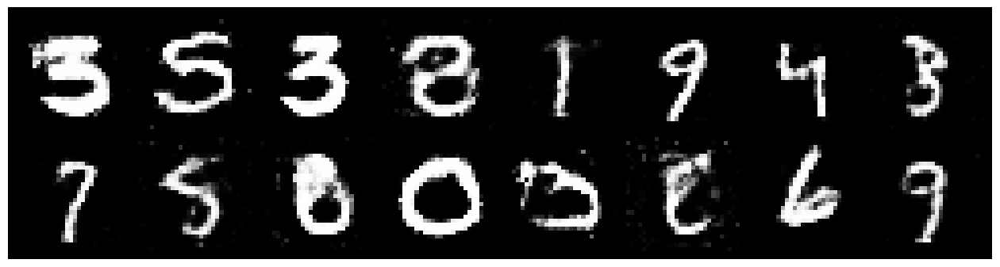

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.2558, Generator Loss: 0.8172
D(x): 0.5536, D(G(z)): 0.4457


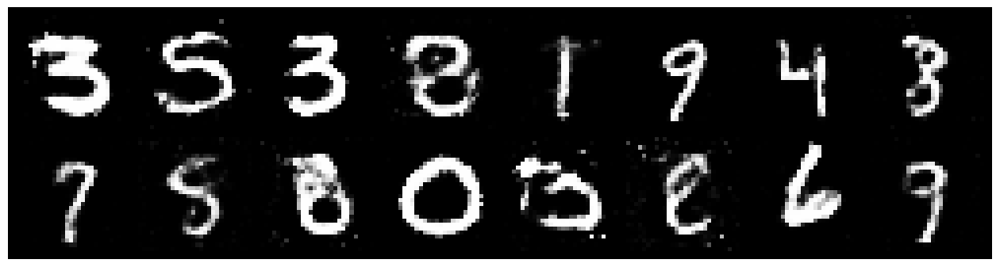

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2898, Generator Loss: 0.8633
D(x): 0.5526, D(G(z)): 0.4541


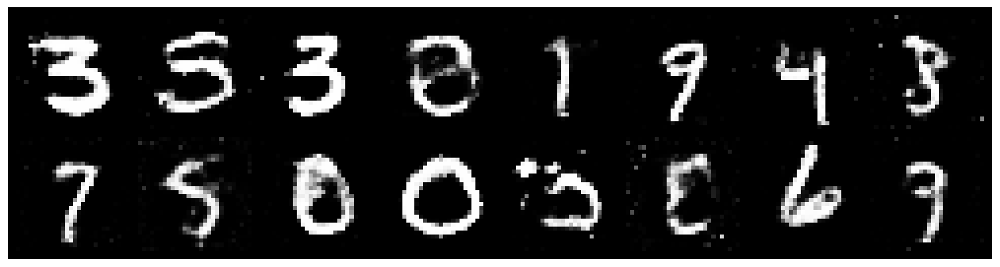

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3049, Generator Loss: 0.8476
D(x): 0.5531, D(G(z)): 0.4688


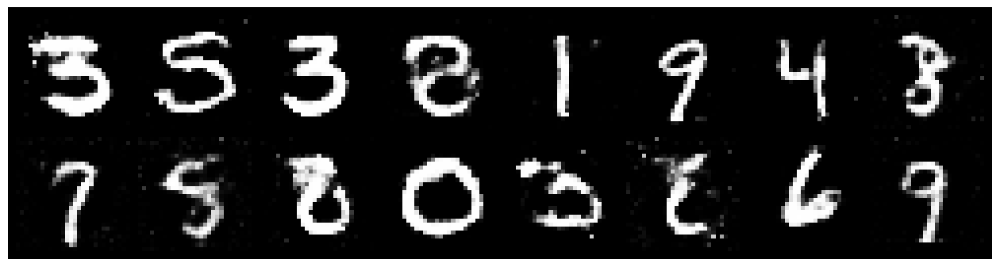

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2955, Generator Loss: 0.8846
D(x): 0.5270, D(G(z)): 0.4359


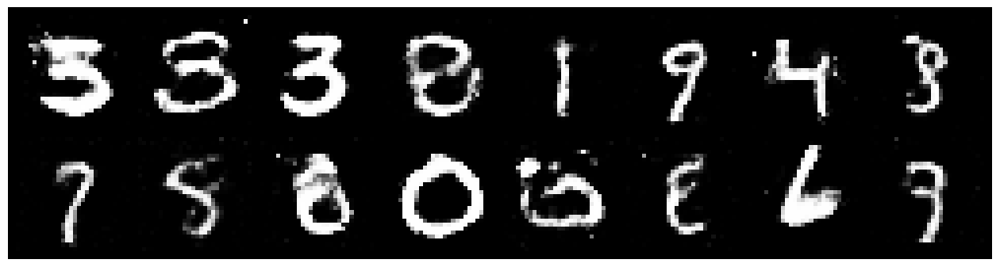

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2431, Generator Loss: 0.7516
D(x): 0.5841, D(G(z)): 0.4781


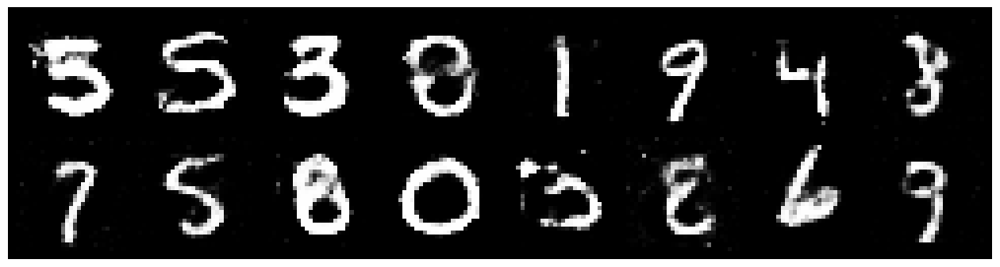

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.4085, Generator Loss: 0.9400
D(x): 0.5019, D(G(z)): 0.4597


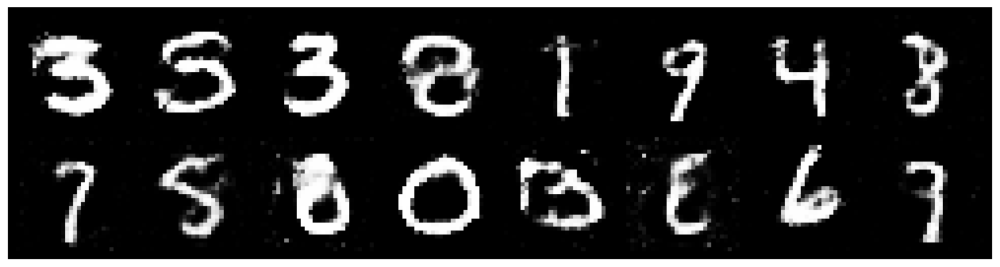

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2940, Generator Loss: 0.7864
D(x): 0.5516, D(G(z)): 0.4603


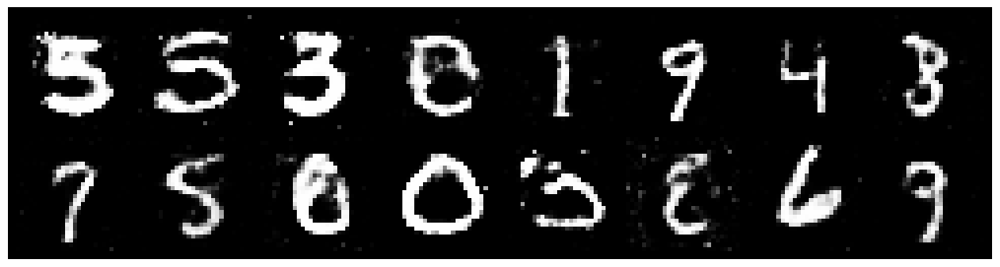

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8733
D(x): 0.5239, D(G(z)): 0.4370


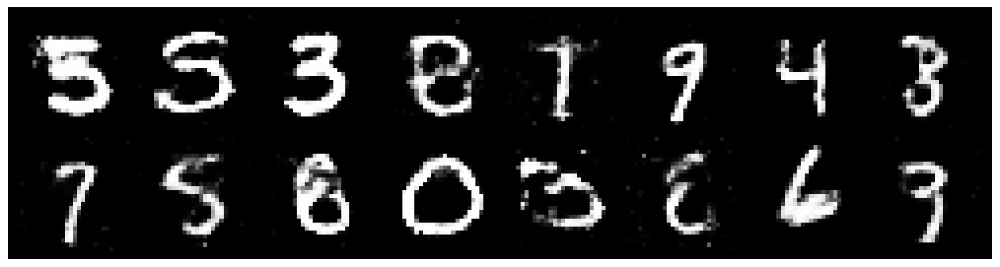

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2905, Generator Loss: 0.8572
D(x): 0.5513, D(G(z)): 0.4510


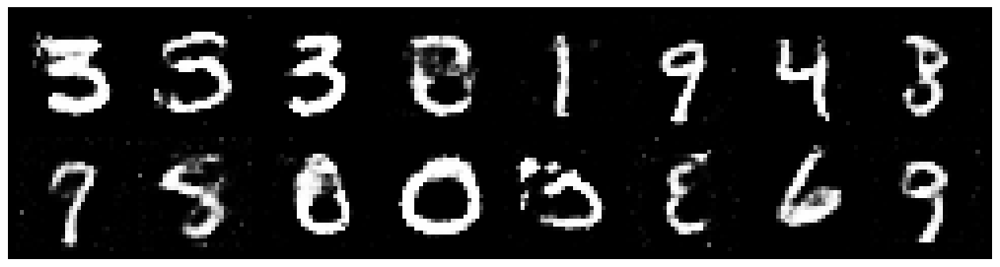

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.3503, Generator Loss: 0.9423
D(x): 0.5393, D(G(z)): 0.4550


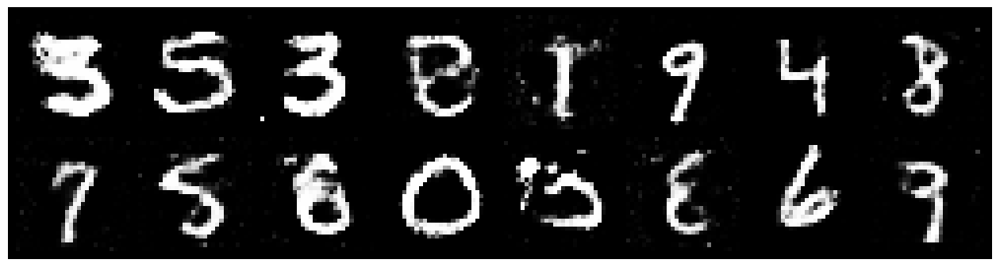

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8983
D(x): 0.5501, D(G(z)): 0.4407


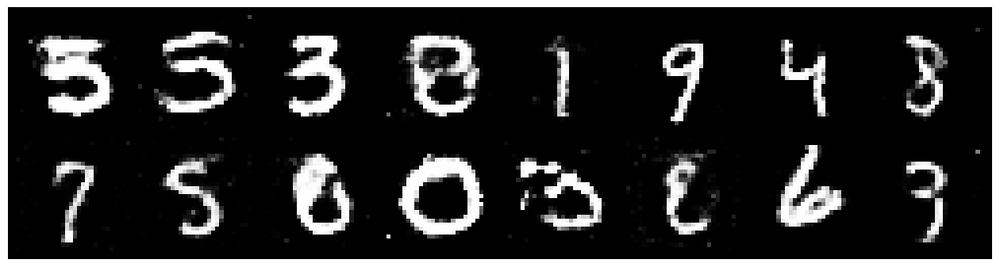

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2674, Generator Loss: 0.9291
D(x): 0.5752, D(G(z)): 0.4420


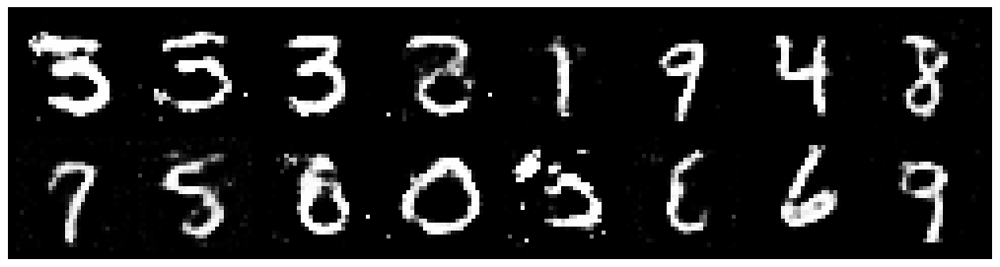

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.2492, Generator Loss: 0.8514
D(x): 0.5654, D(G(z)): 0.4495


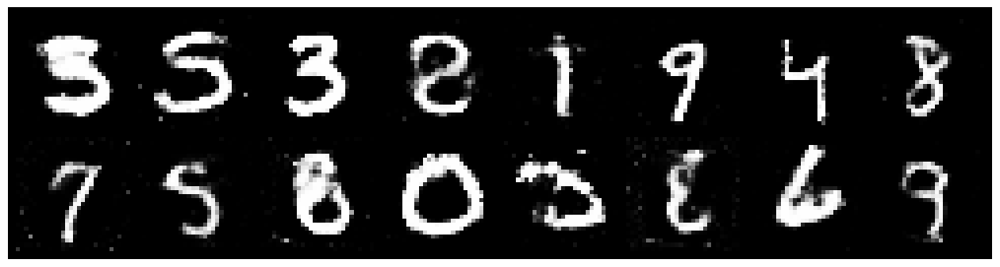

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3424, Generator Loss: 0.9209
D(x): 0.4796, D(G(z)): 0.4162


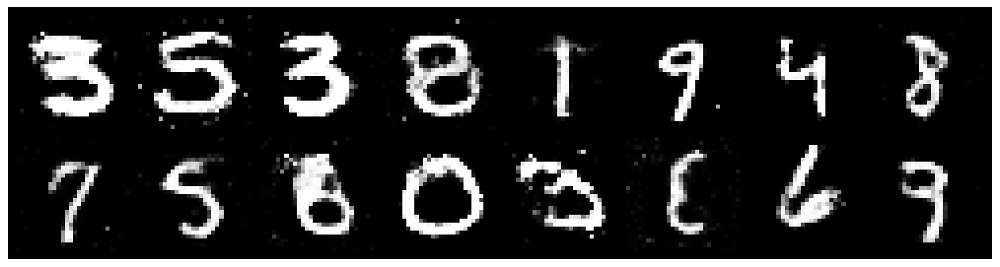

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.3078, Generator Loss: 0.8959
D(x): 0.5618, D(G(z)): 0.4680


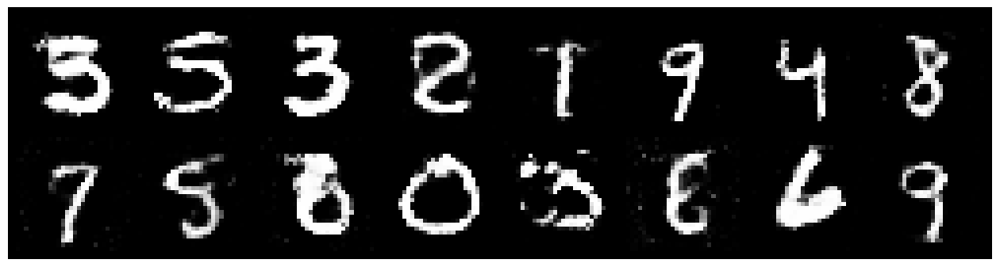

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2191, Generator Loss: 0.8125
D(x): 0.5778, D(G(z)): 0.4503


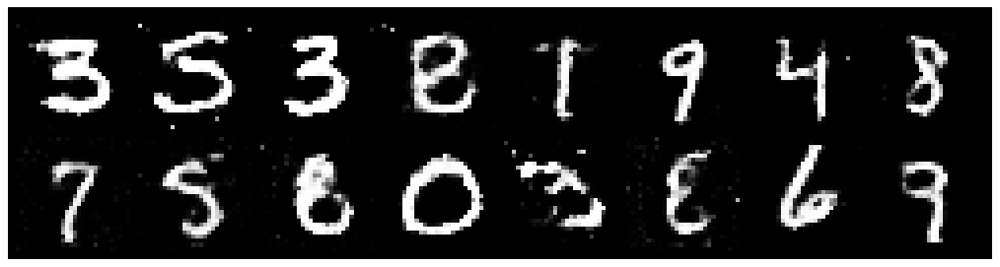

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3633, Generator Loss: 0.8768
D(x): 0.5094, D(G(z)): 0.4563


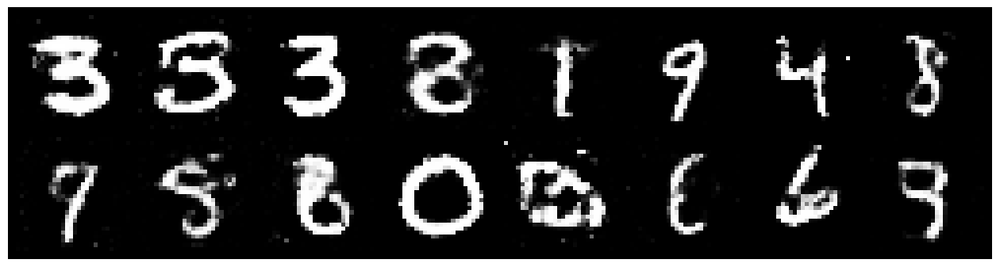

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.3711, Generator Loss: 0.8049
D(x): 0.5386, D(G(z)): 0.4974


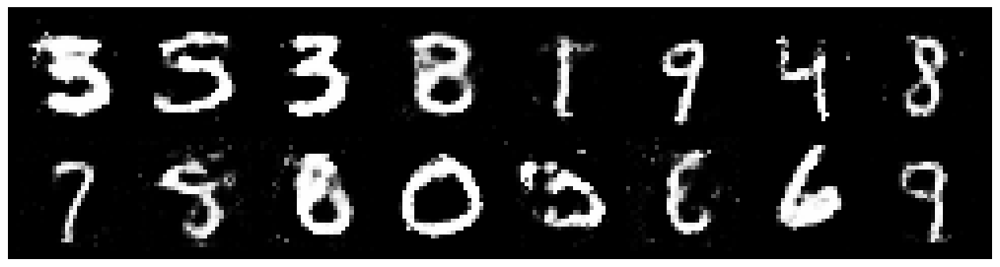

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2367, Generator Loss: 0.8910
D(x): 0.5524, D(G(z)): 0.4338


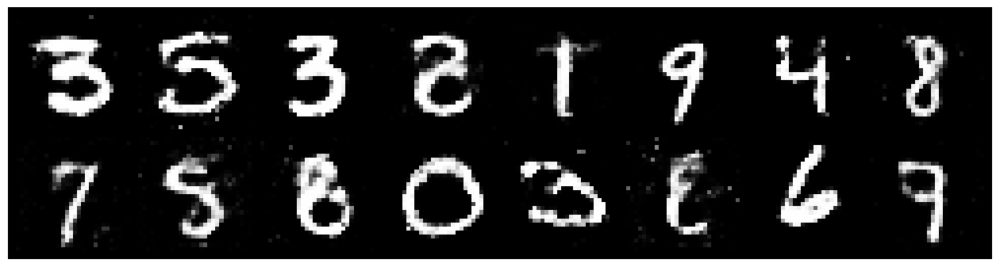

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.3082, Generator Loss: 0.8679
D(x): 0.5627, D(G(z)): 0.4699


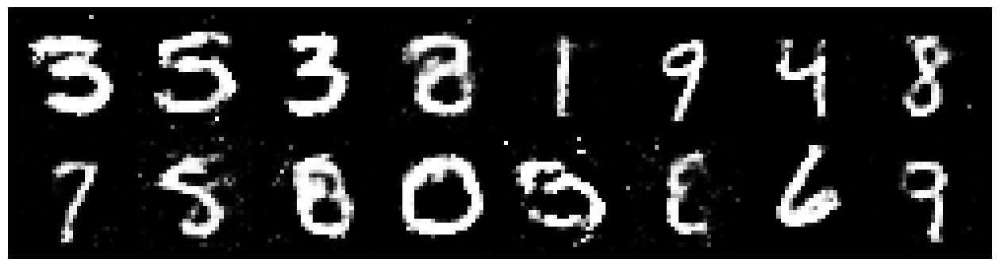

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2701, Generator Loss: 0.7700
D(x): 0.5737, D(G(z)): 0.4541


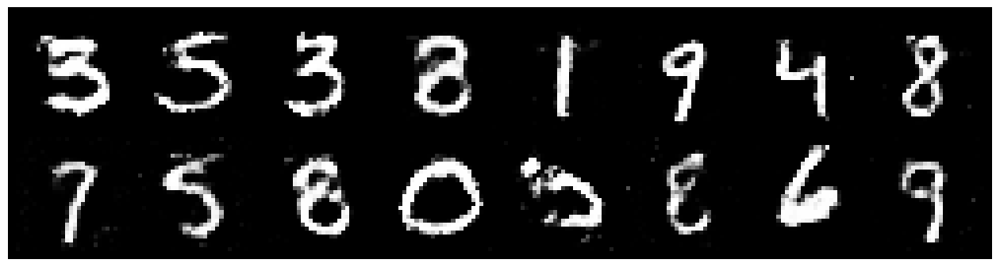

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2650, Generator Loss: 0.8455
D(x): 0.5543, D(G(z)): 0.4608


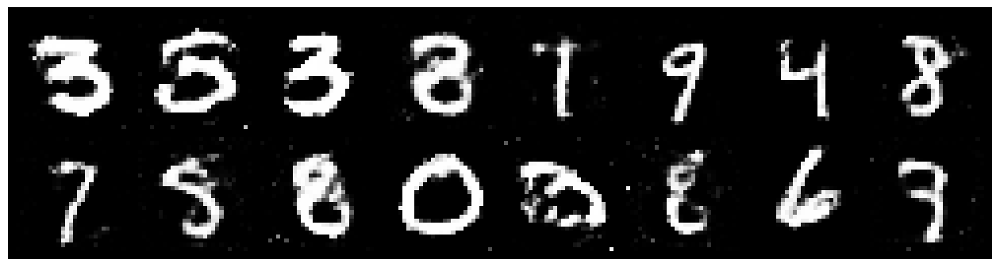

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9845
D(x): 0.5427, D(G(z)): 0.4153


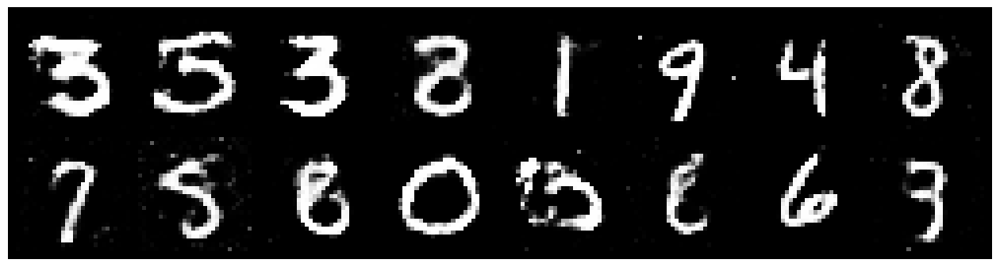

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.3457, Generator Loss: 0.8039
D(x): 0.5345, D(G(z)): 0.4487


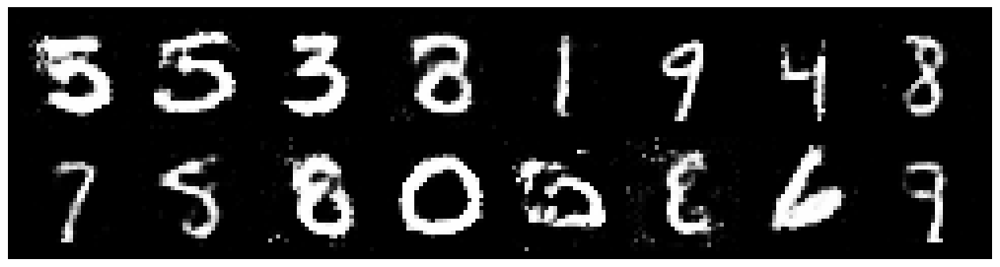

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2987, Generator Loss: 0.8816
D(x): 0.5383, D(G(z)): 0.4449


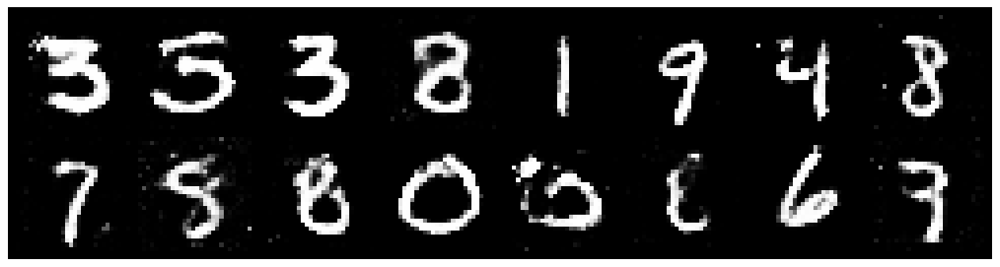

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2960, Generator Loss: 0.9077
D(x): 0.5489, D(G(z)): 0.4581


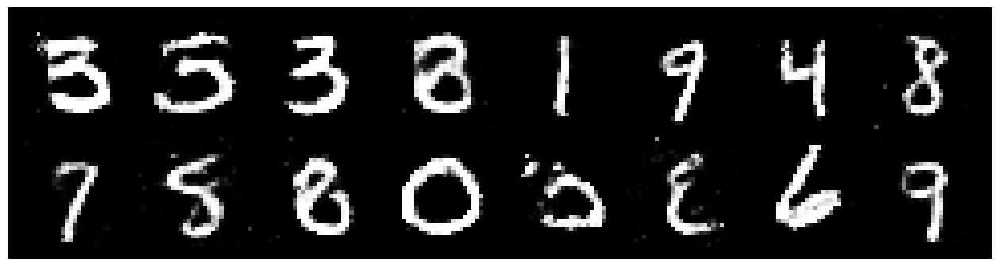

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2532, Generator Loss: 0.9635
D(x): 0.5770, D(G(z)): 0.4430


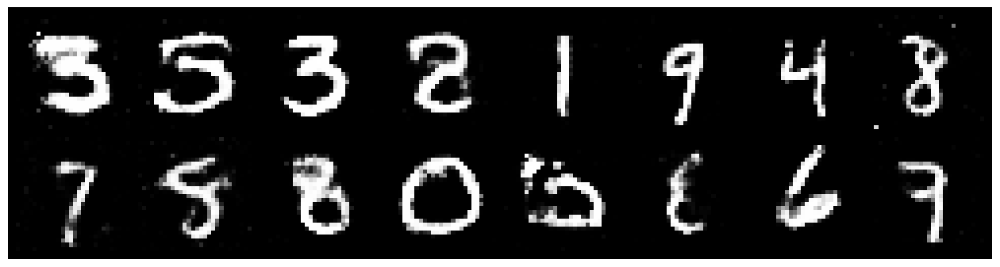

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.1591, Generator Loss: 0.9780
D(x): 0.5746, D(G(z)): 0.3797


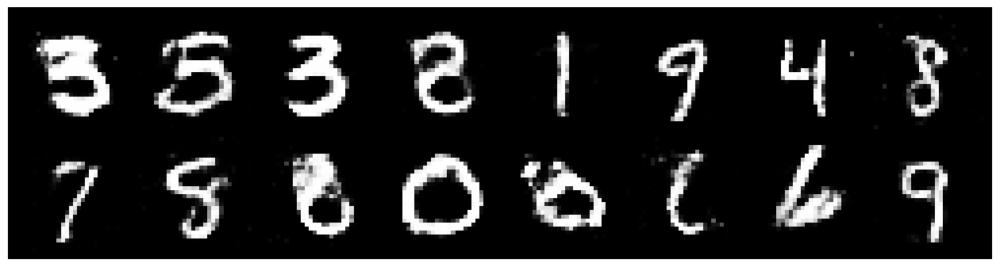

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3670, Generator Loss: 0.8731
D(x): 0.5364, D(G(z)): 0.4696


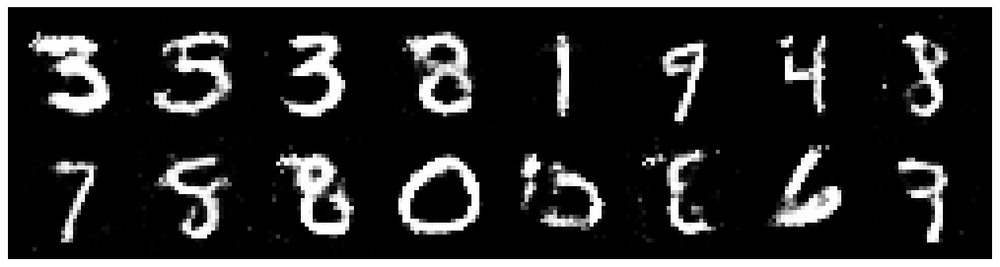

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.3864, Generator Loss: 0.7839
D(x): 0.5001, D(G(z)): 0.4668


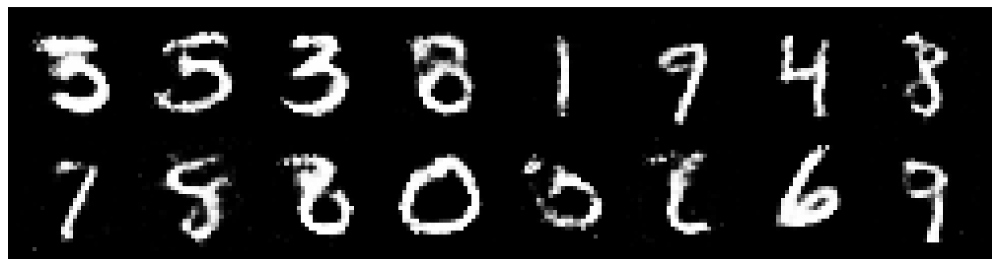

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3444, Generator Loss: 0.8851
D(x): 0.5386, D(G(z)): 0.4599


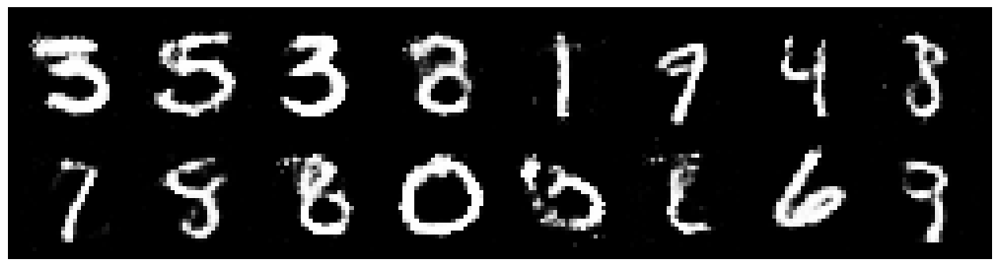

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.3976, Generator Loss: 0.8574
D(x): 0.5074, D(G(z)): 0.4723


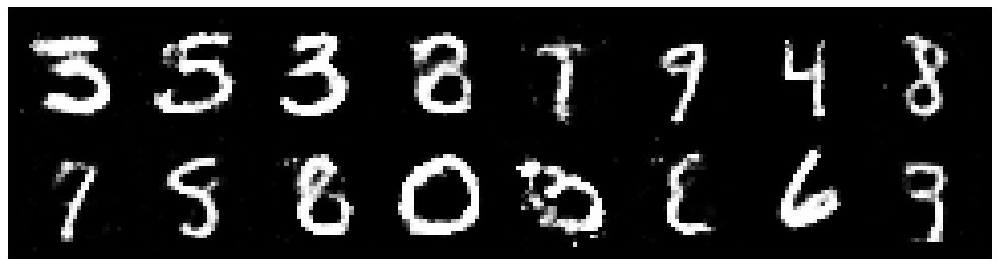

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2380, Generator Loss: 0.8597
D(x): 0.5423, D(G(z)): 0.4276


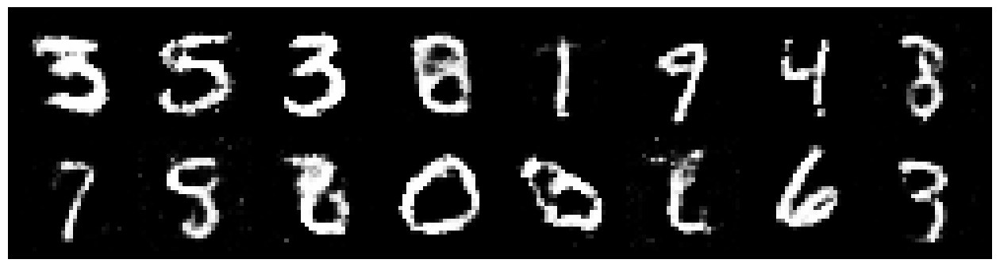

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3047, Generator Loss: 0.8286
D(x): 0.5298, D(G(z)): 0.4542


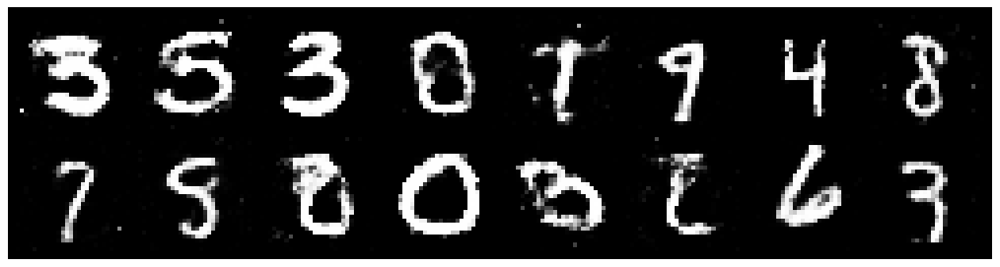

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2349, Generator Loss: 0.7932
D(x): 0.5665, D(G(z)): 0.4553


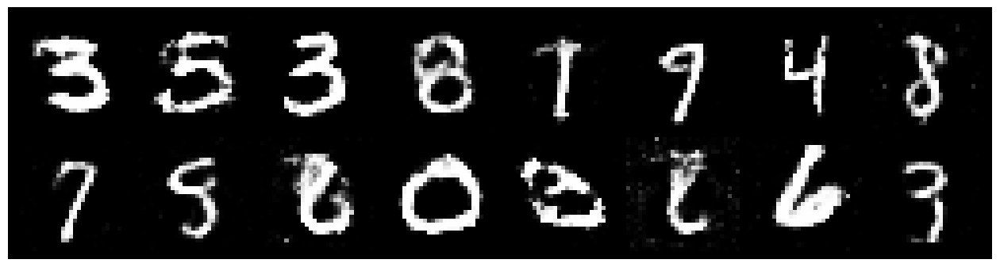

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2436, Generator Loss: 0.9086
D(x): 0.5744, D(G(z)): 0.4445


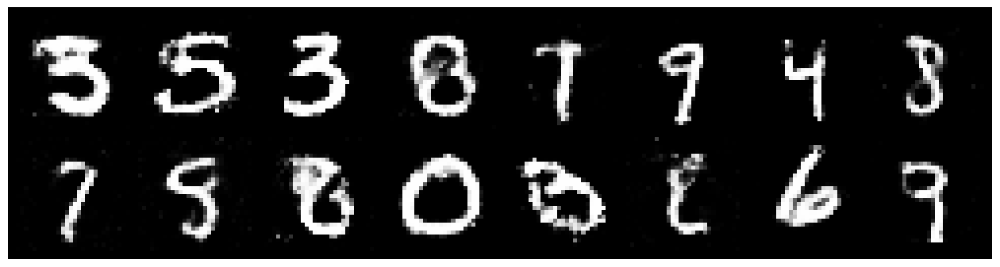

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2321, Generator Loss: 0.9077
D(x): 0.5760, D(G(z)): 0.4266


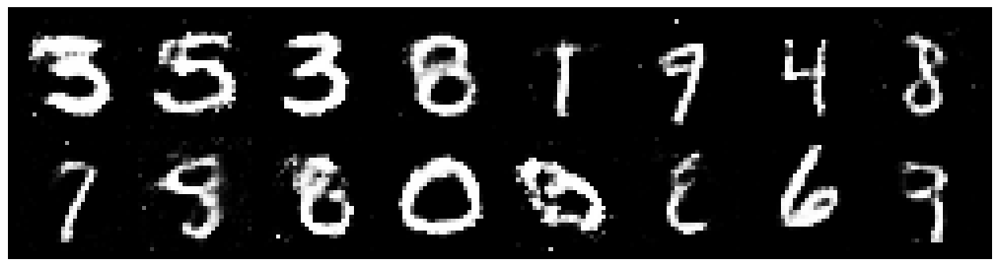

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3032, Generator Loss: 0.8786
D(x): 0.5123, D(G(z)): 0.4267


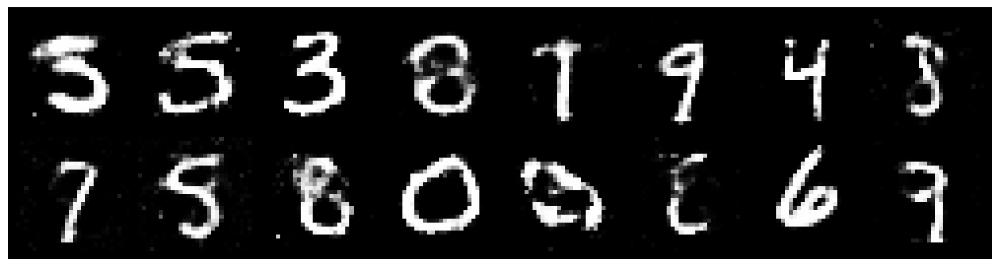

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.3157, Generator Loss: 0.8181
D(x): 0.5440, D(G(z)): 0.4651


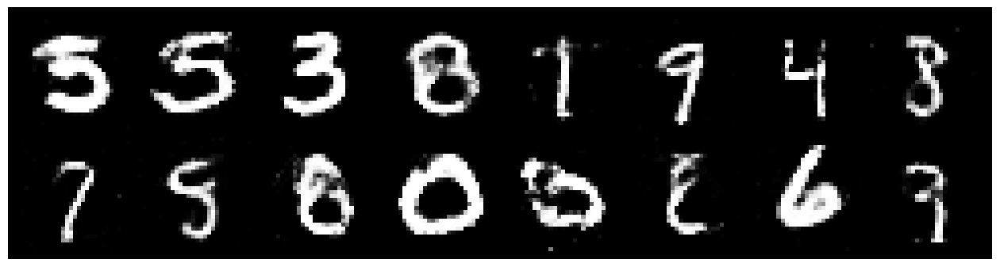

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2767, Generator Loss: 0.8804
D(x): 0.5374, D(G(z)): 0.4339


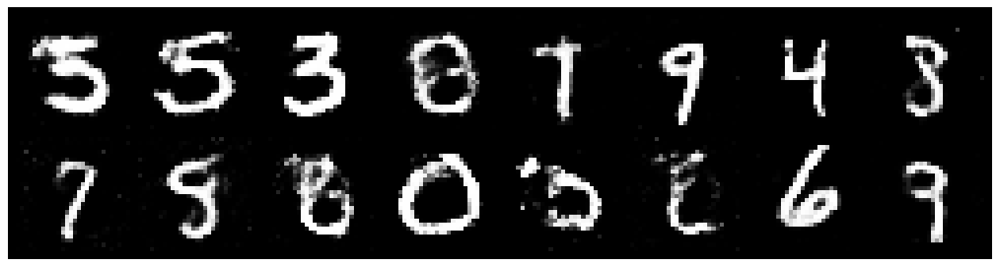

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8375
D(x): 0.5795, D(G(z)): 0.4803


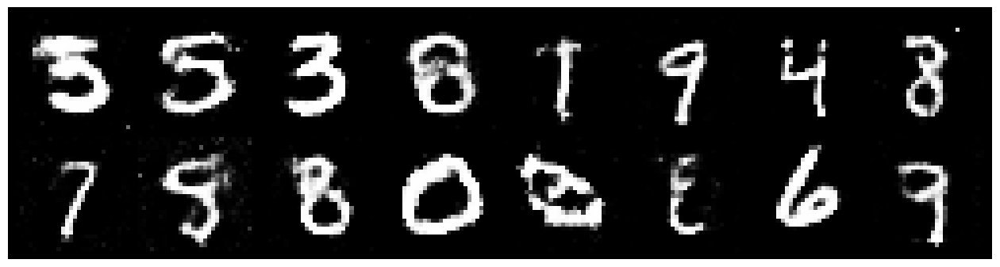

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.3075, Generator Loss: 0.7858
D(x): 0.5471, D(G(z)): 0.4636


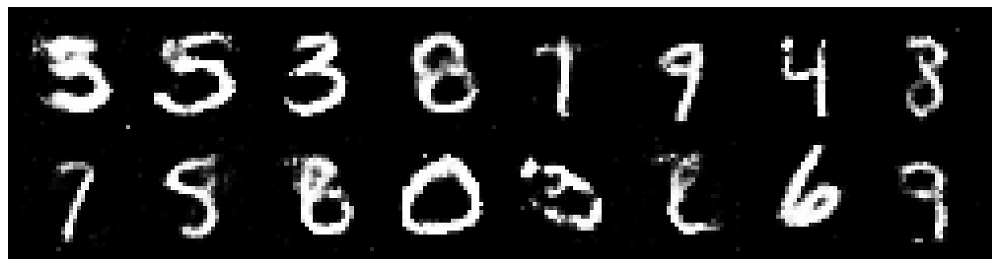

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2731, Generator Loss: 0.8479
D(x): 0.5239, D(G(z)): 0.4394


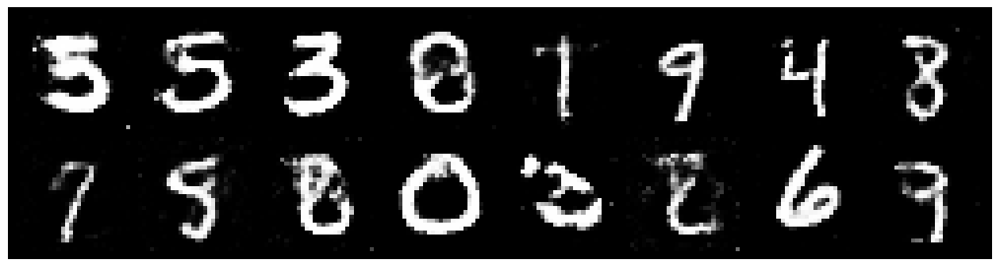

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2288, Generator Loss: 0.9797
D(x): 0.5574, D(G(z)): 0.4393


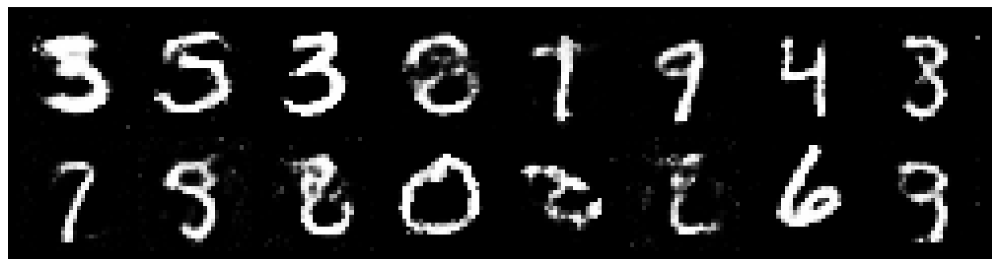

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.3102, Generator Loss: 0.8350
D(x): 0.5306, D(G(z)): 0.4587


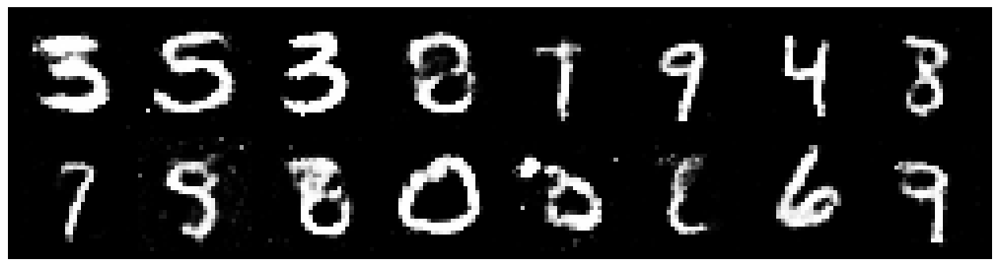

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3408, Generator Loss: 0.8238
D(x): 0.5635, D(G(z)): 0.4610


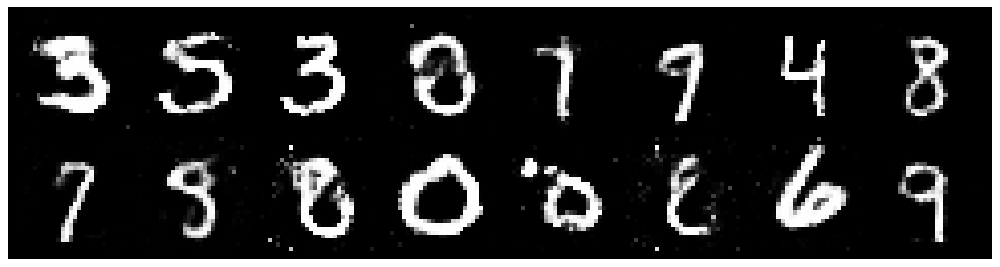

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2876, Generator Loss: 1.0295
D(x): 0.5395, D(G(z)): 0.4128


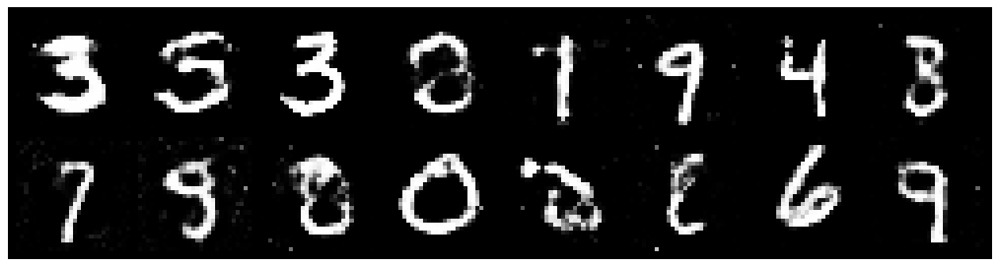

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2362, Generator Loss: 0.9488
D(x): 0.5736, D(G(z)): 0.4311


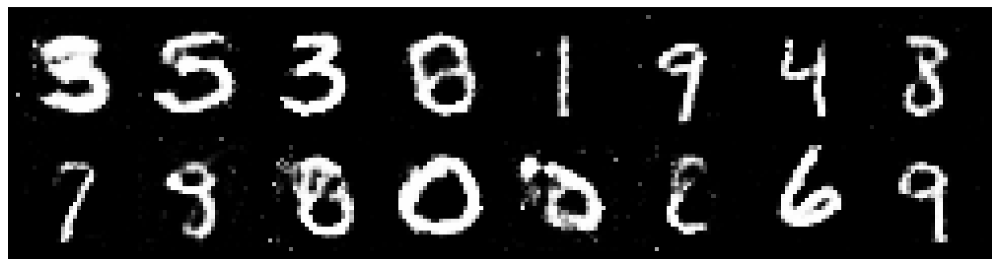

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2787, Generator Loss: 0.8282
D(x): 0.5551, D(G(z)): 0.4603


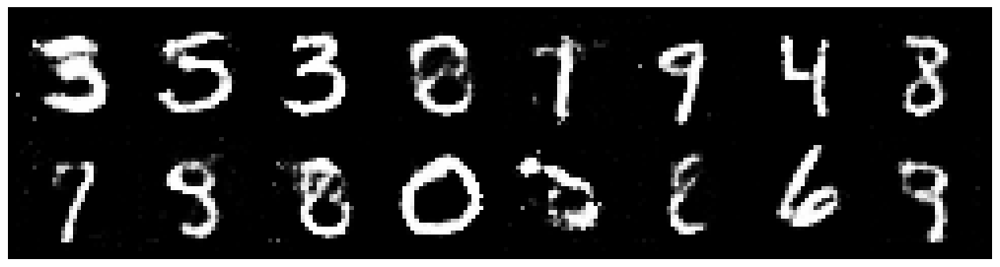

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2458, Generator Loss: 0.8421
D(x): 0.5415, D(G(z)): 0.4428


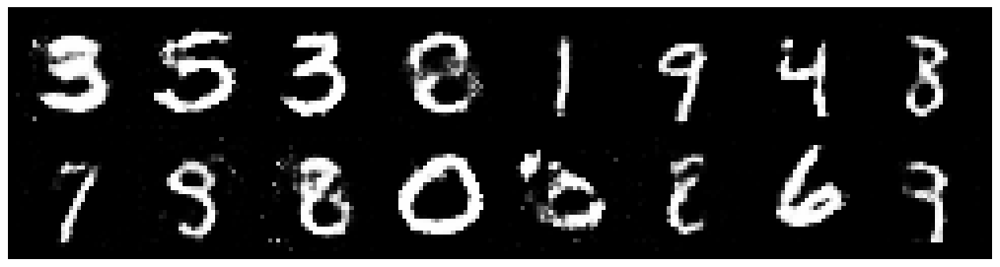

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2943, Generator Loss: 0.9485
D(x): 0.5445, D(G(z)): 0.4431


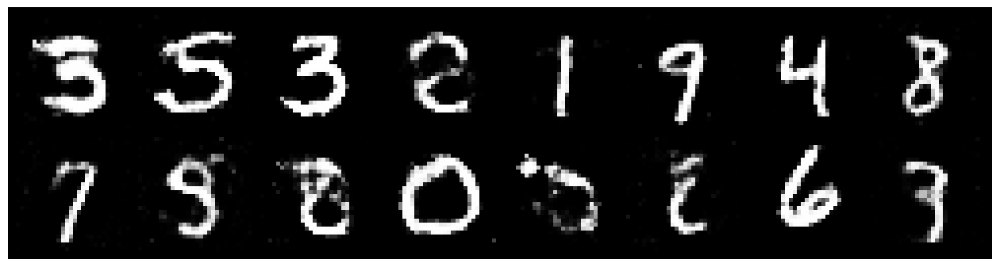

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2824, Generator Loss: 0.9687
D(x): 0.5449, D(G(z)): 0.4241


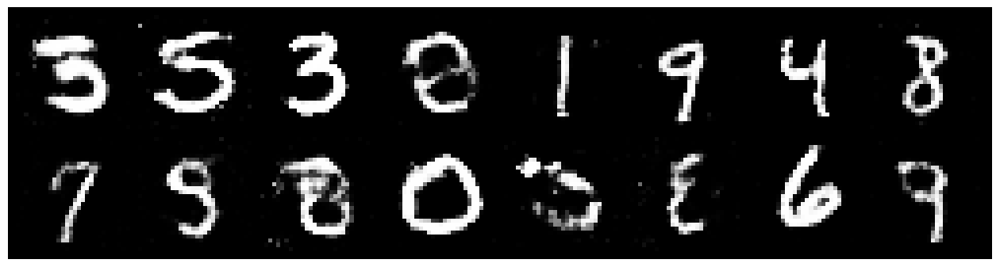

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2648, Generator Loss: 0.7920
D(x): 0.5931, D(G(z)): 0.4716


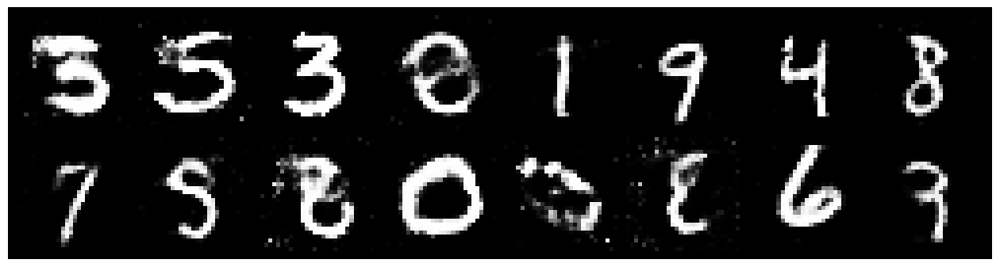

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3045, Generator Loss: 0.8567
D(x): 0.5255, D(G(z)): 0.4383


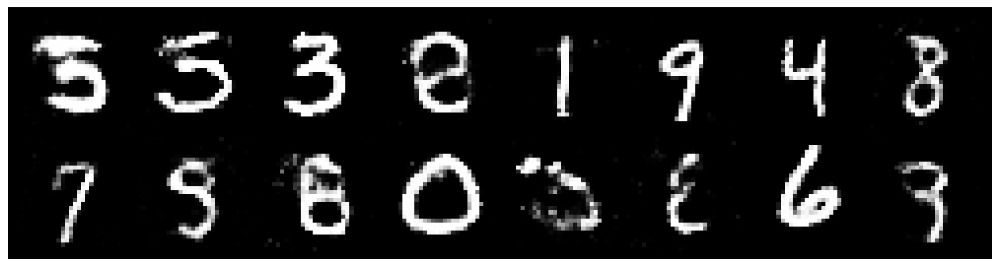

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.2600, Generator Loss: 0.8275
D(x): 0.5485, D(G(z)): 0.4392


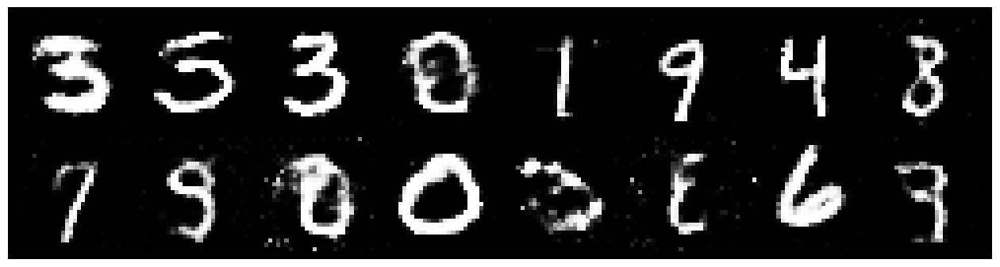

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2484, Generator Loss: 0.9313
D(x): 0.5348, D(G(z)): 0.4175


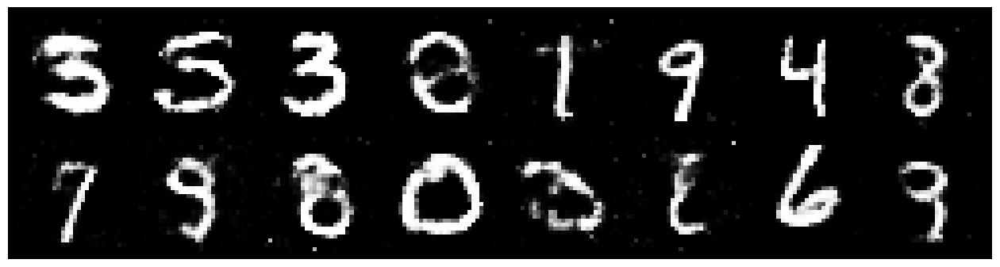

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2323, Generator Loss: 0.8883
D(x): 0.5731, D(G(z)): 0.4514


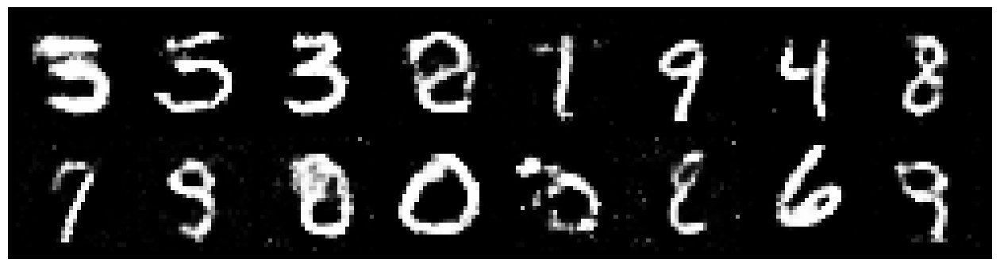

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.3009, Generator Loss: 0.9292
D(x): 0.5654, D(G(z)): 0.4695


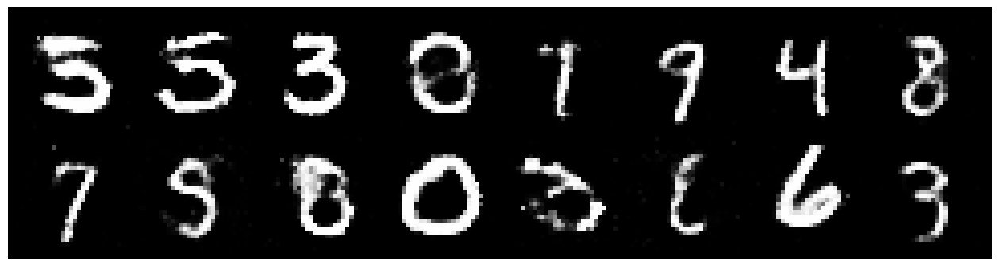

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.3290, Generator Loss: 0.9569
D(x): 0.5523, D(G(z)): 0.4611


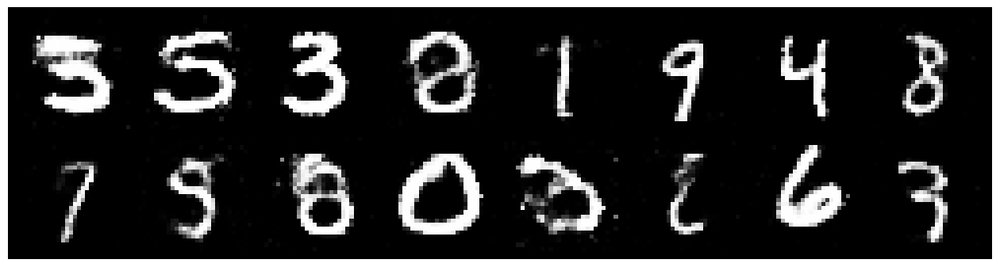

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.2376, Generator Loss: 1.0651
D(x): 0.5309, D(G(z)): 0.3897


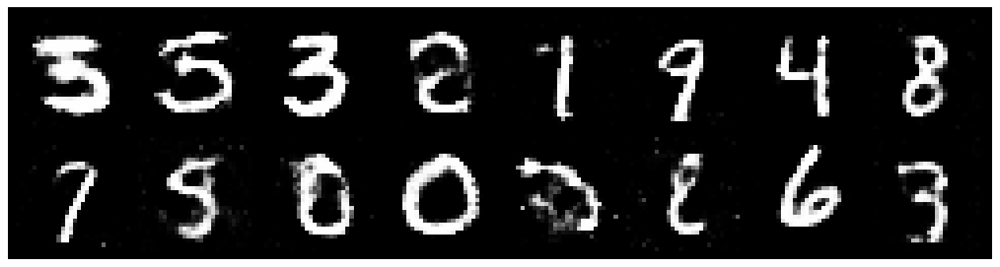

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8942
D(x): 0.5493, D(G(z)): 0.4286


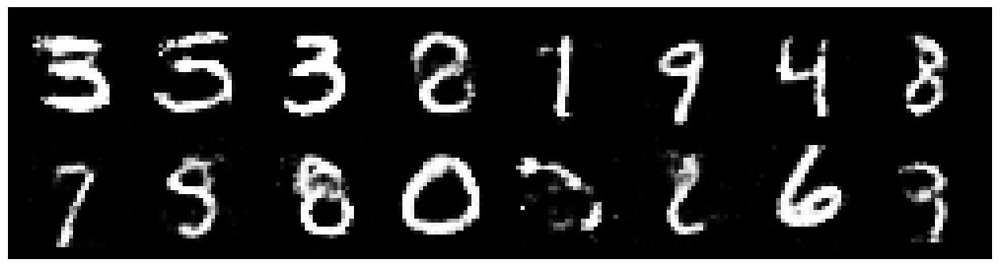

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.3296, Generator Loss: 0.9167
D(x): 0.5612, D(G(z)): 0.4626


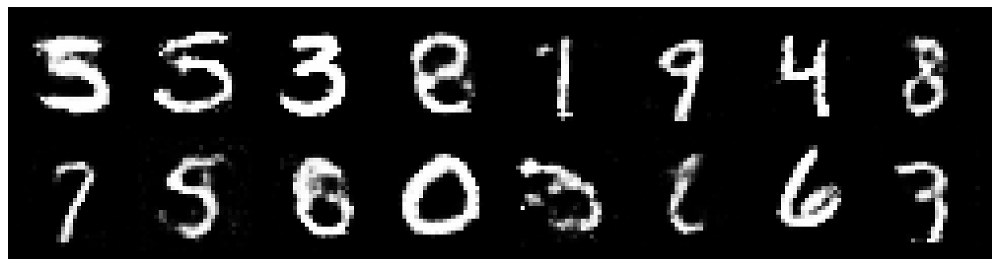

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.3106, Generator Loss: 0.7950
D(x): 0.5595, D(G(z)): 0.4835


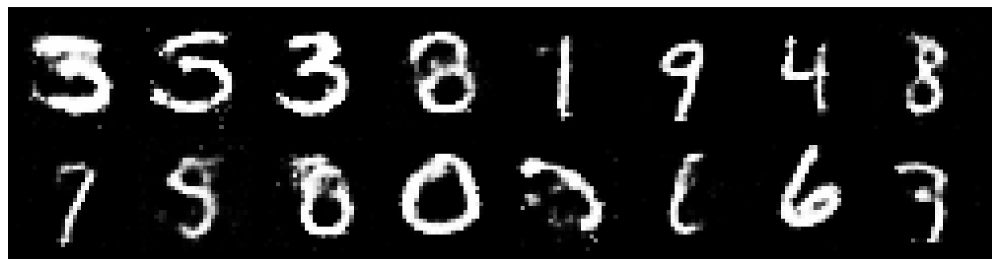

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3549, Generator Loss: 0.8019
D(x): 0.5474, D(G(z)): 0.4926


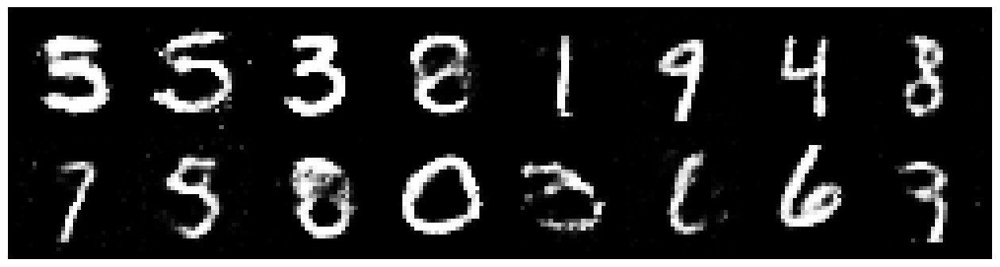

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.1702, Generator Loss: 0.9012
D(x): 0.6020, D(G(z)): 0.4285


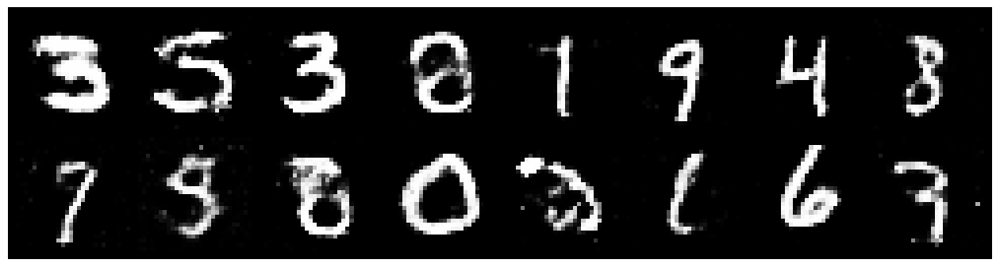

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3746, Generator Loss: 1.0198
D(x): 0.5176, D(G(z)): 0.4338


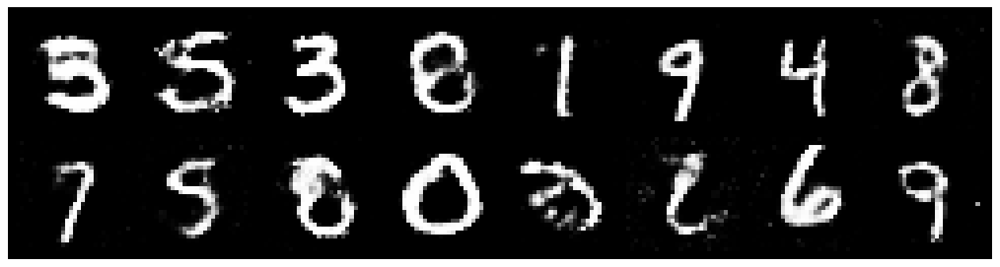

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.4024, Generator Loss: 0.9653
D(x): 0.5512, D(G(z)): 0.4892


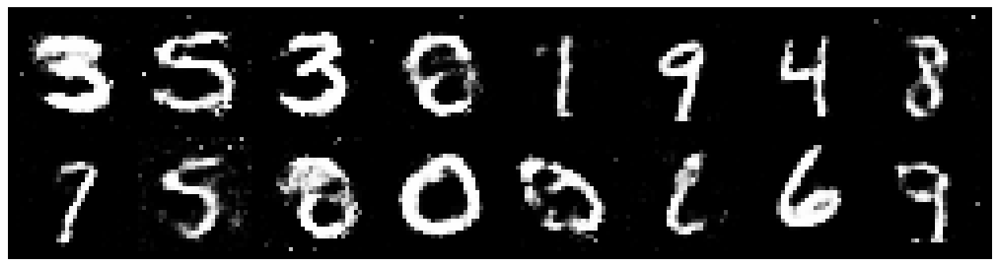

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.4497, Generator Loss: 0.9315
D(x): 0.5337, D(G(z)): 0.5037


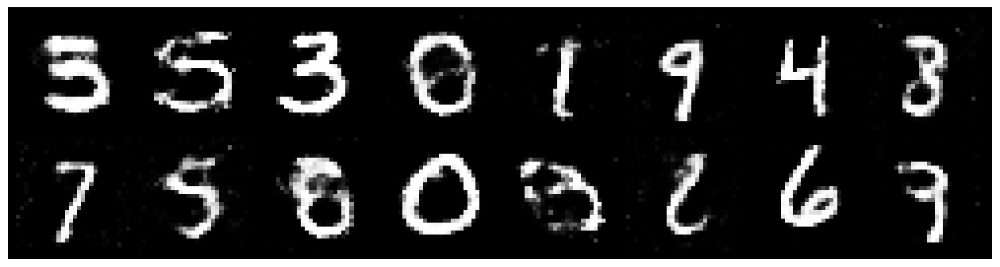

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2765, Generator Loss: 0.7989
D(x): 0.5658, D(G(z)): 0.4695


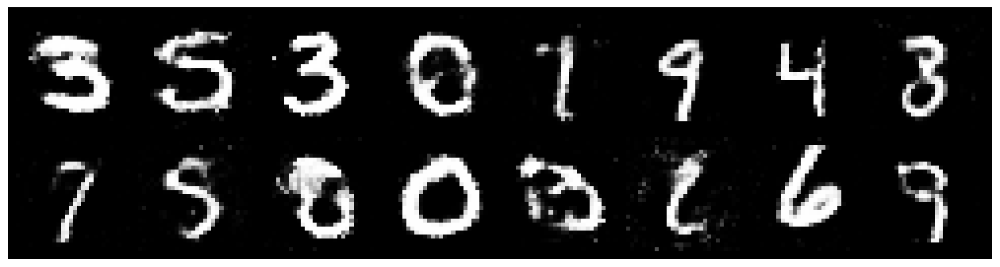

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.1628, Generator Loss: 0.9013
D(x): 0.5712, D(G(z)): 0.4112


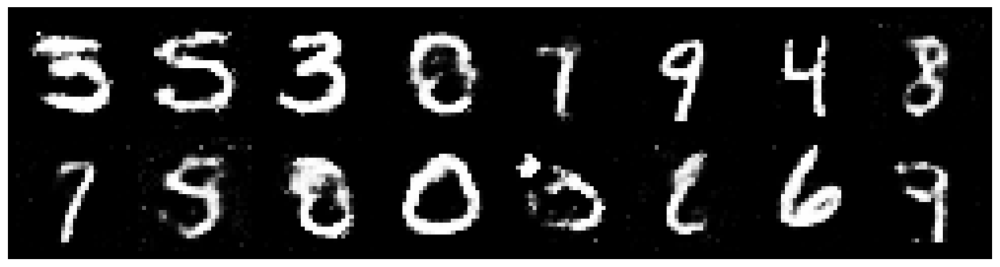

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2621, Generator Loss: 0.9554
D(x): 0.5239, D(G(z)): 0.4131


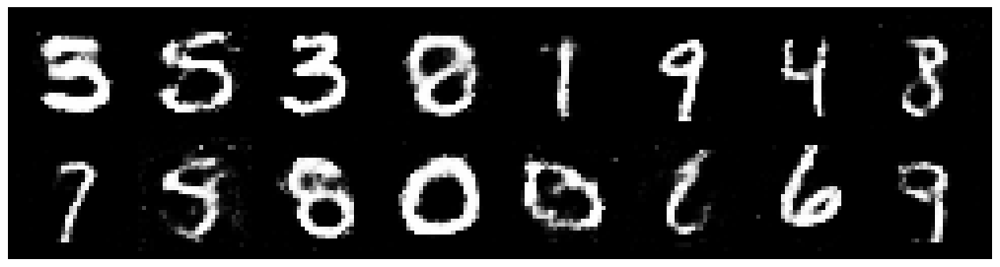

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2297, Generator Loss: 0.8831
D(x): 0.5803, D(G(z)): 0.4596


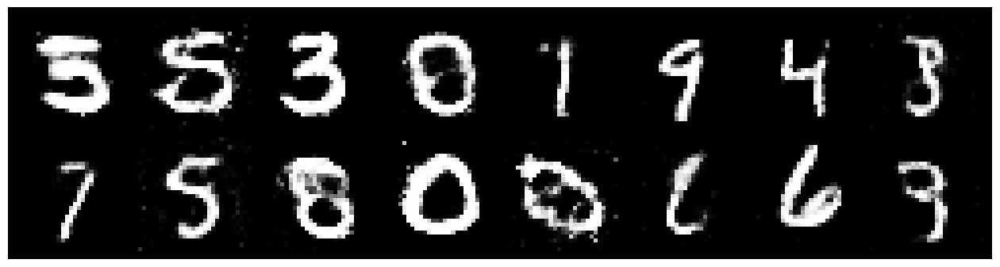

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2477, Generator Loss: 0.9270
D(x): 0.5464, D(G(z)): 0.4291


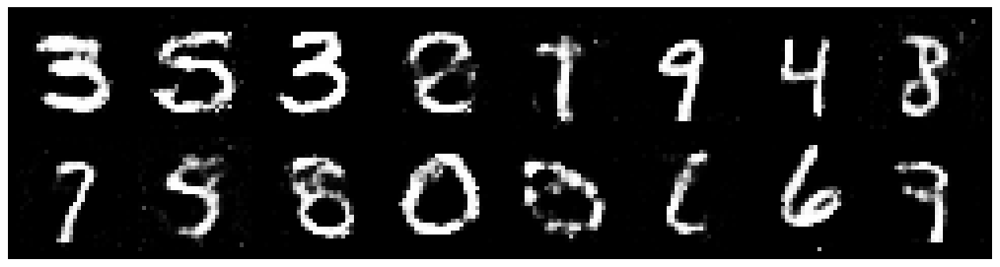

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.3132, Generator Loss: 0.8562
D(x): 0.5476, D(G(z)): 0.4751


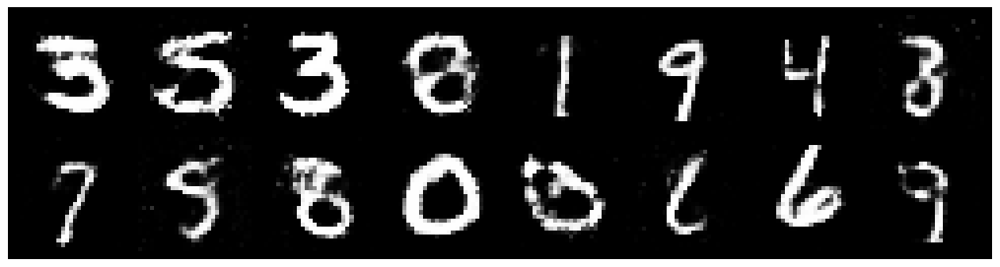

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2415, Generator Loss: 0.7939
D(x): 0.5847, D(G(z)): 0.4621


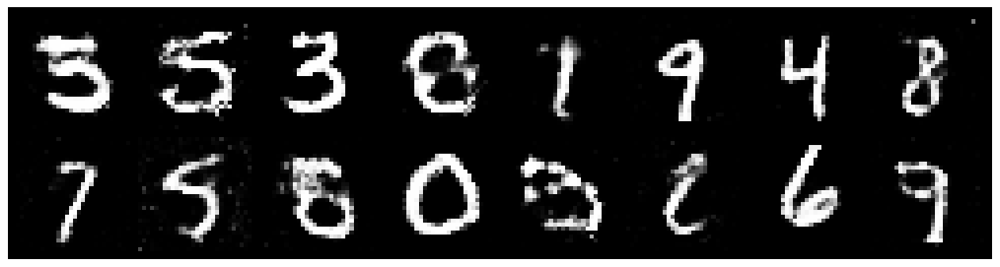

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3145, Generator Loss: 0.7421
D(x): 0.5644, D(G(z)): 0.4888


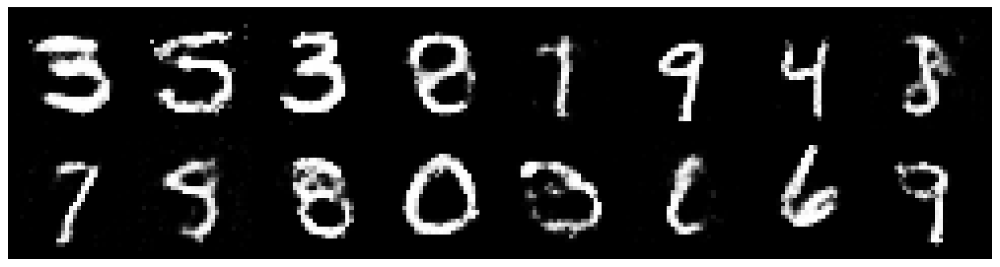

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.2608, Generator Loss: 1.0117
D(x): 0.5279, D(G(z)): 0.4122


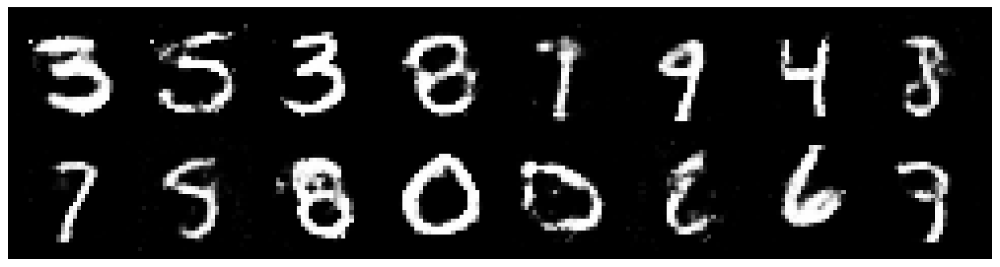

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3042, Generator Loss: 0.7996
D(x): 0.5451, D(G(z)): 0.4750


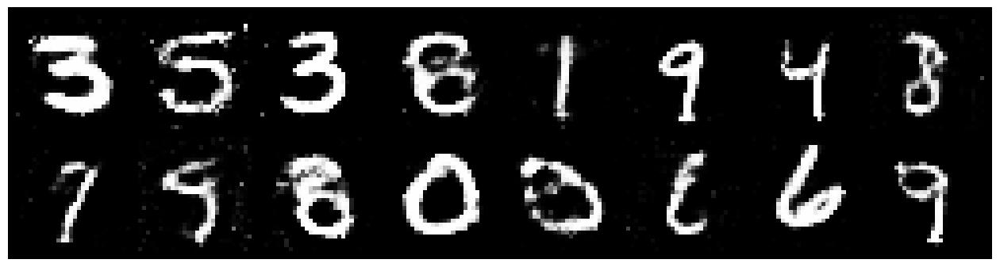

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3671, Generator Loss: 0.8579
D(x): 0.5139, D(G(z)): 0.4596


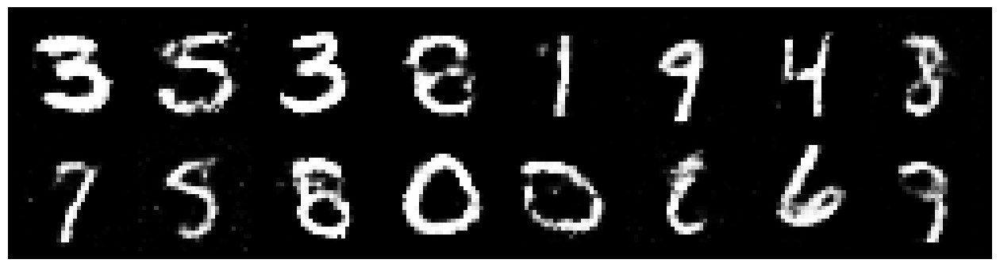

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8881
D(x): 0.5632, D(G(z)): 0.4605


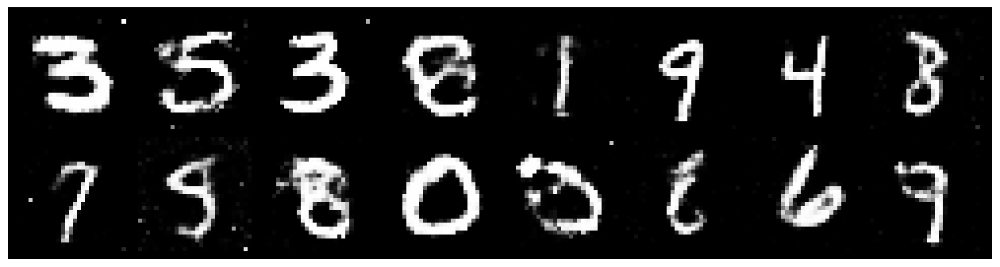

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2587, Generator Loss: 0.9937
D(x): 0.5194, D(G(z)): 0.4145


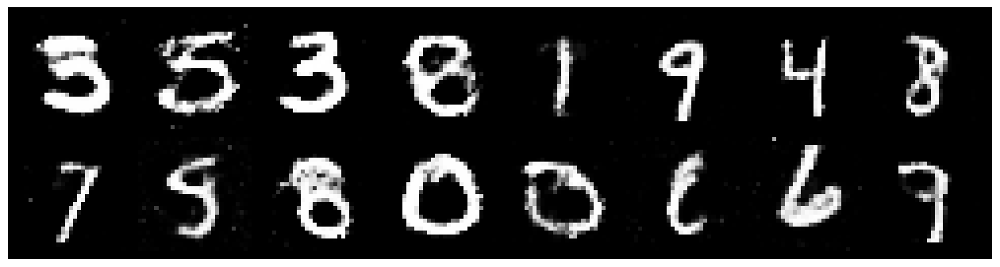

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.4317, Generator Loss: 0.9490
D(x): 0.5349, D(G(z)): 0.4742


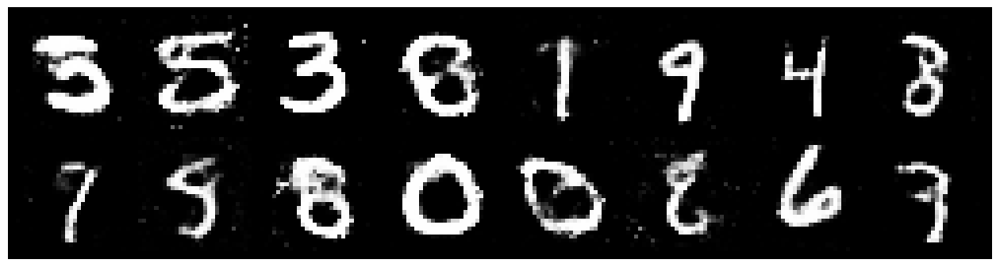

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.4037, Generator Loss: 0.8007
D(x): 0.5415, D(G(z)): 0.4899


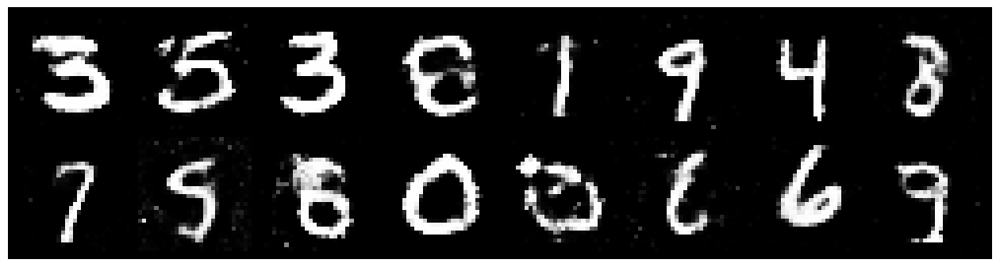

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.3878, Generator Loss: 0.7963
D(x): 0.5255, D(G(z)): 0.4792


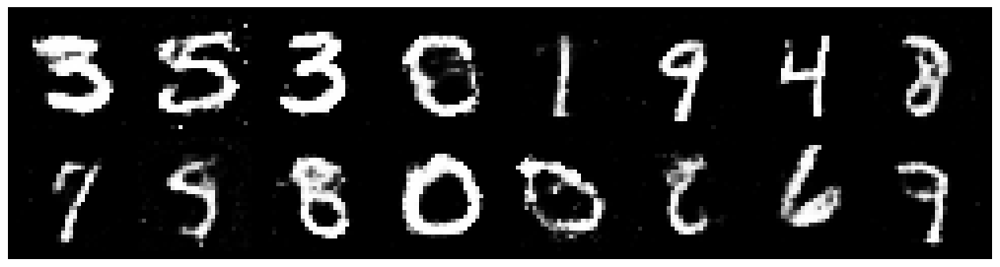

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3431, Generator Loss: 0.8994
D(x): 0.4973, D(G(z)): 0.4306


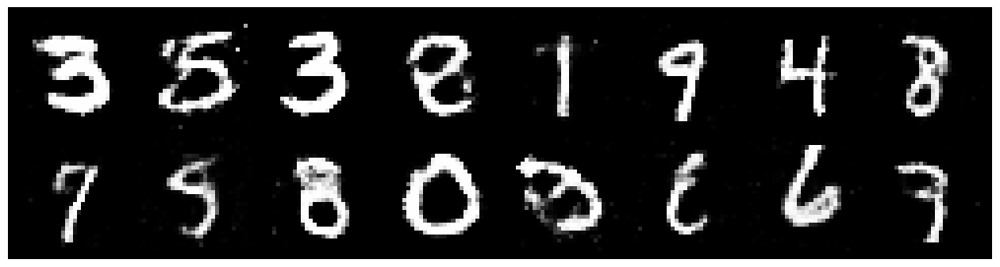

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.4935, Generator Loss: 0.8463
D(x): 0.5066, D(G(z)): 0.5040


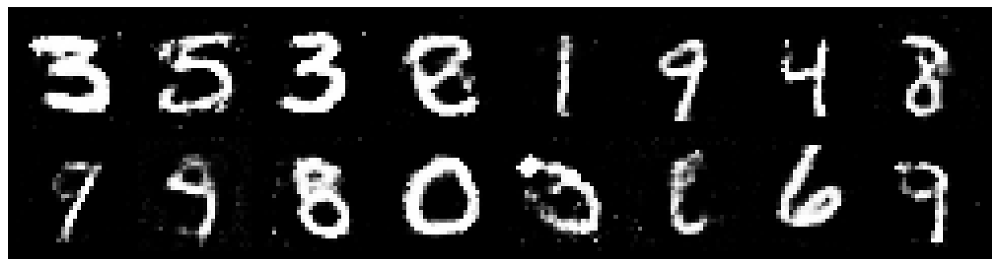

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2310, Generator Loss: 0.8205
D(x): 0.5605, D(G(z)): 0.4435


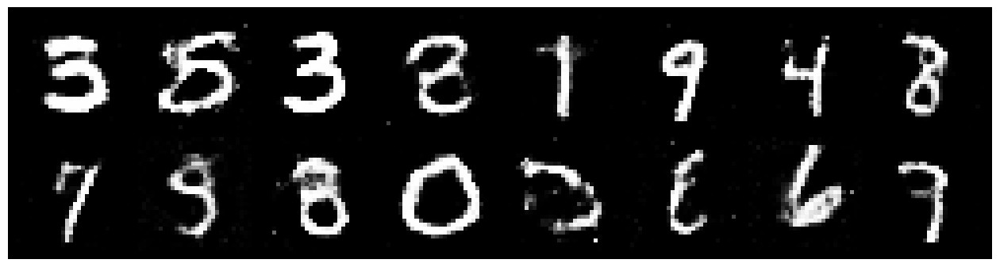

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3644, Generator Loss: 0.7788
D(x): 0.5237, D(G(z)): 0.4828


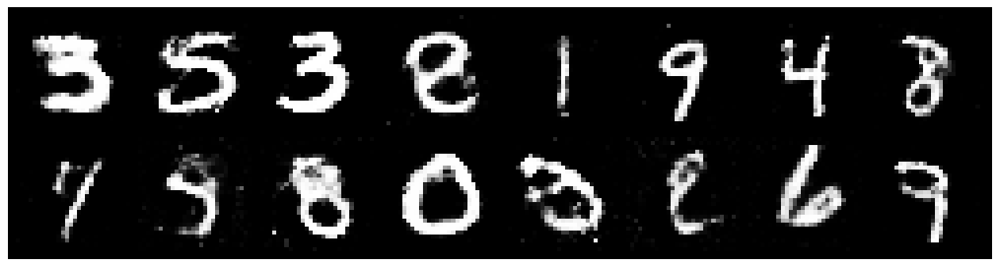

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.3906, Generator Loss: 0.8076
D(x): 0.5511, D(G(z)): 0.5031


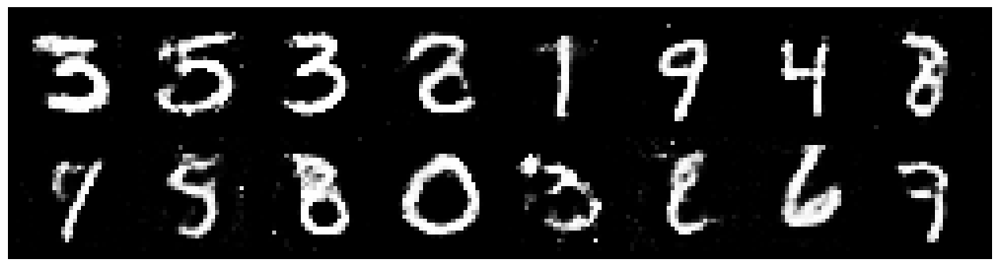

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3765, Generator Loss: 0.8374
D(x): 0.5315, D(G(z)): 0.4810


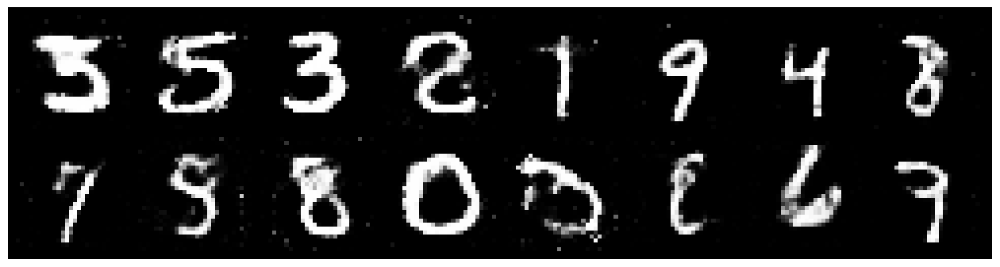

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.2798, Generator Loss: 0.7688
D(x): 0.5507, D(G(z)): 0.4521


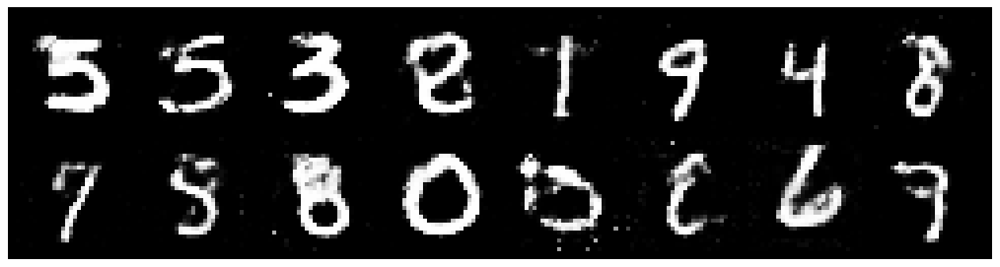

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3576, Generator Loss: 0.9616
D(x): 0.5068, D(G(z)): 0.4299


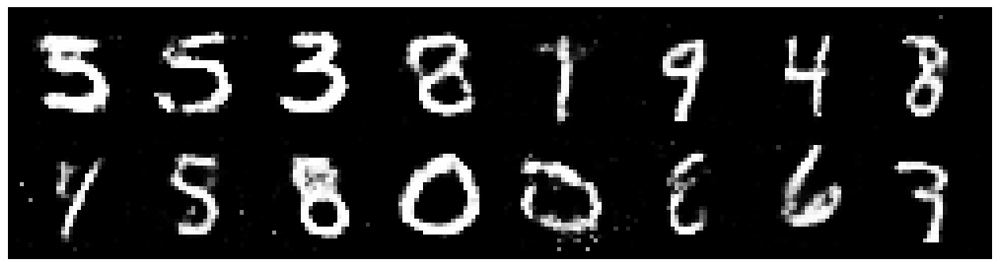

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2535, Generator Loss: 0.8926
D(x): 0.5752, D(G(z)): 0.4681


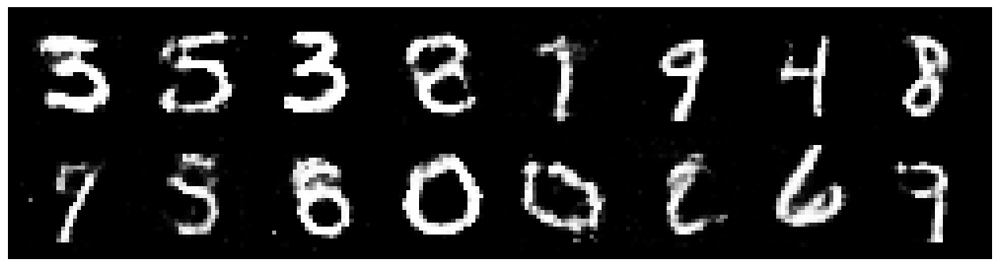

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.4356, Generator Loss: 0.9282
D(x): 0.5169, D(G(z)): 0.4816


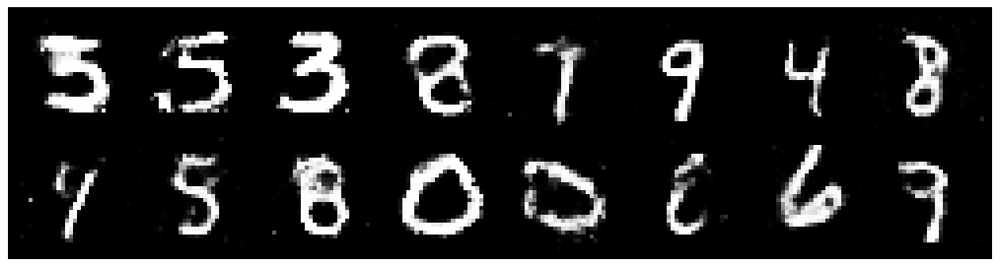

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3948, Generator Loss: 0.8586
D(x): 0.5087, D(G(z)): 0.4749


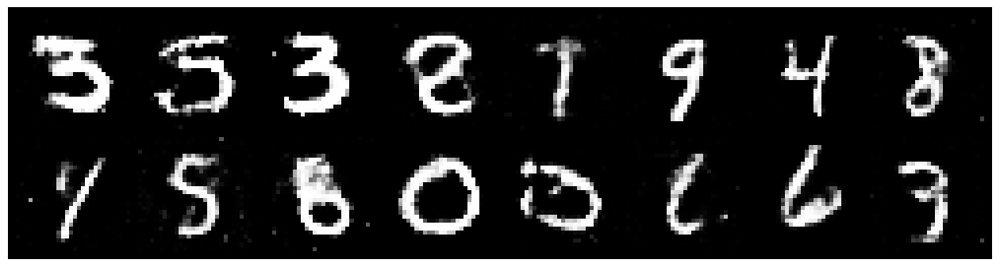

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.3125, Generator Loss: 0.9917
D(x): 0.5006, D(G(z)): 0.4220


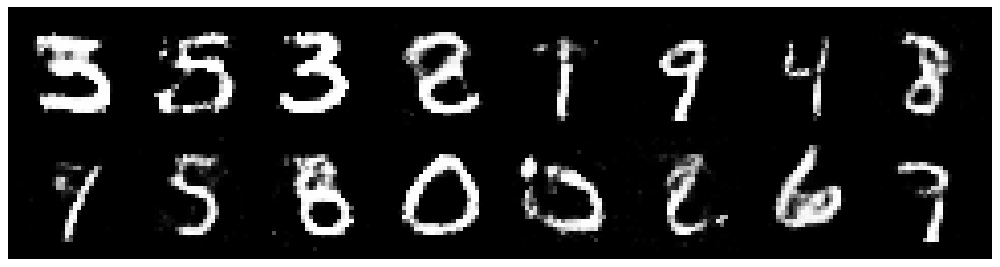

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8607
D(x): 0.5404, D(G(z)): 0.4332


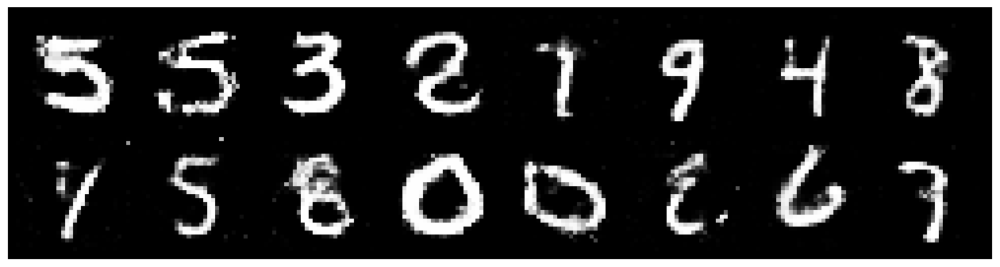

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2954, Generator Loss: 0.9561
D(x): 0.5094, D(G(z)): 0.4207


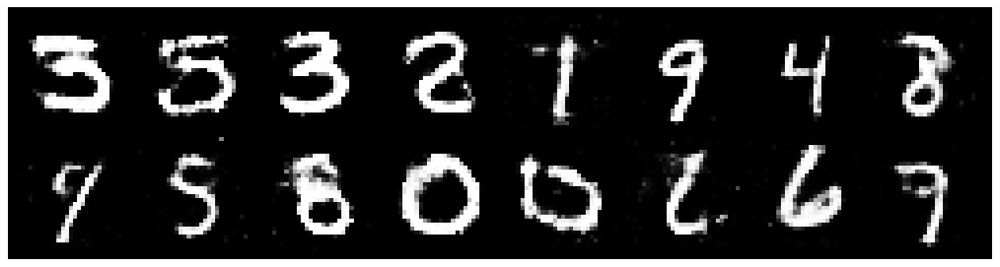

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.3651, Generator Loss: 0.8922
D(x): 0.5138, D(G(z)): 0.4510


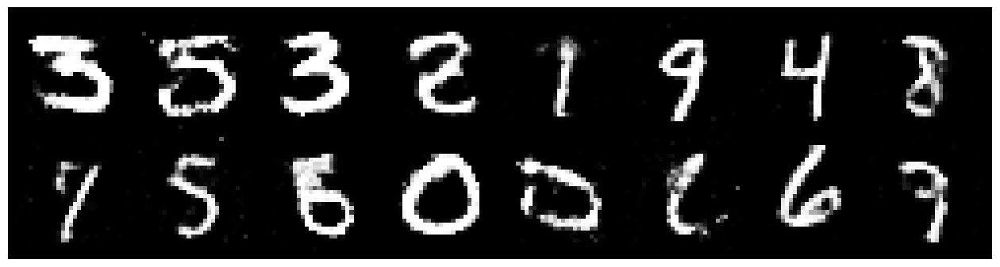

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2508, Generator Loss: 0.8182
D(x): 0.5679, D(G(z)): 0.4528


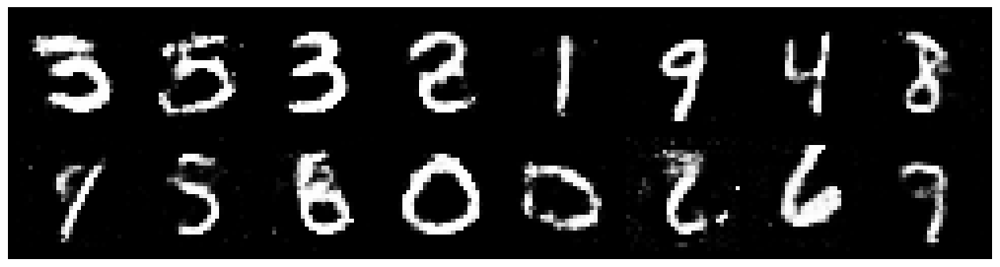

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.3490, Generator Loss: 0.9699
D(x): 0.5424, D(G(z)): 0.4766


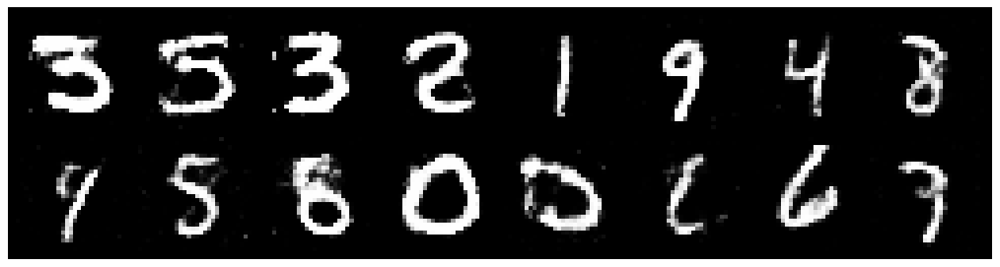

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.3067, Generator Loss: 0.8466
D(x): 0.5542, D(G(z)): 0.4795


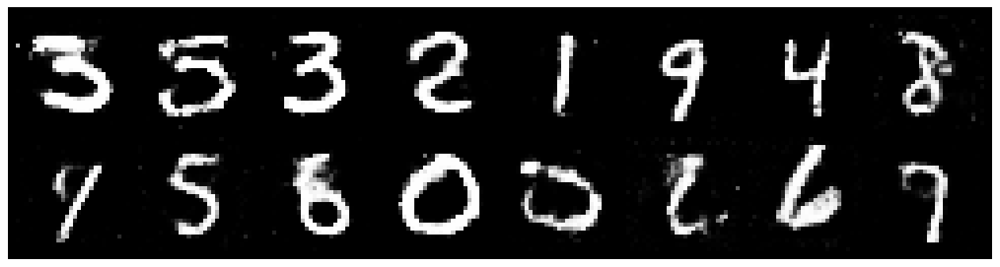

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.3412, Generator Loss: 0.9278
D(x): 0.5425, D(G(z)): 0.4625


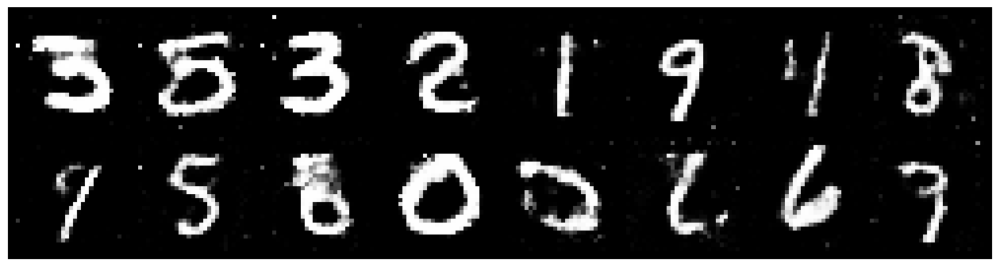

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2738, Generator Loss: 0.8299
D(x): 0.5358, D(G(z)): 0.4523


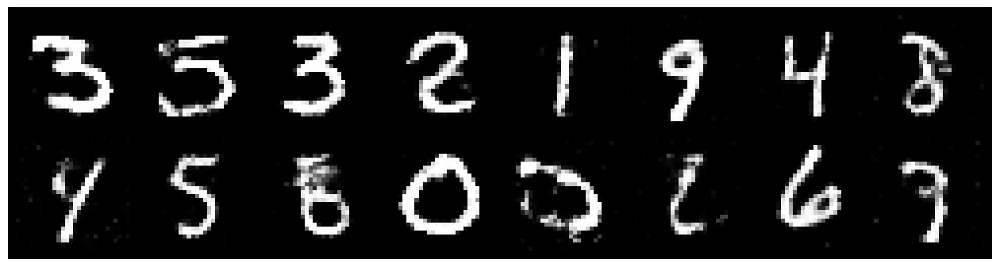

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2671, Generator Loss: 0.9186
D(x): 0.5644, D(G(z)): 0.4570


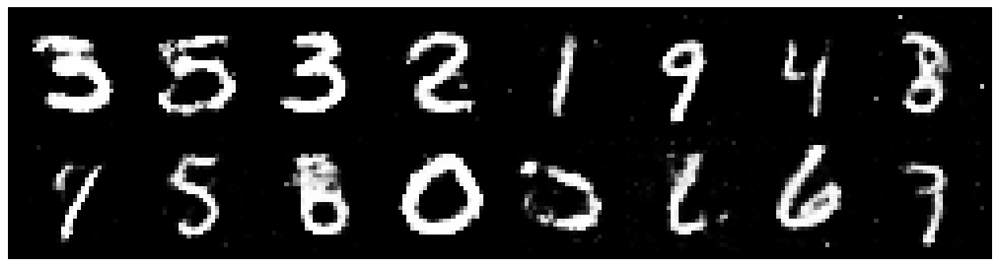

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2285, Generator Loss: 0.9183
D(x): 0.6028, D(G(z)): 0.4565


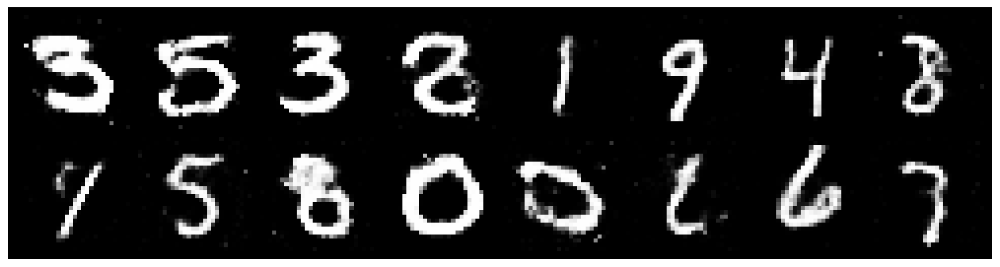

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2011, Generator Loss: 0.9052
D(x): 0.5751, D(G(z)): 0.4250


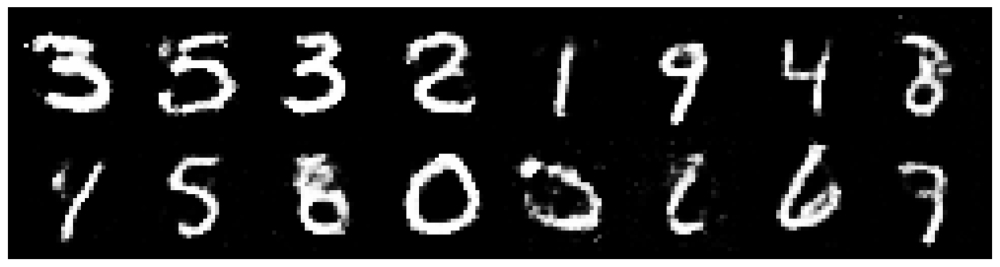

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2294, Generator Loss: 0.8038
D(x): 0.5713, D(G(z)): 0.4488


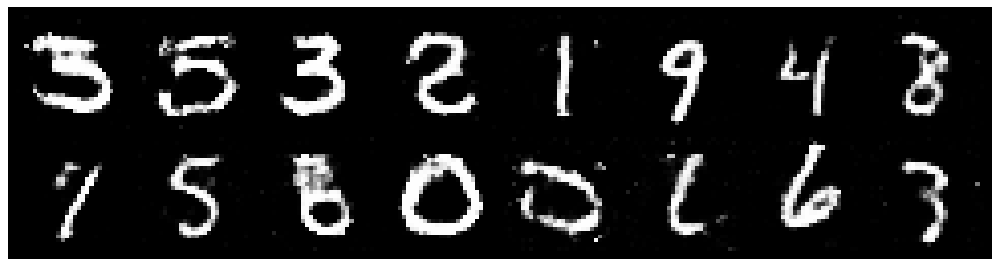

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8998
D(x): 0.5475, D(G(z)): 0.4501


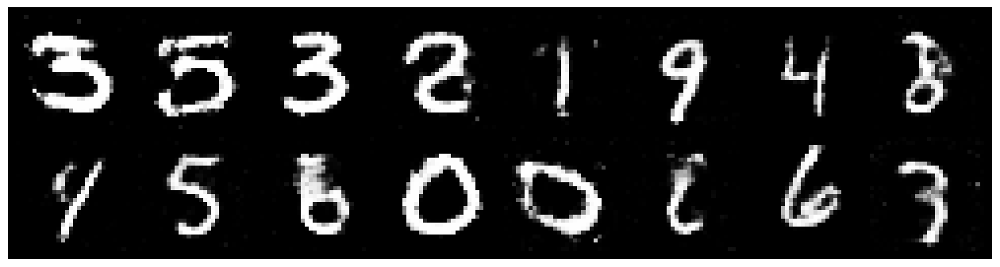

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3045, Generator Loss: 0.8425
D(x): 0.5795, D(G(z)): 0.4819


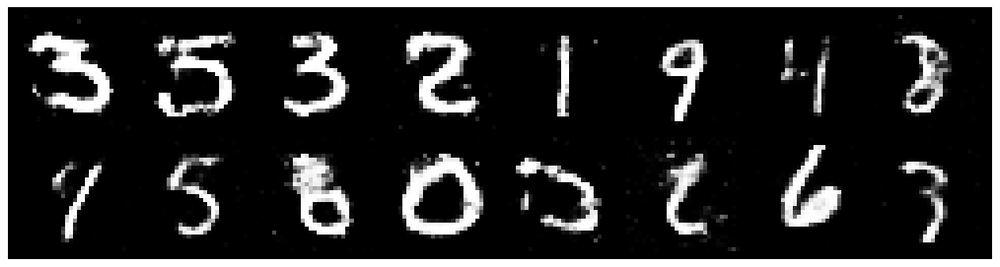

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2181, Generator Loss: 0.8891
D(x): 0.5984, D(G(z)): 0.4609


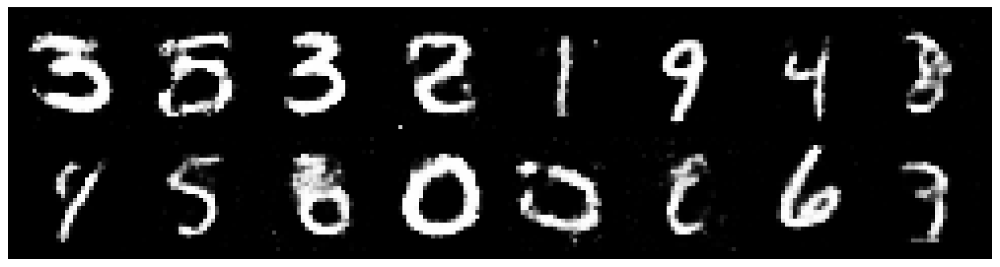

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2548, Generator Loss: 0.8833
D(x): 0.5707, D(G(z)): 0.4519


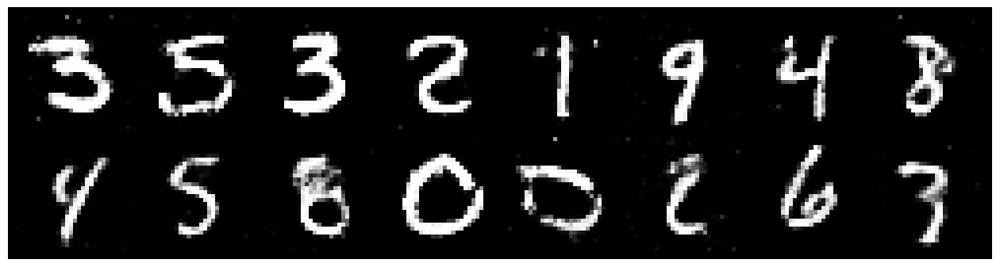

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3133, Generator Loss: 0.8705
D(x): 0.5416, D(G(z)): 0.4560


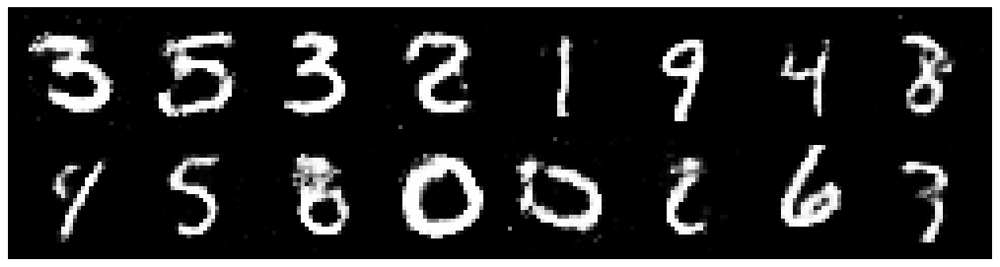

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2750, Generator Loss: 1.0301
D(x): 0.5509, D(G(z)): 0.4365


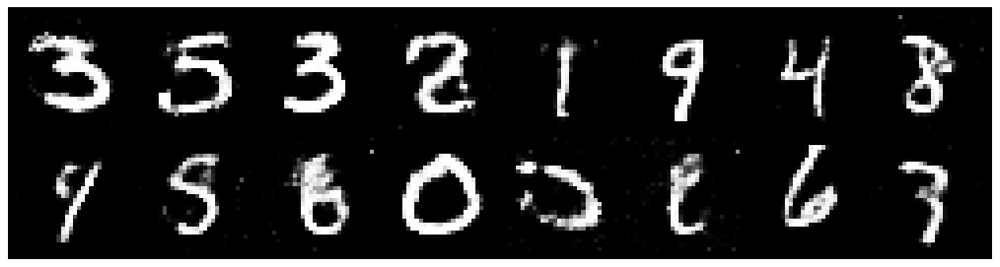

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3001, Generator Loss: 0.8577
D(x): 0.5562, D(G(z)): 0.4542


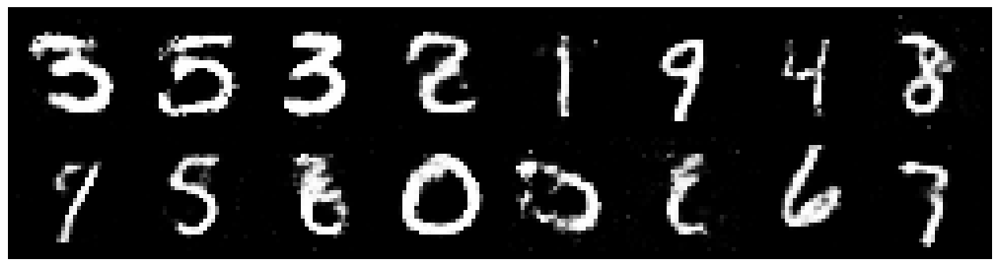

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.4557, Generator Loss: 0.7769
D(x): 0.5049, D(G(z)): 0.4769


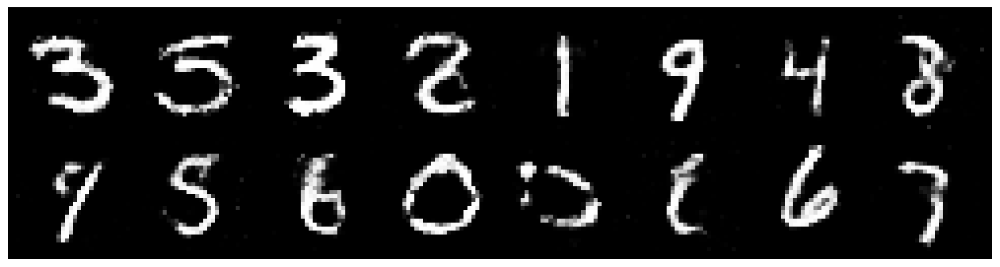

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3806, Generator Loss: 0.7515
D(x): 0.5471, D(G(z)): 0.4972


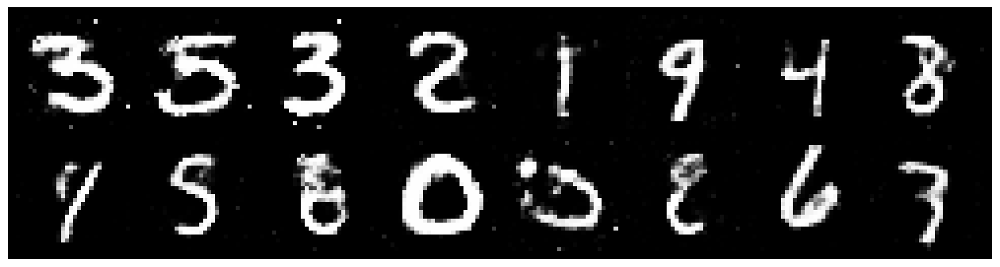

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2466, Generator Loss: 0.8111
D(x): 0.5947, D(G(z)): 0.4672


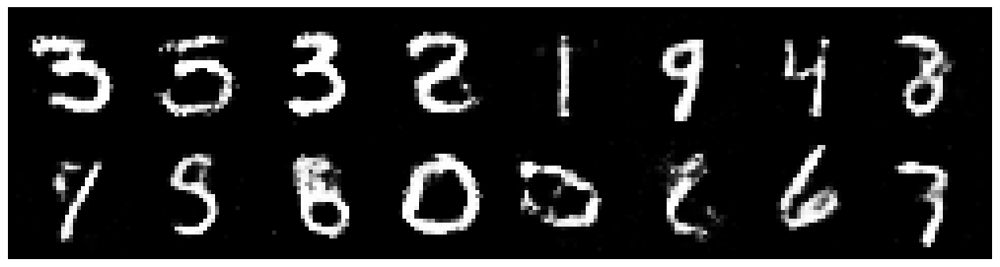

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2343, Generator Loss: 0.7834
D(x): 0.5644, D(G(z)): 0.4418


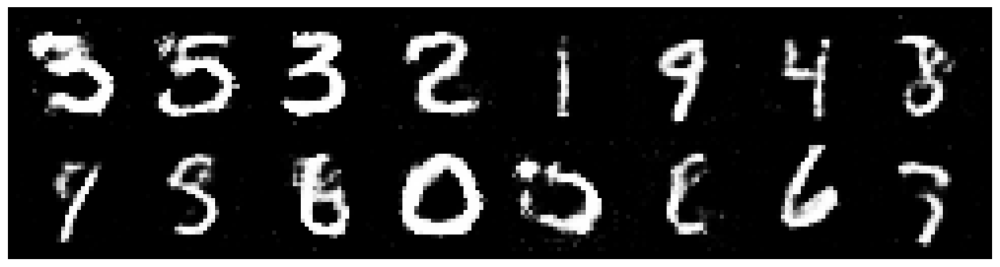

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.3113, Generator Loss: 0.8878
D(x): 0.5392, D(G(z)): 0.4572


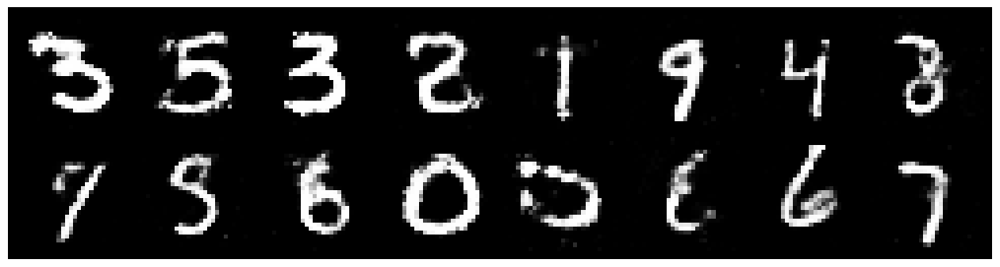

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2813, Generator Loss: 0.8791
D(x): 0.5526, D(G(z)): 0.4484


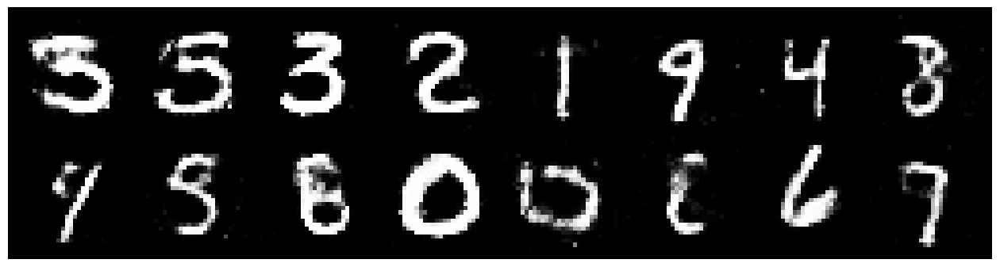

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.2012, Generator Loss: 0.9548
D(x): 0.5650, D(G(z)): 0.4196


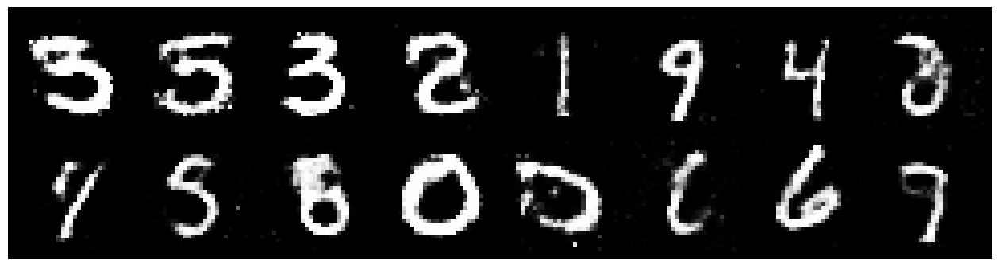

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2124, Generator Loss: 0.8809
D(x): 0.5395, D(G(z)): 0.4133


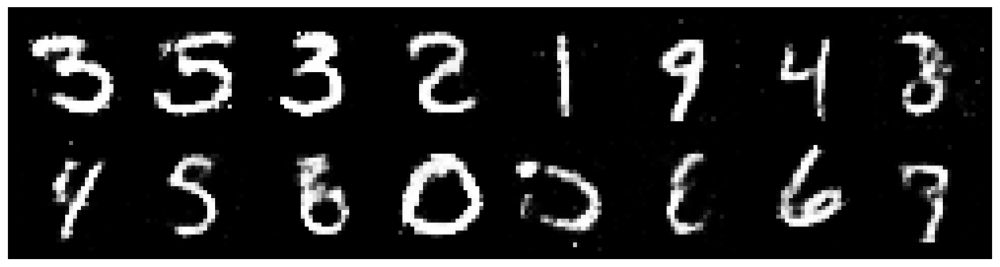

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.4111, Generator Loss: 0.8199
D(x): 0.5222, D(G(z)): 0.4759


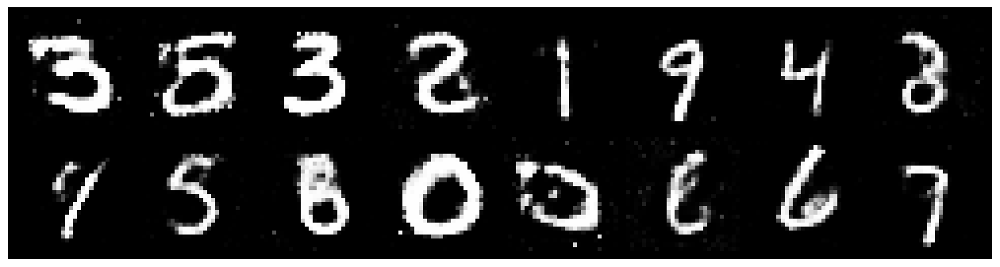

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3056, Generator Loss: 0.9027
D(x): 0.5131, D(G(z)): 0.4013


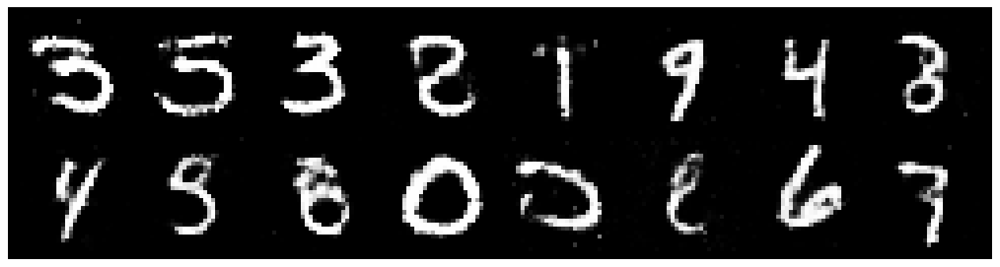

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2372, Generator Loss: 0.8977
D(x): 0.5623, D(G(z)): 0.4302


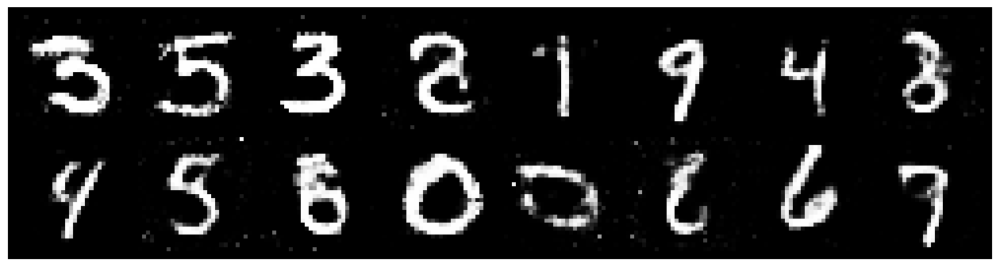

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.3441, Generator Loss: 0.8223
D(x): 0.5605, D(G(z)): 0.4897


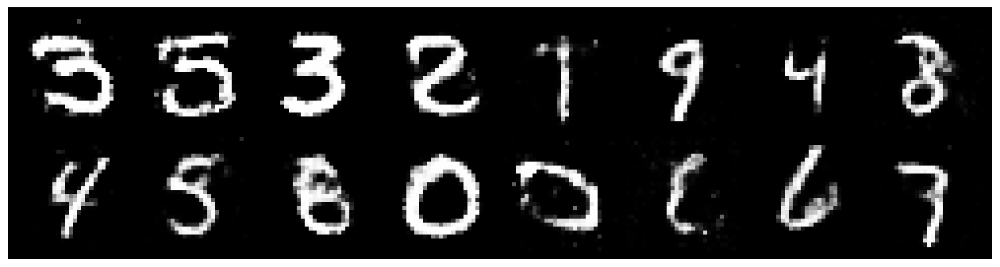

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2500, Generator Loss: 1.0316
D(x): 0.5515, D(G(z)): 0.4308


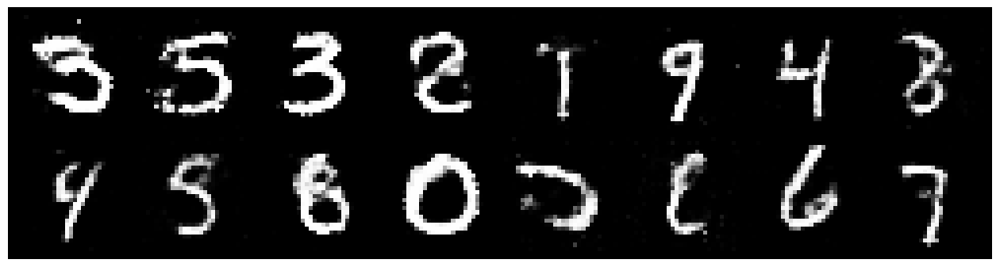

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.1693, Generator Loss: 0.9626
D(x): 0.5822, D(G(z)): 0.4265


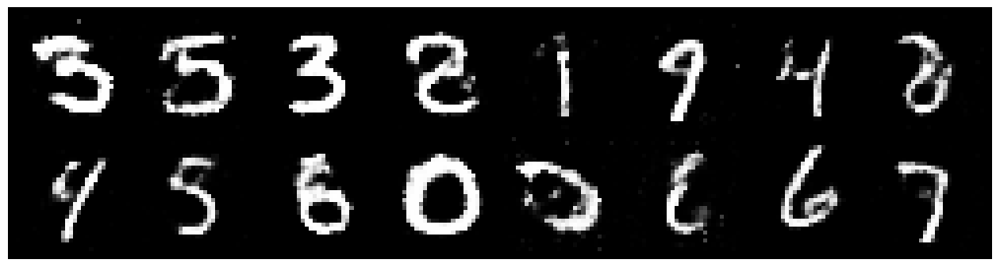

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2868, Generator Loss: 0.8054
D(x): 0.5764, D(G(z)): 0.4683


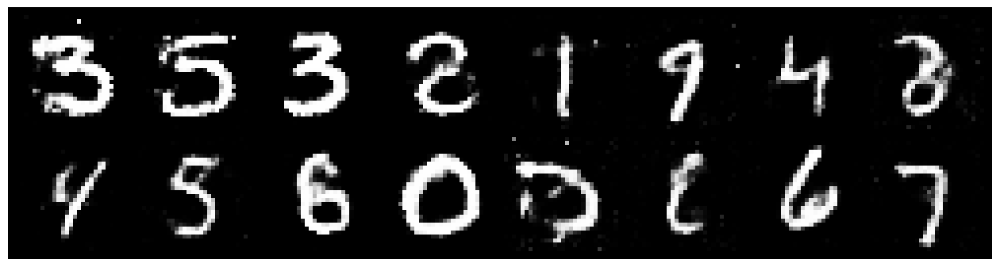

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.4035, Generator Loss: 0.7643
D(x): 0.5885, D(G(z)): 0.5147


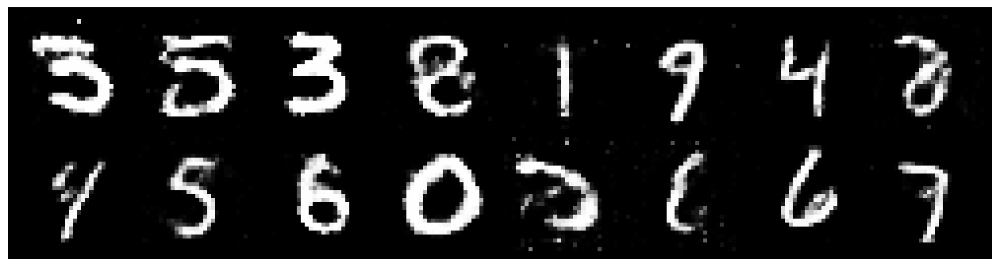

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2667, Generator Loss: 0.7859
D(x): 0.5830, D(G(z)): 0.4817


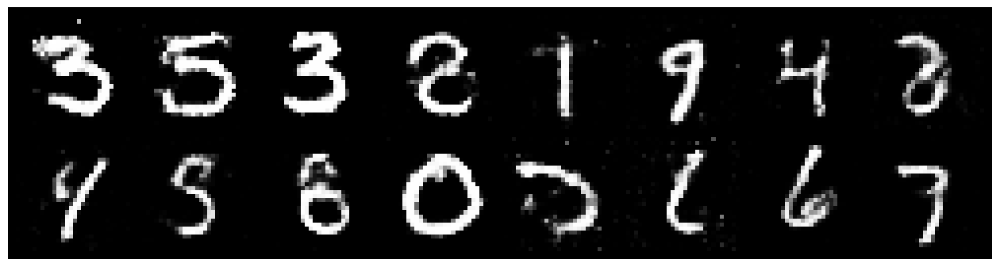

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2102, Generator Loss: 0.8998
D(x): 0.5624, D(G(z)): 0.4347


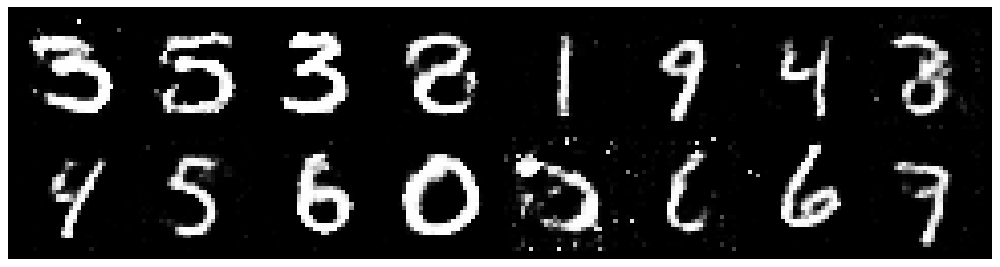

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.1405, Generator Loss: 0.8731
D(x): 0.6277, D(G(z)): 0.4393


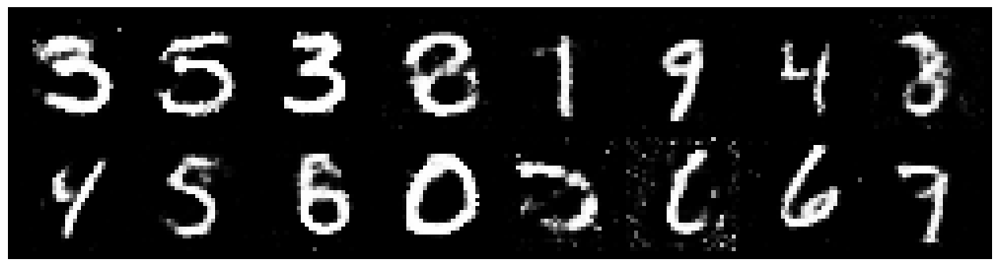

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2743, Generator Loss: 0.8543
D(x): 0.5608, D(G(z)): 0.4567


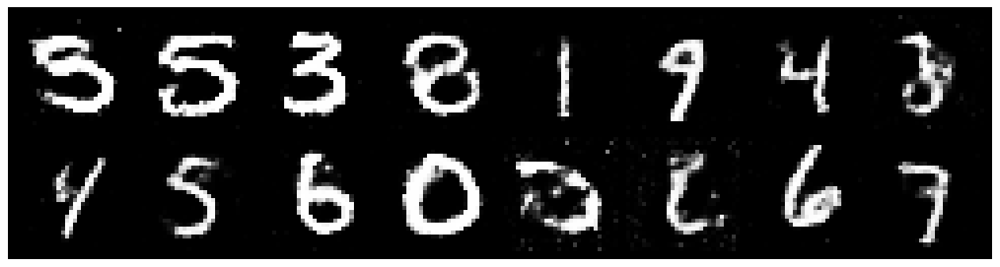

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.3526, Generator Loss: 0.8575
D(x): 0.5590, D(G(z)): 0.5027


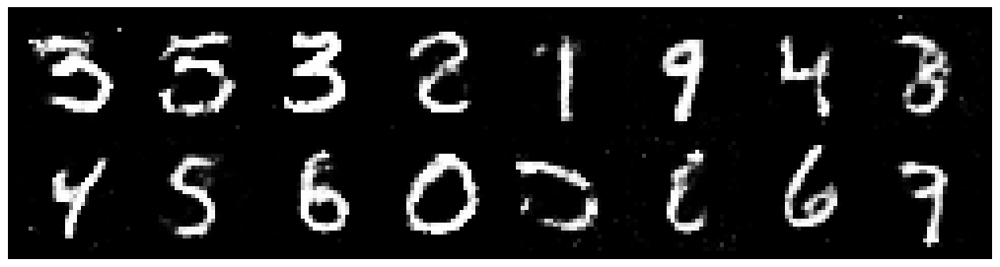

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.2293, Generator Loss: 0.9536
D(x): 0.5473, D(G(z)): 0.4212


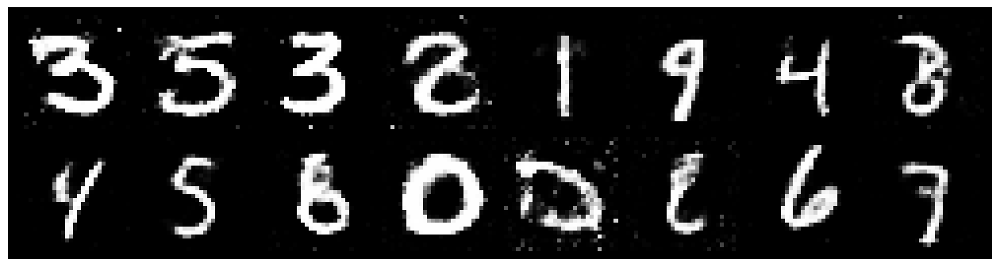

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.1926, Generator Loss: 0.9606
D(x): 0.5695, D(G(z)): 0.4155


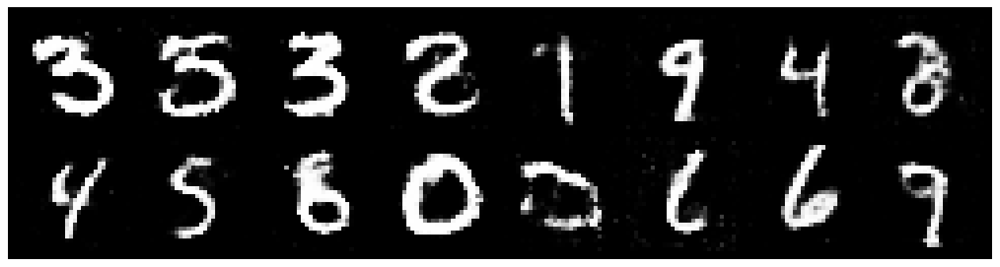

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2263, Generator Loss: 0.8181
D(x): 0.5783, D(G(z)): 0.4489


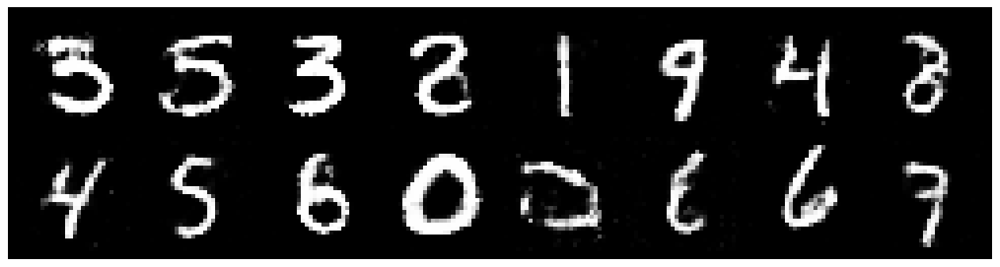

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2547, Generator Loss: 0.8821
D(x): 0.5669, D(G(z)): 0.4544


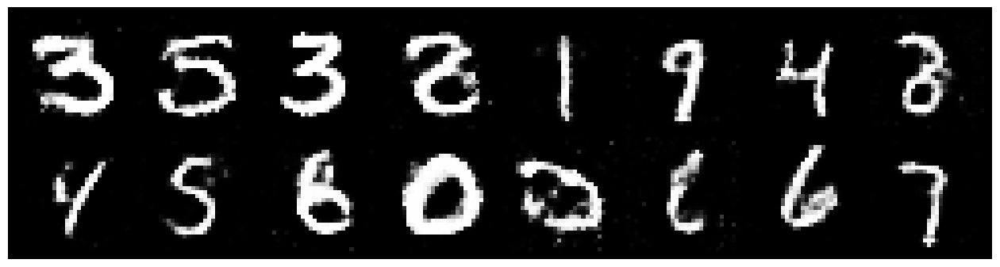

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.3156, Generator Loss: 0.7690
D(x): 0.5677, D(G(z)): 0.4858


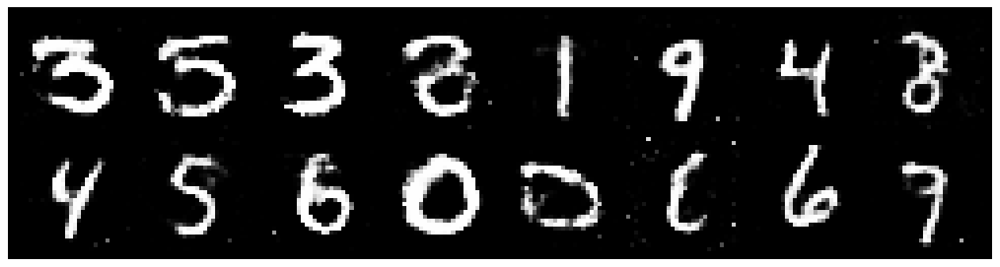

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8761
D(x): 0.5386, D(G(z)): 0.4500


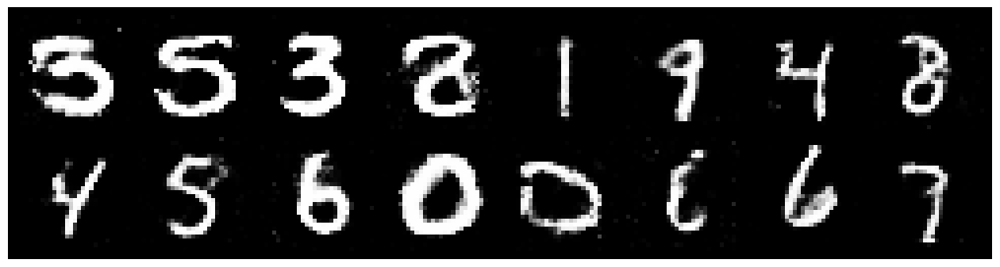

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2636, Generator Loss: 0.9303
D(x): 0.5862, D(G(z)): 0.4533


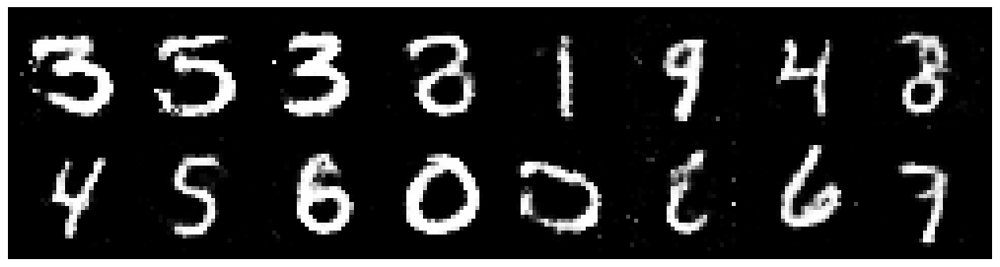

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.3016, Generator Loss: 0.8000
D(x): 0.5438, D(G(z)): 0.4678


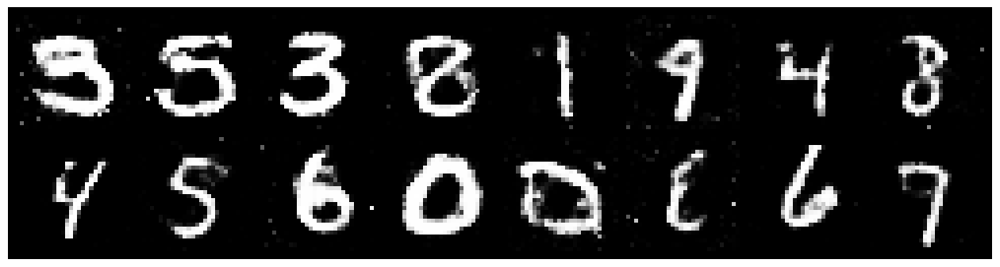

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.3123, Generator Loss: 0.7307
D(x): 0.5522, D(G(z)): 0.4805


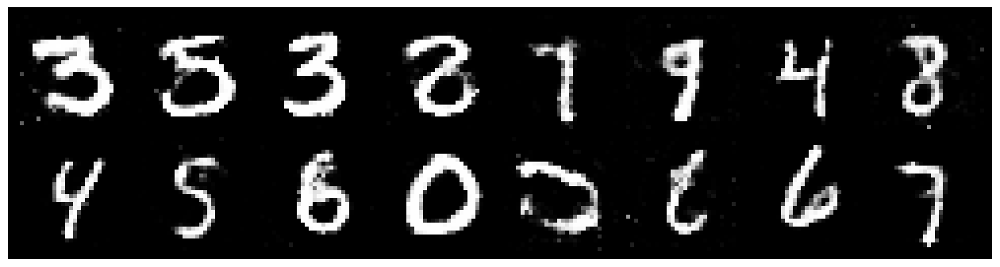

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.3014, Generator Loss: 0.9152
D(x): 0.5259, D(G(z)): 0.4278


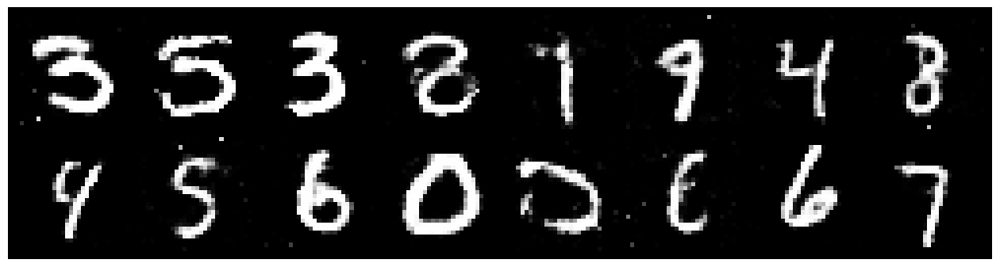

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2688, Generator Loss: 0.8293
D(x): 0.5990, D(G(z)): 0.4630


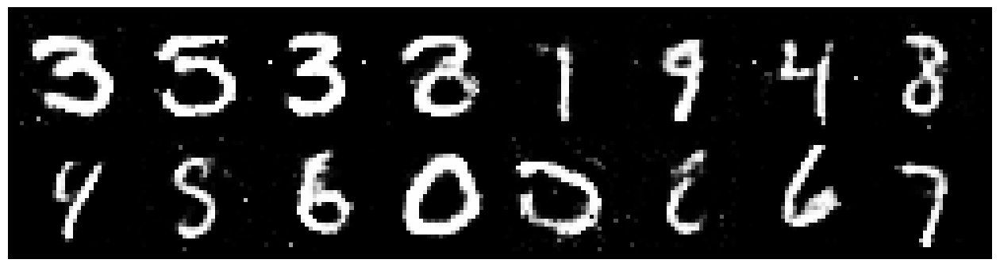

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2567, Generator Loss: 0.8803
D(x): 0.5734, D(G(z)): 0.4486


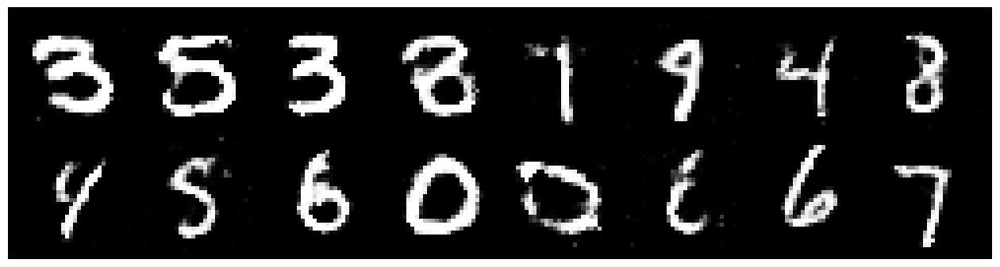

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2202, Generator Loss: 0.7879
D(x): 0.5678, D(G(z)): 0.4400


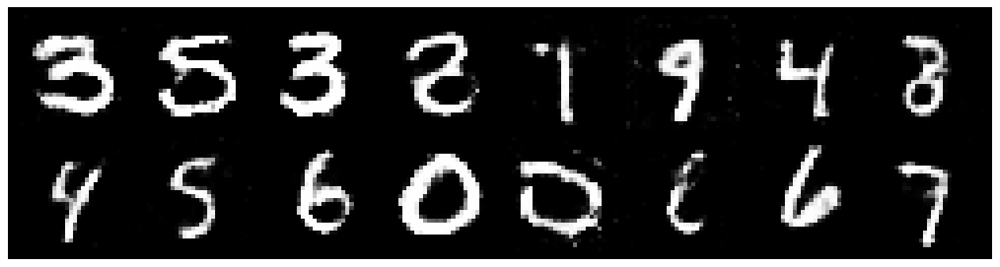

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2843, Generator Loss: 0.9000
D(x): 0.5433, D(G(z)): 0.4373


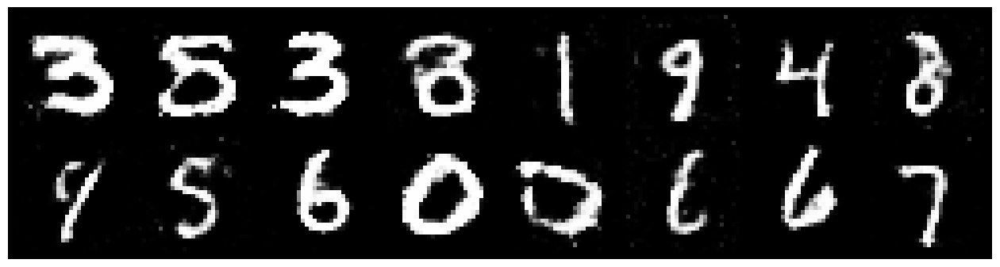

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.3497, Generator Loss: 0.8516
D(x): 0.5123, D(G(z)): 0.4541


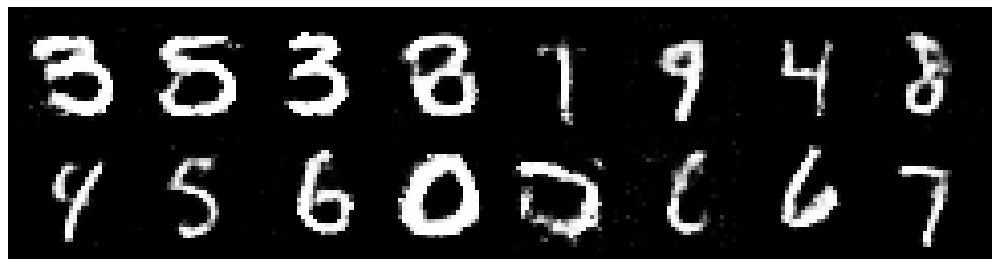

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.4137, Generator Loss: 0.9688
D(x): 0.5334, D(G(z)): 0.4844


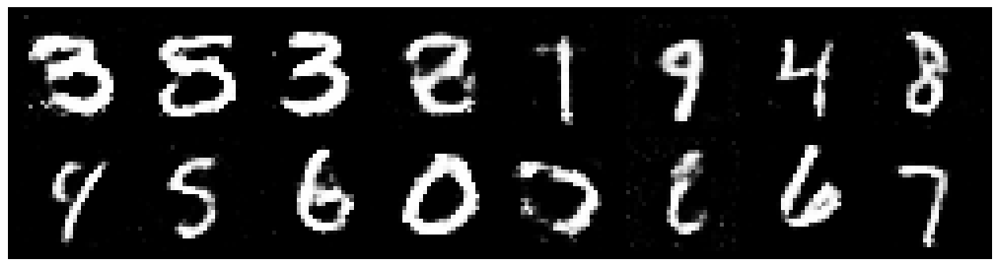

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.3653, Generator Loss: 0.8973
D(x): 0.5332, D(G(z)): 0.4713
CPU times: user 10h 39min 42s, sys: 36min 14s, total: 11h 15min 57s
Wall time: 1h 55min 36s


In [17]:
%%time
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

Parzen windows estimation of likelihood favors trivial models and is irrelevant to visual fidelity of samples. Further, it fails to approximate the true likelihood in high dimensional spaces or to rank models

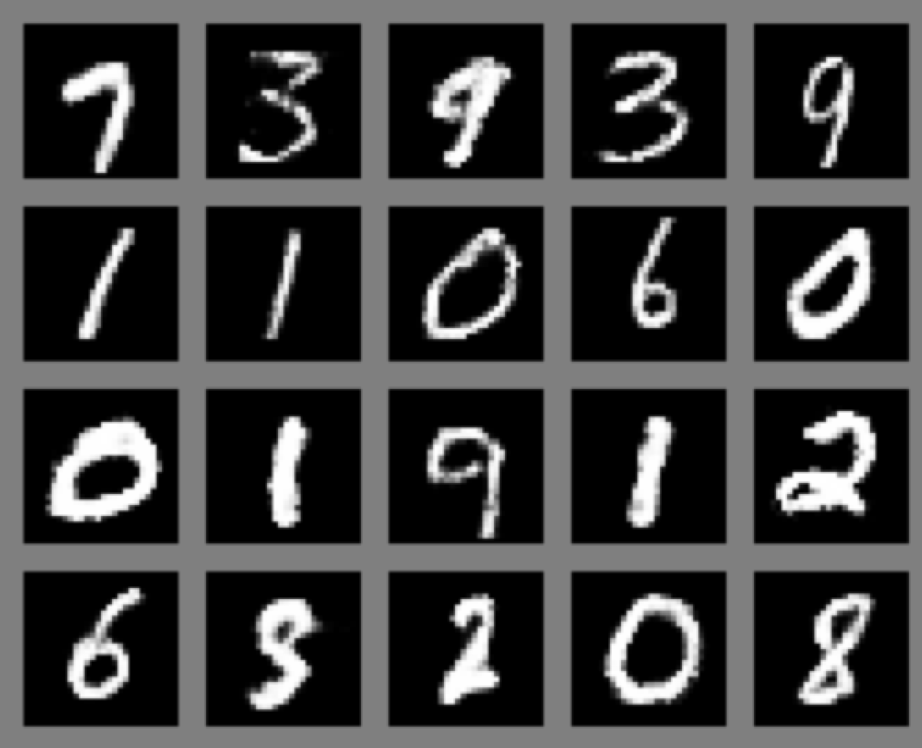

From Researchers: Exact reproduction of the numbers in the paper depends on exact reproduction of many factors, including the version of all software dependencies and the choice of underlying hardware (GPU model, etc). We used NVIDA Ge-Force GTX-580 graphics cards; other hardware will use different tree structures for summation and incur different rounding error. If you do not reproduce our setup exactly you should expect to need to re-tune your hyperparameters slight for your new setup.

## END